# Predicting Stock Price Movement Through Natural Language Processing for SEC Filings

By Kevin Zhou (klz23), Peter Wu (plw53), Ashley Young (acy39)



## Dependencies

First, let us import all necessary dependencies, and do some static analysis on them so that we can deploy this code in the webapp.

In [ ]:
import pandas as pd
import numpy as np
import torch
import os
import json
from datetime import datetime
import requests
import re
import nltk
import textblob 
from textblob import TextBlob
import pickle as pkl
from IPython.display import display
from IPython.core.magic import register_line_cell_magic
nltk.download('wordnet')
nltk.download('omw-1.4')
nltk.download('punkt')
from nltk.stem import WordNetLemmatizer
from nltk.corpus import wordnet
from nltk.stem import PorterStemmer
from nltk.tokenize import word_tokenize
import lightgbm 
from lightgbm import LGBMRegressor
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import ElasticNet
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import r2_score
import xgboost
from google.colab import drive

[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data] Downloading package omw-1.4 to /root/nltk_data...
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


In [ ]:
# Get actual requirements.txt for use in the webapp
from pip._internal.utils.misc import get_installed_distributions
import sys
#import numpy as np # imported to test whether numpy shows up, which it does!

def get_imported_packages():
    p = get_installed_distributions()
    p = {package.key:package.version for package in p}

    imported_modules = set(sys.modules.keys())
    
    imported_modules.remove('pip')

    modules = [(m, p[m]) for m in imported_modules if p.get(m, False)]

    return modules


def generate_requirements(filepath:str, modules):
    with open(filepath, 'w') as f:
        for module, version in modules:
            f.write(f"{module}=={version}\n")


generate_requirements('requirements.txt', get_imported_packages())
!cat requirements.txt

certifi==2022.9.24
urllib3==1.24.3
threadpoolctl==3.1.0
cloudpickle==1.5.0
numexpr==2.8.4
decorator==4.4.2
six==1.15.0
backcall==0.2.0
astor==0.8.1
kiwisolver==1.4.4
pickleshare==0.7.5
httplib2==0.17.4
joblib==1.2.0
pytz==2022.6
pandas==1.3.5
debugpy==1.0.0
torch==1.13.0+cu116
cffi==1.15.1
idna==2.10
numpy==1.21.6
regex==2022.6.2
ipywidgets==7.7.1
pyparsing==3.0.9
traitlets==5.6.0
ptyprocess==0.7.0
google==2.0.3
pygments==2.6.1
tqdm==4.64.1
tornado==6.0.4
nltk==3.7
xgboost==0.90
requests==2.23.0
dill==0.3.6
psutil==5.4.8
graphviz==0.10.1
scipy==1.7.3
textblob==0.15.3
astunparse==1.6.3
lightgbm==2.2.3
matplotlib==3.2.2
pexpect==4.8.0
platformdirs==2.5.4
pyarrow==9.0.0
pathlib==1.0.1
wcwidth==0.2.5
ipykernel==5.3.4
cycler==0.11.0
portpicker==1.3.9
chardet==3.0.4


# Preparing the Dataset

In [ ]:
# Getting stock price changes (by percent of change), keys are stock tickers
drive.mount('drive')
price_change = pkl.load(open('drive/My Drive/ai-prac/stock_prices.pkl', 'rb'))

price_change

Drive already mounted at drive; to attempt to forcibly remount, call drive.mount("drive", force_remount=True).


{'MMM': {2017: 0.3219319914797597,
  2018: -0.19139367773015217,
  2019: -0.07609321294325704,
  2020: -0.028944481743706597,
  2021: 0.03357191154003774},
 'AOS': {2017: 0.29010523745888156,
  2018: -0.30602955289986433,
  2019: 0.09592818154694,
  2020: 0.14758214715308354,
  2021: 0.5817879045227652},
 'ABT': {2017: 0.4614596878317407,
  2018: 0.23031128941437423,
  2019: 0.24978418144390738,
  2020: 0.25922946183591583,
  2021: 0.2922738448470226},
 'ABBV': {2017: 0.5495914007518272,
  2018: -0.06320496889787233,
  2019: -0.0077328523528810734,
  2020: 0.19653822305230637,
  2021: 0.2895359828608238},
 'ABMD': {2017: 0.6679423517628885,
  2018: 0.6886071965770976,
  2019: -0.4496386596958147,
  2020: 0.9205024399961964,
  2021: 0.1431186973129058},
 'ACN': {2017: 0.3145285723971963,
  2018: -0.08339834982103853,
  2019: 0.4977595334602602,
  2020: 0.2429693030766628,
  2021: 0.613623958358248},
 'ATVI': {2017: 0.7281659593234993,
  2018: -0.27585132230189197,
  2019: 0.263448856288

In [ ]:
price_change30 = pkl.load(open('drive/My Drive/ai-prac/stock_prices30.pkl', 'rb'))
price_change30

{'MMM': {2017: 0.02049982495885355,
  2018: -0.015447289929879116,
  2019: 0.0732128617489761,
  2020: -0.10550003051757813,
  2021: 0.02781171184672281},
 'AOS': {2017: 0.0387368453176398,
  2018: 0.04111813472273542,
  2019: 0.17529327623426996,
  2020: -0.08038518140654123,
  2021: 0.09903561450162308},
 'ABT': {2017: 0.12676058539436888,
  2018: -0.008674980920025286,
  2019: 0.06431656432666367,
  2020: 0.031167415859489275,
  2021: 0.16616256211163402},
 'ABBV': {2017: -0.012177508786914653,
  2018: 0.1490701922877143,
  2019: -0.09761298202607743,
  2020: 0.050251254568903864,
  2021: 0.008348327699890709},
 'ABMD': {2017: -0.015485918959751481,
  2018: 0.32718579630242506,
  2019: 0.15440707571472778,
  2020: -0.009418851732041161,
  2021: -0.0013576963926476083},
 'ACN': {2017: 0.029795648703261686,
  2018: 0.038676528145344925,
  2019: 0.12276840611150389,
  2020: 0.010563889056293062,
  2021: 0.009046273888787544},
 'ATVI': {2017: 0.2412663837293997,
  2018: 0.08303536261869

In [ ]:
# Reading in cik to symbol mapping
symbol_cik = pd.read_excel('drive/My Drive/ai-prac/F500_CIKs.xlsx')

# Dataframe indexed by CIK with corresponding Symbol
symbol_cik = symbol_cik.set_index(symbol_cik['CIK'])
symbol_cik = symbol_cik.drop(columns = ['CIK'])

## Web Scraping

EDGAR-Corpus paper: https://arxiv.org/pdf/2109.14394.pdf

In [ ]:
# Scraping using edgar-crawler from the EDGAR-CORPUS paper
!rm -rf edgar-crawler/
!git clone https://github.com/nlpaueb/edgar-crawler.git
!pip install -r edgar-crawler/requirements.txt
%cd edgar-crawler/

# Allow programmatic templates to file system
# This allows us to add all the S&P 500 tickers to the config.json
# to be extracted as 10-Ks from EDGAR.
@register_line_cell_magic
def writetemplate(line, cell):
    with open(line, 'w') as f:
        f.write(cell.format(**globals()))

Cloning into 'edgar-crawler'...
remote: Enumerating objects: 157, done.
remote: Counting objects: 100% (55/55), done.
remote: Compressing objects: 100% (41/41), done.
remote: Total 157 (delta 32), reused 14 (delta 14), pack-reused 102
Receiving objects: 100% (157/157), 869.15 KiB | 4.32 MiB/s, done.
Resolving deltas: 100% (88/88), done.
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 11.7 MB 16.4 MB/s 
  Attempting uninstall: pandas
    Found existing installation: pandas 1.0.0
    Uninstalling pandas-1.0.0:
      Successfully uninstalled pandas-1.0.0


/content/edgar-crawler


In [ ]:
config_json_str_init = """
{
	"edgar_crawler": {
		"start_year": 2016,
		"end_year": 2020,
		"quarters": [1, 2, 3, 4],
		"filing_types": ["10-K"],
		"user_agent": "Your name (your email)",
		"raw_filings_folder": "RAW_FILINGS",
		"indices_folder": "INDICES",
		"filings_metadata_file": "FILINGS_METADATA.csv",
		"skip_present_indices": true
	},
	"extract_items": {
		"raw_filings_folder": "RAW_FILINGS",
		"extracted_filings_folder": "EXTRACTED_FILINGS",
		"filings_metadata_file": "FILINGS_METADATA.csv",
		"items_to_extract": [
			"1", "1A", "1B", "2", "3", "4", "5", "6", "7", "7A",
			"8", "9", "9A", "9B", "10", "11", "12", "13", "14", "15"
		],
		"remove_tables": true,
		"skip_extracted_filings": true
	}
}
"""
config_json = json.loads(config_json_str_init)
config_json["edgar_crawler"]["cik_tickers"] = [ticker for ticker in price_change]

config_json_str = json.dumps(config_json)

print(config_json_str)
print(config_json_str, file=open('config.json', 'w'))

!cat config.json

{"edgar_crawler": {"start_year": 2016, "end_year": 2020, "quarters": [1, 2, 3, 4], "filing_types": ["10-K"], "user_agent": "Your name (your email)", "raw_filings_folder": "RAW_FILINGS", "indices_folder": "INDICES", "filings_metadata_file": "FILINGS_METADATA.csv", "skip_present_indices": true, "cik_tickers": ["MMM", "AOS", "ABT", "ABBV", "ABMD", "ACN", "ATVI", "ADM", "ADBE", "ADP", "AAP", "AES", "AFL", "A", "APD", "AKAM", "ALK", "ALB", "ARE", "ALGN", "ALLE", "LNT", "ALL", "GOOGL", "GOOG", "MO", "AMZN", "AMCR", "AMD", "AEE", "AAL", "AEP", "AXP", "AIG", "AMT", "AWK", "AMP", "ABC", "AME", "AMGN", "APH", "ADI", "ANSS", "AON", "APA", "AAPL", "AMAT", "APTV", "ACGL", "ANET", "AJG", "AIZ", "T", "ATO", "ADSK", "AZO", "AVB", "AVY", "BKR", "BALL", "BAC", "BBWI", "BAX", "BDX", "WRB", "BRK-B", "BBY", "BIO", "TECH", "BIIB", "BLK", "BK", "BA", "BKNG", "BWA", "BXP", "BSX", "BMY", "AVGO", "BR", "BRO", "BF-B", "CHRW", "CDNS", "CZR", "CPT", "CPB", "COF", "CAH", "KMX", "CCL", "CTLT", "CAT", "CBOE", "CBRE",

In [ ]:
!ls
!python edgar_crawler.py

config.json  edgar_crawler.py  __init__.py  logger.py  README.md
datasets     extract_items.py  LICENSE	    logs       requirements.txt
Saving log to /content/edgar-crawler/logs

2016_QTR1.tsv downloaded
2016_QTR2.tsv downloaded
2016_QTR3.tsv downloaded
2016_QTR4.tsv downloaded
2017_QTR1.tsv downloaded
2017_QTR2.tsv downloaded
2017_QTR3.tsv downloaded
2017_QTR4.tsv downloaded
2018_QTR1.tsv downloaded
2018_QTR2.tsv downloaded
2018_QTR3.tsv downloaded
2018_QTR4.tsv downloaded
2019_QTR1.tsv downloaded
2019_QTR2.tsv downloaded
2019_QTR3.tsv downloaded
2019_QTR4.tsv downloaded
2020_QTR1.tsv downloaded
2020_QTR2.tsv downloaded
2020_QTR3.tsv downloaded
2020_QTR4.tsv downloaded
NumExpr defaulting to 2 threads.


100%|███████████████████████████████████████████████████████████| 2384/2384 [34:30<00:00,  1.15it/s]

Filings metadata exported to /content/edgar-crawler/datasets/FILINGS_METADATA.csv


In [ ]:
!python extract_items.py

In [ ]:
!ls datasets/EXTRACTED_FILINGS

1018724_10K_2018_0001018724-19-000004.json
1018724_10K_2019_0001018724-20-000004.json
320193_10K_2019_0000320193-19-000119.json
320193_10K_2020_0000320193-20-000096.json


## Data Preprocessing

In [ ]:
# Lemmatizing the text
def lemmatize(text):
  words = nltk.word_tokenize(text)
  lem_words = [WordNetLemmatizer().lemmatize(s.lower()) for s in words]
  result = ' '.join(lem_words)
  return result
  

In [ ]:
# Remove everything but the word stems for each word in the text
def stem(text):
  ps = PorterStemmer()
  words = nltk.word_tokenize(text)
  stemmed_words = [ps.stem(s) for s in words]
  result = ' '.join(stemmed_words)
  return result

In [ ]:
# Remove Punctuation from the text
def removePunc(text):
  return re.sub(r'[^\w\s]', '', text)

In [ ]:
def removeBreaks(text):
  text = text.replace('\\n', '')
  text = text.replace('\\t', '')
  text = text.replace('\\r', '')
  return text

In [ ]:
def compute_finbert_probabilities(text):
  """
  Uses FinBERT via REST to compute the sentiment analysis logits
  given a string of text

  Return format:
  {"POSITIVE": number, "NEGATIVE": number, "NEUTRAL": number}
  """
  url = "https://finbert3.p.rapidapi.com/sentiment/en"

  payload = {"text": text}
  headers = {
    "content-type": "application/json",
    "X-RapidAPI-Key": "3ccadbbca0msh476e5295a20c3d1p15ea35jsn05ff8341a2d1",
    "X-RapidAPI-Host": "finbert3.p.rapidapi.com"
  }

  response = requests.request("POST", url, json=payload, headers=headers)

  res_dict = json.loads(response.text)
  return res_dict["sentiment_probabilities"]


In [ ]:
# Useful constants
FILINGS_BASE_PATH = "drive/My Drive/extracted-data/json/"
ITEMS_TO_CONCAT = [
   "7"
]
ITEMS_TO_DROP = [
  "1", "1A", "1B", "2", "3", "4", "5", "6", "7A",
  "8", "9", "9A", "9B", "10", "11", "12", "13", "14", "15"
]

In [ ]:
# need to tokenize into sentences, feed that into textblob
# get sentences with < 2000 characters

def most_subjective(text):
  sentences = nltk.sent_tokenize(text)
  scores = []
  for sentence in sentences:
    subjectivity = TextBlob(sentence).sentiment.subjectivity
    scores.append((sentence, subjectivity))
  scores.sort(key = lambda x : x[1], reverse = True)
  total_char = 0
  text_sents = []
  for tup in scores:
    total_char += len(tup[0])
    if total_char < 2000:
      text_sents.append(tup[0])
    elif len(text_sents) > 0:
      break
  result = ' '.join(text_sents)
  return result

In [ ]:
# print(most_subjective("Republican support for Donald Trump's presidential bid in 2024 has cratered, an exclusive USA TODAY/Suffolk University Poll finds, as the former president is beleaguered by midterm losses and courtroom setbacks. By 2-1, GOP and GOP-leaning voters now say they want Trump's policies but a different standard-bearer to carry them. While 31% want the former president to run, 61% prefer some other Republican nominee who would continue the policies Trump has pursued. They have a name in mind: Two-thirds of Republicans and those inclined to vote Republican want Florida Gov. Ron DeSantis to run for president. By double digits, 56% to 33%, they prefer DeSantis over Trump. Stay in the conversation on politics: Sign up for the OnPolitics newsletter. The findings are a red flag for Trump, whose core support has held remarkably solid through firestorms over his personal behavior, his provocative rhetoric, and his most controversial actions in the White House. But he has become increasingly embattled over his role in fueling the Jan. 6, 2021, assault on the Capitol, his alleged mishandling of sensitive documents when he left the White House, and investigations into efforts to overturn the results of the 2020 election. Some Republican strategists blame Trump and his influence for the GOP's failure to win control of the Senate in November. Candidates he helped recruit and support in Arizona, Georgia and Pennsylvania lost races that independent analysts thought might have been won by more traditional candidates. The poll of 1,000 registered voters, taken by landline and cellphone Wednesday through Sunday, has a margin of error of plus or minus 3.1 percentage points. The sample of 374 Republicans and independents who lean to the Republican Party has an error margin of 5.1 points. Elon Musk's Twitter has dissolved its Trust and Safety Council, the advisory group of around 100 independent civil, human rights and other organizations that the company formed in 2016 to address hate speech, child exploitation, suicide, self-harm and other problems on the platform. The council had been scheduled to meet with Twitter representatives Monday night. But Twitter informed the group via email that it was disbanding it shortly before the meeting was to take place, according to multiple members."))


In [ ]:

drive.mount('drive')

# load 10-ks from Colab's /content/edgar-crawler/datasets
# load 10-ks from Colab's /content/edgar-crawler/datasets
count = 0
for json_file in os.listdir(FILINGS_BASE_PATH):
  absolute_path = FILINGS_BASE_PATH + json_file
  # Load json file into a python dictionary
  with open(absolute_path) as f:
    data = json.load(f)

  # Create a pandas dataframe from the dictionary
  df = pd.DataFrame.from_dict(data, orient='index')
  #print(df)

  # Transpose the dataframe so that the json data is in one row
  df = df.transpose()
  if (len(main_df.loc[(main_df['cik'] == df['cik'][0]) & (main_df['filing_date'] == df['filing_date'][0])]) != 0):
    continue

  print(df)
  df.drop(columns=['company', 'filing_type', 'period_of_report', 'sic', 
                   'state_of_inc', 'state_location', 'fiscal_year_end', 
                   'filing_html_index', 'htm_filing_link',
                   'complete_text_filing_link', 'filename', 'filing_html_index'],
          inplace=True)
  df['text'] = ''
  for item_name in ITEMS_TO_CONCAT:
    col_name = "item_" + item_name

    if col_name in df:
      df['text'][0] = df['text'][0] + df[col_name][0]
      df['text'] = removeBreaks((df['text']))
      df.drop(columns=[col_name], inplace=True)
 # if len(df['text'][0]) > 2000:
    #df['text'][0] = df['text'][0][:2000]
  df['text'][0] = most_subjective(df['text'][0])

  df['text'] = lemmatize((df['text'][0]))
  df['text'] = stem(df['text'][0])
  df['text'] = removePunc(df['text'][0])
  
  dt = datetime.strptime(df['filing_date'][0], '%Y-%m-%d')
  
  next_year = dt.year + 1
  cik = int(df['cik'][0])

  ticker = symbol_cik.loc[cik]['Symbol']
  ticker = ticker.replace(".", "-")
  if (isinstance(ticker, pd.Series)):
    continue
  stock_change = price_change[ticker][next_year]
  df['stock_change'] = stock_change
  
  sentiment_scores = compute_finbert_probabilities(str(df['text']))
  positivity = sentiment_scores['POSITIVE']
  neutral = sentiment_scores['NEUTRAL']
  negativity = sentiment_scores['NEGATIVE']
  df['positivity'] = positivity
  df['neutral'] = neutral
  df['negativity'] = negativity
  main_df = pd.concat([df, main_df])
  print("COUNT " + str(count))
  display(df) 



Drive already mounted at drive; to attempt to forcibly remount, call drive.mount("drive", force_remount=True).
       cik                       company filing_type filing_date  \
0  1013237  FACTSET RESEARCH SYSTEMS INC        10-K  2018-10-30   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2018-08-31  7370           DE             CT            0831   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/101323...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nIn the Current Rep...   

                                

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1013237,2018-10-30,ITEM 1. BUSINESS\nBusiness Overview\nFactSet R...,ITEM 1A. RISK FACTORS\nThe following risks cou...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of August 31, 2018, we ...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",educ our client is also an import compon of ou...,0.345537,0.005,0.994,0.001


COUNT 1
       cik                       company filing_type filing_date  \
0  1013237  FACTSET RESEARCH SYSTEMS INC        10-K  2020-10-29   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2020-08-31  7370           DE             CT            0831   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/101323...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPart III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1013237,2020-10-29,ITEM 1. BUSINESS\nBusiness Overview\nFactSet R...,ITEM 1A. RISK FACTORS\nThe following risks cou...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur corporate headquarters...,"ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",a part of our longterm growth strategi we con...,0.466288,0.009,0.990,0.001
0,1013237,2018-10-30,ITEM 1. BUSINESS\nBusiness Overview\nFactSet R...,ITEM 1A. RISK FACTORS\nThe following risks cou...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of August 31, 2018, we ...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",educ our client is also an import compon of ou...,0.345537,0.005,0.994,0.001


COUNT 2
       cik                       company filing_type filing_date  \
0  1013237  FACTSET RESEARCH SYSTEMS INC        10-K  2019-10-30   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2019-08-31  7370           DE             CT            0831   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/101323...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1013237,2019-10-30,ITEM 1. BUSINESS\nBusiness Overview\nFactSet R...,ITEM 1A. RISK FACTORS\nThe following risks cou...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of August 31, 2019, we ...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",a part of our longterm growth strategi we con...,0.237301,0.009,0.990,0.001
0,1013237,2020-10-29,ITEM 1. BUSINESS\nBusiness Overview\nFactSet R...,ITEM 1A. RISK FACTORS\nThe following risks cou...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur corporate headquarters...,"ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",a part of our longterm growth strategi we con...,0.466288,0.009,0.990,0.001
0,1013237,2018-10-30,ITEM 1. BUSINESS\nBusiness Overview\nFactSet R...,ITEM 1A. RISK FACTORS\nThe following risks cou...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of August 31, 2018, we ...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",educ our client is also an import compon of ou...,0.345537,0.005,0.994,0.001


COUNT 3
       cik                       company filing_type filing_date  \
0  1013237  FACTSET RESEARCH SYSTEMS INC        10-K  2017-10-30   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2017-08-31  7370           DE             CT            0831   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/101323...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1013237,2017-10-30,Item 1. Business\nBusiness Overview\nFactSet R...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2017, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",educ our client is also an import compon of ou...,0.044356,0.005,0.994,0.001
0,1013237,2019-10-30,ITEM 1. BUSINESS\nBusiness Overview\nFactSet R...,ITEM 1A. RISK FACTORS\nThe following risks cou...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of August 31, 2019, we ...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",a part of our longterm growth strategi we con...,0.237301,0.009,0.990,0.001
0,1013237,2020-10-29,ITEM 1. BUSINESS\nBusiness Overview\nFactSet R...,ITEM 1A. RISK FACTORS\nThe following risks cou...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur corporate headquarters...,"ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",a part of our longterm growth strategi we con...,0.466288,0.009,0.990,0.001
0,1013237,2018-10-30,ITEM 1. BUSINESS\nBusiness Overview\nFactSet R...,ITEM 1A. RISK FACTORS\nThe following risks cou...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of August 31, 2018, we ...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",educ our client is also an import compon of ou...,0.345537,0.005,0.994,0.001


COUNT 4
       cik                       company filing_type filing_date  \
0  1013237  FACTSET RESEARCH SYSTEMS INC        10-K  2016-10-31   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2016-08-31  7370           DE             CT            0831   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/101323...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",educ our client is also an import compon of ou...,0.167252,0.005,0.994,0.001
0,1013237,2017-10-30,Item 1. Business\nBusiness Overview\nFactSet R...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2017, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",educ our client is also an import compon of ou...,0.044356,0.005,0.994,0.001
0,1013237,2019-10-30,ITEM 1. BUSINESS\nBusiness Overview\nFactSet R...,ITEM 1A. RISK FACTORS\nThe following risks cou...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of August 31, 2019, we ...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",a part of our longterm growth strategi we con...,0.237301,0.009,0.990,0.001
0,1013237,2020-10-29,ITEM 1. BUSINESS\nBusiness Overview\nFactSet R...,ITEM 1A. RISK FACTORS\nThe following risks cou...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur corporate headquarters...,"ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",a part of our longterm growth strategi we con...,0.466288,0.009,0.990,0.001
0,1013237,2018-10-30,ITEM 1. BUSINESS\nBusiness Overview\nFactSet R...,ITEM 1A. RISK FACTORS\nThe following risks cou...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of August 31, 2018, we ...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",educ our client is also an import compon of ou...,0.345537,0.005,0.994,0.001


COUNT 5
       cik             company filing_type filing_date period_of_report   sic  \
0  1012100  SEALED AIR CORP/DE        10-K  2020-03-02       2019-12-31  2820   

  state_of_inc state_location fiscal_year_end  \
0           DE             NC            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/101210...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nDisclosure C...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                             item_11  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1012100,2020-03-02,Item 1.\nBusiness\nThe Company\nWe are in busi...,Item 1A. Risk Factors\nIntroduction\nThe risks...,Item 1B. Unresolved Staff Comments\nNone.,Item 2.\nProperties\nWe manufacture products i...,Item 3. Legal Proceedings\nThe information set...,Item 4. Mine Safety Disclosures.\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data\n(1)\nSee Item...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we believ that our oper cash flow will permit ...,0.492000,0.006,0.993,0.001
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",educ our client is also an import compon of ou...,0.167252,0.005,0.994,0.001
0,1013237,2017-10-30,Item 1. Business\nBusiness Overview\nFactSet R...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2017, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",educ our client is also an import compon of ou...,0.044356,0.005,0.994,0.001
0,1013237,2019-10-30,ITEM 1. BUSINESS\nBusiness Overview\nFactSet R...,ITEM 1A. RISK FACTORS\nThe following risks cou...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of August 31, 2019, we ...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",a part of our longterm growth strategi we con...,0.237301,0.009,0.990,0.001
0,1013237,2020-10-29,ITEM 1. BUSINESS\nBusiness Overview\nFactSet R...,ITEM 1A. RISK FACTORS\nThe following risks cou...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur corporate headquarters...,"ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",a part of our longterm growth strategi we con...,0.466288,0.009,0.990,0.001
0,1013237,2018-10-30,ITEM 1. BUSINESS\nBusiness Overview\nFactSet R...,ITEM 1A. RISK 

COUNT 6
       cik             company filing_type filing_date period_of_report   sic  \
0  1012100  SEALED AIR CORP/DE        10-K  2019-02-19       2018-12-31  2820   

  state_of_inc state_location fiscal_year_end  \
0           DE             NC            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/101210...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nDisclosure C...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                             item_11  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1012100,2019-02-19,Item 1.\nBusiness\nThe Company\nSealed Air Cor...,Item 1A. Risk Factors\nIntroduction\nThe risks...,Item 1B. Unresolved Staff Comments\nNone.,Item 2.\nProperties\nWe manufacture products i...,Item 3. Legal Proceedings\nThe information set...,Item 4. Mine Safety Disclosures.\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data\n(1)\nSee Item...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we believ that our oper cash flow will permit ...,0.178029,0.006,0.993,0.001
0,1012100,2020-03-02,Item 1.\nBusiness\nThe Company\nWe are in busi...,Item 1A. Risk Factors\nIntroduction\nThe risks...,Item 1B. Unresolved Staff Comments\nNone.,Item 2.\nProperties\nWe manufacture products i...,Item 3. Legal Proceedings\nThe information set...,Item 4. Mine Safety Disclosures.\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data\n(1)\nSee Item...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we believ that our oper cash flow will permit ...,0.492000,0.006,0.993,0.001
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",educ our client is also an import compon of ou...,0.167252,0.005,0.994,0.001
0,1013237,2017-10-30,Item 1. Business\nBusiness Overview\nFactSet R...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2017, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",educ our client is also an import compon of ou...,0.044356,0.005,0.994,0.001
0,1013237,2019-10-30,ITEM 1. BUSINESS\nBusiness Overview\nFactSet R...,ITEM 1A. RISK FACTORS\nThe following risks cou...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of August 31, 2019, we ...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",a part of our longterm growth strategi we con...,0.237301,0.009,0.990,0.001
0,1013237,2020-10-29,ITEM 1. BUSINESS\nBusiness Overview\nFactSet R...,ITEM 1A. RISK FACTO

COUNT 7
       cik             company filing_type filing_date period_of_report   sic  \
0  1012100  SEALED AIR CORP/DE        10-K  2018-02-21       2017-12-31  2820   

  state_of_inc state_location fiscal_year_end  \
0           DE             NC            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/101210...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nDisclosure C...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                             item_11  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1012100,2018-02-21,"Item 1.\nBusiness\nSealed Air Corporation, a c...",Item 1A. Risk Factors\nIntroduction\nThe risks...,Item 1B. Unresolved Staff Comments\nNone.,Item 2.\nProperties\nWe manufacture products i...,Item 3. Legal Proceedings\nThe information set...,Item 4. Mine Safety Disclosures.\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data\n(1)\nOperatin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we believ that our oper cash flow will permit ...,0.127690,0.006,0.993,0.001
0,1012100,2019-02-19,Item 1.\nBusiness\nThe Company\nSealed Air Cor...,Item 1A. Risk Factors\nIntroduction\nThe risks...,Item 1B. Unresolved Staff Comments\nNone.,Item 2.\nProperties\nWe manufacture products i...,Item 3. Legal Proceedings\nThe information set...,Item 4. Mine Safety Disclosures.\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data\n(1)\nSee Item...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we believ that our oper cash flow will permit ...,0.178029,0.006,0.993,0.001
0,1012100,2020-03-02,Item 1.\nBusiness\nThe Company\nWe are in busi...,Item 1A. Risk Factors\nIntroduction\nThe risks...,Item 1B. Unresolved Staff Comments\nNone.,Item 2.\nProperties\nWe manufacture products i...,Item 3. Legal Proceedings\nThe information set...,Item 4. Mine Safety Disclosures.\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data\n(1)\nSee Item...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we believ that our oper cash flow will permit ...,0.492000,0.006,0.993,0.001
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",educ our client is also an import compon of ou...,0.167252,0.005,0.994,0.001
0,1013237,2017-10-30,Item 1. Business\nBusiness Overview\nFactSet R...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2017, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",educ our client is also an import compon of ou...,0.044356,0.005,0.994,0.001
0,1013237,2019-10-30,ITEM 1. BUSINESS\nBusiness Overview\nFactSet R...,ITEM 1A. RISK FACTORS\nT

COUNT 8
       cik             company filing_type filing_date period_of_report   sic  \
0  1012100  SEALED AIR CORP/DE        10-K  2017-02-15       2016-12-31  2820   

  state_of_inc state_location fiscal_year_end  \
0           DE             NC            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/101210...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nDisclosure ...   

                                        item_9B  \
0  Item 9B.\nOther Information\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                             item_11

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1012100,2017-02-15,"Item 1.\nBusiness\nSealed Air Corporation, a c...",Item 1A.\nRisk Factors\nIntroduction\nThe risk...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nWe manufacture products i...,Item 3.\nLegal Proceedings\nThe information se...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\n(1)\nPropert...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we believ that our oper cash flow will permit ...,-0.295022,0.006,0.993,0.001
0,1012100,2018-02-21,"Item 1.\nBusiness\nSealed Air Corporation, a c...",Item 1A. Risk Factors\nIntroduction\nThe risks...,Item 1B. Unresolved Staff Comments\nNone.,Item 2.\nProperties\nWe manufacture products i...,Item 3. Legal Proceedings\nThe information set...,Item 4. Mine Safety Disclosures.\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data\n(1)\nOperatin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we believ that our oper cash flow will permit ...,0.127690,0.006,0.993,0.001
0,1012100,2019-02-19,Item 1.\nBusiness\nThe Company\nSealed Air Cor...,Item 1A. Risk Factors\nIntroduction\nThe risks...,Item 1B. Unresolved Staff Comments\nNone.,Item 2.\nProperties\nWe manufacture products i...,Item 3. Legal Proceedings\nThe information set...,Item 4. Mine Safety Disclosures.\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data\n(1)\nSee Item...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we believ that our oper cash flow will permit ...,0.178029,0.006,0.993,0.001
0,1012100,2020-03-02,Item 1.\nBusiness\nThe Company\nWe are in busi...,Item 1A. Risk Factors\nIntroduction\nThe risks...,Item 1B. Unresolved Staff Comments\nNone.,Item 2.\nProperties\nWe manufacture products i...,Item 3. Legal Proceedings\nThe information set...,Item 4. Mine Safety Disclosures.\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data\n(1)\nSee Item...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we believ that our oper cash flow will permit ...,0.492000,0.006,0.993,0.001
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",educ our client is also an import compon of ou...,0.167252,0.005,0.994,0.001
0,1013237,2017-10-30,Item 1. Business\nBusiness Overview\nFactSet R...,ITEM 1A. RISK FACTORS\nSet f

COUNT 9
       cik             company filing_type filing_date period_of_report   sic  \
0  1012100  SEALED AIR CORP/DE        10-K  2016-02-22       2015-12-31  2820   

  state_of_inc state_location fiscal_year_end  \
0           DE             NC            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/101210...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nDisclosure ...   

                                        item_9B  \
0  Item 9B.\nOther Information\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                             item_11

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1012100,2016-02-22,"Item 1.\nBusiness\nSealed Air Corporation, a c...",Item 1A.\nRisk Factors\nIntroduction\nThe risk...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.Properties\nWe manufacture products in ...,Item 3.\nLegal Proceedings\nThe information se...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\n(1)\nDuring ...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we believ that our oper cash flow will permit ...,0.060215,0.006,0.993,0.001
0,1012100,2017-02-15,"Item 1.\nBusiness\nSealed Air Corporation, a c...",Item 1A.\nRisk Factors\nIntroduction\nThe risk...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nWe manufacture products i...,Item 3.\nLegal Proceedings\nThe information se...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\n(1)\nPropert...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we believ that our oper cash flow will permit ...,-0.295022,0.006,0.993,0.001
0,1012100,2018-02-21,"Item 1.\nBusiness\nSealed Air Corporation, a c...",Item 1A. Risk Factors\nIntroduction\nThe risks...,Item 1B. Unresolved Staff Comments\nNone.,Item 2.\nProperties\nWe manufacture products i...,Item 3. Legal Proceedings\nThe information set...,Item 4. Mine Safety Disclosures.\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data\n(1)\nOperatin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we believ that our oper cash flow will permit ...,0.127690,0.006,0.993,0.001
0,1012100,2019-02-19,Item 1.\nBusiness\nThe Company\nSealed Air Cor...,Item 1A. Risk Factors\nIntroduction\nThe risks...,Item 1B. Unresolved Staff Comments\nNone.,Item 2.\nProperties\nWe manufacture products i...,Item 3. Legal Proceedings\nThe information set...,Item 4. Mine Safety Disclosures.\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data\n(1)\nSee Item...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we believ that our oper cash flow will permit ...,0.178029,0.006,0.993,0.001
0,1012100,2020-03-02,Item 1.\nBusiness\nThe Company\nWe are in busi...,Item 1A. Risk Factors\nIntroduction\nThe risks...,Item 1B. Unresolved Staff Comments\nNone.,Item 2.\nProperties\nWe manufacture products i...,Item 3. Legal Proceedings\nThe information set...,Item 4. Mine Safety Disclosures.\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data\n(1)\nSee Item...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we believ that our oper cash flow will permit ...,0.492000,0.006,0.993,0.001
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth 

COUNT 10
      cik             company filing_type filing_date period_of_report   sic  \
0  100885  UNION PACIFIC CORP        10-K  2020-02-07       2019-12-31  4011   

  state_of_inc state_location fiscal_year_end  \
0           UT             NE            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/100885...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nAs of the en...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers, and Co...   

                                             item_11  \

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,100885,2020-02-07,Item 1. Business\nGENERAL\nUnion Pacific Railr...,Item 1A. Risk Factors\nThe following discussio...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe employ a variety of ass...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",a compon of unifi plan 2020 is to look for way...,0.229201,0.006,0.993,0.001
0,1012100,2016-02-22,"Item 1.\nBusiness\nSealed Air Corporation, a c...",Item 1A.\nRisk Factors\nIntroduction\nThe risk...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.Properties\nWe manufacture products in ...,Item 3.\nLegal Proceedings\nThe information se...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\n(1)\nDuring ...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we believ that our oper cash flow will permit ...,0.060215,0.006,0.993,0.001
0,1012100,2017-02-15,"Item 1.\nBusiness\nSealed Air Corporation, a c...",Item 1A.\nRisk Factors\nIntroduction\nThe risk...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nWe manufacture products i...,Item 3.\nLegal Proceedings\nThe information se...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\n(1)\nPropert...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we believ that our oper cash flow will permit ...,-0.295022,0.006,0.993,0.001
0,1012100,2018-02-21,"Item 1.\nBusiness\nSealed Air Corporation, a c...",Item 1A. Risk Factors\nIntroduction\nThe risks...,Item 1B. Unresolved Staff Comments\nNone.,Item 2.\nProperties\nWe manufacture products i...,Item 3. Legal Proceedings\nThe information set...,Item 4. Mine Safety Disclosures.\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data\n(1)\nOperatin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we believ that our oper cash flow will permit ...,0.127690,0.006,0.993,0.001
0,1012100,2019-02-19,Item 1.\nBusiness\nThe Company\nSealed Air Cor...,Item 1A. Risk Factors\nIntroduction\nThe risks...,Item 1B. Unresolved Staff Comments\nNone.,Item 2.\nProperties\nWe manufacture products i...,Item 3. Legal Proceedings\nThe information set...,Item 4. Mine Safety Disclosures.\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data\n(1)\nSee Item...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we believ that our oper cash flow will permit ...,0.178029,0.006,0.993,0.001
0,1012100,2020-03-02,Item 1.\nBusiness\nThe Company\nWe are in busi...,Item 1A. Risk Factors\nIntrodu

COUNT 11
      cik             company filing_type filing_date period_of_report   sic  \
0  100885  UNION PACIFIC CORP        10-K  2019-02-08       2018-12-31  4011   

  state_of_inc state_location fiscal_year_end  \
0           UT             NE            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/100885...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\n﻿\nAs of the...   

                                             item_9B  \
0  Item 9B. Other Information\n﻿\nNone.\n﻿\nPART ...   

                                             item_10  \
0  Item 10. Directors, Executive Officers, and Co...   

                                           

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,100885,2019-02-08,Item 1. Business\n﻿\nGENERAL\n﻿\nUnion Pacific...,Item 1A. Risk Factors\n﻿\nThe information set ...,Item 1B. Unresolved Staff Comments\n﻿\nNone.\n﻿,Item 2. Properties\n﻿\nWe employ a variety of ...,Item 3. Legal Proceedings\n﻿\nFrom time to tim...,Item 4. Mine Safety Disclosures\n﻿\nNot applic...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\n﻿\nThe follow...,...,Item 11. Executive Compensation\n﻿\nInformatio...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we believ thi measur is import to manag and in...,0.142371,0.004,0.994,0.002
0,100885,2020-02-07,Item 1. Business\nGENERAL\nUnion Pacific Railr...,Item 1A. Risk Factors\nThe following discussio...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe employ a variety of ass...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",a compon of unifi plan 2020 is to look for way...,0.229201,0.006,0.993,0.001
0,1012100,2016-02-22,"Item 1.\nBusiness\nSealed Air Corporation, a c...",Item 1A.\nRisk Factors\nIntroduction\nThe risk...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.Properties\nWe manufacture products in ...,Item 3.\nLegal Proceedings\nThe information se...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\n(1)\nDuring ...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we believ that our oper cash flow will permit ...,0.060215,0.006,0.993,0.001
0,1012100,2017-02-15,"Item 1.\nBusiness\nSealed Air Corporation, a c...",Item 1A.\nRisk Factors\nIntroduction\nThe risk...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nWe manufacture products i...,Item 3.\nLegal Proceedings\nThe information se...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\n(1)\nPropert...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we believ that our oper cash flow will permit ...,-0.295022,0.006,0.993,0.001
0,1012100,2018-02-21,"Item 1.\nBusiness\nSealed Air Corporation, a c...",Item 1A. Risk Factors\nIntroduction\nThe risks...,Item 1B. Unresolved Staff Comments\nNone.,Item 2.\nProperties\nWe manufacture products i...,Item 3. Legal Proceedings\nThe information set...,Item 4. Mine Safety Disclosures.\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data\n(1)\nOperatin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we believ that our oper cash flow will permit ...,0.127690,0.006,0.993,0.001
0,1012100,2019-02-19,Item 1.\nBusiness\nThe Company\nSealed Air Cor...,Item 1A. Risk Factors\n

COUNT 12
      cik             company filing_type filing_date period_of_report   sic  \
0  100885  UNION PACIFIC CORP        10-K  2018-02-09       2017-12-31  4011   

  state_of_inc state_location fiscal_year_end  \
0           UT             NE            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/100885...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\n﻿\nAs of the...   

                                             item_9B  \
0  Item 9B. Other Information\n﻿\nNone.\n﻿\nPART ...   

                                             item_10  \
0  Item 10. Directors, Executive Officers, and Co...   

                                           

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,100885,2018-02-09,Item 1. Business\n﻿\nGENERAL\n﻿\nUnion Pacific...,Item 1A. Risk Factors\n﻿\nThe information set ...,Item 1B. Unresolved Staff Comments\n﻿\nNone.\n﻿,Item 2. Properties\n﻿\nWe employ a variety of ...,Item 3. Legal Proceedings\n﻿\nFrom time to tim...,Item 4. Mine Safety Disclosures\n﻿\nNot applic...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\n﻿\nThe follow...,...,Item 11. Executive Compensation\n﻿\nInformatio...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we believ thi measur is import to manag and in...,0.312164,0.004,0.994,0.002
0,100885,2019-02-08,Item 1. Business\n﻿\nGENERAL\n﻿\nUnion Pacific...,Item 1A. Risk Factors\n﻿\nThe information set ...,Item 1B. Unresolved Staff Comments\n﻿\nNone.\n﻿,Item 2. Properties\n﻿\nWe employ a variety of ...,Item 3. Legal Proceedings\n﻿\nFrom time to tim...,Item 4. Mine Safety Disclosures\n﻿\nNot applic...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\n﻿\nThe follow...,...,Item 11. Executive Compensation\n﻿\nInformatio...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we believ thi measur is import to manag and in...,0.142371,0.004,0.994,0.002
0,100885,2020-02-07,Item 1. Business\nGENERAL\nUnion Pacific Railr...,Item 1A. Risk Factors\nThe following discussio...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe employ a variety of ass...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",a compon of unifi plan 2020 is to look for way...,0.229201,0.006,0.993,0.001
0,1012100,2016-02-22,"Item 1.\nBusiness\nSealed Air Corporation, a c...",Item 1A.\nRisk Factors\nIntroduction\nThe risk...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.Properties\nWe manufacture products in ...,Item 3.\nLegal Proceedings\nThe information se...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\n(1)\nDuring ...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we believ that our oper cash flow will permit ...,0.060215,0.006,0.993,0.001
0,1012100,2017-02-15,"Item 1.\nBusiness\nSealed Air Corporation, a c...",Item 1A.\nRisk Factors\nIntroduction\nThe risk...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nWe manufacture products i...,Item 3.\nLegal Proceedings\nThe information se...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\n(1)\nPropert...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we believ that our oper cash flow will permit ...,-0.295022,0.006,0.993,0.001
0,1012100,2018-02-21,"Item 1.\nBusiness\nSealed Air Corporation, a c...",Item 1A. Risk Fa

COUNT 13
      cik             company filing_type filing_date period_of_report   sic  \
0  100885  UNION PACIFIC CORP        10-K  2017-02-03       2016-12-31  4011   

  state_of_inc state_location fiscal_year_end  \
0           UT             NE            1119   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/100885...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\n﻿\nAs of the...   

                                             item_9B  \
0  Item 9B. Other Information\n﻿\nNone.\n﻿\nPART ...   

                                             item_10  \
0  Item 10. Directors, Executive Officers, and Co...   

                                           

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,100885,2017-02-03,Item 1. Business\n﻿\nGENERAL\n﻿\nUnion Pacific...,Item 1A. Risk Factors\n﻿\nThe information set ...,Item 1B. Unresolved Staff Comments\n﻿\nNone.\n﻿,Item 2. Properties\n﻿\nWe employ a variety of ...,Item 3. Legal Proceedings\n﻿\nFrom time to tim...,Item 4. Mine Safety Disclosures\n﻿\nNot applic...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\n﻿\nThe follow...,...,Item 11. Executive Compensation\n﻿\nInformatio...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",strength in export plastic market and industri...,0.018044,0.596,0.403,0.002
0,100885,2018-02-09,Item 1. Business\n﻿\nGENERAL\n﻿\nUnion Pacific...,Item 1A. Risk Factors\n﻿\nThe information set ...,Item 1B. Unresolved Staff Comments\n﻿\nNone.\n﻿,Item 2. Properties\n﻿\nWe employ a variety of ...,Item 3. Legal Proceedings\n﻿\nFrom time to tim...,Item 4. Mine Safety Disclosures\n﻿\nNot applic...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\n﻿\nThe follow...,...,Item 11. Executive Compensation\n﻿\nInformatio...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we believ thi measur is import to manag and in...,0.312164,0.004,0.994,0.002
0,100885,2019-02-08,Item 1. Business\n﻿\nGENERAL\n﻿\nUnion Pacific...,Item 1A. Risk Factors\n﻿\nThe information set ...,Item 1B. Unresolved Staff Comments\n﻿\nNone.\n﻿,Item 2. Properties\n﻿\nWe employ a variety of ...,Item 3. Legal Proceedings\n﻿\nFrom time to tim...,Item 4. Mine Safety Disclosures\n﻿\nNot applic...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\n﻿\nThe follow...,...,Item 11. Executive Compensation\n﻿\nInformatio...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we believ thi measur is import to manag and in...,0.142371,0.004,0.994,0.002
0,100885,2020-02-07,Item 1. Business\nGENERAL\nUnion Pacific Railr...,Item 1A. Risk Factors\nThe following discussio...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe employ a variety of ass...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",a compon of unifi plan 2020 is to look for way...,0.229201,0.006,0.993,0.001
0,1012100,2016-02-22,"Item 1.\nBusiness\nSealed Air Corporation, a c...",Item 1A.\nRisk Factors\nIntroduction\nThe risk...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.Properties\nWe manufacture products in ...,Item 3.\nLegal Proceedings\nThe information se...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\n(1)\nDuring ...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we believ that our oper cash flow will permit ...,0.060215,0.006,0.993,0.001
0,1012100,2017-02-15,"Item 1.\nBusiness\nSealed Air Corporation, a c...",Item 1A.\nRis

COUNT 14
      cik             company filing_type filing_date period_of_report   sic  \
0  100885  UNION PACIFIC CORP        10-K  2016-02-05       2015-12-31  4011   

  state_of_inc state_location fiscal_year_end  \
0           UT             NE            1119   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/100885...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nAs of the en...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers, and Co...   

                                             item_11  \

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,100885,2016-02-05,Item 1. Business\nGENERAL\nUnion Pacific Railr...,Item 1A. Risk Factors\nThe information set for...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe employ a variety of ass...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",strength in export plastic market and industri...,0.308038,0.596,0.403,0.002
0,100885,2017-02-03,Item 1. Business\n﻿\nGENERAL\n﻿\nUnion Pacific...,Item 1A. Risk Factors\n﻿\nThe information set ...,Item 1B. Unresolved Staff Comments\n﻿\nNone.\n﻿,Item 2. Properties\n﻿\nWe employ a variety of ...,Item 3. Legal Proceedings\n﻿\nFrom time to tim...,Item 4. Mine Safety Disclosures\n﻿\nNot applic...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\n﻿\nThe follow...,...,Item 11. Executive Compensation\n﻿\nInformatio...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",strength in export plastic market and industri...,0.018044,0.596,0.403,0.002
0,100885,2018-02-09,Item 1. Business\n﻿\nGENERAL\n﻿\nUnion Pacific...,Item 1A. Risk Factors\n﻿\nThe information set ...,Item 1B. Unresolved Staff Comments\n﻿\nNone.\n﻿,Item 2. Properties\n﻿\nWe employ a variety of ...,Item 3. Legal Proceedings\n﻿\nFrom time to tim...,Item 4. Mine Safety Disclosures\n﻿\nNot applic...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\n﻿\nThe follow...,...,Item 11. Executive Compensation\n﻿\nInformatio...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we believ thi measur is import to manag and in...,0.312164,0.004,0.994,0.002
0,100885,2019-02-08,Item 1. Business\n﻿\nGENERAL\n﻿\nUnion Pacific...,Item 1A. Risk Factors\n﻿\nThe information set ...,Item 1B. Unresolved Staff Comments\n﻿\nNone.\n﻿,Item 2. Properties\n﻿\nWe employ a variety of ...,Item 3. Legal Proceedings\n﻿\nFrom time to tim...,Item 4. Mine Safety Disclosures\n﻿\nNot applic...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\n﻿\nThe follow...,...,Item 11. Executive Compensation\n﻿\nInformatio...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we believ thi measur is import to manag and in...,0.142371,0.004,0.994,0.002
0,100885,2020-02-07,Item 1. Business\nGENERAL\nUnion Pacific Railr...,Item 1A. Risk Factors\nThe following discussio...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe employ a variety of ass...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",a compon of unifi plan 2020 is to look for way...,0.229201,0.006,0.993,0.001
0,1012100,2016-02-22,"Item 1.\nBusiness\nSealed Air Corporation, a c...",Item 1A.\nRis

COUNT 15
      cik                         company filing_type filing_date  \
0  100517  United Airlines Holdings, Inc.        10-K  2020-02-25   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2019-12-31  4512           DE             IL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/100517...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nEvaluation ...   

                                         item_9B  \
0  ITEM 9B.\nOTHER INFORMATION.\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                           

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,100517,2020-02-25,ITEM 1. BUSINESS.\nOverview\nUnited Airlines H...,ITEM 1A.\nRISK FACTORS.\nThe following risk fa...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS.\nNone.,ITEM 2.\nPROPERTIES.\nFleet. As of December 31...,"ITEM 3.\nLEGAL PROCEEDINGS.\nOn June 30, 2015,...",ITEM 4.\nMINE SAFETY DISCLOSURES.\nNot applica...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA.\nUAL's conso...,...,ITEM 11.\nEXECUTIVE COMPENSATION.\nInformation...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,under the market approach the valu wa estim b...,0.060053,0.005,0.994,0.002
0,100885,2016-02-05,Item 1. Business\nGENERAL\nUnion Pacific Railr...,Item 1A. Risk Factors\nThe information set for...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe employ a variety of ass...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",strength in export plastic market and industri...,0.308038,0.596,0.403,0.002
0,100885,2017-02-03,Item 1. Business\n﻿\nGENERAL\n﻿\nUnion Pacific...,Item 1A. Risk Factors\n﻿\nThe information set ...,Item 1B. Unresolved Staff Comments\n﻿\nNone.\n﻿,Item 2. Properties\n﻿\nWe employ a variety of ...,Item 3. Legal Proceedings\n﻿\nFrom time to tim...,Item 4. Mine Safety Disclosures\n﻿\nNot applic...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\n﻿\nThe follow...,...,Item 11. Executive Compensation\n﻿\nInformatio...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",strength in export plastic market and industri...,0.018044,0.596,0.403,0.002
0,100885,2018-02-09,Item 1. Business\n﻿\nGENERAL\n﻿\nUnion Pacific...,Item 1A. Risk Factors\n﻿\nThe information set ...,Item 1B. Unresolved Staff Comments\n﻿\nNone.\n﻿,Item 2. Properties\n﻿\nWe employ a variety of ...,Item 3. Legal Proceedings\n﻿\nFrom time to tim...,Item 4. Mine Safety Disclosures\n﻿\nNot applic...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\n﻿\nThe follow...,...,Item 11. Executive Compensation\n﻿\nInformatio...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we believ thi measur is import to manag and in...,0.312164,0.004,0.994,0.002
0,100885,2019-02-08,Item 1. Business\n﻿\nGENERAL\n﻿\nUnion Pacific...,Item 1A. Risk Factors\n﻿\nThe information set ...,Item 1B. Unresolved Staff Comments\n﻿\nNone.\n﻿,Item 2. Properties\n﻿\nWe employ a variety of ...,Item 3. Legal Proceedings\n﻿\nFrom time to tim...,Item 4. Mine Safety Disclosures\n﻿\nNot applic...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\n﻿\nThe follow...,...,Item 11. Executive Compensation\n﻿\nInformatio...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we believ thi measur is import to manag and in...,0.142371,0.004,0.994,0.002
0,100885,2020-02-07,Item 1. Business\nGENERAL\nUnion Pacific Railr...,Item 1A. Risk Fac

COUNT 16
      cik                            company filing_type filing_date  \
0  100517  United Continental Holdings, Inc.        10-K  2019-02-28   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2018-12-31  4512           DE             IL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/100517...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nEvaluation ...   

                                         item_9B  \
0  ITEM 9B.\nOTHER INFORMATION.\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                     

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,100517,2019-02-28,ITEM 1. BUSINESS.\nOverview\nUnited Continenta...,ITEM 1A.\nRISK FACTORS.\nThe following risk fa...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS.\nNone.,ITEM 2.\nPROPERTIES.\nFleet\nIncluding aircraf...,"ITEM 3.\nLEGAL PROCEEDINGS.\nOn June 30, 2015,...",ITEM 4.\nMINE SAFETY DISCLOSURES.\nNot applica...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA.\nUAL's conso...,...,ITEM 11.\nEXECUTIVE COMPENSATION.\nInformation...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,accordingli the compani record a liabil of 3...,-0.518052,0.004,0.994,0.002
0,100517,2020-02-25,ITEM 1. BUSINESS.\nOverview\nUnited Airlines H...,ITEM 1A.\nRISK FACTORS.\nThe following risk fa...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS.\nNone.,ITEM 2.\nPROPERTIES.\nFleet. As of December 31...,"ITEM 3.\nLEGAL PROCEEDINGS.\nOn June 30, 2015,...",ITEM 4.\nMINE SAFETY DISCLOSURES.\nNot applica...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA.\nUAL's conso...,...,ITEM 11.\nEXECUTIVE COMPENSATION.\nInformation...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,under the market approach the valu wa estim b...,0.060053,0.005,0.994,0.002
0,100885,2016-02-05,Item 1. Business\nGENERAL\nUnion Pacific Railr...,Item 1A. Risk Factors\nThe information set for...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe employ a variety of ass...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",strength in export plastic market and industri...,0.308038,0.596,0.403,0.002
0,100885,2017-02-03,Item 1. Business\n﻿\nGENERAL\n﻿\nUnion Pacific...,Item 1A. Risk Factors\n﻿\nThe information set ...,Item 1B. Unresolved Staff Comments\n﻿\nNone.\n﻿,Item 2. Properties\n﻿\nWe employ a variety of ...,Item 3. Legal Proceedings\n﻿\nFrom time to tim...,Item 4. Mine Safety Disclosures\n﻿\nNot applic...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\n﻿\nThe follow...,...,Item 11. Executive Compensation\n﻿\nInformatio...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",strength in export plastic market and industri...,0.018044,0.596,0.403,0.002
0,100885,2018-02-09,Item 1. Business\n﻿\nGENERAL\n﻿\nUnion Pacific...,Item 1A. Risk Factors\n﻿\nThe information set ...,Item 1B. Unresolved Staff Comments\n﻿\nNone.\n﻿,Item 2. Properties\n﻿\nWe employ a variety of ...,Item 3. Legal Proceedings\n﻿\nFrom time to tim...,Item 4. Mine Safety Disclosures\n﻿\nNot applic...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\n﻿\nThe follow...,...,Item 11. Executive Compensation\n﻿\nInformatio...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we believ thi measur is import to manag and in...,0.312164,0.004,0.994,0.002
0,100885,2019-02-08,Item 1. Business\n﻿\nGENERAL\n﻿\nUnion Pacific...,Item 1A. Risk Factors\

COUNT 17
      cik                            company filing_type filing_date  \
0  100517  United Continental Holdings, Inc.        10-K  2018-02-22   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2017-12-31  4512           DE             IL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/100517...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                        item_9B  \
0  ITEM 9B. OTHER INFORMATION.\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                       

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,100517,2018-02-22,ITEM 1. BUSINESS.\nOverview\nUnited Continenta...,ITEM 1A. RISK FACTORS.\nThe following risk fac...,ITEM 1B. UNRESOLVED STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nFleet\nIncluding aircraft...,"ITEM 3. LEGAL PROCEEDINGS.\nOn June 30, 2015, ...",ITEM 4. MINE SAFETY DISCLOSURES.\nNot applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nUAL’s consol...,...,ITEM 11. EXECUTIVE COMPENSATION.\nInformation ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the fair valu of the element is determin use m...,0.046448,0.005,0.994,0.002
0,100517,2019-02-28,ITEM 1. BUSINESS.\nOverview\nUnited Continenta...,ITEM 1A.\nRISK FACTORS.\nThe following risk fa...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS.\nNone.,ITEM 2.\nPROPERTIES.\nFleet\nIncluding aircraf...,"ITEM 3.\nLEGAL PROCEEDINGS.\nOn June 30, 2015,...",ITEM 4.\nMINE SAFETY DISCLOSURES.\nNot applica...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA.\nUAL's conso...,...,ITEM 11.\nEXECUTIVE COMPENSATION.\nInformation...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,accordingli the compani record a liabil of 3...,-0.518052,0.004,0.994,0.002
0,100517,2020-02-25,ITEM 1. BUSINESS.\nOverview\nUnited Airlines H...,ITEM 1A.\nRISK FACTORS.\nThe following risk fa...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS.\nNone.,ITEM 2.\nPROPERTIES.\nFleet. As of December 31...,"ITEM 3.\nLEGAL PROCEEDINGS.\nOn June 30, 2015,...",ITEM 4.\nMINE SAFETY DISCLOSURES.\nNot applica...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA.\nUAL's conso...,...,ITEM 11.\nEXECUTIVE COMPENSATION.\nInformation...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,under the market approach the valu wa estim b...,0.060053,0.005,0.994,0.002
0,100885,2016-02-05,Item 1. Business\nGENERAL\nUnion Pacific Railr...,Item 1A. Risk Factors\nThe information set for...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe employ a variety of ass...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",strength in export plastic market and industri...,0.308038,0.596,0.403,0.002
0,100885,2017-02-03,Item 1. Business\n﻿\nGENERAL\n﻿\nUnion Pacific...,Item 1A. Risk Factors\n﻿\nThe information set ...,Item 1B. Unresolved Staff Comments\n﻿\nNone.\n﻿,Item 2. Properties\n﻿\nWe employ a variety of ...,Item 3. Legal Proceedings\n﻿\nFrom time to tim...,Item 4. Mine Safety Disclosures\n﻿\nNot applic...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\n﻿\nThe follow...,...,Item 11. Executive Compensation\n﻿\nInformatio...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",strength in export plastic market and industri...,0.018044,0.596,0.403,0.002
0,100885,2018-02-09,Item 1. Business\n﻿\nGENERAL\n﻿\nUnion Pacific...,Item 1A. Risk Factors\n﻿\

COUNT 18
      cik                            company filing_type filing_date  \
0  100517  United Continental Holdings, Inc.        10-K  2016-02-18   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2015-12-31  4512           DE             IL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/100517...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                        item_9B  \
0  ITEM 9B. OTHER INFORMATION.\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                       

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,100517,2016-02-18,ITEM 1. BUSINESS.\nOverview\nUnited Continenta...,ITEM 1A. RISK FACTORS.\nThe following risk fac...,ITEM 1B. UNRESOLVED STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nFleet\nIncluding aircraft...,"ITEM 3. LEGAL PROCEEDINGS.\nIn 2001, the Calif...",ITEM 4. MINE SAFETY DISCLOSURES.\nNot applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nThe Company’...,...,ITEM 11. EXECUTIVE COMPENSATION.\nInformation ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the creditor s onli recours to unit is reposs...,-0.073030,0.004,0.994,0.002
0,100517,2018-02-22,ITEM 1. BUSINESS.\nOverview\nUnited Continenta...,ITEM 1A. RISK FACTORS.\nThe following risk fac...,ITEM 1B. UNRESOLVED STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nFleet\nIncluding aircraft...,"ITEM 3. LEGAL PROCEEDINGS.\nOn June 30, 2015, ...",ITEM 4. MINE SAFETY DISCLOSURES.\nNot applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nUAL’s consol...,...,ITEM 11. EXECUTIVE COMPENSATION.\nInformation ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the fair valu of the element is determin use m...,0.046448,0.005,0.994,0.002
0,100517,2019-02-28,ITEM 1. BUSINESS.\nOverview\nUnited Continenta...,ITEM 1A.\nRISK FACTORS.\nThe following risk fa...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS.\nNone.,ITEM 2.\nPROPERTIES.\nFleet\nIncluding aircraf...,"ITEM 3.\nLEGAL PROCEEDINGS.\nOn June 30, 2015,...",ITEM 4.\nMINE SAFETY DISCLOSURES.\nNot applica...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA.\nUAL's conso...,...,ITEM 11.\nEXECUTIVE COMPENSATION.\nInformation...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,accordingli the compani record a liabil of 3...,-0.518052,0.004,0.994,0.002
0,100517,2020-02-25,ITEM 1. BUSINESS.\nOverview\nUnited Airlines H...,ITEM 1A.\nRISK FACTORS.\nThe following risk fa...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS.\nNone.,ITEM 2.\nPROPERTIES.\nFleet. As of December 31...,"ITEM 3.\nLEGAL PROCEEDINGS.\nOn June 30, 2015,...",ITEM 4.\nMINE SAFETY DISCLOSURES.\nNot applica...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA.\nUAL's conso...,...,ITEM 11.\nEXECUTIVE COMPENSATION.\nInformation...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,under the market approach the valu wa estim b...,0.060053,0.005,0.994,0.002
0,100885,2016-02-05,Item 1. Business\nGENERAL\nUnion Pacific Railr...,Item 1A. Risk Factors\nThe information set for...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe employ a variety of ass...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",strength in export plastic market and industri...,0.308038,0.596,0.403,0.002
0,100885,2017-02-03,Item 1. Business\n﻿\nGENERAL\n﻿\nUnion Pacific...,Item 1A. Risk Factors\n﻿\nTh

COUNT 19
      cik                            company filing_type filing_date  \
0  100517  United Continental Holdings, Inc.        10-K  2017-02-23   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2016-12-31  4512           DE             IL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/100517...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                        item_9B  \
0  ITEM 9B. OTHER INFORMATION.\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                       

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,100517,2017-02-23,ITEM 1. BUSINESS.\nOverview\nUnited Continenta...,ITEM 1A. RISK FACTORS.\nThe following risk fac...,ITEM 1B. UNRESOLVED STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nFleet\nIncluding aircraft...,"ITEM 3. LEGAL PROCEEDINGS.\nOn June 30, 2015, ...",ITEM 4. MINE SAFETY DISCLOSURES.\nNot applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nUAL’s consol...,...,ITEM 11. EXECUTIVE COMPENSATION.\nInformation ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the compani establish valuat allow if it is no...,0.214534,0.004,0.994,0.002
0,100517,2016-02-18,ITEM 1. BUSINESS.\nOverview\nUnited Continenta...,ITEM 1A. RISK FACTORS.\nThe following risk fac...,ITEM 1B. UNRESOLVED STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nFleet\nIncluding aircraft...,"ITEM 3. LEGAL PROCEEDINGS.\nIn 2001, the Calif...",ITEM 4. MINE SAFETY DISCLOSURES.\nNot applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nThe Company’...,...,ITEM 11. EXECUTIVE COMPENSATION.\nInformation ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the creditor s onli recours to unit is reposs...,-0.073030,0.004,0.994,0.002
0,100517,2018-02-22,ITEM 1. BUSINESS.\nOverview\nUnited Continenta...,ITEM 1A. RISK FACTORS.\nThe following risk fac...,ITEM 1B. UNRESOLVED STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nFleet\nIncluding aircraft...,"ITEM 3. LEGAL PROCEEDINGS.\nOn June 30, 2015, ...",ITEM 4. MINE SAFETY DISCLOSURES.\nNot applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nUAL’s consol...,...,ITEM 11. EXECUTIVE COMPENSATION.\nInformation ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the fair valu of the element is determin use m...,0.046448,0.005,0.994,0.002
0,100517,2019-02-28,ITEM 1. BUSINESS.\nOverview\nUnited Continenta...,ITEM 1A.\nRISK FACTORS.\nThe following risk fa...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS.\nNone.,ITEM 2.\nPROPERTIES.\nFleet\nIncluding aircraf...,"ITEM 3.\nLEGAL PROCEEDINGS.\nOn June 30, 2015,...",ITEM 4.\nMINE SAFETY DISCLOSURES.\nNot applica...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA.\nUAL's conso...,...,ITEM 11.\nEXECUTIVE COMPENSATION.\nInformation...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,accordingli the compani record a liabil of 3...,-0.518052,0.004,0.994,0.002
0,100517,2020-02-25,ITEM 1. BUSINESS.\nOverview\nUnited Airlines H...,ITEM 1A.\nRISK FACTORS.\nThe following risk fa...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS.\nNone.,ITEM 2.\nPROPERTIES.\nFleet. As of December 31...,"ITEM 3.\nLEGAL PROCEEDINGS.\nOn June 30, 2015,...",ITEM 4.\nMINE SAFETY DISCLOSURES.\nNot applica...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA.\nUAL's conso...,...,ITEM 11.\nEXECUTIVE COMPENSATION.\nInformation...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,under the market approach the valu wa estim b...,0.060053,0.005,0.994,0.002
0,100885,2016-02-05,Item 1. Business\nGENERAL\nUnion Pacific Railr...,Item 1A. Risk Factors\nThe 

COUNT 20
       cik    company filing_type filing_date period_of_report   sic  \
0  1004980  PG&E Corp        10-K  2020-02-18       2019-12-31  4931   

  state_of_inc state_location fiscal_year_end  \
0           CA             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/100498...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nAmendment to Debt ...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1004980,2020-02-18,"ITEM 1. BUSINESS\nPG&E Corporation, incorporat...",ITEM 1A. RISK FACTORS\nPG&E Corporation’s and ...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe Utility owns or has ob...,ITEM 3. LEGAL PROCEEDINGS\nIn addition to the ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\n(1) See “Over...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the util s base revenu requir are set by the ...,-0.011466,0.004,0.994,0.002
0,100517,2017-02-23,ITEM 1. BUSINESS.\nOverview\nUnited Continenta...,ITEM 1A. RISK FACTORS.\nThe following risk fac...,ITEM 1B. UNRESOLVED STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nFleet\nIncluding aircraft...,"ITEM 3. LEGAL PROCEEDINGS.\nOn June 30, 2015, ...",ITEM 4. MINE SAFETY DISCLOSURES.\nNot applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nUAL’s consol...,...,ITEM 11. EXECUTIVE COMPENSATION.\nInformation ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the compani establish valuat allow if it is no...,0.214534,0.004,0.994,0.002
0,100517,2016-02-18,ITEM 1. BUSINESS.\nOverview\nUnited Continenta...,ITEM 1A. RISK FACTORS.\nThe following risk fac...,ITEM 1B. UNRESOLVED STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nFleet\nIncluding aircraft...,"ITEM 3. LEGAL PROCEEDINGS.\nIn 2001, the Calif...",ITEM 4. MINE SAFETY DISCLOSURES.\nNot applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nThe Company’...,...,ITEM 11. EXECUTIVE COMPENSATION.\nInformation ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the creditor s onli recours to unit is reposs...,-0.073030,0.004,0.994,0.002
0,100517,2018-02-22,ITEM 1. BUSINESS.\nOverview\nUnited Continenta...,ITEM 1A. RISK FACTORS.\nThe following risk fac...,ITEM 1B. UNRESOLVED STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nFleet\nIncluding aircraft...,"ITEM 3. LEGAL PROCEEDINGS.\nOn June 30, 2015, ...",ITEM 4. MINE SAFETY DISCLOSURES.\nNot applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nUAL’s consol...,...,ITEM 11. EXECUTIVE COMPENSATION.\nInformation ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the fair valu of the element is determin use m...,0.046448,0.005,0.994,0.002
0,100517,2019-02-28,ITEM 1. BUSINESS.\nOverview\nUnited Continenta...,ITEM 1A.\nRISK FACTORS.\nThe following risk fa...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS.\nNone.,ITEM 2.\nPROPERTIES.\nFleet\nIncluding aircraf...,"ITEM 3.\nLEGAL PROCEEDINGS.\nOn June 30, 2015,...",ITEM 4.\nMINE SAFETY DISCLOSURES.\nNot applica...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA.\nUAL's conso...,...,ITEM 11.\nEXECUTIVE COMPENSATION.\nInformation...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,accordingli the compani record a liabil of 3...,-0.518052,0.004,0.994,0.002
0,100517,2020-02-25,ITEM 1. BUSINESS.\nOverview\nUnited Airlines H...,ITEM 1A.\nRISK FACTORS.\n

COUNT 21
       cik    company filing_type filing_date period_of_report   sic  \
0  1004980  PG&E Corp        10-K  2019-02-28       2018-12-31  4931   

  state_of_inc state_location fiscal_year_end  \
0           CA             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/100498...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNot applicable.\nP...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1004980,2019-02-28,"ITEM 1. BUSINESS\nPG&E Corporation, incorporat...",ITEM 1A. RISK FACTORS\nPG&E Corporation’s and ...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe Utility owns or has ob...,ITEM 3. LEGAL PROCEEDINGS\nIn addition to the ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\n(1) See “Over...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the util s base revenu requir are set by the ...,0.148387,0.004,0.994,0.002
0,1004980,2020-02-18,"ITEM 1. BUSINESS\nPG&E Corporation, incorporat...",ITEM 1A. RISK FACTORS\nPG&E Corporation’s and ...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe Utility owns or has ob...,ITEM 3. LEGAL PROCEEDINGS\nIn addition to the ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\n(1) See “Over...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the util s base revenu requir are set by the ...,-0.011466,0.004,0.994,0.002
0,100517,2017-02-23,ITEM 1. BUSINESS.\nOverview\nUnited Continenta...,ITEM 1A. RISK FACTORS.\nThe following risk fac...,ITEM 1B. UNRESOLVED STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nFleet\nIncluding aircraft...,"ITEM 3. LEGAL PROCEEDINGS.\nOn June 30, 2015, ...",ITEM 4. MINE SAFETY DISCLOSURES.\nNot applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nUAL’s consol...,...,ITEM 11. EXECUTIVE COMPENSATION.\nInformation ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the compani establish valuat allow if it is no...,0.214534,0.004,0.994,0.002
0,100517,2016-02-18,ITEM 1. BUSINESS.\nOverview\nUnited Continenta...,ITEM 1A. RISK FACTORS.\nThe following risk fac...,ITEM 1B. UNRESOLVED STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nFleet\nIncluding aircraft...,"ITEM 3. LEGAL PROCEEDINGS.\nIn 2001, the Calif...",ITEM 4. MINE SAFETY DISCLOSURES.\nNot applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nThe Company’...,...,ITEM 11. EXECUTIVE COMPENSATION.\nInformation ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the creditor s onli recours to unit is reposs...,-0.073030,0.004,0.994,0.002
0,100517,2018-02-22,ITEM 1. BUSINESS.\nOverview\nUnited Continenta...,ITEM 1A. RISK FACTORS.\nThe following risk fac...,ITEM 1B. UNRESOLVED STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nFleet\nIncluding aircraft...,"ITEM 3. LEGAL PROCEEDINGS.\nOn June 30, 2015, ...",ITEM 4. MINE SAFETY DISCLOSURES.\nNot applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nUAL’s consol...,...,ITEM 11. EXECUTIVE COMPENSATION.\nInformation ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the fair valu of the element is determin use m...,0.046448,0.005,0.994,0.002
0,100517,2019-02-28,ITEM 1. BUSINESS.\nOverview\nUnited Continenta...,ITEM 1A.\nRISK FACTORS.\

COUNT 22
       cik    company filing_type filing_date period_of_report   sic  \
0  1004980  PG&E Corp        10-K  2017-02-16       2016-12-31  4931   

  state_of_inc state_location fiscal_year_end  \
0           CA             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/100498...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. Changes In and Disagreements with Acco...   

                                             item_9A  \
0  ITEM 9A. Controls and Procedures\nEvaluation o...   

                                             item_9B  \
0  ITEM 9B. Other Information\nNot applicable.\nP...   

                                             item_10  \
0  ITEM 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1004980,2017-02-16,"ITEM 1. BUSINESS\nPG&E Corporation, incorporat...",ITEM 1A. RISK FACTORS\nPG&E Corporation’s and ...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe Utility owns or has ob...,ITEM 3. LEGAL PROCEEDINGS\nIn addition to the ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. SELECTED FINANCIAL DATA\n(1) See “Over...,...,ITEM 11. Executive Compensation\nInformation r...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,the util s base revenu requir are set by the ...,-0.466172,0.004,0.994,0.002
0,1004980,2019-02-28,"ITEM 1. BUSINESS\nPG&E Corporation, incorporat...",ITEM 1A. RISK FACTORS\nPG&E Corporation’s and ...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe Utility owns or has ob...,ITEM 3. LEGAL PROCEEDINGS\nIn addition to the ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\n(1) See “Over...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the util s base revenu requir are set by the ...,0.148387,0.004,0.994,0.002
0,1004980,2020-02-18,"ITEM 1. BUSINESS\nPG&E Corporation, incorporat...",ITEM 1A. RISK FACTORS\nPG&E Corporation’s and ...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe Utility owns or has ob...,ITEM 3. LEGAL PROCEEDINGS\nIn addition to the ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\n(1) See “Over...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the util s base revenu requir are set by the ...,-0.011466,0.004,0.994,0.002
0,100517,2017-02-23,ITEM 1. BUSINESS.\nOverview\nUnited Continenta...,ITEM 1A. RISK FACTORS.\nThe following risk fac...,ITEM 1B. UNRESOLVED STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nFleet\nIncluding aircraft...,"ITEM 3. LEGAL PROCEEDINGS.\nOn June 30, 2015, ...",ITEM 4. MINE SAFETY DISCLOSURES.\nNot applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nUAL’s consol...,...,ITEM 11. EXECUTIVE COMPENSATION.\nInformation ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the compani establish valuat allow if it is no...,0.214534,0.004,0.994,0.002
0,100517,2016-02-18,ITEM 1. BUSINESS.\nOverview\nUnited Continenta...,ITEM 1A. RISK FACTORS.\nThe following risk fac...,ITEM 1B. UNRESOLVED STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nFleet\nIncluding aircraft...,"ITEM 3. LEGAL PROCEEDINGS.\nIn 2001, the Calif...",ITEM 4. MINE SAFETY DISCLOSURES.\nNot applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nThe Company’...,...,ITEM 11. EXECUTIVE COMPENSATION.\nInformation ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the creditor s onli recours to unit is reposs...,-0.073030,0.004,0.994,0.002
0,100517,2018-02-22,ITEM 1. BUSINESS.\nOverview\nUnited Continenta...,ITEM 1A. RISK FACTORS.\n

COUNT 23
       cik    company filing_type filing_date period_of_report   sic  \
0  1004980  PG&E Corp        10-K  2018-02-09       2017-12-31  4931   

  state_of_inc state_location fiscal_year_end  \
0           CA             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/100498...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. Changes In and Disagreements with Acco...   

                                             item_9A  \
0  ITEM 9A. Controls and Procedures\nEvaluation o...   

                                             item_9B  \
0  ITEM 9B. Other Information\nNot applicable.\nP...   

                                             item_10  \
0  ITEM 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1004980,2018-02-09,"ITEM 1. BUSINESS\nPG&E Corporation, incorporat...",ITEM 1A. RISK FACTORS\nPG&E Corporation’s and ...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe Utility owns or has ob...,ITEM 3. LEGAL PROCEEDINGS\nIn addition to the ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. SELECTED FINANCIAL DATA\n(1) See “Over...,...,ITEM 11. Executive Compensation\nInformation r...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,the util s base revenu requir are set by the ...,-0.543277,0.004,0.994,0.002
0,1004980,2017-02-16,"ITEM 1. BUSINESS\nPG&E Corporation, incorporat...",ITEM 1A. RISK FACTORS\nPG&E Corporation’s and ...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe Utility owns or has ob...,ITEM 3. LEGAL PROCEEDINGS\nIn addition to the ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. SELECTED FINANCIAL DATA\n(1) See “Over...,...,ITEM 11. Executive Compensation\nInformation r...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,the util s base revenu requir are set by the ...,-0.466172,0.004,0.994,0.002
0,1004980,2019-02-28,"ITEM 1. BUSINESS\nPG&E Corporation, incorporat...",ITEM 1A. RISK FACTORS\nPG&E Corporation’s and ...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe Utility owns or has ob...,ITEM 3. LEGAL PROCEEDINGS\nIn addition to the ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\n(1) See “Over...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the util s base revenu requir are set by the ...,0.148387,0.004,0.994,0.002
0,1004980,2020-02-18,"ITEM 1. BUSINESS\nPG&E Corporation, incorporat...",ITEM 1A. RISK FACTORS\nPG&E Corporation’s and ...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe Utility owns or has ob...,ITEM 3. LEGAL PROCEEDINGS\nIn addition to the ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\n(1) See “Over...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the util s base revenu requir are set by the ...,-0.011466,0.004,0.994,0.002
0,100517,2017-02-23,ITEM 1. BUSINESS.\nOverview\nUnited Continenta...,ITEM 1A. RISK FACTORS.\nThe following risk fac...,ITEM 1B. UNRESOLVED STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nFleet\nIncluding aircraft...,"ITEM 3. LEGAL PROCEEDINGS.\nOn June 30, 2015, ...",ITEM 4. MINE SAFETY DISCLOSURES.\nNot applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nUAL’s consol...,...,ITEM 11. EXECUTIVE COMPENSATION.\nInformation ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the compani establish valuat allow if it is no...,0.214534,0.004,0.994,0.002
0,100517,2016-02-18,ITEM 1. BUSINESS.\nOverview\nUnited Continenta...,ITEM 1A. RISK FACTORS.\n

COUNT 24
       cik    company filing_type filing_date period_of_report   sic  \
0  1004980  PG&E Corp        10-K  2016-02-18       2015-12-31  4931   

  state_of_inc state_location fiscal_year_end  \
0           CA             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/100498...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNot applicable.\nP...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1004980,2016-02-18,"ITEM 1. BUSINESS\nPG&E Corporation, incorporat...",ITEM 1A. RISK FACTORS\nPG&E Corporation’s and ...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe Utility owns or has ob...,ITEM 3. LEGAL PROCEEDINGS\nIn addition to the ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\n(1) See “Summ...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,the util s base revenu requir are set by the ...,-0.257413,0.004,0.994,0.002
0,1004980,2018-02-09,"ITEM 1. BUSINESS\nPG&E Corporation, incorporat...",ITEM 1A. RISK FACTORS\nPG&E Corporation’s and ...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe Utility owns or has ob...,ITEM 3. LEGAL PROCEEDINGS\nIn addition to the ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. SELECTED FINANCIAL DATA\n(1) See “Over...,...,ITEM 11. Executive Compensation\nInformation r...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,the util s base revenu requir are set by the ...,-0.543277,0.004,0.994,0.002
0,1004980,2017-02-16,"ITEM 1. BUSINESS\nPG&E Corporation, incorporat...",ITEM 1A. RISK FACTORS\nPG&E Corporation’s and ...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe Utility owns or has ob...,ITEM 3. LEGAL PROCEEDINGS\nIn addition to the ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. SELECTED FINANCIAL DATA\n(1) See “Over...,...,ITEM 11. Executive Compensation\nInformation r...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,the util s base revenu requir are set by the ...,-0.466172,0.004,0.994,0.002
0,1004980,2019-02-28,"ITEM 1. BUSINESS\nPG&E Corporation, incorporat...",ITEM 1A. RISK FACTORS\nPG&E Corporation’s and ...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe Utility owns or has ob...,ITEM 3. LEGAL PROCEEDINGS\nIn addition to the ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\n(1) See “Over...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the util s base revenu requir are set by the ...,0.148387,0.004,0.994,0.002
0,1004980,2020-02-18,"ITEM 1. BUSINESS\nPG&E Corporation, incorporat...",ITEM 1A. RISK FACTORS\nPG&E Corporation’s and ...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe Utility owns or has ob...,ITEM 3. LEGAL PROCEEDINGS\nIn addition to the ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\n(1) See “Over...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the util s base revenu requir are set by the ...,-0.011466,0.004,0.994,0.002
0,100517,2017-02-23,ITEM 1. BUSINESS.\nOverview\nUnited Continenta...,ITEM 1A. RISK FACTORS.\n

COUNT 25
      cik            company filing_type filing_date period_of_report   sic  \
0  100493  TYSON FOODS, INC.        10-K  2020-11-16       2020-10-03  2015   

  state_of_inc state_location fiscal_year_end  \
0           DE             AR            1003   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/100493...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,100493,2020-11-16,"ITEM 1. BUSINESS\nGENERAL\nTyson Foods, Inc. a...","ITEM 1A. RISK FACTORS\nThese risks, which shou...",ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe following table summar...,ITEM 3. LEGAL PROCEEDINGS\nRefer to the descri...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR FIN...,...,ITEM 11. EXECUTIVE COMPENSATION\nSee the infor...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",valuat allow are record when it is like a tax ...,0.359370,0.004,0.994,0.002
0,1004980,2016-02-18,"ITEM 1. BUSINESS\nPG&E Corporation, incorporat...",ITEM 1A. RISK FACTORS\nPG&E Corporation’s and ...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe Utility owns or has ob...,ITEM 3. LEGAL PROCEEDINGS\nIn addition to the ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\n(1) See “Summ...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,the util s base revenu requir are set by the ...,-0.257413,0.004,0.994,0.002
0,1004980,2018-02-09,"ITEM 1. BUSINESS\nPG&E Corporation, incorporat...",ITEM 1A. RISK FACTORS\nPG&E Corporation’s and ...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe Utility owns or has ob...,ITEM 3. LEGAL PROCEEDINGS\nIn addition to the ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. SELECTED FINANCIAL DATA\n(1) See “Over...,...,ITEM 11. Executive Compensation\nInformation r...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,the util s base revenu requir are set by the ...,-0.543277,0.004,0.994,0.002
0,1004980,2017-02-16,"ITEM 1. BUSINESS\nPG&E Corporation, incorporat...",ITEM 1A. RISK FACTORS\nPG&E Corporation’s and ...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe Utility owns or has ob...,ITEM 3. LEGAL PROCEEDINGS\nIn addition to the ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. SELECTED FINANCIAL DATA\n(1) See “Over...,...,ITEM 11. Executive Compensation\nInformation r...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,the util s base revenu requir are set by the ...,-0.466172,0.004,0.994,0.002
0,1004980,2019-02-28,"ITEM 1. BUSINESS\nPG&E Corporation, incorporat...",ITEM 1A. RISK FACTORS\nPG&E Corporation’s and ...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe Utility owns or has ob...,ITEM 3. LEGAL PROCEEDINGS\nIn addition to the ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\n(1) See “Over...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the util s base revenu requir are set by the ...,0.148387,0.004,0.994,0.002
0,1004980,2020-02-18,"ITEM 1. BUSINESS\nPG&E Corporation, incorporat...",ITEM 1A. RISK FACT

COUNT 26
      cik          company filing_type filing_date period_of_report   sic  \
0  100493  TYSON FOODS INC        10-K  2018-11-13       2018-09-29  2015   

  state_of_inc state_location fiscal_year_end  \
0           DE             AR            0929   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/100493...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0  IT

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,100493,2018-11-13,"ITEM 1. BUSINESS\nGENERAL\nTyson Foods, Inc. a...","ITEM 1A. RISK FACTORS\nThese risks, which shou...",ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe have production and dis...,ITEM 3. LEGAL PROCEEDINGS\nRefer to the descri...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR FIN...,...,ITEM 11. EXECUTIVE COMPENSATION\nSee the infor...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",valuat allow are record when it is like a tax ...,0.706467,0.004,0.994,0.002
0,100493,2020-11-16,"ITEM 1. BUSINESS\nGENERAL\nTyson Foods, Inc. a...","ITEM 1A. RISK FACTORS\nThese risks, which shou...",ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe following table summar...,ITEM 3. LEGAL PROCEEDINGS\nRefer to the descri...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR FIN...,...,ITEM 11. EXECUTIVE COMPENSATION\nSee the infor...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",valuat allow are record when it is like a tax ...,0.359370,0.004,0.994,0.002
0,1004980,2016-02-18,"ITEM 1. BUSINESS\nPG&E Corporation, incorporat...",ITEM 1A. RISK FACTORS\nPG&E Corporation’s and ...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe Utility owns or has ob...,ITEM 3. LEGAL PROCEEDINGS\nIn addition to the ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\n(1) See “Summ...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,the util s base revenu requir are set by the ...,-0.257413,0.004,0.994,0.002
0,1004980,2018-02-09,"ITEM 1. BUSINESS\nPG&E Corporation, incorporat...",ITEM 1A. RISK FACTORS\nPG&E Corporation’s and ...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe Utility owns or has ob...,ITEM 3. LEGAL PROCEEDINGS\nIn addition to the ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. SELECTED FINANCIAL DATA\n(1) See “Over...,...,ITEM 11. Executive Compensation\nInformation r...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,the util s base revenu requir are set by the ...,-0.543277,0.004,0.994,0.002
0,1004980,2017-02-16,"ITEM 1. BUSINESS\nPG&E Corporation, incorporat...",ITEM 1A. RISK FACTORS\nPG&E Corporation’s and ...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe Utility owns or has ob...,ITEM 3. LEGAL PROCEEDINGS\nIn addition to the ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. SELECTED FINANCIAL DATA\n(1) See “Over...,...,ITEM 11. Executive Compensation\nInformation r...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,the util s base revenu requir are set by the ...,-0.466172,0.004,0.994,0.002
0,1004980,2019-02-28,"ITEM 1. BUSINESS\nPG&E Corporation, incorporat...",ITEM 1A. RISK 

COUNT 27
      cik            company filing_type filing_date period_of_report   sic  \
0  100493  TYSON FOODS, INC.        10-K  2019-11-12       2019-09-28  2015   

  state_of_inc state_location fiscal_year_end  \
0           DE             AR            0928   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/100493...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nOn November 6, 201...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,100493,2019-11-12,"ITEM 1. BUSINESS\nGENERAL\nTyson Foods, Inc. a...","ITEM 1A. RISK FACTORS\nThese risks, which shou...",ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe following table summar...,ITEM 3. LEGAL PROCEEDINGS\nRefer to the descri...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR FIN...,...,ITEM 11. EXECUTIVE COMPENSATION\nSee the infor...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",valuat allow are record when it is like a tax ...,-0.283761,0.004,0.994,0.002
0,100493,2018-11-13,"ITEM 1. BUSINESS\nGENERAL\nTyson Foods, Inc. a...","ITEM 1A. RISK FACTORS\nThese risks, which shou...",ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe have production and dis...,ITEM 3. LEGAL PROCEEDINGS\nRefer to the descri...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR FIN...,...,ITEM 11. EXECUTIVE COMPENSATION\nSee the infor...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",valuat allow are record when it is like a tax ...,0.706467,0.004,0.994,0.002
0,100493,2020-11-16,"ITEM 1. BUSINESS\nGENERAL\nTyson Foods, Inc. a...","ITEM 1A. RISK FACTORS\nThese risks, which shou...",ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe following table summar...,ITEM 3. LEGAL PROCEEDINGS\nRefer to the descri...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR FIN...,...,ITEM 11. EXECUTIVE COMPENSATION\nSee the infor...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",valuat allow are record when it is like a tax ...,0.359370,0.004,0.994,0.002
0,1004980,2016-02-18,"ITEM 1. BUSINESS\nPG&E Corporation, incorporat...",ITEM 1A. RISK FACTORS\nPG&E Corporation’s and ...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe Utility owns or has ob...,ITEM 3. LEGAL PROCEEDINGS\nIn addition to the ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\n(1) See “Summ...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,the util s base revenu requir are set by the ...,-0.257413,0.004,0.994,0.002
0,1004980,2018-02-09,"ITEM 1. BUSINESS\nPG&E Corporation, incorporat...",ITEM 1A. RISK FACTORS\nPG&E Corporation’s and ...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe Utility owns or has ob...,ITEM 3. LEGAL PROCEEDINGS\nIn addition to the ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. SELECTED FINANCIAL DATA\n(1) See “Over...,...,ITEM 11. Executive Compensation\nInformation r...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,the util s base revenu requir are set by the ...,-0.543277,0.004,0.994,0.002
0,1004980,2017-02-16,"ITEM 1. BUSINESS\nPG&E Corporation, incorporat...",ITEM 1A. R

COUNT 28
      cik          company filing_type filing_date period_of_report   sic  \
0  100493  TYSON FOODS INC        10-K  2017-11-13       2017-09-30  2015   

  state_of_inc state_location fiscal_year_end  \
0           DE             AR            0929   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/100493...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nSecond Amended and...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,100493,2017-11-13,"ITEM 1. BUSINESS\nGENERAL\nTyson Foods, Inc. a...","ITEM 1A. RISK FACTORS\nThese risks, which shou...",ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe have production and dis...,ITEM 3. LEGAL PROCEEDINGS\nRefer to the descri...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR FIN...,...,ITEM 11. EXECUTIVE COMPENSATION\nSee the infor...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",valuat allow are record when it is like a tax ...,-0.337633,0.004,0.994,0.002
0,100493,2019-11-12,"ITEM 1. BUSINESS\nGENERAL\nTyson Foods, Inc. a...","ITEM 1A. RISK FACTORS\nThese risks, which shou...",ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe following table summar...,ITEM 3. LEGAL PROCEEDINGS\nRefer to the descri...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR FIN...,...,ITEM 11. EXECUTIVE COMPENSATION\nSee the infor...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",valuat allow are record when it is like a tax ...,-0.283761,0.004,0.994,0.002
0,100493,2018-11-13,"ITEM 1. BUSINESS\nGENERAL\nTyson Foods, Inc. a...","ITEM 1A. RISK FACTORS\nThese risks, which shou...",ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe have production and dis...,ITEM 3. LEGAL PROCEEDINGS\nRefer to the descri...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR FIN...,...,ITEM 11. EXECUTIVE COMPENSATION\nSee the infor...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",valuat allow are record when it is like a tax ...,0.706467,0.004,0.994,0.002
0,100493,2020-11-16,"ITEM 1. BUSINESS\nGENERAL\nTyson Foods, Inc. a...","ITEM 1A. RISK FACTORS\nThese risks, which shou...",ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe following table summar...,ITEM 3. LEGAL PROCEEDINGS\nRefer to the descri...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR FIN...,...,ITEM 11. EXECUTIVE COMPENSATION\nSee the infor...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",valuat allow are record when it is like a tax ...,0.359370,0.004,0.994,0.002
0,1004980,2016-02-18,"ITEM 1. BUSINESS\nPG&E Corporation, incorporat...",ITEM 1A. RISK FACTORS\nPG&E Corporation’s and ...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe Utility owns or has ob...,ITEM 3. LEGAL PROCEEDINGS\nIn addition to the ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\n(1) See “Summ...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,the util s base revenu requir are set by the ...,-0.257413,0.004,0.994,0.002
0,1004980,2018-02-09,"ITEM 1. BUSINESS\nPG&E Corporation, incorporat...",ITEM 1

COUNT 29
      cik          company filing_type filing_date period_of_report   sic  \
0  100493  TYSON FOODS INC        10-K  2016-11-21       2016-10-01  2015   

  state_of_inc state_location fiscal_year_end  \
0           DE             AR            0929   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/100493...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                      item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0  ITEM

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,100493,2016-11-21,"ITEM 1. BUSINESS\nGENERAL\nFounded in 1935, Ty...","ITEM 1A. RISK FACTORS\nThese risks, which shou...",ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe have production and dis...,ITEM 3. LEGAL PROCEEDINGS\nRefer to the descri...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR FIN...,...,ITEM 11. EXECUTIVE COMPENSATION\nSee the infor...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",valuat allow are record when it is like a tax ...,0.295462,0.004,0.994,0.002
0,100493,2017-11-13,"ITEM 1. BUSINESS\nGENERAL\nTyson Foods, Inc. a...","ITEM 1A. RISK FACTORS\nThese risks, which shou...",ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe have production and dis...,ITEM 3. LEGAL PROCEEDINGS\nRefer to the descri...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR FIN...,...,ITEM 11. EXECUTIVE COMPENSATION\nSee the infor...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",valuat allow are record when it is like a tax ...,-0.337633,0.004,0.994,0.002
0,100493,2019-11-12,"ITEM 1. BUSINESS\nGENERAL\nTyson Foods, Inc. a...","ITEM 1A. RISK FACTORS\nThese risks, which shou...",ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe following table summar...,ITEM 3. LEGAL PROCEEDINGS\nRefer to the descri...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR FIN...,...,ITEM 11. EXECUTIVE COMPENSATION\nSee the infor...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",valuat allow are record when it is like a tax ...,-0.283761,0.004,0.994,0.002
0,100493,2018-11-13,"ITEM 1. BUSINESS\nGENERAL\nTyson Foods, Inc. a...","ITEM 1A. RISK FACTORS\nThese risks, which shou...",ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe have production and dis...,ITEM 3. LEGAL PROCEEDINGS\nRefer to the descri...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR FIN...,...,ITEM 11. EXECUTIVE COMPENSATION\nSee the infor...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",valuat allow are record when it is like a tax ...,0.706467,0.004,0.994,0.002
0,100493,2020-11-16,"ITEM 1. BUSINESS\nGENERAL\nTyson Foods, Inc. a...","ITEM 1A. RISK FACTORS\nThese risks, which shou...",ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe following table summar...,ITEM 3. LEGAL PROCEEDINGS\nRefer to the descri...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR FIN...,...,ITEM 11. EXECUTIVE COMPENSATION\nSee the infor...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",valuat allow are record when it is like a tax ...,0.359370,0.004,0.994,0.002
0,1004980,2016-02-18,"ITEM 1. BUSINESS\nPG&E Corporation, incorporat...",ITE

COUNT 30
       cik       company filing_type filing_date period_of_report   sic  \
0  1002047  NetApp, Inc.        10-K  2020-06-15       2020-04-24  3572   

  state_of_inc state_location fiscal_year_end  \
0           CA             CA            0424   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/100204...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\n(a) Evaluat...   

                                        item_9B  \
0  Item 9B.\nOther Information\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                             item_11  \
0  Item

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1002047,2020-06-15,"Item 1. Business\nOverview\nNetApp, Inc. (NetA...",Item 1A.\nRisk Factors\nThe information includ...,Item 1B.\nUnresolved Staff Comments\nNot appli...,"Item 2.\nProperties\nWe owned or leased, domes...",Item 3.\nLegal Proceedings\nFor a discussion o...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",onli netapp deliv everyth it organ need to bui...,0.413660,0.005,0.994,0.002
0,100493,2016-11-21,"ITEM 1. BUSINESS\nGENERAL\nFounded in 1935, Ty...","ITEM 1A. RISK FACTORS\nThese risks, which shou...",ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe have production and dis...,ITEM 3. LEGAL PROCEEDINGS\nRefer to the descri...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR FIN...,...,ITEM 11. EXECUTIVE COMPENSATION\nSee the infor...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",valuat allow are record when it is like a tax ...,0.295462,0.004,0.994,0.002
0,100493,2017-11-13,"ITEM 1. BUSINESS\nGENERAL\nTyson Foods, Inc. a...","ITEM 1A. RISK FACTORS\nThese risks, which shou...",ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe have production and dis...,ITEM 3. LEGAL PROCEEDINGS\nRefer to the descri...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR FIN...,...,ITEM 11. EXECUTIVE COMPENSATION\nSee the infor...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",valuat allow are record when it is like a tax ...,-0.337633,0.004,0.994,0.002
0,100493,2019-11-12,"ITEM 1. BUSINESS\nGENERAL\nTyson Foods, Inc. a...","ITEM 1A. RISK FACTORS\nThese risks, which shou...",ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe following table summar...,ITEM 3. LEGAL PROCEEDINGS\nRefer to the descri...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR FIN...,...,ITEM 11. EXECUTIVE COMPENSATION\nSee the infor...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",valuat allow are record when it is like a tax ...,-0.283761,0.004,0.994,0.002
0,100493,2018-11-13,"ITEM 1. BUSINESS\nGENERAL\nTyson Foods, Inc. a...","ITEM 1A. RISK FACTORS\nThese risks, which shou...",ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe have production and dis...,ITEM 3. LEGAL PROCEEDINGS\nRefer to the descri...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR FIN...,...,ITEM 11. EXECUTIVE COMPENSATION\nSee the infor...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",valuat allow are record when it is like a tax ...,0.706467,0.004,0.994,0.002
0,100493,2020-11-16,"ITEM 1. BUSINESS\nGENERAL\nTyson Foods, Inc. a..

COUNT 31
       cik       company filing_type filing_date period_of_report   sic  \
0  1002047  NetApp, Inc.        10-K  2018-06-19       2018-04-27  3572   

  state_of_inc state_location fiscal_year_end  \
0           CA             CA            0427   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/100204...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\n(a) Evaluat...   

                                        item_9B  \
0  Item 9B.\nOther Information\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                             item_11  \
0  Item

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1002047,2018-06-19,"Item 1. Business\nOverview\nNetApp, Inc. (NetA...",Item 1A.\nRisk Factors\nThe information includ...,Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nWe own approximately 0.7 ...,Item 3.\nLegal Proceedings\nFor a discussion o...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",we focu on deliv an except custom experi to be...,0.031654,0.004,0.994,0.002
0,1002047,2020-06-15,"Item 1. Business\nOverview\nNetApp, Inc. (NetA...",Item 1A.\nRisk Factors\nThe information includ...,Item 1B.\nUnresolved Staff Comments\nNot appli...,"Item 2.\nProperties\nWe owned or leased, domes...",Item 3.\nLegal Proceedings\nFor a discussion o...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",onli netapp deliv everyth it organ need to bui...,0.413660,0.005,0.994,0.002
0,100493,2016-11-21,"ITEM 1. BUSINESS\nGENERAL\nFounded in 1935, Ty...","ITEM 1A. RISK FACTORS\nThese risks, which shou...",ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe have production and dis...,ITEM 3. LEGAL PROCEEDINGS\nRefer to the descri...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR FIN...,...,ITEM 11. EXECUTIVE COMPENSATION\nSee the infor...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",valuat allow are record when it is like a tax ...,0.295462,0.004,0.994,0.002
0,100493,2017-11-13,"ITEM 1. BUSINESS\nGENERAL\nTyson Foods, Inc. a...","ITEM 1A. RISK FACTORS\nThese risks, which shou...",ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe have production and dis...,ITEM 3. LEGAL PROCEEDINGS\nRefer to the descri...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR FIN...,...,ITEM 11. EXECUTIVE COMPENSATION\nSee the infor...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",valuat allow are record when it is like a tax ...,-0.337633,0.004,0.994,0.002
0,100493,2019-11-12,"ITEM 1. BUSINESS\nGENERAL\nTyson Foods, Inc. a...","ITEM 1A. RISK FACTORS\nThese risks, which shou...",ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe following table summar...,ITEM 3. LEGAL PROCEEDINGS\nRefer to the descri...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR FIN...,...,ITEM 11. EXECUTIVE COMPENSATION\nSee the infor...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",valuat allow are record when it is like a tax ...,-0.283761,0.004,0.994,0.002
0,100493,2018-11-13,"ITEM 1. BUSINESS\nGENERAL\nTyson Foods, Inc

COUNT 32
       cik       company filing_type filing_date period_of_report   sic  \
0  1002047  NetApp, Inc.        10-K  2019-06-18       2019-04-26  3572   

  state_of_inc state_location fiscal_year_end  \
0           CA             CA            0426   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/100204...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\n(a) Evaluat...   

                                        item_9B  \
0  Item 9B.\nOther Information\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                             item_11  \
0  Item

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1002047,2019-06-18,"Item 1. Business\nOverview\nNetApp, Inc. (NetA...",Item 1A.\nRisk Factors\nThe information includ...,Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nWe own approximately 0.7 ...,Item 3.\nLegal Proceedings\nFor a discussion o...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",we focu on deliv an except custom experi to be...,0.055281,0.004,0.994,0.002
0,1002047,2018-06-19,"Item 1. Business\nOverview\nNetApp, Inc. (NetA...",Item 1A.\nRisk Factors\nThe information includ...,Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nWe own approximately 0.7 ...,Item 3.\nLegal Proceedings\nFor a discussion o...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",we focu on deliv an except custom experi to be...,0.031654,0.004,0.994,0.002
0,1002047,2020-06-15,"Item 1. Business\nOverview\nNetApp, Inc. (NetA...",Item 1A.\nRisk Factors\nThe information includ...,Item 1B.\nUnresolved Staff Comments\nNot appli...,"Item 2.\nProperties\nWe owned or leased, domes...",Item 3.\nLegal Proceedings\nFor a discussion o...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",onli netapp deliv everyth it organ need to bui...,0.413660,0.005,0.994,0.002
0,100493,2016-11-21,"ITEM 1. BUSINESS\nGENERAL\nFounded in 1935, Ty...","ITEM 1A. RISK FACTORS\nThese risks, which shou...",ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe have production and dis...,ITEM 3. LEGAL PROCEEDINGS\nRefer to the descri...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR FIN...,...,ITEM 11. EXECUTIVE COMPENSATION\nSee the infor...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",valuat allow are record when it is like a tax ...,0.295462,0.004,0.994,0.002
0,100493,2017-11-13,"ITEM 1. BUSINESS\nGENERAL\nTyson Foods, Inc. a...","ITEM 1A. RISK FACTORS\nThese risks, which shou...",ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe have production and dis...,ITEM 3. LEGAL PROCEEDINGS\nRefer to the descri...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR FIN...,...,ITEM 11. EXECUTIVE COMPENSATION\nSee the infor...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",valuat allow are record when it is like a tax ...,-0.337633,0.004,0.994,0.002
0,100493,2019-11-12,"ITEM 1. BUSINESS\nGENERAL\nTyson Foods,

COUNT 33
       cik       company filing_type filing_date period_of_report   sic  \
0  1002047  NetApp, Inc.        10-K  2017-06-20       2017-04-28  3572   

  state_of_inc state_location fiscal_year_end  \
0           CA             CA            0428   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/100204...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\n(a) Evaluat...   

                                        item_9B  \
0  Item 9B.\nOther Information\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                             item_11  \
0  Item

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1002047,2017-06-20,"Item 1. Business\nOverview\nNetApp ®, Inc. (Ne...",Item 1A.\nRisk Factors\nThe following risk fac...,Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nWe own approximately 1.1 ...,Item 3.\nLegal Proceedings\nNone.,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",we ass the adequaci of our warranti accrual ea...,0.073781,0.009,0.989,0.002
0,1002047,2019-06-18,"Item 1. Business\nOverview\nNetApp, Inc. (NetA...",Item 1A.\nRisk Factors\nThe information includ...,Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nWe own approximately 0.7 ...,Item 3.\nLegal Proceedings\nFor a discussion o...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",we focu on deliv an except custom experi to be...,0.055281,0.004,0.994,0.002
0,1002047,2018-06-19,"Item 1. Business\nOverview\nNetApp, Inc. (NetA...",Item 1A.\nRisk Factors\nThe information includ...,Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nWe own approximately 0.7 ...,Item 3.\nLegal Proceedings\nFor a discussion o...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",we focu on deliv an except custom experi to be...,0.031654,0.004,0.994,0.002
0,1002047,2020-06-15,"Item 1. Business\nOverview\nNetApp, Inc. (NetA...",Item 1A.\nRisk Factors\nThe information includ...,Item 1B.\nUnresolved Staff Comments\nNot appli...,"Item 2.\nProperties\nWe owned or leased, domes...",Item 3.\nLegal Proceedings\nFor a discussion o...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",onli netapp deliv everyth it organ need to bui...,0.413660,0.005,0.994,0.002
0,100493,2016-11-21,"ITEM 1. BUSINESS\nGENERAL\nFounded in 1935, Ty...","ITEM 1A. RISK FACTORS\nThese risks, which shou...",ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe have production and dis...,ITEM 3. LEGAL PROCEEDINGS\nRefer to the descri...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR FIN...,...,ITEM 11. EXECUTIVE COMPENSATION\nSee the infor...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",valuat allow are record when it is like a tax ...,0.295462,0.004,0.994,0.002
0,100493,2017-11-13,"ITEM 1. BUSINESS\nGENERAL\nTyson Foods, Inc. a...",

COUNT 34
       cik       company filing_type filing_date period_of_report   sic  \
0  1002047  NetApp, Inc.        10-K  2016-06-22       2016-04-29  3572   

  state_of_inc state_location fiscal_year_end  \
0           CA             CA            0429   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/100204...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\n(a) Evaluat...   

                                        item_9B  \
0  Item 9B.\nOther Information\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                             item_11  \
0  Item

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1002047,2016-06-22,"Item 1. Business\nOverview\nNetApp®, Inc. (Net...",Item 1A.\nRisk Factors\nThe following risk fac...,Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nWe own approximately 1.1 ...,Item 3.\nLegal Proceedings\nNone.,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",we ass the adequaci of our warranti accrual ea...,0.555243,0.009,0.989,0.002
0,1002047,2017-06-20,"Item 1. Business\nOverview\nNetApp ®, Inc. (Ne...",Item 1A.\nRisk Factors\nThe following risk fac...,Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nWe own approximately 1.1 ...,Item 3.\nLegal Proceedings\nNone.,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",we ass the adequaci of our warranti accrual ea...,0.073781,0.009,0.989,0.002
0,1002047,2019-06-18,"Item 1. Business\nOverview\nNetApp, Inc. (NetA...",Item 1A.\nRisk Factors\nThe information includ...,Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nWe own approximately 0.7 ...,Item 3.\nLegal Proceedings\nFor a discussion o...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",we focu on deliv an except custom experi to be...,0.055281,0.004,0.994,0.002
0,1002047,2018-06-19,"Item 1. Business\nOverview\nNetApp, Inc. (NetA...",Item 1A.\nRisk Factors\nThe information includ...,Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nWe own approximately 0.7 ...,Item 3.\nLegal Proceedings\nFor a discussion o...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",we focu on deliv an except custom experi to be...,0.031654,0.004,0.994,0.002
0,1002047,2020-06-15,"Item 1. Business\nOverview\nNetApp, Inc. (NetA...",Item 1A.\nRisk Factors\nThe information includ...,Item 1B.\nUnresolved Staff Comments\nNot appli...,"Item 2.\nProperties\nWe owned or leased, domes...",Item 3.\nLegal Proceedings\nFor a discussion o...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",onli netapp deliv everyth it organ need to bui...,0.413660,0.005,0.994,0.002
0,100493,2016-11-21,"ITEM 1. BUSINESS\nGENERAL\nFounded in 1935, Ty...","ITEM 1A. R

COUNT 35
       cik                     company filing_type filing_date  \
0  1001250  ESTEE LAUDER COMPANIES INC        10-K  2020-08-28   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2020-06-30  2844           DE             NY            0630   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/100125...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nOur disclos...   

                                        item_9B  \
0  Item 9B. Other Information.\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                   

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1001250,2020-08-28,Item 1. Business.\nThe Estée Lauder Companies ...,Item 1A. Risk Factors.\nThere are risks associ...,Item 1B. Unresolved Staff Comments.\nNot appli...,Item 2. Properties.\nThe following table sets ...,Item 3. Legal Proceedings.\nFor a discussion o...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe table be...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",credit rate chang in our credit rate will like...,0.440605,0.005,0.994,0.002
0,1002047,2016-06-22,"Item 1. Business\nOverview\nNetApp®, Inc. (Net...",Item 1A.\nRisk Factors\nThe following risk fac...,Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nWe own approximately 1.1 ...,Item 3.\nLegal Proceedings\nNone.,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",we ass the adequaci of our warranti accrual ea...,0.555243,0.009,0.989,0.002
0,1002047,2017-06-20,"Item 1. Business\nOverview\nNetApp ®, Inc. (Ne...",Item 1A.\nRisk Factors\nThe following risk fac...,Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nWe own approximately 1.1 ...,Item 3.\nLegal Proceedings\nNone.,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",we ass the adequaci of our warranti accrual ea...,0.073781,0.009,0.989,0.002
0,1002047,2019-06-18,"Item 1. Business\nOverview\nNetApp, Inc. (NetA...",Item 1A.\nRisk Factors\nThe information includ...,Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nWe own approximately 0.7 ...,Item 3.\nLegal Proceedings\nFor a discussion o...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",we focu on deliv an except custom experi to be...,0.055281,0.004,0.994,0.002
0,1002047,2018-06-19,"Item 1. Business\nOverview\nNetApp, Inc. (NetA...",Item 1A.\nRisk Factors\nThe information includ...,Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nWe own approximately 0.7 ...,Item 3.\nLegal Proceedings\nFor a discussion o...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",we focu on deliv an except custom experi to be...,0.031654,0.004,0.994,0.002
0,1002047,2020-06-15,"Item 1. Business\nOverview\nNetApp, Inc. (NetA...",Item 1A.\nRi

COUNT 36
       cik                     company filing_type filing_date  \
0  1001250  ESTEE LAUDER COMPANIES INC        10-K  2019-08-23   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2019-06-30  2844           DE             NY            0630   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/100125...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nOur disclos...   

                                        item_9B  \
0  Item 9B. Other Information.\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                   

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1001250,2019-08-23,Item 1. Business.\nThe Estée Lauder Companies ...,Item 1A. Risk Factors.\nThere are risks associ...,Item 1B. Unresolved Staff Comments.\nAs of the...,Item 2. Properties.\nThe following table sets ...,Item 3. Legal Proceedings.\nFor a discussion o...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe table be...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",in north america we continu to deploy a numb...,0.290556,0.005,0.993,0.001
0,1001250,2020-08-28,Item 1. Business.\nThe Estée Lauder Companies ...,Item 1A. Risk Factors.\nThere are risks associ...,Item 1B. Unresolved Staff Comments.\nNot appli...,Item 2. Properties.\nThe following table sets ...,Item 3. Legal Proceedings.\nFor a discussion o...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe table be...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",credit rate chang in our credit rate will like...,0.440605,0.005,0.994,0.002
0,1002047,2016-06-22,"Item 1. Business\nOverview\nNetApp®, Inc. (Net...",Item 1A.\nRisk Factors\nThe following risk fac...,Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nWe own approximately 1.1 ...,Item 3.\nLegal Proceedings\nNone.,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",we ass the adequaci of our warranti accrual ea...,0.555243,0.009,0.989,0.002
0,1002047,2017-06-20,"Item 1. Business\nOverview\nNetApp ®, Inc. (Ne...",Item 1A.\nRisk Factors\nThe following risk fac...,Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nWe own approximately 1.1 ...,Item 3.\nLegal Proceedings\nNone.,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",we ass the adequaci of our warranti accrual ea...,0.073781,0.009,0.989,0.002
0,1002047,2019-06-18,"Item 1. Business\nOverview\nNetApp, Inc. (NetA...",Item 1A.\nRisk Factors\nThe information includ...,Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nWe own approximately 0.7 ...,Item 3.\nLegal Proceedings\nFor a discussion o...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",we focu on deliv an except custom experi to be...,0.055281,0.004,0.994,0.002
0,1002047,2018-06-19,"Item 1. Business\nOverview\nNetApp, Inc. (NetA...",Item 1A.\nRisk

COUNT 37
       cik                     company filing_type filing_date  \
0  1001250  ESTEE LAUDER COMPANIES INC        10-K  2017-08-25   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2017-06-30  2844           DE             NY            0630   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/100125...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\n(a) Evaluat...   

                                        item_9B  \
0  Item 9B. Other Information.\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                   

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1001250,2017-08-25,Item 1. Business.\nThe Estée Lauder Companies ...,Item 1A. Risk Factors.\nThere are risks associ...,Item 1B. Unresolved Staff Comments.\nAs of the...,Item 2. Properties.\nThe following table sets ...,Item 3. Legal Proceedings.\nFor a discussion o...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe table be...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",travel retail continu to be an import channel ...,0.019672,0.005,0.993,0.001
0,1001250,2019-08-23,Item 1. Business.\nThe Estée Lauder Companies ...,Item 1A. Risk Factors.\nThere are risks associ...,Item 1B. Unresolved Staff Comments.\nAs of the...,Item 2. Properties.\nThe following table sets ...,Item 3. Legal Proceedings.\nFor a discussion o...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe table be...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",in north america we continu to deploy a numb...,0.290556,0.005,0.993,0.001
0,1001250,2020-08-28,Item 1. Business.\nThe Estée Lauder Companies ...,Item 1A. Risk Factors.\nThere are risks associ...,Item 1B. Unresolved Staff Comments.\nNot appli...,Item 2. Properties.\nThe following table sets ...,Item 3. Legal Proceedings.\nFor a discussion o...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe table be...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",credit rate chang in our credit rate will like...,0.440605,0.005,0.994,0.002
0,1002047,2016-06-22,"Item 1. Business\nOverview\nNetApp®, Inc. (Net...",Item 1A.\nRisk Factors\nThe following risk fac...,Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nWe own approximately 1.1 ...,Item 3.\nLegal Proceedings\nNone.,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",we ass the adequaci of our warranti accrual ea...,0.555243,0.009,0.989,0.002
0,1002047,2017-06-20,"Item 1. Business\nOverview\nNetApp ®, Inc. (Ne...",Item 1A.\nRisk Factors\nThe following risk fac...,Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nWe own approximately 1.1 ...,Item 3.\nLegal Proceedings\nNone.,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",we ass the adequaci of our warranti accrual ea...,0.073781,0.009,0.989,0.002
0,1002047,2019-06-18,"Item 1. Business\nOverview\nNetApp, Inc. (NetA...",Item 1A.\nRisk

COUNT 38
       cik                     company filing_type filing_date  \
0  1001250  ESTEE LAUDER COMPANIES INC        10-K  2018-08-24   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2018-06-30  2844           DE             NY            0630   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/100125...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nOur disclos...   

                                        item_9B  \
0  Item 9B. Other Information.\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                   

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1001250,2018-08-24,Item 1. Business.\nThe Estée Lauder Companies ...,Item 1A. Risk Factors.\nThere are risks associ...,Item 1B. Unresolved Staff Comments.\nAs of the...,Item 2. Properties.\nThe following table sets ...,Item 3. Legal Proceedings.\nFor a discussion o...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe table be...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we are increas our presenc in emerg market co...,0.565408,0.006,0.992,0.001
0,1001250,2017-08-25,Item 1. Business.\nThe Estée Lauder Companies ...,Item 1A. Risk Factors.\nThere are risks associ...,Item 1B. Unresolved Staff Comments.\nAs of the...,Item 2. Properties.\nThe following table sets ...,Item 3. Legal Proceedings.\nFor a discussion o...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe table be...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",travel retail continu to be an import channel ...,0.019672,0.005,0.993,0.001
0,1001250,2019-08-23,Item 1. Business.\nThe Estée Lauder Companies ...,Item 1A. Risk Factors.\nThere are risks associ...,Item 1B. Unresolved Staff Comments.\nAs of the...,Item 2. Properties.\nThe following table sets ...,Item 3. Legal Proceedings.\nFor a discussion o...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe table be...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",in north america we continu to deploy a numb...,0.290556,0.005,0.993,0.001
0,1001250,2020-08-28,Item 1. Business.\nThe Estée Lauder Companies ...,Item 1A. Risk Factors.\nThere are risks associ...,Item 1B. Unresolved Staff Comments.\nNot appli...,Item 2. Properties.\nThe following table sets ...,Item 3. Legal Proceedings.\nFor a discussion o...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe table be...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",credit rate chang in our credit rate will like...,0.440605,0.005,0.994,0.002
0,1002047,2016-06-22,"Item 1. Business\nOverview\nNetApp®, Inc. (Net...",Item 1A.\nRisk Factors\nThe following risk fac...,Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nWe own approximately 1.1 ...,Item 3.\nLegal Proceedings\nNone.,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",we ass the adequaci of our warranti accrual ea...,0.555243,0.009,0.989,0.002
0,1002047,2017-06-20,"Item 1. Business\nOverview\nNetApp ®, Inc. (Ne..."

COUNT 39
       cik            company filing_type filing_date period_of_report   sic  \
0  1001082  DISH Network CORP        10-K  2020-02-19       2019-12-31  4841   

  state_of_inc state_location fiscal_year_end  \
0           NV             CO            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/100108...  ...   

                                              item_8  \
0  Item 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  Item 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  Item 9A. CONTROLS AND PROCEDURES\nDisclosure c...   

                                      item_9B  \
0  Item 9B. OTHER INFORMATION\nNone\nPART III   

                                             item_10  \
0  Item 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1001082,2020-02-19,Item 1.\nBUSINESS\nOVERVIEW\nDISH Network Corp...,Item 1A. RISK FACTORS\nThe risks and uncertain...,Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,Item 2. PROPERTIES\nThe following table sets f...,Item 3. LEGAL PROCEEDINGS\nSee Note 15 “Commit...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",Item 6. SELECTED FINANCIAL DATA\nThe selected ...,...,Item 11. EXECUTIVE COMPENSATION\nThe informati...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"Item 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",on juli 26 2019 defend enter into the stipul...,0.041865,0.006,0.993,0.001
0,1001250,2018-08-24,Item 1. Business.\nThe Estée Lauder Companies ...,Item 1A. Risk Factors.\nThere are risks associ...,Item 1B. Unresolved Staff Comments.\nAs of the...,Item 2. Properties.\nThe following table sets ...,Item 3. Legal Proceedings.\nFor a discussion o...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe table be...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we are increas our presenc in emerg market co...,0.565408,0.006,0.992,0.001
0,1001250,2017-08-25,Item 1. Business.\nThe Estée Lauder Companies ...,Item 1A. Risk Factors.\nThere are risks associ...,Item 1B. Unresolved Staff Comments.\nAs of the...,Item 2. Properties.\nThe following table sets ...,Item 3. Legal Proceedings.\nFor a discussion o...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe table be...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",travel retail continu to be an import channel ...,0.019672,0.005,0.993,0.001
0,1001250,2019-08-23,Item 1. Business.\nThe Estée Lauder Companies ...,Item 1A. Risk Factors.\nThere are risks associ...,Item 1B. Unresolved Staff Comments.\nAs of the...,Item 2. Properties.\nThe following table sets ...,Item 3. Legal Proceedings.\nFor a discussion o...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe table be...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",in north america we continu to deploy a numb...,0.290556,0.005,0.993,0.001
0,1001250,2020-08-28,Item 1. Business.\nThe Estée Lauder Companies ...,Item 1A. Risk Factors.\nThere are risks associ...,Item 1B. Unresolved Staff Comments.\nNot appli...,Item 2. Properties.\nThe following table sets ...,Item 3. Legal Proceedings.\nFor a discussion o...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe table be...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",credit rate chang in our credit rate will like...,0.440605,0.005,0.994,0.002
0,1002047,2016-06-22,"Item 1. Business\nOverview\nNetApp®, Inc. (N

COUNT 40
       cik                     company filing_type filing_date  \
0  1001250  ESTEE LAUDER COMPANIES INC        10-K  2016-08-24   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2016-06-30  2844           DE             NY            0630   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/100125...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\n(a) Evaluat...   

                                        item_9B  \
0  Item 9B. Other Information.\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                   

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1001250,2016-08-24,Item 1. Business.\nThe Estée Lauder Companies ...,Item 1A. Risk Factors.\nThere are risks associ...,Item 1B. Unresolved Staff Comments.\nAs of the...,Item 2. Properties.\nThe following table sets ...,Item 3. Legal Proceedings.\nFor a discussion o...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe table be...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we are increas our presenc in emerg market co...,0.645416,0.006,0.992,0.001
0,1001082,2020-02-19,Item 1.\nBUSINESS\nOVERVIEW\nDISH Network Corp...,Item 1A. RISK FACTORS\nThe risks and uncertain...,Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,Item 2. PROPERTIES\nThe following table sets f...,Item 3. LEGAL PROCEEDINGS\nSee Note 15 “Commit...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",Item 6. SELECTED FINANCIAL DATA\nThe selected ...,...,Item 11. EXECUTIVE COMPENSATION\nThe informati...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"Item 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",on juli 26 2019 defend enter into the stipul...,0.041865,0.006,0.993,0.001
0,1001250,2018-08-24,Item 1. Business.\nThe Estée Lauder Companies ...,Item 1A. Risk Factors.\nThere are risks associ...,Item 1B. Unresolved Staff Comments.\nAs of the...,Item 2. Properties.\nThe following table sets ...,Item 3. Legal Proceedings.\nFor a discussion o...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe table be...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we are increas our presenc in emerg market co...,0.565408,0.006,0.992,0.001
0,1001250,2017-08-25,Item 1. Business.\nThe Estée Lauder Companies ...,Item 1A. Risk Factors.\nThere are risks associ...,Item 1B. Unresolved Staff Comments.\nAs of the...,Item 2. Properties.\nThe following table sets ...,Item 3. Legal Proceedings.\nFor a discussion o...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe table be...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",travel retail continu to be an import channel ...,0.019672,0.005,0.993,0.001
0,1001250,2019-08-23,Item 1. Business.\nThe Estée Lauder Companies ...,Item 1A. Risk Factors.\nThere are risks associ...,Item 1B. Unresolved Staff Comments.\nAs of the...,Item 2. Properties.\nThe following table sets ...,Item 3. Legal Proceedings.\nFor a discussion o...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe table be...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",in north america we continu to deploy a numb...,0.290556,0.005,0.993,0.001
0,1001250,2020-08-28,Item 1. Business.\nThe Estée Lauder Companies 

COUNT 41
       cik            company filing_type filing_date period_of_report   sic  \
0  1001082  DISH Network CORP        10-K  2019-02-13       2018-12-31  4841   

  state_of_inc state_location fiscal_year_end  \
0           NV             CO            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/100108...  ...   

                                              item_8  \
0  Item 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  Item 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  Item 9A. CONTROLS AND PROCEDURES\nDisclosure c...   

                                      item_9B  \
0  Item 9B. OTHER INFORMATION\nNone\nPART III   

                                             item_10  \
0  Item 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1001082,2019-02-13,Item 1.BUSINESS\nOVERVIEW\n\t\t\t\nDISH Networ...,Item 1A. RISK FACTORS\nThe risks and uncertain...,Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,Item 2. PROPERTIES\nThe following table sets f...,Item 3. LEGAL PROCEEDINGS\nSee Note 14 “Commit...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",Item 6. SELECTED FINANCIAL DATA\nThe selected ...,...,Item 11. EXECUTIVE COMPENSATION\nThe informati...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"Item 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",dure septemb 2017 hurrican maria caus extraor...,-0.095132,0.004,0.993,0.003
0,1001250,2016-08-24,Item 1. Business.\nThe Estée Lauder Companies ...,Item 1A. Risk Factors.\nThere are risks associ...,Item 1B. Unresolved Staff Comments.\nAs of the...,Item 2. Properties.\nThe following table sets ...,Item 3. Legal Proceedings.\nFor a discussion o...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe table be...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we are increas our presenc in emerg market co...,0.645416,0.006,0.992,0.001
0,1001082,2020-02-19,Item 1.\nBUSINESS\nOVERVIEW\nDISH Network Corp...,Item 1A. RISK FACTORS\nThe risks and uncertain...,Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,Item 2. PROPERTIES\nThe following table sets f...,Item 3. LEGAL PROCEEDINGS\nSee Note 15 “Commit...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",Item 6. SELECTED FINANCIAL DATA\nThe selected ...,...,Item 11. EXECUTIVE COMPENSATION\nThe informati...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"Item 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",on juli 26 2019 defend enter into the stipul...,0.041865,0.006,0.993,0.001
0,1001250,2018-08-24,Item 1. Business.\nThe Estée Lauder Companies ...,Item 1A. Risk Factors.\nThere are risks associ...,Item 1B. Unresolved Staff Comments.\nAs of the...,Item 2. Properties.\nThe following table sets ...,Item 3. Legal Proceedings.\nFor a discussion o...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe table be...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we are increas our presenc in emerg market co...,0.565408,0.006,0.992,0.001
0,1001250,2017-08-25,Item 1. Business.\nThe Estée Lauder Companies ...,Item 1A. Risk Factors.\nThere are risks associ...,Item 1B. Unresolved Staff Comments.\nAs of the...,Item 2. Properties.\nThe following table sets ...,Item 3. Legal Proceedings.\nFor a discussion o...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe table be...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",travel retail continu to be an import channel ...,0.019672,0.005,0.993,0.001
0,1001250,2019-08-23,Item 1. Business.\nThe Estée Lauder Companies ...,It

COUNT 42
       cik            company filing_type filing_date period_of_report   sic  \
0  1001082  DISH Network CORP        10-K  2018-02-21       2017-12-31  4841   

  state_of_inc state_location fiscal_year_end  \
0           NV             CO            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/100108...  ...   

                                              item_8  \
0  Item 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  Item 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  Item 9A. CONTROLS AND PROCEDURES\nDisclosure c...   

                                      item_9B  \
0  Item 9B. OTHER INFORMATION\nNone\nPART III   

                                             item_10  \
0  Item 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1001082,2018-02-21,Item 1.BUSINESS\nOVERVIEW\nDISH Network Corpor...,Item 1A. RISK FACTORS\nThe risks and uncertain...,Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,Item 2. PROPERTIES\nThe following table sets f...,Item 3. LEGAL PROCEEDINGS\nSee Note 14 “Commit...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",Item 6. SELECTED FINANCIAL DATA\nThe selected ...,...,Item 11. EXECUTIVE COMPENSATION\nThe informati...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"Item 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",dure septemb 2017 hurrican maria caus extraor...,0.370557,0.004,0.993,0.003
0,1001082,2019-02-13,Item 1.BUSINESS\nOVERVIEW\n\t\t\t\nDISH Networ...,Item 1A. RISK FACTORS\nThe risks and uncertain...,Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,Item 2. PROPERTIES\nThe following table sets f...,Item 3. LEGAL PROCEEDINGS\nSee Note 14 “Commit...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",Item 6. SELECTED FINANCIAL DATA\nThe selected ...,...,Item 11. EXECUTIVE COMPENSATION\nThe informati...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"Item 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",dure septemb 2017 hurrican maria caus extraor...,-0.095132,0.004,0.993,0.003
0,1001250,2016-08-24,Item 1. Business.\nThe Estée Lauder Companies ...,Item 1A. Risk Factors.\nThere are risks associ...,Item 1B. Unresolved Staff Comments.\nAs of the...,Item 2. Properties.\nThe following table sets ...,Item 3. Legal Proceedings.\nFor a discussion o...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe table be...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we are increas our presenc in emerg market co...,0.645416,0.006,0.992,0.001
0,1001082,2020-02-19,Item 1.\nBUSINESS\nOVERVIEW\nDISH Network Corp...,Item 1A. RISK FACTORS\nThe risks and uncertain...,Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,Item 2. PROPERTIES\nThe following table sets f...,Item 3. LEGAL PROCEEDINGS\nSee Note 15 “Commit...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",Item 6. SELECTED FINANCIAL DATA\nThe selected ...,...,Item 11. EXECUTIVE COMPENSATION\nThe informati...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"Item 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",on juli 26 2019 defend enter into the stipul...,0.041865,0.006,0.993,0.001
0,1001250,2018-08-24,Item 1. Business.\nThe Estée Lauder Companies ...,Item 1A. Risk Factors.\nThere are risks associ...,Item 1B. Unresolved Staff Comments.\nAs of the...,Item 2. Properties.\nThe following table sets ...,Item 3. Legal Proceedings.\nFor a discussion o...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe table be...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we are increas our presenc in emerg market co...,0.565408,0.006,0.992,0.001
0,1001250,2017-08-25,Item 1. Business.\nThe Estée Lauder Companies ...,Item 1A. Ri

COUNT 43
       cik            company filing_type filing_date period_of_report   sic  \
0  1001082  DISH Network CORP        10-K  2017-02-22       2016-12-31  4841   

  state_of_inc state_location fiscal_year_end  \
0           NV             CO            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/100108...  ...   

                                              item_8  \
0  Item 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  Item 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  Item 9A. CONTROLS AND PROCEDURES\nDisclosure c...   

                                      item_9B  \
0  Item 9B. OTHER INFORMATION\nNone\nPART III   

                                             item_10  \
0  Item 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1001082,2017-02-22,Item 1.BUSINESS\nOVERVIEW\nDISH Network Corpor...,Item 1A. RISK FACTORS\nThe risks and uncertain...,Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,Item 2. PROPERTIES\nThe following table sets f...,Item 3. LEGAL PROCEEDINGS\nSee Note 14 “Commit...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",Item 6. SELECTED FINANCIAL DATA\nThe selected ...,...,Item 11. EXECUTIVE COMPENSATION\nThe informati...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"Item 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",there can be no assur that our paytv subscrib ...,-0.502590,0.005,0.993,0.002
0,1001082,2018-02-21,Item 1.BUSINESS\nOVERVIEW\nDISH Network Corpor...,Item 1A. RISK FACTORS\nThe risks and uncertain...,Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,Item 2. PROPERTIES\nThe following table sets f...,Item 3. LEGAL PROCEEDINGS\nSee Note 14 “Commit...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",Item 6. SELECTED FINANCIAL DATA\nThe selected ...,...,Item 11. EXECUTIVE COMPENSATION\nThe informati...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"Item 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",dure septemb 2017 hurrican maria caus extraor...,0.370557,0.004,0.993,0.003
0,1001082,2019-02-13,Item 1.BUSINESS\nOVERVIEW\n\t\t\t\nDISH Networ...,Item 1A. RISK FACTORS\nThe risks and uncertain...,Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,Item 2. PROPERTIES\nThe following table sets f...,Item 3. LEGAL PROCEEDINGS\nSee Note 14 “Commit...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",Item 6. SELECTED FINANCIAL DATA\nThe selected ...,...,Item 11. EXECUTIVE COMPENSATION\nThe informati...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"Item 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",dure septemb 2017 hurrican maria caus extraor...,-0.095132,0.004,0.993,0.003
0,1001250,2016-08-24,Item 1. Business.\nThe Estée Lauder Companies ...,Item 1A. Risk Factors.\nThere are risks associ...,Item 1B. Unresolved Staff Comments.\nAs of the...,Item 2. Properties.\nThe following table sets ...,Item 3. Legal Proceedings.\nFor a discussion o...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe table be...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we are increas our presenc in emerg market co...,0.645416,0.006,0.992,0.001
0,1001082,2020-02-19,Item 1.\nBUSINESS\nOVERVIEW\nDISH Network Corp...,Item 1A. RISK FACTORS\nThe risks and uncertain...,Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,Item 2. PROPERTIES\nThe following table sets f...,Item 3. LEGAL PROCEEDINGS\nSee Note 15 “Commit...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",Item 6. SELECTED FINANCIAL DATA\nThe selected ...,...,Item 11. EXECUTIVE COMPENSATION\nThe informati...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"Item 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",on juli 26 2019 defend enter into the stipul...,0.041865,0.006,0.993,0.001
0,1001250,2018-08-24,Item 1. Business.\nThe Estée Lauder Companies ...,Item 1A. Risk Fac

COUNT 44
       cik            company filing_type filing_date period_of_report   sic  \
0  1001082  DISH Network CORP        10-K  2016-02-18       2015-12-31  4841   

  state_of_inc state_location fiscal_year_end  \
0           NV             CO            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/100108...  ...   

                                              item_8  \
0  Item 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  Item 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  Item 9A. CONTROLS AND PROCEDURES\nDisclosure c...   

                                      item_9B  \
0  Item 9B. OTHER INFORMATION\nNone\nPART III   

                                             item_10  \
0  Item 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1001082,2016-02-18,Item 1.BUSINESS\nOVERVIEW\nDISH Network Corpor...,Item 1A. RISK FACTORS\nThe risks and uncertain...,Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,Item 2. PROPERTIES\nThe following table sets f...,Item 3. LEGAL PROCEEDINGS\nSee Note 15 “Commit...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",Item 6. SELECTED FINANCIAL DATA\nThe selected ...,...,Item 11. EXECUTIVE COMPENSATION\nThe informati...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"Item 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",for exampl on februari 10 2016 we file an a...,-0.200033,0.004,0.994,0.002
0,1001082,2017-02-22,Item 1.BUSINESS\nOVERVIEW\nDISH Network Corpor...,Item 1A. RISK FACTORS\nThe risks and uncertain...,Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,Item 2. PROPERTIES\nThe following table sets f...,Item 3. LEGAL PROCEEDINGS\nSee Note 14 “Commit...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",Item 6. SELECTED FINANCIAL DATA\nThe selected ...,...,Item 11. EXECUTIVE COMPENSATION\nThe informati...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"Item 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",there can be no assur that our paytv subscrib ...,-0.502590,0.005,0.993,0.002
0,1001082,2018-02-21,Item 1.BUSINESS\nOVERVIEW\nDISH Network Corpor...,Item 1A. RISK FACTORS\nThe risks and uncertain...,Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,Item 2. PROPERTIES\nThe following table sets f...,Item 3. LEGAL PROCEEDINGS\nSee Note 14 “Commit...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",Item 6. SELECTED FINANCIAL DATA\nThe selected ...,...,Item 11. EXECUTIVE COMPENSATION\nThe informati...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"Item 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",dure septemb 2017 hurrican maria caus extraor...,0.370557,0.004,0.993,0.003
0,1001082,2019-02-13,Item 1.BUSINESS\nOVERVIEW\n\t\t\t\nDISH Networ...,Item 1A. RISK FACTORS\nThe risks and uncertain...,Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,Item 2. PROPERTIES\nThe following table sets f...,Item 3. LEGAL PROCEEDINGS\nSee Note 14 “Commit...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",Item 6. SELECTED FINANCIAL DATA\nThe selected ...,...,Item 11. EXECUTIVE COMPENSATION\nThe informati...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"Item 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",dure septemb 2017 hurrican maria caus extraor...,-0.095132,0.004,0.993,0.003
0,1001250,2016-08-24,Item 1. Business.\nThe Estée Lauder Companies ...,Item 1A. Risk Factors.\nThere are risks associ...,Item 1B. Unresolved Staff Comments.\nAs of the...,Item 2. Properties.\nThe following table sets ...,Item 3. Legal Proceedings.\nFor a discussion o...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe table be...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we are increas our presenc in emerg market co...,0.645416,0.006,0.992,0.001
0,1001082,2020-02-19,Item 1.\nBUSINESS\nOVERVIEW\nDISH Network Corp...,Item 1A. RISK FAC

COUNT 45
       cik           company filing_type filing_date period_of_report   sic  \
0  1000697  WATERS CORP /DE/        10-K  2020-02-25       2019-12-31  3826   

  state_of_inc state_location fiscal_year_end  \
0           DE             MA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/100069...  ...   

                                              item_8  \
0  Item\n8: Financial Statements and Supplementar...   

                                              item_9  \
0  Item 9: Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A:\nControls and Procedures\nEvaluation ...   

                                        item_9B  \
0  Item 9B: Other\nInformation\nNone.\nPART III   

                                             item_10  \
0  Item 10:\nDirectors, Executive Officers and Co...   

                                             item_11  \

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1000697,2020-02-25,Item 1: Business\nGeneral\nWaters Corporation ...,Item 1A: Risk Factors\nThe Company is subject ...,Item\n1B: Unresolved Staff Comments\nNone.,Item 2: Properties\nWaters Corporation operate...,"Item 3: Legal Proceedings\nFrom time to time, ...",Item 4: Mine Safety Disclosures\nNot applicabl...,Item 5:\nMarket for Registrant’s Common Equity...,Item 6:\nSelected Financial Data\nThe followin...,...,Item 11:\nExecutive Compensation\nThis informa...,Item 12:\nSecurity Ownership of Certain Benefi...,Item\n13:\nCertain Relationships and Related T...,Item\n14: Principal Accountant Fees and Servic...,"Item 15: Exhibits, Financial Statement Schedul...",the compani elect the practic expedi and onli ...,0.487148,0.005,0.994,0.002
0,1001082,2016-02-18,Item 1.BUSINESS\nOVERVIEW\nDISH Network Corpor...,Item 1A. RISK FACTORS\nThe risks and uncertain...,Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,Item 2. PROPERTIES\nThe following table sets f...,Item 3. LEGAL PROCEEDINGS\nSee Note 15 “Commit...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",Item 6. SELECTED FINANCIAL DATA\nThe selected ...,...,Item 11. EXECUTIVE COMPENSATION\nThe informati...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"Item 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",for exampl on februari 10 2016 we file an a...,-0.200033,0.004,0.994,0.002
0,1001082,2017-02-22,Item 1.BUSINESS\nOVERVIEW\nDISH Network Corpor...,Item 1A. RISK FACTORS\nThe risks and uncertain...,Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,Item 2. PROPERTIES\nThe following table sets f...,Item 3. LEGAL PROCEEDINGS\nSee Note 14 “Commit...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",Item 6. SELECTED FINANCIAL DATA\nThe selected ...,...,Item 11. EXECUTIVE COMPENSATION\nThe informati...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"Item 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",there can be no assur that our paytv subscrib ...,-0.502590,0.005,0.993,0.002
0,1001082,2018-02-21,Item 1.BUSINESS\nOVERVIEW\nDISH Network Corpor...,Item 1A. RISK FACTORS\nThe risks and uncertain...,Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,Item 2. PROPERTIES\nThe following table sets f...,Item 3. LEGAL PROCEEDINGS\nSee Note 14 “Commit...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",Item 6. SELECTED FINANCIAL DATA\nThe selected ...,...,Item 11. EXECUTIVE COMPENSATION\nThe informati...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"Item 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",dure septemb 2017 hurrican maria caus extraor...,0.370557,0.004,0.993,0.003
0,1001082,2019-02-13,Item 1.BUSINESS\nOVERVIEW\n\t\t\t\nDISH Networ...,Item 1A. RISK FACTORS\nThe risks and uncertain...,Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,Item 2. PROPERTIES\nThe following table sets f...,Item 3. LEGAL PROCEEDINGS\nSee Note 14 “Commit...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",Item 6. SELECTED FINANCIAL DATA\nThe selected ...,...,Item 11. EXECUTIVE COMPENSATION\nThe informati...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"Item 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",dure septemb 2017 hurrican maria caus extraor...,-0.095132,0.004,0.993,0.003
0,1001250,2016-08-24,Item 1. Business.\nThe Estée Lauder Companies ...,Item 1A. Risk Factors.\

COUNT 46
       cik           company filing_type filing_date period_of_report   sic  \
0  1000697  WATERS CORP /DE/        10-K  2019-02-26       2018-12-31  3826   

  state_of_inc state_location fiscal_year_end  \
0           DE             MA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/100069...  ...   

                                              item_8  \
0  Item 8: Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9: Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A: Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B: Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10: Directors, Executive Officers and Cor...   

                                             item_11  \
0

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1000697,2019-02-26,Item 1: Business\nGeneral\nWaters Corporation ...,Item 1A: Risk Factors\nThe Company is subject ...,Item 1B: Unresolved Staff Comments\nNone.,Item 2: Properties\nWaters Corporation operate...,"Item 3: Legal Proceedings\nFrom time to time, ...",Item 4: Mine Safety Disclosures\nNot applicabl...,"Item 5: Market for Registrant’s Common Equity,...",Item 6: Selected Financial Data\nThe following...,...,Item 11: Executive Compensation\nThis informat...,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accountant Fees and Service...,"Item 15: Exhibits, Financial Statement Schedul...",the compani belief it ha suffici level of cash...,0.052582,0.007,0.992,0.001
0,1000697,2020-02-25,Item 1: Business\nGeneral\nWaters Corporation ...,Item 1A: Risk Factors\nThe Company is subject ...,Item\n1B: Unresolved Staff Comments\nNone.,Item 2: Properties\nWaters Corporation operate...,"Item 3: Legal Proceedings\nFrom time to time, ...",Item 4: Mine Safety Disclosures\nNot applicabl...,Item 5:\nMarket for Registrant’s Common Equity...,Item 6:\nSelected Financial Data\nThe followin...,...,Item 11:\nExecutive Compensation\nThis informa...,Item 12:\nSecurity Ownership of Certain Benefi...,Item\n13:\nCertain Relationships and Related T...,Item\n14: Principal Accountant Fees and Servic...,"Item 15: Exhibits, Financial Statement Schedul...",the compani elect the practic expedi and onli ...,0.487148,0.005,0.994,0.002
0,1001082,2016-02-18,Item 1.BUSINESS\nOVERVIEW\nDISH Network Corpor...,Item 1A. RISK FACTORS\nThe risks and uncertain...,Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,Item 2. PROPERTIES\nThe following table sets f...,Item 3. LEGAL PROCEEDINGS\nSee Note 15 “Commit...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",Item 6. SELECTED FINANCIAL DATA\nThe selected ...,...,Item 11. EXECUTIVE COMPENSATION\nThe informati...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"Item 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",for exampl on februari 10 2016 we file an a...,-0.200033,0.004,0.994,0.002
0,1001082,2017-02-22,Item 1.BUSINESS\nOVERVIEW\nDISH Network Corpor...,Item 1A. RISK FACTORS\nThe risks and uncertain...,Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,Item 2. PROPERTIES\nThe following table sets f...,Item 3. LEGAL PROCEEDINGS\nSee Note 14 “Commit...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",Item 6. SELECTED FINANCIAL DATA\nThe selected ...,...,Item 11. EXECUTIVE COMPENSATION\nThe informati...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"Item 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",there can be no assur that our paytv subscrib ...,-0.502590,0.005,0.993,0.002
0,1001082,2018-02-21,Item 1.BUSINESS\nOVERVIEW\nDISH Network Corpor...,Item 1A. RISK FACTORS\nThe risks and uncertain...,Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,Item 2. PROPERTIES\nThe following table sets f...,Item 3. LEGAL PROCEEDINGS\nSee Note 14 “Commit...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",Item 6. SELECTED FINANCIAL DATA\nThe selected ...,...,Item 11. EXECUTIVE COMPENSATION\nThe informati...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"Item 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",dure septemb 2017 hurrican maria caus extraor...,0.370557,0.004,0.993,0.003
0,1001082,2019-02-13,Item 1.BUSINESS\nOVERVIEW\n\t\t\t\nDISH Networ...,Item 1A. RISK FACTORS

COUNT 47
       cik           company filing_type filing_date period_of_report   sic  \
0  1000697  WATERS CORP /DE/        10-K  2018-02-27       2017-12-31  3826   

  state_of_inc state_location fiscal_year_end  \
0           DE             MA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/100069...  ...   

                                              item_8  \
0  Item 8: Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9: Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A: Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B: Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10: Directors, Executive Officers and Cor...   

                                             item_11  \
0

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1000697,2018-02-27,Item 1: Business\nGeneral\nWaters Corporation ...,Item 1A: Risk Factors\nThe Company is subject ...,Item 1B: Unresolved Staff Comments\nNone.,Item 2: Properties\nWaters Corporation operate...,"Item 3: Legal Proceedings\nFrom time to time, ...",Item 4: Mine Safety Disclosures\nNot applicabl...,"Item 5: Market for Registrant’s Common Equity,...",Item 6: Selected Financial Data\nThe following...,...,Item 11: Executive Compensation\nThis informat...,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accountant Fees and Service...,"Item 15: Exhibits, Financial Statement Schedul...",the compani belief it ha suffici level of cash...,0.273922,0.007,0.992,0.001
0,1000697,2019-02-26,Item 1: Business\nGeneral\nWaters Corporation ...,Item 1A: Risk Factors\nThe Company is subject ...,Item 1B: Unresolved Staff Comments\nNone.,Item 2: Properties\nWaters Corporation operate...,"Item 3: Legal Proceedings\nFrom time to time, ...",Item 4: Mine Safety Disclosures\nNot applicabl...,"Item 5: Market for Registrant’s Common Equity,...",Item 6: Selected Financial Data\nThe following...,...,Item 11: Executive Compensation\nThis informat...,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accountant Fees and Service...,"Item 15: Exhibits, Financial Statement Schedul...",the compani belief it ha suffici level of cash...,0.052582,0.007,0.992,0.001
0,1000697,2020-02-25,Item 1: Business\nGeneral\nWaters Corporation ...,Item 1A: Risk Factors\nThe Company is subject ...,Item\n1B: Unresolved Staff Comments\nNone.,Item 2: Properties\nWaters Corporation operate...,"Item 3: Legal Proceedings\nFrom time to time, ...",Item 4: Mine Safety Disclosures\nNot applicabl...,Item 5:\nMarket for Registrant’s Common Equity...,Item 6:\nSelected Financial Data\nThe followin...,...,Item 11:\nExecutive Compensation\nThis informa...,Item 12:\nSecurity Ownership of Certain Benefi...,Item\n13:\nCertain Relationships and Related T...,Item\n14: Principal Accountant Fees and Servic...,"Item 15: Exhibits, Financial Statement Schedul...",the compani elect the practic expedi and onli ...,0.487148,0.005,0.994,0.002
0,1001082,2016-02-18,Item 1.BUSINESS\nOVERVIEW\nDISH Network Corpor...,Item 1A. RISK FACTORS\nThe risks and uncertain...,Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,Item 2. PROPERTIES\nThe following table sets f...,Item 3. LEGAL PROCEEDINGS\nSee Note 15 “Commit...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",Item 6. SELECTED FINANCIAL DATA\nThe selected ...,...,Item 11. EXECUTIVE COMPENSATION\nThe informati...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"Item 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",for exampl on februari 10 2016 we file an a...,-0.200033,0.004,0.994,0.002
0,1001082,2017-02-22,Item 1.BUSINESS\nOVERVIEW\nDISH Network Corpor...,Item 1A. RISK FACTORS\nThe risks and uncertain...,Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,Item 2. PROPERTIES\nThe following table sets f...,Item 3. LEGAL PROCEEDINGS\nSee Note 14 “Commit...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",Item 6. SELECTED FINANCIAL DATA\nThe selected ...,...,Item 11. EXECUTIVE COMPENSATION\nThe informati...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"Item 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",there can be no assur that our paytv subscrib ...,-0.502590,0.005,0.993,0.002
0,1001082,2018-02-21,Item 1.BUSINESS\nOVERVIEW\nDISH Network Corpor...,Item 1A. RISK FACT

COUNT 48
       cik           company filing_type filing_date period_of_report   sic  \
0  1000228  HENRY SCHEIN INC        10-K  2020-02-20       2019-12-28  5047   

  state_of_inc state_location fiscal_year_end  \
0           DE             NY            1228   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/100022...  ...   

                                              item_8  \
0  ITEM 8. Financial Statements and Supplementary...   

                                              item_9  \
0  ITEM 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  ITEM 9A. Controls and Procedures\nEvaluation o...   

                                             item_9B  \
0  ITEM 9B. Other Information\nNot applicable.\nP...   

                                             item_10  \
0  ITEM 10. Directors, Executive Officers and Cor...   

                                             

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1000228,2020-02-20,ITEM 1. Business\nGeneral\nWe believe we are t...,ITEM 1A. Risk Factors\nThe risks described bel...,Item 1B. Unresolved Staff Comments\nWe have no...,ITEM 2. Properties\nWe own or lease the follow...,"ITEM 3. Legal Proceedings\nOn August 31, 2012,...",ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",we conduct our busi through two report segment...,0.172357,0.005,0.994,0.002
0,1000697,2018-02-27,Item 1: Business\nGeneral\nWaters Corporation ...,Item 1A: Risk Factors\nThe Company is subject ...,Item 1B: Unresolved Staff Comments\nNone.,Item 2: Properties\nWaters Corporation operate...,"Item 3: Legal Proceedings\nFrom time to time, ...",Item 4: Mine Safety Disclosures\nNot applicabl...,"Item 5: Market for Registrant’s Common Equity,...",Item 6: Selected Financial Data\nThe following...,...,Item 11: Executive Compensation\nThis informat...,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accountant Fees and Service...,"Item 15: Exhibits, Financial Statement Schedul...",the compani belief it ha suffici level of cash...,0.273922,0.007,0.992,0.001
0,1000697,2019-02-26,Item 1: Business\nGeneral\nWaters Corporation ...,Item 1A: Risk Factors\nThe Company is subject ...,Item 1B: Unresolved Staff Comments\nNone.,Item 2: Properties\nWaters Corporation operate...,"Item 3: Legal Proceedings\nFrom time to time, ...",Item 4: Mine Safety Disclosures\nNot applicabl...,"Item 5: Market for Registrant’s Common Equity,...",Item 6: Selected Financial Data\nThe following...,...,Item 11: Executive Compensation\nThis informat...,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accountant Fees and Service...,"Item 15: Exhibits, Financial Statement Schedul...",the compani belief it ha suffici level of cash...,0.052582,0.007,0.992,0.001
0,1000697,2020-02-25,Item 1: Business\nGeneral\nWaters Corporation ...,Item 1A: Risk Factors\nThe Company is subject ...,Item\n1B: Unresolved Staff Comments\nNone.,Item 2: Properties\nWaters Corporation operate...,"Item 3: Legal Proceedings\nFrom time to time, ...",Item 4: Mine Safety Disclosures\nNot applicabl...,Item 5:\nMarket for Registrant’s Common Equity...,Item 6:\nSelected Financial Data\nThe followin...,...,Item 11:\nExecutive Compensation\nThis informa...,Item 12:\nSecurity Ownership of Certain Benefi...,Item\n13:\nCertain Relationships and Related T...,Item\n14: Principal Accountant Fees and Servic...,"Item 15: Exhibits, Financial Statement Schedul...",the compani elect the practic expedi and onli ...,0.487148,0.005,0.994,0.002
0,1001082,2016-02-18,Item 1.BUSINESS\nOVERVIEW\nDISH Network Corpor...,Item 1A. RISK FACTORS\nThe risks and uncertain...,Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,Item 2. PROPERTIES\nThe following table sets f...,Item 3. LEGAL PROCEEDINGS\nSee Note 15 “Commit...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",Item 6. SELECTED FINANCIAL DATA\nThe selected ...,...,Item 11. EXECUTIVE COMPENSATION\nThe informati...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"Item 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",for exampl on februari 10 2016 we file an a...,-0.200033,0.004,0.994,0.002
0,1001082,2017-02-22,Item 1.BUSINESS\nOVERVIEW\nDISH Network Corpor...,Item 1A. 

COUNT 49
       cik           company filing_type filing_date period_of_report   sic  \
0  1000697  WATERS CORP /DE/        10-K  2017-02-24       2016-12-31  3826   

  state_of_inc state_location fiscal_year_end  \
0           DE             MA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/100069...  ...   

                                              item_8  \
0  Item 8: Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9: Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A: Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B: Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10: Directors, Executive Officers and Cor...   

                                             item_11  \
0

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1000697,2017-02-24,Item 1: Business\nGeneral\nWaters Corporation ...,Item 1A: Risk Factors\nThe Company is subject ...,Item 1B: Unresolved Staff Comments\nNone.,Item 2: Properties\nWaters Corporation operate...,"Item 3: Legal Proceedings\nFrom time to time, ...",Item 4: Mine Safety Disclosures\nNot applicabl...,"Item 5: Market for Registrant’s Common Equity,...",Item 6: Selected Financial Data\nThe following...,...,Item 11: Executive Compensation\nThis informat...,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accountant Fees and Service...,"Item 15: Exhibits, Financial Statement Schedul...",these mileston are not requir to be met until ...,-0.035975,0.003,0.993,0.004
0,1000228,2020-02-20,ITEM 1. Business\nGeneral\nWe believe we are t...,ITEM 1A. Risk Factors\nThe risks described bel...,Item 1B. Unresolved Staff Comments\nWe have no...,ITEM 2. Properties\nWe own or lease the follow...,"ITEM 3. Legal Proceedings\nOn August 31, 2012,...",ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",we conduct our busi through two report segment...,0.172357,0.005,0.994,0.002
0,1000697,2018-02-27,Item 1: Business\nGeneral\nWaters Corporation ...,Item 1A: Risk Factors\nThe Company is subject ...,Item 1B: Unresolved Staff Comments\nNone.,Item 2: Properties\nWaters Corporation operate...,"Item 3: Legal Proceedings\nFrom time to time, ...",Item 4: Mine Safety Disclosures\nNot applicabl...,"Item 5: Market for Registrant’s Common Equity,...",Item 6: Selected Financial Data\nThe following...,...,Item 11: Executive Compensation\nThis informat...,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accountant Fees and Service...,"Item 15: Exhibits, Financial Statement Schedul...",the compani belief it ha suffici level of cash...,0.273922,0.007,0.992,0.001
0,1000697,2019-02-26,Item 1: Business\nGeneral\nWaters Corporation ...,Item 1A: Risk Factors\nThe Company is subject ...,Item 1B: Unresolved Staff Comments\nNone.,Item 2: Properties\nWaters Corporation operate...,"Item 3: Legal Proceedings\nFrom time to time, ...",Item 4: Mine Safety Disclosures\nNot applicabl...,"Item 5: Market for Registrant’s Common Equity,...",Item 6: Selected Financial Data\nThe following...,...,Item 11: Executive Compensation\nThis informat...,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accountant Fees and Service...,"Item 15: Exhibits, Financial Statement Schedul...",the compani belief it ha suffici level of cash...,0.052582,0.007,0.992,0.001
0,1000697,2020-02-25,Item 1: Business\nGeneral\nWaters Corporation ...,Item 1A: Risk Factors\nThe Company is subject ...,Item\n1B: Unresolved Staff Comments\nNone.,Item 2: Properties\nWaters Corporation operate...,"Item 3: Legal Proceedings\nFrom time to time, ...",Item 4: Mine Safety Disclosures\nNot applicabl...,Item 5:\nMarket for Registrant’s Common Equity...,Item 6:\nSelected Financial Data\nThe followin...,...,Item 11:\nExecutive Compensation\nThis informa...,Item 12:\nSecurity Ownership of Certain Benefi...,Item\n13:\nCertain Relationships and Related T...,Item\n14: Principal Accountant Fees and Servic...,"Item 15: Exhibits, Financial Statement Schedul...",the compani elect the practic expedi and onli ...,0.487148,0.005,0.994,0.002
0,1001082,2016-02-18,Item 1.BUSINESS\nOVERVIEW\nDISH Network Corpor...,Item

COUNT 50
       cik           company filing_type filing_date period_of_report   sic  \
0  1000697  WATERS CORP /DE/        10-K  2016-02-26       2015-12-31  3826   

  state_of_inc state_location fiscal_year_end  \
0           DE             MA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/100069...  ...   

                                              item_8  \
0  Item 8: Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9: Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A: Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B: Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10: Directors, Executive Officers and Cor...   

                                             item_11  \
0

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1000697,2016-02-26,Item 1: Business\nGeneral\nWaters Corporation ...,Item 1A: Risk Factors\nThe Company is subject ...,Item 1B: Unresolved Staff Comments\nNone.,Item 2: Properties\nWaters operates 21 United ...,"Item 3: Legal Proceedings\nFrom time to time, ...",Item 4: Mine Safety Disclosures\nNot applicabl...,"Item 5: Market for Registrant’s Common Equity,...",Item 6: Selected Financial Data\nThe following...,...,Item 11: Executive Compensation\nThis informat...,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accountant Fees and Service...,"Item 15: Exhibits, Financial Statement Schedul...",under the residu method the fair valu of the ...,0.416038,0.004,0.994,0.002
0,1000697,2017-02-24,Item 1: Business\nGeneral\nWaters Corporation ...,Item 1A: Risk Factors\nThe Company is subject ...,Item 1B: Unresolved Staff Comments\nNone.,Item 2: Properties\nWaters Corporation operate...,"Item 3: Legal Proceedings\nFrom time to time, ...",Item 4: Mine Safety Disclosures\nNot applicabl...,"Item 5: Market for Registrant’s Common Equity,...",Item 6: Selected Financial Data\nThe following...,...,Item 11: Executive Compensation\nThis informat...,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accountant Fees and Service...,"Item 15: Exhibits, Financial Statement Schedul...",these mileston are not requir to be met until ...,-0.035975,0.003,0.993,0.004
0,1000228,2020-02-20,ITEM 1. Business\nGeneral\nWe believe we are t...,ITEM 1A. Risk Factors\nThe risks described bel...,Item 1B. Unresolved Staff Comments\nWe have no...,ITEM 2. Properties\nWe own or lease the follow...,"ITEM 3. Legal Proceedings\nOn August 31, 2012,...",ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",we conduct our busi through two report segment...,0.172357,0.005,0.994,0.002
0,1000697,2018-02-27,Item 1: Business\nGeneral\nWaters Corporation ...,Item 1A: Risk Factors\nThe Company is subject ...,Item 1B: Unresolved Staff Comments\nNone.,Item 2: Properties\nWaters Corporation operate...,"Item 3: Legal Proceedings\nFrom time to time, ...",Item 4: Mine Safety Disclosures\nNot applicabl...,"Item 5: Market for Registrant’s Common Equity,...",Item 6: Selected Financial Data\nThe following...,...,Item 11: Executive Compensation\nThis informat...,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accountant Fees and Service...,"Item 15: Exhibits, Financial Statement Schedul...",the compani belief it ha suffici level of cash...,0.273922,0.007,0.992,0.001
0,1000697,2019-02-26,Item 1: Business\nGeneral\nWaters Corporation ...,Item 1A: Risk Factors\nThe Company is subject ...,Item 1B: Unresolved Staff Comments\nNone.,Item 2: Properties\nWaters Corporation operate...,"Item 3: Legal Proceedings\nFrom time to time, ...",Item 4: Mine Safety Disclosures\nNot applicabl...,"Item 5: Market for Registrant’s Common Equity,...",Item 6: Selected Financial Data\nThe following...,...,Item 11: Executive Compensation\nThis informat...,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accountant Fees and Service...,"Item 15: Exhibits, Financial Statement Schedul...",the compani belief it ha suffici level of cash...,0.052582,0.007,0.992,0.001
0,1000697,2020-02-25,Item 1: Business\nGeneral\nWaters Corporation ...,Item

COUNT 51
       cik           company filing_type filing_date period_of_report   sic  \
0  1000228  HENRY SCHEIN INC        10-K  2017-02-21       2016-12-31  5047   

  state_of_inc state_location fiscal_year_end  \
0           DE             NY            1229   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/100022...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  ITEM 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  ITEM 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  ITEM 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1000228,2017-02-21,ITEM 1. Business\nGeneral\nWe believe we are t...,ITEM 1A. Risk Factors\nThe risks described bel...,Item 1B. Unresolved Staff Comments\nWe have no...,ITEM 2. Properties\nWe own or lease the follow...,"ITEM 3. Legal Proceedings\nIn September 2015, ...",ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",we conduct our busi through two report segment...,0.098643,0.005,0.994,0.002
0,1000697,2016-02-26,Item 1: Business\nGeneral\nWaters Corporation ...,Item 1A: Risk Factors\nThe Company is subject ...,Item 1B: Unresolved Staff Comments\nNone.,Item 2: Properties\nWaters operates 21 United ...,"Item 3: Legal Proceedings\nFrom time to time, ...",Item 4: Mine Safety Disclosures\nNot applicabl...,"Item 5: Market for Registrant’s Common Equity,...",Item 6: Selected Financial Data\nThe following...,...,Item 11: Executive Compensation\nThis informat...,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accountant Fees and Service...,"Item 15: Exhibits, Financial Statement Schedul...",under the residu method the fair valu of the ...,0.416038,0.004,0.994,0.002
0,1000697,2017-02-24,Item 1: Business\nGeneral\nWaters Corporation ...,Item 1A: Risk Factors\nThe Company is subject ...,Item 1B: Unresolved Staff Comments\nNone.,Item 2: Properties\nWaters Corporation operate...,"Item 3: Legal Proceedings\nFrom time to time, ...",Item 4: Mine Safety Disclosures\nNot applicabl...,"Item 5: Market for Registrant’s Common Equity,...",Item 6: Selected Financial Data\nThe following...,...,Item 11: Executive Compensation\nThis informat...,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accountant Fees and Service...,"Item 15: Exhibits, Financial Statement Schedul...",these mileston are not requir to be met until ...,-0.035975,0.003,0.993,0.004
0,1000228,2020-02-20,ITEM 1. Business\nGeneral\nWe believe we are t...,ITEM 1A. Risk Factors\nThe risks described bel...,Item 1B. Unresolved Staff Comments\nWe have no...,ITEM 2. Properties\nWe own or lease the follow...,"ITEM 3. Legal Proceedings\nOn August 31, 2012,...",ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",we conduct our busi through two report segment...,0.172357,0.005,0.994,0.002
0,1000697,2018-02-27,Item 1: Business\nGeneral\nWaters Corporation ...,Item 1A: Risk Factors\nThe Company is subject ...,Item 1B: Unresolved Staff Comments\nNone.,Item 2: Properties\nWaters Corporation operate...,"Item 3: Legal Proceedings\nFrom time to time, ...",Item 4: Mine Safety Disclosures\nNot applicabl...,"Item 5: Market for Registrant’s Common Equity,...",Item 6: Selected Financial Data\nThe following...,...,Item 11: Executive Compensation\nThis informat...,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accountant Fees and Service...,"Item 15: Exhibits, Financial Statement Schedul...",the compani belief it ha suffici level of cash...,0.273922,0.007,0.992,0.001
0,1000697,2019-02-26,Item 1: Business\nGeneral\nWaters Corporation 

COUNT 52
       cik           company filing_type filing_date period_of_report   sic  \
0  1000228  HENRY SCHEIN INC        10-K  2016-02-10       2015-12-26  5047   

  state_of_inc state_location fiscal_year_end  \
0           DE             NY            1229   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/100022...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  ITEM 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  ITEM 9A. Controls and Procedures\nEvaluation o...   

                                             item_9B  \
0  ITEM 9B. Other Information.\nPlan of restructu...   

                                             item_10  \
0  ITEM 10. Directors, Executive Officers and Cor...   

                                             

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1000228,2016-02-10,ITEM 1. Business\nGeneral\nWe believe we are t...,ITEM 1A. Risk Factors\nThe risks described bel...,Item 1B. Unresolved Staff Comments\nWe have no...,ITEM 2. Properties\nWe own or lease the follow...,"ITEM 3. Legal Proceedings\nIn September 2015, ...",ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",we conduct our busi through two report segment...,-0.103700,0.005,0.994,0.002
0,1000228,2017-02-21,ITEM 1. Business\nGeneral\nWe believe we are t...,ITEM 1A. Risk Factors\nThe risks described bel...,Item 1B. Unresolved Staff Comments\nWe have no...,ITEM 2. Properties\nWe own or lease the follow...,"ITEM 3. Legal Proceedings\nIn September 2015, ...",ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",we conduct our busi through two report segment...,0.098643,0.005,0.994,0.002
0,1000697,2016-02-26,Item 1: Business\nGeneral\nWaters Corporation ...,Item 1A: Risk Factors\nThe Company is subject ...,Item 1B: Unresolved Staff Comments\nNone.,Item 2: Properties\nWaters operates 21 United ...,"Item 3: Legal Proceedings\nFrom time to time, ...",Item 4: Mine Safety Disclosures\nNot applicabl...,"Item 5: Market for Registrant’s Common Equity,...",Item 6: Selected Financial Data\nThe following...,...,Item 11: Executive Compensation\nThis informat...,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accountant Fees and Service...,"Item 15: Exhibits, Financial Statement Schedul...",under the residu method the fair valu of the ...,0.416038,0.004,0.994,0.002
0,1000697,2017-02-24,Item 1: Business\nGeneral\nWaters Corporation ...,Item 1A: Risk Factors\nThe Company is subject ...,Item 1B: Unresolved Staff Comments\nNone.,Item 2: Properties\nWaters Corporation operate...,"Item 3: Legal Proceedings\nFrom time to time, ...",Item 4: Mine Safety Disclosures\nNot applicabl...,"Item 5: Market for Registrant’s Common Equity,...",Item 6: Selected Financial Data\nThe following...,...,Item 11: Executive Compensation\nThis informat...,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accountant Fees and Service...,"Item 15: Exhibits, Financial Statement Schedul...",these mileston are not requir to be met until ...,-0.035975,0.003,0.993,0.004
0,1000228,2020-02-20,ITEM 1. Business\nGeneral\nWe believe we are t...,ITEM 1A. Risk Factors\nThe risks described bel...,Item 1B. Unresolved Staff Comments\nWe have no...,ITEM 2. Properties\nWe own or lease the follow...,"ITEM 3. Legal Proceedings\nOn August 31, 2012,...",ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",we conduct our busi through two report segment...,0.172357,0.005,0.994,0.002
0,1000697,2018-02-27,Item 1: Business\nGeneral\nWaters Cor

COUNT 53
       cik           company filing_type filing_date period_of_report   sic  \
0  1000228  HENRY SCHEIN INC        10-K  2019-02-20       2018-12-29  5047   

  state_of_inc state_location fiscal_year_end  \
0           DE             NY            1229   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/100022...  ...   

                                              item_8  \
0  ITEM 8. Financial Statements and Supplementary...   

                                              item_9  \
0  ITEM 9. Changes in and Disagreements With Acco...   

                                             item_9A item_9B  \
0  ITEM 9A. Controls and Procedures\nEvaluation o...           

                                             item_10  \
0  ITEM 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0  ITEM 11. Executive Compensation\nThe informati...   

                             

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1000228,2019-02-20,ITEM 1. Business\nSpin-Off of Henry Schein Ani...,ITEM 1A. Risk Factors\nThe risks described bel...,Item 1B. Unresolved Staff Comments\nWe have no...,ITEM 2. Properties\nWe own or lease the follow...,ITEM 3. Legal Proceedings\nBeginning in Januar...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",we conduct our busi through two report segment...,-0.003874,0.005,0.994,0.002
0,1000228,2016-02-10,ITEM 1. Business\nGeneral\nWe believe we are t...,ITEM 1A. Risk Factors\nThe risks described bel...,Item 1B. Unresolved Staff Comments\nWe have no...,ITEM 2. Properties\nWe own or lease the follow...,"ITEM 3. Legal Proceedings\nIn September 2015, ...",ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",we conduct our busi through two report segment...,-0.103700,0.005,0.994,0.002
0,1000228,2017-02-21,ITEM 1. Business\nGeneral\nWe believe we are t...,ITEM 1A. Risk Factors\nThe risks described bel...,Item 1B. Unresolved Staff Comments\nWe have no...,ITEM 2. Properties\nWe own or lease the follow...,"ITEM 3. Legal Proceedings\nIn September 2015, ...",ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",we conduct our busi through two report segment...,0.098643,0.005,0.994,0.002
0,1000697,2016-02-26,Item 1: Business\nGeneral\nWaters Corporation ...,Item 1A: Risk Factors\nThe Company is subject ...,Item 1B: Unresolved Staff Comments\nNone.,Item 2: Properties\nWaters operates 21 United ...,"Item 3: Legal Proceedings\nFrom time to time, ...",Item 4: Mine Safety Disclosures\nNot applicabl...,"Item 5: Market for Registrant’s Common Equity,...",Item 6: Selected Financial Data\nThe following...,...,Item 11: Executive Compensation\nThis informat...,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accountant Fees and Service...,"Item 15: Exhibits, Financial Statement Schedul...",under the residu method the fair valu of the ...,0.416038,0.004,0.994,0.002
0,1000697,2017-02-24,Item 1: Business\nGeneral\nWaters Corporation ...,Item 1A: Risk Factors\nThe Company is subject ...,Item 1B: Unresolved Staff Comments\nNone.,Item 2: Properties\nWaters Corporation operate...,"Item 3: Legal Proceedings\nFrom time to time, ...",Item 4: Mine Safety Disclosures\nNot applicabl...,"Item 5: Market for Registrant’s Common Equity,...",Item 6: Selected Financial Data\nThe following...,...,Item 11: Executive Compensation\nThis informat...,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accountant Fees and Service...,"Item 15: Exhibits, Financial Statement Schedul...",these mileston are not requir to be met until ...,-0.035975,0.003,0.993,0.004
0,1000228,2020-02-20,ITEM 1. Business\nGeneral\nWe believe 

COUNT 54
       cik           company filing_type filing_date period_of_report   sic  \
0  1000228  HENRY SCHEIN INC        10-K  2018-02-21       2018-02-21  5047   

  state_of_inc state_location fiscal_year_end  \
0           DE             NY            1229   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/100022...  ...   

                                              item_8  \
0  ITEM 8. Financial Statements and Supplementary...   

                                              item_9  \
0  ITEM 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  ITEM 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  ITEM 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1000228,2018-02-21,ITEM 1. Business\nGeneral\nWe believe we are t...,ITEM 1A. Risk Factors\nThe risks described bel...,Item 1B. Unresolved Staff Comments\nWe have no...,ITEM 2. Properties\nWe own or lease the follow...,ITEM 3. Legal Proceedings\nBeginning in Januar...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",we conduct our busi through two report segment...,0.113601,0.005,0.994,0.002
0,1000228,2019-02-20,ITEM 1. Business\nSpin-Off of Henry Schein Ani...,ITEM 1A. Risk Factors\nThe risks described bel...,Item 1B. Unresolved Staff Comments\nWe have no...,ITEM 2. Properties\nWe own or lease the follow...,ITEM 3. Legal Proceedings\nBeginning in Januar...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",we conduct our busi through two report segment...,-0.003874,0.005,0.994,0.002
0,1000228,2016-02-10,ITEM 1. Business\nGeneral\nWe believe we are t...,ITEM 1A. Risk Factors\nThe risks described bel...,Item 1B. Unresolved Staff Comments\nWe have no...,ITEM 2. Properties\nWe own or lease the follow...,"ITEM 3. Legal Proceedings\nIn September 2015, ...",ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",we conduct our busi through two report segment...,-0.103700,0.005,0.994,0.002
0,1000228,2017-02-21,ITEM 1. Business\nGeneral\nWe believe we are t...,ITEM 1A. Risk Factors\nThe risks described bel...,Item 1B. Unresolved Staff Comments\nWe have no...,ITEM 2. Properties\nWe own or lease the follow...,"ITEM 3. Legal Proceedings\nIn September 2015, ...",ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",we conduct our busi through two report segment...,0.098643,0.005,0.994,0.002
0,1000697,2016-02-26,Item 1: Business\nGeneral\nWaters Corporation ...,Item 1A: Risk Factors\nThe Company is subject ...,Item 1B: Unresolved Staff Comments\nNone.,Item 2: Properties\nWaters operates 21 United ...,"Item 3: Legal Proceedings\nFrom time to time, ...",Item 4: Mine Safety Disclosures\nNot applicabl...,"Item 5: Market for Registrant’s Common Equity,...",Item 6: Selected Financial Data\nThe following...,...,Item 11: Executive Compensation\nThis informat...,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accountant Fees and Service...,"Item 15: Exhibits, Financial Statement Schedul...",under the residu method the fair valu of the ...,0.416038,0.004,0.994,0.002
0,1000697,2017-02-24,Item 1: Business\nGeneral\nWaters

COUNT 55
       cik    company filing_type filing_date period_of_report   sic  \
0  1013462  ANSYS INC        10-K  2017-02-23       2016-12-31  7372   

  state_of_inc state_location fiscal_year_end  \
0           DE             PA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/101346...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nEvaluation ...   

                                        item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                             item_11  \
0  ITEM 11.\n

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1013462,2017-02-23,"ITEM 1.\nBUSINESS\nANSYS, a Delaware corporati...",ITEM 1A.\nRISK FACTORS\nInformation provided b...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nThe Compa...,ITEM 2.\nPROPERTIES\nThe Company's executive o...,ITEM 3.\nLEGAL PROCEEDINGS\nThe Company is sub...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,stock compens expens is recogn over the employ...,-0.037765,0.004,0.994,0.002
0,1000228,2018-02-21,ITEM 1. Business\nGeneral\nWe believe we are t...,ITEM 1A. Risk Factors\nThe risks described bel...,Item 1B. Unresolved Staff Comments\nWe have no...,ITEM 2. Properties\nWe own or lease the follow...,ITEM 3. Legal Proceedings\nBeginning in Januar...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",we conduct our busi through two report segment...,0.113601,0.005,0.994,0.002
0,1000228,2019-02-20,ITEM 1. Business\nSpin-Off of Henry Schein Ani...,ITEM 1A. Risk Factors\nThe risks described bel...,Item 1B. Unresolved Staff Comments\nWe have no...,ITEM 2. Properties\nWe own or lease the follow...,ITEM 3. Legal Proceedings\nBeginning in Januar...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",we conduct our busi through two report segment...,-0.003874,0.005,0.994,0.002
0,1000228,2016-02-10,ITEM 1. Business\nGeneral\nWe believe we are t...,ITEM 1A. Risk Factors\nThe risks described bel...,Item 1B. Unresolved Staff Comments\nWe have no...,ITEM 2. Properties\nWe own or lease the follow...,"ITEM 3. Legal Proceedings\nIn September 2015, ...",ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",we conduct our busi through two report segment...,-0.103700,0.005,0.994,0.002
0,1000228,2017-02-21,ITEM 1. Business\nGeneral\nWe believe we are t...,ITEM 1A. Risk Factors\nThe risks described bel...,Item 1B. Unresolved Staff Comments\nWe have no...,ITEM 2. Properties\nWe own or lease the follow...,"ITEM 3. Legal Proceedings\nIn September 2015, ...",ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",we conduct our busi through two report segment...,0.098643,0.005,0.994,0.002
0,1000697,2016-02-26,Item 1: Business\nGeneral\n

COUNT 56
       cik    company filing_type filing_date period_of_report   sic  \
0  1013462  ANSYS INC        10-K  2016-02-25       2015-12-31  7372   

  state_of_inc state_location fiscal_year_end  \
0           DE             PA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/101346...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nEvaluation ...   

                                        item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                             item_11  \
0  ITEM 11.\n

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1013462,2016-02-25,"ITEM 1.\nBUSINESS\nANSYS, a Delaware corporati...",ITEM 1A.\nRISK FACTORS\nInformation provided b...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nThe Compa...,ITEM 2.\nPROPERTIES\nThe Company's executive o...,ITEM 3.\nLEGAL PROCEEDINGS\nThe Company is sub...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,stock compens expens is recogn over the employ...,0.581039,0.004,0.994,0.002
0,1013462,2017-02-23,"ITEM 1.\nBUSINESS\nANSYS, a Delaware corporati...",ITEM 1A.\nRISK FACTORS\nInformation provided b...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nThe Compa...,ITEM 2.\nPROPERTIES\nThe Company's executive o...,ITEM 3.\nLEGAL PROCEEDINGS\nThe Company is sub...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,stock compens expens is recogn over the employ...,-0.037765,0.004,0.994,0.002
0,1000228,2018-02-21,ITEM 1. Business\nGeneral\nWe believe we are t...,ITEM 1A. Risk Factors\nThe risks described bel...,Item 1B. Unresolved Staff Comments\nWe have no...,ITEM 2. Properties\nWe own or lease the follow...,ITEM 3. Legal Proceedings\nBeginning in Januar...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",we conduct our busi through two report segment...,0.113601,0.005,0.994,0.002
0,1000228,2019-02-20,ITEM 1. Business\nSpin-Off of Henry Schein Ani...,ITEM 1A. Risk Factors\nThe risks described bel...,Item 1B. Unresolved Staff Comments\nWe have no...,ITEM 2. Properties\nWe own or lease the follow...,ITEM 3. Legal Proceedings\nBeginning in Januar...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",we conduct our busi through two report segment...,-0.003874,0.005,0.994,0.002
0,1000228,2016-02-10,ITEM 1. Business\nGeneral\nWe believe we are t...,ITEM 1A. Risk Factors\nThe risks described bel...,Item 1B. Unresolved Staff Comments\nWe have no...,ITEM 2. Properties\nWe own or lease the follow...,"ITEM 3. Legal Proceedings\nIn September 2015, ...",ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",we conduct our busi through two report segment...,-0.103700,0.005,0.994,0.002
0,1000228,2017-02-21,ITEM 1. Business\nGeneral\nWe b

COUNT 57
       cik    company filing_type filing_date period_of_report   sic  \
0  1013462  ANSYS INC        10-K  2018-02-22       2017-12-31  7372   

  state_of_inc state_location fiscal_year_end  \
0           DE             PA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/101346...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nEvaluation ...   

                                        item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                             item_11  \
0  ITEM 11.\n

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1013462,2018-02-22,"ITEM 1.\nBUSINESS\nANSYS, a Delaware corporati...",ITEM 1A.\nRISK FACTORS\nInformation provided b...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nThe Compa...,ITEM 2.\nPROPERTIES\nThe Company's executive o...,ITEM 3.\nLEGAL PROCEEDINGS\nThe Company is sub...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,stockbas compens expens is recogn over the emp...,0.799944,0.004,0.994,0.002
0,1013462,2016-02-25,"ITEM 1.\nBUSINESS\nANSYS, a Delaware corporati...",ITEM 1A.\nRISK FACTORS\nInformation provided b...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nThe Compa...,ITEM 2.\nPROPERTIES\nThe Company's executive o...,ITEM 3.\nLEGAL PROCEEDINGS\nThe Company is sub...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,stock compens expens is recogn over the employ...,0.581039,0.004,0.994,0.002
0,1013462,2017-02-23,"ITEM 1.\nBUSINESS\nANSYS, a Delaware corporati...",ITEM 1A.\nRISK FACTORS\nInformation provided b...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nThe Compa...,ITEM 2.\nPROPERTIES\nThe Company's executive o...,ITEM 3.\nLEGAL PROCEEDINGS\nThe Company is sub...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,stock compens expens is recogn over the employ...,-0.037765,0.004,0.994,0.002
0,1000228,2018-02-21,ITEM 1. Business\nGeneral\nWe believe we are t...,ITEM 1A. Risk Factors\nThe risks described bel...,Item 1B. Unresolved Staff Comments\nWe have no...,ITEM 2. Properties\nWe own or lease the follow...,ITEM 3. Legal Proceedings\nBeginning in Januar...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",we conduct our busi through two report segment...,0.113601,0.005,0.994,0.002
0,1000228,2019-02-20,ITEM 1. Business\nSpin-Off of Henry Schein Ani...,ITEM 1A. Risk Factors\nThe risks described bel...,Item 1B. Unresolved Staff Comments\nWe have no...,ITEM 2. Properties\nWe own or lease the follow...,ITEM 3. Legal Proceedings\nBeginning in Januar...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",we conduct our busi through two report segment...,-0.003874,0.005,0.994,0.002
0,1000228,2016-02-10,ITEM 1. Business\nGeneral\nWe believ

COUNT 58
      cik   company filing_type filing_date period_of_report   sic  \
0  103379  V F CORP        10-K  2020-05-27       2020-03-28  2320   

  state_of_inc state_location fiscal_year_end  \
0           PA             CO            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/103379...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES.\nCONCLUSION ...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION.\nNot applicable.\n...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0  ITEM

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,103379,2020-05-27,"ITEM 1. BUSINESS.\nV.F. Corporation, founded i...",ITEM 1A. RISK FACTORS.\nThe following risk fac...,ITEM 1B. UNRESOLVED STAFF COMMENTS.\nNone.\nVF...,ITEM 2. PROPERTIES.\nThe following is a summar...,ITEM 3. LEGAL PROCEEDINGS.\nThere are no pendi...,ITEM 4. MINE SAFETY DISCLOSURES.\nNot applicab...,"ITEM 5. MARKET FOR VF’S COMMON EQUITY, RELATED...",ITEM 6. SELECTED FINANCIAL DATA.\nThe followin...,...,ITEM 11. EXECUTIVE COMPENSATION.\nInformation ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the year end march 2019 also includ continu in...,-0.140155,0.004,0.994,0.002
0,1013462,2018-02-22,"ITEM 1.\nBUSINESS\nANSYS, a Delaware corporati...",ITEM 1A.\nRISK FACTORS\nInformation provided b...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nThe Compa...,ITEM 2.\nPROPERTIES\nThe Company's executive o...,ITEM 3.\nLEGAL PROCEEDINGS\nThe Company is sub...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,stockbas compens expens is recogn over the emp...,0.799944,0.004,0.994,0.002
0,1013462,2016-02-25,"ITEM 1.\nBUSINESS\nANSYS, a Delaware corporati...",ITEM 1A.\nRISK FACTORS\nInformation provided b...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nThe Compa...,ITEM 2.\nPROPERTIES\nThe Company's executive o...,ITEM 3.\nLEGAL PROCEEDINGS\nThe Company is sub...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,stock compens expens is recogn over the employ...,0.581039,0.004,0.994,0.002
0,1013462,2017-02-23,"ITEM 1.\nBUSINESS\nANSYS, a Delaware corporati...",ITEM 1A.\nRISK FACTORS\nInformation provided b...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nThe Compa...,ITEM 2.\nPROPERTIES\nThe Company's executive o...,ITEM 3.\nLEGAL PROCEEDINGS\nThe Company is sub...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,stock compens expens is recogn over the employ...,-0.037765,0.004,0.994,0.002
0,1000228,2018-02-21,ITEM 1. Business\nGeneral\nWe believe we are t...,ITEM 1A. Risk Factors\nThe risks described bel...,Item 1B. Unresolved Staff Comments\nWe have no...,ITEM 2. Properties\nWe own or lease the follow...,ITEM 3. Legal Proceedings\nBeginning in Januar...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",we conduct our busi through two report segment...,0.113601,0.005,0.994,0.002
0,1000228,2019-02-20,ITEM 1. Business\nSpin-Off of Henry S

COUNT 59
      cik   company filing_type filing_date period_of_report   sic  \
0  103379  V F CORP        10-K  2019-05-24       2019-03-30  2320   

  state_of_inc state_location fiscal_year_end  \
0           PA             CO            0330   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/103379...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES.\nCONCLUSION ...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION.\nNot applicable.\n...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0  ITEM

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,103379,2019-05-24,"ITEM 1. BUSINESS.\nV.F. Corporation, organized...",ITEM 1A. RISK FACTORS.\nThe following risk fac...,ITEM 1B. UNRESOLVED STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nThe following is a summar...,ITEM 3. LEGAL PROCEEDINGS.\nThere are no pendi...,ITEM 4. MINE SAFETY DISCLOSURES.\nNot applicab...,"ITEM 5. MARKET FOR VF’S COMMON EQUITY, RELATED...",ITEM 6. SELECTED FINANCIAL DATA.\nThe followin...,...,ITEM 11. EXECUTIVE COMPENSATION.\nInformation ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,to manag risk of commod price chang manag neg...,-0.147860,0.005,0.989,0.007
0,103379,2020-05-27,"ITEM 1. BUSINESS.\nV.F. Corporation, founded i...",ITEM 1A. RISK FACTORS.\nThe following risk fac...,ITEM 1B. UNRESOLVED STAFF COMMENTS.\nNone.\nVF...,ITEM 2. PROPERTIES.\nThe following is a summar...,ITEM 3. LEGAL PROCEEDINGS.\nThere are no pendi...,ITEM 4. MINE SAFETY DISCLOSURES.\nNot applicab...,"ITEM 5. MARKET FOR VF’S COMMON EQUITY, RELATED...",ITEM 6. SELECTED FINANCIAL DATA.\nThe followin...,...,ITEM 11. EXECUTIVE COMPENSATION.\nInformation ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the year end march 2019 also includ continu in...,-0.140155,0.004,0.994,0.002
0,1013462,2018-02-22,"ITEM 1.\nBUSINESS\nANSYS, a Delaware corporati...",ITEM 1A.\nRISK FACTORS\nInformation provided b...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nThe Compa...,ITEM 2.\nPROPERTIES\nThe Company's executive o...,ITEM 3.\nLEGAL PROCEEDINGS\nThe Company is sub...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,stockbas compens expens is recogn over the emp...,0.799944,0.004,0.994,0.002
0,1013462,2016-02-25,"ITEM 1.\nBUSINESS\nANSYS, a Delaware corporati...",ITEM 1A.\nRISK FACTORS\nInformation provided b...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nThe Compa...,ITEM 2.\nPROPERTIES\nThe Company's executive o...,ITEM 3.\nLEGAL PROCEEDINGS\nThe Company is sub...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,stock compens expens is recogn over the employ...,0.581039,0.004,0.994,0.002
0,1013462,2017-02-23,"ITEM 1.\nBUSINESS\nANSYS, a Delaware corporati...",ITEM 1A.\nRISK FACTORS\nInformation provided b...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nThe Compa...,ITEM 2.\nPROPERTIES\nThe Company's executive o...,ITEM 3.\nLEGAL PROCEEDINGS\nThe Company is sub...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,stock compens expens is recogn over the employ...,-0.037765,0.004,0.994,0.002
0,1000228,2018-02-21,ITEM 1. Business\nGeneral\nWe believe we are 

COUNT 60
      cik   company filing_type filing_date period_of_report   sic  \
0  103379  V F CORP        10-K  2018-02-28       2017-12-30  2320   

  state_of_inc state_location fiscal_year_end  \
0           PA             CO            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/103379...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES.\nCONCLUSION ...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION.\nNot applicable.\n...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0  ITEM

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,103379,2018-02-28,"ITEM 1. BUSINESS.\nV.F. Corporation, organized...",ITEM 1A. RISK FACTORS.\nThe following risk fac...,ITEM 1B. UNRESOLVED STAFF COMMENTS.\nNone.\nVF...,ITEM 2. PROPERTIES.\nThe following is a summar...,ITEM 3. LEGAL PROCEEDINGS.\nThere are no pendi...,ITEM 4. MINE SAFETY DISCLOSURES.\nNot applicab...,"ITEM 5. MARKET FOR VF’S COMMON EQUITY, RELATED...",ITEM 6. SELECTED FINANCIAL DATA.\nThe followin...,...,ITEM 11. EXECUTIVE COMPENSATION.\nInformation ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,our product are market to consum shop in speci...,0.483377,0.005,0.994,0.001
0,103379,2019-05-24,"ITEM 1. BUSINESS.\nV.F. Corporation, organized...",ITEM 1A. RISK FACTORS.\nThe following risk fac...,ITEM 1B. UNRESOLVED STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nThe following is a summar...,ITEM 3. LEGAL PROCEEDINGS.\nThere are no pendi...,ITEM 4. MINE SAFETY DISCLOSURES.\nNot applicab...,"ITEM 5. MARKET FOR VF’S COMMON EQUITY, RELATED...",ITEM 6. SELECTED FINANCIAL DATA.\nThe followin...,...,ITEM 11. EXECUTIVE COMPENSATION.\nInformation ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,to manag risk of commod price chang manag neg...,-0.147860,0.005,0.989,0.007
0,103379,2020-05-27,"ITEM 1. BUSINESS.\nV.F. Corporation, founded i...",ITEM 1A. RISK FACTORS.\nThe following risk fac...,ITEM 1B. UNRESOLVED STAFF COMMENTS.\nNone.\nVF...,ITEM 2. PROPERTIES.\nThe following is a summar...,ITEM 3. LEGAL PROCEEDINGS.\nThere are no pendi...,ITEM 4. MINE SAFETY DISCLOSURES.\nNot applicab...,"ITEM 5. MARKET FOR VF’S COMMON EQUITY, RELATED...",ITEM 6. SELECTED FINANCIAL DATA.\nThe followin...,...,ITEM 11. EXECUTIVE COMPENSATION.\nInformation ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the year end march 2019 also includ continu in...,-0.140155,0.004,0.994,0.002
0,1013462,2018-02-22,"ITEM 1.\nBUSINESS\nANSYS, a Delaware corporati...",ITEM 1A.\nRISK FACTORS\nInformation provided b...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nThe Compa...,ITEM 2.\nPROPERTIES\nThe Company's executive o...,ITEM 3.\nLEGAL PROCEEDINGS\nThe Company is sub...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,stockbas compens expens is recogn over the emp...,0.799944,0.004,0.994,0.002
0,1013462,2016-02-25,"ITEM 1.\nBUSINESS\nANSYS, a Delaware corporati...",ITEM 1A.\nRISK FACTORS\nInformation provided b...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nThe Compa...,ITEM 2.\nPROPERTIES\nThe Company's executive o...,ITEM 3.\nLEGAL PROCEEDINGS\nThe Company is sub...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,stock compens expens is recogn over the employ...,0.581039,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 61
      cik   company filing_type filing_date period_of_report   sic  \
0  103379  V F CORP        10-K  2017-03-01       2016-12-31  2320   

  state_of_inc state_location fiscal_year_end  \
0           PA             CO            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/103379...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nConclusion ...   

                                             item_9B  \
0  Item 9B. Other Information.\nNot applicable.\n...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0  Item

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,103379,2017-03-01,"Item 1. Business.\nV.F. Corporation, organized...",Item 1A. Risk Factors.\nThe following risk fac...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nThe following is a summar...,Item 3. Legal Proceedings.\nThere are no pendi...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for VF’s Common Equity, Related...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15.\nExhibits and Financial Statement Sch...,our product are market to consum shop in speci...,-0.041387,0.005,0.994,0.001
0,103379,2018-02-28,"ITEM 1. BUSINESS.\nV.F. Corporation, organized...",ITEM 1A. RISK FACTORS.\nThe following risk fac...,ITEM 1B. UNRESOLVED STAFF COMMENTS.\nNone.\nVF...,ITEM 2. PROPERTIES.\nThe following is a summar...,ITEM 3. LEGAL PROCEEDINGS.\nThere are no pendi...,ITEM 4. MINE SAFETY DISCLOSURES.\nNot applicab...,"ITEM 5. MARKET FOR VF’S COMMON EQUITY, RELATED...",ITEM 6. SELECTED FINANCIAL DATA.\nThe followin...,...,ITEM 11. EXECUTIVE COMPENSATION.\nInformation ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,our product are market to consum shop in speci...,0.483377,0.005,0.994,0.001
0,103379,2019-05-24,"ITEM 1. BUSINESS.\nV.F. Corporation, organized...",ITEM 1A. RISK FACTORS.\nThe following risk fac...,ITEM 1B. UNRESOLVED STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nThe following is a summar...,ITEM 3. LEGAL PROCEEDINGS.\nThere are no pendi...,ITEM 4. MINE SAFETY DISCLOSURES.\nNot applicab...,"ITEM 5. MARKET FOR VF’S COMMON EQUITY, RELATED...",ITEM 6. SELECTED FINANCIAL DATA.\nThe followin...,...,ITEM 11. EXECUTIVE COMPENSATION.\nInformation ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,to manag risk of commod price chang manag neg...,-0.147860,0.005,0.989,0.007
0,103379,2020-05-27,"ITEM 1. BUSINESS.\nV.F. Corporation, founded i...",ITEM 1A. RISK FACTORS.\nThe following risk fac...,ITEM 1B. UNRESOLVED STAFF COMMENTS.\nNone.\nVF...,ITEM 2. PROPERTIES.\nThe following is a summar...,ITEM 3. LEGAL PROCEEDINGS.\nThere are no pendi...,ITEM 4. MINE SAFETY DISCLOSURES.\nNot applicab...,"ITEM 5. MARKET FOR VF’S COMMON EQUITY, RELATED...",ITEM 6. SELECTED FINANCIAL DATA.\nThe followin...,...,ITEM 11. EXECUTIVE COMPENSATION.\nInformation ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the year end march 2019 also includ continu in...,-0.140155,0.004,0.994,0.002
0,1013462,2018-02-22,"ITEM 1.\nBUSINESS\nANSYS, a Delaware corporati...",ITEM 1A.\nRISK FACTORS\nInformation provided b...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nThe Compa...,ITEM 2.\nPROPERTIES\nThe Company's executive o...,ITEM 3.\nLEGAL PROCEEDINGS\nThe Company is sub...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,stockbas compens expens is recogn over the emp...,0.799944,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

COUNT 62
      cik   company filing_type filing_date period_of_report   sic  \
0  103379  V F CORP        10-K  2016-03-02       2016-01-02  2320   

  state_of_inc state_location fiscal_year_end  \
0           PA             CO            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/103379...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nConclusion ...   

                                             item_9B  \
0  Item 9B. Other Information.\nNot applicable.\n...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0  Item

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,103379,2016-03-02,"Item 1. Business.\nV.F. Corporation, organized...",Item 1A. Risk Factors.\nThe following risk fac...,Item 1B. Unresolved Staff Comments.\nNone,Item 2. Properties.\nThe following is a summar...,Item 3. Legal Proceedings.\nThere are no pendi...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for VF’s Common Equity, Related...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our product are market to consum shop in speci...,0.385768,0.005,0.994,0.001
0,103379,2017-03-01,"Item 1. Business.\nV.F. Corporation, organized...",Item 1A. Risk Factors.\nThe following risk fac...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nThe following is a summar...,Item 3. Legal Proceedings.\nThere are no pendi...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for VF’s Common Equity, Related...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15.\nExhibits and Financial Statement Sch...,our product are market to consum shop in speci...,-0.041387,0.005,0.994,0.001
0,103379,2018-02-28,"ITEM 1. BUSINESS.\nV.F. Corporation, organized...",ITEM 1A. RISK FACTORS.\nThe following risk fac...,ITEM 1B. UNRESOLVED STAFF COMMENTS.\nNone.\nVF...,ITEM 2. PROPERTIES.\nThe following is a summar...,ITEM 3. LEGAL PROCEEDINGS.\nThere are no pendi...,ITEM 4. MINE SAFETY DISCLOSURES.\nNot applicab...,"ITEM 5. MARKET FOR VF’S COMMON EQUITY, RELATED...",ITEM 6. SELECTED FINANCIAL DATA.\nThe followin...,...,ITEM 11. EXECUTIVE COMPENSATION.\nInformation ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,our product are market to consum shop in speci...,0.483377,0.005,0.994,0.001
0,103379,2019-05-24,"ITEM 1. BUSINESS.\nV.F. Corporation, organized...",ITEM 1A. RISK FACTORS.\nThe following risk fac...,ITEM 1B. UNRESOLVED STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nThe following is a summar...,ITEM 3. LEGAL PROCEEDINGS.\nThere are no pendi...,ITEM 4. MINE SAFETY DISCLOSURES.\nNot applicab...,"ITEM 5. MARKET FOR VF’S COMMON EQUITY, RELATED...",ITEM 6. SELECTED FINANCIAL DATA.\nThe followin...,...,ITEM 11. EXECUTIVE COMPENSATION.\nInformation ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,to manag risk of commod price chang manag neg...,-0.147860,0.005,0.989,0.007
0,103379,2020-05-27,"ITEM 1. BUSINESS.\nV.F. Corporation, founded i...",ITEM 1A. RISK FACTORS.\nThe following risk fac...,ITEM 1B. UNRESOLVED STAFF COMMENTS.\nNone.\nVF...,ITEM 2. PROPERTIES.\nThe following is a summar...,ITEM 3. LEGAL PROCEEDINGS.\nThere are no pendi...,ITEM 4. MINE SAFETY DISCLOSURES.\nNot applicab...,"ITEM 5. MARKET FOR VF’S COMMON EQUITY, RELATED...",ITEM 6. SELECTED FINANCIAL DATA.\nThe followin...,...,ITEM 11. EXECUTIVE COMPENSATION.\nInformation ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the year end march 2019 also includ continu in...,-0.140155,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 63
       cik        company filing_type filing_date period_of_report   sic  \
0  1032208  SEMPRA ENERGY        10-K  2020-02-27       2019-12-31  4931   

  state_of_inc state_location fiscal_year_end  \
0           CA             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/103220...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEVALUATION O...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III.\n...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_1

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1032208,2020-02-27,ITEM 1. BUSINESS\nThis report on Form 10-K inc...,ITEM 1A. RISK FACTORS\nWhen evaluating our com...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nWe own or lease land, ware...",ITEM 3. LEGAL PROCEEDINGS\nWe are not party to...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR SUM...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,a we discu below in signific chang in revenu ...,0.064378,0.005,0.993,0.002
0,103379,2016-03-02,"Item 1. Business.\nV.F. Corporation, organized...",Item 1A. Risk Factors.\nThe following risk fac...,Item 1B. Unresolved Staff Comments.\nNone,Item 2. Properties.\nThe following is a summar...,Item 3. Legal Proceedings.\nThere are no pendi...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for VF’s Common Equity, Related...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our product are market to consum shop in speci...,0.385768,0.005,0.994,0.001
0,103379,2017-03-01,"Item 1. Business.\nV.F. Corporation, organized...",Item 1A. Risk Factors.\nThe following risk fac...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nThe following is a summar...,Item 3. Legal Proceedings.\nThere are no pendi...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for VF’s Common Equity, Related...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15.\nExhibits and Financial Statement Sch...,our product are market to consum shop in speci...,-0.041387,0.005,0.994,0.001
0,103379,2018-02-28,"ITEM 1. BUSINESS.\nV.F. Corporation, organized...",ITEM 1A. RISK FACTORS.\nThe following risk fac...,ITEM 1B. UNRESOLVED STAFF COMMENTS.\nNone.\nVF...,ITEM 2. PROPERTIES.\nThe following is a summar...,ITEM 3. LEGAL PROCEEDINGS.\nThere are no pendi...,ITEM 4. MINE SAFETY DISCLOSURES.\nNot applicab...,"ITEM 5. MARKET FOR VF’S COMMON EQUITY, RELATED...",ITEM 6. SELECTED FINANCIAL DATA.\nThe followin...,...,ITEM 11. EXECUTIVE COMPENSATION.\nInformation ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,our product are market to consum shop in speci...,0.483377,0.005,0.994,0.001
0,103379,2019-05-24,"ITEM 1. BUSINESS.\nV.F. Corporation, organized...",ITEM 1A. RISK FACTORS.\nThe following risk fac...,ITEM 1B. UNRESOLVED STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nThe following is a summar...,ITEM 3. LEGAL PROCEEDINGS.\nThere are no pendi...,ITEM 4. MINE SAFETY DISCLOSURES.\nNot applicab...,"ITEM 5. MARKET FOR VF’S COMMON EQUITY, RELATED...",ITEM 6. SELECTED FINANCIAL DATA.\nThe followin...,...,ITEM 11. EXECUTIVE COMPENSATION.\nInformation ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,to manag risk of commod price chang manag neg...,-0.147860,0.005,0.989,0.007
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

COUNT 64
       cik        company filing_type filing_date period_of_report   sic  \
0  1032208  SEMPRA ENERGY        10-K  2019-02-26       2018-12-31  4931   

  state_of_inc state_location fiscal_year_end  \
0           CA             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/103220...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEVALUATION O...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III.\n...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_1

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1032208,2019-02-26,ITEM 1. BUSINESS\nThis report on Form 10-K inc...,ITEM 1A. RISK FACTORS\nWhen evaluating our com...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe discuss properties rela...,ITEM 3. LEGAL PROCEEDINGS\nWe are not party to...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR SUM...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the increas wa offset by lower volum at luz de...,-0.145587,0.018,0.956,0.025
0,1032208,2020-02-27,ITEM 1. BUSINESS\nThis report on Form 10-K inc...,ITEM 1A. RISK FACTORS\nWhen evaluating our com...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nWe own or lease land, ware...",ITEM 3. LEGAL PROCEEDINGS\nWe are not party to...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR SUM...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,a we discu below in signific chang in revenu ...,0.064378,0.005,0.993,0.002
0,103379,2016-03-02,"Item 1. Business.\nV.F. Corporation, organized...",Item 1A. Risk Factors.\nThe following risk fac...,Item 1B. Unresolved Staff Comments.\nNone,Item 2. Properties.\nThe following is a summar...,Item 3. Legal Proceedings.\nThere are no pendi...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for VF’s Common Equity, Related...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our product are market to consum shop in speci...,0.385768,0.005,0.994,0.001
0,103379,2017-03-01,"Item 1. Business.\nV.F. Corporation, organized...",Item 1A. Risk Factors.\nThe following risk fac...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nThe following is a summar...,Item 3. Legal Proceedings.\nThere are no pendi...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for VF’s Common Equity, Related...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15.\nExhibits and Financial Statement Sch...,our product are market to consum shop in speci...,-0.041387,0.005,0.994,0.001
0,103379,2018-02-28,"ITEM 1. BUSINESS.\nV.F. Corporation, organized...",ITEM 1A. RISK FACTORS.\nThe following risk fac...,ITEM 1B. UNRESOLVED STAFF COMMENTS.\nNone.\nVF...,ITEM 2. PROPERTIES.\nThe following is a summar...,ITEM 3. LEGAL PROCEEDINGS.\nThere are no pendi...,ITEM 4. MINE SAFETY DISCLOSURES.\nNot applicab...,"ITEM 5. MARKET FOR VF’S COMMON EQUITY, RELATED...",ITEM 6. SELECTED FINANCIAL DATA.\nThe followin...,...,ITEM 11. EXECUTIVE COMPENSATION.\nInformation ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,our product are market to consum shop in speci...,0.483377,0.005,0.994,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...


COUNT 65
       cik        company filing_type filing_date period_of_report   sic  \
0  1032208  SEMPRA ENERGY        10-K  2018-02-27       2017-12-31  4931   

  state_of_inc state_location fiscal_year_end  \
0           CA             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/103220...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEVALUATION O...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III.\n...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_1

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1032208,2018-02-27,ITEM 1. BUSINESS\nThis report on Form 10-K inc...,ITEM 1A. RISK FACTORS\nWhen evaluating our com...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe discuss properties rela...,ITEM 3. LEGAL PROCEEDINGS\nWe are not party to...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR SUM...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,in novemb 2017 ienova purchas the remain 50p...,0.418883,0.005,0.993,0.001
0,1032208,2019-02-26,ITEM 1. BUSINESS\nThis report on Form 10-K inc...,ITEM 1A. RISK FACTORS\nWhen evaluating our com...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe discuss properties rela...,ITEM 3. LEGAL PROCEEDINGS\nWe are not party to...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR SUM...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the increas wa offset by lower volum at luz de...,-0.145587,0.018,0.956,0.025
0,1032208,2020-02-27,ITEM 1. BUSINESS\nThis report on Form 10-K inc...,ITEM 1A. RISK FACTORS\nWhen evaluating our com...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nWe own or lease land, ware...",ITEM 3. LEGAL PROCEEDINGS\nWe are not party to...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR SUM...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,a we discu below in signific chang in revenu ...,0.064378,0.005,0.993,0.002
0,103379,2016-03-02,"Item 1. Business.\nV.F. Corporation, organized...",Item 1A. Risk Factors.\nThe following risk fac...,Item 1B. Unresolved Staff Comments.\nNone,Item 2. Properties.\nThe following is a summar...,Item 3. Legal Proceedings.\nThere are no pendi...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for VF’s Common Equity, Related...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our product are market to consum shop in speci...,0.385768,0.005,0.994,0.001
0,103379,2017-03-01,"Item 1. Business.\nV.F. Corporation, organized...",Item 1A. Risk Factors.\nThe following risk fac...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nThe following is a summar...,Item 3. Legal Proceedings.\nThere are no pendi...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for VF’s Common Equity, Related...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15.\nExhibits and Financial Statement Sch...,our product are market to consum shop in speci...,-0.041387,0.005,0.994,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2

COUNT 66
       cik        company filing_type filing_date period_of_report   sic  \
0  1032208  SEMPRA ENERGY        10-K  2017-02-28       2016-12-31  4931   

  state_of_inc state_location fiscal_year_end  \
0           CA             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/103220...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nThe informat...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III.\n...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_1

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1032208,2017-02-28,ITEM 1. BUSINESS\nDESCRIPTION OF BUSINESS\nWe ...,ITEM 1A. RISK FACTORS\nWhen evaluating our com...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nSEMPRA UTILITIES\nElectric...,ITEM 3. LEGAL PROCEEDINGS\nWe are not party to...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe informati...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",item 7 manag s discuss and analysi of financ...,0.026958,0.004,0.994,0.002
0,1032208,2018-02-27,ITEM 1. BUSINESS\nThis report on Form 10-K inc...,ITEM 1A. RISK FACTORS\nWhen evaluating our com...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe discuss properties rela...,ITEM 3. LEGAL PROCEEDINGS\nWe are not party to...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR SUM...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,in novemb 2017 ienova purchas the remain 50p...,0.418883,0.005,0.993,0.001
0,1032208,2019-02-26,ITEM 1. BUSINESS\nThis report on Form 10-K inc...,ITEM 1A. RISK FACTORS\nWhen evaluating our com...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe discuss properties rela...,ITEM 3. LEGAL PROCEEDINGS\nWe are not party to...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR SUM...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the increas wa offset by lower volum at luz de...,-0.145587,0.018,0.956,0.025
0,1032208,2020-02-27,ITEM 1. BUSINESS\nThis report on Form 10-K inc...,ITEM 1A. RISK FACTORS\nWhen evaluating our com...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nWe own or lease land, ware...",ITEM 3. LEGAL PROCEEDINGS\nWe are not party to...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR SUM...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,a we discu below in signific chang in revenu ...,0.064378,0.005,0.993,0.002
0,103379,2016-03-02,"Item 1. Business.\nV.F. Corporation, organized...",Item 1A. Risk Factors.\nThe following risk fac...,Item 1B. Unresolved Staff Comments.\nNone,Item 2. Properties.\nThe following is a summar...,Item 3. Legal Proceedings.\nThere are no pendi...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for VF’s Common Equity, Related...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our product are market to consum shop in speci...,0.385768,0.005,0.994,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016

COUNT 67
       cik        company filing_type filing_date period_of_report   sic  \
0  1032208  SEMPRA ENERGY        10-K  2016-02-26       2015-12-31  4931   

  state_of_inc state_location fiscal_year_end  \
0           CA             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/103220...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nThe informat...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III\nB...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_1

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1032208,2016-02-26,ITEM 1. BUSINESS\nDESCRIPTION OF BUSINESS\nWe ...,ITEM 1A. RISK FACTORS\nWhen evaluating our com...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nELECTRIC PROPERTIES - SDG&...,ITEM 3. LEGAL PROCEEDINGS\nWe are not party to...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe informati...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",item 7 manag s discuss and analysi of financ...,0.057253,0.004,0.994,0.002
0,1032208,2017-02-28,ITEM 1. BUSINESS\nDESCRIPTION OF BUSINESS\nWe ...,ITEM 1A. RISK FACTORS\nWhen evaluating our com...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nSEMPRA UTILITIES\nElectric...,ITEM 3. LEGAL PROCEEDINGS\nWe are not party to...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe informati...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",item 7 manag s discuss and analysi of financ...,0.026958,0.004,0.994,0.002
0,1032208,2018-02-27,ITEM 1. BUSINESS\nThis report on Form 10-K inc...,ITEM 1A. RISK FACTORS\nWhen evaluating our com...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe discuss properties rela...,ITEM 3. LEGAL PROCEEDINGS\nWe are not party to...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR SUM...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,in novemb 2017 ienova purchas the remain 50p...,0.418883,0.005,0.993,0.001
0,1032208,2019-02-26,ITEM 1. BUSINESS\nThis report on Form 10-K inc...,ITEM 1A. RISK FACTORS\nWhen evaluating our com...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe discuss properties rela...,ITEM 3. LEGAL PROCEEDINGS\nWe are not party to...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR SUM...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the increas wa offset by lower volum at luz de...,-0.145587,0.018,0.956,0.025
0,1032208,2020-02-27,ITEM 1. BUSINESS\nThis report on Form 10-K inc...,ITEM 1A. RISK FACTORS\nWhen evaluating our com...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nWe own or lease land, ware...",ITEM 3. LEGAL PROCEEDINGS\nWe are not party to...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR SUM...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,a we discu below in signific chang in revenu ...,0.064378,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-

COUNT 68
       cik           company filing_type filing_date period_of_report   sic  \
0  1031296  FIRSTENERGY CORP        10-K  2020-02-10       2019-12-31  4911   

  state_of_inc state_location fiscal_year_end  \
0           OH             OH            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/103129...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nEvaluation ...   

                                        item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                             item_11  \

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1031296,2020-02-10,ITEM 1.\nBUSINESS\nThe Companies\nFE was incor...,ITEM 1A.\nRISK FACTORS\nWe operate in a busine...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe first mortgage indent...,ITEM 3.\nLEGAL PROCEEDINGS\nReference is made ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFor the Year...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",the risk associ with the fe bankruptci that c...,0.401559,0.004,0.992,0.004
0,1032208,2016-02-26,ITEM 1. BUSINESS\nDESCRIPTION OF BUSINESS\nWe ...,ITEM 1A. RISK FACTORS\nWhen evaluating our com...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nELECTRIC PROPERTIES - SDG&...,ITEM 3. LEGAL PROCEEDINGS\nWe are not party to...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe informati...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",item 7 manag s discuss and analysi of financ...,0.057253,0.004,0.994,0.002
0,1032208,2017-02-28,ITEM 1. BUSINESS\nDESCRIPTION OF BUSINESS\nWe ...,ITEM 1A. RISK FACTORS\nWhen evaluating our com...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nSEMPRA UTILITIES\nElectric...,ITEM 3. LEGAL PROCEEDINGS\nWe are not party to...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe informati...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",item 7 manag s discuss and analysi of financ...,0.026958,0.004,0.994,0.002
0,1032208,2018-02-27,ITEM 1. BUSINESS\nThis report on Form 10-K inc...,ITEM 1A. RISK FACTORS\nWhen evaluating our com...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe discuss properties rela...,ITEM 3. LEGAL PROCEEDINGS\nWe are not party to...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR SUM...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,in novemb 2017 ienova purchas the remain 50p...,0.418883,0.005,0.993,0.001
0,1032208,2019-02-26,ITEM 1. BUSINESS\nThis report on Form 10-K inc...,ITEM 1A. RISK FACTORS\nWhen evaluating our com...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe discuss properties rela...,ITEM 3. LEGAL PROCEEDINGS\nWe are not party to...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR SUM...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the increas wa offset by lower volum at luz de...,-0.145587,0.018,0.956,0.025
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-1

COUNT 69
       cik           company filing_type filing_date period_of_report   sic  \
0  1031296  FIRSTENERGY CORP        10-K  2019-02-19       2018-12-31  4911   

  state_of_inc state_location fiscal_year_end  \
0           OH             OH            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/103129...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nEvaluation ...   

                                        item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                             item_11  \

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1031296,2019-02-19,ITEM 1.\nBUSINESS\nThe Companies\nFE was incor...,ITEM 1A.\nRISK FACTORS\nWe operate in a busine...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe first mortgage indent...,ITEM 3.\nLEGAL PROCEEDINGS\nReference is made ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFor the Year...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",the risk associ with the fe bankruptci that c...,-0.355986,0.004,0.992,0.004
0,1031296,2020-02-10,ITEM 1.\nBUSINESS\nThe Companies\nFE was incor...,ITEM 1A.\nRISK FACTORS\nWe operate in a busine...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe first mortgage indent...,ITEM 3.\nLEGAL PROCEEDINGS\nReference is made ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFor the Year...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",the risk associ with the fe bankruptci that c...,0.401559,0.004,0.992,0.004
0,1032208,2016-02-26,ITEM 1. BUSINESS\nDESCRIPTION OF BUSINESS\nWe ...,ITEM 1A. RISK FACTORS\nWhen evaluating our com...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nELECTRIC PROPERTIES - SDG&...,ITEM 3. LEGAL PROCEEDINGS\nWe are not party to...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe informati...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",item 7 manag s discuss and analysi of financ...,0.057253,0.004,0.994,0.002
0,1032208,2017-02-28,ITEM 1. BUSINESS\nDESCRIPTION OF BUSINESS\nWe ...,ITEM 1A. RISK FACTORS\nWhen evaluating our com...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nSEMPRA UTILITIES\nElectric...,ITEM 3. LEGAL PROCEEDINGS\nWe are not party to...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe informati...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",item 7 manag s discuss and analysi of financ...,0.026958,0.004,0.994,0.002
0,1032208,2018-02-27,ITEM 1. BUSINESS\nThis report on Form 10-K inc...,ITEM 1A. RISK FACTORS\nWhen evaluating our com...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe discuss properties rela...,ITEM 3. LEGAL PROCEEDINGS\nWe are not party to...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR SUM...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,in novemb 2017 ienova purchas the remain 50p...,0.418883,0.005,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-1

COUNT 70
       cik           company filing_type filing_date period_of_report   sic  \
0  1031296  FIRSTENERGY CORP        10-K  2018-02-20       2017-12-31  4911   

  state_of_inc state_location fiscal_year_end  \
0           OH             OH            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/103129...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nEvaluation ...   

                                             item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nOn February 20, 2...   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                             

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1031296,2018-02-20,ITEM 1.\nBUSINESS\nThe Companies\nFE was incor...,ITEM 1A.\nRISK FACTORS\nWe operate in a busine...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe first mortgage indent...,ITEM 3.\nLEGAL PROCEEDINGS\nReference is made ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFirstEnergy\...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",the substanti uncertainti a to fe abil to co...,0.323529,0.004,0.994,0.002
0,1031296,2019-02-19,ITEM 1.\nBUSINESS\nThe Companies\nFE was incor...,ITEM 1A.\nRISK FACTORS\nWe operate in a busine...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe first mortgage indent...,ITEM 3.\nLEGAL PROCEEDINGS\nReference is made ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFor the Year...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",the risk associ with the fe bankruptci that c...,-0.355986,0.004,0.992,0.004
0,1031296,2020-02-10,ITEM 1.\nBUSINESS\nThe Companies\nFE was incor...,ITEM 1A.\nRISK FACTORS\nWe operate in a busine...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe first mortgage indent...,ITEM 3.\nLEGAL PROCEEDINGS\nReference is made ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFor the Year...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",the risk associ with the fe bankruptci that c...,0.401559,0.004,0.992,0.004
0,1032208,2016-02-26,ITEM 1. BUSINESS\nDESCRIPTION OF BUSINESS\nWe ...,ITEM 1A. RISK FACTORS\nWhen evaluating our com...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nELECTRIC PROPERTIES - SDG&...,ITEM 3. LEGAL PROCEEDINGS\nWe are not party to...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe informati...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",item 7 manag s discuss and analysi of financ...,0.057253,0.004,0.994,0.002
0,1032208,2017-02-28,ITEM 1. BUSINESS\nDESCRIPTION OF BUSINESS\nWe ...,ITEM 1A. RISK FACTORS\nWhen evaluating our com...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nSEMPRA UTILITIES\nElectric...,ITEM 3. LEGAL PROCEEDINGS\nWe are not party to...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe informati...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",item 7 manag s discuss and analysi of financ...,0.026958,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-

COUNT 71
       cik           company filing_type filing_date period_of_report   sic  \
0  1031296  FIRSTENERGY CORP        10-K  2017-02-21       2016-12-31  4911   

  state_of_inc state_location fiscal_year_end  \
0           OH             OH            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/103129...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nEvaluation ...   

                                             item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nOn February 21, 2...   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                             

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1031296,2017-02-21,ITEM 1.\nBUSINESS\nThe Companies\nFE was organ...,ITEM 1A.\nRISK FACTORS\nWe operate in a busine...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe first mortgage indent...,ITEM 3.\nLEGAL PROCEEDINGS\nReference is made ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFirstEnergy\...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",the substanti uncertainti a to fe abil to co...,0.218365,0.004,0.994,0.002
0,1031296,2018-02-20,ITEM 1.\nBUSINESS\nThe Companies\nFE was incor...,ITEM 1A.\nRISK FACTORS\nWe operate in a busine...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe first mortgage indent...,ITEM 3.\nLEGAL PROCEEDINGS\nReference is made ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFirstEnergy\...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",the substanti uncertainti a to fe abil to co...,0.323529,0.004,0.994,0.002
0,1031296,2019-02-19,ITEM 1.\nBUSINESS\nThe Companies\nFE was incor...,ITEM 1A.\nRISK FACTORS\nWe operate in a busine...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe first mortgage indent...,ITEM 3.\nLEGAL PROCEEDINGS\nReference is made ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFor the Year...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",the risk associ with the fe bankruptci that c...,-0.355986,0.004,0.992,0.004
0,1031296,2020-02-10,ITEM 1.\nBUSINESS\nThe Companies\nFE was incor...,ITEM 1A.\nRISK FACTORS\nWe operate in a busine...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe first mortgage indent...,ITEM 3.\nLEGAL PROCEEDINGS\nReference is made ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFor the Year...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",the risk associ with the fe bankruptci that c...,0.401559,0.004,0.992,0.004
0,1032208,2016-02-26,ITEM 1. BUSINESS\nDESCRIPTION OF BUSINESS\nWe ...,ITEM 1A. RISK FACTORS\nWhen evaluating our com...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nELECTRIC PROPERTIES - SDG&...,ITEM 3. LEGAL PROCEEDINGS\nWe are not party to...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe informati...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",item 7 manag s discuss and analysi of financ...,0.057253,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-1

COUNT 72
       cik                   company filing_type filing_date period_of_report  \
0  1024478  ROCKWELL AUTOMATION, INC        10-K  2020-11-10       2020-09-30   

    sic state_of_inc state_location fiscal_year_end  \
0  3829           DE             WI            0930   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/102447...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                         

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1024478,2020-11-10,Item 1. Business\nGeneral\nRockwell Automation...,Item 1A. Risk Factors\nIn the ordinary course ...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe operate manufacturing f...,Item 3. Legal Proceedings\nThe information req...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Company’s Common Equity...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,differenti through technolog innov and domain ...,0.407230,0.005,0.993,0.002
0,1031296,2017-02-21,ITEM 1.\nBUSINESS\nThe Companies\nFE was organ...,ITEM 1A.\nRISK FACTORS\nWe operate in a busine...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe first mortgage indent...,ITEM 3.\nLEGAL PROCEEDINGS\nReference is made ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFirstEnergy\...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",the substanti uncertainti a to fe abil to co...,0.218365,0.004,0.994,0.002
0,1031296,2018-02-20,ITEM 1.\nBUSINESS\nThe Companies\nFE was incor...,ITEM 1A.\nRISK FACTORS\nWe operate in a busine...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe first mortgage indent...,ITEM 3.\nLEGAL PROCEEDINGS\nReference is made ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFirstEnergy\...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",the substanti uncertainti a to fe abil to co...,0.323529,0.004,0.994,0.002
0,1031296,2019-02-19,ITEM 1.\nBUSINESS\nThe Companies\nFE was incor...,ITEM 1A.\nRISK FACTORS\nWe operate in a busine...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe first mortgage indent...,ITEM 3.\nLEGAL PROCEEDINGS\nReference is made ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFor the Year...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",the risk associ with the fe bankruptci that c...,-0.355986,0.004,0.992,0.004
0,1031296,2020-02-10,ITEM 1.\nBUSINESS\nThe Companies\nFE was incor...,ITEM 1A.\nRISK FACTORS\nWe operate in a busine...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe first mortgage indent...,ITEM 3.\nLEGAL PROCEEDINGS\nReference is made ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFor the Year...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",the risk associ with the fe bankruptci that c...,0.401559,0.004,0.992,0.004
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-

COUNT 73
       cik           company filing_type filing_date period_of_report   sic  \
0  1031296  FIRSTENERGY CORP        10-K  2016-02-16       2015-12-31  4911   

  state_of_inc state_location fiscal_year_end  \
0           OH             OH            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/103129...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nEvaluation ...   

                                             item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nOn February 16, 2...   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                             

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1031296,2016-02-16,ITEM 1.\nBUSINESS\nThe Company\nFirstEnergy Co...,ITEM 1A.\nRISK FACTORS\nWe operate in a busine...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe first mortgage indent...,ITEM 3.\nLEGAL PROCEEDINGS\nReference is made ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFor the Year...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",thi strategi is design to posit ce to benefit ...,-0.010662,0.010,0.989,0.001
0,1024478,2020-11-10,Item 1. Business\nGeneral\nRockwell Automation...,Item 1A. Risk Factors\nIn the ordinary course ...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe operate manufacturing f...,Item 3. Legal Proceedings\nThe information req...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Company’s Common Equity...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,differenti through technolog innov and domain ...,0.407230,0.005,0.993,0.002
0,1031296,2017-02-21,ITEM 1.\nBUSINESS\nThe Companies\nFE was organ...,ITEM 1A.\nRISK FACTORS\nWe operate in a busine...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe first mortgage indent...,ITEM 3.\nLEGAL PROCEEDINGS\nReference is made ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFirstEnergy\...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",the substanti uncertainti a to fe abil to co...,0.218365,0.004,0.994,0.002
0,1031296,2018-02-20,ITEM 1.\nBUSINESS\nThe Companies\nFE was incor...,ITEM 1A.\nRISK FACTORS\nWe operate in a busine...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe first mortgage indent...,ITEM 3.\nLEGAL PROCEEDINGS\nReference is made ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFirstEnergy\...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",the substanti uncertainti a to fe abil to co...,0.323529,0.004,0.994,0.002
0,1031296,2019-02-19,ITEM 1.\nBUSINESS\nThe Companies\nFE was incor...,ITEM 1A.\nRISK FACTORS\nWe operate in a busine...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe first mortgage indent...,ITEM 3.\nLEGAL PROCEEDINGS\nReference is made ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFor the Year...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",the risk associ with the fe bankruptci that c...,-0.355986,0.004,0.992,0.004
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-1

COUNT 74
       cik                   company filing_type filing_date period_of_report  \
0  1024478  ROCKWELL AUTOMATION, INC        10-K  2019-11-12       2019-09-30   

    sic state_of_inc state_location fiscal_year_end  \
0  3829           DE             WI            0930   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/102447...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                         

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1024478,2019-11-12,Item 1. Business\nGeneral\nRockwell Automation...,Item 1A. Risk Factors\nIn the ordinary course ...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe operate manufacturing f...,Item 3. Legal Proceedings\nThe information req...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Company’s Common Equity...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,differenti through technolog innov and domain ...,0.219656,0.005,0.993,0.002
0,1031296,2016-02-16,ITEM 1.\nBUSINESS\nThe Company\nFirstEnergy Co...,ITEM 1A.\nRISK FACTORS\nWe operate in a busine...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe first mortgage indent...,ITEM 3.\nLEGAL PROCEEDINGS\nReference is made ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFor the Year...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",thi strategi is design to posit ce to benefit ...,-0.010662,0.010,0.989,0.001
0,1024478,2020-11-10,Item 1. Business\nGeneral\nRockwell Automation...,Item 1A. Risk Factors\nIn the ordinary course ...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe operate manufacturing f...,Item 3. Legal Proceedings\nThe information req...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Company’s Common Equity...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,differenti through technolog innov and domain ...,0.407230,0.005,0.993,0.002
0,1031296,2017-02-21,ITEM 1.\nBUSINESS\nThe Companies\nFE was organ...,ITEM 1A.\nRISK FACTORS\nWe operate in a busine...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe first mortgage indent...,ITEM 3.\nLEGAL PROCEEDINGS\nReference is made ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFirstEnergy\...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",the substanti uncertainti a to fe abil to co...,0.218365,0.004,0.994,0.002
0,1031296,2018-02-20,ITEM 1.\nBUSINESS\nThe Companies\nFE was incor...,ITEM 1A.\nRISK FACTORS\nWe operate in a busine...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe first mortgage indent...,ITEM 3.\nLEGAL PROCEEDINGS\nReference is made ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFirstEnergy\...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",the substanti uncertainti a to fe abil to co...,0.323529,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-3

COUNT 75
       cik                  company filing_type filing_date period_of_report  \
0  1024478  ROCKWELL AUTOMATION INC        10-K  2018-11-09       2018-09-30   

    sic state_of_inc state_location fiscal_year_end  \
0  3829           DE             WI            0930   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/102447...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                           

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1024478,2018-11-09,Item 1. Business\nGeneral\nRockwell Automation...,Item 1A. Risk Factors\nIn the ordinary course ...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe operate manufacturing f...,Item 3. Legal Proceedings\nThe information req...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Company’s Common Equity...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our integr control and inform architectur wit...,0.343342,0.005,0.994,0.002
0,1024478,2019-11-12,Item 1. Business\nGeneral\nRockwell Automation...,Item 1A. Risk Factors\nIn the ordinary course ...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe operate manufacturing f...,Item 3. Legal Proceedings\nThe information req...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Company’s Common Equity...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,differenti through technolog innov and domain ...,0.219656,0.005,0.993,0.002
0,1031296,2016-02-16,ITEM 1.\nBUSINESS\nThe Company\nFirstEnergy Co...,ITEM 1A.\nRISK FACTORS\nWe operate in a busine...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe first mortgage indent...,ITEM 3.\nLEGAL PROCEEDINGS\nReference is made ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFor the Year...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",thi strategi is design to posit ce to benefit ...,-0.010662,0.010,0.989,0.001
0,1024478,2020-11-10,Item 1. Business\nGeneral\nRockwell Automation...,Item 1A. Risk Factors\nIn the ordinary course ...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe operate manufacturing f...,Item 3. Legal Proceedings\nThe information req...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Company’s Common Equity...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,differenti through technolog innov and domain ...,0.407230,0.005,0.993,0.002
0,1031296,2017-02-21,ITEM 1.\nBUSINESS\nThe Companies\nFE was organ...,ITEM 1A.\nRISK FACTORS\nWe operate in a busine...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe first mortgage indent...,ITEM 3.\nLEGAL PROCEEDINGS\nReference is made ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFirstEnergy\...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",the substanti uncertainti a to fe abil to co...,0.218365,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,

COUNT 76
       cik                  company filing_type filing_date period_of_report  \
0  1024478  ROCKWELL AUTOMATION INC        10-K  2017-11-15       2017-09-30   

    sic state_of_inc state_location fiscal_year_end  \
0  3829           DE             WI            0930   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/102447...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                           

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1024478,2017-11-15,Item 1. Business\nGeneral\nRockwell Automation...,Item 1A. Risk Factors\nIn the ordinary course ...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe operate manufacturing f...,Item 3. Legal Proceedings\nThe information req...,,Item 5. Market for the Company’s Common Equity...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our integr control and inform architectur wit...,-0.238693,0.005,0.994,0.002
0,1024478,2018-11-09,Item 1. Business\nGeneral\nRockwell Automation...,Item 1A. Risk Factors\nIn the ordinary course ...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe operate manufacturing f...,Item 3. Legal Proceedings\nThe information req...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Company’s Common Equity...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our integr control and inform architectur wit...,0.343342,0.005,0.994,0.002
0,1024478,2019-11-12,Item 1. Business\nGeneral\nRockwell Automation...,Item 1A. Risk Factors\nIn the ordinary course ...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe operate manufacturing f...,Item 3. Legal Proceedings\nThe information req...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Company’s Common Equity...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,differenti through technolog innov and domain ...,0.219656,0.005,0.993,0.002
0,1031296,2016-02-16,ITEM 1.\nBUSINESS\nThe Company\nFirstEnergy Co...,ITEM 1A.\nRISK FACTORS\nWe operate in a busine...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe first mortgage indent...,ITEM 3.\nLEGAL PROCEEDINGS\nReference is made ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFor the Year...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",thi strategi is design to posit ce to benefit ...,-0.010662,0.010,0.989,0.001
0,1024478,2020-11-10,Item 1. Business\nGeneral\nRockwell Automation...,Item 1A. Risk Factors\nIn the ordinary course ...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe operate manufacturing f...,Item 3. Legal Proceedings\nThe information req...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Company’s Common Equity...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,differenti through technolog innov and domain ...,0.407230,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,

COUNT 77
       cik                  company filing_type filing_date period_of_report  \
0  1024478  ROCKWELL AUTOMATION INC        10-K  2016-11-15       2016-09-30   

    sic state_of_inc state_location fiscal_year_end  \
0  3829           DE             WI            0930   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/102447...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                           

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1024478,2016-11-15,Item 1. Business\nGeneral\nRockwell Automation...,Item 1A. Risk Factors\nIn the ordinary course ...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe operate manufacturing f...,Item 3. Legal Proceedings\nThe information req...,,Item 5. Market for the Company’s Common Equity...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our integr control and inform architectur wit...,0.417280,0.005,0.994,0.002
0,1024478,2017-11-15,Item 1. Business\nGeneral\nRockwell Automation...,Item 1A. Risk Factors\nIn the ordinary course ...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe operate manufacturing f...,Item 3. Legal Proceedings\nThe information req...,,Item 5. Market for the Company’s Common Equity...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our integr control and inform architectur wit...,-0.238693,0.005,0.994,0.002
0,1024478,2018-11-09,Item 1. Business\nGeneral\nRockwell Automation...,Item 1A. Risk Factors\nIn the ordinary course ...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe operate manufacturing f...,Item 3. Legal Proceedings\nThe information req...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Company’s Common Equity...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our integr control and inform architectur wit...,0.343342,0.005,0.994,0.002
0,1024478,2019-11-12,Item 1. Business\nGeneral\nRockwell Automation...,Item 1A. Risk Factors\nIn the ordinary course ...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe operate manufacturing f...,Item 3. Legal Proceedings\nThe information req...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Company’s Common Equity...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,differenti through technolog innov and domain ...,0.219656,0.005,0.993,0.002
0,1031296,2016-02-16,ITEM 1.\nBUSINESS\nThe Company\nFirstEnergy Co...,ITEM 1A.\nRISK FACTORS\nWe operate in a busine...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe first mortgage indent...,ITEM 3.\nLEGAL PROCEEDINGS\nReference is made ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFor the Year...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",thi strategi is design to posit ce to benefit ...,-0.010662,0.010,0.989,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,

COUNT 78
       cik                company filing_type filing_date period_of_report  \
0  1022079  QUEST DIAGNOSTICS INC        10-K  2020-02-20       2019-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  8071           DE             NJ            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/102207...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nConclusion R...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             it

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1022079,2020-02-20,Item 1. Business\nINTRODUCTION\nQuest Diagnost...,Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nThere are ...,Item 2. Properties\nOur executive offices are ...,Item 3. Legal Proceedings\nSee Note 18 to the ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nSee page 52.,...,Item 11. Executive Compensation\nInformation a...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",item 7 manag s discuss and analysi of financi...,0.414630,0.004,0.994,0.002
0,1024478,2016-11-15,Item 1. Business\nGeneral\nRockwell Automation...,Item 1A. Risk Factors\nIn the ordinary course ...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe operate manufacturing f...,Item 3. Legal Proceedings\nThe information req...,,Item 5. Market for the Company’s Common Equity...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our integr control and inform architectur wit...,0.417280,0.005,0.994,0.002
0,1024478,2017-11-15,Item 1. Business\nGeneral\nRockwell Automation...,Item 1A. Risk Factors\nIn the ordinary course ...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe operate manufacturing f...,Item 3. Legal Proceedings\nThe information req...,,Item 5. Market for the Company’s Common Equity...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our integr control and inform architectur wit...,-0.238693,0.005,0.994,0.002
0,1024478,2018-11-09,Item 1. Business\nGeneral\nRockwell Automation...,Item 1A. Risk Factors\nIn the ordinary course ...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe operate manufacturing f...,Item 3. Legal Proceedings\nThe information req...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Company’s Common Equity...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our integr control and inform architectur wit...,0.343342,0.005,0.994,0.002
0,1024478,2019-11-12,Item 1. Business\nGeneral\nRockwell Automation...,Item 1A. Risk Factors\nIn the ordinary course ...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe operate manufacturing f...,Item 3. Legal Proceedings\nThe information req...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Company’s Common Equity...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,differenti through technolog innov and domain ...,0.219656,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els.

COUNT 79
       cik                company filing_type filing_date period_of_report  \
0  1022079  QUEST DIAGNOSTICS INC        10-K  2019-02-21       2018-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  8071           DE             NJ            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/102207...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nConclusion R...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             it

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1022079,2019-02-21,"Item 1. Business\nOVERVIEW, VISION, GOALS AND ...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nThere are ...,Item 2. Properties\nOur executive offices are ...,Item 3. Legal Proceedings\nSee Note 18 to the ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nSee page 49.,...,Item 11. Executive Compensation\nInformation a...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",item 7 manag s discuss and analysi of financi...,0.127116,0.004,0.994,0.002
0,1022079,2020-02-20,Item 1. Business\nINTRODUCTION\nQuest Diagnost...,Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nThere are ...,Item 2. Properties\nOur executive offices are ...,Item 3. Legal Proceedings\nSee Note 18 to the ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nSee page 52.,...,Item 11. Executive Compensation\nInformation a...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",item 7 manag s discuss and analysi of financi...,0.414630,0.004,0.994,0.002
0,1024478,2016-11-15,Item 1. Business\nGeneral\nRockwell Automation...,Item 1A. Risk Factors\nIn the ordinary course ...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe operate manufacturing f...,Item 3. Legal Proceedings\nThe information req...,,Item 5. Market for the Company’s Common Equity...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our integr control and inform architectur wit...,0.417280,0.005,0.994,0.002
0,1024478,2017-11-15,Item 1. Business\nGeneral\nRockwell Automation...,Item 1A. Risk Factors\nIn the ordinary course ...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe operate manufacturing f...,Item 3. Legal Proceedings\nThe information req...,,Item 5. Market for the Company’s Common Equity...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our integr control and inform architectur wit...,-0.238693,0.005,0.994,0.002
0,1024478,2018-11-09,Item 1. Business\nGeneral\nRockwell Automation...,Item 1A. Risk Factors\nIn the ordinary course ...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe operate manufacturing f...,Item 3. Legal Proceedings\nThe information req...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Company’s Common Equity...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our integr control and inform architectur wit...,0.343342,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below

COUNT 80
       cik                company filing_type filing_date period_of_report  \
0  1022079  QUEST DIAGNOSTICS INC        10-K  2017-02-22       2016-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  8071           DE             NJ            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/102207...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nConclusion R...   

                                             item_9B  \
0  Item 9B. Other Information\nOn November 5, 201...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                   

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1022079,2017-02-22,Item 1. Business\nQuest Diagnostics Incorporat...,Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nThere are ...,Item 2. Properties\nOur executive offices are ...,Item 3. Legal Proceedings\nSee Note 17 to the ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Stock, ...",Item 6. Selected Financial Data\nSee page 52.,...,Item 11. Executive Compensation\nInformation a...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",item 7 manag s discuss and analysi of financi...,-0.158038,0.004,0.994,0.002
0,1022079,2019-02-21,"Item 1. Business\nOVERVIEW, VISION, GOALS AND ...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nThere are ...,Item 2. Properties\nOur executive offices are ...,Item 3. Legal Proceedings\nSee Note 18 to the ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nSee page 49.,...,Item 11. Executive Compensation\nInformation a...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",item 7 manag s discuss and analysi of financi...,0.127116,0.004,0.994,0.002
0,1022079,2020-02-20,Item 1. Business\nINTRODUCTION\nQuest Diagnost...,Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nThere are ...,Item 2. Properties\nOur executive offices are ...,Item 3. Legal Proceedings\nSee Note 18 to the ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nSee page 52.,...,Item 11. Executive Compensation\nInformation a...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",item 7 manag s discuss and analysi of financi...,0.414630,0.004,0.994,0.002
0,1024478,2016-11-15,Item 1. Business\nGeneral\nRockwell Automation...,Item 1A. Risk Factors\nIn the ordinary course ...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe operate manufacturing f...,Item 3. Legal Proceedings\nThe information req...,,Item 5. Market for the Company’s Common Equity...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our integr control and inform architectur wit...,0.417280,0.005,0.994,0.002
0,1024478,2017-11-15,Item 1. Business\nGeneral\nRockwell Automation...,Item 1A. Risk Factors\nIn the ordinary course ...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe operate manufacturing f...,Item 3. Legal Proceedings\nThe information req...,,Item 5. Market for the Company’s Common Equity...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our integr control and inform architectur wit...,-0.238693,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet fo

COUNT 81
       cik                company filing_type filing_date period_of_report  \
0  1022079  QUEST DIAGNOSTICS INC        10-K  2018-02-23       2017-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  8071           DE             NJ            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/102207...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nConclusion R...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             it

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1022079,2018-02-23,Item 1. Business\nQuest Diagnostics Incorporat...,Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nThere are ...,Item 2. Properties\nOur executive offices are ...,Item 3. Legal Proceedings\nSee Note 17 to the ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Stock, ...",Item 6. Selected Financial Data\nSee page 54.,...,Item 11. Executive Compensation\nInformation a...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",item 7 manag s discuss and analysi of financi...,0.299623,0.004,0.994,0.002
0,1022079,2017-02-22,Item 1. Business\nQuest Diagnostics Incorporat...,Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nThere are ...,Item 2. Properties\nOur executive offices are ...,Item 3. Legal Proceedings\nSee Note 17 to the ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Stock, ...",Item 6. Selected Financial Data\nSee page 52.,...,Item 11. Executive Compensation\nInformation a...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",item 7 manag s discuss and analysi of financi...,-0.158038,0.004,0.994,0.002
0,1022079,2019-02-21,"Item 1. Business\nOVERVIEW, VISION, GOALS AND ...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nThere are ...,Item 2. Properties\nOur executive offices are ...,Item 3. Legal Proceedings\nSee Note 18 to the ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nSee page 49.,...,Item 11. Executive Compensation\nInformation a...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",item 7 manag s discuss and analysi of financi...,0.127116,0.004,0.994,0.002
0,1022079,2020-02-20,Item 1. Business\nINTRODUCTION\nQuest Diagnost...,Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nThere are ...,Item 2. Properties\nOur executive offices are ...,Item 3. Legal Proceedings\nSee Note 18 to the ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nSee page 52.,...,Item 11. Executive Compensation\nInformation a...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",item 7 manag s discuss and analysi of financi...,0.414630,0.004,0.994,0.002
0,1024478,2016-11-15,Item 1. Business\nGeneral\nRockwell Automation...,Item 1A. Risk Factors\nIn the ordinary course ...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe operate manufacturing f...,Item 3. Legal Proceedings\nThe information req...,,Item 5. Market for the Company’s Common Equity...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our integr control and inform architectur wit...,0.417280,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusin

COUNT 82
       cik                company filing_type filing_date period_of_report  \
0  1022079  QUEST DIAGNOSTICS INC        10-K  2016-02-26       2015-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  8071           DE             NJ            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/102207...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nConclusion R...   

                                             item_9B  \
0  Item 9B. Other Information\nOn November 5, 201...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                   

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1022079,2016-02-26,Item 1. Business\nQuest Diagnostics Incorporat...,Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nThere are ...,Item 2. Properties\nOur executive offices are ...,Item 3. Legal Proceedings\nSee Note 17 to the ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Stock, ...",Item 6. Selected Financial Data\nSee page 48.,...,Item 11. Executive Compensation\nInformation a...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",item 7 manag s discuss and analysi of financi...,0.065333,0.004,0.994,0.002
0,1022079,2018-02-23,Item 1. Business\nQuest Diagnostics Incorporat...,Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nThere are ...,Item 2. Properties\nOur executive offices are ...,Item 3. Legal Proceedings\nSee Note 17 to the ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Stock, ...",Item 6. Selected Financial Data\nSee page 54.,...,Item 11. Executive Compensation\nInformation a...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",item 7 manag s discuss and analysi of financi...,0.299623,0.004,0.994,0.002
0,1022079,2017-02-22,Item 1. Business\nQuest Diagnostics Incorporat...,Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nThere are ...,Item 2. Properties\nOur executive offices are ...,Item 3. Legal Proceedings\nSee Note 17 to the ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Stock, ...",Item 6. Selected Financial Data\nSee page 52.,...,Item 11. Executive Compensation\nInformation a...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",item 7 manag s discuss and analysi of financi...,-0.158038,0.004,0.994,0.002
0,1022079,2019-02-21,"Item 1. Business\nOVERVIEW, VISION, GOALS AND ...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nThere are ...,Item 2. Properties\nOur executive offices are ...,Item 3. Legal Proceedings\nSee Note 18 to the ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nSee page 49.,...,Item 11. Executive Compensation\nInformation a...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",item 7 manag s discuss and analysi of financi...,0.127116,0.004,0.994,0.002
0,1022079,2020-02-20,Item 1. Business\nINTRODUCTION\nQuest Diagnost...,Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nThere are ...,Item 2. Properties\nOur executive offices are ...,Item 3. Legal Proceedings\nSee Note 18 to the ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nSee page 52.,...,Item 11. Executive Compensation\nInformation a...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",item 7 manag s discuss and analysi of financi...,0.414630,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

COUNT 83
       cik            company filing_type filing_date period_of_report   sic  \
0  1020569  IRON MOUNTAIN INC        10-K  2020-02-13       2019-12-31  6798   

  state_of_inc state_location fiscal_year_end  \
0           DE             MA            1231   

                                   filing_html_index  ... item_8 item_9  \
0  https://www.sec.gov/Archives/edgar/data/102056...  ...                 

  item_9A item_9B                                            item_10 item_11  \
0                  Item\n10.20\nForm of Iron Mountain Incorporate...           

  item_12 item_13 item_14 item_15  
0                                  

[1 rows x 33 columns]


,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1020569,2020-02-13,Item 1. Business.\nBusiness Overview\nWe help ...,Item 1A. Risk Factors.\nWe face many risks. If...,Item 1B. Unresolved Staff Comments.\nNone.,"Item 2. Properties.\nAs of December 31, 2019, ...",Item\n3.1\nCertificate of Incorporation of the...,"Item\n4.14\nSenior Indenture, dated as of Sept...",,,...,,,,,,,0.833217,0.006,0.992,0.002
0,1022079,2016-02-26,Item 1. Business\nQuest Diagnostics Incorporat...,Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nThere are ...,Item 2. Properties\nOur executive offices are ...,Item 3. Legal Proceedings\nSee Note 17 to the ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Stock, ...",Item 6. Selected Financial Data\nSee page 48.,...,Item 11. Executive Compensation\nInformation a...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",item 7 manag s discuss and analysi of financi...,0.065333,0.004,0.994,0.002
0,1022079,2018-02-23,Item 1. Business\nQuest Diagnostics Incorporat...,Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nThere are ...,Item 2. Properties\nOur executive offices are ...,Item 3. Legal Proceedings\nSee Note 17 to the ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Stock, ...",Item 6. Selected Financial Data\nSee page 54.,...,Item 11. Executive Compensation\nInformation a...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",item 7 manag s discuss and analysi of financi...,0.299623,0.004,0.994,0.002
0,1022079,2017-02-22,Item 1. Business\nQuest Diagnostics Incorporat...,Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nThere are ...,Item 2. Properties\nOur executive offices are ...,Item 3. Legal Proceedings\nSee Note 17 to the ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Stock, ...",Item 6. Selected Financial Data\nSee page 52.,...,Item 11. Executive Compensation\nInformation a...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",item 7 manag s discuss and analysi of financi...,-0.158038,0.004,0.994,0.002
0,1022079,2019-02-21,"Item 1. Business\nOVERVIEW, VISION, GOALS AND ...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nThere are ...,Item 2. Properties\nOur executive offices are ...,Item 3. Legal Proceedings\nSee Note 18 to the ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nSee page 49.,...,Item 11. Executive Compensation\nInformation a...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",item 7 manag s discuss and analysi of financi...,0.127116,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELE

COUNT 84
       cik            company filing_type filing_date period_of_report   sic  \
0  1020569  IRON MOUNTAIN INC        10-K  2018-02-16       2017-12-31  6798   

  state_of_inc state_location fiscal_year_end  \
0           DE             MA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/102056...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nDisclosure ...   

                                        item_9B  \
0  Item 9B. Other Information.\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11 

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1020569,2018-02-16,Item 1. Business.\nBusiness Overview\nWe store...,Item 1A. Risk Factors.\nWe face many risks. If...,Item 1B. Unresolved Staff Comments.\nNone.,"Item 2. Properties.\nAs of December 31, 2017, ...",Item 3. Legal Proceedings.\nWe are involved in...,Item 4. Mine Safety Disclosures.\nNone.\nPART II,"Item 5. Market For Registrant's Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statements.\n(...,fair valu is determin base on discount cash fl...,-0.007165,0.004,0.994,0.002
0,1020569,2020-02-13,Item 1. Business.\nBusiness Overview\nWe help ...,Item 1A. Risk Factors.\nWe face many risks. If...,Item 1B. Unresolved Staff Comments.\nNone.,"Item 2. Properties.\nAs of December 31, 2019, ...",Item\n3.1\nCertificate of Incorporation of the...,"Item\n4.14\nSenior Indenture, dated as of Sept...",,,...,,,,,,,0.833217,0.006,0.992,0.002
0,1022079,2016-02-26,Item 1. Business\nQuest Diagnostics Incorporat...,Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nThere are ...,Item 2. Properties\nOur executive offices are ...,Item 3. Legal Proceedings\nSee Note 17 to the ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Stock, ...",Item 6. Selected Financial Data\nSee page 48.,...,Item 11. Executive Compensation\nInformation a...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",item 7 manag s discuss and analysi of financi...,0.065333,0.004,0.994,0.002
0,1022079,2018-02-23,Item 1. Business\nQuest Diagnostics Incorporat...,Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nThere are ...,Item 2. Properties\nOur executive offices are ...,Item 3. Legal Proceedings\nSee Note 17 to the ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Stock, ...",Item 6. Selected Financial Data\nSee page 54.,...,Item 11. Executive Compensation\nInformation a...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",item 7 manag s discuss and analysi of financi...,0.299623,0.004,0.994,0.002
0,1022079,2017-02-22,Item 1. Business\nQuest Diagnostics Incorporat...,Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nThere are ...,Item 2. Properties\nOur executive offices are ...,Item 3. Legal Proceedings\nSee Note 17 to the ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Stock, ...",Item 6. Selected Financial Data\nSee page 52.,...,Item 11. Executive Compensation\nInformation a...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",item 7 manag s discuss and analysi of financi...,-0.158038,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED

COUNT 85
       cik            company filing_type filing_date period_of_report   sic  \
0  1020569  IRON MOUNTAIN INC        10-K  2019-02-14       2018-12-31  6798   

  state_of_inc state_location fiscal_year_end  \
0           DE             MA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/102056...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nDisclosure ...   

                                        item_9B  \
0  Item 9B. Other Information.\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11 

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1020569,2019-02-14,Item 1. Business.\nBusiness Overview\nWe help ...,Item 1A. Risk Factors.\nWe face many risks. If...,Item 1B. Unresolved Staff Comments.\nNone.,"Item 2. Properties.\nAs of December 31, 2018, ...",Item 3. Legal Proceedings.\nWe are involved in...,Item 4. Mine Safety Disclosures.\nNone.\nPART II,"Item 5. Market For Registrant's Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statements.\n(...,they are capit intens and design to provid the...,-0.030582,0.005,0.994,0.001
0,1020569,2018-02-16,Item 1. Business.\nBusiness Overview\nWe store...,Item 1A. Risk Factors.\nWe face many risks. If...,Item 1B. Unresolved Staff Comments.\nNone.,"Item 2. Properties.\nAs of December 31, 2017, ...",Item 3. Legal Proceedings.\nWe are involved in...,Item 4. Mine Safety Disclosures.\nNone.\nPART II,"Item 5. Market For Registrant's Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statements.\n(...,fair valu is determin base on discount cash fl...,-0.007165,0.004,0.994,0.002
0,1020569,2020-02-13,Item 1. Business.\nBusiness Overview\nWe help ...,Item 1A. Risk Factors.\nWe face many risks. If...,Item 1B. Unresolved Staff Comments.\nNone.,"Item 2. Properties.\nAs of December 31, 2019, ...",Item\n3.1\nCertificate of Incorporation of the...,"Item\n4.14\nSenior Indenture, dated as of Sept...",,,...,,,,,,,0.833217,0.006,0.992,0.002
0,1022079,2016-02-26,Item 1. Business\nQuest Diagnostics Incorporat...,Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nThere are ...,Item 2. Properties\nOur executive offices are ...,Item 3. Legal Proceedings\nSee Note 17 to the ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Stock, ...",Item 6. Selected Financial Data\nSee page 48.,...,Item 11. Executive Compensation\nInformation a...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",item 7 manag s discuss and analysi of financi...,0.065333,0.004,0.994,0.002
0,1022079,2018-02-23,Item 1. Business\nQuest Diagnostics Incorporat...,Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nThere are ...,Item 2. Properties\nOur executive offices are ...,Item 3. Legal Proceedings\nSee Note 17 to the ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Stock, ...",Item 6. Selected Financial Data\nSee page 54.,...,Item 11. Executive Compensation\nInformation a...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",item 7 manag s discuss and analysi of financi...,0.299623,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FI

COUNT 86
       cik            company filing_type filing_date period_of_report   sic  \
0  1020569  IRON MOUNTAIN INC        10-K  2017-02-23       2016-12-31  6798   

  state_of_inc state_location fiscal_year_end  \
0           DE             MA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/102056...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nDisclosure ...   

                                        item_9B  \
0  Item 9B. Other Information.\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11 

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1020569,2017-02-23,Item 1. Business.\nBusiness Overview\nWe store...,Item 1A. Risk Factors.\nWe face many risks. If...,Item 1B. Unresolved Staff Comments.\nNone.,"Item 2. Properties.\nAs of December 31, 2016, ...",Item 3. Legal Proceedings.\nWe are involved in...,Item 4. Mine Safety Disclosures.\nNone.\nPART II,"Item 5. Market For Registrant's Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statements.\n(...,fair valu is determin base on discount cash fl...,-0.138261,0.004,0.994,0.002
0,1020569,2019-02-14,Item 1. Business.\nBusiness Overview\nWe help ...,Item 1A. Risk Factors.\nWe face many risks. If...,Item 1B. Unresolved Staff Comments.\nNone.,"Item 2. Properties.\nAs of December 31, 2018, ...",Item 3. Legal Proceedings.\nWe are involved in...,Item 4. Mine Safety Disclosures.\nNone.\nPART II,"Item 5. Market For Registrant's Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statements.\n(...,they are capit intens and design to provid the...,-0.030582,0.005,0.994,0.001
0,1020569,2018-02-16,Item 1. Business.\nBusiness Overview\nWe store...,Item 1A. Risk Factors.\nWe face many risks. If...,Item 1B. Unresolved Staff Comments.\nNone.,"Item 2. Properties.\nAs of December 31, 2017, ...",Item 3. Legal Proceedings.\nWe are involved in...,Item 4. Mine Safety Disclosures.\nNone.\nPART II,"Item 5. Market For Registrant's Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statements.\n(...,fair valu is determin base on discount cash fl...,-0.007165,0.004,0.994,0.002
0,1020569,2020-02-13,Item 1. Business.\nBusiness Overview\nWe help ...,Item 1A. Risk Factors.\nWe face many risks. If...,Item 1B. Unresolved Staff Comments.\nNone.,"Item 2. Properties.\nAs of December 31, 2019, ...",Item\n3.1\nCertificate of Incorporation of the...,"Item\n4.14\nSenior Indenture, dated as of Sept...",,,...,,,,,,,0.833217,0.006,0.992,0.002
0,1022079,2016-02-26,Item 1. Business\nQuest Diagnostics Incorporat...,Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nThere are ...,Item 2. Properties\nOur executive offices are ...,Item 3. Legal Proceedings\nSee Note 17 to the ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Stock, ...",Item 6. Selected Financial Data\nSee page 48.,...,Item 11. Executive Compensation\nInformation a...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",item 7 manag s discuss and analysi of financi...,0.065333,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINA

COUNT 87
       cik            company filing_type filing_date period_of_report   sic  \
0  1020569  IRON MOUNTAIN INC        10-K  2016-02-26       2015-12-31  6798   

  state_of_inc state_location fiscal_year_end  \
0           DE             MA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/102056...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nDisclosure ...   

                                        item_9B  \
0  Item 9B. Other Information.\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11 

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1020569,2016-02-26,Item 1. Business.\nBusiness Overview\nWe store...,Item 1A. Risk Factors.\nWe face many risks. If...,Item 1B. Unresolved Staff Comments.\nNone.,"Item 2. Properties.\nAs of December 31, 2015, ...",Item 3. Legal Proceedings.\nWe are involved in...,Item 4. Mine Safety Disclosures.\nNone.\nPART II,"Item 5. Market For Registrant's Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statements.\n(...,fair valu is determin base on discount cash fl...,0.139879,0.004,0.994,0.002
0,1020569,2017-02-23,Item 1. Business.\nBusiness Overview\nWe store...,Item 1A. Risk Factors.\nWe face many risks. If...,Item 1B. Unresolved Staff Comments.\nNone.,"Item 2. Properties.\nAs of December 31, 2016, ...",Item 3. Legal Proceedings.\nWe are involved in...,Item 4. Mine Safety Disclosures.\nNone.\nPART II,"Item 5. Market For Registrant's Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statements.\n(...,fair valu is determin base on discount cash fl...,-0.138261,0.004,0.994,0.002
0,1020569,2019-02-14,Item 1. Business.\nBusiness Overview\nWe help ...,Item 1A. Risk Factors.\nWe face many risks. If...,Item 1B. Unresolved Staff Comments.\nNone.,"Item 2. Properties.\nAs of December 31, 2018, ...",Item 3. Legal Proceedings.\nWe are involved in...,Item 4. Mine Safety Disclosures.\nNone.\nPART II,"Item 5. Market For Registrant's Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statements.\n(...,they are capit intens and design to provid the...,-0.030582,0.005,0.994,0.001
0,1020569,2018-02-16,Item 1. Business.\nBusiness Overview\nWe store...,Item 1A. Risk Factors.\nWe face many risks. If...,Item 1B. Unresolved Staff Comments.\nNone.,"Item 2. Properties.\nAs of December 31, 2017, ...",Item 3. Legal Proceedings.\nWe are involved in...,Item 4. Mine Safety Disclosures.\nNone.\nPART II,"Item 5. Market For Registrant's Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statements.\n(...,fair valu is determin base on discount cash fl...,-0.007165,0.004,0.994,0.002
0,1020569,2020-02-13,Item 1. Business.\nBusiness Overview\nWe help ...,Item 1A. Risk Factors.\nWe face many risks. If...,Item 1B. Unresolved Staff Comments.\nNone.,"Item 2. Properties.\nAs of December 31, 2019, ...",Item\n3.1\nCertificate of Incorporation of the...,"Item\n4.14\nSenior Indenture, dated as of Sept...",,,...,,,,,,,0.833217,0.006,0.992,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCI

COUNT 88
       cik         company filing_type filing_date period_of_report   sic  \
0  1018724  AMAZON COM INC        10-K  2020-01-31       2019-12-31  5961   

  state_of_inc state_location fiscal_year_end  \
0           DE             WA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/101872...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nEvaluation ...   

                                             item_9B  \
0  Item 9B.\nOther Information\nDisclosure Pursua...   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers, and C...   

                                             item

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1018724,2020-01-31,Item 1.\nBusiness\nThis Annual Report on Form ...,Item 1A.\nRisk Factors\nPlease carefully consi...,Item 1B.\nUnresolved Staff Comments\nNone.,"Item 2.\nProperties\nAs of December 31, 2019, ...",Item 3.\nLegal Proceedings\nSee Item 8 of Part...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Consolidated Financial Data\...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",we believ that advanc in technolog specif the...,0.058450,0.006,0.993,0.002
0,1020569,2016-02-26,Item 1. Business.\nBusiness Overview\nWe store...,Item 1A. Risk Factors.\nWe face many risks. If...,Item 1B. Unresolved Staff Comments.\nNone.,"Item 2. Properties.\nAs of December 31, 2015, ...",Item 3. Legal Proceedings.\nWe are involved in...,Item 4. Mine Safety Disclosures.\nNone.\nPART II,"Item 5. Market For Registrant's Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statements.\n(...,fair valu is determin base on discount cash fl...,0.139879,0.004,0.994,0.002
0,1020569,2017-02-23,Item 1. Business.\nBusiness Overview\nWe store...,Item 1A. Risk Factors.\nWe face many risks. If...,Item 1B. Unresolved Staff Comments.\nNone.,"Item 2. Properties.\nAs of December 31, 2016, ...",Item 3. Legal Proceedings.\nWe are involved in...,Item 4. Mine Safety Disclosures.\nNone.\nPART II,"Item 5. Market For Registrant's Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statements.\n(...,fair valu is determin base on discount cash fl...,-0.138261,0.004,0.994,0.002
0,1020569,2019-02-14,Item 1. Business.\nBusiness Overview\nWe help ...,Item 1A. Risk Factors.\nWe face many risks. If...,Item 1B. Unresolved Staff Comments.\nNone.,"Item 2. Properties.\nAs of December 31, 2018, ...",Item 3. Legal Proceedings.\nWe are involved in...,Item 4. Mine Safety Disclosures.\nNone.\nPART II,"Item 5. Market For Registrant's Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statements.\n(...,they are capit intens and design to provid the...,-0.030582,0.005,0.994,0.001
0,1020569,2018-02-16,Item 1. Business.\nBusiness Overview\nWe store...,Item 1A. Risk Factors.\nWe face many risks. If...,Item 1B. Unresolved Staff Comments.\nNone.,"Item 2. Properties.\nAs of December 31, 2017, ...",Item 3. Legal Proceedings.\nWe are involved in...,Item 4. Mine Safety Disclosures.\nNone.\nPART II,"Item 5. Market For Registrant's Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statements.\n(...,fair valu is determin base on discount cash fl...,-0.007165,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,

COUNT 89
       cik         company filing_type filing_date period_of_report   sic  \
0  1018724  AMAZON COM INC        10-K  2019-02-01       2018-12-31  5961   

  state_of_inc state_location fiscal_year_end  \
0           DE             WA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/101872...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nEvaluation ...   

                                             item_9B  \
0  Item 9B.\nOther Information\nDisclosure Pursua...   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers, and C...   

                                             item

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1018724,2019-02-01,Item 1.\nBusiness\nThis Annual Report on Form ...,Item 1A.\nRisk Factors\nPlease carefully consi...,Item 1B.\nUnresolved Staff Comments\nNone.,"Item 2.\nProperties\nAs of December 31, 2018, ...",Item 3.\nLegal Proceedings\nSee Item 8 of Part...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Consolidated Financial Data\...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",the sale of addit equiti or convert debt secur...,0.715971,0.005,0.993,0.001
0,1018724,2020-01-31,Item 1.\nBusiness\nThis Annual Report on Form ...,Item 1A.\nRisk Factors\nPlease carefully consi...,Item 1B.\nUnresolved Staff Comments\nNone.,"Item 2.\nProperties\nAs of December 31, 2019, ...",Item 3.\nLegal Proceedings\nSee Item 8 of Part...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Consolidated Financial Data\...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",we believ that advanc in technolog specif the...,0.058450,0.006,0.993,0.002
0,1020569,2016-02-26,Item 1. Business.\nBusiness Overview\nWe store...,Item 1A. Risk Factors.\nWe face many risks. If...,Item 1B. Unresolved Staff Comments.\nNone.,"Item 2. Properties.\nAs of December 31, 2015, ...",Item 3. Legal Proceedings.\nWe are involved in...,Item 4. Mine Safety Disclosures.\nNone.\nPART II,"Item 5. Market For Registrant's Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statements.\n(...,fair valu is determin base on discount cash fl...,0.139879,0.004,0.994,0.002
0,1020569,2017-02-23,Item 1. Business.\nBusiness Overview\nWe store...,Item 1A. Risk Factors.\nWe face many risks. If...,Item 1B. Unresolved Staff Comments.\nNone.,"Item 2. Properties.\nAs of December 31, 2016, ...",Item 3. Legal Proceedings.\nWe are involved in...,Item 4. Mine Safety Disclosures.\nNone.\nPART II,"Item 5. Market For Registrant's Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statements.\n(...,fair valu is determin base on discount cash fl...,-0.138261,0.004,0.994,0.002
0,1020569,2019-02-14,Item 1. Business.\nBusiness Overview\nWe help ...,Item 1A. Risk Factors.\nWe face many risks. If...,Item 1B. Unresolved Staff Comments.\nNone.,"Item 2. Properties.\nAs of December 31, 2018, ...",Item 3. Legal Proceedings.\nWe are involved in...,Item 4. Mine Safety Disclosures.\nNone.\nPART II,"Item 5. Market For Registrant's Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statements.\n(...,they are capit intens and design to provid the...,-0.030582,0.005,0.994,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,

COUNT 90
       cik         company filing_type filing_date period_of_report   sic  \
0  1018724  AMAZON COM INC        10-K  2018-02-02       2017-12-31  5961   

  state_of_inc state_location fiscal_year_end  \
0           DE             WA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/101872...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nEvaluation ...   

                                             item_9B  \
0  Item 9B.\nOther Information\nDisclosure Pursua...   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers, and C...   

                                             item

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1018724,2018-02-02,Item 1.\nBusiness\nThis Annual Report on Form ...,Item 1A.\nRisk Factors\nPlease carefully consi...,Item 1B.\nUnresolved Staff Comments\nNone.,"Item 2.\nProperties\nAs of December 31, 2017, ...",Item 3.\nLegal Proceedings\nSee Item 8 of Part...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Consolidated Financial Data\...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",the sale of addit equiti or convert debt secur...,0.200574,0.005,0.993,0.001
0,1018724,2019-02-01,Item 1.\nBusiness\nThis Annual Report on Form ...,Item 1A.\nRisk Factors\nPlease carefully consi...,Item 1B.\nUnresolved Staff Comments\nNone.,"Item 2.\nProperties\nAs of December 31, 2018, ...",Item 3.\nLegal Proceedings\nSee Item 8 of Part...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Consolidated Financial Data\...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",the sale of addit equiti or convert debt secur...,0.715971,0.005,0.993,0.001
0,1018724,2020-01-31,Item 1.\nBusiness\nThis Annual Report on Form ...,Item 1A.\nRisk Factors\nPlease carefully consi...,Item 1B.\nUnresolved Staff Comments\nNone.,"Item 2.\nProperties\nAs of December 31, 2019, ...",Item 3.\nLegal Proceedings\nSee Item 8 of Part...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Consolidated Financial Data\...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",we believ that advanc in technolog specif the...,0.058450,0.006,0.993,0.002
0,1020569,2016-02-26,Item 1. Business.\nBusiness Overview\nWe store...,Item 1A. Risk Factors.\nWe face many risks. If...,Item 1B. Unresolved Staff Comments.\nNone.,"Item 2. Properties.\nAs of December 31, 2015, ...",Item 3. Legal Proceedings.\nWe are involved in...,Item 4. Mine Safety Disclosures.\nNone.\nPART II,"Item 5. Market For Registrant's Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statements.\n(...,fair valu is determin base on discount cash fl...,0.139879,0.004,0.994,0.002
0,1020569,2017-02-23,Item 1. Business.\nBusiness Overview\nWe store...,Item 1A. Risk Factors.\nWe face many risks. If...,Item 1B. Unresolved Staff Comments.\nNone.,"Item 2. Properties.\nAs of December 31, 2016, ...",Item 3. Legal Proceedings.\nWe are involved in...,Item 4. Mine Safety Disclosures.\nNone.\nPART II,"Item 5. Market For Registrant's Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statements.\n(...,fair valu is determin base on discount cash fl...,-0.138261,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,

COUNT 91
       cik         company filing_type filing_date period_of_report   sic  \
0  1018724  AMAZON COM INC        10-K  2017-02-10       2016-12-31  5961   

  state_of_inc state_location fiscal_year_end  \
0           DE             WA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/101872...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nEvaluation ...   

                                             item_9B  \
0  Item 9B.\nOther Information\nDisclosure Pursua...   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers, and C...   

                                             item

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1018724,2017-02-10,Item 1.\nBusiness\nThis Annual Report on Form ...,Item 1A.\nRisk Factors\nPlease carefully consi...,Item 1B.\nUnresolved Staff Comments\nNone.,"Item 2.\nProperties\nAs of December 31, 2016, ...",Item 3.\nLegal Proceedings\nSee Item 8 of Part...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Consolidated Financial Data\...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",the sale of addit equiti or convert debt secur...,0.263211,0.005,0.993,0.001
0,1018724,2018-02-02,Item 1.\nBusiness\nThis Annual Report on Form ...,Item 1A.\nRisk Factors\nPlease carefully consi...,Item 1B.\nUnresolved Staff Comments\nNone.,"Item 2.\nProperties\nAs of December 31, 2017, ...",Item 3.\nLegal Proceedings\nSee Item 8 of Part...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Consolidated Financial Data\...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",the sale of addit equiti or convert debt secur...,0.200574,0.005,0.993,0.001
0,1018724,2019-02-01,Item 1.\nBusiness\nThis Annual Report on Form ...,Item 1A.\nRisk Factors\nPlease carefully consi...,Item 1B.\nUnresolved Staff Comments\nNone.,"Item 2.\nProperties\nAs of December 31, 2018, ...",Item 3.\nLegal Proceedings\nSee Item 8 of Part...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Consolidated Financial Data\...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",the sale of addit equiti or convert debt secur...,0.715971,0.005,0.993,0.001
0,1018724,2020-01-31,Item 1.\nBusiness\nThis Annual Report on Form ...,Item 1A.\nRisk Factors\nPlease carefully consi...,Item 1B.\nUnresolved Staff Comments\nNone.,"Item 2.\nProperties\nAs of December 31, 2019, ...",Item 3.\nLegal Proceedings\nSee Item 8 of Part...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Consolidated Financial Data\...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",we believ that advanc in technolog specif the...,0.058450,0.006,0.993,0.002
0,1020569,2016-02-26,Item 1. Business.\nBusiness Overview\nWe store...,Item 1A. Risk Factors.\nWe face many risks. If...,Item 1B. Unresolved Staff Comments.\nNone.,"Item 2. Properties.\nAs of December 31, 2015, ...",Item 3. Legal Proceedings.\nWe are involved in...,Item 4. Mine Safety Disclosures.\nNone.\nPART II,"Item 5. Market For Registrant's Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statements.\n(...,fair valu is determin base on discount cash fl...,0.139879,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,

COUNT 92
       cik         company filing_type filing_date period_of_report   sic  \
0  1018724  AMAZON COM INC        10-K  2016-01-29       2015-12-31  5961   

  state_of_inc state_location fiscal_year_end  \
0           DE             WA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/101872...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nEvaluation ...   

                                        item_9B  \
0  Item 9B.\nOther Information\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers, and C...   

                                             item_11  \
0  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1018724,2016-01-29,Item 1.\nBusiness\nThis Annual Report on Form ...,Item 1A.\nRisk Factors\nPlease carefully consi...,Item 1B.\nUnresolved Staff Comments\nNone.,"Item 2.\nProperties\nAs of December 31, 2015, ...",Item 3.\nLegal Proceedings\nSee Item 8 of Part...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Consolidated Financial Data\...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",a a measur of sensit a prolong 20 decreas fr...,0.551700,0.005,0.993,0.002
0,1018724,2017-02-10,Item 1.\nBusiness\nThis Annual Report on Form ...,Item 1A.\nRisk Factors\nPlease carefully consi...,Item 1B.\nUnresolved Staff Comments\nNone.,"Item 2.\nProperties\nAs of December 31, 2016, ...",Item 3.\nLegal Proceedings\nSee Item 8 of Part...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Consolidated Financial Data\...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",the sale of addit equiti or convert debt secur...,0.263211,0.005,0.993,0.001
0,1018724,2018-02-02,Item 1.\nBusiness\nThis Annual Report on Form ...,Item 1A.\nRisk Factors\nPlease carefully consi...,Item 1B.\nUnresolved Staff Comments\nNone.,"Item 2.\nProperties\nAs of December 31, 2017, ...",Item 3.\nLegal Proceedings\nSee Item 8 of Part...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Consolidated Financial Data\...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",the sale of addit equiti or convert debt secur...,0.200574,0.005,0.993,0.001
0,1018724,2019-02-01,Item 1.\nBusiness\nThis Annual Report on Form ...,Item 1A.\nRisk Factors\nPlease carefully consi...,Item 1B.\nUnresolved Staff Comments\nNone.,"Item 2.\nProperties\nAs of December 31, 2018, ...",Item 3.\nLegal Proceedings\nSee Item 8 of Part...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Consolidated Financial Data\...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",the sale of addit equiti or convert debt secur...,0.715971,0.005,0.993,0.001
0,1018724,2020-01-31,Item 1.\nBusiness\nThis Annual Report on Form ...,Item 1A.\nRisk Factors\nPlease carefully consi...,Item 1B.\nUnresolved Staff Comments\nNone.,"Item 2.\nProperties\nAs of December 31, 2019, ...",Item 3.\nLegal Proceedings\nSee Item 8 of Part...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Consolidated Financial Data\...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",we believ that advanc in technolog specif the...,0.058450,0.006,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1

COUNT 93
      cik                        company filing_type filing_date  \
0  101829  UNITED TECHNOLOGIES CORP /DE/        10-K  2020-02-06   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2019-12-31  3724           DE             MA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/101829...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nAs required ...   

                                             item_9B  \
0  Item 9B. Other Information\nOn February 3, 202...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                     

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,101829,2020-02-06,Item 1. Business\nGeneral\nUnited Technologies...,"Item 1A. Risk Factors\nOur business, financial...",Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe have properties in appr...,Item 3. Legal Proceedings\nFederal Securities ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe Five-Year...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,item 7 manag s discuss and analysi of financ...,0.253836,0.004,0.994,0.002
0,1018724,2016-01-29,Item 1.\nBusiness\nThis Annual Report on Form ...,Item 1A.\nRisk Factors\nPlease carefully consi...,Item 1B.\nUnresolved Staff Comments\nNone.,"Item 2.\nProperties\nAs of December 31, 2015, ...",Item 3.\nLegal Proceedings\nSee Item 8 of Part...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Consolidated Financial Data\...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",a a measur of sensit a prolong 20 decreas fr...,0.551700,0.005,0.993,0.002
0,1018724,2017-02-10,Item 1.\nBusiness\nThis Annual Report on Form ...,Item 1A.\nRisk Factors\nPlease carefully consi...,Item 1B.\nUnresolved Staff Comments\nNone.,"Item 2.\nProperties\nAs of December 31, 2016, ...",Item 3.\nLegal Proceedings\nSee Item 8 of Part...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Consolidated Financial Data\...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",the sale of addit equiti or convert debt secur...,0.263211,0.005,0.993,0.001
0,1018724,2018-02-02,Item 1.\nBusiness\nThis Annual Report on Form ...,Item 1A.\nRisk Factors\nPlease carefully consi...,Item 1B.\nUnresolved Staff Comments\nNone.,"Item 2.\nProperties\nAs of December 31, 2017, ...",Item 3.\nLegal Proceedings\nSee Item 8 of Part...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Consolidated Financial Data\...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",the sale of addit equiti or convert debt secur...,0.200574,0.005,0.993,0.001
0,1018724,2019-02-01,Item 1.\nBusiness\nThis Annual Report on Form ...,Item 1A.\nRisk Factors\nPlease carefully consi...,Item 1B.\nUnresolved Staff Comments\nNone.,"Item 2.\nProperties\nAs of December 31, 2018, ...",Item 3.\nLegal Proceedings\nSee Item 8 of Part...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Consolidated Financial Data\...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",the sale of addit equiti or convert debt secur...,0.715971,0.005,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013

COUNT 94
      cik                        company filing_type filing_date  \
0  101829  UNITED TECHNOLOGIES CORP /DE/        10-K  2019-02-07   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2018-12-31  3724           DE             MA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/101829...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A item_9B  \
0  Item 9A.\nControls and Procedures\nAs required...           

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                             item_11  \
0  Item 11.\nExecutive Compensation\nThe informat...   

     

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,101829,2019-02-07,Item 1.\nBusiness\nGeneral\nUnited Technologie...,"Item 1A.\nRisk Factors\nOur business, financia...",Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nWe operate in approximate...,Item 3. Legal Proceedings\nFederal Securities ...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe Five-Yea...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,item 7 manag s discuss and analysi of financ...,-0.258003,0.004,0.994,0.002
0,101829,2020-02-06,Item 1. Business\nGeneral\nUnited Technologies...,"Item 1A. Risk Factors\nOur business, financial...",Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe have properties in appr...,Item 3. Legal Proceedings\nFederal Securities ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe Five-Year...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,item 7 manag s discuss and analysi of financ...,0.253836,0.004,0.994,0.002
0,1018724,2016-01-29,Item 1.\nBusiness\nThis Annual Report on Form ...,Item 1A.\nRisk Factors\nPlease carefully consi...,Item 1B.\nUnresolved Staff Comments\nNone.,"Item 2.\nProperties\nAs of December 31, 2015, ...",Item 3.\nLegal Proceedings\nSee Item 8 of Part...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Consolidated Financial Data\...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",a a measur of sensit a prolong 20 decreas fr...,0.551700,0.005,0.993,0.002
0,1018724,2017-02-10,Item 1.\nBusiness\nThis Annual Report on Form ...,Item 1A.\nRisk Factors\nPlease carefully consi...,Item 1B.\nUnresolved Staff Comments\nNone.,"Item 2.\nProperties\nAs of December 31, 2016, ...",Item 3.\nLegal Proceedings\nSee Item 8 of Part...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Consolidated Financial Data\...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",the sale of addit equiti or convert debt secur...,0.263211,0.005,0.993,0.001
0,1018724,2018-02-02,Item 1.\nBusiness\nThis Annual Report on Form ...,Item 1A.\nRisk Factors\nPlease carefully consi...,Item 1B.\nUnresolved Staff Comments\nNone.,"Item 2.\nProperties\nAs of December 31, 2017, ...",Item 3.\nLegal Proceedings\nSee Item 8 of Part...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Consolidated Financial Data\...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",the sale of addit equiti or convert debt secur...,0.200574,0.005,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,

COUNT 95
      cik                        company filing_type filing_date  \
0  101829  UNITED TECHNOLOGIES CORP /DE/        10-K  2018-02-09   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2017-12-31  3724           DE             MA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/101829...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A item_9B  \
0  Item 9A.\nControls and Procedures\nAs required...           

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                             item_11  \
0  Item 11.\nExecutive Compensation\nThe informat...   

     

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,101829,2018-02-09,Item 1.\nBusiness\nGeneral\nUnited Technologie...,"Item 1A.\nRisk Factors\nOur business, financia...",Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nWe operate in approximate...,Item 3. Legal Proceedings\nFederal Securities ...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe Five-Yea...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,item 7 manag s discuss and analysi of financ...,0.382825,0.004,0.994,0.002
0,101829,2019-02-07,Item 1.\nBusiness\nGeneral\nUnited Technologie...,"Item 1A.\nRisk Factors\nOur business, financia...",Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nWe operate in approximate...,Item 3. Legal Proceedings\nFederal Securities ...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe Five-Yea...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,item 7 manag s discuss and analysi of financ...,-0.258003,0.004,0.994,0.002
0,101829,2020-02-06,Item 1. Business\nGeneral\nUnited Technologies...,"Item 1A. Risk Factors\nOur business, financial...",Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe have properties in appr...,Item 3. Legal Proceedings\nFederal Securities ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe Five-Year...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,item 7 manag s discuss and analysi of financ...,0.253836,0.004,0.994,0.002
0,1018724,2016-01-29,Item 1.\nBusiness\nThis Annual Report on Form ...,Item 1A.\nRisk Factors\nPlease carefully consi...,Item 1B.\nUnresolved Staff Comments\nNone.,"Item 2.\nProperties\nAs of December 31, 2015, ...",Item 3.\nLegal Proceedings\nSee Item 8 of Part...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Consolidated Financial Data\...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",a a measur of sensit a prolong 20 decreas fr...,0.551700,0.005,0.993,0.002
0,1018724,2017-02-10,Item 1.\nBusiness\nThis Annual Report on Form ...,Item 1A.\nRisk Factors\nPlease carefully consi...,Item 1B.\nUnresolved Staff Comments\nNone.,"Item 2.\nProperties\nAs of December 31, 2016, ...",Item 3.\nLegal Proceedings\nSee Item 8 of Part...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Consolidated Financial Data\...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",the sale of addit equiti or convert debt secur...,0.263211,0.005,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-

COUNT 96
      cik                        company filing_type filing_date  \
0  101829  UNITED TECHNOLOGIES CORP /DE/        10-K  2017-02-09   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2016-12-31  3724           DE             MA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/101829...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nAs required...   

                                             item_9B  \
0  Item 9B.\nOther Information\nSection 13(r)(1)(...   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                     

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,101829,2017-02-09,Item 1.\nBusiness\nGeneral\nUnited Technologie...,"Item 1A.\nRisk Factors\nOur business, financia...",Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\n*\nFor purposes of this t...,Item 3. Legal Proceedings\nExport Violations\n...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe Five-Yea...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,item 7 manag s discuss and analysi of financ...,-0.169164,0.004,0.994,0.002
0,101829,2018-02-09,Item 1.\nBusiness\nGeneral\nUnited Technologie...,"Item 1A.\nRisk Factors\nOur business, financia...",Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nWe operate in approximate...,Item 3. Legal Proceedings\nFederal Securities ...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe Five-Yea...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,item 7 manag s discuss and analysi of financ...,0.382825,0.004,0.994,0.002
0,101829,2019-02-07,Item 1.\nBusiness\nGeneral\nUnited Technologie...,"Item 1A.\nRisk Factors\nOur business, financia...",Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nWe operate in approximate...,Item 3. Legal Proceedings\nFederal Securities ...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe Five-Yea...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,item 7 manag s discuss and analysi of financ...,-0.258003,0.004,0.994,0.002
0,101829,2020-02-06,Item 1. Business\nGeneral\nUnited Technologies...,"Item 1A. Risk Factors\nOur business, financial...",Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe have properties in appr...,Item 3. Legal Proceedings\nFederal Securities ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe Five-Year...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,item 7 manag s discuss and analysi of financ...,0.253836,0.004,0.994,0.002
0,1018724,2016-01-29,Item 1.\nBusiness\nThis Annual Report on Form ...,Item 1A.\nRisk Factors\nPlease carefully consi...,Item 1B.\nUnresolved Staff Comments\nNone.,"Item 2.\nProperties\nAs of December 31, 2015, ...",Item 3.\nLegal Proceedings\nSee Item 8 of Part...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Consolidated Financial Data\...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",a a measur of sensit a prolong 20 decreas fr...,0.551700,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-3

COUNT 97
      cik                        company filing_type filing_date  \
0  101829  UNITED TECHNOLOGIES CORP /DE/        10-K  2016-02-11   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2015-12-31  3724           DE             MA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/101829...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nAs required...   

                                             item_9B  \
0  Item 9B.\nOther Information\nSection 13(r)(1)(...   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                     

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,101829,2016-02-11,Item 1.\nBusiness\nGeneral\nUnited Technologie...,"Item 1A.\nRisk Factors\nOur business, financia...",Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\n*\nFor purposes of this t...,Item 3. Legal Proceedings\nExport Violations\n...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe Five-Yea...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,item 7 manag s discuss and analysi of financ...,0.151042,0.004,0.994,0.002
0,101829,2017-02-09,Item 1.\nBusiness\nGeneral\nUnited Technologie...,"Item 1A.\nRisk Factors\nOur business, financia...",Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\n*\nFor purposes of this t...,Item 3. Legal Proceedings\nExport Violations\n...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe Five-Yea...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,item 7 manag s discuss and analysi of financ...,-0.169164,0.004,0.994,0.002
0,101829,2018-02-09,Item 1.\nBusiness\nGeneral\nUnited Technologie...,"Item 1A.\nRisk Factors\nOur business, financia...",Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nWe operate in approximate...,Item 3. Legal Proceedings\nFederal Securities ...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe Five-Yea...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,item 7 manag s discuss and analysi of financ...,0.382825,0.004,0.994,0.002
0,101829,2019-02-07,Item 1.\nBusiness\nGeneral\nUnited Technologie...,"Item 1A.\nRisk Factors\nOur business, financia...",Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nWe operate in approximate...,Item 3. Legal Proceedings\nFederal Securities ...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe Five-Yea...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,item 7 manag s discuss and analysi of financ...,-0.258003,0.004,0.994,0.002
0,101829,2020-02-06,Item 1. Business\nGeneral\nUnited Technologies...,"Item 1A. Risk Factors\nOur business, financial...",Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe have properties in appr...,Item 3. Legal Proceedings\nFederal Securities ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe Five-Year...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,item 7 manag s discuss and analysi of financ...,0.253836,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,I

COUNT 98
      cik            company filing_type filing_date period_of_report   sic  \
0  101778  MARATHON OIL CORP        10-K  2020-02-20       2019-12-31  1311   

  state_of_inc state_location fiscal_year_end  \
0           DE             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/101778...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nDisclosure C...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,101778,2020-02-20,,Item 1A. Risk Factors\nWe are subject to vario...,Item 1B. Unresolved Staff Comments\nNone.,,Item 3. Legal Proceedings\nWe are a defendant ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\n(a)\nDecember...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",although unrecogn tax benefit are not a contra...,1.393851,0.004,0.994,0.002
0,101829,2016-02-11,Item 1.\nBusiness\nGeneral\nUnited Technologie...,"Item 1A.\nRisk Factors\nOur business, financia...",Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\n*\nFor purposes of this t...,Item 3. Legal Proceedings\nExport Violations\n...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe Five-Yea...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,item 7 manag s discuss and analysi of financ...,0.151042,0.004,0.994,0.002
0,101829,2017-02-09,Item 1.\nBusiness\nGeneral\nUnited Technologie...,"Item 1A.\nRisk Factors\nOur business, financia...",Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\n*\nFor purposes of this t...,Item 3. Legal Proceedings\nExport Violations\n...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe Five-Yea...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,item 7 manag s discuss and analysi of financ...,-0.169164,0.004,0.994,0.002
0,101829,2018-02-09,Item 1.\nBusiness\nGeneral\nUnited Technologie...,"Item 1A.\nRisk Factors\nOur business, financia...",Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nWe operate in approximate...,Item 3. Legal Proceedings\nFederal Securities ...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe Five-Yea...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,item 7 manag s discuss and analysi of financ...,0.382825,0.004,0.994,0.002
0,101829,2019-02-07,Item 1.\nBusiness\nGeneral\nUnited Technologie...,"Item 1A.\nRisk Factors\nOur business, financia...",Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nWe operate in approximate...,Item 3. Legal Proceedings\nFederal Securities ...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe Five-Yea...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,item 7 manag s discuss and analysi of financ...,-0.258003,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els.

COUNT 99
      cik            company filing_type filing_date period_of_report   sic  \
0  101778  MARATHON OIL CORP        10-K  2019-02-21       2018-12-31  1311   

  state_of_inc state_location fiscal_year_end  \
0           DE             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/101778...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nDisclosure C...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,101778,2019-02-21,Item 1. Business\nGeneral\nMarathon Oil Corpor...,Item 1A. Risk Factors\nWe are subject to vario...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe location and general c...,Item 3. Legal Proceedings\nWe are a defendant ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\n(a)\nIncludes...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",although unrecogn tax benefit are not a contra...,-0.512427,0.004,0.994,0.002
0,101778,2020-02-20,,Item 1A. Risk Factors\nWe are subject to vario...,Item 1B. Unresolved Staff Comments\nNone.,,Item 3. Legal Proceedings\nWe are a defendant ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\n(a)\nDecember...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",although unrecogn tax benefit are not a contra...,1.393851,0.004,0.994,0.002
0,101829,2016-02-11,Item 1.\nBusiness\nGeneral\nUnited Technologie...,"Item 1A.\nRisk Factors\nOur business, financia...",Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\n*\nFor purposes of this t...,Item 3. Legal Proceedings\nExport Violations\n...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe Five-Yea...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,item 7 manag s discuss and analysi of financ...,0.151042,0.004,0.994,0.002
0,101829,2017-02-09,Item 1.\nBusiness\nGeneral\nUnited Technologie...,"Item 1A.\nRisk Factors\nOur business, financia...",Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\n*\nFor purposes of this t...,Item 3. Legal Proceedings\nExport Violations\n...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe Five-Yea...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,item 7 manag s discuss and analysi of financ...,-0.169164,0.004,0.994,0.002
0,101829,2018-02-09,Item 1.\nBusiness\nGeneral\nUnited Technologie...,"Item 1A.\nRisk Factors\nOur business, financia...",Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nWe operate in approximate...,Item 3. Legal Proceedings\nFederal Securities ...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe Five-Yea...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,item 7 manag s discuss and analysi of financ...,0.382825,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and e

COUNT 100
      cik            company filing_type filing_date period_of_report   sic  \
0  101778  MARATHON OIL CORP        10-K  2018-02-22       2017-12-31  1311   

  state_of_inc state_location fiscal_year_end  \
0           DE             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/101778...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nDisclosure C...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \


,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,101778,2018-02-22,Item 1. Business\nGeneral\nMarathon Oil Corpor...,Item 1A. Risk Factors\nWe are subject to vario...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe location and general c...,Item 3. Legal Proceedings\nWe are a defendant ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\n(a)\nIncludes...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",dure decemb 2016 lift resum from the e sider ...,-0.077446,0.004,0.994,0.002
0,101778,2019-02-21,Item 1. Business\nGeneral\nMarathon Oil Corpor...,Item 1A. Risk Factors\nWe are subject to vario...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe location and general c...,Item 3. Legal Proceedings\nWe are a defendant ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\n(a)\nIncludes...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",although unrecogn tax benefit are not a contra...,-0.512427,0.004,0.994,0.002
0,101778,2020-02-20,,Item 1A. Risk Factors\nWe are subject to vario...,Item 1B. Unresolved Staff Comments\nNone.,,Item 3. Legal Proceedings\nWe are a defendant ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\n(a)\nDecember...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",although unrecogn tax benefit are not a contra...,1.393851,0.004,0.994,0.002
0,101829,2016-02-11,Item 1.\nBusiness\nGeneral\nUnited Technologie...,"Item 1A.\nRisk Factors\nOur business, financia...",Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\n*\nFor purposes of this t...,Item 3. Legal Proceedings\nExport Violations\n...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe Five-Yea...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,item 7 manag s discuss and analysi of financ...,0.151042,0.004,0.994,0.002
0,101829,2017-02-09,Item 1.\nBusiness\nGeneral\nUnited Technologie...,"Item 1A.\nRisk Factors\nOur business, financia...",Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\n*\nFor purposes of this t...,Item 3. Legal Proceedings\nExport Violations\n...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe Five-Yea...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,item 7 manag s discuss and analysi of financ...,-0.169164,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below an

COUNT 101
      cik            company filing_type filing_date period_of_report   sic  \
0  101778  MARATHON OIL CORP        10-K  2017-02-24       2016-12-31  1311   

  state_of_inc state_location fiscal_year_end  \
0           DE             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/101778...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nDisclosure C...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \


,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,101778,2017-02-24,Item 1. Business\nGeneral\nMarathon Oil Corpor...,Item 1A. Risk Factors\nWe are subject to vario...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe location and general c...,Item 3. Legal Proceedings\nWe are a defendant ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\n(a)\nIncludes...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",there were no crude oil deriv instrument for 2...,-0.174914,0.003,0.993,0.004
0,101778,2018-02-22,Item 1. Business\nGeneral\nMarathon Oil Corpor...,Item 1A. Risk Factors\nWe are subject to vario...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe location and general c...,Item 3. Legal Proceedings\nWe are a defendant ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\n(a)\nIncludes...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",dure decemb 2016 lift resum from the e sider ...,-0.077446,0.004,0.994,0.002
0,101778,2019-02-21,Item 1. Business\nGeneral\nMarathon Oil Corpor...,Item 1A. Risk Factors\nWe are subject to vario...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe location and general c...,Item 3. Legal Proceedings\nWe are a defendant ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\n(a)\nIncludes...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",although unrecogn tax benefit are not a contra...,-0.512427,0.004,0.994,0.002
0,101778,2020-02-20,,Item 1A. Risk Factors\nWe are subject to vario...,Item 1B. Unresolved Staff Comments\nNone.,,Item 3. Legal Proceedings\nWe are a defendant ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\n(a)\nDecember...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",although unrecogn tax benefit are not a contra...,1.393851,0.004,0.994,0.002
0,101829,2016-02-11,Item 1.\nBusiness\nGeneral\nUnited Technologie...,"Item 1A.\nRisk Factors\nOur business, financia...",Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\n*\nFor purposes of this t...,Item 3. Legal Proceedings\nExport Violations\n...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe Five-Yea...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,item 7 manag s discuss and analysi of financ...,0.151042,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below

COUNT 102
      cik            company filing_type filing_date period_of_report   sic  \
0  101778  MARATHON OIL CORP        10-K  2016-02-25       2015-12-31  1311   

  state_of_inc state_location fiscal_year_end  \
0           DE             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/101778...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nDisclosure C...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \


,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,101778,2016-02-25,Item 1. Business\nGeneral\nMarathon Oil Corpor...,Item 1A. Risk Factors\nWe are subject to vario...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe location and general c...,Item 3. Legal Proceedings\nWe are defendant in...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\n(a)\nIncludes...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we did not record ani sale from libya in 2015 ...,-0.046734,0.002,0.994,0.004
0,101778,2017-02-24,Item 1. Business\nGeneral\nMarathon Oil Corpor...,Item 1A. Risk Factors\nWe are subject to vario...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe location and general c...,Item 3. Legal Proceedings\nWe are a defendant ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\n(a)\nIncludes...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",there were no crude oil deriv instrument for 2...,-0.174914,0.003,0.993,0.004
0,101778,2018-02-22,Item 1. Business\nGeneral\nMarathon Oil Corpor...,Item 1A. Risk Factors\nWe are subject to vario...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe location and general c...,Item 3. Legal Proceedings\nWe are a defendant ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\n(a)\nIncludes...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",dure decemb 2016 lift resum from the e sider ...,-0.077446,0.004,0.994,0.002
0,101778,2019-02-21,Item 1. Business\nGeneral\nMarathon Oil Corpor...,Item 1A. Risk Factors\nWe are subject to vario...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe location and general c...,Item 3. Legal Proceedings\nWe are a defendant ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\n(a)\nIncludes...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",although unrecogn tax benefit are not a contra...,-0.512427,0.004,0.994,0.002
0,101778,2020-02-20,,Item 1A. Risk Factors\nWe are subject to vario...,Item 1B. Unresolved Staff Comments\nNone.,,Item 3. Legal Proceedings\nWe are a defendant ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\n(a)\nDecember...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",although unrecogn tax benefit are not a contra...,1.393851,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth b

COUNT 103
       cik          company filing_type filing_date period_of_report   sic  \
0  1014473  VERISIGN INC/CA        10-K  2020-02-14       2019-12-31  7371   

  state_of_inc state_location fiscal_year_end  \
0           DE             VA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/101447...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\na. Evaluati...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nOn February 11, 20...   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                             i

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1014473,2020-02-14,ITEM 1.\nBUSINESS\nOverview\nWe are a global p...,ITEM 1A. RISK FACTORS\nPlease carefully consid...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2.\nPROPERTIES\nAs of December 31, 2019, ...",ITEM 3.\nLEGAL PROCEEDINGS\nAs we previously d...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",we finish 2019 with 1588 million com and net ...,0.190701,0.007,0.992,0.001
0,101778,2016-02-25,Item 1. Business\nGeneral\nMarathon Oil Corpor...,Item 1A. Risk Factors\nWe are subject to vario...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe location and general c...,Item 3. Legal Proceedings\nWe are defendant in...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\n(a)\nIncludes...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we did not record ani sale from libya in 2015 ...,-0.046734,0.002,0.994,0.004
0,101778,2017-02-24,Item 1. Business\nGeneral\nMarathon Oil Corpor...,Item 1A. Risk Factors\nWe are subject to vario...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe location and general c...,Item 3. Legal Proceedings\nWe are a defendant ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\n(a)\nIncludes...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",there were no crude oil deriv instrument for 2...,-0.174914,0.003,0.993,0.004
0,101778,2018-02-22,Item 1. Business\nGeneral\nMarathon Oil Corpor...,Item 1A. Risk Factors\nWe are subject to vario...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe location and general c...,Item 3. Legal Proceedings\nWe are a defendant ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\n(a)\nIncludes...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",dure decemb 2016 lift resum from the e sider ...,-0.077446,0.004,0.994,0.002
0,101778,2019-02-21,Item 1. Business\nGeneral\nMarathon Oil Corpor...,Item 1A. Risk Factors\nWe are subject to vario...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe location and general c...,Item 3. Legal Proceedings\nWe are a defendant ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\n(a)\nIncludes...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",although unrecogn tax benefit are not a contra...,-0.512427,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013

COUNT 104
       cik          company filing_type filing_date period_of_report   sic  \
0  1014473  VERISIGN INC/CA        10-K  2019-02-15       2018-12-31  7371   

  state_of_inc state_location fiscal_year_end  \
0           DE             VA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/101447...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\na. Evaluati...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                             item_11  \
0 

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1014473,2019-02-15,ITEM 1.\nBUSINESS\nOverview\nWe are a global p...,ITEM 1A. RISK FACTORS\nIn addition to other in...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur corporate headquarter...,ITEM 3.\nLEGAL PROCEEDINGS\nNone.,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",we finish 2018 with 1530 million com and net ...,0.099985,0.007,0.992,0.001
0,1014473,2020-02-14,ITEM 1.\nBUSINESS\nOverview\nWe are a global p...,ITEM 1A. RISK FACTORS\nPlease carefully consid...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2.\nPROPERTIES\nAs of December 31, 2019, ...",ITEM 3.\nLEGAL PROCEEDINGS\nAs we previously d...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",we finish 2019 with 1588 million com and net ...,0.190701,0.007,0.992,0.001
0,101778,2016-02-25,Item 1. Business\nGeneral\nMarathon Oil Corpor...,Item 1A. Risk Factors\nWe are subject to vario...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe location and general c...,Item 3. Legal Proceedings\nWe are defendant in...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\n(a)\nIncludes...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we did not record ani sale from libya in 2015 ...,-0.046734,0.002,0.994,0.004
0,101778,2017-02-24,Item 1. Business\nGeneral\nMarathon Oil Corpor...,Item 1A. Risk Factors\nWe are subject to vario...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe location and general c...,Item 3. Legal Proceedings\nWe are a defendant ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\n(a)\nIncludes...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",there were no crude oil deriv instrument for 2...,-0.174914,0.003,0.993,0.004
0,101778,2018-02-22,Item 1. Business\nGeneral\nMarathon Oil Corpor...,Item 1A. Risk Factors\nWe are subject to vario...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe location and general c...,Item 3. Legal Proceedings\nWe are a defendant ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\n(a)\nIncludes...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",dure decemb 2016 lift resum from the e sider ...,-0.077446,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Ite

COUNT 105
       cik          company filing_type filing_date period_of_report   sic  \
0  1014473  VERISIGN INC/CA        10-K  2018-02-16       2017-12-31  7371   

  state_of_inc state_location fiscal_year_end  \
0           DE             VA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/101447...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\na. Evaluati...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nOn February 14, 20...   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                             i

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1014473,2018-02-16,ITEM 1.\nBUSINESS\nOverview\nWe are a global p...,ITEM 1A. RISK FACTORS\nIn addition to other in...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur corporate headquarter...,"ITEM 3.\nLEGAL PROCEEDINGS\nOn January 18, 201...",ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",our registri servic ensur the secur stabil an...,0.304006,0.005,0.994,0.002
0,1014473,2019-02-15,ITEM 1.\nBUSINESS\nOverview\nWe are a global p...,ITEM 1A. RISK FACTORS\nIn addition to other in...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur corporate headquarter...,ITEM 3.\nLEGAL PROCEEDINGS\nNone.,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",we finish 2018 with 1530 million com and net ...,0.099985,0.007,0.992,0.001
0,1014473,2020-02-14,ITEM 1.\nBUSINESS\nOverview\nWe are a global p...,ITEM 1A. RISK FACTORS\nPlease carefully consid...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2.\nPROPERTIES\nAs of December 31, 2019, ...",ITEM 3.\nLEGAL PROCEEDINGS\nAs we previously d...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",we finish 2019 with 1588 million com and net ...,0.190701,0.007,0.992,0.001
0,101778,2016-02-25,Item 1. Business\nGeneral\nMarathon Oil Corpor...,Item 1A. Risk Factors\nWe are subject to vario...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe location and general c...,Item 3. Legal Proceedings\nWe are defendant in...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\n(a)\nIncludes...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we did not record ani sale from libya in 2015 ...,-0.046734,0.002,0.994,0.004
0,101778,2017-02-24,Item 1. Business\nGeneral\nMarathon Oil Corpor...,Item 1A. Risk Factors\nWe are subject to vario...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe location and general c...,Item 3. Legal Proceedings\nWe are a defendant ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\n(a)\nIncludes...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",there were no crude oil deriv instrument for 2...,-0.174914,0.003,0.993,0.004
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,It

COUNT 106
       cik          company filing_type filing_date period_of_report   sic  \
0  1014473  VERISIGN INC/CA        10-K  2017-02-17       2016-12-31  7371   

  state_of_inc state_location fiscal_year_end  \
0           DE             VA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/101447...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\na. Evaluati...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNot applicable.\nP...   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                             i

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1014473,2017-02-17,ITEM 1.\nBUSINESS\nOverview\nWe are a global p...,ITEM 1A. RISK FACTORS\nIn addition to other in...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur corporate headquarter...,"ITEM 3.\nLEGAL PROCEEDINGS\nOn January 18, 201...",ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",our registri servic ensur the secur stabil an...,0.354618,0.005,0.994,0.002
0,1014473,2018-02-16,ITEM 1.\nBUSINESS\nOverview\nWe are a global p...,ITEM 1A. RISK FACTORS\nIn addition to other in...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur corporate headquarter...,"ITEM 3.\nLEGAL PROCEEDINGS\nOn January 18, 201...",ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",our registri servic ensur the secur stabil an...,0.304006,0.005,0.994,0.002
0,1014473,2019-02-15,ITEM 1.\nBUSINESS\nOverview\nWe are a global p...,ITEM 1A. RISK FACTORS\nIn addition to other in...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur corporate headquarter...,ITEM 3.\nLEGAL PROCEEDINGS\nNone.,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",we finish 2018 with 1530 million com and net ...,0.099985,0.007,0.992,0.001
0,1014473,2020-02-14,ITEM 1.\nBUSINESS\nOverview\nWe are a global p...,ITEM 1A. RISK FACTORS\nPlease carefully consid...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2.\nPROPERTIES\nAs of December 31, 2019, ...",ITEM 3.\nLEGAL PROCEEDINGS\nAs we previously d...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",we finish 2019 with 1588 million com and net ...,0.190701,0.007,0.992,0.001
0,101778,2016-02-25,Item 1. Business\nGeneral\nMarathon Oil Corpor...,Item 1A. Risk Factors\nWe are subject to vario...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe location and general c...,Item 3. Legal Proceedings\nWe are defendant in...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\n(a)\nIncludes...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we did not record ani sale from libya in 2015 ...,-0.046734,0.002,0.994,0.004
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,It

COUNT 107
       cik          company filing_type filing_date period_of_report   sic  \
0  1014473  VERISIGN INC/CA        10-K  2016-02-19       2015-12-31  7371   

  state_of_inc state_location fiscal_year_end  \
0           DE             VA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/101447...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\na. Evaluati...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNot applicable.\nP...   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                             i

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1014473,2016-02-19,ITEM 1.\nBUSINESS\nOverview\nWe are a global p...,ITEM 1A. RISK FACTORS\nIn addition to other in...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur corporate headquarter...,ITEM 3.\nLEGAL PROCEEDINGS\nNone.,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",our registri servic ensur the secur stabil an...,0.480274,0.005,0.994,0.002
0,1014473,2017-02-17,ITEM 1.\nBUSINESS\nOverview\nWe are a global p...,ITEM 1A. RISK FACTORS\nIn addition to other in...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur corporate headquarter...,"ITEM 3.\nLEGAL PROCEEDINGS\nOn January 18, 201...",ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",our registri servic ensur the secur stabil an...,0.354618,0.005,0.994,0.002
0,1014473,2018-02-16,ITEM 1.\nBUSINESS\nOverview\nWe are a global p...,ITEM 1A. RISK FACTORS\nIn addition to other in...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur corporate headquarter...,"ITEM 3.\nLEGAL PROCEEDINGS\nOn January 18, 201...",ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",our registri servic ensur the secur stabil an...,0.304006,0.005,0.994,0.002
0,1014473,2019-02-15,ITEM 1.\nBUSINESS\nOverview\nWe are a global p...,ITEM 1A. RISK FACTORS\nIn addition to other in...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur corporate headquarter...,ITEM 3.\nLEGAL PROCEEDINGS\nNone.,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",we finish 2018 with 1530 million com and net ...,0.099985,0.007,0.992,0.001
0,1014473,2020-02-14,ITEM 1.\nBUSINESS\nOverview\nWe are a global p...,ITEM 1A. RISK FACTORS\nPlease carefully consid...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2.\nPROPERTIES\nAs of December 31, 2019, ...",ITEM 3.\nLEGAL PROCEEDINGS\nAs we previously d...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",we finish 2019 with 1588 million com and net ...,0.190701,0.007,0.992,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBu

COUNT 108
       cik           company filing_type filing_date period_of_report   sic  \
0  1013871  NRG ENERGY, INC.        10-K  2020-02-27       2019-12-31  4911   

  state_of_inc state_location fiscal_year_end  \
0           DE             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/101387...  ...   

                                              item_8  \
0  Item 8 - Financial Statements and Supplementar...   

                                              item_9  \
0  Item 9 - Changes in and Disagreements With Acc...   

                                             item_9A  \
0  Item 9A - Controls and Procedures\nConclusion ...   

                                        item_9B  \
0  Item 9B - Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10 - Directors, Executive Officers and Co...   

                                             item_11  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1013871,2020-02-27,"Item 1 - Business\nGeneral\nNRG Energy, Inc., ...",Item 1A - Risk Factors\nRisks Related to the O...,Item 1B - Unresolved Staff Comments\nNone.,Item 2 - Properties\nListed below are descript...,Item 3 - Legal Proceedings\nSee Item 15 - Note...,Item 4 - Mine Safety Disclosures\nNot applicab...,Item 5 - Market for Registrant's Common Equity...,Item 6 - Selected Financial Data\nThe followin...,...,Item 11 - Executive Compensation\nInformation ...,Item 12 - Security Ownership of Certain Benefi...,Item 13 - Certain Relationships and Related Tr...,Item 14 - Principal Accounting Fees and Servic...,"Item 15 - Exhibits, Financial Statement Schedu...",electr price the price of electr is a key det...,0.182094,0.005,0.994,0.002
0,1014473,2016-02-19,ITEM 1.\nBUSINESS\nOverview\nWe are a global p...,ITEM 1A. RISK FACTORS\nIn addition to other in...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur corporate headquarter...,ITEM 3.\nLEGAL PROCEEDINGS\nNone.,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",our registri servic ensur the secur stabil an...,0.480274,0.005,0.994,0.002
0,1014473,2017-02-17,ITEM 1.\nBUSINESS\nOverview\nWe are a global p...,ITEM 1A. RISK FACTORS\nIn addition to other in...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur corporate headquarter...,"ITEM 3.\nLEGAL PROCEEDINGS\nOn January 18, 201...",ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",our registri servic ensur the secur stabil an...,0.354618,0.005,0.994,0.002
0,1014473,2018-02-16,ITEM 1.\nBUSINESS\nOverview\nWe are a global p...,ITEM 1A. RISK FACTORS\nIn addition to other in...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur corporate headquarter...,"ITEM 3.\nLEGAL PROCEEDINGS\nOn January 18, 201...",ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",our registri servic ensur the secur stabil an...,0.304006,0.005,0.994,0.002
0,1014473,2019-02-15,ITEM 1.\nBUSINESS\nOverview\nWe are a global p...,ITEM 1A. RISK FACTORS\nIn addition to other in...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur corporate headquarter...,ITEM 3.\nLEGAL PROCEEDINGS\nNone.,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",we finish 2018 with 1530 million com and net ...,0.099985,0.007,0.992,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBu

COUNT 109
       cik           company filing_type filing_date period_of_report   sic  \
0  1013871  NRG ENERGY, INC.        10-K  2019-02-28       2018-12-31  4911   

  state_of_inc state_location fiscal_year_end  \
0           DE             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/101387...  ...   

                                              item_8  \
0  Item 8 - Financial Statements and Supplementar...   

                                              item_9  \
0  Item 9 - Changes in and Disagreements With Acc...   

                                             item_9A  \
0  Item 9A - Controls and Procedures\nConclusion ...   

                                        item_9B  \
0  Item 9B - Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10 - Directors, Executive Officers and Co...   

                                             item_11  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1013871,2019-02-28,"Item 1 - Business\nGeneral\nNRG Energy, Inc., ...","Item 1A - Risk Factors Related to NRG Energy, ...",Item 1B - Unresolved Staff Comments\nNone.,Item 2 - Properties\nListed below are descript...,Item 3 - Legal Proceedings\nSee Item 15 - Note...,Item 4 - Mine Safety Disclosures\nNot applicab...,Item 5 - Market for Registrant's Common Equity...,Item 6 - Selected Financial Data\nThe followin...,...,Item 11 - Executive Compensation\nInformation ...,Item 12 - Security Ownership of Certain Benefi...,Item 13 - Certain Relationships and Related Tr...,Item 14 - Principal Accounting Fees and Servic...,"Item 15 - Exhibits, Financial Statement Schedu...",a exclud discontinu oper and held for sale e...,-0.032216,0.004,0.994,0.002
0,1013871,2020-02-27,"Item 1 - Business\nGeneral\nNRG Energy, Inc., ...",Item 1A - Risk Factors\nRisks Related to the O...,Item 1B - Unresolved Staff Comments\nNone.,Item 2 - Properties\nListed below are descript...,Item 3 - Legal Proceedings\nSee Item 15 - Note...,Item 4 - Mine Safety Disclosures\nNot applicab...,Item 5 - Market for Registrant's Common Equity...,Item 6 - Selected Financial Data\nThe followin...,...,Item 11 - Executive Compensation\nInformation ...,Item 12 - Security Ownership of Certain Benefi...,Item 13 - Certain Relationships and Related Tr...,Item 14 - Principal Accounting Fees and Servic...,"Item 15 - Exhibits, Financial Statement Schedu...",electr price the price of electr is a key det...,0.182094,0.005,0.994,0.002
0,1014473,2016-02-19,ITEM 1.\nBUSINESS\nOverview\nWe are a global p...,ITEM 1A. RISK FACTORS\nIn addition to other in...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur corporate headquarter...,ITEM 3.\nLEGAL PROCEEDINGS\nNone.,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",our registri servic ensur the secur stabil an...,0.480274,0.005,0.994,0.002
0,1014473,2017-02-17,ITEM 1.\nBUSINESS\nOverview\nWe are a global p...,ITEM 1A. RISK FACTORS\nIn addition to other in...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur corporate headquarter...,"ITEM 3.\nLEGAL PROCEEDINGS\nOn January 18, 201...",ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",our registri servic ensur the secur stabil an...,0.354618,0.005,0.994,0.002
0,1014473,2018-02-16,ITEM 1.\nBUSINESS\nOverview\nWe are a global p...,ITEM 1A. RISK FACTORS\nIn addition to other in...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur corporate headquarter...,"ITEM 3.\nLEGAL PROCEEDINGS\nOn January 18, 201...",ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",our registri servic ensur the secur stabil an...,0.304006,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,

COUNT 110
       cik           company filing_type filing_date period_of_report   sic  \
0  1013871  NRG ENERGY, INC.        10-K  2018-03-01       2017-12-31  4911   

  state_of_inc state_location fiscal_year_end  \
0           DE             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/101387...  ...   

                                              item_8  \
0  Item 8 - Financial Statements and Supplementar...   

                                              item_9  \
0  Item 9 - Changes in and Disagreements With Acc...   

                                             item_9A  \
0  Item 9A - Controls and Procedures\nConclusion ...   

                                        item_9B  \
0  Item 9B - Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10 - Directors, Executive Officers and Co...   

                                             item_11  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1013871,2018-03-01,"Item 1 - Business\nGeneral\nNRG Energy, Inc., ...","Item 1A - Risk Factors Related to NRG Energy, ...",Item 1B - Unresolved Staff Comments\nNone.,Item 2 - Properties\nListed below are descript...,Item 3 - Legal Proceedings\nSee Item 15 - Note...,Item 4 - Mine Safety Disclosures\nNot applicab...,Item 5 - Market for Registrant's Common Equity...,Item 6 - Selected Financial Data\nThe followin...,...,Item 11 - Executive Compensation\nInformation ...,Item 12 - Security Ownership of Certain Benefi...,Item 13 - Certain Relationships and Related Tr...,Item 14 - Principal Accounting Fees and Servic...,"Item 15 - Exhibits, Financial Statement Schedu...",electr price the price of electr is a key det...,0.043033,0.005,0.994,0.002
0,1013871,2019-02-28,"Item 1 - Business\nGeneral\nNRG Energy, Inc., ...","Item 1A - Risk Factors Related to NRG Energy, ...",Item 1B - Unresolved Staff Comments\nNone.,Item 2 - Properties\nListed below are descript...,Item 3 - Legal Proceedings\nSee Item 15 - Note...,Item 4 - Mine Safety Disclosures\nNot applicab...,Item 5 - Market for Registrant's Common Equity...,Item 6 - Selected Financial Data\nThe followin...,...,Item 11 - Executive Compensation\nInformation ...,Item 12 - Security Ownership of Certain Benefi...,Item 13 - Certain Relationships and Related Tr...,Item 14 - Principal Accounting Fees and Servic...,"Item 15 - Exhibits, Financial Statement Schedu...",a exclud discontinu oper and held for sale e...,-0.032216,0.004,0.994,0.002
0,1013871,2020-02-27,"Item 1 - Business\nGeneral\nNRG Energy, Inc., ...",Item 1A - Risk Factors\nRisks Related to the O...,Item 1B - Unresolved Staff Comments\nNone.,Item 2 - Properties\nListed below are descript...,Item 3 - Legal Proceedings\nSee Item 15 - Note...,Item 4 - Mine Safety Disclosures\nNot applicab...,Item 5 - Market for Registrant's Common Equity...,Item 6 - Selected Financial Data\nThe followin...,...,Item 11 - Executive Compensation\nInformation ...,Item 12 - Security Ownership of Certain Benefi...,Item 13 - Certain Relationships and Related Tr...,Item 14 - Principal Accounting Fees and Servic...,"Item 15 - Exhibits, Financial Statement Schedu...",electr price the price of electr is a key det...,0.182094,0.005,0.994,0.002
0,1014473,2016-02-19,ITEM 1.\nBUSINESS\nOverview\nWe are a global p...,ITEM 1A. RISK FACTORS\nIn addition to other in...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur corporate headquarter...,ITEM 3.\nLEGAL PROCEEDINGS\nNone.,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",our registri servic ensur the secur stabil an...,0.480274,0.005,0.994,0.002
0,1014473,2017-02-17,ITEM 1.\nBUSINESS\nOverview\nWe are a global p...,ITEM 1A. RISK FACTORS\nIn addition to other in...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur corporate headquarter...,"ITEM 3.\nLEGAL PROCEEDINGS\nOn January 18, 201...",ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",our registri servic ensur the secur stabil an...,0.354618,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-3

COUNT 111
       cik           company filing_type filing_date period_of_report   sic  \
0  1013871  NRG ENERGY, INC.        10-K  2017-02-28       2016-12-31  4911   

  state_of_inc state_location fiscal_year_end  \
0           DE             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/101387...  ...   

                                              item_8  \
0  Item 8 - Financial Statements and Supplementar...   

                                              item_9  \
0  Item 9 - Changes in and Disagreements With Acc...   

                                             item_9A  \
0  Item 9A - Controls and Procedures\nConclusion ...   

                                        item_9B  \
0  Item 9B - Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10 - Directors, Executive Officers and Co...   

                                             item_11  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1013871,2017-02-28,"Item 1 - Business\nGeneral\nNRG Energy, Inc., ...","Item 1A - Risk Factors Related to NRG Energy, ...",Item 1B - Unresolved Staff Comments\nNone.,Item 2 - Properties\nListed below are descript...,Item 3 - Legal Proceedings\nSee Item 15 - Note...,Item 4 - Mine Safety Disclosures\nNot applicab...,Item 5 - Market for Registrant's Common Equity...,Item 6 - Selected Financial Data\nThe followin...,...,Item 11 - Executive Compensation\nInformation ...,Item 12 - Security Ownership of Certain Benefi...,Item 13 - Certain Relationships and Related Tr...,Item 14 - Principal Accounting Fees and Servic...,"Item 15 - Exhibits, Financial Statement Schedu...",electr price the price of electr is a key det...,0.370242,0.005,0.994,0.002
0,1013871,2018-03-01,"Item 1 - Business\nGeneral\nNRG Energy, Inc., ...","Item 1A - Risk Factors Related to NRG Energy, ...",Item 1B - Unresolved Staff Comments\nNone.,Item 2 - Properties\nListed below are descript...,Item 3 - Legal Proceedings\nSee Item 15 - Note...,Item 4 - Mine Safety Disclosures\nNot applicab...,Item 5 - Market for Registrant's Common Equity...,Item 6 - Selected Financial Data\nThe followin...,...,Item 11 - Executive Compensation\nInformation ...,Item 12 - Security Ownership of Certain Benefi...,Item 13 - Certain Relationships and Related Tr...,Item 14 - Principal Accounting Fees and Servic...,"Item 15 - Exhibits, Financial Statement Schedu...",electr price the price of electr is a key det...,0.043033,0.005,0.994,0.002
0,1013871,2019-02-28,"Item 1 - Business\nGeneral\nNRG Energy, Inc., ...","Item 1A - Risk Factors Related to NRG Energy, ...",Item 1B - Unresolved Staff Comments\nNone.,Item 2 - Properties\nListed below are descript...,Item 3 - Legal Proceedings\nSee Item 15 - Note...,Item 4 - Mine Safety Disclosures\nNot applicab...,Item 5 - Market for Registrant's Common Equity...,Item 6 - Selected Financial Data\nThe followin...,...,Item 11 - Executive Compensation\nInformation ...,Item 12 - Security Ownership of Certain Benefi...,Item 13 - Certain Relationships and Related Tr...,Item 14 - Principal Accounting Fees and Servic...,"Item 15 - Exhibits, Financial Statement Schedu...",a exclud discontinu oper and held for sale e...,-0.032216,0.004,0.994,0.002
0,1013871,2020-02-27,"Item 1 - Business\nGeneral\nNRG Energy, Inc., ...",Item 1A - Risk Factors\nRisks Related to the O...,Item 1B - Unresolved Staff Comments\nNone.,Item 2 - Properties\nListed below are descript...,Item 3 - Legal Proceedings\nSee Item 15 - Note...,Item 4 - Mine Safety Disclosures\nNot applicab...,Item 5 - Market for Registrant's Common Equity...,Item 6 - Selected Financial Data\nThe followin...,...,Item 11 - Executive Compensation\nInformation ...,Item 12 - Security Ownership of Certain Benefi...,Item 13 - Certain Relationships and Related Tr...,Item 14 - Principal Accounting Fees and Servic...,"Item 15 - Exhibits, Financial Statement Schedu...",electr price the price of electr is a key det...,0.182094,0.005,0.994,0.002
0,1014473,2016-02-19,ITEM 1.\nBUSINESS\nOverview\nWe are a global p...,ITEM 1A. RISK FACTORS\nIn addition to other in...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur corporate headquarter...,ITEM 3.\nLEGAL PROCEEDINGS\nNone.,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",our registri servic ensur the secur stabil an...,0.480274,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10

COUNT 112
       cik           company filing_type filing_date period_of_report   sic  \
0  1013871  NRG ENERGY, INC.        10-K  2016-02-29       2015-12-31  4911   

  state_of_inc state_location fiscal_year_end  \
0           DE             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/101387...  ...   

                                              item_8  \
0  Item 8 - Financial Statements and Supplementar...   

                                              item_9  \
0  Item 9 - Changes in and Disagreements With Acc...   

                                             item_9A  \
0  Item 9A - Controls and Procedures\nConclusion ...   

                                        item_9B  \
0  Item 9B - Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10 - Directors, Executive Officers and Co...   

                                             item_11  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1013871,2016-02-29,"Item 1 - Business\nGeneral\nNRG Energy, Inc., ...","Item 1A - Risk Factors Related to NRG Energy, ...",Item 1B - Unresolved Staff Comments\nNone.,Item 2 - Properties\nListed below are descript...,Item 3 - Legal Proceedings\nSee Item 15 - Note...,Item 4 - Mine Safety Disclosures\nNot applicab...,Item 5 - Market for Registrant's Common Equity...,Item 6 - Selected Financial Data\nThe followin...,...,Item 11 - Executive Compensation\nInformation ...,Item 12 - Security Ownership of Certain Benefi...,Item 13 - Certain Relationships and Related Tr...,Item 14 - Principal Accounting Fees and Servic...,"Item 15 - Exhibits, Financial Statement Schedu...",electr price the price of electr is a key det...,1.315447,0.005,0.994,0.002
0,1013871,2017-02-28,"Item 1 - Business\nGeneral\nNRG Energy, Inc., ...","Item 1A - Risk Factors Related to NRG Energy, ...",Item 1B - Unresolved Staff Comments\nNone.,Item 2 - Properties\nListed below are descript...,Item 3 - Legal Proceedings\nSee Item 15 - Note...,Item 4 - Mine Safety Disclosures\nNot applicab...,Item 5 - Market for Registrant's Common Equity...,Item 6 - Selected Financial Data\nThe followin...,...,Item 11 - Executive Compensation\nInformation ...,Item 12 - Security Ownership of Certain Benefi...,Item 13 - Certain Relationships and Related Tr...,Item 14 - Principal Accounting Fees and Servic...,"Item 15 - Exhibits, Financial Statement Schedu...",electr price the price of electr is a key det...,0.370242,0.005,0.994,0.002
0,1013871,2018-03-01,"Item 1 - Business\nGeneral\nNRG Energy, Inc., ...","Item 1A - Risk Factors Related to NRG Energy, ...",Item 1B - Unresolved Staff Comments\nNone.,Item 2 - Properties\nListed below are descript...,Item 3 - Legal Proceedings\nSee Item 15 - Note...,Item 4 - Mine Safety Disclosures\nNot applicab...,Item 5 - Market for Registrant's Common Equity...,Item 6 - Selected Financial Data\nThe followin...,...,Item 11 - Executive Compensation\nInformation ...,Item 12 - Security Ownership of Certain Benefi...,Item 13 - Certain Relationships and Related Tr...,Item 14 - Principal Accounting Fees and Servic...,"Item 15 - Exhibits, Financial Statement Schedu...",electr price the price of electr is a key det...,0.043033,0.005,0.994,0.002
0,1013871,2019-02-28,"Item 1 - Business\nGeneral\nNRG Energy, Inc., ...","Item 1A - Risk Factors Related to NRG Energy, ...",Item 1B - Unresolved Staff Comments\nNone.,Item 2 - Properties\nListed below are descript...,Item 3 - Legal Proceedings\nSee Item 15 - Note...,Item 4 - Mine Safety Disclosures\nNot applicab...,Item 5 - Market for Registrant's Common Equity...,Item 6 - Selected Financial Data\nThe followin...,...,Item 11 - Executive Compensation\nInformation ...,Item 12 - Security Ownership of Certain Benefi...,Item 13 - Certain Relationships and Related Tr...,Item 14 - Principal Accounting Fees and Servic...,"Item 15 - Exhibits, Financial Statement Schedu...",a exclud discontinu oper and held for sale e...,-0.032216,0.004,0.994,0.002
0,1013871,2020-02-27,"Item 1 - Business\nGeneral\nNRG Energy, Inc., ...",Item 1A - Risk Factors\nRisks Related to the O...,Item 1B - Unresolved Staff Comments\nNone.,Item 2 - Properties\nListed below are descript...,Item 3 - Legal Proceedings\nSee Item 15 - Note...,Item 4 - Mine Safety Disclosures\nNot applicab...,Item 5 - Market for Registrant's Common Equity...,Item 6 - Selected Financial Data\nThe followin...,...,Item 11 - Executive Compensation\nInformation ...,Item 12 - Security Ownership of Certain Benefi...,Item 13 - Certain Relationships and Related Tr...,Item 14 - Principal Accounting Fees and Servic...,"Item 15 - Exhibits, Financial Statement Schedu...",electr price the price of electr is a key det...,0.182094,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,.

COUNT 113
       cik    company filing_type filing_date period_of_report   sic  \
0  1013462  ANSYS INC        10-K  2019-02-28       2018-12-31  7372   

  state_of_inc state_location fiscal_year_end  \
0           DE             PA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/101346...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nEvaluation ...   

                                             item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nItem 1.01 Entry i...   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                             item_11  \
0 

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1013462,2019-02-28,"ITEM 1.\nBUSINESS\nANSYS, a Delaware corporati...",ITEM 1A.\nRISK FACTORS\nInformation provided b...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe Company's executive o...,ITEM 3.\nLEGAL PROCEEDINGS\nThe Company is sub...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,leas licens are sold onli a a bundl arrang tha...,0.401441,0.005,0.994,0.001
0,1013871,2016-02-29,"Item 1 - Business\nGeneral\nNRG Energy, Inc., ...","Item 1A - Risk Factors Related to NRG Energy, ...",Item 1B - Unresolved Staff Comments\nNone.,Item 2 - Properties\nListed below are descript...,Item 3 - Legal Proceedings\nSee Item 15 - Note...,Item 4 - Mine Safety Disclosures\nNot applicab...,Item 5 - Market for Registrant's Common Equity...,Item 6 - Selected Financial Data\nThe followin...,...,Item 11 - Executive Compensation\nInformation ...,Item 12 - Security Ownership of Certain Benefi...,Item 13 - Certain Relationships and Related Tr...,Item 14 - Principal Accounting Fees and Servic...,"Item 15 - Exhibits, Financial Statement Schedu...",electr price the price of electr is a key det...,1.315447,0.005,0.994,0.002
0,1013871,2017-02-28,"Item 1 - Business\nGeneral\nNRG Energy, Inc., ...","Item 1A - Risk Factors Related to NRG Energy, ...",Item 1B - Unresolved Staff Comments\nNone.,Item 2 - Properties\nListed below are descript...,Item 3 - Legal Proceedings\nSee Item 15 - Note...,Item 4 - Mine Safety Disclosures\nNot applicab...,Item 5 - Market for Registrant's Common Equity...,Item 6 - Selected Financial Data\nThe followin...,...,Item 11 - Executive Compensation\nInformation ...,Item 12 - Security Ownership of Certain Benefi...,Item 13 - Certain Relationships and Related Tr...,Item 14 - Principal Accounting Fees and Servic...,"Item 15 - Exhibits, Financial Statement Schedu...",electr price the price of electr is a key det...,0.370242,0.005,0.994,0.002
0,1013871,2018-03-01,"Item 1 - Business\nGeneral\nNRG Energy, Inc., ...","Item 1A - Risk Factors Related to NRG Energy, ...",Item 1B - Unresolved Staff Comments\nNone.,Item 2 - Properties\nListed below are descript...,Item 3 - Legal Proceedings\nSee Item 15 - Note...,Item 4 - Mine Safety Disclosures\nNot applicab...,Item 5 - Market for Registrant's Common Equity...,Item 6 - Selected Financial Data\nThe followin...,...,Item 11 - Executive Compensation\nInformation ...,Item 12 - Security Ownership of Certain Benefi...,Item 13 - Certain Relationships and Related Tr...,Item 14 - Principal Accounting Fees and Servic...,"Item 15 - Exhibits, Financial Statement Schedu...",electr price the price of electr is a key det...,0.043033,0.005,0.994,0.002
0,1013871,2019-02-28,"Item 1 - Business\nGeneral\nNRG Energy, Inc., ...","Item 1A - Risk Factors Related to NRG Energy, ...",Item 1B - Unresolved Staff Comments\nNone.,Item 2 - Properties\nListed below are descript...,Item 3 - Legal Proceedings\nSee Item 15 - Note...,Item 4 - Mine Safety Disclosures\nNot applicab...,Item 5 - Market for Registrant's Common Equity...,Item 6 - Selected Financial Data\nThe followin...,...,Item 11 - Executive Compensation\nInformation ...,Item 12 - Security Ownership of Certain Benefi...,Item 13 - Certain Relationships and Related Tr...,Item 14 - Principal Accounting Fees and Servic...,"Item 15 - Exhibits, Financial Statement Schedu...",a exclud discontinu oper and held for sale e...,-0.032216,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 114
       cik    company filing_type filing_date period_of_report   sic  \
0  1013462  ANSYS INC        10-K  2020-02-27       2019-12-31  7372   

  state_of_inc state_location fiscal_year_end  \
0           DE             PA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/101346...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nEvaluation ...   

                                        item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                             item_11  \
0  ITEM 11.\

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1013462,2020-02-27,"ITEM 1.\nBUSINESS\nANSYS, Inc. (Ansys, we, us,...",ITEM 1A.\nRISK FACTORS\nThe following are impo...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur executive offices and...,ITEM 3.\nLEGAL PROCEEDINGS\nWe are subject to ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,leas licens are sold onli a a bundl arrang tha...,0.134230,0.005,0.994,0.001
0,1013462,2019-02-28,"ITEM 1.\nBUSINESS\nANSYS, a Delaware corporati...",ITEM 1A.\nRISK FACTORS\nInformation provided b...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe Company's executive o...,ITEM 3.\nLEGAL PROCEEDINGS\nThe Company is sub...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,leas licens are sold onli a a bundl arrang tha...,0.401441,0.005,0.994,0.001
0,1013871,2016-02-29,"Item 1 - Business\nGeneral\nNRG Energy, Inc., ...","Item 1A - Risk Factors Related to NRG Energy, ...",Item 1B - Unresolved Staff Comments\nNone.,Item 2 - Properties\nListed below are descript...,Item 3 - Legal Proceedings\nSee Item 15 - Note...,Item 4 - Mine Safety Disclosures\nNot applicab...,Item 5 - Market for Registrant's Common Equity...,Item 6 - Selected Financial Data\nThe followin...,...,Item 11 - Executive Compensation\nInformation ...,Item 12 - Security Ownership of Certain Benefi...,Item 13 - Certain Relationships and Related Tr...,Item 14 - Principal Accounting Fees and Servic...,"Item 15 - Exhibits, Financial Statement Schedu...",electr price the price of electr is a key det...,1.315447,0.005,0.994,0.002
0,1013871,2017-02-28,"Item 1 - Business\nGeneral\nNRG Energy, Inc., ...","Item 1A - Risk Factors Related to NRG Energy, ...",Item 1B - Unresolved Staff Comments\nNone.,Item 2 - Properties\nListed below are descript...,Item 3 - Legal Proceedings\nSee Item 15 - Note...,Item 4 - Mine Safety Disclosures\nNot applicab...,Item 5 - Market for Registrant's Common Equity...,Item 6 - Selected Financial Data\nThe followin...,...,Item 11 - Executive Compensation\nInformation ...,Item 12 - Security Ownership of Certain Benefi...,Item 13 - Certain Relationships and Related Tr...,Item 14 - Principal Accounting Fees and Servic...,"Item 15 - Exhibits, Financial Statement Schedu...",electr price the price of electr is a key det...,0.370242,0.005,0.994,0.002
0,1013871,2018-03-01,"Item 1 - Business\nGeneral\nNRG Energy, Inc., ...","Item 1A - Risk Factors Related to NRG Energy, ...",Item 1B - Unresolved Staff Comments\nNone.,Item 2 - Properties\nListed below are descript...,Item 3 - Legal Proceedings\nSee Item 15 - Note...,Item 4 - Mine Safety Disclosures\nNot applicab...,Item 5 - Market for Registrant's Common Equity...,Item 6 - Selected Financial Data\nThe followin...,...,Item 11 - Executive Compensation\nInformation ...,Item 12 - Security Ownership of Certain Benefi...,Item 13 - Certain Relationships and Related Tr...,Item 14 - Principal Accounting Fees and Servic...,"Item 15 - Exhibits, Financial Statement Schedu...",electr price the price of electr is a key det...,0.043033,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0

COUNT 115
       cik                     company filing_type filing_date  \
0  1043277  C H ROBINSON WORLDWIDE INC        10-K  2019-02-25   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2018-12-31  4731           DE             MN            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/104327...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nDisclosure ...   

                                        item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS, AND C...   

                                  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1043277,2019-02-25,ITEM 1.\nBUSINESS\nOverview\nC.H. Robinson Wor...,ITEM 1A.\nRISK FACTORS\nThe following are impo...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur corporate headquarter...,ITEM 3.\nLEGAL PROCEEDINGS\nWe are not subject...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThis table i...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",when we perform a step 1 analysi the fair val...,0.206090,0.005,0.994,0.002
0,1013462,2020-02-27,"ITEM 1.\nBUSINESS\nANSYS, Inc. (Ansys, we, us,...",ITEM 1A.\nRISK FACTORS\nThe following are impo...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur executive offices and...,ITEM 3.\nLEGAL PROCEEDINGS\nWe are subject to ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,leas licens are sold onli a a bundl arrang tha...,0.134230,0.005,0.994,0.001
0,1013462,2019-02-28,"ITEM 1.\nBUSINESS\nANSYS, a Delaware corporati...",ITEM 1A.\nRISK FACTORS\nInformation provided b...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe Company's executive o...,ITEM 3.\nLEGAL PROCEEDINGS\nThe Company is sub...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,leas licens are sold onli a a bundl arrang tha...,0.401441,0.005,0.994,0.001
0,1013871,2016-02-29,"Item 1 - Business\nGeneral\nNRG Energy, Inc., ...","Item 1A - Risk Factors Related to NRG Energy, ...",Item 1B - Unresolved Staff Comments\nNone.,Item 2 - Properties\nListed below are descript...,Item 3 - Legal Proceedings\nSee Item 15 - Note...,Item 4 - Mine Safety Disclosures\nNot applicab...,Item 5 - Market for Registrant's Common Equity...,Item 6 - Selected Financial Data\nThe followin...,...,Item 11 - Executive Compensation\nInformation ...,Item 12 - Security Ownership of Certain Benefi...,Item 13 - Certain Relationships and Related Tr...,Item 14 - Principal Accounting Fees and Servic...,"Item 15 - Exhibits, Financial Statement Schedu...",electr price the price of electr is a key det...,1.315447,0.005,0.994,0.002
0,1013871,2017-02-28,"Item 1 - Business\nGeneral\nNRG Energy, Inc., ...","Item 1A - Risk Factors Related to NRG Energy, ...",Item 1B - Unresolved Staff Comments\nNone.,Item 2 - Properties\nListed below are descript...,Item 3 - Legal Proceedings\nSee Item 15 - Note...,Item 4 - Mine Safety Disclosures\nNot applicab...,Item 5 - Market for Registrant's Common Equity...,Item 6 - Selected Financial Data\nThe followin...,...,Item 11 - Executive Compensation\nInformation ...,Item 12 - Security Ownership of Certain Benefi...,Item 13 - Certain Relationships and Related Tr...,Item 14 - Principal Accounting Fees and Servic...,"Item 15 - Exhibits, Financial Statement Schedu...",electr price the price of electr is a key det...,0.370242,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,101

COUNT 116
       cik                     company filing_type filing_date  \
0  1043277  C H ROBINSON WORLDWIDE INC        10-K  2018-02-28   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2017-12-31  4731           DE             MN            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/104327...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nDisclosure ...   

                                        item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS, AND C...   

                                  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1043277,2018-02-28,ITEM 1.\nBUSINESS\nOverview\nC.H. Robinson Wor...,ITEM 1A.\nRISK FACTORS\nThe following are impo...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur corporate headquarter...,ITEM 3.\nLEGAL PROCEEDINGS\nWe are not subject...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThis table i...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",thi help keep our personnel expens a variabl a...,-0.057604,0.016,0.983,0.001
0,1043277,2019-02-25,ITEM 1.\nBUSINESS\nOverview\nC.H. Robinson Wor...,ITEM 1A.\nRISK FACTORS\nThe following are impo...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur corporate headquarter...,ITEM 3.\nLEGAL PROCEEDINGS\nWe are not subject...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThis table i...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",when we perform a step 1 analysi the fair val...,0.206090,0.005,0.994,0.002
0,1013462,2020-02-27,"ITEM 1.\nBUSINESS\nANSYS, Inc. (Ansys, we, us,...",ITEM 1A.\nRISK FACTORS\nThe following are impo...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur executive offices and...,ITEM 3.\nLEGAL PROCEEDINGS\nWe are subject to ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,leas licens are sold onli a a bundl arrang tha...,0.134230,0.005,0.994,0.001
0,1013462,2019-02-28,"ITEM 1.\nBUSINESS\nANSYS, a Delaware corporati...",ITEM 1A.\nRISK FACTORS\nInformation provided b...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe Company's executive o...,ITEM 3.\nLEGAL PROCEEDINGS\nThe Company is sub...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,leas licens are sold onli a a bundl arrang tha...,0.401441,0.005,0.994,0.001
0,1013871,2016-02-29,"Item 1 - Business\nGeneral\nNRG Energy, Inc., ...","Item 1A - Risk Factors Related to NRG Energy, ...",Item 1B - Unresolved Staff Comments\nNone.,Item 2 - Properties\nListed below are descript...,Item 3 - Legal Proceedings\nSee Item 15 - Note...,Item 4 - Mine Safety Disclosures\nNot applicab...,Item 5 - Market for Registrant's Common Equity...,Item 6 - Selected Financial Data\nThe followin...,...,Item 11 - Executive Compensation\nInformation ...,Item 12 - Security Ownership of Certain Benefi...,Item 13 - Certain Relationships and Related Tr...,Item 14 - Principal Accounting Fees and Servic...,"Item 15 - Exhibits, Financial Statement Schedu...",electr price the price of electr is a key det...,1.315447,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,10132

COUNT 117
       cik                     company filing_type filing_date  \
0  1043277  C H ROBINSON WORLDWIDE INC        10-K  2017-03-01   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2016-12-31  4731           DE             MN            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/104327...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nDisclosure ...   

                                        item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS, AND C...   

                                  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1043277,2017-03-01,ITEM 1.\nBUSINESS\nOverview\nC.H. Robinson Wor...,ITEM 1A.\nRISK FACTORS\nThe following are impo...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur corporate headquarter...,ITEM 3.\nLEGAL PROCEEDINGS\nWe are not subject...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThis table i...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",thi help keep our personnel expens a variabl a...,-0.062960,0.016,0.983,0.001
0,1043277,2018-02-28,ITEM 1.\nBUSINESS\nOverview\nC.H. Robinson Wor...,ITEM 1A.\nRISK FACTORS\nThe following are impo...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur corporate headquarter...,ITEM 3.\nLEGAL PROCEEDINGS\nWe are not subject...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThis table i...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",thi help keep our personnel expens a variabl a...,-0.057604,0.016,0.983,0.001
0,1043277,2019-02-25,ITEM 1.\nBUSINESS\nOverview\nC.H. Robinson Wor...,ITEM 1A.\nRISK FACTORS\nThe following are impo...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur corporate headquarter...,ITEM 3.\nLEGAL PROCEEDINGS\nWe are not subject...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThis table i...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",when we perform a step 1 analysi the fair val...,0.206090,0.005,0.994,0.002
0,1013462,2020-02-27,"ITEM 1.\nBUSINESS\nANSYS, Inc. (Ansys, we, us,...",ITEM 1A.\nRISK FACTORS\nThe following are impo...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur executive offices and...,ITEM 3.\nLEGAL PROCEEDINGS\nWe are subject to ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,leas licens are sold onli a a bundl arrang tha...,0.134230,0.005,0.994,0.001
0,1013462,2019-02-28,"ITEM 1.\nBUSINESS\nANSYS, a Delaware corporati...",ITEM 1A.\nRISK FACTORS\nInformation provided b...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe Company's executive o...,ITEM 3.\nLEGAL PROCEEDINGS\nThe Company is sub...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,leas licens are sold onli a a bundl arrang tha...,0.401441,0.005,0.994,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237

COUNT 118
       cik                     company filing_type filing_date  \
0  1043277  C H ROBINSON WORLDWIDE INC        10-K  2016-02-29   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2015-12-31  4731           DE             MN            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/104327...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nDisclosure ...   

                                        item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS, AND C...   

                                  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1043277,2016-02-29,ITEM 1.\nBUSINESS\nOverview\nC.H. Robinson Wor...,ITEM 1A.\nRISK FACTORS\nThe following are impo...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur corporate headquarter...,ITEM 3.\nLEGAL PROCEEDINGS\nWe are not subject...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThis table i...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANTING FEES AND SER...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",thi help keep our personnel expens a variabl a...,0.222924,0.016,0.983,0.001
0,1043277,2017-03-01,ITEM 1.\nBUSINESS\nOverview\nC.H. Robinson Wor...,ITEM 1A.\nRISK FACTORS\nThe following are impo...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur corporate headquarter...,ITEM 3.\nLEGAL PROCEEDINGS\nWe are not subject...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThis table i...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",thi help keep our personnel expens a variabl a...,-0.062960,0.016,0.983,0.001
0,1043277,2018-02-28,ITEM 1.\nBUSINESS\nOverview\nC.H. Robinson Wor...,ITEM 1A.\nRISK FACTORS\nThe following are impo...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur corporate headquarter...,ITEM 3.\nLEGAL PROCEEDINGS\nWe are not subject...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThis table i...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",thi help keep our personnel expens a variabl a...,-0.057604,0.016,0.983,0.001
0,1043277,2019-02-25,ITEM 1.\nBUSINESS\nOverview\nC.H. Robinson Wor...,ITEM 1A.\nRISK FACTORS\nThe following are impo...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur corporate headquarter...,ITEM 3.\nLEGAL PROCEEDINGS\nWe are not subject...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThis table i...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",when we perform a step 1 analysi the fair val...,0.206090,0.005,0.994,0.002
0,1013462,2020-02-27,"ITEM 1.\nBUSINESS\nANSYS, Inc. (Ansys, we, us,...",ITEM 1A.\nRISK FACTORS\nThe following are impo...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur executive offices and...,ITEM 3.\nLEGAL PROCEEDINGS\nWe are subject to ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,leas licens are sold onli a a bundl arrang tha...,0.134230,0.005,0.994,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237

COUNT 119
      cik       company filing_type filing_date period_of_report   sic  \
0  104169  Walmart Inc.        10-K  2018-03-30       2018-01-31  5331   

  state_of_inc state_location fiscal_year_end  \
0           DE             AR            0131   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/104169...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nEvaluation ...   

                                        item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                             item_11  \
0  ITEM 

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,104169,2018-03-30,"ITEM 1.\nBUSINESS\nGeneral\nWalmart Inc. (""Wal...",ITEM 1A.\nRISK FACTORS\nThe risks described be...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nUnited States\nThe Walmar...,ITEM 3.\nLEGAL PROCEEDINGS\nI. SUPPLEMENTAL IN...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFive-Year Fi...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",trend in roi can fluctuat over time a manag ba...,0.273195,0.005,0.993,0.002
0,1043277,2016-02-29,ITEM 1.\nBUSINESS\nOverview\nC.H. Robinson Wor...,ITEM 1A.\nRISK FACTORS\nThe following are impo...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur corporate headquarter...,ITEM 3.\nLEGAL PROCEEDINGS\nWe are not subject...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThis table i...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANTING FEES AND SER...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",thi help keep our personnel expens a variabl a...,0.222924,0.016,0.983,0.001
0,1043277,2017-03-01,ITEM 1.\nBUSINESS\nOverview\nC.H. Robinson Wor...,ITEM 1A.\nRISK FACTORS\nThe following are impo...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur corporate headquarter...,ITEM 3.\nLEGAL PROCEEDINGS\nWe are not subject...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThis table i...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",thi help keep our personnel expens a variabl a...,-0.062960,0.016,0.983,0.001
0,1043277,2018-02-28,ITEM 1.\nBUSINESS\nOverview\nC.H. Robinson Wor...,ITEM 1A.\nRISK FACTORS\nThe following are impo...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur corporate headquarter...,ITEM 3.\nLEGAL PROCEEDINGS\nWe are not subject...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThis table i...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",thi help keep our personnel expens a variabl a...,-0.057604,0.016,0.983,0.001
0,1043277,2019-02-25,ITEM 1.\nBUSINESS\nOverview\nC.H. Robinson Wor...,ITEM 1A.\nRISK FACTORS\nThe following are impo...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur corporate headquarter...,ITEM 3.\nLEGAL PROCEEDINGS\nWe are not subject...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThis table i...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",when we perform a step 1 analysi the fair val...,0.206090,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,10132

COUNT 120
      cik       company filing_type filing_date period_of_report   sic  \
0  104169  Walmart Inc.        10-K  2020-03-20       2020-01-31  5331   

  state_of_inc state_location fiscal_year_end  \
0           DE             AR            0131   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/104169...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nEvaluation ...   

                                        item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                             item_11  \
0  ITEM 

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,104169,2020-03-20,"ITEM 1.\nBUSINESS\nGeneral\nWalmart Inc. (""Wal...",ITEM 1A.\nRISK FACTORS\nThe risks described be...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nUnited States\nThe Walmar...,ITEM 3.\nLEGAL PROCEEDINGS\nI. SUPPLEMENTAL IN...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFive-Year Fi...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",trend in roi can fluctuat over time a manag ba...,-0.022930,0.005,0.993,0.002
0,104169,2018-03-30,"ITEM 1.\nBUSINESS\nGeneral\nWalmart Inc. (""Wal...",ITEM 1A.\nRISK FACTORS\nThe risks described be...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nUnited States\nThe Walmar...,ITEM 3.\nLEGAL PROCEEDINGS\nI. SUPPLEMENTAL IN...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFive-Year Fi...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",trend in roi can fluctuat over time a manag ba...,0.273195,0.005,0.993,0.002
0,1043277,2016-02-29,ITEM 1.\nBUSINESS\nOverview\nC.H. Robinson Wor...,ITEM 1A.\nRISK FACTORS\nThe following are impo...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur corporate headquarter...,ITEM 3.\nLEGAL PROCEEDINGS\nWe are not subject...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThis table i...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANTING FEES AND SER...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",thi help keep our personnel expens a variabl a...,0.222924,0.016,0.983,0.001
0,1043277,2017-03-01,ITEM 1.\nBUSINESS\nOverview\nC.H. Robinson Wor...,ITEM 1A.\nRISK FACTORS\nThe following are impo...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur corporate headquarter...,ITEM 3.\nLEGAL PROCEEDINGS\nWe are not subject...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThis table i...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",thi help keep our personnel expens a variabl a...,-0.062960,0.016,0.983,0.001
0,1043277,2018-02-28,ITEM 1.\nBUSINESS\nOverview\nC.H. Robinson Wor...,ITEM 1A.\nRISK FACTORS\nThe following are impo...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur corporate headquarter...,ITEM 3.\nLEGAL PROCEEDINGS\nWe are not subject...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThis table i...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",thi help keep our personnel expens a variabl a...,-0.057604,0.016,0.983,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1

COUNT 121
      cik       company filing_type filing_date period_of_report   sic  \
0  104169  Walmart Inc.        10-K  2019-03-28       2019-01-31  5331   

  state_of_inc state_location fiscal_year_end  \
0           DE             AR            0131   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/104169...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nGeneral\nMa...   

                                        item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                             item_11  \
0  ITEM 

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,104169,2019-03-28,"ITEM 1.\nBUSINESS\nGeneral\nWalmart Inc. (""Wal...",ITEM 1A.\nRISK FACTORS\nThe risks described be...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nUnited States\nThe Walmar...,ITEM 3.\nLEGAL PROCEEDINGS\nI. SUPPLEMENTAL IN...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFive-Year Fi...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",trend in roi can fluctuat over time a manag ba...,0.211956,0.005,0.993,0.002
0,104169,2020-03-20,"ITEM 1.\nBUSINESS\nGeneral\nWalmart Inc. (""Wal...",ITEM 1A.\nRISK FACTORS\nThe risks described be...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nUnited States\nThe Walmar...,ITEM 3.\nLEGAL PROCEEDINGS\nI. SUPPLEMENTAL IN...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFive-Year Fi...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",trend in roi can fluctuat over time a manag ba...,-0.022930,0.005,0.993,0.002
0,104169,2018-03-30,"ITEM 1.\nBUSINESS\nGeneral\nWalmart Inc. (""Wal...",ITEM 1A.\nRISK FACTORS\nThe risks described be...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nUnited States\nThe Walmar...,ITEM 3.\nLEGAL PROCEEDINGS\nI. SUPPLEMENTAL IN...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFive-Year Fi...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",trend in roi can fluctuat over time a manag ba...,0.273195,0.005,0.993,0.002
0,1043277,2016-02-29,ITEM 1.\nBUSINESS\nOverview\nC.H. Robinson Wor...,ITEM 1A.\nRISK FACTORS\nThe following are impo...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur corporate headquarter...,ITEM 3.\nLEGAL PROCEEDINGS\nWe are not subject...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThis table i...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANTING FEES AND SER...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",thi help keep our personnel expens a variabl a...,0.222924,0.016,0.983,0.001
0,1043277,2017-03-01,ITEM 1.\nBUSINESS\nOverview\nC.H. Robinson Wor...,ITEM 1A.\nRISK FACTORS\nThe following are impo...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur corporate headquarter...,ITEM 3.\nLEGAL PROCEEDINGS\nWe are not subject...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThis table i...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",thi help keep our personnel expens a variabl a...,-0.062960,0.016,0.983,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,

COUNT 122
      cik              company filing_type filing_date period_of_report   sic  \
0  104169  WAL MART STORES INC        10-K  2017-03-31       2017-01-31  5331   

  state_of_inc state_location fiscal_year_end  \
0           DE             AR            0131   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/104169...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nEvaluation ...   

                                        item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                             item_

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,104169,2017-03-31,"ITEM 1.\nBUSINESS\nGeneral\nWal-Mart Stores, I...",ITEM 1A.\nRISK FACTORS\nThe risks described be...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe number of supercenter...,ITEM 3.\nLEGAL PROCEEDINGS\nI. SUPPLEMENTAL IN...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe informat...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",such inform is includ in exhibit 13 to thi ann...,-0.055178,0.004,0.994,0.002
0,104169,2019-03-28,"ITEM 1.\nBUSINESS\nGeneral\nWalmart Inc. (""Wal...",ITEM 1A.\nRISK FACTORS\nThe risks described be...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nUnited States\nThe Walmar...,ITEM 3.\nLEGAL PROCEEDINGS\nI. SUPPLEMENTAL IN...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFive-Year Fi...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",trend in roi can fluctuat over time a manag ba...,0.211956,0.005,0.993,0.002
0,104169,2020-03-20,"ITEM 1.\nBUSINESS\nGeneral\nWalmart Inc. (""Wal...",ITEM 1A.\nRISK FACTORS\nThe risks described be...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nUnited States\nThe Walmar...,ITEM 3.\nLEGAL PROCEEDINGS\nI. SUPPLEMENTAL IN...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFive-Year Fi...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",trend in roi can fluctuat over time a manag ba...,-0.022930,0.005,0.993,0.002
0,104169,2018-03-30,"ITEM 1.\nBUSINESS\nGeneral\nWalmart Inc. (""Wal...",ITEM 1A.\nRISK FACTORS\nThe risks described be...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nUnited States\nThe Walmar...,ITEM 3.\nLEGAL PROCEEDINGS\nI. SUPPLEMENTAL IN...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFive-Year Fi...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",trend in roi can fluctuat over time a manag ba...,0.273195,0.005,0.993,0.002
0,1043277,2016-02-29,ITEM 1.\nBUSINESS\nOverview\nC.H. Robinson Wor...,ITEM 1A.\nRISK FACTORS\nThe following are impo...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur corporate headquarter...,ITEM 3.\nLEGAL PROCEEDINGS\nWe are not subject...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThis table i...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANTING FEES AND SER...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",thi help keep our personnel expens a variabl a...,0.222924,0.016,0.983,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0

COUNT 123
      cik              company filing_type filing_date period_of_report   sic  \
0  104169  WAL MART STORES INC        10-K  2016-03-30       2016-01-31  5331   

  state_of_inc state_location fiscal_year_end  \
0           DE             AR            0131   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/104169...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nEvaluation ...   

                                        item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                             item_

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,104169,2016-03-30,"ITEM 1.\nBUSINESS\nGeneral\nWal-Mart Stores, I...",ITEM 1A.\nRISK FACTORS\nThe risks described be...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe number of supercenter...,ITEM 3.\nLEGAL PROCEEDINGS\nI. SUPPLEMENTAL IN...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe informat...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",such inform is includ in exhibit 13 to thi ann...,0.438246,0.004,0.994,0.002
0,104169,2017-03-31,"ITEM 1.\nBUSINESS\nGeneral\nWal-Mart Stores, I...",ITEM 1A.\nRISK FACTORS\nThe risks described be...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe number of supercenter...,ITEM 3.\nLEGAL PROCEEDINGS\nI. SUPPLEMENTAL IN...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe informat...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",such inform is includ in exhibit 13 to thi ann...,-0.055178,0.004,0.994,0.002
0,104169,2019-03-28,"ITEM 1.\nBUSINESS\nGeneral\nWalmart Inc. (""Wal...",ITEM 1A.\nRISK FACTORS\nThe risks described be...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nUnited States\nThe Walmar...,ITEM 3.\nLEGAL PROCEEDINGS\nI. SUPPLEMENTAL IN...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFive-Year Fi...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",trend in roi can fluctuat over time a manag ba...,0.211956,0.005,0.993,0.002
0,104169,2020-03-20,"ITEM 1.\nBUSINESS\nGeneral\nWalmart Inc. (""Wal...",ITEM 1A.\nRISK FACTORS\nThe risks described be...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nUnited States\nThe Walmar...,ITEM 3.\nLEGAL PROCEEDINGS\nI. SUPPLEMENTAL IN...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFive-Year Fi...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",trend in roi can fluctuat over time a manag ba...,-0.022930,0.005,0.993,0.002
0,104169,2018-03-30,"ITEM 1.\nBUSINESS\nGeneral\nWalmart Inc. (""Wal...",ITEM 1A.\nRISK FACTORS\nThe risks described be...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nUnited States\nThe Walmar...,ITEM 3.\nLEGAL PROCEEDINGS\nI. SUPPLEMENTAL IN...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFive-Year Fi...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",trend in roi can fluctuat over time a manag ba...,0.273195,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...


COUNT 124
       cik         company filing_type filing_date period_of_report   sic  \
0  1041061  YUM BRANDS INC        10-K  2020-02-20       2019-12-31  5812   

  state_of_inc state_location fiscal_year_end  \
0           NC             KY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/104106...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges In and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures.\nEvaluation...   

                                         item_9B  \
0  Item 9B.\nOther Information.\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                             item_11  \


,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1041061,2020-02-20,"Item 1.\nBusiness.\nYum! Brands, Inc. (referre...",Item 1A.\nRisk Factors.\nYou should carefully ...,Item 1B.\nUnresolved Staff Comments.\nThe Comp...,"Item 2.\nProperties.\nAs of year end 2019, the...",Item 3.\nLegal Proceedings.\nThe Company is su...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Financial Data.\nSelected Fi...,...,Item 11.\nExecutive Compensation.\nInformation...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,it is possibl that we could be requir to post ...,0.307787,0.014,0.985,0.001
0,104169,2016-03-30,"ITEM 1.\nBUSINESS\nGeneral\nWal-Mart Stores, I...",ITEM 1A.\nRISK FACTORS\nThe risks described be...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe number of supercenter...,ITEM 3.\nLEGAL PROCEEDINGS\nI. SUPPLEMENTAL IN...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe informat...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",such inform is includ in exhibit 13 to thi ann...,0.438246,0.004,0.994,0.002
0,104169,2017-03-31,"ITEM 1.\nBUSINESS\nGeneral\nWal-Mart Stores, I...",ITEM 1A.\nRISK FACTORS\nThe risks described be...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe number of supercenter...,ITEM 3.\nLEGAL PROCEEDINGS\nI. SUPPLEMENTAL IN...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe informat...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",such inform is includ in exhibit 13 to thi ann...,-0.055178,0.004,0.994,0.002
0,104169,2019-03-28,"ITEM 1.\nBUSINESS\nGeneral\nWalmart Inc. (""Wal...",ITEM 1A.\nRISK FACTORS\nThe risks described be...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nUnited States\nThe Walmar...,ITEM 3.\nLEGAL PROCEEDINGS\nI. SUPPLEMENTAL IN...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFive-Year Fi...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",trend in roi can fluctuat over time a manag ba...,0.211956,0.005,0.993,0.002
0,104169,2020-03-20,"ITEM 1.\nBUSINESS\nGeneral\nWalmart Inc. (""Wal...",ITEM 1A.\nRISK FACTORS\nThe risks described be...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nUnited States\nThe Walmar...,ITEM 3.\nLEGAL PROCEEDINGS\nI. SUPPLEMENTAL IN...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFive-Year Fi...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",trend in roi can fluctuat over time a manag ba...,-0.022930,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,.

COUNT 125
       cik         company filing_type filing_date period_of_report   sic  \
0  1041061  YUM BRANDS INC        10-K  2019-02-21       2018-12-31  5812   

  state_of_inc state_location fiscal_year_end  \
0           NC             KY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/104106...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges In and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures.\nEvaluation...   

                                         item_9B  \
0  Item 9B.\nOther Information.\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                             item_11  \


,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1041061,2019-02-21,"Item 1.\nBusiness.\nYUM! Brands, Inc. (referre...",Item 1A.\nRisk Factors.\nYou should carefully ...,Item 1B.\nUnresolved Staff Comments.\nThe Comp...,"Item 2.\nProperties.\nAs of year end 2018, the...",Item 3.\nLegal Proceedings.\nThe Company is su...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Financial Data.\nSelected Fi...,...,Item 11.\nExecutive Compensation.\nInformation...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,the amend reduc the interest rate applic to th...,0.062543,0.005,0.993,0.002
0,1041061,2020-02-20,"Item 1.\nBusiness.\nYum! Brands, Inc. (referre...",Item 1A.\nRisk Factors.\nYou should carefully ...,Item 1B.\nUnresolved Staff Comments.\nThe Comp...,"Item 2.\nProperties.\nAs of year end 2019, the...",Item 3.\nLegal Proceedings.\nThe Company is su...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Financial Data.\nSelected Fi...,...,Item 11.\nExecutive Compensation.\nInformation...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,it is possibl that we could be requir to post ...,0.307787,0.014,0.985,0.001
0,104169,2016-03-30,"ITEM 1.\nBUSINESS\nGeneral\nWal-Mart Stores, I...",ITEM 1A.\nRISK FACTORS\nThe risks described be...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe number of supercenter...,ITEM 3.\nLEGAL PROCEEDINGS\nI. SUPPLEMENTAL IN...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe informat...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",such inform is includ in exhibit 13 to thi ann...,0.438246,0.004,0.994,0.002
0,104169,2017-03-31,"ITEM 1.\nBUSINESS\nGeneral\nWal-Mart Stores, I...",ITEM 1A.\nRISK FACTORS\nThe risks described be...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe number of supercenter...,ITEM 3.\nLEGAL PROCEEDINGS\nI. SUPPLEMENTAL IN...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe informat...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",such inform is includ in exhibit 13 to thi ann...,-0.055178,0.004,0.994,0.002
0,104169,2019-03-28,"ITEM 1.\nBUSINESS\nGeneral\nWalmart Inc. (""Wal...",ITEM 1A.\nRISK FACTORS\nThe risks described be...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nUnited States\nThe Walmar...,ITEM 3.\nLEGAL PROCEEDINGS\nI. SUPPLEMENTAL IN...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFive-Year Fi...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",trend in roi can fluctuat over time a manag ba...,0.211956,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

COUNT 126
       cik         company filing_type filing_date period_of_report   sic  \
0  1041061  YUM BRANDS INC        10-K  2018-02-22       2017-12-31  5812   

  state_of_inc state_location fiscal_year_end  \
0           NC             KY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/104106...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges In and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures.\nEvaluation...   

                                         item_9B  \
0  Item 9B.\nOther Information.\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                             item_11  \


,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1041061,2018-02-22,"Item 1.\nBusiness.\nYUM! Brands, Inc. (referre...",Item 1A.\nRisk Factors.\nYou should carefully ...,Item 1B.\nUnresolved Staff Comments.\nThe Comp...,"Item 2.\nProperties.\nAs of year end 2017, the...",Item 3.\nLegal Proceedings.\nThe Company is su...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Financial Data.\nSelected Fi...,...,Item 11.\nExecutive Compensation.\nInformation...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,for restaur asset that are deem to not be reco...,0.101597,0.003,0.995,0.002
0,1041061,2019-02-21,"Item 1.\nBusiness.\nYUM! Brands, Inc. (referre...",Item 1A.\nRisk Factors.\nYou should carefully ...,Item 1B.\nUnresolved Staff Comments.\nThe Comp...,"Item 2.\nProperties.\nAs of year end 2018, the...",Item 3.\nLegal Proceedings.\nThe Company is su...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Financial Data.\nSelected Fi...,...,Item 11.\nExecutive Compensation.\nInformation...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,the amend reduc the interest rate applic to th...,0.062543,0.005,0.993,0.002
0,1041061,2020-02-20,"Item 1.\nBusiness.\nYum! Brands, Inc. (referre...",Item 1A.\nRisk Factors.\nYou should carefully ...,Item 1B.\nUnresolved Staff Comments.\nThe Comp...,"Item 2.\nProperties.\nAs of year end 2019, the...",Item 3.\nLegal Proceedings.\nThe Company is su...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Financial Data.\nSelected Fi...,...,Item 11.\nExecutive Compensation.\nInformation...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,it is possibl that we could be requir to post ...,0.307787,0.014,0.985,0.001
0,104169,2016-03-30,"ITEM 1.\nBUSINESS\nGeneral\nWal-Mart Stores, I...",ITEM 1A.\nRISK FACTORS\nThe risks described be...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe number of supercenter...,ITEM 3.\nLEGAL PROCEEDINGS\nI. SUPPLEMENTAL IN...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe informat...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",such inform is includ in exhibit 13 to thi ann...,0.438246,0.004,0.994,0.002
0,104169,2017-03-31,"ITEM 1.\nBUSINESS\nGeneral\nWal-Mart Stores, I...",ITEM 1A.\nRISK FACTORS\nThe risks described be...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe number of supercenter...,ITEM 3.\nLEGAL PROCEEDINGS\nI. SUPPLEMENTAL IN...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe informat...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",such inform is includ in exhibit 13 to thi ann...,-0.055178,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 127
       cik         company filing_type filing_date period_of_report   sic  \
0  1041061  YUM BRANDS INC        10-K  2017-02-22       2016-12-31  5812   

  state_of_inc state_location fiscal_year_end  \
0           NC             KY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/104106...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges In and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures.\nEvaluation...   

                                         item_9B  \
0  Item 9B.\nOther Information.\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                             item_11  \


,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1041061,2017-02-22,"Item 1.\nBusiness.\nYUM! Brands, Inc. (referre...",Item 1A.\nRisk Factors.\nYou should carefully ...,Item 1B.\nUnresolved Staff Comments.\nThe Comp...,"Item 2.\nProperties.\nAs of year end 2016, the...",Item 3.\nLegal Proceedings.\nThe Company is su...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Financial Data.\nSelected Fi...,...,Item 11.\nExecutive Compensation.\nInformation...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,taco bell divis the taco bell divis ha 6604 un...,0.126471,0.004,0.994,0.002
0,1041061,2018-02-22,"Item 1.\nBusiness.\nYUM! Brands, Inc. (referre...",Item 1A.\nRisk Factors.\nYou should carefully ...,Item 1B.\nUnresolved Staff Comments.\nThe Comp...,"Item 2.\nProperties.\nAs of year end 2017, the...",Item 3.\nLegal Proceedings.\nThe Company is su...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Financial Data.\nSelected Fi...,...,Item 11.\nExecutive Compensation.\nInformation...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,for restaur asset that are deem to not be reco...,0.101597,0.003,0.995,0.002
0,1041061,2019-02-21,"Item 1.\nBusiness.\nYUM! Brands, Inc. (referre...",Item 1A.\nRisk Factors.\nYou should carefully ...,Item 1B.\nUnresolved Staff Comments.\nThe Comp...,"Item 2.\nProperties.\nAs of year end 2018, the...",Item 3.\nLegal Proceedings.\nThe Company is su...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Financial Data.\nSelected Fi...,...,Item 11.\nExecutive Compensation.\nInformation...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,the amend reduc the interest rate applic to th...,0.062543,0.005,0.993,0.002
0,1041061,2020-02-20,"Item 1.\nBusiness.\nYum! Brands, Inc. (referre...",Item 1A.\nRisk Factors.\nYou should carefully ...,Item 1B.\nUnresolved Staff Comments.\nThe Comp...,"Item 2.\nProperties.\nAs of year end 2019, the...",Item 3.\nLegal Proceedings.\nThe Company is su...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Financial Data.\nSelected Fi...,...,Item 11.\nExecutive Compensation.\nInformation...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,it is possibl that we could be requir to post ...,0.307787,0.014,0.985,0.001
0,104169,2016-03-30,"ITEM 1.\nBUSINESS\nGeneral\nWal-Mart Stores, I...",ITEM 1A.\nRISK FACTORS\nThe risks described be...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe number of supercenter...,ITEM 3.\nLEGAL PROCEEDINGS\nI. SUPPLEMENTAL IN...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe informat...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",such inform is includ in exhibit 13 to thi ann...,0.438246,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,.

COUNT 128
       cik         company filing_type filing_date period_of_report   sic  \
0  1041061  YUM BRANDS INC        10-K  2016-02-16       2015-12-26  5812   

  state_of_inc state_location fiscal_year_end  \
0           NC             KY            1226   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/104106...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges In and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures.\nEvaluation...   

                                         item_9B  \
0  Item 9B.\nOther Information.\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                             item_11  \


,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1041061,2016-02-16,"Item 1.\nBusiness.\nYUM! Brands, Inc. (referre...",Item 1A.\nRisk Factors.\nRisks Related to Our ...,Item 1B.\nUnresolved Staff Comments.\nThe Comp...,"Item 2.\nProperties.\nAs of year end 2015, the...",Item 3.\nLegal Proceedings.\nThe Company is su...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Financial Data.\nSelected Fi...,...,Item 11.\nExecutive Compensation.\nInformation...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,there can be no assur regard the ultim time of...,0.291093,0.004,0.993,0.003
0,1041061,2017-02-22,"Item 1.\nBusiness.\nYUM! Brands, Inc. (referre...",Item 1A.\nRisk Factors.\nYou should carefully ...,Item 1B.\nUnresolved Staff Comments.\nThe Comp...,"Item 2.\nProperties.\nAs of year end 2016, the...",Item 3.\nLegal Proceedings.\nThe Company is su...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Financial Data.\nSelected Fi...,...,Item 11.\nExecutive Compensation.\nInformation...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,taco bell divis the taco bell divis ha 6604 un...,0.126471,0.004,0.994,0.002
0,1041061,2018-02-22,"Item 1.\nBusiness.\nYUM! Brands, Inc. (referre...",Item 1A.\nRisk Factors.\nYou should carefully ...,Item 1B.\nUnresolved Staff Comments.\nThe Comp...,"Item 2.\nProperties.\nAs of year end 2017, the...",Item 3.\nLegal Proceedings.\nThe Company is su...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Financial Data.\nSelected Fi...,...,Item 11.\nExecutive Compensation.\nInformation...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,for restaur asset that are deem to not be reco...,0.101597,0.003,0.995,0.002
0,1041061,2019-02-21,"Item 1.\nBusiness.\nYUM! Brands, Inc. (referre...",Item 1A.\nRisk Factors.\nYou should carefully ...,Item 1B.\nUnresolved Staff Comments.\nThe Comp...,"Item 2.\nProperties.\nAs of year end 2018, the...",Item 3.\nLegal Proceedings.\nThe Company is su...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Financial Data.\nSelected Fi...,...,Item 11.\nExecutive Compensation.\nInformation...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,the amend reduc the interest rate applic to th...,0.062543,0.005,0.993,0.002
0,1041061,2020-02-20,"Item 1.\nBusiness.\nYum! Brands, Inc. (referre...",Item 1A.\nRisk Factors.\nYou should carefully ...,Item 1B.\nUnresolved Staff Comments.\nThe Comp...,"Item 2.\nProperties.\nAs of year end 2019, the...",Item 3.\nLegal Proceedings.\nThe Company is su...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Financial Data.\nSelected Fi...,...,Item 11.\nExecutive Compensation.\nInformation...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,it is possibl that we could be requir to post ...,0.307787,0.014,0.985,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,.

COUNT 129
       cik          company filing_type filing_date period_of_report   sic  \
0  1039684  ONEOK INC /NEW/        10-K  2020-02-25       2019-12-31  4923   

  state_of_inc state_location fiscal_year_end  \
0           OK             OK            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/103968...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNot applicable.\nP...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             i

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1039684,2020-02-25,ITEM 1. BUSINESS\nGENERAL\nWe are incorporated...,ITEM 1A. RISK FACTORS\nOur investors should co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nA description of our prope...,ITEM 3. LEGAL PROCEEDINGS\nInformation about o...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation o...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",a includ volum for consolid entiti onli b...,0.559467,0.005,0.994,0.002
0,1041061,2016-02-16,"Item 1.\nBusiness.\nYUM! Brands, Inc. (referre...",Item 1A.\nRisk Factors.\nRisks Related to Our ...,Item 1B.\nUnresolved Staff Comments.\nThe Comp...,"Item 2.\nProperties.\nAs of year end 2015, the...",Item 3.\nLegal Proceedings.\nThe Company is su...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Financial Data.\nSelected Fi...,...,Item 11.\nExecutive Compensation.\nInformation...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,there can be no assur regard the ultim time of...,0.291093,0.004,0.993,0.003
0,1041061,2017-02-22,"Item 1.\nBusiness.\nYUM! Brands, Inc. (referre...",Item 1A.\nRisk Factors.\nYou should carefully ...,Item 1B.\nUnresolved Staff Comments.\nThe Comp...,"Item 2.\nProperties.\nAs of year end 2016, the...",Item 3.\nLegal Proceedings.\nThe Company is su...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Financial Data.\nSelected Fi...,...,Item 11.\nExecutive Compensation.\nInformation...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,taco bell divis the taco bell divis ha 6604 un...,0.126471,0.004,0.994,0.002
0,1041061,2018-02-22,"Item 1.\nBusiness.\nYUM! Brands, Inc. (referre...",Item 1A.\nRisk Factors.\nYou should carefully ...,Item 1B.\nUnresolved Staff Comments.\nThe Comp...,"Item 2.\nProperties.\nAs of year end 2017, the...",Item 3.\nLegal Proceedings.\nThe Company is su...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Financial Data.\nSelected Fi...,...,Item 11.\nExecutive Compensation.\nInformation...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,for restaur asset that are deem to not be reco...,0.101597,0.003,0.995,0.002
0,1041061,2019-02-21,"Item 1.\nBusiness.\nYUM! Brands, Inc. (referre...",Item 1A.\nRisk Factors.\nYou should carefully ...,Item 1B.\nUnresolved Staff Comments.\nThe Comp...,"Item 2.\nProperties.\nAs of year end 2018, the...",Item 3.\nLegal Proceedings.\nThe Company is su...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Financial Data.\nSelected Fi...,...,Item 11.\nExecutive Compensation.\nInformation...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,the amend reduc the interest rate applic to th...,0.062543,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 130
       cik          company filing_type filing_date period_of_report   sic  \
0  1039684  ONEOK INC /NEW/        10-K  2019-02-26       2018-12-31  4923   

  state_of_inc state_location fiscal_year_end  \
0           OK             OK            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/103968...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNot applicable.\nP...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             i

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1039684,2019-02-26,ITEM 1. BUSINESS\nGENERAL\nWe are a corporatio...,ITEM 1A. RISK FACTORS\nOur investors should co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nA description of our prope...,ITEM 3. LEGAL PROCEEDINGS\nInformation about o...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation o...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",a includ volum for consolid entiti onli b...,-0.493066,0.005,0.994,0.002
0,1039684,2020-02-25,ITEM 1. BUSINESS\nGENERAL\nWe are incorporated...,ITEM 1A. RISK FACTORS\nOur investors should co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nA description of our prope...,ITEM 3. LEGAL PROCEEDINGS\nInformation about o...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation o...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",a includ volum for consolid entiti onli b...,0.559467,0.005,0.994,0.002
0,1041061,2016-02-16,"Item 1.\nBusiness.\nYUM! Brands, Inc. (referre...",Item 1A.\nRisk Factors.\nRisks Related to Our ...,Item 1B.\nUnresolved Staff Comments.\nThe Comp...,"Item 2.\nProperties.\nAs of year end 2015, the...",Item 3.\nLegal Proceedings.\nThe Company is su...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Financial Data.\nSelected Fi...,...,Item 11.\nExecutive Compensation.\nInformation...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,there can be no assur regard the ultim time of...,0.291093,0.004,0.993,0.003
0,1041061,2017-02-22,"Item 1.\nBusiness.\nYUM! Brands, Inc. (referre...",Item 1A.\nRisk Factors.\nYou should carefully ...,Item 1B.\nUnresolved Staff Comments.\nThe Comp...,"Item 2.\nProperties.\nAs of year end 2016, the...",Item 3.\nLegal Proceedings.\nThe Company is su...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Financial Data.\nSelected Fi...,...,Item 11.\nExecutive Compensation.\nInformation...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,taco bell divis the taco bell divis ha 6604 un...,0.126471,0.004,0.994,0.002
0,1041061,2018-02-22,"Item 1.\nBusiness.\nYUM! Brands, Inc. (referre...",Item 1A.\nRisk Factors.\nYou should carefully ...,Item 1B.\nUnresolved Staff Comments.\nThe Comp...,"Item 2.\nProperties.\nAs of year end 2017, the...",Item 3.\nLegal Proceedings.\nThe Company is su...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Financial Data.\nSelected Fi...,...,Item 11.\nExecutive Compensation.\nInformation...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,for restaur asset that are deem to not be reco...,0.101597,0.003,0.995,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 131
       cik          company filing_type filing_date period_of_report   sic  \
0  1039684  ONEOK INC /NEW/        10-K  2018-02-27       2017-12-31  4923   

  state_of_inc state_location fiscal_year_end  \
0           OK             OK            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/103968...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNot applicable.\nP...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             i

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1039684,2018-02-27,ITEM 1. BUSINESS\nGENERAL\nWe are a corporatio...,ITEM 1A. RISK FACTORS\nOur investors should co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nA description of our prope...,ITEM 3. LEGAL PROCEEDINGS\nInformation about o...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation o...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",these project are outlin in the tabl below a...,0.390737,0.004,0.994,0.002
0,1039684,2019-02-26,ITEM 1. BUSINESS\nGENERAL\nWe are a corporatio...,ITEM 1A. RISK FACTORS\nOur investors should co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nA description of our prope...,ITEM 3. LEGAL PROCEEDINGS\nInformation about o...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation o...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",a includ volum for consolid entiti onli b...,-0.493066,0.005,0.994,0.002
0,1039684,2020-02-25,ITEM 1. BUSINESS\nGENERAL\nWe are incorporated...,ITEM 1A. RISK FACTORS\nOur investors should co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nA description of our prope...,ITEM 3. LEGAL PROCEEDINGS\nInformation about o...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation o...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",a includ volum for consolid entiti onli b...,0.559467,0.005,0.994,0.002
0,1041061,2016-02-16,"Item 1.\nBusiness.\nYUM! Brands, Inc. (referre...",Item 1A.\nRisk Factors.\nRisks Related to Our ...,Item 1B.\nUnresolved Staff Comments.\nThe Comp...,"Item 2.\nProperties.\nAs of year end 2015, the...",Item 3.\nLegal Proceedings.\nThe Company is su...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Financial Data.\nSelected Fi...,...,Item 11.\nExecutive Compensation.\nInformation...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,there can be no assur regard the ultim time of...,0.291093,0.004,0.993,0.003
0,1041061,2017-02-22,"Item 1.\nBusiness.\nYUM! Brands, Inc. (referre...",Item 1A.\nRisk Factors.\nYou should carefully ...,Item 1B.\nUnresolved Staff Comments.\nThe Comp...,"Item 2.\nProperties.\nAs of year end 2016, the...",Item 3.\nLegal Proceedings.\nThe Company is su...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Financial Data.\nSelected Fi...,...,Item 11.\nExecutive Compensation.\nInformation...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,taco bell divis the taco bell divis ha 6604 un...,0.126471,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 132
       cik          company filing_type filing_date period_of_report   sic  \
0  1039684  ONEOK INC /NEW/        10-K  2017-02-28       2016-12-31  4923   

  state_of_inc state_location fiscal_year_end  \
0           OK             OK            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/103968...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNot applicable.\nP...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             i

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1039684,2017-02-28,ITEM 1. BUSINESS\nGENERAL\nWe are a corporatio...,ITEM 1A. RISK FACTORS\nOur investors should co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nA description of our and O...,ITEM 3. LEGAL PROCEEDINGS\nGas Index Pricing L...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation o...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",a includ volum for consolid entiti onli a...,-0.012809,0.005,0.994,0.002
0,1039684,2018-02-27,ITEM 1. BUSINESS\nGENERAL\nWe are a corporatio...,ITEM 1A. RISK FACTORS\nOur investors should co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nA description of our prope...,ITEM 3. LEGAL PROCEEDINGS\nInformation about o...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation o...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",these project are outlin in the tabl below a...,0.390737,0.004,0.994,0.002
0,1039684,2019-02-26,ITEM 1. BUSINESS\nGENERAL\nWe are a corporatio...,ITEM 1A. RISK FACTORS\nOur investors should co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nA description of our prope...,ITEM 3. LEGAL PROCEEDINGS\nInformation about o...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation o...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",a includ volum for consolid entiti onli b...,-0.493066,0.005,0.994,0.002
0,1039684,2020-02-25,ITEM 1. BUSINESS\nGENERAL\nWe are incorporated...,ITEM 1A. RISK FACTORS\nOur investors should co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nA description of our prope...,ITEM 3. LEGAL PROCEEDINGS\nInformation about o...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation o...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",a includ volum for consolid entiti onli b...,0.559467,0.005,0.994,0.002
0,1041061,2016-02-16,"Item 1.\nBusiness.\nYUM! Brands, Inc. (referre...",Item 1A.\nRisk Factors.\nRisks Related to Our ...,Item 1B.\nUnresolved Staff Comments.\nThe Comp...,"Item 2.\nProperties.\nAs of year end 2015, the...",Item 3.\nLegal Proceedings.\nThe Company is su...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Financial Data.\nSelected Fi...,...,Item 11.\nExecutive Compensation.\nInformation...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,there can be no assur regard the ultim time of...,0.291093,0.004,0.993,0.003
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 133
       cik          company filing_type filing_date period_of_report   sic  \
0  1039684  ONEOK INC /NEW/        10-K  2016-02-23       2015-12-31  4923   

  state_of_inc state_location fiscal_year_end  \
0           OK             OK            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/103968...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNot applicable.\nP...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             i

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1039684,2016-02-23,ITEM 1. BUSINESS\nGENERAL\nWe are a corporatio...,ITEM 1A. RISK FACTORS\nOur investors should co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nNatural Gas Gathering and ...,ITEM 3. LEGAL PROCEEDINGS\nGas Index Pricing L...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation o...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",a includ volum for consolid entiti onli a...,-0.090213,0.005,0.994,0.002
0,1039684,2017-02-28,ITEM 1. BUSINESS\nGENERAL\nWe are a corporatio...,ITEM 1A. RISK FACTORS\nOur investors should co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nA description of our and O...,ITEM 3. LEGAL PROCEEDINGS\nGas Index Pricing L...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation o...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",a includ volum for consolid entiti onli a...,-0.012809,0.005,0.994,0.002
0,1039684,2018-02-27,ITEM 1. BUSINESS\nGENERAL\nWe are a corporatio...,ITEM 1A. RISK FACTORS\nOur investors should co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nA description of our prope...,ITEM 3. LEGAL PROCEEDINGS\nInformation about o...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation o...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",these project are outlin in the tabl below a...,0.390737,0.004,0.994,0.002
0,1039684,2019-02-26,ITEM 1. BUSINESS\nGENERAL\nWe are a corporatio...,ITEM 1A. RISK FACTORS\nOur investors should co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nA description of our prope...,ITEM 3. LEGAL PROCEEDINGS\nInformation about o...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation o...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",a includ volum for consolid entiti onli b...,-0.493066,0.005,0.994,0.002
0,1039684,2020-02-25,ITEM 1. BUSINESS\nGENERAL\nWe are incorporated...,ITEM 1A. RISK FACTORS\nOur investors should co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nA description of our prope...,ITEM 3. LEGAL PROCEEDINGS\nInformation about o...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation o...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",a includ volum for consolid entiti onli b...,0.559467,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 134
       cik                       company filing_type filing_date  \
0  1038357  PIONEER NATURAL RESOURCES CO        10-K  2020-02-24   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2019-12-31  1311           DE             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/103835...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTAL ...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1038357,2020-02-24,ITEM 1. BUSINESS\nGeneral\nPioneer is a large ...,ITEM 1A. RISK FACTORS\nThe nature of the busin...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.\nPIO...,ITEM 2. PROPERTIES\nReserve Estimation Procedu...,ITEM 3. LEGAL PROCEEDINGS\nThe Company is part...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe Company's...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,of the total consider 208 million is consid ...,0.597462,0.004,0.994,0.002
0,1039684,2016-02-23,ITEM 1. BUSINESS\nGENERAL\nWe are a corporatio...,ITEM 1A. RISK FACTORS\nOur investors should co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nNatural Gas Gathering and ...,ITEM 3. LEGAL PROCEEDINGS\nGas Index Pricing L...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation o...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",a includ volum for consolid entiti onli a...,-0.090213,0.005,0.994,0.002
0,1039684,2017-02-28,ITEM 1. BUSINESS\nGENERAL\nWe are a corporatio...,ITEM 1A. RISK FACTORS\nOur investors should co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nA description of our and O...,ITEM 3. LEGAL PROCEEDINGS\nGas Index Pricing L...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation o...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",a includ volum for consolid entiti onli a...,-0.012809,0.005,0.994,0.002
0,1039684,2018-02-27,ITEM 1. BUSINESS\nGENERAL\nWe are a corporatio...,ITEM 1A. RISK FACTORS\nOur investors should co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nA description of our prope...,ITEM 3. LEGAL PROCEEDINGS\nInformation about o...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation o...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",these project are outlin in the tabl below a...,0.390737,0.004,0.994,0.002
0,1039684,2019-02-26,ITEM 1. BUSINESS\nGENERAL\nWe are a corporatio...,ITEM 1A. RISK FACTORS\nOur investors should co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nA description of our prope...,ITEM 3. LEGAL PROCEEDINGS\nInformation about o...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation o...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",a includ volum for consolid entiti onli b...,-0.493066,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

COUNT 135
       cik                       company filing_type filing_date  \
0  1038357  PIONEER NATURAL RESOURCES CO        10-K  2019-02-26   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2018-12-31  1311           DE             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/103835...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nEvaluation ...   

                                        item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                              

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1038357,2019-02-26,ITEM 1.\nBUSINESS\nGeneral\nPioneer is a large...,ITEM 1A.\nRISK FACTORS\nThe nature of the busi...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nReserve Estimation Proced...,ITEM 3.\nLEGAL PROCEEDINGS\nThe Company is par...,ITEM 4.\nMINE SAFETY DISCLOSURES\nThe Company'...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe Company'...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",the 2019 capit budget is expect to be fund fro...,-0.252396,0.004,0.994,0.002
0,1038357,2020-02-24,ITEM 1. BUSINESS\nGeneral\nPioneer is a large ...,ITEM 1A. RISK FACTORS\nThe nature of the busin...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.\nPIO...,ITEM 2. PROPERTIES\nReserve Estimation Procedu...,ITEM 3. LEGAL PROCEEDINGS\nThe Company is part...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe Company's...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,of the total consider 208 million is consid ...,0.597462,0.004,0.994,0.002
0,1039684,2016-02-23,ITEM 1. BUSINESS\nGENERAL\nWe are a corporatio...,ITEM 1A. RISK FACTORS\nOur investors should co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nNatural Gas Gathering and ...,ITEM 3. LEGAL PROCEEDINGS\nGas Index Pricing L...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation o...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",a includ volum for consolid entiti onli a...,-0.090213,0.005,0.994,0.002
0,1039684,2017-02-28,ITEM 1. BUSINESS\nGENERAL\nWe are a corporatio...,ITEM 1A. RISK FACTORS\nOur investors should co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nA description of our and O...,ITEM 3. LEGAL PROCEEDINGS\nGas Index Pricing L...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation o...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",a includ volum for consolid entiti onli a...,-0.012809,0.005,0.994,0.002
0,1039684,2018-02-27,ITEM 1. BUSINESS\nGENERAL\nWe are a corporatio...,ITEM 1A. RISK FACTORS\nOur investors should co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nA description of our prope...,ITEM 3. LEGAL PROCEEDINGS\nInformation about o...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation o...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",these project are outlin in the tabl below a...,0.390737,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,.

COUNT 136
       cik                       company filing_type filing_date  \
0  1038357  PIONEER NATURAL RESOURCES CO        10-K  2018-02-20   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2017-12-31  1311           DE             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/103835...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nEvaluation ...   

                                        item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                              

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1038357,2018-02-20,ITEM 1.\nBUSINESS\nGeneral\nPioneer is a large...,ITEM 1A.\nRISK FACTORS\nThe nature of the busi...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nReserve Estimation Proced...,ITEM 3.\nLEGAL PROCEEDINGS\nThe Company is par...,ITEM 4.\nMINE SAFETY DISCLOSURES\nThe Company'...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",the 2018 capit budget is expect to be fund fro...,0.127103,0.004,0.994,0.002
0,1038357,2019-02-26,ITEM 1.\nBUSINESS\nGeneral\nPioneer is a large...,ITEM 1A.\nRISK FACTORS\nThe nature of the busi...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nReserve Estimation Proced...,ITEM 3.\nLEGAL PROCEEDINGS\nThe Company is par...,ITEM 4.\nMINE SAFETY DISCLOSURES\nThe Company'...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe Company'...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",the 2019 capit budget is expect to be fund fro...,-0.252396,0.004,0.994,0.002
0,1038357,2020-02-24,ITEM 1. BUSINESS\nGeneral\nPioneer is a large ...,ITEM 1A. RISK FACTORS\nThe nature of the busin...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.\nPIO...,ITEM 2. PROPERTIES\nReserve Estimation Procedu...,ITEM 3. LEGAL PROCEEDINGS\nThe Company is part...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe Company's...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,of the total consider 208 million is consid ...,0.597462,0.004,0.994,0.002
0,1039684,2016-02-23,ITEM 1. BUSINESS\nGENERAL\nWe are a corporatio...,ITEM 1A. RISK FACTORS\nOur investors should co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nNatural Gas Gathering and ...,ITEM 3. LEGAL PROCEEDINGS\nGas Index Pricing L...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation o...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",a includ volum for consolid entiti onli a...,-0.090213,0.005,0.994,0.002
0,1039684,2017-02-28,ITEM 1. BUSINESS\nGENERAL\nWe are a corporatio...,ITEM 1A. RISK FACTORS\nOur investors should co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nA description of our and O...,ITEM 3. LEGAL PROCEEDINGS\nGas Index Pricing L...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation o...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",a includ volum for consolid entiti onli a...,-0.012809,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 137
       cik                       company filing_type filing_date  \
0  1038357  PIONEER NATURAL RESOURCES CO        10-K  2017-02-17   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2016-12-31  1311           DE             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/103835...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nEvaluation ...   

                                        item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                              

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1038357,2017-02-17,"ITEM 1.\nBUSINESS\nGeneral\nPioneer, a Delawar...",ITEM 1A.\nRISK FACTORS\nThe nature of the busi...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nReserve Estimation Proced...,ITEM 3.\nLEGAL PROCEEDINGS\nThe Company is par...,ITEM 4.\nMINE SAFETY DISCLOSURES\nThe Company'...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",the 2017 capit budget is expect to be fund fro...,-0.239417,0.004,0.994,0.002
0,1038357,2018-02-20,ITEM 1.\nBUSINESS\nGeneral\nPioneer is a large...,ITEM 1A.\nRISK FACTORS\nThe nature of the busi...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nReserve Estimation Proced...,ITEM 3.\nLEGAL PROCEEDINGS\nThe Company is par...,ITEM 4.\nMINE SAFETY DISCLOSURES\nThe Company'...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",the 2018 capit budget is expect to be fund fro...,0.127103,0.004,0.994,0.002
0,1038357,2019-02-26,ITEM 1.\nBUSINESS\nGeneral\nPioneer is a large...,ITEM 1A.\nRISK FACTORS\nThe nature of the busi...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nReserve Estimation Proced...,ITEM 3.\nLEGAL PROCEEDINGS\nThe Company is par...,ITEM 4.\nMINE SAFETY DISCLOSURES\nThe Company'...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe Company'...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",the 2019 capit budget is expect to be fund fro...,-0.252396,0.004,0.994,0.002
0,1038357,2020-02-24,ITEM 1. BUSINESS\nGeneral\nPioneer is a large ...,ITEM 1A. RISK FACTORS\nThe nature of the busin...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.\nPIO...,ITEM 2. PROPERTIES\nReserve Estimation Procedu...,ITEM 3. LEGAL PROCEEDINGS\nThe Company is part...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe Company's...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,of the total consider 208 million is consid ...,0.597462,0.004,0.994,0.002
0,1039684,2016-02-23,ITEM 1. BUSINESS\nGENERAL\nWe are a corporatio...,ITEM 1A. RISK FACTORS\nOur investors should co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nNatural Gas Gathering and ...,ITEM 3. LEGAL PROCEEDINGS\nGas Index Pricing L...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation o...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",a includ volum for consolid entiti onli a...,-0.090213,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 138
       cik                       company filing_type filing_date  \
0  1038357  PIONEER NATURAL RESOURCES CO        10-K  2016-02-19   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2015-12-31  1311           DE             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/103835...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nEvaluation ...   

                                        item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                              

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1038357,2016-02-19,ITEM 1.\nBUSINESS\nGeneral\nThe Company is a l...,ITEM 1A.\nRISK FACTORS\nThe nature of the busi...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nReserve Estimation Proced...,ITEM 3.\nLEGAL PROCEEDINGS\nThe Company is par...,ITEM 4.\nMINE SAFETY DISCLOSURES\nThe Company'...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",signific event oil export howev despit these...,-0.073687,0.005,0.994,0.002
0,1038357,2017-02-17,"ITEM 1.\nBUSINESS\nGeneral\nPioneer, a Delawar...",ITEM 1A.\nRISK FACTORS\nThe nature of the busi...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nReserve Estimation Proced...,ITEM 3.\nLEGAL PROCEEDINGS\nThe Company is par...,ITEM 4.\nMINE SAFETY DISCLOSURES\nThe Company'...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",the 2017 capit budget is expect to be fund fro...,-0.239417,0.004,0.994,0.002
0,1038357,2018-02-20,ITEM 1.\nBUSINESS\nGeneral\nPioneer is a large...,ITEM 1A.\nRISK FACTORS\nThe nature of the busi...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nReserve Estimation Proced...,ITEM 3.\nLEGAL PROCEEDINGS\nThe Company is par...,ITEM 4.\nMINE SAFETY DISCLOSURES\nThe Company'...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",the 2018 capit budget is expect to be fund fro...,0.127103,0.004,0.994,0.002
0,1038357,2019-02-26,ITEM 1.\nBUSINESS\nGeneral\nPioneer is a large...,ITEM 1A.\nRISK FACTORS\nThe nature of the busi...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nReserve Estimation Proced...,ITEM 3.\nLEGAL PROCEEDINGS\nThe Company is par...,ITEM 4.\nMINE SAFETY DISCLOSURES\nThe Company'...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe Company'...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",the 2019 capit budget is expect to be fund fro...,-0.252396,0.004,0.994,0.002
0,1038357,2020-02-24,ITEM 1. BUSINESS\nGeneral\nPioneer is a large ...,ITEM 1A. RISK FACTORS\nThe nature of the busin...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.\nPIO...,ITEM 2. PROPERTIES\nReserve Estimation Procedu...,ITEM 3. LEGAL PROCEEDINGS\nThe Company is part...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe Company's...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,of the total consider 208 million is consid ...,0.597462,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,

COUNT 139
       cik                            company filing_type filing_date  \
0  1037646  METTLER TOLEDO INTERNATIONAL INC/        10-K  2019-02-08   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2018-12-31  3826           DE             OH            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/103764...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nConclusions...   

                                        item_9B  \
0  Item 9B.\nOther Information\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers, and C...   

                    

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1037646,2019-02-08,Item 1.\nBusiness\nWe are a leading global sup...,Item 1A.\nRisk Factors\nFactors Affecting Our ...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur principal executive o...,Item 3.\nLegal Proceedings\nWe are not current...,,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe selected...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we have identifi life scienc product inspect ...,0.415646,0.005,0.993,0.002
0,1038357,2016-02-19,ITEM 1.\nBUSINESS\nGeneral\nThe Company is a l...,ITEM 1A.\nRISK FACTORS\nThe nature of the busi...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nReserve Estimation Proced...,ITEM 3.\nLEGAL PROCEEDINGS\nThe Company is par...,ITEM 4.\nMINE SAFETY DISCLOSURES\nThe Company'...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",signific event oil export howev despit these...,-0.073687,0.005,0.994,0.002
0,1038357,2017-02-17,"ITEM 1.\nBUSINESS\nGeneral\nPioneer, a Delawar...",ITEM 1A.\nRISK FACTORS\nThe nature of the busi...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nReserve Estimation Proced...,ITEM 3.\nLEGAL PROCEEDINGS\nThe Company is par...,ITEM 4.\nMINE SAFETY DISCLOSURES\nThe Company'...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",the 2017 capit budget is expect to be fund fro...,-0.239417,0.004,0.994,0.002
0,1038357,2018-02-20,ITEM 1.\nBUSINESS\nGeneral\nPioneer is a large...,ITEM 1A.\nRISK FACTORS\nThe nature of the busi...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nReserve Estimation Proced...,ITEM 3.\nLEGAL PROCEEDINGS\nThe Company is par...,ITEM 4.\nMINE SAFETY DISCLOSURES\nThe Company'...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",the 2018 capit budget is expect to be fund fro...,0.127103,0.004,0.994,0.002
0,1038357,2019-02-26,ITEM 1.\nBUSINESS\nGeneral\nPioneer is a large...,ITEM 1A.\nRISK FACTORS\nThe nature of the busi...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nReserve Estimation Proced...,ITEM 3.\nLEGAL PROCEEDINGS\nThe Company is par...,ITEM 4.\nMINE SAFETY DISCLOSURES\nThe Company'...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe Company'...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",the 2019 capit budget is expect to be fund fro...,-0.252396,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nF

COUNT 140
       cik                            company filing_type filing_date  \
0  1037646  METTLER TOLEDO INTERNATIONAL INC/        10-K  2020-02-07   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2019-12-31  3826           DE             OH            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/103764...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nConclusions...   

                                        item_9B  \
0  Item 9B.\nOther Information\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers, and C...   

                    

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1037646,2020-02-07,Item 1.\nBusiness\nWe are a leading global sup...,Item 1A.\nRisk Factors\nFactors Affecting Our ...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur principal executive o...,Item 3.\nLegal Proceedings\nWe are not current...,,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe selected...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we have identifi life scienc product inspect ...,0.466598,0.005,0.993,0.002
0,1037646,2019-02-08,Item 1.\nBusiness\nWe are a leading global sup...,Item 1A.\nRisk Factors\nFactors Affecting Our ...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur principal executive o...,Item 3.\nLegal Proceedings\nWe are not current...,,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe selected...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we have identifi life scienc product inspect ...,0.415646,0.005,0.993,0.002
0,1038357,2016-02-19,ITEM 1.\nBUSINESS\nGeneral\nThe Company is a l...,ITEM 1A.\nRISK FACTORS\nThe nature of the busi...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nReserve Estimation Proced...,ITEM 3.\nLEGAL PROCEEDINGS\nThe Company is par...,ITEM 4.\nMINE SAFETY DISCLOSURES\nThe Company'...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",signific event oil export howev despit these...,-0.073687,0.005,0.994,0.002
0,1038357,2017-02-17,"ITEM 1.\nBUSINESS\nGeneral\nPioneer, a Delawar...",ITEM 1A.\nRISK FACTORS\nThe nature of the busi...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nReserve Estimation Proced...,ITEM 3.\nLEGAL PROCEEDINGS\nThe Company is par...,ITEM 4.\nMINE SAFETY DISCLOSURES\nThe Company'...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",the 2017 capit budget is expect to be fund fro...,-0.239417,0.004,0.994,0.002
0,1038357,2018-02-20,ITEM 1.\nBUSINESS\nGeneral\nPioneer is a large...,ITEM 1A.\nRISK FACTORS\nThe nature of the busi...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nReserve Estimation Proced...,ITEM 3.\nLEGAL PROCEEDINGS\nThe Company is par...,ITEM 4.\nMINE SAFETY DISCLOSURES\nThe Company'...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",the 2018 capit budget is expect to be fund fro...,0.127103,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below an

COUNT 141
       cik                            company filing_type filing_date  \
0  1037646  METTLER TOLEDO INTERNATIONAL INC/        10-K  2017-02-02   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2016-12-31  3826           DE             OH            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/103764...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nConclusions...   

                                        item_9B  \
0  Item 9B.\nOther Information\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers, and C...   

                    

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1037646,2017-02-02,Item 1.\nBusiness\nWe are a leading global sup...,Item 1A.\nRisk Factors\nFactors Affecting Our ...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur principal executive o...,Item 3.\nLegal Proceedings\nWe are not current...,,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe selected...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we have identifi life scienc product inspect ...,-0.096662,0.005,0.993,0.002
0,1037646,2020-02-07,Item 1.\nBusiness\nWe are a leading global sup...,Item 1A.\nRisk Factors\nFactors Affecting Our ...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur principal executive o...,Item 3.\nLegal Proceedings\nWe are not current...,,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe selected...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we have identifi life scienc product inspect ...,0.466598,0.005,0.993,0.002
0,1037646,2019-02-08,Item 1.\nBusiness\nWe are a leading global sup...,Item 1A.\nRisk Factors\nFactors Affecting Our ...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur principal executive o...,Item 3.\nLegal Proceedings\nWe are not current...,,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe selected...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we have identifi life scienc product inspect ...,0.415646,0.005,0.993,0.002
0,1038357,2016-02-19,ITEM 1.\nBUSINESS\nGeneral\nThe Company is a l...,ITEM 1A.\nRISK FACTORS\nThe nature of the busi...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nReserve Estimation Proced...,ITEM 3.\nLEGAL PROCEEDINGS\nThe Company is par...,ITEM 4.\nMINE SAFETY DISCLOSURES\nThe Company'...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",signific event oil export howev despit these...,-0.073687,0.005,0.994,0.002
0,1038357,2017-02-17,"ITEM 1.\nBUSINESS\nGeneral\nPioneer, a Delawar...",ITEM 1A.\nRISK FACTORS\nThe nature of the busi...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nReserve Estimation Proced...,ITEM 3.\nLEGAL PROCEEDINGS\nThe Company is par...,ITEM 4.\nMINE SAFETY DISCLOSURES\nThe Company'...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",the 2017 capit budget is expect to be fund fro...,-0.239417,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,

COUNT 142
       cik                            company filing_type filing_date  \
0  1037646  METTLER TOLEDO INTERNATIONAL INC/        10-K  2018-02-09   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2017-12-31  3826           DE             OH            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/103764...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nConclusions...   

                                        item_9B  \
0  Item 9B.\nOther Information\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers, and C...   

                    

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1037646,2018-02-09,Item 1.\nBusiness\nWe are a leading global sup...,Item 1A.\nRisk Factors\nFactors Affecting Our ...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur principal executive o...,Item 3.\nLegal Proceedings\nWe are not current...,,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe selected...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we have identifi life scienc product inspect ...,0.452787,0.005,0.993,0.002
0,1037646,2017-02-02,Item 1.\nBusiness\nWe are a leading global sup...,Item 1A.\nRisk Factors\nFactors Affecting Our ...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur principal executive o...,Item 3.\nLegal Proceedings\nWe are not current...,,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe selected...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we have identifi life scienc product inspect ...,-0.096662,0.005,0.993,0.002
0,1037646,2020-02-07,Item 1.\nBusiness\nWe are a leading global sup...,Item 1A.\nRisk Factors\nFactors Affecting Our ...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur principal executive o...,Item 3.\nLegal Proceedings\nWe are not current...,,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe selected...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we have identifi life scienc product inspect ...,0.466598,0.005,0.993,0.002
0,1037646,2019-02-08,Item 1.\nBusiness\nWe are a leading global sup...,Item 1A.\nRisk Factors\nFactors Affecting Our ...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur principal executive o...,Item 3.\nLegal Proceedings\nWe are not current...,,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe selected...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we have identifi life scienc product inspect ...,0.415646,0.005,0.993,0.002
0,1038357,2016-02-19,ITEM 1.\nBUSINESS\nGeneral\nThe Company is a l...,ITEM 1A.\nRISK FACTORS\nThe nature of the busi...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nReserve Estimation Proced...,ITEM 3.\nLEGAL PROCEEDINGS\nThe Company is par...,ITEM 4.\nMINE SAFETY DISCLOSURES\nThe Company'...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",signific event oil export howev despit these...,-0.073687,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","IT

COUNT 143
       cik                company filing_type filing_date period_of_report  \
0  1037540  BOSTON PROPERTIES INC        10-K  2020-03-02       2019-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  6798           DE             MA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/103754...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nBoston Prope...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             i

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1037540,2020-03-02,"Item 1. Business\nGeneral\nBXP, a Delaware cor...",Item 1A. Risk Factors.\nSet forth below are th...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties.\nAt December 31, 2019, we ...",Item 3. Legal Proceedings\nWe are subject to v...,Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we begin the capit of cost dure the preconstru...,0.274169,0.005,0.994,0.002
0,1037646,2018-02-09,Item 1.\nBusiness\nWe are a leading global sup...,Item 1A.\nRisk Factors\nFactors Affecting Our ...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur principal executive o...,Item 3.\nLegal Proceedings\nWe are not current...,,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe selected...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we have identifi life scienc product inspect ...,0.452787,0.005,0.993,0.002
0,1037646,2017-02-02,Item 1.\nBusiness\nWe are a leading global sup...,Item 1A.\nRisk Factors\nFactors Affecting Our ...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur principal executive o...,Item 3.\nLegal Proceedings\nWe are not current...,,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe selected...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we have identifi life scienc product inspect ...,-0.096662,0.005,0.993,0.002
0,1037646,2020-02-07,Item 1.\nBusiness\nWe are a leading global sup...,Item 1A.\nRisk Factors\nFactors Affecting Our ...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur principal executive o...,Item 3.\nLegal Proceedings\nWe are not current...,,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe selected...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we have identifi life scienc product inspect ...,0.466598,0.005,0.993,0.002
0,1037646,2019-02-08,Item 1.\nBusiness\nWe are a leading global sup...,Item 1A.\nRisk Factors\nFactors Affecting Our ...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur principal executive o...,Item 3.\nLegal Proceedings\nWe are not current...,,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe selected...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we have identifi life scienc product inspect ...,0.415646,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co..."

COUNT 144
       cik                            company filing_type filing_date  \
0  1037646  METTLER TOLEDO INTERNATIONAL INC/        10-K  2016-02-04   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2015-12-31  3826           DE             OH            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/103764...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nConclusions...   

                                        item_9B  \
0  Item 9B.\nOther Information\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers, and C...   

                    

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1037646,2016-02-04,Item 1.\nBusiness\nWe are a leading global sup...,Item 1A.\nRisk Factors\nFactors Affecting Our ...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur principal executive o...,Item 3.\nLegal Proceedings\nWe are not current...,,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe selected...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we have identifi life scienc product inspect ...,0.466840,0.005,0.993,0.002
0,1037540,2020-03-02,"Item 1. Business\nGeneral\nBXP, a Delaware cor...",Item 1A. Risk Factors.\nSet forth below are th...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties.\nAt December 31, 2019, we ...",Item 3. Legal Proceedings\nWe are subject to v...,Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we begin the capit of cost dure the preconstru...,0.274169,0.005,0.994,0.002
0,1037646,2018-02-09,Item 1.\nBusiness\nWe are a leading global sup...,Item 1A.\nRisk Factors\nFactors Affecting Our ...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur principal executive o...,Item 3.\nLegal Proceedings\nWe are not current...,,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe selected...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we have identifi life scienc product inspect ...,0.452787,0.005,0.993,0.002
0,1037646,2017-02-02,Item 1.\nBusiness\nWe are a leading global sup...,Item 1A.\nRisk Factors\nFactors Affecting Our ...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur principal executive o...,Item 3.\nLegal Proceedings\nWe are not current...,,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe selected...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we have identifi life scienc product inspect ...,-0.096662,0.005,0.993,0.002
0,1037646,2020-02-07,Item 1.\nBusiness\nWe are a leading global sup...,Item 1A.\nRisk Factors\nFactors Affecting Our ...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur principal executive o...,Item 3.\nLegal Proceedings\nWe are not current...,,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe selected...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we have identifi life scienc product inspect ...,0.466598,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co..."

COUNT 145
       cik                company filing_type filing_date period_of_report  \
0  1037540  BOSTON PROPERTIES INC        10-K  2019-02-28       2018-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  6798           DE             MA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/103754...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nBoston Prope...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             i

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1037540,2019-02-28,"Item 1. Business\nGeneral\nBXP, a Delaware cor...",Item 1A. Risk Factors.\nSet forth below are th...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties.\nAt December 31, 2018, we ...",Item 3. Legal Proceedings\nWe are subject to v...,Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,in 2018 we expand our footprint in the santa ...,-0.302773,0.929,0.069,0.001
0,1037646,2016-02-04,Item 1.\nBusiness\nWe are a leading global sup...,Item 1A.\nRisk Factors\nFactors Affecting Our ...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur principal executive o...,Item 3.\nLegal Proceedings\nWe are not current...,,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe selected...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we have identifi life scienc product inspect ...,0.466840,0.005,0.993,0.002
0,1037540,2020-03-02,"Item 1. Business\nGeneral\nBXP, a Delaware cor...",Item 1A. Risk Factors.\nSet forth below are th...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties.\nAt December 31, 2019, we ...",Item 3. Legal Proceedings\nWe are subject to v...,Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we begin the capit of cost dure the preconstru...,0.274169,0.005,0.994,0.002
0,1037646,2018-02-09,Item 1.\nBusiness\nWe are a leading global sup...,Item 1A.\nRisk Factors\nFactors Affecting Our ...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur principal executive o...,Item 3.\nLegal Proceedings\nWe are not current...,,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe selected...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we have identifi life scienc product inspect ...,0.452787,0.005,0.993,0.002
0,1037646,2017-02-02,Item 1.\nBusiness\nWe are a leading global sup...,Item 1A.\nRisk Factors\nFactors Affecting Our ...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur principal executive o...,Item 3.\nLegal Proceedings\nWe are not current...,,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe selected...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we have identifi life scienc product inspect ...,-0.096662,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNo

COUNT 146
       cik                company filing_type filing_date period_of_report  \
0  1037540  BOSTON PROPERTIES INC        10-K  2018-02-28       2017-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  6798           DE             MA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/103754...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nBoston Prope...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             i

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1037540,2018-02-28,"Item 1. Business\nGeneral\nBXP, a Delaware cor...",Item 1A. Risk Factors.\nSet forth below are th...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties.\nAt December 31, 2017, we ...",Item 3. Legal Proceedings\nWe are subject to v...,Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we begin the capit of cost dure the preconstru...,0.263033,0.005,0.994,0.002
0,1037540,2019-02-28,"Item 1. Business\nGeneral\nBXP, a Delaware cor...",Item 1A. Risk Factors.\nSet forth below are th...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties.\nAt December 31, 2018, we ...",Item 3. Legal Proceedings\nWe are subject to v...,Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,in 2018 we expand our footprint in the santa ...,-0.302773,0.929,0.069,0.001
0,1037646,2016-02-04,Item 1.\nBusiness\nWe are a leading global sup...,Item 1A.\nRisk Factors\nFactors Affecting Our ...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur principal executive o...,Item 3.\nLegal Proceedings\nWe are not current...,,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe selected...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we have identifi life scienc product inspect ...,0.466840,0.005,0.993,0.002
0,1037540,2020-03-02,"Item 1. Business\nGeneral\nBXP, a Delaware cor...",Item 1A. Risk Factors.\nSet forth below are th...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties.\nAt December 31, 2019, we ...",Item 3. Legal Proceedings\nWe are subject to v...,Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we begin the capit of cost dure the preconstru...,0.274169,0.005,0.994,0.002
0,1037646,2018-02-09,Item 1.\nBusiness\nWe are a leading global sup...,Item 1A.\nRisk Factors\nFactors Affecting Our ...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur principal executive o...,Item 3.\nLegal Proceedings\nWe are not current...,,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe selected...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we have identifi life scienc product inspect ...,0.452787,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth b

COUNT 147
       cik                company filing_type filing_date period_of_report  \
0  1037540  BOSTON PROPERTIES INC        10-K  2017-02-28       2016-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  6798           DE             MA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/103754...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nBoston Prope...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             i

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1037540,2017-02-28,"Item 1. Business\nGeneral\nBXP, a Delaware cor...",Item 1A. Risk Factors.\nSet forth below are th...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties.\nAt December 31, 2016, we ...",Item 3. Legal Proceedings\nWe are subject to v...,Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we begin the capit of cost dure the preconstru...,-0.129409,0.005,0.994,0.002
0,1037540,2018-02-28,"Item 1. Business\nGeneral\nBXP, a Delaware cor...",Item 1A. Risk Factors.\nSet forth below are th...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties.\nAt December 31, 2017, we ...",Item 3. Legal Proceedings\nWe are subject to v...,Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we begin the capit of cost dure the preconstru...,0.263033,0.005,0.994,0.002
0,1037540,2019-02-28,"Item 1. Business\nGeneral\nBXP, a Delaware cor...",Item 1A. Risk Factors.\nSet forth below are th...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties.\nAt December 31, 2018, we ...",Item 3. Legal Proceedings\nWe are subject to v...,Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,in 2018 we expand our footprint in the santa ...,-0.302773,0.929,0.069,0.001
0,1037646,2016-02-04,Item 1.\nBusiness\nWe are a leading global sup...,Item 1A.\nRisk Factors\nFactors Affecting Our ...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur principal executive o...,Item 3.\nLegal Proceedings\nWe are not current...,,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe selected...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we have identifi life scienc product inspect ...,0.466840,0.005,0.993,0.002
0,1037540,2020-03-02,"Item 1. Business\nGeneral\nBXP, a Delaware cor...",Item 1A. Risk Factors.\nSet forth below are th...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties.\nAt December 31, 2019, we ...",Item 3. Legal Proceedings\nWe are subject to v...,Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we begin the capit of cost dure the preconstru...,0.274169,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness O

COUNT 148
       cik                company filing_type filing_date period_of_report  \
0  1037540  BOSTON PROPERTIES INC        10-K  2016-02-29       2015-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  6798           DE             MA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/103754...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nBoston Prope...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             i

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1037540,2016-02-29,Item 1. Business\nGeneral\nBXP is a fully inte...,Item 1A. Risk Factors.\nSet forth below are th...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties.\nAt December 31, 2015, we ...",Item 3. Legal Proceedings\nWe are subject to v...,Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we address one of our largest vacanc by comple...,0.022409,0.015,0.984,0.001
0,1037540,2017-02-28,"Item 1. Business\nGeneral\nBXP, a Delaware cor...",Item 1A. Risk Factors.\nSet forth below are th...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties.\nAt December 31, 2016, we ...",Item 3. Legal Proceedings\nWe are subject to v...,Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we begin the capit of cost dure the preconstru...,-0.129409,0.005,0.994,0.002
0,1037540,2018-02-28,"Item 1. Business\nGeneral\nBXP, a Delaware cor...",Item 1A. Risk Factors.\nSet forth below are th...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties.\nAt December 31, 2017, we ...",Item 3. Legal Proceedings\nWe are subject to v...,Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we begin the capit of cost dure the preconstru...,0.263033,0.005,0.994,0.002
0,1037540,2019-02-28,"Item 1. Business\nGeneral\nBXP, a Delaware cor...",Item 1A. Risk Factors.\nSet forth below are th...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties.\nAt December 31, 2018, we ...",Item 3. Legal Proceedings\nWe are subject to v...,Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,in 2018 we expand our footprint in the santa ...,-0.302773,0.929,0.069,0.001
0,1037646,2016-02-04,Item 1.\nBusiness\nWe are a leading global sup...,Item 1A.\nRisk Factors\nFactors Affecting Our ...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur principal executive o...,Item 3.\nLegal Proceedings\nWe are not current...,,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe selected...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we have identifi life scienc product inspect ...,0.466840,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Ove

COUNT 149
       cik            company filing_type filing_date period_of_report   sic  \
0  1037038  RALPH LAUREN CORP        10-K  2020-05-27       2020-03-28  2320   

  state_of_inc state_location fiscal_year_end  \
0           DE             NY            0328   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/103703...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures.\n(a) Evalua...   

                                             item_9B  \
0  Item 9B.\nOther Information.\nOn May 26, 2020,...   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                          

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1037038,2020-05-27,Item 1.\nBusiness.\nGeneral\nFounded in 1967 b...,Item 1A.\nRisk Factors\nThere are risks associ...,Item 1B.\nUnresolved Staff Comments.\nNot appl...,Item 2.\nProperties.\nWe lease space for our r...,"Item 3.\nLegal Proceedings.\nWe are involved, ...",Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant's Common Equity...,"Item 6.\nSelected Financial Data\nSee the ""Ind...",...,Item 11.\nExecutive Compensation.\nInformation...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",howev unusu item or transact may occur in ani...,0.163821,0.004,0.994,0.002
0,1037540,2016-02-29,Item 1. Business\nGeneral\nBXP is a fully inte...,Item 1A. Risk Factors.\nSet forth below are th...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties.\nAt December 31, 2015, we ...",Item 3. Legal Proceedings\nWe are subject to v...,Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we address one of our largest vacanc by comple...,0.022409,0.015,0.984,0.001
0,1037540,2017-02-28,"Item 1. Business\nGeneral\nBXP, a Delaware cor...",Item 1A. Risk Factors.\nSet forth below are th...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties.\nAt December 31, 2016, we ...",Item 3. Legal Proceedings\nWe are subject to v...,Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we begin the capit of cost dure the preconstru...,-0.129409,0.005,0.994,0.002
0,1037540,2018-02-28,"Item 1. Business\nGeneral\nBXP, a Delaware cor...",Item 1A. Risk Factors.\nSet forth below are th...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties.\nAt December 31, 2017, we ...",Item 3. Legal Proceedings\nWe are subject to v...,Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we begin the capit of cost dure the preconstru...,0.263033,0.005,0.994,0.002
0,1037540,2019-02-28,"Item 1. Business\nGeneral\nBXP, a Delaware cor...",Item 1A. Risk Factors.\nSet forth below are th...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties.\nAt December 31, 2018, we ...",Item 3. Legal Proceedings\nWe are subject to v...,Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,in 2018 we expand our footprint in the santa ...,-0.302773,0.929,0.069,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 150
       cik            company filing_type filing_date period_of_report   sic  \
0  1037038  RALPH LAUREN CORP        10-K  2019-05-16       2019-03-30  2320   

  state_of_inc state_location fiscal_year_end  \
0           DE             NY            0330   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/103703...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures.\n(a) Evalua...   

                                             item_9B  \
0  Item 9B.\nOther Information.\nNot applicable.\...   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                          

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1037038,2019-05-16,Item 1.\nBusiness.\nGeneral\nFounded in 1967 b...,Item 1A.\nRisk Factors\nThere are risks associ...,Item 1B.\nUnresolved Staff Comments.\nNot appl...,Item 2.\nProperties.\nWe lease space for our r...,"Item 3.\nLegal Proceedings.\nWe are involved, ...",Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant's Common Equity...,"Item 6.\nSelected Financial Data\nSee the ""Ind...",...,Item 11.\nExecutive Compensation.\nInformation...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",howev unusu item or transact may occur in ani...,-0.126694,0.004,0.994,0.002
0,1037038,2020-05-27,Item 1.\nBusiness.\nGeneral\nFounded in 1967 b...,Item 1A.\nRisk Factors\nThere are risks associ...,Item 1B.\nUnresolved Staff Comments.\nNot appl...,Item 2.\nProperties.\nWe lease space for our r...,"Item 3.\nLegal Proceedings.\nWe are involved, ...",Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant's Common Equity...,"Item 6.\nSelected Financial Data\nSee the ""Ind...",...,Item 11.\nExecutive Compensation.\nInformation...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",howev unusu item or transact may occur in ani...,0.163821,0.004,0.994,0.002
0,1037540,2016-02-29,Item 1. Business\nGeneral\nBXP is a fully inte...,Item 1A. Risk Factors.\nSet forth below are th...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties.\nAt December 31, 2015, we ...",Item 3. Legal Proceedings\nWe are subject to v...,Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we address one of our largest vacanc by comple...,0.022409,0.015,0.984,0.001
0,1037540,2017-02-28,"Item 1. Business\nGeneral\nBXP, a Delaware cor...",Item 1A. Risk Factors.\nSet forth below are th...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties.\nAt December 31, 2016, we ...",Item 3. Legal Proceedings\nWe are subject to v...,Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we begin the capit of cost dure the preconstru...,-0.129409,0.005,0.994,0.002
0,1037540,2018-02-28,"Item 1. Business\nGeneral\nBXP, a Delaware cor...",Item 1A. Risk Factors.\nSet forth below are th...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties.\nAt December 31, 2017, we ...",Item 3. Legal Proceedings\nWe are subject to v...,Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we begin the capit of cost dure the preconstru...,0.263033,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

COUNT 151
       cik            company filing_type filing_date period_of_report   sic  \
0  1037038  RALPH LAUREN CORP        10-K  2018-05-23       2018-03-31  2320   

  state_of_inc state_location fiscal_year_end  \
0           DE             NY            0331   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/103703...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures.\n(a) Evalua...   

                                             item_9B  \
0  Item 9B.\nOther Information.\nNot applicable.\...   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                          

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1037038,2018-05-23,Item 1.\nBusiness.\nGeneral\nFounded in 1967 b...,Item 1A.\nRisk Factors\nThere are risks associ...,Item 1B.\nUnresolved Staff Comments.\nNot appl...,Item 2.\nProperties.\nWe lease space for our r...,"Item 3.\nLegal Proceedings.\nWe are involved, ...",Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant's Common Equity...,"Item 6.\nSelected Financial Data\nSee the ""Ind...",...,Item 11.\nExecutive Compensation.\nInformation...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",howev unusu item or transact may occur in ani...,0.111722,0.004,0.994,0.002
0,1037038,2019-05-16,Item 1.\nBusiness.\nGeneral\nFounded in 1967 b...,Item 1A.\nRisk Factors\nThere are risks associ...,Item 1B.\nUnresolved Staff Comments.\nNot appl...,Item 2.\nProperties.\nWe lease space for our r...,"Item 3.\nLegal Proceedings.\nWe are involved, ...",Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant's Common Equity...,"Item 6.\nSelected Financial Data\nSee the ""Ind...",...,Item 11.\nExecutive Compensation.\nInformation...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",howev unusu item or transact may occur in ani...,-0.126694,0.004,0.994,0.002
0,1037038,2020-05-27,Item 1.\nBusiness.\nGeneral\nFounded in 1967 b...,Item 1A.\nRisk Factors\nThere are risks associ...,Item 1B.\nUnresolved Staff Comments.\nNot appl...,Item 2.\nProperties.\nWe lease space for our r...,"Item 3.\nLegal Proceedings.\nWe are involved, ...",Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant's Common Equity...,"Item 6.\nSelected Financial Data\nSee the ""Ind...",...,Item 11.\nExecutive Compensation.\nInformation...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",howev unusu item or transact may occur in ani...,0.163821,0.004,0.994,0.002
0,1037540,2016-02-29,Item 1. Business\nGeneral\nBXP is a fully inte...,Item 1A. Risk Factors.\nSet forth below are th...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties.\nAt December 31, 2015, we ...",Item 3. Legal Proceedings\nWe are subject to v...,Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we address one of our largest vacanc by comple...,0.022409,0.015,0.984,0.001
0,1037540,2017-02-28,"Item 1. Business\nGeneral\nBXP, a Delaware cor...",Item 1A. Risk Factors.\nSet forth below are th...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties.\nAt December 31, 2016, we ...",Item 3. Legal Proceedings\nWe are subject to v...,Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we begin the capit of cost dure the preconstru...,-0.129409,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

COUNT 152
       cik            company filing_type filing_date period_of_report   sic  \
0  1037038  RALPH LAUREN CORP        10-K  2017-05-18       2017-04-01  2320   

  state_of_inc state_location fiscal_year_end  \
0           DE             NY            0331   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/103703...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures.\n(a) Evalua...   

                                             item_9B  \
0  Item 9B.\nOther Information.\nNot applicable.\...   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                          

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1037038,2017-05-18,Item 1.\nBusiness.\nGeneral\nFounded in 1967 b...,Item 1A.\nRisk Factors\nThere are risks associ...,Item 1B.\nUnresolved Staff Comments.\nNot appl...,Item 2.\nProperties.\nWe lease space for our r...,"Item 3.\nLegal Proceedings.\nWe are involved, ...",Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant's Common Equity...,"Item 6.\nSelected Financial Data\nSee the ""Ind...",...,Item 11.\nExecutive Compensation.\nInformation...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",howev unusu item or transact may occur in ani...,-0.013539,0.004,0.994,0.002
0,1037038,2018-05-23,Item 1.\nBusiness.\nGeneral\nFounded in 1967 b...,Item 1A.\nRisk Factors\nThere are risks associ...,Item 1B.\nUnresolved Staff Comments.\nNot appl...,Item 2.\nProperties.\nWe lease space for our r...,"Item 3.\nLegal Proceedings.\nWe are involved, ...",Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant's Common Equity...,"Item 6.\nSelected Financial Data\nSee the ""Ind...",...,Item 11.\nExecutive Compensation.\nInformation...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",howev unusu item or transact may occur in ani...,0.111722,0.004,0.994,0.002
0,1037038,2019-05-16,Item 1.\nBusiness.\nGeneral\nFounded in 1967 b...,Item 1A.\nRisk Factors\nThere are risks associ...,Item 1B.\nUnresolved Staff Comments.\nNot appl...,Item 2.\nProperties.\nWe lease space for our r...,"Item 3.\nLegal Proceedings.\nWe are involved, ...",Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant's Common Equity...,"Item 6.\nSelected Financial Data\nSee the ""Ind...",...,Item 11.\nExecutive Compensation.\nInformation...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",howev unusu item or transact may occur in ani...,-0.126694,0.004,0.994,0.002
0,1037038,2020-05-27,Item 1.\nBusiness.\nGeneral\nFounded in 1967 b...,Item 1A.\nRisk Factors\nThere are risks associ...,Item 1B.\nUnresolved Staff Comments.\nNot appl...,Item 2.\nProperties.\nWe lease space for our r...,"Item 3.\nLegal Proceedings.\nWe are involved, ...",Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant's Common Equity...,"Item 6.\nSelected Financial Data\nSee the ""Ind...",...,Item 11.\nExecutive Compensation.\nInformation...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",howev unusu item or transact may occur in ani...,0.163821,0.004,0.994,0.002
0,1037540,2016-02-29,Item 1. Business\nGeneral\nBXP is a fully inte...,Item 1A. Risk Factors.\nSet forth below are th...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties.\nAt December 31, 2015, we ...",Item 3. Legal Proceedings\nWe are subject to v...,Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we address one of our largest vacanc by comple...,0.022409,0.015,0.984,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...

COUNT 153
       cik            company filing_type filing_date period_of_report   sic  \
0  1037038  RALPH LAUREN CORP        10-K  2016-05-19       2016-04-02  2320   

  state_of_inc state_location fiscal_year_end  \
0           DE             NY            0331   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/103703...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures.\n(a) Evalua...   

                                             item_9B  \
0  Item 9B.\nOther Information.\nNot applicable.\...   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                          

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1037038,2016-05-19,Item 1.\nBusiness.\nGeneral\nFounded in 1967 b...,Item 1A.\nRisk Factors\nThere are risks associ...,Item 1B.\nUnresolved Staff Comments.\nNot appl...,Item 2.\nProperties.\nWe lease space for our r...,"Item 3.\nLegal Proceedings.\nWe are involved, ...",Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant's Common Equity...,"Item 6.\nSelected Financial Data\nSee the ""Ind...",...,Item 11.\nExecutive Compensation.\nInformation...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",howev unusu item or transact may occur in ani...,0.144102,0.004,0.994,0.002
0,1037038,2017-05-18,Item 1.\nBusiness.\nGeneral\nFounded in 1967 b...,Item 1A.\nRisk Factors\nThere are risks associ...,Item 1B.\nUnresolved Staff Comments.\nNot appl...,Item 2.\nProperties.\nWe lease space for our r...,"Item 3.\nLegal Proceedings.\nWe are involved, ...",Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant's Common Equity...,"Item 6.\nSelected Financial Data\nSee the ""Ind...",...,Item 11.\nExecutive Compensation.\nInformation...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",howev unusu item or transact may occur in ani...,-0.013539,0.004,0.994,0.002
0,1037038,2018-05-23,Item 1.\nBusiness.\nGeneral\nFounded in 1967 b...,Item 1A.\nRisk Factors\nThere are risks associ...,Item 1B.\nUnresolved Staff Comments.\nNot appl...,Item 2.\nProperties.\nWe lease space for our r...,"Item 3.\nLegal Proceedings.\nWe are involved, ...",Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant's Common Equity...,"Item 6.\nSelected Financial Data\nSee the ""Ind...",...,Item 11.\nExecutive Compensation.\nInformation...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",howev unusu item or transact may occur in ani...,0.111722,0.004,0.994,0.002
0,1037038,2019-05-16,Item 1.\nBusiness.\nGeneral\nFounded in 1967 b...,Item 1A.\nRisk Factors\nThere are risks associ...,Item 1B.\nUnresolved Staff Comments.\nNot appl...,Item 2.\nProperties.\nWe lease space for our r...,"Item 3.\nLegal Proceedings.\nWe are involved, ...",Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant's Common Equity...,"Item 6.\nSelected Financial Data\nSee the ""Ind...",...,Item 11.\nExecutive Compensation.\nInformation...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",howev unusu item or transact may occur in ani...,-0.126694,0.004,0.994,0.002
0,1037038,2020-05-27,Item 1.\nBusiness.\nGeneral\nFounded in 1967 b...,Item 1A.\nRisk Factors\nThere are risks associ...,Item 1B.\nUnresolved Staff Comments.\nNot appl...,Item 2.\nProperties.\nWe lease space for our r...,"Item 3.\nLegal Proceedings.\nWe are involved, ...",Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant's Common Equity...,"Item 6.\nSelected Financial Data\nSee the ""Ind...",...,Item 11.\nExecutive Compensation.\nInformation...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",howev unusu item or transact may occur in ani...,0.163821,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,.

COUNT 154
       cik                                company filing_type filing_date  \
0  1035443  ALEXANDRIA REAL ESTATE EQUITIES, INC.        10-K  2020-02-04   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2019-12-31  6798           MD             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/103544...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS, AND CO...   

              

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1035443,2020-02-04,ITEM 1. BUSINESS\nOverview\nWe are a Maryland ...,ITEM 1A. RISK FACTORS\nOverview\nThe following...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nGeneral\nAs of December 31...,"ITEM 3. LEGAL PROCEEDINGS\nTo our knowledge, n...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,borrow under the unsecur senior line of credit...,0.306787,0.005,0.993,0.001
0,1037038,2016-05-19,Item 1.\nBusiness.\nGeneral\nFounded in 1967 b...,Item 1A.\nRisk Factors\nThere are risks associ...,Item 1B.\nUnresolved Staff Comments.\nNot appl...,Item 2.\nProperties.\nWe lease space for our r...,"Item 3.\nLegal Proceedings.\nWe are involved, ...",Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant's Common Equity...,"Item 6.\nSelected Financial Data\nSee the ""Ind...",...,Item 11.\nExecutive Compensation.\nInformation...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",howev unusu item or transact may occur in ani...,0.144102,0.004,0.994,0.002
0,1037038,2017-05-18,Item 1.\nBusiness.\nGeneral\nFounded in 1967 b...,Item 1A.\nRisk Factors\nThere are risks associ...,Item 1B.\nUnresolved Staff Comments.\nNot appl...,Item 2.\nProperties.\nWe lease space for our r...,"Item 3.\nLegal Proceedings.\nWe are involved, ...",Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant's Common Equity...,"Item 6.\nSelected Financial Data\nSee the ""Ind...",...,Item 11.\nExecutive Compensation.\nInformation...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",howev unusu item or transact may occur in ani...,-0.013539,0.004,0.994,0.002
0,1037038,2018-05-23,Item 1.\nBusiness.\nGeneral\nFounded in 1967 b...,Item 1A.\nRisk Factors\nThere are risks associ...,Item 1B.\nUnresolved Staff Comments.\nNot appl...,Item 2.\nProperties.\nWe lease space for our r...,"Item 3.\nLegal Proceedings.\nWe are involved, ...",Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant's Common Equity...,"Item 6.\nSelected Financial Data\nSee the ""Ind...",...,Item 11.\nExecutive Compensation.\nInformation...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",howev unusu item or transact may occur in ani...,0.111722,0.004,0.994,0.002
0,1037038,2019-05-16,Item 1.\nBusiness.\nGeneral\nFounded in 1967 b...,Item 1A.\nRisk Factors\nThere are risks associ...,Item 1B.\nUnresolved Staff Comments.\nNot appl...,Item 2.\nProperties.\nWe lease space for our r...,"Item 3.\nLegal Proceedings.\nWe are involved, ...",Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant's Common Equity...,"Item 6.\nSelected Financial Data\nSee the ""Ind...",...,Item 11.\nExecutive Compensation.\nInformation...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",howev unusu item or transact may occur in ani...,-0.126694,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...

COUNT 155
       cik                              company filing_type filing_date  \
0  1035443  ALEXANDRIA REAL ESTATE EQUITIES INC        10-K  2019-02-05   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2018-12-31  6798           MD             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/103544...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS, AND CO...   

                  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1035443,2019-02-05,ITEM 1. BUSINESS\nOverview\nWe are a Maryland ...,ITEM 1A. RISK FACTORS\nForward-looking stateme...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nGeneral\nAs of December 31...,"ITEM 3. LEGAL PROCEEDINGS\nTo our knowledge, n...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,in januari 2018 we launch the alexandria see...,0.115758,0.005,0.993,0.001
0,1035443,2020-02-04,ITEM 1. BUSINESS\nOverview\nWe are a Maryland ...,ITEM 1A. RISK FACTORS\nOverview\nThe following...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nGeneral\nAs of December 31...,"ITEM 3. LEGAL PROCEEDINGS\nTo our knowledge, n...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,borrow under the unsecur senior line of credit...,0.306787,0.005,0.993,0.001
0,1037038,2016-05-19,Item 1.\nBusiness.\nGeneral\nFounded in 1967 b...,Item 1A.\nRisk Factors\nThere are risks associ...,Item 1B.\nUnresolved Staff Comments.\nNot appl...,Item 2.\nProperties.\nWe lease space for our r...,"Item 3.\nLegal Proceedings.\nWe are involved, ...",Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant's Common Equity...,"Item 6.\nSelected Financial Data\nSee the ""Ind...",...,Item 11.\nExecutive Compensation.\nInformation...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",howev unusu item or transact may occur in ani...,0.144102,0.004,0.994,0.002
0,1037038,2017-05-18,Item 1.\nBusiness.\nGeneral\nFounded in 1967 b...,Item 1A.\nRisk Factors\nThere are risks associ...,Item 1B.\nUnresolved Staff Comments.\nNot appl...,Item 2.\nProperties.\nWe lease space for our r...,"Item 3.\nLegal Proceedings.\nWe are involved, ...",Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant's Common Equity...,"Item 6.\nSelected Financial Data\nSee the ""Ind...",...,Item 11.\nExecutive Compensation.\nInformation...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",howev unusu item or transact may occur in ani...,-0.013539,0.004,0.994,0.002
0,1037038,2018-05-23,Item 1.\nBusiness.\nGeneral\nFounded in 1967 b...,Item 1A.\nRisk Factors\nThere are risks associ...,Item 1B.\nUnresolved Staff Comments.\nNot appl...,Item 2.\nProperties.\nWe lease space for our r...,"Item 3.\nLegal Proceedings.\nWe are involved, ...",Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant's Common Equity...,"Item 6.\nSelected Financial Data\nSee the ""Ind...",...,Item 11.\nExecutive Compensation.\nInformation...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",howev unusu item or transact may occur in ani...,0.111722,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 156
       cik                              company filing_type filing_date  \
0  1035443  ALEXANDRIA REAL ESTATE EQUITIES INC        10-K  2018-01-30   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2017-12-31  6798           MD             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/103544...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nOur discussion of ...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS, AND CO...   

      

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1035443,2018-01-30,ITEM 1. BUSINESS\nOverview\nWe are a Maryland ...,ITEM 1A. RISK FACTORS\nForward-looking stateme...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nGeneral\nAs of December 31...,"ITEM 3. LEGAL PROCEEDINGS\nTo our knowledge, n...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,borrow under the 165 billion unsecur senior l...,0.450840,0.006,0.993,0.002
0,1035443,2019-02-05,ITEM 1. BUSINESS\nOverview\nWe are a Maryland ...,ITEM 1A. RISK FACTORS\nForward-looking stateme...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nGeneral\nAs of December 31...,"ITEM 3. LEGAL PROCEEDINGS\nTo our knowledge, n...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,in januari 2018 we launch the alexandria see...,0.115758,0.005,0.993,0.001
0,1035443,2020-02-04,ITEM 1. BUSINESS\nOverview\nWe are a Maryland ...,ITEM 1A. RISK FACTORS\nOverview\nThe following...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nGeneral\nAs of December 31...,"ITEM 3. LEGAL PROCEEDINGS\nTo our knowledge, n...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,borrow under the unsecur senior line of credit...,0.306787,0.005,0.993,0.001
0,1037038,2016-05-19,Item 1.\nBusiness.\nGeneral\nFounded in 1967 b...,Item 1A.\nRisk Factors\nThere are risks associ...,Item 1B.\nUnresolved Staff Comments.\nNot appl...,Item 2.\nProperties.\nWe lease space for our r...,"Item 3.\nLegal Proceedings.\nWe are involved, ...",Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant's Common Equity...,"Item 6.\nSelected Financial Data\nSee the ""Ind...",...,Item 11.\nExecutive Compensation.\nInformation...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",howev unusu item or transact may occur in ani...,0.144102,0.004,0.994,0.002
0,1037038,2017-05-18,Item 1.\nBusiness.\nGeneral\nFounded in 1967 b...,Item 1A.\nRisk Factors\nThere are risks associ...,Item 1B.\nUnresolved Staff Comments.\nNot appl...,Item 2.\nProperties.\nWe lease space for our r...,"Item 3.\nLegal Proceedings.\nWe are involved, ...",Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant's Common Equity...,"Item 6.\nSelected Financial Data\nSee the ""Ind...",...,Item 11.\nExecutive Compensation.\nInformation...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",howev unusu item or transact may occur in ani...,-0.013539,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

COUNT 157
       cik                              company filing_type filing_date  \
0  1035443  ALEXANDRIA REAL ESTATE EQUITIES INC        10-K  2017-01-31   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2016-12-31  6798           MD             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/103544...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nThe following supp...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS, AND CO...   

      

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1035443,2017-01-31,ITEM 1. BUSINESS\nOverview\nWe are a Maryland ...,ITEM 1A. RISK FACTORS\nForward-looking stateme...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nGeneral\nAs of December 31...,"ITEM 3. LEGAL PROCEEDINGS\nTo our knowledge, n...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,uber will develop and own 100 of the two clas...,-0.113061,0.006,0.993,0.001
0,1035443,2018-01-30,ITEM 1. BUSINESS\nOverview\nWe are a Maryland ...,ITEM 1A. RISK FACTORS\nForward-looking stateme...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nGeneral\nAs of December 31...,"ITEM 3. LEGAL PROCEEDINGS\nTo our knowledge, n...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,borrow under the 165 billion unsecur senior l...,0.450840,0.006,0.993,0.002
0,1035443,2019-02-05,ITEM 1. BUSINESS\nOverview\nWe are a Maryland ...,ITEM 1A. RISK FACTORS\nForward-looking stateme...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nGeneral\nAs of December 31...,"ITEM 3. LEGAL PROCEEDINGS\nTo our knowledge, n...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,in januari 2018 we launch the alexandria see...,0.115758,0.005,0.993,0.001
0,1035443,2020-02-04,ITEM 1. BUSINESS\nOverview\nWe are a Maryland ...,ITEM 1A. RISK FACTORS\nOverview\nThe following...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nGeneral\nAs of December 31...,"ITEM 3. LEGAL PROCEEDINGS\nTo our knowledge, n...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,borrow under the unsecur senior line of credit...,0.306787,0.005,0.993,0.001
0,1037038,2016-05-19,Item 1.\nBusiness.\nGeneral\nFounded in 1967 b...,Item 1A.\nRisk Factors\nThere are risks associ...,Item 1B.\nUnresolved Staff Comments.\nNot appl...,Item 2.\nProperties.\nWe lease space for our r...,"Item 3.\nLegal Proceedings.\nWe are involved, ...",Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant's Common Equity...,"Item 6.\nSelected Financial Data\nSee the ""Ind...",...,Item 11.\nExecutive Compensation.\nInformation...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",howev unusu item or transact may occur in ani...,0.144102,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 158
       cik                              company filing_type filing_date  \
0  1035443  ALEXANDRIA REAL ESTATE EQUITIES INC        10-K  2016-02-03   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2015-12-31  6798           MD             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/103544...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS, AND CO...   

                  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1035443,2016-02-03,ITEM 1. BUSINESS\nOverview\nWe are a Maryland ...,ITEM 1A. RISK FACTORS\nForward-looking stateme...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nGeneral\nAs of December 31...,"ITEM 3. LEGAL PROCEEDINGS\nTo our knowledge, n...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the amount of asset sale necessari to meet our...,0.180955,0.005,0.993,0.002
0,1035443,2017-01-31,ITEM 1. BUSINESS\nOverview\nWe are a Maryland ...,ITEM 1A. RISK FACTORS\nForward-looking stateme...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nGeneral\nAs of December 31...,"ITEM 3. LEGAL PROCEEDINGS\nTo our knowledge, n...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,uber will develop and own 100 of the two clas...,-0.113061,0.006,0.993,0.001
0,1035443,2018-01-30,ITEM 1. BUSINESS\nOverview\nWe are a Maryland ...,ITEM 1A. RISK FACTORS\nForward-looking stateme...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nGeneral\nAs of December 31...,"ITEM 3. LEGAL PROCEEDINGS\nTo our knowledge, n...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,borrow under the 165 billion unsecur senior l...,0.450840,0.006,0.993,0.002
0,1035443,2019-02-05,ITEM 1. BUSINESS\nOverview\nWe are a Maryland ...,ITEM 1A. RISK FACTORS\nForward-looking stateme...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nGeneral\nAs of December 31...,"ITEM 3. LEGAL PROCEEDINGS\nTo our knowledge, n...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,in januari 2018 we launch the alexandria see...,0.115758,0.005,0.993,0.001
0,1035443,2020-02-04,ITEM 1. BUSINESS\nOverview\nWe are a Maryland ...,ITEM 1A. RISK FACTORS\nOverview\nThe following...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nGeneral\nAs of December 31...,"ITEM 3. LEGAL PROCEEDINGS\nTo our knowledge, n...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,borrow under the unsecur senior line of credit...,0.306787,0.005,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,101323

COUNT 159
       cik                 company filing_type filing_date period_of_report  \
0  1035267  INTUITIVE SURGICAL INC        10-K  2020-02-07       2019-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  3842           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/103526...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nConclusion R...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III\nC...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1035267,2020-02-07,"ITEM 1. BUSINESS\nIn this report, “Intuitive S...",ITEM 1A. RISK FACTORS\nRISKS RELATING TO OUR B...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2019, w...",ITEM 3. LEGAL PROCEEDINGS\nThe information inc...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,servic revenu growth ha been driven by the gro...,0.362375,0.736,0.262,0.002
0,1035443,2016-02-03,ITEM 1. BUSINESS\nOverview\nWe are a Maryland ...,ITEM 1A. RISK FACTORS\nForward-looking stateme...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nGeneral\nAs of December 31...,"ITEM 3. LEGAL PROCEEDINGS\nTo our knowledge, n...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the amount of asset sale necessari to meet our...,0.180955,0.005,0.993,0.002
0,1035443,2017-01-31,ITEM 1. BUSINESS\nOverview\nWe are a Maryland ...,ITEM 1A. RISK FACTORS\nForward-looking stateme...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nGeneral\nAs of December 31...,"ITEM 3. LEGAL PROCEEDINGS\nTo our knowledge, n...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,uber will develop and own 100 of the two clas...,-0.113061,0.006,0.993,0.001
0,1035443,2018-01-30,ITEM 1. BUSINESS\nOverview\nWe are a Maryland ...,ITEM 1A. RISK FACTORS\nForward-looking stateme...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nGeneral\nAs of December 31...,"ITEM 3. LEGAL PROCEEDINGS\nTo our knowledge, n...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,borrow under the 165 billion unsecur senior l...,0.450840,0.006,0.993,0.002
0,1035443,2019-02-05,ITEM 1. BUSINESS\nOverview\nWe are a Maryland ...,ITEM 1A. RISK FACTORS\nForward-looking stateme...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nGeneral\nAs of December 31...,"ITEM 3. LEGAL PROCEEDINGS\nTo our knowledge, n...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,in januari 2018 we launch the alexandria see...,0.115758,0.005,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013

COUNT 160
       cik                 company filing_type filing_date period_of_report  \
0  1035267  INTUITIVE SURGICAL INC        10-K  2019-02-04       2018-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  3842           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/103526...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nConclusion ...   

                                             item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNone.\nPART III\n...   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1035267,2019-02-04,"ITEM 1.\nBUSINESS\nIn this report, “Intuitive ...",ITEM 1A.\nRISK FACTORS\nRISKS RELATING TO OUR ...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2.\nPROPERTIES\nAs of December 31, 2018, ...",ITEM 3.\nLEGAL PROCEEDINGS\nThe information in...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,servic revenu growth ha been driven by the gro...,0.369755,0.736,0.262,0.002
0,1035267,2020-02-07,"ITEM 1. BUSINESS\nIn this report, “Intuitive S...",ITEM 1A. RISK FACTORS\nRISKS RELATING TO OUR B...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2019, w...",ITEM 3. LEGAL PROCEEDINGS\nThe information inc...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,servic revenu growth ha been driven by the gro...,0.362375,0.736,0.262,0.002
0,1035443,2016-02-03,ITEM 1. BUSINESS\nOverview\nWe are a Maryland ...,ITEM 1A. RISK FACTORS\nForward-looking stateme...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nGeneral\nAs of December 31...,"ITEM 3. LEGAL PROCEEDINGS\nTo our knowledge, n...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the amount of asset sale necessari to meet our...,0.180955,0.005,0.993,0.002
0,1035443,2017-01-31,ITEM 1. BUSINESS\nOverview\nWe are a Maryland ...,ITEM 1A. RISK FACTORS\nForward-looking stateme...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nGeneral\nAs of December 31...,"ITEM 3. LEGAL PROCEEDINGS\nTo our knowledge, n...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,uber will develop and own 100 of the two clas...,-0.113061,0.006,0.993,0.001
0,1035443,2018-01-30,ITEM 1. BUSINESS\nOverview\nWe are a Maryland ...,ITEM 1A. RISK FACTORS\nForward-looking stateme...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nGeneral\nAs of December 31...,"ITEM 3. LEGAL PROCEEDINGS\nTo our knowledge, n...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,borrow under the 165 billion unsecur senior l...,0.450840,0.006,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1

COUNT 161
       cik                 company filing_type filing_date period_of_report  \
0  1035267  INTUITIVE SURGICAL INC        10-K  2018-02-02       2017-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  3842           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/103526...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nConclusion ...   

                                             item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNone.\nPART III\n...   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1035267,2018-02-02,"ITEM 1.\nBUSINESS\nIn this report, “Intuitive ...",ITEM 1A.\nRISK FACTORS\nRISKS RELATING TO OUR ...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2.\nPROPERTIES\nAs of December 31, 2017, ...",ITEM 3.\nLEGAL PROCEEDINGS\nThe information in...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,servic revenu growth ha been driven by the gro...,0.268481,0.736,0.262,0.002
0,1035267,2019-02-04,"ITEM 1.\nBUSINESS\nIn this report, “Intuitive ...",ITEM 1A.\nRISK FACTORS\nRISKS RELATING TO OUR ...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2.\nPROPERTIES\nAs of December 31, 2018, ...",ITEM 3.\nLEGAL PROCEEDINGS\nThe information in...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,servic revenu growth ha been driven by the gro...,0.369755,0.736,0.262,0.002
0,1035267,2020-02-07,"ITEM 1. BUSINESS\nIn this report, “Intuitive S...",ITEM 1A. RISK FACTORS\nRISKS RELATING TO OUR B...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2019, w...",ITEM 3. LEGAL PROCEEDINGS\nThe information inc...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,servic revenu growth ha been driven by the gro...,0.362375,0.736,0.262,0.002
0,1035443,2016-02-03,ITEM 1. BUSINESS\nOverview\nWe are a Maryland ...,ITEM 1A. RISK FACTORS\nForward-looking stateme...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nGeneral\nAs of December 31...,"ITEM 3. LEGAL PROCEEDINGS\nTo our knowledge, n...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the amount of asset sale necessari to meet our...,0.180955,0.005,0.993,0.002
0,1035443,2017-01-31,ITEM 1. BUSINESS\nOverview\nWe are a Maryland ...,ITEM 1A. RISK FACTORS\nForward-looking stateme...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nGeneral\nAs of December 31...,"ITEM 3. LEGAL PROCEEDINGS\nTo our knowledge, n...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,uber will develop and own 100 of the two clas...,-0.113061,0.006,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0

COUNT 162
       cik                company filing_type filing_date period_of_report  \
0  1035002  VALERO ENERGY CORP/TX        10-K  2020-02-26       2019-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  2911           DE             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/103500...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A item_9B item_10 item_11  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nDisclosure C...                           

  item_12 item_13 item_14                                            item_15  
0                          ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...  

[1 rows x 33 columns]


,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1035002,2020-02-26,,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,,ITEM 3. LEGAL PROCEEDINGS\nLITIGATION\nWe inco...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nPART II,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe selected ...,...,,,,,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,thi capit invest estim exclud potenti strateg ...,0.332855,0.004,0.994,0.002
0,1035267,2018-02-02,"ITEM 1.\nBUSINESS\nIn this report, “Intuitive ...",ITEM 1A.\nRISK FACTORS\nRISKS RELATING TO OUR ...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2.\nPROPERTIES\nAs of December 31, 2017, ...",ITEM 3.\nLEGAL PROCEEDINGS\nThe information in...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,servic revenu growth ha been driven by the gro...,0.268481,0.736,0.262,0.002
0,1035267,2019-02-04,"ITEM 1.\nBUSINESS\nIn this report, “Intuitive ...",ITEM 1A.\nRISK FACTORS\nRISKS RELATING TO OUR ...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2.\nPROPERTIES\nAs of December 31, 2018, ...",ITEM 3.\nLEGAL PROCEEDINGS\nThe information in...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,servic revenu growth ha been driven by the gro...,0.369755,0.736,0.262,0.002
0,1035267,2020-02-07,"ITEM 1. BUSINESS\nIn this report, “Intuitive S...",ITEM 1A. RISK FACTORS\nRISKS RELATING TO OUR B...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2019, w...",ITEM 3. LEGAL PROCEEDINGS\nThe information inc...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,servic revenu growth ha been driven by the gro...,0.362375,0.736,0.262,0.002
0,1035443,2016-02-03,ITEM 1. BUSINESS\nOverview\nWe are a Maryland ...,ITEM 1A. RISK FACTORS\nForward-looking stateme...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nGeneral\nAs of December 31...,"ITEM 3. LEGAL PROCEEDINGS\nTo our knowledge, n...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the amount of asset sale necessari to meet our...,0.180955,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\

COUNT 163
       cik                 company filing_type filing_date period_of_report  \
0  1035267  INTUITIVE SURGICAL INC        10-K  2017-02-06       2016-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  3842           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/103526...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nConclusion ...   

                                             item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNone.\nPART III\n...   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1035267,2017-02-06,"ITEM 1.\nBUSINESS\nIn this report, “Intuitive ...",ITEM 1A.\nRISK FACTORS\nRISKS RELATING TO OUR ...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2.\nPROPERTIES\nAs of December 31, 2016, ...",ITEM 3.\nLEGAL PROCEEDINGS\nThe information in...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,we includ both oper and salestyp leas in our s...,0.276269,0.005,0.994,0.002
0,1035002,2020-02-26,,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,,ITEM 3. LEGAL PROCEEDINGS\nLITIGATION\nWe inco...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nPART II,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe selected ...,...,,,,,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,thi capit invest estim exclud potenti strateg ...,0.332855,0.004,0.994,0.002
0,1035267,2018-02-02,"ITEM 1.\nBUSINESS\nIn this report, “Intuitive ...",ITEM 1A.\nRISK FACTORS\nRISKS RELATING TO OUR ...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2.\nPROPERTIES\nAs of December 31, 2017, ...",ITEM 3.\nLEGAL PROCEEDINGS\nThe information in...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,servic revenu growth ha been driven by the gro...,0.268481,0.736,0.262,0.002
0,1035267,2019-02-04,"ITEM 1.\nBUSINESS\nIn this report, “Intuitive ...",ITEM 1A.\nRISK FACTORS\nRISKS RELATING TO OUR ...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2.\nPROPERTIES\nAs of December 31, 2018, ...",ITEM 3.\nLEGAL PROCEEDINGS\nThe information in...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,servic revenu growth ha been driven by the gro...,0.369755,0.736,0.262,0.002
0,1035267,2020-02-07,"ITEM 1. BUSINESS\nIn this report, “Intuitive S...",ITEM 1A. RISK FACTORS\nRISKS RELATING TO OUR B...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2019, w...",ITEM 3. LEGAL PROCEEDINGS\nThe information inc...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,servic revenu growth ha been driven by the gro...,0.362375,0.736,0.262,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES

COUNT 164
       cik                 company filing_type filing_date period_of_report  \
0  1035267  INTUITIVE SURGICAL INC        10-K  2016-02-02       2015-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  3842           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/103526...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nConclusion ...   

                                             item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nOn January 28, 20...   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1035267,2016-02-02,"ITEM 1.\nBUSINESS\nIn this report, “Intuitive ...",ITEM 1A.\nRISK FACTORS\nRISKS RELATING TO OUR ...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2.\nPROPERTIES\nAs of December 31, 2015, ...",ITEM 3.\nLEGAL PROCEEDINGS\nThe information in...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,we includ both oper and salestyp leas in our s...,0.705885,0.005,0.994,0.002
0,1035267,2017-02-06,"ITEM 1.\nBUSINESS\nIn this report, “Intuitive ...",ITEM 1A.\nRISK FACTORS\nRISKS RELATING TO OUR ...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2.\nPROPERTIES\nAs of December 31, 2016, ...",ITEM 3.\nLEGAL PROCEEDINGS\nThe information in...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,we includ both oper and salestyp leas in our s...,0.276269,0.005,0.994,0.002
0,1035002,2020-02-26,,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,,ITEM 3. LEGAL PROCEEDINGS\nLITIGATION\nWe inco...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nPART II,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe selected ...,...,,,,,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,thi capit invest estim exclud potenti strateg ...,0.332855,0.004,0.994,0.002
0,1035267,2018-02-02,"ITEM 1.\nBUSINESS\nIn this report, “Intuitive ...",ITEM 1A.\nRISK FACTORS\nRISKS RELATING TO OUR ...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2.\nPROPERTIES\nAs of December 31, 2017, ...",ITEM 3.\nLEGAL PROCEEDINGS\nThe information in...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,servic revenu growth ha been driven by the gro...,0.268481,0.736,0.262,0.002
0,1035267,2019-02-04,"ITEM 1.\nBUSINESS\nIn this report, “Intuitive ...",ITEM 1A.\nRISK FACTORS\nRISKS RELATING TO OUR ...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2.\nPROPERTIES\nAs of December 31, 2018, ...",ITEM 3.\nLEGAL PROCEEDINGS\nThe information in...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,servic revenu growth ha been driven by the gro...,0.369755,0.736,0.262,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\

COUNT 165
       cik                company filing_type filing_date period_of_report  \
0  1035002  VALERO ENERGY CORP/TX        10-K  2019-02-28       2018-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  2911           DE             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/103500...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A item_9B item_10 item_11  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nDisclosure C...                           

  item_12 item_13 item_14                                            item_15  
0                          ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...  

[1 rows x 33 columns]


,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1035002,2019-02-28,,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,,ITEM 3. LEGAL PROCEEDINGS\nLITIGATION\nWe inco...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nPART II,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe selected ...,...,,,,,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we benefit from process these type of crude oi...,-0.405340,0.034,0.965,0.001
0,1035267,2016-02-02,"ITEM 1.\nBUSINESS\nIn this report, “Intuitive ...",ITEM 1A.\nRISK FACTORS\nRISKS RELATING TO OUR ...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2.\nPROPERTIES\nAs of December 31, 2015, ...",ITEM 3.\nLEGAL PROCEEDINGS\nThe information in...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,we includ both oper and salestyp leas in our s...,0.705885,0.005,0.994,0.002
0,1035267,2017-02-06,"ITEM 1.\nBUSINESS\nIn this report, “Intuitive ...",ITEM 1A.\nRISK FACTORS\nRISKS RELATING TO OUR ...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2.\nPROPERTIES\nAs of December 31, 2016, ...",ITEM 3.\nLEGAL PROCEEDINGS\nThe information in...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,we includ both oper and salestyp leas in our s...,0.276269,0.005,0.994,0.002
0,1035002,2020-02-26,,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,,ITEM 3. LEGAL PROCEEDINGS\nLITIGATION\nWe inco...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nPART II,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe selected ...,...,,,,,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,thi capit invest estim exclud potenti strateg ...,0.332855,0.004,0.994,0.002
0,1035267,2018-02-02,"ITEM 1.\nBUSINESS\nIn this report, “Intuitive ...",ITEM 1A.\nRISK FACTORS\nRISKS RELATING TO OUR ...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2.\nPROPERTIES\nAs of December 31, 2017, ...",ITEM 3.\nLEGAL PROCEEDINGS\nThe information in...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,servic revenu growth ha been driven by the gro...,0.268481,0.736,0.262,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOU

COUNT 166
       cik                company filing_type filing_date period_of_report  \
0  1035002  VALERO ENERGY CORP/TX        10-K  2016-02-25       2015-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  2911           DE             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/103500...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A item_9B item_10 item_11  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nDisclosure C...                           

  item_12 item_13 item_14                                            item_15  
0                          ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...  

[1 rows x 33 columns]


,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1035002,2016-02-25,,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,,ITEM 3. LEGAL PROCEEDINGS\nLitigation\nWe inco...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nPART II,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe selected ...,...,,,,,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,for exampl the benchmark price of brent crude...,0.305169,0.004,0.994,0.002
0,1035002,2019-02-28,,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,,ITEM 3. LEGAL PROCEEDINGS\nLITIGATION\nWe inco...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nPART II,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe selected ...,...,,,,,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we benefit from process these type of crude oi...,-0.405340,0.034,0.965,0.001
0,1035267,2016-02-02,"ITEM 1.\nBUSINESS\nIn this report, “Intuitive ...",ITEM 1A.\nRISK FACTORS\nRISKS RELATING TO OUR ...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2.\nPROPERTIES\nAs of December 31, 2015, ...",ITEM 3.\nLEGAL PROCEEDINGS\nThe information in...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,we includ both oper and salestyp leas in our s...,0.705885,0.005,0.994,0.002
0,1035267,2017-02-06,"ITEM 1.\nBUSINESS\nIn this report, “Intuitive ...",ITEM 1A.\nRISK FACTORS\nRISKS RELATING TO OUR ...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2.\nPROPERTIES\nAs of December 31, 2016, ...",ITEM 3.\nLEGAL PROCEEDINGS\nThe information in...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,we includ both oper and salestyp leas in our s...,0.276269,0.005,0.994,0.002
0,1035002,2020-02-26,,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,,ITEM 3. LEGAL PROCEEDINGS\nLITIGATION\nWe inco...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nPART II,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe selected ...,...,,,,,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,thi capit invest estim exclud potenti strateg ...,0.332855,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",educ our client is also an import compon of ou...,0.167252,0.005,0.994,0.001
0,1013237,2017-10-30,Item 1. Business\nBusiness Overview\nFactSet R...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAF

COUNT 167
       cik                company filing_type filing_date period_of_report  \
0  1035002  VALERO ENERGY CORP/TX        10-K  2018-02-28       2017-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  2911           DE             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/103500...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A item_9B item_10 item_11  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nDisclosure C...                           

  item_12 item_13 item_14                                            item_15  
0                          ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...  

[1 rows x 33 columns]


,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1035002,2018-02-28,,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,,ITEM 3. LEGAL PROCEEDINGS\nLITIGATION\nWe inco...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nPART II,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe selected ...,...,,,,,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,for exampl ascu crude oil process in our us g...,0.239412,0.005,0.994,0.002
0,1035002,2016-02-25,,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,,ITEM 3. LEGAL PROCEEDINGS\nLitigation\nWe inco...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nPART II,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe selected ...,...,,,,,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,for exampl the benchmark price of brent crude...,0.305169,0.004,0.994,0.002
0,1035002,2019-02-28,,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,,ITEM 3. LEGAL PROCEEDINGS\nLITIGATION\nWe inco...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nPART II,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe selected ...,...,,,,,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we benefit from process these type of crude oi...,-0.405340,0.034,0.965,0.001
0,1035267,2016-02-02,"ITEM 1.\nBUSINESS\nIn this report, “Intuitive ...",ITEM 1A.\nRISK FACTORS\nRISKS RELATING TO OUR ...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2.\nPROPERTIES\nAs of December 31, 2015, ...",ITEM 3.\nLEGAL PROCEEDINGS\nThe information in...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,we includ both oper and salestyp leas in our s...,0.705885,0.005,0.994,0.002
0,1035267,2017-02-06,"ITEM 1.\nBUSINESS\nIn this report, “Intuitive ...",ITEM 1A.\nRISK FACTORS\nRISKS RELATING TO OUR ...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2.\nPROPERTIES\nAs of December 31, 2016, ...",ITEM 3.\nLEGAL PROCEEDINGS\nThe information in...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,we includ both oper and salestyp leas in our s...,0.276269,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",educ our client is also an import compon of ou...,0.167252,0.005,0.994,0.001
0,1013237,2017-10-30,Item 1. Business\nBusiness Overview\nFactSet R...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF

COUNT 168
       cik                company filing_type filing_date period_of_report  \
0  1035002  VALERO ENERGY CORP/TX        10-K  2017-02-23       2016-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  2911           DE             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/103500...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A item_9B item_10 item_11  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nDisclosure C...                           

  item_12 item_13 item_14                                            item_15  
0                          ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...  

[1 rows x 33 columns]


,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1035002,2017-02-23,,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,,ITEM 3. LEGAL PROCEEDINGS\nLITIGATION\nWe inco...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nPART II,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe selected ...,...,,,,,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,dure 2016 we benefit from process wti crude o...,-0.192134,0.069,0.930,0.001
0,1035002,2018-02-28,,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,,ITEM 3. LEGAL PROCEEDINGS\nLITIGATION\nWe inco...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nPART II,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe selected ...,...,,,,,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,for exampl ascu crude oil process in our us g...,0.239412,0.005,0.994,0.002
0,1035002,2016-02-25,,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,,ITEM 3. LEGAL PROCEEDINGS\nLitigation\nWe inco...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nPART II,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe selected ...,...,,,,,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,for exampl the benchmark price of brent crude...,0.305169,0.004,0.994,0.002
0,1035002,2019-02-28,,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,,ITEM 3. LEGAL PROCEEDINGS\nLITIGATION\nWe inco...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nPART II,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe selected ...,...,,,,,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we benefit from process these type of crude oi...,-0.405340,0.034,0.965,0.001
0,1035267,2016-02-02,"ITEM 1.\nBUSINESS\nIn this report, “Intuitive ...",ITEM 1A.\nRISK FACTORS\nRISKS RELATING TO OUR ...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2.\nPROPERTIES\nAs of December 31, 2015, ...",ITEM 3.\nLEGAL PROCEEDINGS\nThe information in...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,we includ both oper and salestyp leas in our s...,0.705885,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",educ our client is also an import compon of ou...,0.167252,0.005,0.994,0.001
0,1013237,2017-10-30,Item 1. Business\nBusiness Overview\nFactSet R...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2017, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COM

COUNT 169
       cik                  company filing_type filing_date period_of_report  \
0  1034054  SBA COMMUNICATIONS CORP        10-K  2020-02-24       2019-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  6798           FL             FL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/103405...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A item_9B  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nDisclosure C...           

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0  ITEM 11. EXECUTIVE COMPENSATION\nThe items req...   

              

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1034054,2020-02-24,ITEM 1. BUSINESS\nGeneral\nWe are a leading in...,ITEM 1A. RISK FACTORS\nRisks Related to Our Bu...,,ITEM 2. PROPERTIES\nWe own our headquarters in...,ITEM 3. LEGAL PROCEEDINGS\nWe are involved in ...,ITEM 4. MINE SAFETY DISCLOSURE\nNot Applicable...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe items req...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",key element of our capit alloc strategi includ...,0.409716,0.005,0.993,0.002
0,1035002,2017-02-23,,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,,ITEM 3. LEGAL PROCEEDINGS\nLITIGATION\nWe inco...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nPART II,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe selected ...,...,,,,,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,dure 2016 we benefit from process wti crude o...,-0.192134,0.069,0.930,0.001
0,1035002,2018-02-28,,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,,ITEM 3. LEGAL PROCEEDINGS\nLITIGATION\nWe inco...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nPART II,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe selected ...,...,,,,,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,for exampl ascu crude oil process in our us g...,0.239412,0.005,0.994,0.002
0,1035002,2016-02-25,,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,,ITEM 3. LEGAL PROCEEDINGS\nLitigation\nWe inco...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nPART II,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe selected ...,...,,,,,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,for exampl the benchmark price of brent crude...,0.305169,0.004,0.994,0.002
0,1035002,2019-02-28,,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,,ITEM 3. LEGAL PROCEEDINGS\nLITIGATION\nWe inco...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nPART II,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe selected ...,...,,,,,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we benefit from process these type of crude oi...,-0.405340,0.034,0.965,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",educ our client is also an import compon of ou...,0.167252,0.005,0.994,0.001
0,1013237,2017-10-30,Item 1. Business\nBusiness Overview\nFactSet R...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2017, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECUR

COUNT 170
       cik                  company filing_type filing_date period_of_report  \
0  1034054  SBA COMMUNICATIONS CORP        10-K  2019-02-28       2018-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  6798           FL             FL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/103405...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A item_9B  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nDisclosure C...           

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0  ITEM 11. EXECUTIVE COMPENSATION\nThe items req...   

              

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1034054,2019-02-28,ITEM 1. BUSINESS\nGeneral\nWe are a leading in...,ITEM 1A. RISK FACTORS\nRisks Related to Our Bu...,,ITEM 2. PROPERTIES\nWe own our headquarters in...,ITEM 3. LEGAL PROCEEDINGS\nWe are involved in ...,ITEM 4. MINE SAFETY DISCLOSURE\nNot Applicable...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\n﻿\nThe follow...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe items req...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",key element of our capit alloc strategi includ...,0.181103,0.005,0.993,0.002
0,1034054,2020-02-24,ITEM 1. BUSINESS\nGeneral\nWe are a leading in...,ITEM 1A. RISK FACTORS\nRisks Related to Our Bu...,,ITEM 2. PROPERTIES\nWe own our headquarters in...,ITEM 3. LEGAL PROCEEDINGS\nWe are involved in ...,ITEM 4. MINE SAFETY DISCLOSURE\nNot Applicable...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe items req...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",key element of our capit alloc strategi includ...,0.409716,0.005,0.993,0.002
0,1035002,2017-02-23,,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,,ITEM 3. LEGAL PROCEEDINGS\nLITIGATION\nWe inco...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nPART II,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe selected ...,...,,,,,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,dure 2016 we benefit from process wti crude o...,-0.192134,0.069,0.930,0.001
0,1035002,2018-02-28,,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,,ITEM 3. LEGAL PROCEEDINGS\nLITIGATION\nWe inco...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nPART II,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe selected ...,...,,,,,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,for exampl ascu crude oil process in our us g...,0.239412,0.005,0.994,0.002
0,1035002,2016-02-25,,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,,ITEM 3. LEGAL PROCEEDINGS\nLitigation\nWe inco...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nPART II,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe selected ...,...,,,,,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,for exampl the benchmark price of brent crude...,0.305169,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",educ our client is also an import compon of ou...,0.167252,0.005,0.994,0.001
0,1013237,2017-10-30,Item 1. Business\nBusiness Overview\nFactSet R...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2017, the Co...","ITEM 3. LEGAL P

COUNT 171
       cik                  company filing_type filing_date period_of_report  \
0  1034054  SBA COMMUNICATIONS CORP        10-K  2018-03-01       2017-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  6798           FL             FL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/103405...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A item_9B  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nDisclosure C...           

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0  ITEM 11. EXECUTIVE COMPENSATION\nThe items req...   

              

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1034054,2018-03-01,ITEM 1. BUSINESS\nGeneral\nWe are a leading in...,ITEM 1A. RISK FACTORS\nRisks Related to Our Bu...,,ITEM 2. PROPERTIES\nWe own our headquarters in...,ITEM 3. LEGAL PROCEEDINGS\nWe are involved in ...,ITEM 4. MINE SAFETY DISCLOSURE\nNot Applicable...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\n﻿\nThe follow...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe items req...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",key element of our capit alloc strategi includ...,0.499160,0.005,0.993,0.002
0,1034054,2019-02-28,ITEM 1. BUSINESS\nGeneral\nWe are a leading in...,ITEM 1A. RISK FACTORS\nRisks Related to Our Bu...,,ITEM 2. PROPERTIES\nWe own our headquarters in...,ITEM 3. LEGAL PROCEEDINGS\nWe are involved in ...,ITEM 4. MINE SAFETY DISCLOSURE\nNot Applicable...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\n﻿\nThe follow...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe items req...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",key element of our capit alloc strategi includ...,0.181103,0.005,0.993,0.002
0,1034054,2020-02-24,ITEM 1. BUSINESS\nGeneral\nWe are a leading in...,ITEM 1A. RISK FACTORS\nRisks Related to Our Bu...,,ITEM 2. PROPERTIES\nWe own our headquarters in...,ITEM 3. LEGAL PROCEEDINGS\nWe are involved in ...,ITEM 4. MINE SAFETY DISCLOSURE\nNot Applicable...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe items req...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",key element of our capit alloc strategi includ...,0.409716,0.005,0.993,0.002
0,1035002,2017-02-23,,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,,ITEM 3. LEGAL PROCEEDINGS\nLITIGATION\nWe inco...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nPART II,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe selected ...,...,,,,,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,dure 2016 we benefit from process wti crude o...,-0.192134,0.069,0.930,0.001
0,1035002,2018-02-28,,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,,ITEM 3. LEGAL PROCEEDINGS\nLITIGATION\nWe inco...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nPART II,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe selected ...,...,,,,,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,for exampl ascu crude oil process in our us g...,0.239412,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",educ our client is also an import compon of ou...,

COUNT 172
       cik                  company filing_type filing_date period_of_report  \
0  1034054  SBA COMMUNICATIONS CORP        10-K  2017-03-01       2016-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  6798           FL             FL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/103405...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nDisclosure C...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nItem 1.01 Entry in...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                              

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1034054,2017-03-01,ITEM 1. BUSINESS\nGeneral\nWe are a leading in...,ITEM 1A. RISK FACTORS\nRisks Related to Our Bu...,,ITEM 2. PROPERTIES\nWe own our headquarters in...,ITEM 3. LEGAL PROCEEDINGS\nWe are involved in ...,ITEM 4. MINE SAFETY DISCLOSURE\nNot Applicable...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\n﻿\nThe follow...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe items req...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",reit convers in octob 2016 we announc our int...,0.007844,0.005,0.993,0.002
0,1034054,2018-03-01,ITEM 1. BUSINESS\nGeneral\nWe are a leading in...,ITEM 1A. RISK FACTORS\nRisks Related to Our Bu...,,ITEM 2. PROPERTIES\nWe own our headquarters in...,ITEM 3. LEGAL PROCEEDINGS\nWe are involved in ...,ITEM 4. MINE SAFETY DISCLOSURE\nNot Applicable...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\n﻿\nThe follow...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe items req...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",key element of our capit alloc strategi includ...,0.499160,0.005,0.993,0.002
0,1034054,2019-02-28,ITEM 1. BUSINESS\nGeneral\nWe are a leading in...,ITEM 1A. RISK FACTORS\nRisks Related to Our Bu...,,ITEM 2. PROPERTIES\nWe own our headquarters in...,ITEM 3. LEGAL PROCEEDINGS\nWe are involved in ...,ITEM 4. MINE SAFETY DISCLOSURE\nNot Applicable...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\n﻿\nThe follow...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe items req...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",key element of our capit alloc strategi includ...,0.181103,0.005,0.993,0.002
0,1034054,2020-02-24,ITEM 1. BUSINESS\nGeneral\nWe are a leading in...,ITEM 1A. RISK FACTORS\nRisks Related to Our Bu...,,ITEM 2. PROPERTIES\nWe own our headquarters in...,ITEM 3. LEGAL PROCEEDINGS\nWe are involved in ...,ITEM 4. MINE SAFETY DISCLOSURE\nNot Applicable...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe items req...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",key element of our capit alloc strategi includ...,0.409716,0.005,0.993,0.002
0,1035002,2017-02-23,,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,,ITEM 3. LEGAL PROCEEDINGS\nLITIGATION\nWe inco...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nPART II,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe selected ...,...,,,,,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,dure 2016 we benefit from process wti crude o...,-0.192134,0.069,0.930,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informat

COUNT 173
       cik                  company filing_type filing_date period_of_report  \
0  1034054  SBA COMMUNICATIONS CORP        10-K  2016-02-26       2015-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  4899           FL             FL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/103405...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nDisclosure C...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nItem 5.02 Departur...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                              

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1034054,2016-02-26,ITEM 1. BUSINESS\nGeneral\nWe are a leading in...,ITEM 1A. RISK FACTORS\nRisks Related to Our Bu...,,"ITEM 2. PROPERTIES\nOn November 1, 2013, we pu...",ITEM 3. LEGAL PROCEEDINGS\nWe are involved in ...,ITEM 4. MINE SAFETY DISCLOSURE\nNot Applicable...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe items req...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",liquid and capit resourc sba commun corpor s...,0.547996,0.005,0.993,0.002
0,1034054,2017-03-01,ITEM 1. BUSINESS\nGeneral\nWe are a leading in...,ITEM 1A. RISK FACTORS\nRisks Related to Our Bu...,,ITEM 2. PROPERTIES\nWe own our headquarters in...,ITEM 3. LEGAL PROCEEDINGS\nWe are involved in ...,ITEM 4. MINE SAFETY DISCLOSURE\nNot Applicable...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\n﻿\nThe follow...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe items req...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",reit convers in octob 2016 we announc our int...,0.007844,0.005,0.993,0.002
0,1034054,2018-03-01,ITEM 1. BUSINESS\nGeneral\nWe are a leading in...,ITEM 1A. RISK FACTORS\nRisks Related to Our Bu...,,ITEM 2. PROPERTIES\nWe own our headquarters in...,ITEM 3. LEGAL PROCEEDINGS\nWe are involved in ...,ITEM 4. MINE SAFETY DISCLOSURE\nNot Applicable...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\n﻿\nThe follow...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe items req...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",key element of our capit alloc strategi includ...,0.499160,0.005,0.993,0.002
0,1034054,2019-02-28,ITEM 1. BUSINESS\nGeneral\nWe are a leading in...,ITEM 1A. RISK FACTORS\nRisks Related to Our Bu...,,ITEM 2. PROPERTIES\nWe own our headquarters in...,ITEM 3. LEGAL PROCEEDINGS\nWe are involved in ...,ITEM 4. MINE SAFETY DISCLOSURE\nNot Applicable...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\n﻿\nThe follow...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe items req...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",key element of our capit alloc strategi includ...,0.181103,0.005,0.993,0.002
0,1034054,2020-02-24,ITEM 1. BUSINESS\nGeneral\nWe are a leading in...,ITEM 1A. RISK FACTORS\nRisks Related to Our Bu...,,ITEM 2. PROPERTIES\nWe own our headquarters in...,ITEM 3. LEGAL PROCEEDINGS\nWe are involved in ...,ITEM 4. MINE SAFETY DISCLOSURE\nNot Applicable...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe items req...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",key element of our capit alloc strategi includ...,0.409716,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co.

COUNT 174
       cik           company filing_type filing_date period_of_report   sic  \
0  1057352  COSTAR GROUP INC        10-K  2017-02-24       2016-12-31  7389   

  state_of_inc state_location fiscal_year_end  \
0           DE             DC            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/105735...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nWe maintain...   

                                         item_9B  \
0  Item 9B.\nOther Information.\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                             item_11

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1057352,2017-02-24,"Item 1.\nBusiness\nIn this report, the words “...",Item 1A.\nRisk Factors\nCautionary Statement C...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur headquarters is locat...,"Item 3.\nLegal Proceedings\nCurrently, and fro...",Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Consolidated Financial and O...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,custom base amort expens custom base amort ex...,0.136629,0.005,0.993,0.002
0,1034054,2016-02-26,ITEM 1. BUSINESS\nGeneral\nWe are a leading in...,ITEM 1A. RISK FACTORS\nRisks Related to Our Bu...,,"ITEM 2. PROPERTIES\nOn November 1, 2013, we pu...",ITEM 3. LEGAL PROCEEDINGS\nWe are involved in ...,ITEM 4. MINE SAFETY DISCLOSURE\nNot Applicable...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe items req...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",liquid and capit resourc sba commun corpor s...,0.547996,0.005,0.993,0.002
0,1034054,2017-03-01,ITEM 1. BUSINESS\nGeneral\nWe are a leading in...,ITEM 1A. RISK FACTORS\nRisks Related to Our Bu...,,ITEM 2. PROPERTIES\nWe own our headquarters in...,ITEM 3. LEGAL PROCEEDINGS\nWe are involved in ...,ITEM 4. MINE SAFETY DISCLOSURE\nNot Applicable...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\n﻿\nThe follow...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe items req...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",reit convers in octob 2016 we announc our int...,0.007844,0.005,0.993,0.002
0,1034054,2018-03-01,ITEM 1. BUSINESS\nGeneral\nWe are a leading in...,ITEM 1A. RISK FACTORS\nRisks Related to Our Bu...,,ITEM 2. PROPERTIES\nWe own our headquarters in...,ITEM 3. LEGAL PROCEEDINGS\nWe are involved in ...,ITEM 4. MINE SAFETY DISCLOSURE\nNot Applicable...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\n﻿\nThe follow...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe items req...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",key element of our capit alloc strategi includ...,0.499160,0.005,0.993,0.002
0,1034054,2019-02-28,ITEM 1. BUSINESS\nGeneral\nWe are a leading in...,ITEM 1A. RISK FACTORS\nRisks Related to Our Bu...,,ITEM 2. PROPERTIES\nWe own our headquarters in...,ITEM 3. LEGAL PROCEEDINGS\nWe are involved in ...,ITEM 4. MINE SAFETY DISCLOSURE\nNot Applicable...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\n﻿\nThe follow...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe items req...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",key element of our capit alloc strategi includ...,0.181103,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2

COUNT 175
       cik           company filing_type filing_date period_of_report   sic  \
0  1057352  COSTAR GROUP INC        10-K  2016-02-26       2015-12-31  7389   

  state_of_inc state_location fiscal_year_end  \
0           DE             DC            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/105735...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nWe maintain...   

                                         item_9B  \
0  Item 9B.\nOther Information.\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                             item_11

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1057352,2016-02-26,"Item 1.\nBusiness\nIn this report, the words “...",Item 1A.\nRisk Factors\nCautionary Statement C...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur headquarters is locat...,"Item 3.\nLegal Proceedings\nCurrently, and fro...",Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Consolidated Financial and O...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,chang in exchang rate can significantli affect...,0.595219,0.004,0.992,0.004
0,1057352,2017-02-24,"Item 1.\nBusiness\nIn this report, the words “...",Item 1A.\nRisk Factors\nCautionary Statement C...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur headquarters is locat...,"Item 3.\nLegal Proceedings\nCurrently, and fro...",Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Consolidated Financial and O...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,custom base amort expens custom base amort ex...,0.136629,0.005,0.993,0.002
0,1034054,2016-02-26,ITEM 1. BUSINESS\nGeneral\nWe are a leading in...,ITEM 1A. RISK FACTORS\nRisks Related to Our Bu...,,"ITEM 2. PROPERTIES\nOn November 1, 2013, we pu...",ITEM 3. LEGAL PROCEEDINGS\nWe are involved in ...,ITEM 4. MINE SAFETY DISCLOSURE\nNot Applicable...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe items req...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",liquid and capit resourc sba commun corpor s...,0.547996,0.005,0.993,0.002
0,1034054,2017-03-01,ITEM 1. BUSINESS\nGeneral\nWe are a leading in...,ITEM 1A. RISK FACTORS\nRisks Related to Our Bu...,,ITEM 2. PROPERTIES\nWe own our headquarters in...,ITEM 3. LEGAL PROCEEDINGS\nWe are involved in ...,ITEM 4. MINE SAFETY DISCLOSURE\nNot Applicable...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\n﻿\nThe follow...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe items req...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",reit convers in octob 2016 we announc our int...,0.007844,0.005,0.993,0.002
0,1034054,2018-03-01,ITEM 1. BUSINESS\nGeneral\nWe are a leading in...,ITEM 1A. RISK FACTORS\nRisks Related to Our Bu...,,ITEM 2. PROPERTIES\nWe own our headquarters in...,ITEM 3. LEGAL PROCEEDINGS\nWe are involved in ...,ITEM 4. MINE SAFETY DISCLOSURE\nNot Applicable...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\n﻿\nThe follow...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe items req...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",key element of our capit alloc strategi includ...,0.499160,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B

COUNT 176
       cik                   company filing_type filing_date period_of_report  \
0  1053507  AMERICAN TOWER CORP /MA/        10-K  2020-02-25       2019-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  6798           DE             MA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/105350...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A item_9B  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nDisclosure ...           

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                             item_11  \
0  ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...   

            

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1053507,2020-02-25,ITEM 1.\nBUSINESS\nOverview\nWe are one of the...,ITEM 1A.\nRISK FACTORS\nA significant decrease...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2.\nPROPERTIES\nAs of December 31, 2019, ...",ITEM 3.\nLEGAL PROCEEDINGS\nWe periodically be...,ITEM 4.\nMINE SAFETY DISCLOSURES\nN/A.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe selected...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",2 in india and south africa we also own fib...,0.325774,0.005,0.993,0.001
0,1057352,2016-02-26,"Item 1.\nBusiness\nIn this report, the words “...",Item 1A.\nRisk Factors\nCautionary Statement C...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur headquarters is locat...,"Item 3.\nLegal Proceedings\nCurrently, and fro...",Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Consolidated Financial and O...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,chang in exchang rate can significantli affect...,0.595219,0.004,0.992,0.004
0,1057352,2017-02-24,"Item 1.\nBusiness\nIn this report, the words “...",Item 1A.\nRisk Factors\nCautionary Statement C...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur headquarters is locat...,"Item 3.\nLegal Proceedings\nCurrently, and fro...",Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Consolidated Financial and O...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,custom base amort expens custom base amort ex...,0.136629,0.005,0.993,0.002
0,1034054,2016-02-26,ITEM 1. BUSINESS\nGeneral\nWe are a leading in...,ITEM 1A. RISK FACTORS\nRisks Related to Our Bu...,,"ITEM 2. PROPERTIES\nOn November 1, 2013, we pu...",ITEM 3. LEGAL PROCEEDINGS\nWe are involved in ...,ITEM 4. MINE SAFETY DISCLOSURE\nNot Applicable...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe items req...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",liquid and capit resourc sba commun corpor s...,0.547996,0.005,0.993,0.002
0,1034054,2017-03-01,ITEM 1. BUSINESS\nGeneral\nWe are a leading in...,ITEM 1A. RISK FACTORS\nRisks Related to Our Bu...,,ITEM 2. PROPERTIES\nWe own our headquarters in...,ITEM 3. LEGAL PROCEEDINGS\nWe are involved in ...,ITEM 4. MINE SAFETY DISCLOSURE\nNot Applicable...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\n﻿\nThe follow...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe items req...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",reit convers in octob 2016 we announc our int...,0.007844,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTOR

COUNT 177
       cik                   company filing_type filing_date period_of_report  \
0  1053507  AMERICAN TOWER CORP /MA/        10-K  2019-02-27       2018-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  6798           DE             MA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/105350...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A item_9B  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nDisclosure ...           

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                             item_11  \
0  ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...   

            

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1053507,2019-02-27,ITEM 1. BUSINESS\nOverview\nWe are one of the ...,ITEM 1A.\nRISK FACTORS\nA significant decrease...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nDetails of each of our pr...,ITEM 3.\nLEGAL PROCEEDINGS\nWe periodically be...,ITEM 4.\nMINE SAFETY DISCLOSURES\nN/A.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe selected...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",2 in south africa we also own fiber we hav...,-0.017680,0.005,0.993,0.001
0,1053507,2020-02-25,ITEM 1.\nBUSINESS\nOverview\nWe are one of the...,ITEM 1A.\nRISK FACTORS\nA significant decrease...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2.\nPROPERTIES\nAs of December 31, 2019, ...",ITEM 3.\nLEGAL PROCEEDINGS\nWe periodically be...,ITEM 4.\nMINE SAFETY DISCLOSURES\nN/A.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe selected...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",2 in india and south africa we also own fib...,0.325774,0.005,0.993,0.001
0,1057352,2016-02-26,"Item 1.\nBusiness\nIn this report, the words “...",Item 1A.\nRisk Factors\nCautionary Statement C...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur headquarters is locat...,"Item 3.\nLegal Proceedings\nCurrently, and fro...",Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Consolidated Financial and O...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,chang in exchang rate can significantli affect...,0.595219,0.004,0.992,0.004
0,1057352,2017-02-24,"Item 1.\nBusiness\nIn this report, the words “...",Item 1A.\nRisk Factors\nCautionary Statement C...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur headquarters is locat...,"Item 3.\nLegal Proceedings\nCurrently, and fro...",Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Consolidated Financial and O...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,custom base amort expens custom base amort ex...,0.136629,0.005,0.993,0.002
0,1034054,2016-02-26,ITEM 1. BUSINESS\nGeneral\nWe are a leading in...,ITEM 1A. RISK FACTORS\nRisks Related to Our Bu...,,"ITEM 2. PROPERTIES\nOn November 1, 2013, we pu...",ITEM 3. LEGAL PROCEEDINGS\nWe are involved in ...,ITEM 4. MINE SAFETY DISCLOSURE\nNot Applicable...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe items req...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",liquid and capit resourc sba commun corpor s...,0.547996,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overvie

COUNT 178
       cik                   company filing_type filing_date period_of_report  \
0  1053507  AMERICAN TOWER CORP /MA/        10-K  2018-02-28       2017-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  6798           DE             MA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/105350...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A item_9B  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nDisclosure ...           

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                             item_11  \
0  ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...   

            

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1053507,2018-02-28,ITEM 1. BUSINESS\nOverview\nWe are one of the ...,ITEM 1A.\nRISK FACTORS\nA significant decrease...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nDetails of each of our pr...,ITEM 3.\nLEGAL PROCEEDINGS\nWe periodically be...,ITEM 4.\nMINE SAFETY DISCLOSURES\nN/A.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe selected...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",2 in south africa we also own fiber we hav...,0.466250,0.005,0.993,0.001
0,1053507,2019-02-27,ITEM 1. BUSINESS\nOverview\nWe are one of the ...,ITEM 1A.\nRISK FACTORS\nA significant decrease...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nDetails of each of our pr...,ITEM 3.\nLEGAL PROCEEDINGS\nWe periodically be...,ITEM 4.\nMINE SAFETY DISCLOSURES\nN/A.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe selected...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",2 in south africa we also own fiber we hav...,-0.017680,0.005,0.993,0.001
0,1053507,2020-02-25,ITEM 1.\nBUSINESS\nOverview\nWe are one of the...,ITEM 1A.\nRISK FACTORS\nA significant decrease...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2.\nPROPERTIES\nAs of December 31, 2019, ...",ITEM 3.\nLEGAL PROCEEDINGS\nWe periodically be...,ITEM 4.\nMINE SAFETY DISCLOSURES\nN/A.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe selected...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",2 in india and south africa we also own fib...,0.325774,0.005,0.993,0.001
0,1057352,2016-02-26,"Item 1.\nBusiness\nIn this report, the words “...",Item 1A.\nRisk Factors\nCautionary Statement C...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur headquarters is locat...,"Item 3.\nLegal Proceedings\nCurrently, and fro...",Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Consolidated Financial and O...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,chang in exchang rate can significantli affect...,0.595219,0.004,0.992,0.004
0,1057352,2017-02-24,"Item 1.\nBusiness\nIn this report, the words “...",Item 1A.\nRisk Factors\nCautionary Statement C...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur headquarters is locat...,"Item 3.\nLegal Proceedings\nCurrently, and fro...",Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Consolidated Financial and O...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,custom base amort expens custom base amort ex...,0.136629,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,

COUNT 179
       cik                   company filing_type filing_date period_of_report  \
0  1053507  AMERICAN TOWER CORP /MA/        10-K  2017-02-27       2016-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  6798           DE             MA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/105350...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A item_9B  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nDisclosure ...           

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                             item_11  \
0  ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...   

            

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1053507,2017-02-27,ITEM 1. BUSINESS\nOverview\nWe are one of the ...,ITEM 1A.\nRISK FACTORS\nDecrease in demand for...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nDetails of each of our pr...,ITEM 3.\nLEGAL PROCEEDINGS\nWe periodically be...,ITEM 4.\nMINE SAFETY DISCLOSURES\nN/A.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe selected...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",we have the option of choos either a defin bas...,0.120881,0.008,0.991,0.002
0,1053507,2018-02-28,ITEM 1. BUSINESS\nOverview\nWe are one of the ...,ITEM 1A.\nRISK FACTORS\nA significant decrease...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nDetails of each of our pr...,ITEM 3.\nLEGAL PROCEEDINGS\nWe periodically be...,ITEM 4.\nMINE SAFETY DISCLOSURES\nN/A.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe selected...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",2 in south africa we also own fiber we hav...,0.466250,0.005,0.993,0.001
0,1053507,2019-02-27,ITEM 1. BUSINESS\nOverview\nWe are one of the ...,ITEM 1A.\nRISK FACTORS\nA significant decrease...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nDetails of each of our pr...,ITEM 3.\nLEGAL PROCEEDINGS\nWe periodically be...,ITEM 4.\nMINE SAFETY DISCLOSURES\nN/A.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe selected...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",2 in south africa we also own fiber we hav...,-0.017680,0.005,0.993,0.001
0,1053507,2020-02-25,ITEM 1.\nBUSINESS\nOverview\nWe are one of the...,ITEM 1A.\nRISK FACTORS\nA significant decrease...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2.\nPROPERTIES\nAs of December 31, 2019, ...",ITEM 3.\nLEGAL PROCEEDINGS\nWe periodically be...,ITEM 4.\nMINE SAFETY DISCLOSURES\nN/A.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe selected...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",2 in india and south africa we also own fib...,0.325774,0.005,0.993,0.001
0,1057352,2016-02-26,"Item 1.\nBusiness\nIn this report, the words “...",Item 1A.\nRisk Factors\nCautionary Statement C...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur headquarters is locat...,"Item 3.\nLegal Proceedings\nCurrently, and fro...",Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Consolidated Financial and O...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,chang in exchang rate can significantli affect...,0.595219,0.004,0.992,0.004
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Ite

COUNT 180
       cik                   company filing_type filing_date period_of_report  \
0  1053507  AMERICAN TOWER CORP /MA/        10-K  2016-02-26       2015-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  6798           DE             MA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/105350...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A item_9B  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nDisclosure ...           

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                             item_11  \
0  ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...   

            

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1053507,2016-02-26,ITEM 1. BUSINESS\nOverview\nWe are one of the ...,ITEM 1A.\nRISK FACTORS\nDecrease in demand for...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nDetails of each of our pr...,ITEM 3.\nLEGAL PROCEEDINGS\nWe periodically be...,ITEM 4.\nMINE SAFETY DISCLOSURES\nN/A.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe selected...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",the seri 20151 note have an interest rate of 2...,0.344041,0.004,0.994,0.002
0,1053507,2017-02-27,ITEM 1. BUSINESS\nOverview\nWe are one of the ...,ITEM 1A.\nRISK FACTORS\nDecrease in demand for...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nDetails of each of our pr...,ITEM 3.\nLEGAL PROCEEDINGS\nWe periodically be...,ITEM 4.\nMINE SAFETY DISCLOSURES\nN/A.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe selected...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",we have the option of choos either a defin bas...,0.120881,0.008,0.991,0.002
0,1053507,2018-02-28,ITEM 1. BUSINESS\nOverview\nWe are one of the ...,ITEM 1A.\nRISK FACTORS\nA significant decrease...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nDetails of each of our pr...,ITEM 3.\nLEGAL PROCEEDINGS\nWe periodically be...,ITEM 4.\nMINE SAFETY DISCLOSURES\nN/A.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe selected...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",2 in south africa we also own fiber we hav...,0.466250,0.005,0.993,0.001
0,1053507,2019-02-27,ITEM 1. BUSINESS\nOverview\nWe are one of the ...,ITEM 1A.\nRISK FACTORS\nA significant decrease...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nDetails of each of our pr...,ITEM 3.\nLEGAL PROCEEDINGS\nWe periodically be...,ITEM 4.\nMINE SAFETY DISCLOSURES\nN/A.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe selected...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",2 in south africa we also own fiber we hav...,-0.017680,0.005,0.993,0.001
0,1053507,2020-02-25,ITEM 1.\nBUSINESS\nOverview\nWe are one of the...,ITEM 1A.\nRISK FACTORS\nA significant decrease...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2.\nPROPERTIES\nAs of December 31, 2019, ...",ITEM 3.\nLEGAL PROCEEDINGS\nWe periodically be...,ITEM 4.\nMINE SAFETY DISCLOSURES\nN/A.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe selected...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",2 in india and south africa we also own fib...,0.325774,0.005,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1.

COUNT 181
       cik                          company filing_type filing_date  \
0  1051470  CROWN CASTLE INTERNATIONAL CORP        10-K  2020-03-10   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2019-12-31  6798           DE             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/105147...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\n(a) Conclusi...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors and Executive Officers of t...   

                          

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1051470,2020-03-10,"Item 1. Business\nOverview\nWe own, operate an...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nCommunications Infrastruct...,Item 3. Legal Proceedings\nWe are periodically...,Item 4. Mine Safety Disclosures\nN/A\nPART II,Item 5.\nMarket for Registrant's Common Equity...,Item 6. Selected Financial Data\nOur selected ...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we expect to continu to construct and acquir ...,0.341419,0.007,0.992,0.001
0,1053507,2016-02-26,ITEM 1. BUSINESS\nOverview\nWe are one of the ...,ITEM 1A.\nRISK FACTORS\nDecrease in demand for...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nDetails of each of our pr...,ITEM 3.\nLEGAL PROCEEDINGS\nWe periodically be...,ITEM 4.\nMINE SAFETY DISCLOSURES\nN/A.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe selected...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",the seri 20151 note have an interest rate of 2...,0.344041,0.004,0.994,0.002
0,1053507,2017-02-27,ITEM 1. BUSINESS\nOverview\nWe are one of the ...,ITEM 1A.\nRISK FACTORS\nDecrease in demand for...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nDetails of each of our pr...,ITEM 3.\nLEGAL PROCEEDINGS\nWe periodically be...,ITEM 4.\nMINE SAFETY DISCLOSURES\nN/A.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe selected...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",we have the option of choos either a defin bas...,0.120881,0.008,0.991,0.002
0,1053507,2018-02-28,ITEM 1. BUSINESS\nOverview\nWe are one of the ...,ITEM 1A.\nRISK FACTORS\nA significant decrease...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nDetails of each of our pr...,ITEM 3.\nLEGAL PROCEEDINGS\nWe periodically be...,ITEM 4.\nMINE SAFETY DISCLOSURES\nN/A.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe selected...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",2 in south africa we also own fiber we hav...,0.466250,0.005,0.993,0.001
0,1053507,2019-02-27,ITEM 1. BUSINESS\nOverview\nWe are one of the ...,ITEM 1A.\nRISK FACTORS\nA significant decrease...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nDetails of each of our pr...,ITEM 3.\nLEGAL PROCEEDINGS\nWe periodically be...,ITEM 4.\nMINE SAFETY DISCLOSURES\nN/A.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe selected...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",2 in south africa we also own fiber we hav...,-0.017680,0.005,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. 

COUNT 182
       cik                          company filing_type filing_date  \
0  1051470  CROWN CASTLE INTERNATIONAL CORP        10-K  2019-02-25   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2018-12-31  6798           DE             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/105147...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\n(a) Conclusi...   

                                             item_9B  \
0  Item 9B. Other Information\nOn February 21, 20...   

                                             item_10  \
0  Item 10. Directors and Executive Officers of t...   

              

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1051470,2019-02-25,"Item 1. Business\nOverview\nWe own, operate an...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nCommunications Infrastruct...,Item 3. Legal Proceedings\nWe are periodically...,Item 4. Mine Safety Disclosures\nN/A\nPART II,Item 5.\nMarket for Registrant's Common Equity...,Item 6. Selected Financial Data\nOur selected ...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we expect to continu to construct and acquir ...,0.123588,0.007,0.992,0.001
0,1051470,2020-03-10,"Item 1. Business\nOverview\nWe own, operate an...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nCommunications Infrastruct...,Item 3. Legal Proceedings\nWe are periodically...,Item 4. Mine Safety Disclosures\nN/A\nPART II,Item 5.\nMarket for Registrant's Common Equity...,Item 6. Selected Financial Data\nOur selected ...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we expect to continu to construct and acquir ...,0.341419,0.007,0.992,0.001
0,1053507,2016-02-26,ITEM 1. BUSINESS\nOverview\nWe are one of the ...,ITEM 1A.\nRISK FACTORS\nDecrease in demand for...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nDetails of each of our pr...,ITEM 3.\nLEGAL PROCEEDINGS\nWe periodically be...,ITEM 4.\nMINE SAFETY DISCLOSURES\nN/A.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe selected...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",the seri 20151 note have an interest rate of 2...,0.344041,0.004,0.994,0.002
0,1053507,2017-02-27,ITEM 1. BUSINESS\nOverview\nWe are one of the ...,ITEM 1A.\nRISK FACTORS\nDecrease in demand for...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nDetails of each of our pr...,ITEM 3.\nLEGAL PROCEEDINGS\nWe periodically be...,ITEM 4.\nMINE SAFETY DISCLOSURES\nN/A.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe selected...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",we have the option of choos either a defin bas...,0.120881,0.008,0.991,0.002
0,1053507,2018-02-28,ITEM 1. BUSINESS\nOverview\nWe are one of the ...,ITEM 1A.\nRISK FACTORS\nA significant decrease...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nDetails of each of our pr...,ITEM 3.\nLEGAL PROCEEDINGS\nWe periodically be...,ITEM 4.\nMINE SAFETY DISCLOSURES\nN/A.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe selected...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",2 in south africa we also own fiber we hav...,0.466250,0.005,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1.

COUNT 183
       cik                          company filing_type filing_date  \
0  1051470  CROWN CASTLE INTERNATIONAL CORP        10-K  2018-02-26   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2017-12-31  6798           DE             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/105147...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\n(a) Conclusi...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors and Executive Officers of t...   

                          

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1051470,2018-02-26,"Item 1. Business\nOverview\nWe own, operate an...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOffices\nOur principal cor...,Item 3. Legal Proceedings\nWe are periodically...,Item 4. Mine Safety Disclosures\nN/A\nPART II,Item 5.\nMarket for Registrant's Common Equity...,Item 6. Selected Financial Data\nOur selected ...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",potenti growth result from the increas demand...,0.341671,0.164,0.834,0.001
0,1051470,2019-02-25,"Item 1. Business\nOverview\nWe own, operate an...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nCommunications Infrastruct...,Item 3. Legal Proceedings\nWe are periodically...,Item 4. Mine Safety Disclosures\nN/A\nPART II,Item 5.\nMarket for Registrant's Common Equity...,Item 6. Selected Financial Data\nOur selected ...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we expect to continu to construct and acquir ...,0.123588,0.007,0.992,0.001
0,1051470,2020-03-10,"Item 1. Business\nOverview\nWe own, operate an...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nCommunications Infrastruct...,Item 3. Legal Proceedings\nWe are periodically...,Item 4. Mine Safety Disclosures\nN/A\nPART II,Item 5.\nMarket for Registrant's Common Equity...,Item 6. Selected Financial Data\nOur selected ...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we expect to continu to construct and acquir ...,0.341419,0.007,0.992,0.001
0,1053507,2016-02-26,ITEM 1. BUSINESS\nOverview\nWe are one of the ...,ITEM 1A.\nRISK FACTORS\nDecrease in demand for...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nDetails of each of our pr...,ITEM 3.\nLEGAL PROCEEDINGS\nWe periodically be...,ITEM 4.\nMINE SAFETY DISCLOSURES\nN/A.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe selected...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",the seri 20151 note have an interest rate of 2...,0.344041,0.004,0.994,0.002
0,1053507,2017-02-27,ITEM 1. BUSINESS\nOverview\nWe are one of the ...,ITEM 1A.\nRISK FACTORS\nDecrease in demand for...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nDetails of each of our pr...,ITEM 3.\nLEGAL PROCEEDINGS\nWe periodically be...,ITEM 4.\nMINE SAFETY DISCLOSURES\nN/A.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe selected...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",we have the option of choos either a defin bas...,0.120881,0.008,0.991,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 

COUNT 184
       cik                          company filing_type filing_date  \
0  1051470  CROWN CASTLE INTERNATIONAL CORP        10-K  2017-02-22   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2016-12-31  6798           DE             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/105147...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\n(a) Conclusi...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors and Executive Officers of t...   

                          

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1051470,2017-02-22,"Item 1. Business\nOverview\nWe own, operate an...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOffices\nOur principal cor...,Item 3. Legal Proceedings\nWe are periodically...,Item 4. Mine Safety Disclosures\nN/A\nPART II,Item 5.\nMarket for Registrant's Common Equity...,Item 6. Selected Financial Data\nOur selected ...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",see item 1 busi for a further discuss of our...,-0.002754,0.005,0.993,0.001
0,1051470,2018-02-26,"Item 1. Business\nOverview\nWe own, operate an...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOffices\nOur principal cor...,Item 3. Legal Proceedings\nWe are periodically...,Item 4. Mine Safety Disclosures\nN/A\nPART II,Item 5.\nMarket for Registrant's Common Equity...,Item 6. Selected Financial Data\nOur selected ...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",potenti growth result from the increas demand...,0.341671,0.164,0.834,0.001
0,1051470,2019-02-25,"Item 1. Business\nOverview\nWe own, operate an...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nCommunications Infrastruct...,Item 3. Legal Proceedings\nWe are periodically...,Item 4. Mine Safety Disclosures\nN/A\nPART II,Item 5.\nMarket for Registrant's Common Equity...,Item 6. Selected Financial Data\nOur selected ...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we expect to continu to construct and acquir ...,0.123588,0.007,0.992,0.001
0,1051470,2020-03-10,"Item 1. Business\nOverview\nWe own, operate an...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nCommunications Infrastruct...,Item 3. Legal Proceedings\nWe are periodically...,Item 4. Mine Safety Disclosures\nN/A\nPART II,Item 5.\nMarket for Registrant's Common Equity...,Item 6. Selected Financial Data\nOur selected ...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we expect to continu to construct and acquir ...,0.341419,0.007,0.992,0.001
0,1053507,2016-02-26,ITEM 1. BUSINESS\nOverview\nWe are one of the ...,ITEM 1A.\nRISK FACTORS\nDecrease in demand for...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nDetails of each of our pr...,ITEM 3.\nLEGAL PROCEEDINGS\nWe periodically be...,ITEM 4.\nMINE SAFETY DISCLOSURES\nN/A.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe selected...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",the seri 20151 note have an interest rate of 2...,0.344041,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1.

COUNT 185
       cik                          company filing_type filing_date  \
0  1051470  CROWN CASTLE INTERNATIONAL CORP        10-K  2016-02-22   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2015-12-31  6798           DE             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/105147...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\n(a) Conclusi...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors and Executive Officers of t...   

                          

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1051470,2016-02-22,"Item 1. Business\nOverview\nWe own, operate an...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOffices\nOur principal cor...,Item 3. Legal Proceedings\nWe are periodically...,Item 4. Mine Safety Disclosures\nN/A\nPART II,Item 5.\nMarket for Registrant's Common Equity...,Item 6. Selected Financial Data\nOur selected ...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",see item 1 busi for a further discuss of our...,0.278917,0.005,0.993,0.001
0,1051470,2017-02-22,"Item 1. Business\nOverview\nWe own, operate an...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOffices\nOur principal cor...,Item 3. Legal Proceedings\nWe are periodically...,Item 4. Mine Safety Disclosures\nN/A\nPART II,Item 5.\nMarket for Registrant's Common Equity...,Item 6. Selected Financial Data\nOur selected ...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",see item 1 busi for a further discuss of our...,-0.002754,0.005,0.993,0.001
0,1051470,2018-02-26,"Item 1. Business\nOverview\nWe own, operate an...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOffices\nOur principal cor...,Item 3. Legal Proceedings\nWe are periodically...,Item 4. Mine Safety Disclosures\nN/A\nPART II,Item 5.\nMarket for Registrant's Common Equity...,Item 6. Selected Financial Data\nOur selected ...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",potenti growth result from the increas demand...,0.341671,0.164,0.834,0.001
0,1051470,2019-02-25,"Item 1. Business\nOverview\nWe own, operate an...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nCommunications Infrastruct...,Item 3. Legal Proceedings\nWe are periodically...,Item 4. Mine Safety Disclosures\nN/A\nPART II,Item 5.\nMarket for Registrant's Common Equity...,Item 6. Selected Financial Data\nOur selected ...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we expect to continu to construct and acquir ...,0.123588,0.007,0.992,0.001
0,1051470,2020-03-10,"Item 1. Business\nOverview\nWe own, operate an...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nCommunications Infrastruct...,Item 3. Legal Proceedings\nWe are periodically...,Item 4. Mine Safety Disclosures\nN/A\nPART II,Item 5.\nMarket for Registrant's Common Equity...,Item 6. Selected Financial Data\nOur selected ...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we expect to continu to construct and acquir ...,0.341419,0.007,0.992,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Bu

COUNT 186
       cik                company filing_type filing_date period_of_report  \
0  1050915  QUANTA SERVICES, INC.        10-K  2020-02-28       2019-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  1731           DE             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/105091...  ...   

                                              item_8  \
0  ITEM 8.Financial Statements and Supplementary ...   

                                              item_9  \
0  ITEM 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  ITEM 9A.\nControls and Procedures\nAttached as...   

                                        item_9B  \
0  ITEM 9B.\nOther Information\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.\nDirectors, Executive Officers and Co...   

                                            

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1050915,2020-02-28,"ITEM 1.Business\nGeneral\nQuanta Services, Inc...",ITEM 1A.Risk Factors\nOur business is subject ...,ITEM 1B.Unresolved Staff Comments\nNone.,ITEM 2.Properties\nFacilities\nWe lease our co...,ITEM 3.Legal Proceedings\nWe are from time to ...,ITEM 4.Mine Safety Disclosures\nNot applicable...,"ITEM 5.Market for Registrant’s Common Equity, ...",ITEM 6.\nSelected Financial Data\nThe followin...,...,ITEM 11.\nExecutive Compensation\nThe informat...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accounting Fees and Servic...,ITEM 15.\nExhibits and Financial Statement Sch...,for exampl regulatori chang affect site and r...,0.653187,0.004,0.994,0.002
0,1051470,2016-02-22,"Item 1. Business\nOverview\nWe own, operate an...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOffices\nOur principal cor...,Item 3. Legal Proceedings\nWe are periodically...,Item 4. Mine Safety Disclosures\nN/A\nPART II,Item 5.\nMarket for Registrant's Common Equity...,Item 6. Selected Financial Data\nOur selected ...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",see item 1 busi for a further discuss of our...,0.278917,0.005,0.993,0.001
0,1051470,2017-02-22,"Item 1. Business\nOverview\nWe own, operate an...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOffices\nOur principal cor...,Item 3. Legal Proceedings\nWe are periodically...,Item 4. Mine Safety Disclosures\nN/A\nPART II,Item 5.\nMarket for Registrant's Common Equity...,Item 6. Selected Financial Data\nOur selected ...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",see item 1 busi for a further discuss of our...,-0.002754,0.005,0.993,0.001
0,1051470,2018-02-26,"Item 1. Business\nOverview\nWe own, operate an...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOffices\nOur principal cor...,Item 3. Legal Proceedings\nWe are periodically...,Item 4. Mine Safety Disclosures\nN/A\nPART II,Item 5.\nMarket for Registrant's Common Equity...,Item 6. Selected Financial Data\nOur selected ...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",potenti growth result from the increas demand...,0.341671,0.164,0.834,0.001
0,1051470,2019-02-25,"Item 1. Business\nOverview\nWe own, operate an...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nCommunications Infrastruct...,Item 3. Legal Proceedings\nWe are periodically...,Item 4. Mine Safety Disclosures\nN/A\nPART II,Item 5.\nMarket for Registrant's Common Equity...,Item 6. Selected Financial Data\nOur selected ...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we expect to continu to construct and acquir ...,0.123588,0.007,0.992,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1.

COUNT 187
       cik              company filing_type filing_date period_of_report  \
0  1050915  QUANTA SERVICES INC        10-K  2019-02-28       2018-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  1731           DE             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/105091...  ...   

                                              item_8  \
0  ITEM 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  ITEM 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  ITEM 9A.\nControls and Procedures\nAttached as...   

                                        item_9B  \
0  ITEM 9B.\nOther Information\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.\nDirectors, Executive Officers and Co...   

                                             ite

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1050915,2019-02-28,"ITEM 1.\nBusiness\nGeneral\nQuanta Services, I...",ITEM 1A.\nRisk Factors\nOur business is subjec...,ITEM 1B.\nUnresolved Staff Comments\nNone.,ITEM 2.\nProperties\nFacilities\nWe lease our ...,ITEM 3.\nLegal Proceedings\nWe are from time t...,ITEM 4.\nMine Safety Disclosures\nNot applicab...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6.\nSelected Financial Data\nThe followin...,...,ITEM 11.\nExecutive Compensation\nThe informat...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accounting Fees and Servic...,ITEM 15.\nExhibits and Financial Statement Sch...,we report our result under two report segment ...,0.752738,0.004,0.994,0.002
0,1050915,2020-02-28,"ITEM 1.Business\nGeneral\nQuanta Services, Inc...",ITEM 1A.Risk Factors\nOur business is subject ...,ITEM 1B.Unresolved Staff Comments\nNone.,ITEM 2.Properties\nFacilities\nWe lease our co...,ITEM 3.Legal Proceedings\nWe are from time to ...,ITEM 4.Mine Safety Disclosures\nNot applicable...,"ITEM 5.Market for Registrant’s Common Equity, ...",ITEM 6.\nSelected Financial Data\nThe followin...,...,ITEM 11.\nExecutive Compensation\nThe informat...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accounting Fees and Servic...,ITEM 15.\nExhibits and Financial Statement Sch...,for exampl regulatori chang affect site and r...,0.653187,0.004,0.994,0.002
0,1051470,2016-02-22,"Item 1. Business\nOverview\nWe own, operate an...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOffices\nOur principal cor...,Item 3. Legal Proceedings\nWe are periodically...,Item 4. Mine Safety Disclosures\nN/A\nPART II,Item 5.\nMarket for Registrant's Common Equity...,Item 6. Selected Financial Data\nOur selected ...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",see item 1 busi for a further discuss of our...,0.278917,0.005,0.993,0.001
0,1051470,2017-02-22,"Item 1. Business\nOverview\nWe own, operate an...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOffices\nOur principal cor...,Item 3. Legal Proceedings\nWe are periodically...,Item 4. Mine Safety Disclosures\nN/A\nPART II,Item 5.\nMarket for Registrant's Common Equity...,Item 6. Selected Financial Data\nOur selected ...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",see item 1 busi for a further discuss of our...,-0.002754,0.005,0.993,0.001
0,1051470,2018-02-26,"Item 1. Business\nOverview\nWe own, operate an...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOffices\nOur principal cor...,Item 3. Legal Proceedings\nWe are periodically...,Item 4. Mine Safety Disclosures\nN/A\nPART II,Item 5.\nMarket for Registrant's Common Equity...,Item 6. Selected Financial Data\nOur selected ...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",potenti growth result from the increas demand...,0.341671,0.164,0.834,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Ite

COUNT 188
       cik              company filing_type filing_date period_of_report  \
0  1050915  QUANTA SERVICES INC        10-K  2018-02-28       2017-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  1731           DE             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/105091...  ...   

                                              item_8  \
0  ITEM 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  ITEM 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  ITEM 9A.\nControls and Procedures\nAttached as...   

                                        item_9B  \
0  ITEM 9B.\nOther Information\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.\nDirectors, Executive Officers and Co...   

                                             ite

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1050915,2018-02-28,"ITEM 1.\nBusiness\nGeneral\nQuanta Services, I...",ITEM 1A.\nRisk Factors\nOur business is subjec...,ITEM 1B.\nUnresolved Staff Comments\nNone.,ITEM 2.\nProperties\nFacilities\nWe lease our ...,ITEM 3.\nLegal Proceedings\nWe are from time t...,ITEM 4.\nMine Safety Disclosures\nNot applicab...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6.\nSelected Financial Data\nThe followin...,...,ITEM 11.\nExecutive Compensation\nThe informat...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accounting Fees and Servic...,ITEM 15.\nExhibits and Financial Statement Sch...,we report our result under two report segment ...,0.360628,0.004,0.994,0.002
0,1050915,2019-02-28,"ITEM 1.\nBusiness\nGeneral\nQuanta Services, I...",ITEM 1A.\nRisk Factors\nOur business is subjec...,ITEM 1B.\nUnresolved Staff Comments\nNone.,ITEM 2.\nProperties\nFacilities\nWe lease our ...,ITEM 3.\nLegal Proceedings\nWe are from time t...,ITEM 4.\nMine Safety Disclosures\nNot applicab...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6.\nSelected Financial Data\nThe followin...,...,ITEM 11.\nExecutive Compensation\nThe informat...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accounting Fees and Servic...,ITEM 15.\nExhibits and Financial Statement Sch...,we report our result under two report segment ...,0.752738,0.004,0.994,0.002
0,1050915,2020-02-28,"ITEM 1.Business\nGeneral\nQuanta Services, Inc...",ITEM 1A.Risk Factors\nOur business is subject ...,ITEM 1B.Unresolved Staff Comments\nNone.,ITEM 2.Properties\nFacilities\nWe lease our co...,ITEM 3.Legal Proceedings\nWe are from time to ...,ITEM 4.Mine Safety Disclosures\nNot applicable...,"ITEM 5.Market for Registrant’s Common Equity, ...",ITEM 6.\nSelected Financial Data\nThe followin...,...,ITEM 11.\nExecutive Compensation\nThe informat...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accounting Fees and Servic...,ITEM 15.\nExhibits and Financial Statement Sch...,for exampl regulatori chang affect site and r...,0.653187,0.004,0.994,0.002
0,1051470,2016-02-22,"Item 1. Business\nOverview\nWe own, operate an...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOffices\nOur principal cor...,Item 3. Legal Proceedings\nWe are periodically...,Item 4. Mine Safety Disclosures\nN/A\nPART II,Item 5.\nMarket for Registrant's Common Equity...,Item 6. Selected Financial Data\nOur selected ...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",see item 1 busi for a further discuss of our...,0.278917,0.005,0.993,0.001
0,1051470,2017-02-22,"Item 1. Business\nOverview\nWe own, operate an...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOffices\nOur principal cor...,Item 3. Legal Proceedings\nWe are periodically...,Item 4. Mine Safety Disclosures\nN/A\nPART II,Item 5.\nMarket for Registrant's Common Equity...,Item 6. Selected Financial Data\nOur selected ...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",see item 1 busi for a further discuss of our...,-0.002754,0.005,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31

COUNT 189
       cik              company filing_type filing_date period_of_report  \
0  1050915  QUANTA SERVICES INC        10-K  2017-03-01       2016-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  1731           DE             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/105091...  ...   

                                              item_8  \
0  ITEM 8. Financial Statements and Supplementary...   

                                              item_9  \
0  ITEM 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  ITEM 9A. Controls and Procedures\nAttached as ...   

                                             item_9B  \
0  ITEM 9B. Other Information\nNone.\nIndex to Fi...   

                                             item_10  \
0  ITEM 10. Directors, Executive Officers and Cor...   

                                      

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1050915,2017-03-01,"ITEM 1. Business\nGeneral\nQuanta Services, In...",ITEM 1A. Risk Factors\nOur business is subject...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nFacilities\nWe lease our c...,ITEM 3. Legal Proceedings\nWe are from time to...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,we report our result under two report segment ...,-0.232926,0.004,0.994,0.002
0,1050915,2018-02-28,"ITEM 1.\nBusiness\nGeneral\nQuanta Services, I...",ITEM 1A.\nRisk Factors\nOur business is subjec...,ITEM 1B.\nUnresolved Staff Comments\nNone.,ITEM 2.\nProperties\nFacilities\nWe lease our ...,ITEM 3.\nLegal Proceedings\nWe are from time t...,ITEM 4.\nMine Safety Disclosures\nNot applicab...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6.\nSelected Financial Data\nThe followin...,...,ITEM 11.\nExecutive Compensation\nThe informat...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accounting Fees and Servic...,ITEM 15.\nExhibits and Financial Statement Sch...,we report our result under two report segment ...,0.360628,0.004,0.994,0.002
0,1050915,2019-02-28,"ITEM 1.\nBusiness\nGeneral\nQuanta Services, I...",ITEM 1A.\nRisk Factors\nOur business is subjec...,ITEM 1B.\nUnresolved Staff Comments\nNone.,ITEM 2.\nProperties\nFacilities\nWe lease our ...,ITEM 3.\nLegal Proceedings\nWe are from time t...,ITEM 4.\nMine Safety Disclosures\nNot applicab...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6.\nSelected Financial Data\nThe followin...,...,ITEM 11.\nExecutive Compensation\nThe informat...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accounting Fees and Servic...,ITEM 15.\nExhibits and Financial Statement Sch...,we report our result under two report segment ...,0.752738,0.004,0.994,0.002
0,1050915,2020-02-28,"ITEM 1.Business\nGeneral\nQuanta Services, Inc...",ITEM 1A.Risk Factors\nOur business is subject ...,ITEM 1B.Unresolved Staff Comments\nNone.,ITEM 2.Properties\nFacilities\nWe lease our co...,ITEM 3.Legal Proceedings\nWe are from time to ...,ITEM 4.Mine Safety Disclosures\nNot applicable...,"ITEM 5.Market for Registrant’s Common Equity, ...",ITEM 6.\nSelected Financial Data\nThe followin...,...,ITEM 11.\nExecutive Compensation\nThe informat...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accounting Fees and Servic...,ITEM 15.\nExhibits and Financial Statement Sch...,for exampl regulatori chang affect site and r...,0.653187,0.004,0.994,0.002
0,1051470,2016-02-22,"Item 1. Business\nOverview\nWe own, operate an...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOffices\nOur principal cor...,Item 3. Legal Proceedings\nWe are periodically...,Item 4. Mine Safety Disclosures\nN/A\nPART II,Item 5.\nMarket for Registrant's Common Equity...,Item 6. Selected Financial Data\nOur selected ...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",see item 1 busi for a further discuss of our...,0.278917,0.005,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016

COUNT 190
       cik              company filing_type filing_date period_of_report  \
0  1050915  QUANTA SERVICES INC        10-K  2016-02-29       2015-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  1731           DE             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/105091...  ...   

                                              item_8  \
0  ITEM 8. Financial Statements and Supplementary...   

                                              item_9  \
0  ITEM 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  ITEM 9A. Controls and Procedures\nAttached as ...   

                                       item_9B  \
0  ITEM 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. Directors, Executive Officers and Cor...   

                                             item_

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1050915,2016-02-29,"ITEM 1. Business\nGeneral\nQuanta Services, In...",ITEM 1A. Risk Factors\nOur business is subject...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nFacilities\nWe lease our c...,ITEM 3. Legal Proceedings\nWe are from time to...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,we report our result under two report segment ...,0.120309,0.004,0.994,0.002
0,1050915,2017-03-01,"ITEM 1. Business\nGeneral\nQuanta Services, In...",ITEM 1A. Risk Factors\nOur business is subject...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nFacilities\nWe lease our c...,ITEM 3. Legal Proceedings\nWe are from time to...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,we report our result under two report segment ...,-0.232926,0.004,0.994,0.002
0,1050915,2018-02-28,"ITEM 1.\nBusiness\nGeneral\nQuanta Services, I...",ITEM 1A.\nRisk Factors\nOur business is subjec...,ITEM 1B.\nUnresolved Staff Comments\nNone.,ITEM 2.\nProperties\nFacilities\nWe lease our ...,ITEM 3.\nLegal Proceedings\nWe are from time t...,ITEM 4.\nMine Safety Disclosures\nNot applicab...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6.\nSelected Financial Data\nThe followin...,...,ITEM 11.\nExecutive Compensation\nThe informat...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accounting Fees and Servic...,ITEM 15.\nExhibits and Financial Statement Sch...,we report our result under two report segment ...,0.360628,0.004,0.994,0.002
0,1050915,2019-02-28,"ITEM 1.\nBusiness\nGeneral\nQuanta Services, I...",ITEM 1A.\nRisk Factors\nOur business is subjec...,ITEM 1B.\nUnresolved Staff Comments\nNone.,ITEM 2.\nProperties\nFacilities\nWe lease our ...,ITEM 3.\nLegal Proceedings\nWe are from time t...,ITEM 4.\nMine Safety Disclosures\nNot applicab...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6.\nSelected Financial Data\nThe followin...,...,ITEM 11.\nExecutive Compensation\nThe informat...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accounting Fees and Servic...,ITEM 15.\nExhibits and Financial Statement Sch...,we report our result under two report segment ...,0.752738,0.004,0.994,0.002
0,1050915,2020-02-28,"ITEM 1.Business\nGeneral\nQuanta Services, Inc...",ITEM 1A.Risk Factors\nOur business is subject ...,ITEM 1B.Unresolved Staff Comments\nNone.,ITEM 2.Properties\nFacilities\nWe lease our co...,ITEM 3.Legal Proceedings\nWe are from time to ...,ITEM 4.Mine Safety Disclosures\nNot applicable...,"ITEM 5.Market for Registrant’s Common Equity, ...",ITEM 6.\nSelected Financial Data\nThe followin...,...,ITEM 11.\nExecutive Compensation\nThe informat...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accounting Fees and Servic...,ITEM 15.\nExhibits and Financial Statement Sch...,for exampl regulatori chang affect site and r...,0.653187,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,101323

COUNT 191
       cik     company filing_type filing_date period_of_report   sic  \
0  1048911  FEDEX CORP        10-K  2019-07-16       2019-05-31  4513   

  state_of_inc state_location fiscal_year_end  \
0           DE             TN            0531   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/104891...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nManagement’s...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\n- 29 -\nPAR...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \


,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1048911,2019-07-16,ITEM 1. BUSINESS\nOverview\nFedEx Corporation ...,ITEM 1A. RISK FACTORS\nWe present information ...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nFedEx Express Segment\nFed...,ITEM 3. LEGAL PROCEEDINGS\nFedEx and its subsi...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nSelected fina...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",item 7 manag s discuss and analysi of result...,0.673888,0.004,0.994,0.002
0,1050915,2016-02-29,"ITEM 1. Business\nGeneral\nQuanta Services, In...",ITEM 1A. Risk Factors\nOur business is subject...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nFacilities\nWe lease our c...,ITEM 3. Legal Proceedings\nWe are from time to...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,we report our result under two report segment ...,0.120309,0.004,0.994,0.002
0,1050915,2017-03-01,"ITEM 1. Business\nGeneral\nQuanta Services, In...",ITEM 1A. Risk Factors\nOur business is subject...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nFacilities\nWe lease our c...,ITEM 3. Legal Proceedings\nWe are from time to...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,we report our result under two report segment ...,-0.232926,0.004,0.994,0.002
0,1050915,2018-02-28,"ITEM 1.\nBusiness\nGeneral\nQuanta Services, I...",ITEM 1A.\nRisk Factors\nOur business is subjec...,ITEM 1B.\nUnresolved Staff Comments\nNone.,ITEM 2.\nProperties\nFacilities\nWe lease our ...,ITEM 3.\nLegal Proceedings\nWe are from time t...,ITEM 4.\nMine Safety Disclosures\nNot applicab...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6.\nSelected Financial Data\nThe followin...,...,ITEM 11.\nExecutive Compensation\nThe informat...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accounting Fees and Servic...,ITEM 15.\nExhibits and Financial Statement Sch...,we report our result under two report segment ...,0.360628,0.004,0.994,0.002
0,1050915,2019-02-28,"ITEM 1.\nBusiness\nGeneral\nQuanta Services, I...",ITEM 1A.\nRisk Factors\nOur business is subjec...,ITEM 1B.\nUnresolved Staff Comments\nNone.,ITEM 2.\nProperties\nFacilities\nWe lease our ...,ITEM 3.\nLegal Proceedings\nWe are from time t...,ITEM 4.\nMine Safety Disclosures\nNot applicab...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6.\nSelected Financial Data\nThe followin...,...,ITEM 11.\nExecutive Compensation\nThe informat...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accounting Fees and Servic...,ITEM 15.\nExhibits and Financial Statement Sch...,we report our result under two report segment ...,0.752738,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,101323

COUNT 192
       cik     company filing_type filing_date period_of_report   sic  \
0  1048911  FEDEX CORP        10-K  2020-07-20       2020-05-31  4513   

  state_of_inc state_location fiscal_year_end  \
0           DE             TN            0531   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/104891...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nManagement’s...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nDeparture of Direc...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \


,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1048911,2020-07-20,ITEM 1. BUSINESS\nOverview\nFedEx Corporation ...,ITEM 1A. RISK FACTORS\nWe present information ...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nFedEx Express Segment\nFed...,ITEM 3. LEGAL PROCEEDINGS\nFedEx and its subsi...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nSelected fina...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,item 7 manag s discuss and analysi of result...,0.021209,0.004,0.994,0.002
0,1048911,2019-07-16,ITEM 1. BUSINESS\nOverview\nFedEx Corporation ...,ITEM 1A. RISK FACTORS\nWe present information ...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nFedEx Express Segment\nFed...,ITEM 3. LEGAL PROCEEDINGS\nFedEx and its subsi...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nSelected fina...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",item 7 manag s discuss and analysi of result...,0.673888,0.004,0.994,0.002
0,1050915,2016-02-29,"ITEM 1. Business\nGeneral\nQuanta Services, In...",ITEM 1A. Risk Factors\nOur business is subject...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nFacilities\nWe lease our c...,ITEM 3. Legal Proceedings\nWe are from time to...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,we report our result under two report segment ...,0.120309,0.004,0.994,0.002
0,1050915,2017-03-01,"ITEM 1. Business\nGeneral\nQuanta Services, In...",ITEM 1A. Risk Factors\nOur business is subject...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nFacilities\nWe lease our c...,ITEM 3. Legal Proceedings\nWe are from time to...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,we report our result under two report segment ...,-0.232926,0.004,0.994,0.002
0,1050915,2018-02-28,"ITEM 1.\nBusiness\nGeneral\nQuanta Services, I...",ITEM 1A.\nRisk Factors\nOur business is subjec...,ITEM 1B.\nUnresolved Staff Comments\nNone.,ITEM 2.\nProperties\nFacilities\nWe lease our ...,ITEM 3.\nLegal Proceedings\nWe are from time t...,ITEM 4.\nMine Safety Disclosures\nNot applicab...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6.\nSelected Financial Data\nThe followin...,...,ITEM 11.\nExecutive Compensation\nThe informat...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accounting Fees and Servic...,ITEM 15.\nExhibits and Financial Statement Sch...,we report our result under two report segment ...,0.360628,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2

COUNT 193
       cik     company filing_type filing_date period_of_report   sic  \
0  1048911  FEDEX CORP        10-K  2018-07-16       2018-05-31  4513   

  state_of_inc state_location fiscal_year_end  \
0           DE             TN            0531   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/104891...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nManagement’s...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\n- 29 -\nPAR...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \


,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1048911,2018-07-16,ITEM 1. BUSINESS\nOverview\nFedEx Corporation ...,ITEM 1A. RISK FACTORS\nWe present information ...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nFedEx Express Segment\nFed...,ITEM 3. LEGAL PROCEEDINGS\nFedEx and its subsi...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nSelected fina...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",item 7 manag s discuss and analysi of result...,-0.073411,0.004,0.994,0.002
0,1048911,2020-07-20,ITEM 1. BUSINESS\nOverview\nFedEx Corporation ...,ITEM 1A. RISK FACTORS\nWe present information ...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nFedEx Express Segment\nFed...,ITEM 3. LEGAL PROCEEDINGS\nFedEx and its subsi...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nSelected fina...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,item 7 manag s discuss and analysi of result...,0.021209,0.004,0.994,0.002
0,1048911,2019-07-16,ITEM 1. BUSINESS\nOverview\nFedEx Corporation ...,ITEM 1A. RISK FACTORS\nWe present information ...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nFedEx Express Segment\nFed...,ITEM 3. LEGAL PROCEEDINGS\nFedEx and its subsi...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nSelected fina...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",item 7 manag s discuss and analysi of result...,0.673888,0.004,0.994,0.002
0,1050915,2016-02-29,"ITEM 1. Business\nGeneral\nQuanta Services, In...",ITEM 1A. Risk Factors\nOur business is subject...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nFacilities\nWe lease our c...,ITEM 3. Legal Proceedings\nWe are from time to...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,we report our result under two report segment ...,0.120309,0.004,0.994,0.002
0,1050915,2017-03-01,"ITEM 1. Business\nGeneral\nQuanta Services, In...",ITEM 1A. Risk Factors\nOur business is subject...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nFacilities\nWe lease our c...,ITEM 3. Legal Proceedings\nWe are from time to...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,we report our result under two report segment ...,-0.232926,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2

COUNT 194
       cik     company filing_type filing_date period_of_report   sic  \
0  1048911  FEDEX CORP        10-K  2017-07-17       2017-05-31  4513   

  state_of_inc state_location fiscal_year_end  \
0           DE             TN            0531   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/104891...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nManagement’s...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\n- 27 -\nPAR...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \


,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1048911,2017-07-17,ITEM 1. BUSINESS\nOverview\nFedEx Corporation ...,ITEM 1A. RISK FACTORS\nWe present information ...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nFedEx Express Segment\nFed...,ITEM 3. LEGAL PROCEEDINGS\nFedEx and its subsi...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nSelected fina...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",item 7 manag s discuss and analysi of result...,-0.373719,0.004,0.994,0.002
0,1048911,2018-07-16,ITEM 1. BUSINESS\nOverview\nFedEx Corporation ...,ITEM 1A. RISK FACTORS\nWe present information ...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nFedEx Express Segment\nFed...,ITEM 3. LEGAL PROCEEDINGS\nFedEx and its subsi...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nSelected fina...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",item 7 manag s discuss and analysi of result...,-0.073411,0.004,0.994,0.002
0,1048911,2020-07-20,ITEM 1. BUSINESS\nOverview\nFedEx Corporation ...,ITEM 1A. RISK FACTORS\nWe present information ...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nFedEx Express Segment\nFed...,ITEM 3. LEGAL PROCEEDINGS\nFedEx and its subsi...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nSelected fina...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,item 7 manag s discuss and analysi of result...,0.021209,0.004,0.994,0.002
0,1048911,2019-07-16,ITEM 1. BUSINESS\nOverview\nFedEx Corporation ...,ITEM 1A. RISK FACTORS\nWe present information ...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nFedEx Express Segment\nFed...,ITEM 3. LEGAL PROCEEDINGS\nFedEx and its subsi...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nSelected fina...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",item 7 manag s discuss and analysi of result...,0.673888,0.004,0.994,0.002
0,1050915,2016-02-29,"ITEM 1. Business\nGeneral\nQuanta Services, In...",ITEM 1A. Risk Factors\nOur business is subject...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nFacilities\nWe lease our c...,ITEM 3. Legal Proceedings\nWe are from time to...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,we report our result under two report segment ...,0.120309,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,201

COUNT 195
       cik     company filing_type filing_date period_of_report   sic  \
0  1048911  FEDEX CORP        10-K  2016-07-18       2016-05-31  4513   

  state_of_inc state_location fiscal_year_end  \
0           DE             TN            0531   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/104891...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nManagement’s...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\n- 34 -\nPAR...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \


,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1048911,2016-07-18,ITEM 1. BUSINESS\nOverview\nFedEx Corporation ...,ITEM 1A. RISK FACTORS\nWe present information ...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nFedEx Express Group\nFedEx...,ITEM 3. LEGAL PROCEEDINGS\nFedEx and its subsi...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nSelected fina...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",item 7 manag s discuss and analysi of result...,0.329462,0.004,0.994,0.002
0,1048911,2017-07-17,ITEM 1. BUSINESS\nOverview\nFedEx Corporation ...,ITEM 1A. RISK FACTORS\nWe present information ...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nFedEx Express Segment\nFed...,ITEM 3. LEGAL PROCEEDINGS\nFedEx and its subsi...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nSelected fina...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",item 7 manag s discuss and analysi of result...,-0.373719,0.004,0.994,0.002
0,1048911,2018-07-16,ITEM 1. BUSINESS\nOverview\nFedEx Corporation ...,ITEM 1A. RISK FACTORS\nWe present information ...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nFedEx Express Segment\nFed...,ITEM 3. LEGAL PROCEEDINGS\nFedEx and its subsi...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nSelected fina...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",item 7 manag s discuss and analysi of result...,-0.073411,0.004,0.994,0.002
0,1048911,2020-07-20,ITEM 1. BUSINESS\nOverview\nFedEx Corporation ...,ITEM 1A. RISK FACTORS\nWe present information ...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nFedEx Express Segment\nFed...,ITEM 3. LEGAL PROCEEDINGS\nFedEx and its subsi...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nSelected fina...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,item 7 manag s discuss and analysi of result...,0.021209,0.004,0.994,0.002
0,1048911,2019-07-16,ITEM 1. BUSINESS\nOverview\nFedEx Corporation ...,ITEM 1A. RISK FACTORS\nWe present information ...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nFedEx Express Segment\nFed...,ITEM 3. LEGAL PROCEEDINGS\nFedEx and its subsi...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nSelected fina...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",item 7 manag s discuss and analysi of result...,0.673888,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-

COUNT 196
       cik            company filing_type filing_date period_of_report   sic  \
0  1048695  F5 NETWORKS, INC.        10-K  2019-11-15       2019-09-30  3576   

  state_of_inc state_location fiscal_year_end  \
0           WA             WA            0930   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/104869...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nEvaluation ...   

                                        item_9B  \
0  Item 9B.\nOther Information\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                             item_11

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1048695,2019-11-15,Item 1.\nBusiness\nGeneral Networks is a leadi...,Item 1A.\nRisk Factors\nIn addition to the oth...,Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nWe lease our principal ad...,Item 3.\nLegal Proceedings\nSee Note 11 - Comm...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we care monitor the sale mix of our revenu wit...,0.249929,0.005,0.993,0.001
0,1048911,2016-07-18,ITEM 1. BUSINESS\nOverview\nFedEx Corporation ...,ITEM 1A. RISK FACTORS\nWe present information ...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nFedEx Express Group\nFedEx...,ITEM 3. LEGAL PROCEEDINGS\nFedEx and its subsi...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nSelected fina...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",item 7 manag s discuss and analysi of result...,0.329462,0.004,0.994,0.002
0,1048911,2017-07-17,ITEM 1. BUSINESS\nOverview\nFedEx Corporation ...,ITEM 1A. RISK FACTORS\nWe present information ...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nFedEx Express Segment\nFed...,ITEM 3. LEGAL PROCEEDINGS\nFedEx and its subsi...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nSelected fina...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",item 7 manag s discuss and analysi of result...,-0.373719,0.004,0.994,0.002
0,1048911,2018-07-16,ITEM 1. BUSINESS\nOverview\nFedEx Corporation ...,ITEM 1A. RISK FACTORS\nWe present information ...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nFedEx Express Segment\nFed...,ITEM 3. LEGAL PROCEEDINGS\nFedEx and its subsi...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nSelected fina...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",item 7 manag s discuss and analysi of result...,-0.073411,0.004,0.994,0.002
0,1048911,2020-07-20,ITEM 1. BUSINESS\nOverview\nFedEx Corporation ...,ITEM 1A. RISK FACTORS\nWe present information ...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nFedEx Express Segment\nFed...,ITEM 3. LEGAL PROCEEDINGS\nFedEx and its subsi...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nSelected fina...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,item 7 manag s discuss and analysi of result...,0.021209,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237

COUNT 197
       cik            company filing_type filing_date period_of_report   sic  \
0  1048695  F5 NETWORKS, INC.        10-K  2020-11-19       2020-09-30  3576   

  state_of_inc state_location fiscal_year_end  \
0           WA             WA            0930   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/104869...  ...   

                                              item_8  \
0  Item 8.Financial Statements and Supplementary ...   

                                              item_9  \
0  Item 9.Changes in and Disagreements with Accou...   

                                             item_9A  \
0  Item 9A.Controls and Procedures\nEvaluation of...   

                                      item_9B  \
0  Item 9B.Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10.Directors, Executive Officers and Corp...   

                                             item_11  \


,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1048695,2020-11-19,Item 1.Business\nGeneral is a multi-cloud appl...,Item 1A.Risk Factors\nIn addition to the other...,Item 1B.Unresolved Staff Comments\nNot applica...,Item 2.Properties\nWe lease our principal admi...,Item 3.Legal Proceedings\nSee Note 13 - Commit...,Item 4.Mine Safety Disclosures\nNot applicable...,"Item 5.Market for Registrant’s Common Equity, ...",Item 6.Selected Financial Data\nThe following ...,...,Item 11.Executive Compensation\nThe informatio...,Item 12.Security Ownership of Certain Benefici...,Item 13.Certain Relationships and Related Tran...,Item 14.Principal Accountant Fees and Services...,Item 15.Exhibits and Financial Statement Sched...,we care monitor the sale mix of our revenu wit...,0.395507,0.005,0.993,0.001
0,1048695,2019-11-15,Item 1.\nBusiness\nGeneral Networks is a leadi...,Item 1A.\nRisk Factors\nIn addition to the oth...,Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nWe lease our principal ad...,Item 3.\nLegal Proceedings\nSee Note 11 - Comm...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we care monitor the sale mix of our revenu wit...,0.249929,0.005,0.993,0.001
0,1048911,2016-07-18,ITEM 1. BUSINESS\nOverview\nFedEx Corporation ...,ITEM 1A. RISK FACTORS\nWe present information ...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nFedEx Express Group\nFedEx...,ITEM 3. LEGAL PROCEEDINGS\nFedEx and its subsi...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nSelected fina...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",item 7 manag s discuss and analysi of result...,0.329462,0.004,0.994,0.002
0,1048911,2017-07-17,ITEM 1. BUSINESS\nOverview\nFedEx Corporation ...,ITEM 1A. RISK FACTORS\nWe present information ...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nFedEx Express Segment\nFed...,ITEM 3. LEGAL PROCEEDINGS\nFedEx and its subsi...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nSelected fina...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",item 7 manag s discuss and analysi of result...,-0.373719,0.004,0.994,0.002
0,1048911,2018-07-16,ITEM 1. BUSINESS\nOverview\nFedEx Corporation ...,ITEM 1A. RISK FACTORS\nWe present information ...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nFedEx Express Segment\nFed...,ITEM 3. LEGAL PROCEEDINGS\nFedEx and its subsi...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nSelected fina...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",item 7 manag s discuss and analysi of result...,-0.073411,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

COUNT 198
       cik          company filing_type filing_date period_of_report   sic  \
0  1048695  F5 NETWORKS INC        10-K  2018-11-21       2018-09-30  3576   

  state_of_inc state_location fiscal_year_end  \
0           WA             WA            0930   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/104869...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nEvaluation ...   

                                        item_9B  \
0  Item 9B.\nOther Information\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                             item_11  \


,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1048695,2018-11-21,Item 1.\nBusiness\nGeneral Networks is a leade...,Item 1A.\nRisk Factors\nIn addition to the oth...,Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nWe lease our principal ad...,Item 3.\nLegal Proceedings\nSee Note 7 - Commi...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we care monitor the sale mix of our revenu wit...,-0.133577,0.005,0.993,0.001
0,1048695,2020-11-19,Item 1.Business\nGeneral is a multi-cloud appl...,Item 1A.Risk Factors\nIn addition to the other...,Item 1B.Unresolved Staff Comments\nNot applica...,Item 2.Properties\nWe lease our principal admi...,Item 3.Legal Proceedings\nSee Note 13 - Commit...,Item 4.Mine Safety Disclosures\nNot applicable...,"Item 5.Market for Registrant’s Common Equity, ...",Item 6.Selected Financial Data\nThe following ...,...,Item 11.Executive Compensation\nThe informatio...,Item 12.Security Ownership of Certain Benefici...,Item 13.Certain Relationships and Related Tran...,Item 14.Principal Accountant Fees and Services...,Item 15.Exhibits and Financial Statement Sched...,we care monitor the sale mix of our revenu wit...,0.395507,0.005,0.993,0.001
0,1048695,2019-11-15,Item 1.\nBusiness\nGeneral Networks is a leadi...,Item 1A.\nRisk Factors\nIn addition to the oth...,Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nWe lease our principal ad...,Item 3.\nLegal Proceedings\nSee Note 11 - Comm...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we care monitor the sale mix of our revenu wit...,0.249929,0.005,0.993,0.001
0,1048911,2016-07-18,ITEM 1. BUSINESS\nOverview\nFedEx Corporation ...,ITEM 1A. RISK FACTORS\nWe present information ...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nFedEx Express Group\nFedEx...,ITEM 3. LEGAL PROCEEDINGS\nFedEx and its subsi...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nSelected fina...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",item 7 manag s discuss and analysi of result...,0.329462,0.004,0.994,0.002
0,1048911,2017-07-17,ITEM 1. BUSINESS\nOverview\nFedEx Corporation ...,ITEM 1A. RISK FACTORS\nWe present information ...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nFedEx Express Segment\nFed...,ITEM 3. LEGAL PROCEEDINGS\nFedEx and its subsi...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nSelected fina...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",item 7 manag s discuss and analysi of result...,-0.373719,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,.

COUNT 199
       cik          company filing_type filing_date period_of_report   sic  \
0  1048695  F5 NETWORKS INC        10-K  2017-11-03       2017-09-30  3576   

  state_of_inc state_location fiscal_year_end  \
0           WA             WA            0930   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/104869...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nEvaluation ...   

                                        item_9B  \
0  Item 9B.\nOther Information\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                             item_11  \


,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1048695,2017-11-03,Item 1.\nBusiness\nGeneral Networks is the lea...,Item 1A.\nRisk Factors\nIn addition to the oth...,Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nWe lease our principal ad...,Item 3.\nLegal Proceedings\nSee Note 7 - Commi...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we care monitor the sale mix of our revenu wit...,0.222130,0.005,0.993,0.001
0,1048695,2018-11-21,Item 1.\nBusiness\nGeneral Networks is a leade...,Item 1A.\nRisk Factors\nIn addition to the oth...,Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nWe lease our principal ad...,Item 3.\nLegal Proceedings\nSee Note 7 - Commi...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we care monitor the sale mix of our revenu wit...,-0.133577,0.005,0.993,0.001
0,1048695,2020-11-19,Item 1.Business\nGeneral is a multi-cloud appl...,Item 1A.Risk Factors\nIn addition to the other...,Item 1B.Unresolved Staff Comments\nNot applica...,Item 2.Properties\nWe lease our principal admi...,Item 3.Legal Proceedings\nSee Note 13 - Commit...,Item 4.Mine Safety Disclosures\nNot applicable...,"Item 5.Market for Registrant’s Common Equity, ...",Item 6.Selected Financial Data\nThe following ...,...,Item 11.Executive Compensation\nThe informatio...,Item 12.Security Ownership of Certain Benefici...,Item 13.Certain Relationships and Related Tran...,Item 14.Principal Accountant Fees and Services...,Item 15.Exhibits and Financial Statement Sched...,we care monitor the sale mix of our revenu wit...,0.395507,0.005,0.993,0.001
0,1048695,2019-11-15,Item 1.\nBusiness\nGeneral Networks is a leadi...,Item 1A.\nRisk Factors\nIn addition to the oth...,Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nWe lease our principal ad...,Item 3.\nLegal Proceedings\nSee Note 11 - Comm...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we care monitor the sale mix of our revenu wit...,0.249929,0.005,0.993,0.001
0,1048911,2016-07-18,ITEM 1. BUSINESS\nOverview\nFedEx Corporation ...,ITEM 1A. RISK FACTORS\nWe present information ...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nFedEx Express Group\nFedEx...,ITEM 3. LEGAL PROCEEDINGS\nFedEx and its subsi...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nSelected fina...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",item 7 manag s discuss and analysi of result...,0.329462,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 200
       cik          company filing_type filing_date period_of_report   sic  \
0  1048695  F5 NETWORKS INC        10-K  2016-11-04       2016-09-30  3576   

  state_of_inc state_location fiscal_year_end  \
0           WA             WA            0930   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/104869...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nEvaluation ...   

                                        item_9B  \
0  Item 9B.\nOther Information\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                             item_11  \


,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1048695,2016-11-04,Item 1.\nBusiness\nGeneral Networks is the lea...,Item 1A.\nRisk Factors\nIn addition to the oth...,Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nWe lease our principal ad...,Item 3.\nLegal Proceedings\nSee Note 7 - Commi...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we care monitor the sale mix of our revenu wit...,-0.093785,0.005,0.993,0.001
0,1048695,2017-11-03,Item 1.\nBusiness\nGeneral Networks is the lea...,Item 1A.\nRisk Factors\nIn addition to the oth...,Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nWe lease our principal ad...,Item 3.\nLegal Proceedings\nSee Note 7 - Commi...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we care monitor the sale mix of our revenu wit...,0.222130,0.005,0.993,0.001
0,1048695,2018-11-21,Item 1.\nBusiness\nGeneral Networks is a leade...,Item 1A.\nRisk Factors\nIn addition to the oth...,Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nWe lease our principal ad...,Item 3.\nLegal Proceedings\nSee Note 7 - Commi...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we care monitor the sale mix of our revenu wit...,-0.133577,0.005,0.993,0.001
0,1048695,2020-11-19,Item 1.Business\nGeneral is a multi-cloud appl...,Item 1A.Risk Factors\nIn addition to the other...,Item 1B.Unresolved Staff Comments\nNot applica...,Item 2.Properties\nWe lease our principal admi...,Item 3.Legal Proceedings\nSee Note 13 - Commit...,Item 4.Mine Safety Disclosures\nNot applicable...,"Item 5.Market for Registrant’s Common Equity, ...",Item 6.Selected Financial Data\nThe following ...,...,Item 11.Executive Compensation\nThe informatio...,Item 12.Security Ownership of Certain Benefici...,Item 13.Certain Relationships and Related Tran...,Item 14.Principal Accountant Fees and Services...,Item 15.Exhibits and Financial Statement Sched...,we care monitor the sale mix of our revenu wit...,0.395507,0.005,0.993,0.001
0,1048695,2019-11-15,Item 1.\nBusiness\nGeneral Networks is a leadi...,Item 1A.\nRisk Factors\nIn addition to the oth...,Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nWe lease our principal ad...,Item 3.\nLegal Proceedings\nSee Note 11 - Comm...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we care monitor the sale mix of our revenu wit...,0.249929,0.005,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,.

COUNT 201
       cik                          company filing_type filing_date  \
0  1048286  MARRIOTT INTERNATIONAL INC /MD/        10-K  2020-02-27   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2019-12-31  7011           DE             MD            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/104828...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures.\nDisclosure...   

                                             item_9B  \
0  Item 9B.\nOther Information.\nNone.\nPART III\...   

                                             item_10  \
0  Item 10. Directors, Executive Officers, and Co...   

              

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1048286,2020-02-27,Item 1. Business.\nCorporate Structure and Bus...,Item 1A. Risk Factors.\nForward-Looking Statem...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2.\nProperties.\nWe describe our company-...,Item 3.\nLegal Proceedings.\nSee the informati...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nWe incorpora...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15.\nExhibits and Financial Statement Sch...,we have signific borrow capac under our credit...,0.321311,0.006,0.993,0.001
0,1048695,2016-11-04,Item 1.\nBusiness\nGeneral Networks is the lea...,Item 1A.\nRisk Factors\nIn addition to the oth...,Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nWe lease our principal ad...,Item 3.\nLegal Proceedings\nSee Note 7 - Commi...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we care monitor the sale mix of our revenu wit...,-0.093785,0.005,0.993,0.001
0,1048695,2017-11-03,Item 1.\nBusiness\nGeneral Networks is the lea...,Item 1A.\nRisk Factors\nIn addition to the oth...,Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nWe lease our principal ad...,Item 3.\nLegal Proceedings\nSee Note 7 - Commi...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we care monitor the sale mix of our revenu wit...,0.222130,0.005,0.993,0.001
0,1048695,2018-11-21,Item 1.\nBusiness\nGeneral Networks is a leade...,Item 1A.\nRisk Factors\nIn addition to the oth...,Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nWe lease our principal ad...,Item 3.\nLegal Proceedings\nSee Note 7 - Commi...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we care monitor the sale mix of our revenu wit...,-0.133577,0.005,0.993,0.001
0,1048695,2020-11-19,Item 1.Business\nGeneral is a multi-cloud appl...,Item 1A.Risk Factors\nIn addition to the other...,Item 1B.Unresolved Staff Comments\nNot applica...,Item 2.Properties\nWe lease our principal admi...,Item 3.Legal Proceedings\nSee Note 13 - Commit...,Item 4.Mine Safety Disclosures\nNot applicable...,"Item 5.Market for Registrant’s Common Equity, ...",Item 6.Selected Financial Data\nThe following ...,...,Item 11.Executive Compensation\nThe informatio...,Item 12.Security Ownership of Certain Benefici...,Item 13.Certain Relationships and Related Tran...,Item 14.Principal Accountant Fees and Services...,Item 15.Exhibits and Financial Statement Sched...,we care monitor the sale mix of our revenu wit...,0.395507,0.005,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 202
       cik                          company filing_type filing_date  \
0  1048286  MARRIOTT INTERNATIONAL INC /MD/        10-K  2019-03-01   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2018-12-31  7011           DE             MD            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/104828...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures.\nDisclosure...   

                                             item_9B  \
0  Item 9B.\nOther Information.\nNone.\nPART III\...   

                                             item_10  \
0  Item 10. Directors, Executive Officers, and Co...   

              

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1048286,2019-03-01,Item 1. Business.\nCorporate Structure and Bus...,Item 1A. Risk Factors.\nForward-Looking Statem...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2.\nProperties.\nWe describe our company-...,Item 3.\nLegal Proceedings.\nSee the informati...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nWe incorpora...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15.\nExhibits and Financial Statement Sch...,we provid these revpar statist a an indic of t...,-0.129183,0.004,0.994,0.002
0,1048286,2020-02-27,Item 1. Business.\nCorporate Structure and Bus...,Item 1A. Risk Factors.\nForward-Looking Statem...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2.\nProperties.\nWe describe our company-...,Item 3.\nLegal Proceedings.\nSee the informati...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nWe incorpora...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15.\nExhibits and Financial Statement Sch...,we have signific borrow capac under our credit...,0.321311,0.006,0.993,0.001
0,1048695,2016-11-04,Item 1.\nBusiness\nGeneral Networks is the lea...,Item 1A.\nRisk Factors\nIn addition to the oth...,Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nWe lease our principal ad...,Item 3.\nLegal Proceedings\nSee Note 7 - Commi...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we care monitor the sale mix of our revenu wit...,-0.093785,0.005,0.993,0.001
0,1048695,2017-11-03,Item 1.\nBusiness\nGeneral Networks is the lea...,Item 1A.\nRisk Factors\nIn addition to the oth...,Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nWe lease our principal ad...,Item 3.\nLegal Proceedings\nSee Note 7 - Commi...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we care monitor the sale mix of our revenu wit...,0.222130,0.005,0.993,0.001
0,1048695,2018-11-21,Item 1.\nBusiness\nGeneral Networks is a leade...,Item 1A.\nRisk Factors\nIn addition to the oth...,Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nWe lease our principal ad...,Item 3.\nLegal Proceedings\nSee Note 7 - Commi...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we care monitor the sale mix of our revenu wit...,-0.133577,0.005,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 203
       cik                          company filing_type filing_date  \
0  1048286  MARRIOTT INTERNATIONAL INC /MD/        10-K  2017-02-21   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2016-12-31  7011           DE             MD            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/104828...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures.\nDisclosure...   

                                             item_9B  \
0  Item 9B.\nOther Information.\nNone.\nPART III\...   

                                             item_10  \
0  Item 10. Directors, Executive Officers, and Co...   

              

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1048286,2017-02-21,Item 1. Business.\nCorporate Structure and Bus...,Item 1A. Risk Factors.\nForward-Looking Statem...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2.\nProperties.\nWe describe our company-...,Item 3.\nLegal Proceedings.\nSee the informati...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nWe incorpora...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15.\nExhibits and Financial Statement Sch...,we provid these revpar statist a an indic of t...,-0.188336,0.004,0.994,0.002
0,1048286,2019-03-01,Item 1. Business.\nCorporate Structure and Bus...,Item 1A. Risk Factors.\nForward-Looking Statem...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2.\nProperties.\nWe describe our company-...,Item 3.\nLegal Proceedings.\nSee the informati...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nWe incorpora...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15.\nExhibits and Financial Statement Sch...,we provid these revpar statist a an indic of t...,-0.129183,0.004,0.994,0.002
0,1048286,2020-02-27,Item 1. Business.\nCorporate Structure and Bus...,Item 1A. Risk Factors.\nForward-Looking Statem...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2.\nProperties.\nWe describe our company-...,Item 3.\nLegal Proceedings.\nSee the informati...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nWe incorpora...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15.\nExhibits and Financial Statement Sch...,we have signific borrow capac under our credit...,0.321311,0.006,0.993,0.001
0,1048695,2016-11-04,Item 1.\nBusiness\nGeneral Networks is the lea...,Item 1A.\nRisk Factors\nIn addition to the oth...,Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nWe lease our principal ad...,Item 3.\nLegal Proceedings\nSee Note 7 - Commi...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we care monitor the sale mix of our revenu wit...,-0.093785,0.005,0.993,0.001
0,1048695,2017-11-03,Item 1.\nBusiness\nGeneral Networks is the lea...,Item 1A.\nRisk Factors\nIn addition to the oth...,Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nWe lease our principal ad...,Item 3.\nLegal Proceedings\nSee Note 7 - Commi...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we care monitor the sale mix of our revenu wit...,0.222130,0.005,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1

COUNT 204
       cik                          company filing_type filing_date  \
0  1048286  MARRIOTT INTERNATIONAL INC /MD/        10-K  2018-02-15   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2017-12-31  7011           DE             MD            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/104828...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures.\nDisclosure...   

                                             item_9B  \
0  Item 9B.\nOther Information.\nNone.\nPART III\...   

                                             item_10  \
0  Item 10. Directors, Executive Officers, and Co...   

              

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1048286,2018-02-15,Item 1. Business.\nCorporate Structure and Bus...,Item 1A. Risk Factors.\nForward-Looking Statem...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2.\nProperties.\nWe describe our company-...,Item 3.\nLegal Proceedings.\nFrom time to time...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nWe incorpora...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15.\nExhibits and Financial Statement Sch...,we provid these revpar statist a an indic of t...,0.409175,0.004,0.994,0.002
0,1048286,2017-02-21,Item 1. Business.\nCorporate Structure and Bus...,Item 1A. Risk Factors.\nForward-Looking Statem...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2.\nProperties.\nWe describe our company-...,Item 3.\nLegal Proceedings.\nSee the informati...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nWe incorpora...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15.\nExhibits and Financial Statement Sch...,we provid these revpar statist a an indic of t...,-0.188336,0.004,0.994,0.002
0,1048286,2019-03-01,Item 1. Business.\nCorporate Structure and Bus...,Item 1A. Risk Factors.\nForward-Looking Statem...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2.\nProperties.\nWe describe our company-...,Item 3.\nLegal Proceedings.\nSee the informati...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nWe incorpora...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15.\nExhibits and Financial Statement Sch...,we provid these revpar statist a an indic of t...,-0.129183,0.004,0.994,0.002
0,1048286,2020-02-27,Item 1. Business.\nCorporate Structure and Bus...,Item 1A. Risk Factors.\nForward-Looking Statem...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2.\nProperties.\nWe describe our company-...,Item 3.\nLegal Proceedings.\nSee the informati...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nWe incorpora...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15.\nExhibits and Financial Statement Sch...,we have signific borrow capac under our credit...,0.321311,0.006,0.993,0.001
0,1048695,2016-11-04,Item 1.\nBusiness\nGeneral Networks is the lea...,Item 1A.\nRisk Factors\nIn addition to the oth...,Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nWe lease our principal ad...,Item 3.\nLegal Proceedings\nSee Note 7 - Commi...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we care monitor the sale mix of our revenu wit...,-0.093785,0.005,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,

COUNT 205
       cik                          company filing_type filing_date  \
0  1048286  MARRIOTT INTERNATIONAL INC /MD/        10-K  2016-02-18   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2015-12-31  7011           DE             MD            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/104828...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures.\nDisclosure...   

                                             item_9B  \
0  Item 9B.\nOther Information.\nNone.\nPART III\...   

                                             item_10  \
0  Item 10. Directors, Executive Officers, and Co...   

              

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1048286,2016-02-18,Item 1. Business.\nCorporate Structure and Bus...,Item 1A. Risk Factors.\nForward-Looking Statem...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2.\nProperties.\nWe describe our company-...,Item 3.\nLegal Proceedings.\nSee the informati...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nWe incorpora...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15.\nExhibits and Financial Statement Sch...,we discu the reason for the increas in base ma...,0.645212,0.004,0.994,0.002
0,1048286,2018-02-15,Item 1. Business.\nCorporate Structure and Bus...,Item 1A. Risk Factors.\nForward-Looking Statem...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2.\nProperties.\nWe describe our company-...,Item 3.\nLegal Proceedings.\nFrom time to time...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nWe incorpora...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15.\nExhibits and Financial Statement Sch...,we provid these revpar statist a an indic of t...,0.409175,0.004,0.994,0.002
0,1048286,2017-02-21,Item 1. Business.\nCorporate Structure and Bus...,Item 1A. Risk Factors.\nForward-Looking Statem...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2.\nProperties.\nWe describe our company-...,Item 3.\nLegal Proceedings.\nSee the informati...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nWe incorpora...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15.\nExhibits and Financial Statement Sch...,we provid these revpar statist a an indic of t...,-0.188336,0.004,0.994,0.002
0,1048286,2019-03-01,Item 1. Business.\nCorporate Structure and Bus...,Item 1A. Risk Factors.\nForward-Looking Statem...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2.\nProperties.\nWe describe our company-...,Item 3.\nLegal Proceedings.\nSee the informati...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nWe incorpora...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15.\nExhibits and Financial Statement Sch...,we provid these revpar statist a an indic of t...,-0.129183,0.004,0.994,0.002
0,1048286,2020-02-27,Item 1. Business.\nCorporate Structure and Bus...,Item 1A. Risk Factors.\nForward-Looking Statem...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2.\nProperties.\nWe describe our company-...,Item 3.\nLegal Proceedings.\nSee the informati...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nWe incorpora...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15.\nExhibits and Financial Statement Sch...,we have signific borrow capac under our credit...,0.321311,0.006,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-

COUNT 206
       cik                  company filing_type filing_date period_of_report  \
0  1047862  CONSOLIDATED EDISON INC        10-K  2020-02-20       2019-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  4931           NY             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/104786...  ...   

                                              item_8  \
0  Item 8: Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9: Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A: Controls and Procedures\nThe Companie...   

                                             item_9B  \
0  Item 9B: Other Information\nCon Edison\nNone.\...   

                                             item_10  \
0  Item 10: Directors, Executive Officers and Cor...   

                           ite

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1047862,2020-02-20,Item 1: Business\nContents of Item 1\nPage\nOv...,Item 1A: Risk Factors\nInformation in any item...,Item 1B: Unresolved Staff Comments\nCon Edison...,Item 2: Properties\nCon Edison\nCon Edison has...,Item 3: Legal Proceedings\nFor information abo...,Item 4: Mine Safety Disclosures\nNot applicabl...,Item 5: Market for the Registrant’s Common Equ...,Item 6: Selected Financial Data\nFor selected ...,...,Item 11: Executive Compensation,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accounting Fees and Service...,Item 15: Exhibits and Financial Statement Sche...,con edison annual report 2019 the compani res...,0.205491,0.004,0.994,0.002
0,1048286,2016-02-18,Item 1. Business.\nCorporate Structure and Bus...,Item 1A. Risk Factors.\nForward-Looking Statem...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2.\nProperties.\nWe describe our company-...,Item 3.\nLegal Proceedings.\nSee the informati...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nWe incorpora...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15.\nExhibits and Financial Statement Sch...,we discu the reason for the increas in base ma...,0.645212,0.004,0.994,0.002
0,1048286,2018-02-15,Item 1. Business.\nCorporate Structure and Bus...,Item 1A. Risk Factors.\nForward-Looking Statem...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2.\nProperties.\nWe describe our company-...,Item 3.\nLegal Proceedings.\nFrom time to time...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nWe incorpora...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15.\nExhibits and Financial Statement Sch...,we provid these revpar statist a an indic of t...,0.409175,0.004,0.994,0.002
0,1048286,2017-02-21,Item 1. Business.\nCorporate Structure and Bus...,Item 1A. Risk Factors.\nForward-Looking Statem...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2.\nProperties.\nWe describe our company-...,Item 3.\nLegal Proceedings.\nSee the informati...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nWe incorpora...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15.\nExhibits and Financial Statement Sch...,we provid these revpar statist a an indic of t...,-0.188336,0.004,0.994,0.002
0,1048286,2019-03-01,Item 1. Business.\nCorporate Structure and Bus...,Item 1A. Risk Factors.\nForward-Looking Statem...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2.\nProperties.\nWe describe our company-...,Item 3.\nLegal Proceedings.\nSee the informati...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nWe incorpora...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15.\nExhibits and Financial Statement Sch...,we provid these revpar statist a an indic of t...,-0.129183,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. B

COUNT 207
       cik                  company filing_type filing_date period_of_report  \
0  1047862  CONSOLIDATED EDISON INC        10-K  2019-02-21       2018-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  4931           NY             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/104786...  ...   

                                              item_8  \
0  Item 8: Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9: Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A: Controls and Procedures\nThe Companie...   

                                             item_9B  \
0  Item 9B: Other Information\nCon Edison\nNone.\...   

                                             item_10  \
0  Item 10: Directors, Executive Officers and Cor...   

                           ite

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1047862,2019-02-21,Item 1: Business\nContents of Item 1\nPage\nOv...,Item 1A: Risk Factors\nInformation in any item...,Item 1B: Unresolved Staff Comments\nCon Edison...,Item 2: Properties\nCon Edison\nCon Edison has...,Item 3: Legal Proceedings\nFor information abo...,Item 4: Mine Safety Disclosures\nNot applicabl...,Item 5: Market for the Registrant’s Common Equ...,Item 6: Selected Financial Data\nFor selected ...,...,Item 11: Executive Compensation,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accounting Fees and Service...,Item 15: Exhibits and Financial Statement Sche...,con edison annual report 2018 the compani res...,-0.186698,0.004,0.994,0.002
0,1047862,2020-02-20,Item 1: Business\nContents of Item 1\nPage\nOv...,Item 1A: Risk Factors\nInformation in any item...,Item 1B: Unresolved Staff Comments\nCon Edison...,Item 2: Properties\nCon Edison\nCon Edison has...,Item 3: Legal Proceedings\nFor information abo...,Item 4: Mine Safety Disclosures\nNot applicabl...,Item 5: Market for the Registrant’s Common Equ...,Item 6: Selected Financial Data\nFor selected ...,...,Item 11: Executive Compensation,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accounting Fees and Service...,Item 15: Exhibits and Financial Statement Sche...,con edison annual report 2019 the compani res...,0.205491,0.004,0.994,0.002
0,1048286,2016-02-18,Item 1. Business.\nCorporate Structure and Bus...,Item 1A. Risk Factors.\nForward-Looking Statem...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2.\nProperties.\nWe describe our company-...,Item 3.\nLegal Proceedings.\nSee the informati...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nWe incorpora...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15.\nExhibits and Financial Statement Sch...,we discu the reason for the increas in base ma...,0.645212,0.004,0.994,0.002
0,1048286,2018-02-15,Item 1. Business.\nCorporate Structure and Bus...,Item 1A. Risk Factors.\nForward-Looking Statem...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2.\nProperties.\nWe describe our company-...,Item 3.\nLegal Proceedings.\nFrom time to time...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nWe incorpora...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15.\nExhibits and Financial Statement Sch...,we provid these revpar statist a an indic of t...,0.409175,0.004,0.994,0.002
0,1048286,2017-02-21,Item 1. Business.\nCorporate Structure and Bus...,Item 1A. Risk Factors.\nForward-Looking Statem...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2.\nProperties.\nWe describe our company-...,Item 3.\nLegal Proceedings.\nSee the informati...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nWe incorpora...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15.\nExhibits and Financial Statement Sch...,we provid these revpar statist a an indic of t...,-0.188336,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBus

COUNT 208
       cik                  company filing_type filing_date period_of_report  \
0  1047862  CONSOLIDATED EDISON INC        10-K  2018-02-15       2017-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  4931           NY             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/104786...  ...   

                                              item_8  \
0  Item 8: Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9: Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A: Controls and Procedures\nThe Companie...   

                                             item_9B  \
0  Item 9B: Other Information\nCon Edison\nNone.\...   

                                             item_10  \
0  Item 10: Directors, Executive Officers and Cor...   

                           ite

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1047862,2018-02-15,Item 1: Business\nContents of Item 1\nPage\nOv...,Item 1A: Risk Factors\nInformation in any item...,Item 1B: Unresolved Staff Comments\nCon Edison...,Item 2: Properties\nCon Edison\nCon Edison has...,Item 3: Legal Proceedings\nFor information abo...,Item 4: Mine Safety Disclosures\nNot applicabl...,Item 5: Market for the Registrant’s Common Equ...,Item 6: Selected Financial Data\nFor selected ...,...,Item 11: Executive Compensation,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accounting Fees and Service...,Item 15: Exhibits and Financial Statement Sche...,con edison annual report 2017 year end decemb ...,0.204019,0.004,0.994,0.002
0,1047862,2019-02-21,Item 1: Business\nContents of Item 1\nPage\nOv...,Item 1A: Risk Factors\nInformation in any item...,Item 1B: Unresolved Staff Comments\nCon Edison...,Item 2: Properties\nCon Edison\nCon Edison has...,Item 3: Legal Proceedings\nFor information abo...,Item 4: Mine Safety Disclosures\nNot applicabl...,Item 5: Market for the Registrant’s Common Equ...,Item 6: Selected Financial Data\nFor selected ...,...,Item 11: Executive Compensation,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accounting Fees and Service...,Item 15: Exhibits and Financial Statement Sche...,con edison annual report 2018 the compani res...,-0.186698,0.004,0.994,0.002
0,1047862,2020-02-20,Item 1: Business\nContents of Item 1\nPage\nOv...,Item 1A: Risk Factors\nInformation in any item...,Item 1B: Unresolved Staff Comments\nCon Edison...,Item 2: Properties\nCon Edison\nCon Edison has...,Item 3: Legal Proceedings\nFor information abo...,Item 4: Mine Safety Disclosures\nNot applicabl...,Item 5: Market for the Registrant’s Common Equ...,Item 6: Selected Financial Data\nFor selected ...,...,Item 11: Executive Compensation,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accounting Fees and Service...,Item 15: Exhibits and Financial Statement Sche...,con edison annual report 2019 the compani res...,0.205491,0.004,0.994,0.002
0,1048286,2016-02-18,Item 1. Business.\nCorporate Structure and Bus...,Item 1A. Risk Factors.\nForward-Looking Statem...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2.\nProperties.\nWe describe our company-...,Item 3.\nLegal Proceedings.\nSee the informati...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nWe incorpora...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15.\nExhibits and Financial Statement Sch...,we discu the reason for the increas in base ma...,0.645212,0.004,0.994,0.002
0,1048286,2018-02-15,Item 1. Business.\nCorporate Structure and Bus...,Item 1A. Risk Factors.\nForward-Looking Statem...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2.\nProperties.\nWe describe our company-...,Item 3.\nLegal Proceedings.\nFrom time to time...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nWe incorpora...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15.\nExhibits and Financial Statement Sch...,we provid these revpar statist a an indic of t...,0.409175,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overvi

COUNT 209
       cik                  company filing_type filing_date period_of_report  \
0  1047862  CONSOLIDATED EDISON INC        10-K  2017-02-16       2016-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  4931           NY             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/104786...  ...   

                                              item_8  \
0  Item 8: Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9: Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A: Controls and Procedures\nThe Companie...   

                                             item_9B  \
0  Item 9B: Other Information\nCon Edison\nNone.\...   

                                             item_10  \
0  Item 10: Directors, Executive Officers and Cor...   

                           ite

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1047862,2017-02-16,Item 1: Business\nContents of Item 1\nPage\nOv...,Item 1A: Risk Factors\nInformation in any item...,Item 1B: Unresolved Staff Comments\nCon Edison...,Item 2: Properties\nCon Edison\nCon Edison has...,Item 3: Legal Proceedings\nFor information abo...,Item 4: Mine Safety Disclosures\nNot applicabl...,Item 5: Market for the Registrant’s Common Equ...,Item 6: Selected Financial Data\nFor selected ...,...,Item 11: Executive Compensation,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accounting Fees and Service...,Item 15: Exhibits and Financial Statement Sche...,year end decemb 31 2016 compar with year end ...,-0.085188,0.004,0.994,0.002
0,1047862,2018-02-15,Item 1: Business\nContents of Item 1\nPage\nOv...,Item 1A: Risk Factors\nInformation in any item...,Item 1B: Unresolved Staff Comments\nCon Edison...,Item 2: Properties\nCon Edison\nCon Edison has...,Item 3: Legal Proceedings\nFor information abo...,Item 4: Mine Safety Disclosures\nNot applicabl...,Item 5: Market for the Registrant’s Common Equ...,Item 6: Selected Financial Data\nFor selected ...,...,Item 11: Executive Compensation,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accounting Fees and Service...,Item 15: Exhibits and Financial Statement Sche...,con edison annual report 2017 year end decemb ...,0.204019,0.004,0.994,0.002
0,1047862,2019-02-21,Item 1: Business\nContents of Item 1\nPage\nOv...,Item 1A: Risk Factors\nInformation in any item...,Item 1B: Unresolved Staff Comments\nCon Edison...,Item 2: Properties\nCon Edison\nCon Edison has...,Item 3: Legal Proceedings\nFor information abo...,Item 4: Mine Safety Disclosures\nNot applicabl...,Item 5: Market for the Registrant’s Common Equ...,Item 6: Selected Financial Data\nFor selected ...,...,Item 11: Executive Compensation,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accounting Fees and Service...,Item 15: Exhibits and Financial Statement Sche...,con edison annual report 2018 the compani res...,-0.186698,0.004,0.994,0.002
0,1047862,2020-02-20,Item 1: Business\nContents of Item 1\nPage\nOv...,Item 1A: Risk Factors\nInformation in any item...,Item 1B: Unresolved Staff Comments\nCon Edison...,Item 2: Properties\nCon Edison\nCon Edison has...,Item 3: Legal Proceedings\nFor information abo...,Item 4: Mine Safety Disclosures\nNot applicabl...,Item 5: Market for the Registrant’s Common Equ...,Item 6: Selected Financial Data\nFor selected ...,...,Item 11: Executive Compensation,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accounting Fees and Service...,Item 15: Exhibits and Financial Statement Sche...,con edison annual report 2019 the compani res...,0.205491,0.004,0.994,0.002
0,1048286,2016-02-18,Item 1. Business.\nCorporate Structure and Bus...,Item 1A. Risk Factors.\nForward-Looking Statem...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2.\nProperties.\nWe describe our company-...,Item 3.\nLegal Proceedings.\nSee the informati...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nWe incorpora...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15.\nExhibits and Financial Statement Sch...,we discu the reason for the increas in base ma...,0.645212,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet

COUNT 210
       cik                  company filing_type filing_date period_of_report  \
0  1047862  CONSOLIDATED EDISON INC        10-K  2016-02-18       2015-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  4931           NY             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/104786...  ...   

                                              item_8  \
0  Item 8: Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9: Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A: Controls and Procedures\nThe Companie...   

                                             item_9B  \
0  Item 9B: Other Information\nCon Edison\nNone.\...   

                                             item_10  \
0  Item 10: Directors, Executive Officers and Cor...   

                           ite

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1047862,2016-02-18,Item 1: Business\nContents of Item 1\nPage\nOv...,Item 1A: Risk Factors\nInformation in any item...,Item 1B: Unresolved Staff Comments\nCon Edison...,Item 2: Properties\nCon Edison\nCon Edison has...,Item 3: Legal Proceedings\nFor information abo...,Item 4: Mine Safety Disclosures\nNot applicabl...,Item 5: Market for the Registrant’s Common Equ...,Item 6: Selected Financial Data\nFor selected ...,...,Item 11: Executive Compensation,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accounting Fees and Service...,Item 15: Exhibits and Financial Statement Sche...,year end decemb 31 2015 compar with year end ...,0.153742,0.004,0.994,0.002
0,1047862,2017-02-16,Item 1: Business\nContents of Item 1\nPage\nOv...,Item 1A: Risk Factors\nInformation in any item...,Item 1B: Unresolved Staff Comments\nCon Edison...,Item 2: Properties\nCon Edison\nCon Edison has...,Item 3: Legal Proceedings\nFor information abo...,Item 4: Mine Safety Disclosures\nNot applicabl...,Item 5: Market for the Registrant’s Common Equ...,Item 6: Selected Financial Data\nFor selected ...,...,Item 11: Executive Compensation,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accounting Fees and Service...,Item 15: Exhibits and Financial Statement Sche...,year end decemb 31 2016 compar with year end ...,-0.085188,0.004,0.994,0.002
0,1047862,2018-02-15,Item 1: Business\nContents of Item 1\nPage\nOv...,Item 1A: Risk Factors\nInformation in any item...,Item 1B: Unresolved Staff Comments\nCon Edison...,Item 2: Properties\nCon Edison\nCon Edison has...,Item 3: Legal Proceedings\nFor information abo...,Item 4: Mine Safety Disclosures\nNot applicabl...,Item 5: Market for the Registrant’s Common Equ...,Item 6: Selected Financial Data\nFor selected ...,...,Item 11: Executive Compensation,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accounting Fees and Service...,Item 15: Exhibits and Financial Statement Sche...,con edison annual report 2017 year end decemb ...,0.204019,0.004,0.994,0.002
0,1047862,2019-02-21,Item 1: Business\nContents of Item 1\nPage\nOv...,Item 1A: Risk Factors\nInformation in any item...,Item 1B: Unresolved Staff Comments\nCon Edison...,Item 2: Properties\nCon Edison\nCon Edison has...,Item 3: Legal Proceedings\nFor information abo...,Item 4: Mine Safety Disclosures\nNot applicabl...,Item 5: Market for the Registrant’s Common Equ...,Item 6: Selected Financial Data\nFor selected ...,...,Item 11: Executive Compensation,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accounting Fees and Service...,Item 15: Exhibits and Financial Statement Sche...,con edison annual report 2018 the compani res...,-0.186698,0.004,0.994,0.002
0,1047862,2020-02-20,Item 1: Business\nContents of Item 1\nPage\nOv...,Item 1A: Risk Factors\nInformation in any item...,Item 1B: Unresolved Staff Comments\nCon Edison...,Item 2: Properties\nCon Edison\nCon Edison has...,Item 3: Legal Proceedings\nFor information abo...,Item 4: Mine Safety Disclosures\nNot applicabl...,Item 5: Market for the Registrant’s Common Equ...,Item 6: Selected Financial Data\nFor selected ...,...,Item 11: Executive Compensation,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accounting Fees and Service...,Item 15: Exhibits and Financial Statement Sche...,con edison annual report 2019 the compani res...,0.205491,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1

COUNT 211
       cik      company filing_type filing_date period_of_report   sic  \
0  1045810  NVIDIA CORP        10-K  2020-02-20       2020-01-26  3674   

  state_of_inc state_location fiscal_year_end  \
0           DE             CA            0126   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/104581...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nControls and...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III\nC...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1045810,2020-02-20,ITEM 1. BUSINESS\nOur Company\nNVIDIA pioneere...,ITEM 1A. RISK FACTORS\nIn evaluating NVIDIA an...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur headquarters complex i...,ITEM 3. LEGAL PROCEEDINGS\nPlease see Note 13 ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot Applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",fuel by the sustain demand for except 3d graph...,1.256148,0.005,0.994,0.001
0,1047862,2016-02-18,Item 1: Business\nContents of Item 1\nPage\nOv...,Item 1A: Risk Factors\nInformation in any item...,Item 1B: Unresolved Staff Comments\nCon Edison...,Item 2: Properties\nCon Edison\nCon Edison has...,Item 3: Legal Proceedings\nFor information abo...,Item 4: Mine Safety Disclosures\nNot applicabl...,Item 5: Market for the Registrant’s Common Equ...,Item 6: Selected Financial Data\nFor selected ...,...,Item 11: Executive Compensation,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accounting Fees and Service...,Item 15: Exhibits and Financial Statement Sche...,year end decemb 31 2015 compar with year end ...,0.153742,0.004,0.994,0.002
0,1047862,2017-02-16,Item 1: Business\nContents of Item 1\nPage\nOv...,Item 1A: Risk Factors\nInformation in any item...,Item 1B: Unresolved Staff Comments\nCon Edison...,Item 2: Properties\nCon Edison\nCon Edison has...,Item 3: Legal Proceedings\nFor information abo...,Item 4: Mine Safety Disclosures\nNot applicabl...,Item 5: Market for the Registrant’s Common Equ...,Item 6: Selected Financial Data\nFor selected ...,...,Item 11: Executive Compensation,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accounting Fees and Service...,Item 15: Exhibits and Financial Statement Sche...,year end decemb 31 2016 compar with year end ...,-0.085188,0.004,0.994,0.002
0,1047862,2018-02-15,Item 1: Business\nContents of Item 1\nPage\nOv...,Item 1A: Risk Factors\nInformation in any item...,Item 1B: Unresolved Staff Comments\nCon Edison...,Item 2: Properties\nCon Edison\nCon Edison has...,Item 3: Legal Proceedings\nFor information abo...,Item 4: Mine Safety Disclosures\nNot applicabl...,Item 5: Market for the Registrant’s Common Equ...,Item 6: Selected Financial Data\nFor selected ...,...,Item 11: Executive Compensation,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accounting Fees and Service...,Item 15: Exhibits and Financial Statement Sche...,con edison annual report 2017 year end decemb ...,0.204019,0.004,0.994,0.002
0,1047862,2019-02-21,Item 1: Business\nContents of Item 1\nPage\nOv...,Item 1A: Risk Factors\nInformation in any item...,Item 1B: Unresolved Staff Comments\nCon Edison...,Item 2: Properties\nCon Edison\nCon Edison has...,Item 3: Legal Proceedings\nFor information abo...,Item 4: Mine Safety Disclosures\nNot applicabl...,Item 5: Market for the Registrant’s Common Equ...,Item 6: Selected Financial Data\nFor selected ...,...,Item 11: Executive Compensation,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accounting Fees and Service...,Item 15: Exhibits and Financial Statement Sche...,con edison annual report 2018 the compani res...,-0.186698,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overvi

COUNT 212
       cik      company filing_type filing_date period_of_report   sic  \
0  1045810  NVIDIA CORP        10-K  2019-02-21       2019-01-27  3674   

  state_of_inc state_location fiscal_year_end  \
0           DE             CA            0127   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/104581...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nControls and...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III\nC...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1045810,2019-02-21,ITEM 1. BUSINESS\nOur Company\nStarting with a...,ITEM 1A. RISK FACTORS\nIn evaluating NVIDIA an...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur headquarters complex i...,ITEM 3. LEGAL PROCEEDINGS\nPlease see Note 12 ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot Applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",we account for custom program a a reduct to re...,1.176650,0.005,0.994,0.002
0,1045810,2020-02-20,ITEM 1. BUSINESS\nOur Company\nNVIDIA pioneere...,ITEM 1A. RISK FACTORS\nIn evaluating NVIDIA an...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur headquarters complex i...,ITEM 3. LEGAL PROCEEDINGS\nPlease see Note 13 ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot Applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",fuel by the sustain demand for except 3d graph...,1.256148,0.005,0.994,0.001
0,1047862,2016-02-18,Item 1: Business\nContents of Item 1\nPage\nOv...,Item 1A: Risk Factors\nInformation in any item...,Item 1B: Unresolved Staff Comments\nCon Edison...,Item 2: Properties\nCon Edison\nCon Edison has...,Item 3: Legal Proceedings\nFor information abo...,Item 4: Mine Safety Disclosures\nNot applicabl...,Item 5: Market for the Registrant’s Common Equ...,Item 6: Selected Financial Data\nFor selected ...,...,Item 11: Executive Compensation,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accounting Fees and Service...,Item 15: Exhibits and Financial Statement Sche...,year end decemb 31 2015 compar with year end ...,0.153742,0.004,0.994,0.002
0,1047862,2017-02-16,Item 1: Business\nContents of Item 1\nPage\nOv...,Item 1A: Risk Factors\nInformation in any item...,Item 1B: Unresolved Staff Comments\nCon Edison...,Item 2: Properties\nCon Edison\nCon Edison has...,Item 3: Legal Proceedings\nFor information abo...,Item 4: Mine Safety Disclosures\nNot applicabl...,Item 5: Market for the Registrant’s Common Equ...,Item 6: Selected Financial Data\nFor selected ...,...,Item 11: Executive Compensation,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accounting Fees and Service...,Item 15: Exhibits and Financial Statement Sche...,year end decemb 31 2016 compar with year end ...,-0.085188,0.004,0.994,0.002
0,1047862,2018-02-15,Item 1: Business\nContents of Item 1\nPage\nOv...,Item 1A: Risk Factors\nInformation in any item...,Item 1B: Unresolved Staff Comments\nCon Edison...,Item 2: Properties\nCon Edison\nCon Edison has...,Item 3: Legal Proceedings\nFor information abo...,Item 4: Mine Safety Disclosures\nNot applicabl...,Item 5: Market for the Registrant’s Common Equ...,Item 6: Selected Financial Data\nFor selected ...,...,Item 11: Executive Compensation,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accounting Fees and Service...,Item 15: Exhibits and Financial Statement Sche...,con edison annual report 2017 year end decemb ...,0.204019,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Bus

COUNT 213
       cik      company filing_type filing_date period_of_report   sic  \
0  1045810  NVIDIA CORP        10-K  2018-02-28       2018-01-28  3674   

  state_of_inc state_location fiscal_year_end  \
0           DE             CA            0129   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/104581...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nControls and...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III\nC...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1045810,2018-02-28,ITEM 1. BUSINESS\nOur Company\nStarting with a...,ITEM 1A. RISK FACTORS\nIn evaluating NVIDIA an...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur headquarters complex i...,ITEM 3. LEGAL PROCEEDINGS\nPlease see Note 12 ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot Applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",our impair review process compar the fair valu...,0.727353,0.005,0.994,0.002
0,1045810,2019-02-21,ITEM 1. BUSINESS\nOur Company\nStarting with a...,ITEM 1A. RISK FACTORS\nIn evaluating NVIDIA an...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur headquarters complex i...,ITEM 3. LEGAL PROCEEDINGS\nPlease see Note 12 ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot Applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",we account for custom program a a reduct to re...,1.176650,0.005,0.994,0.002
0,1045810,2020-02-20,ITEM 1. BUSINESS\nOur Company\nNVIDIA pioneere...,ITEM 1A. RISK FACTORS\nIn evaluating NVIDIA an...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur headquarters complex i...,ITEM 3. LEGAL PROCEEDINGS\nPlease see Note 13 ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot Applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",fuel by the sustain demand for except 3d graph...,1.256148,0.005,0.994,0.001
0,1047862,2016-02-18,Item 1: Business\nContents of Item 1\nPage\nOv...,Item 1A: Risk Factors\nInformation in any item...,Item 1B: Unresolved Staff Comments\nCon Edison...,Item 2: Properties\nCon Edison\nCon Edison has...,Item 3: Legal Proceedings\nFor information abo...,Item 4: Mine Safety Disclosures\nNot applicabl...,Item 5: Market for the Registrant’s Common Equ...,Item 6: Selected Financial Data\nFor selected ...,...,Item 11: Executive Compensation,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accounting Fees and Service...,Item 15: Exhibits and Financial Statement Sche...,year end decemb 31 2015 compar with year end ...,0.153742,0.004,0.994,0.002
0,1047862,2017-02-16,Item 1: Business\nContents of Item 1\nPage\nOv...,Item 1A: Risk Factors\nInformation in any item...,Item 1B: Unresolved Staff Comments\nCon Edison...,Item 2: Properties\nCon Edison\nCon Edison has...,Item 3: Legal Proceedings\nFor information abo...,Item 4: Mine Safety Disclosures\nNot applicabl...,Item 5: Market for the Registrant’s Common Equ...,Item 6: Selected Financial Data\nFor selected ...,...,Item 11: Executive Compensation,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accounting Fees and Service...,Item 15: Exhibits and Financial Statement Sche...,year end decemb 31 2016 compar with year end ...,-0.085188,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,

COUNT 214
       cik      company filing_type filing_date period_of_report   sic  \
0  1045810  NVIDIA CORP        10-K  2016-03-17       2016-01-31  3674   

  state_of_inc state_location fiscal_year_end  \
0           DE             CA            0126   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/104581...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nControls and...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III\nC...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1045810,2016-03-17,ITEM 1. BUSINESS\nOur Company\nNVIDIA is the w...,ITEM 1A. RISK FACTORS\nIn evaluating NVIDIA an...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur headquarters complex i...,ITEM 3. LEGAL PROCEEDINGS\nPlease see Note 12 ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot Applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",our vertic integr enabl u to bring togeth hard...,0.896873,0.007,0.991,0.001
0,1045810,2018-02-28,ITEM 1. BUSINESS\nOur Company\nStarting with a...,ITEM 1A. RISK FACTORS\nIn evaluating NVIDIA an...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur headquarters complex i...,ITEM 3. LEGAL PROCEEDINGS\nPlease see Note 12 ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot Applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",our impair review process compar the fair valu...,0.727353,0.005,0.994,0.002
0,1045810,2019-02-21,ITEM 1. BUSINESS\nOur Company\nStarting with a...,ITEM 1A. RISK FACTORS\nIn evaluating NVIDIA an...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur headquarters complex i...,ITEM 3. LEGAL PROCEEDINGS\nPlease see Note 12 ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot Applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",we account for custom program a a reduct to re...,1.176650,0.005,0.994,0.002
0,1045810,2020-02-20,ITEM 1. BUSINESS\nOur Company\nNVIDIA pioneere...,ITEM 1A. RISK FACTORS\nIn evaluating NVIDIA an...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur headquarters complex i...,ITEM 3. LEGAL PROCEEDINGS\nPlease see Note 13 ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot Applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",fuel by the sustain demand for except 3d graph...,1.256148,0.005,0.994,0.001
0,1047862,2016-02-18,Item 1: Business\nContents of Item 1\nPage\nOv...,Item 1A: Risk Factors\nInformation in any item...,Item 1B: Unresolved Staff Comments\nCon Edison...,Item 2: Properties\nCon Edison\nCon Edison has...,Item 3: Legal Proceedings\nFor information abo...,Item 4: Mine Safety Disclosures\nNot applicabl...,Item 5: Market for the Registrant’s Common Equ...,Item 6: Selected Financial Data\nFor selected ...,...,Item 11: Executive Compensation,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accounting Fees and Service...,Item 15: Exhibits and Financial Statement Sche...,year end decemb 31 2015 compar with year end ...,0.153742,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 215
       cik      company filing_type filing_date period_of_report   sic  \
0  1045810  NVIDIA CORP        10-K  2017-03-01       2017-01-29  3674   

  state_of_inc state_location fiscal_year_end  \
0           DE             CA            0129   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/104581...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nControls and...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III\nC...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1045810,2017-03-01,ITEM 1. BUSINESS\nOur Company\nStarting with a...,ITEM 1A. RISK FACTORS\nIn evaluating NVIDIA an...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur headquarters complex i...,ITEM 3. LEGAL PROCEEDINGS\nPlease see Note 12 ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot Applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",vertic integr enabl u to bring togeth hardwar ...,-0.330324,0.008,0.991,0.001
0,1045810,2016-03-17,ITEM 1. BUSINESS\nOur Company\nNVIDIA is the w...,ITEM 1A. RISK FACTORS\nIn evaluating NVIDIA an...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur headquarters complex i...,ITEM 3. LEGAL PROCEEDINGS\nPlease see Note 12 ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot Applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",our vertic integr enabl u to bring togeth hard...,0.896873,0.007,0.991,0.001
0,1045810,2018-02-28,ITEM 1. BUSINESS\nOur Company\nStarting with a...,ITEM 1A. RISK FACTORS\nIn evaluating NVIDIA an...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur headquarters complex i...,ITEM 3. LEGAL PROCEEDINGS\nPlease see Note 12 ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot Applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",our impair review process compar the fair valu...,0.727353,0.005,0.994,0.002
0,1045810,2019-02-21,ITEM 1. BUSINESS\nOur Company\nStarting with a...,ITEM 1A. RISK FACTORS\nIn evaluating NVIDIA an...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur headquarters complex i...,ITEM 3. LEGAL PROCEEDINGS\nPlease see Note 12 ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot Applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",we account for custom program a a reduct to re...,1.176650,0.005,0.994,0.002
0,1045810,2020-02-20,ITEM 1. BUSINESS\nOur Company\nNVIDIA pioneere...,ITEM 1A. RISK FACTORS\nIn evaluating NVIDIA an...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur headquarters complex i...,ITEM 3. LEGAL PROCEEDINGS\nPlease see Note 13 ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot Applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",fuel by the sustain demand for except 3d graph...,1.256148,0.005,0.994,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 216
     cik                   company filing_type filing_date period_of_report  \
0  10456  BAXTER INTERNATIONAL INC        10-K  2020-03-17       2019-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  3841           DE             IL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/10456/...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nEvaluation ...   

                                             item_9B  \
0  Item 9B. Other Information.\nNew Almeida Offer...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,10456,2020-03-17,Item 1. Business.\nCompany Overview\nBaxter In...,Item 1A. Risk Factors.\nIn addition to the oth...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur corporate offices are...,Item 3. Legal Proceedings.\nIncorporated by re...,Item 4. Mine Safety Disclosures.\nNot Applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nRefer to inf...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,final we are evalu our market posit and inves...,0.079006,0.005,0.993,0.002
0,1045810,2017-03-01,ITEM 1. BUSINESS\nOur Company\nStarting with a...,ITEM 1A. RISK FACTORS\nIn evaluating NVIDIA an...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur headquarters complex i...,ITEM 3. LEGAL PROCEEDINGS\nPlease see Note 12 ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot Applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",vertic integr enabl u to bring togeth hardwar ...,-0.330324,0.008,0.991,0.001
0,1045810,2016-03-17,ITEM 1. BUSINESS\nOur Company\nNVIDIA is the w...,ITEM 1A. RISK FACTORS\nIn evaluating NVIDIA an...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur headquarters complex i...,ITEM 3. LEGAL PROCEEDINGS\nPlease see Note 12 ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot Applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",our vertic integr enabl u to bring togeth hard...,0.896873,0.007,0.991,0.001
0,1045810,2018-02-28,ITEM 1. BUSINESS\nOur Company\nStarting with a...,ITEM 1A. RISK FACTORS\nIn evaluating NVIDIA an...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur headquarters complex i...,ITEM 3. LEGAL PROCEEDINGS\nPlease see Note 12 ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot Applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",our impair review process compar the fair valu...,0.727353,0.005,0.994,0.002
0,1045810,2019-02-21,ITEM 1. BUSINESS\nOur Company\nStarting with a...,ITEM 1A. RISK FACTORS\nIn evaluating NVIDIA an...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur headquarters complex i...,ITEM 3. LEGAL PROCEEDINGS\nPlease see Note 12 ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot Applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",we account for custom program a a reduct to re...,1.176650,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 217
     cik                   company filing_type filing_date period_of_report  \
0  10456  BAXTER INTERNATIONAL INC        10-K  2019-02-21       2018-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  3841           DE             IL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/10456/...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures.\nEvaluation...   

                                         item_9B  \
0  Item 9B.\nOther Information.\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                        

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,10456,2019-02-21,Item 1.\nBusiness.\nCompany Overview\nBaxter I...,Item 1A.Risk Factors.\nIn addition to the othe...,Item 1B.\nUnresolved Staff Comments.\nNone.,Item 2.\nProperties.\nThe company’s corporate ...,Item 3.\nLegal Proceedings.\nIncorporated by r...,Item 4.\nMine Safety Disclosures.\nNot Applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.Selected Financial Data.\nSee Note 1 of...,...,Item 11.\nExecutive Compensation.\nRefer to in...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,final the strateg bet group includ product fo...,-0.065564,0.004,0.994,0.002
0,10456,2020-03-17,Item 1. Business.\nCompany Overview\nBaxter In...,Item 1A. Risk Factors.\nIn addition to the oth...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur corporate offices are...,Item 3. Legal Proceedings.\nIncorporated by re...,Item 4. Mine Safety Disclosures.\nNot Applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nRefer to inf...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,final we are evalu our market posit and inves...,0.079006,0.005,0.993,0.002
0,1045810,2017-03-01,ITEM 1. BUSINESS\nOur Company\nStarting with a...,ITEM 1A. RISK FACTORS\nIn evaluating NVIDIA an...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur headquarters complex i...,ITEM 3. LEGAL PROCEEDINGS\nPlease see Note 12 ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot Applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",vertic integr enabl u to bring togeth hardwar ...,-0.330324,0.008,0.991,0.001
0,1045810,2016-03-17,ITEM 1. BUSINESS\nOur Company\nNVIDIA is the w...,ITEM 1A. RISK FACTORS\nIn evaluating NVIDIA an...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur headquarters complex i...,ITEM 3. LEGAL PROCEEDINGS\nPlease see Note 12 ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot Applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",our vertic integr enabl u to bring togeth hard...,0.896873,0.007,0.991,0.001
0,1045810,2018-02-28,ITEM 1. BUSINESS\nOur Company\nStarting with a...,ITEM 1A. RISK FACTORS\nIn evaluating NVIDIA an...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur headquarters complex i...,ITEM 3. LEGAL PROCEEDINGS\nPlease see Note 12 ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot Applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",our impair review process compar the fair valu...,0.727353,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 218
     cik                   company filing_type filing_date period_of_report  \
0  10456  BAXTER INTERNATIONAL INC        10-K  2018-02-23       2017-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  3841           DE             IL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/10456/...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures.\nEvaluation...   

                                             item_9B  \
0  Item 9B.\nOther Information.\nOn February 20, ...   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,10456,2018-02-23,Item 1.\nBusiness.\nCompany Overview\nBaxter I...,Item 1A.Risk Factors.\nIn addition to the othe...,Item 1B.\nUnresolved Staff Comments.\nNone.,Item 2.\nProperties.\nThe company’s corporate ...,Item 3.\nLegal Proceedings.\nIncorporated by r...,Item 4.\nMine Safety Disclosures.\nNot Applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.Selected Financial Data.\nSee Note 1 of...,...,Item 11.\nExecutive Compensation.\nRefer to in...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,final the strateg bet group includ product fo...,0.280551,0.004,0.994,0.002
0,10456,2019-02-21,Item 1.\nBusiness.\nCompany Overview\nBaxter I...,Item 1A.Risk Factors.\nIn addition to the othe...,Item 1B.\nUnresolved Staff Comments.\nNone.,Item 2.\nProperties.\nThe company’s corporate ...,Item 3.\nLegal Proceedings.\nIncorporated by r...,Item 4.\nMine Safety Disclosures.\nNot Applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.Selected Financial Data.\nSee Note 1 of...,...,Item 11.\nExecutive Compensation.\nRefer to in...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,final the strateg bet group includ product fo...,-0.065564,0.004,0.994,0.002
0,10456,2020-03-17,Item 1. Business.\nCompany Overview\nBaxter In...,Item 1A. Risk Factors.\nIn addition to the oth...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur corporate offices are...,Item 3. Legal Proceedings.\nIncorporated by re...,Item 4. Mine Safety Disclosures.\nNot Applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nRefer to inf...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,final we are evalu our market posit and inves...,0.079006,0.005,0.993,0.002
0,1045810,2017-03-01,ITEM 1. BUSINESS\nOur Company\nStarting with a...,ITEM 1A. RISK FACTORS\nIn evaluating NVIDIA an...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur headquarters complex i...,ITEM 3. LEGAL PROCEEDINGS\nPlease see Note 12 ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot Applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",vertic integr enabl u to bring togeth hardwar ...,-0.330324,0.008,0.991,0.001
0,1045810,2016-03-17,ITEM 1. BUSINESS\nOur Company\nNVIDIA is the w...,ITEM 1A. RISK FACTORS\nIn evaluating NVIDIA an...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur headquarters complex i...,ITEM 3. LEGAL PROCEEDINGS\nPlease see Note 12 ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot Applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",our vertic integr enabl u to bring togeth hard...,0.896873,0.007,0.991,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0

COUNT 219
     cik                   company filing_type filing_date period_of_report  \
0  10456  BAXTER INTERNATIONAL INC        10-K  2017-02-23       2016-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  3841           DE             IL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/10456/...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures.\nEvaluation...   

                                         item_9B  \
0  Item 9B.\nOther Information.\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                        

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,10456,2017-02-23,Item 1.\nBusiness.\nCompany Overview\nBaxter I...,Item 1A.Risk Factors.\nIn addition to the othe...,Item 1B.\nUnresolved Staff Comments.\nNone.,Item 2.\nProperties.\nThe company’s corporate ...,Item 3.\nLegal Proceedings.\nIncorporated by r...,Item 4.\nMine Safety Disclosures.\nNot Applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data.\nSee Note 1 ...,...,Item 11.\nExecutive Compensation.\nRefer to in...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,final the strateg bet group includ product fo...,-0.020098,0.004,0.994,0.002
0,10456,2018-02-23,Item 1.\nBusiness.\nCompany Overview\nBaxter I...,Item 1A.Risk Factors.\nIn addition to the othe...,Item 1B.\nUnresolved Staff Comments.\nNone.,Item 2.\nProperties.\nThe company’s corporate ...,Item 3.\nLegal Proceedings.\nIncorporated by r...,Item 4.\nMine Safety Disclosures.\nNot Applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.Selected Financial Data.\nSee Note 1 of...,...,Item 11.\nExecutive Compensation.\nRefer to in...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,final the strateg bet group includ product fo...,0.280551,0.004,0.994,0.002
0,10456,2019-02-21,Item 1.\nBusiness.\nCompany Overview\nBaxter I...,Item 1A.Risk Factors.\nIn addition to the othe...,Item 1B.\nUnresolved Staff Comments.\nNone.,Item 2.\nProperties.\nThe company’s corporate ...,Item 3.\nLegal Proceedings.\nIncorporated by r...,Item 4.\nMine Safety Disclosures.\nNot Applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.Selected Financial Data.\nSee Note 1 of...,...,Item 11.\nExecutive Compensation.\nRefer to in...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,final the strateg bet group includ product fo...,-0.065564,0.004,0.994,0.002
0,10456,2020-03-17,Item 1. Business.\nCompany Overview\nBaxter In...,Item 1A. Risk Factors.\nIn addition to the oth...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur corporate offices are...,Item 3. Legal Proceedings.\nIncorporated by re...,Item 4. Mine Safety Disclosures.\nNot Applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nRefer to inf...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,final we are evalu our market posit and inves...,0.079006,0.005,0.993,0.002
0,1045810,2017-03-01,ITEM 1. BUSINESS\nOur Company\nStarting with a...,ITEM 1A. RISK FACTORS\nIn evaluating NVIDIA an...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur headquarters complex i...,ITEM 3. LEGAL PROCEEDINGS\nPlease see Note 12 ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot Applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",vertic integr enabl u to bring togeth hardwar ...,-0.330324,0.008,0.991,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,201

COUNT 220
     cik                   company filing_type filing_date period_of_report  \
0  10456  BAXTER INTERNATIONAL INC        10-K  2016-02-26       2015-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  3841           DE             IL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/10456/...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nEvaluation ...   

                                        item_9B  \
0  Item 9B. Other Information.\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                          

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,10456,2016-02-26,Item 1. Business.\nCompany Overview\nBaxter In...,Item 1A. Risk Factors.\nIn addition to the oth...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nThe company’s corporate o...,Item 3. Legal Proceedings.\nIncorporated by re...,Item 4. Mine Safety Disclosures.\nNot Applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nSee Note 1 o...,...,Item 11. Executive Compensation.\nRefer to inf...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,a part of it risk manag program the compani p...,0.454545,0.005,0.994,0.002
0,10456,2017-02-23,Item 1.\nBusiness.\nCompany Overview\nBaxter I...,Item 1A.Risk Factors.\nIn addition to the othe...,Item 1B.\nUnresolved Staff Comments.\nNone.,Item 2.\nProperties.\nThe company’s corporate ...,Item 3.\nLegal Proceedings.\nIncorporated by r...,Item 4.\nMine Safety Disclosures.\nNot Applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data.\nSee Note 1 ...,...,Item 11.\nExecutive Compensation.\nRefer to in...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,final the strateg bet group includ product fo...,-0.020098,0.004,0.994,0.002
0,10456,2018-02-23,Item 1.\nBusiness.\nCompany Overview\nBaxter I...,Item 1A.Risk Factors.\nIn addition to the othe...,Item 1B.\nUnresolved Staff Comments.\nNone.,Item 2.\nProperties.\nThe company’s corporate ...,Item 3.\nLegal Proceedings.\nIncorporated by r...,Item 4.\nMine Safety Disclosures.\nNot Applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.Selected Financial Data.\nSee Note 1 of...,...,Item 11.\nExecutive Compensation.\nRefer to in...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,final the strateg bet group includ product fo...,0.280551,0.004,0.994,0.002
0,10456,2019-02-21,Item 1.\nBusiness.\nCompany Overview\nBaxter I...,Item 1A.Risk Factors.\nIn addition to the othe...,Item 1B.\nUnresolved Staff Comments.\nNone.,Item 2.\nProperties.\nThe company’s corporate ...,Item 3.\nLegal Proceedings.\nIncorporated by r...,Item 4.\nMine Safety Disclosures.\nNot Applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.Selected Financial Data.\nSee Note 1 of...,...,Item 11.\nExecutive Compensation.\nRefer to in...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,final the strateg bet group includ product fo...,-0.065564,0.004,0.994,0.002
0,10456,2020-03-17,Item 1. Business.\nCompany Overview\nBaxter In...,Item 1A. Risk Factors.\nIn addition to the oth...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur corporate offices are...,Item 3. Legal Proceedings.\nIncorporated by re...,Item 4. Mine Safety Disclosures.\nNot Applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nRefer to inf...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,final we are evalu our market posit and inves...,0.079006,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 

COUNT 221
       cik         company filing_type filing_date period_of_report   sic  \
0  1045609  Prologis, Inc.        10-K  2020-02-11       2019-12-31  6798   

  state_of_inc state_location fiscal_year_end  \
0           MD             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/104560...  ...   

                                              item_8  \
0  ITEM 8. Financial Statements and Supplementary...   

                                              item_9  \
0  ITEM 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  ITEM 9A. Controls and Procedures\nControls and...   

                                       item_9B  \
0  ITEM 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0  I

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1045609,2020-02-11,"ITEM 1. Business\nPrologis, Inc. is a self-adm...",ITEM 1A. Risk Factors\nOur operations and stru...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nGEOGRAPHIC DISTRIBUTION\nW...,"ITEM 3. Legal Proceedings\nFrom time to time, ...",ITEM 4. Mine Safety Disclosures\nNot Applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statements and Sc...",inform on 2017 is includ in graph onli to show...,0.748959,0.004,0.994,0.002
0,10456,2016-02-26,Item 1. Business.\nCompany Overview\nBaxter In...,Item 1A. Risk Factors.\nIn addition to the oth...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nThe company’s corporate o...,Item 3. Legal Proceedings.\nIncorporated by re...,Item 4. Mine Safety Disclosures.\nNot Applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nSee Note 1 o...,...,Item 11. Executive Compensation.\nRefer to inf...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,a part of it risk manag program the compani p...,0.454545,0.005,0.994,0.002
0,10456,2017-02-23,Item 1.\nBusiness.\nCompany Overview\nBaxter I...,Item 1A.Risk Factors.\nIn addition to the othe...,Item 1B.\nUnresolved Staff Comments.\nNone.,Item 2.\nProperties.\nThe company’s corporate ...,Item 3.\nLegal Proceedings.\nIncorporated by r...,Item 4.\nMine Safety Disclosures.\nNot Applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data.\nSee Note 1 ...,...,Item 11.\nExecutive Compensation.\nRefer to in...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,final the strateg bet group includ product fo...,-0.020098,0.004,0.994,0.002
0,10456,2018-02-23,Item 1.\nBusiness.\nCompany Overview\nBaxter I...,Item 1A.Risk Factors.\nIn addition to the othe...,Item 1B.\nUnresolved Staff Comments.\nNone.,Item 2.\nProperties.\nThe company’s corporate ...,Item 3.\nLegal Proceedings.\nIncorporated by r...,Item 4.\nMine Safety Disclosures.\nNot Applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.Selected Financial Data.\nSee Note 1 of...,...,Item 11.\nExecutive Compensation.\nRefer to in...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,final the strateg bet group includ product fo...,0.280551,0.004,0.994,0.002
0,10456,2019-02-21,Item 1.\nBusiness.\nCompany Overview\nBaxter I...,Item 1A.Risk Factors.\nIn addition to the othe...,Item 1B.\nUnresolved Staff Comments.\nNone.,Item 2.\nProperties.\nThe company’s corporate ...,Item 3.\nLegal Proceedings.\nIncorporated by r...,Item 4.\nMine Safety Disclosures.\nNot Applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.Selected Financial Data.\nSee Note 1 of...,...,Item 11.\nExecutive Compensation.\nRefer to in...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,final the strateg bet group includ product fo...,-0.065564,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-

COUNT 222
       cik         company filing_type filing_date period_of_report   sic  \
0  1045609  Prologis, Inc.        10-K  2019-02-13       2018-12-31  6798   

  state_of_inc state_location fiscal_year_end  \
0           MD             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/104560...  ...   

                                              item_8  \
0  ITEM 8. Financial Statements and Supplementary...   

                                              item_9  \
0  ITEM 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  ITEM 9A. Controls and Procedures\nControls and...   

                                       item_9B  \
0  ITEM 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0  I

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1045609,2019-02-13,"ITEM 1. Business\nPrologis, Inc. is a self-adm...",ITEM 1A. Risk Factors\nOur operations and stru...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nGEOGRAPHIC DISTRIBUTION\nW...,"ITEM 3. Legal Proceedings\nFrom time to time, ...",ITEM 4. Mine Safety Disclosures\nNot Applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statements and Sc...",see below for key metric on occup and rent cha...,0.127376,0.005,0.993,0.002
0,1045609,2020-02-11,"ITEM 1. Business\nPrologis, Inc. is a self-adm...",ITEM 1A. Risk Factors\nOur operations and stru...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nGEOGRAPHIC DISTRIBUTION\nW...,"ITEM 3. Legal Proceedings\nFrom time to time, ...",ITEM 4. Mine Safety Disclosures\nNot Applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statements and Sc...",inform on 2017 is includ in graph onli to show...,0.748959,0.004,0.994,0.002
0,10456,2016-02-26,Item 1. Business.\nCompany Overview\nBaxter In...,Item 1A. Risk Factors.\nIn addition to the oth...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nThe company’s corporate o...,Item 3. Legal Proceedings.\nIncorporated by re...,Item 4. Mine Safety Disclosures.\nNot Applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nSee Note 1 o...,...,Item 11. Executive Compensation.\nRefer to inf...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,a part of it risk manag program the compani p...,0.454545,0.005,0.994,0.002
0,10456,2017-02-23,Item 1.\nBusiness.\nCompany Overview\nBaxter I...,Item 1A.Risk Factors.\nIn addition to the othe...,Item 1B.\nUnresolved Staff Comments.\nNone.,Item 2.\nProperties.\nThe company’s corporate ...,Item 3.\nLegal Proceedings.\nIncorporated by r...,Item 4.\nMine Safety Disclosures.\nNot Applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data.\nSee Note 1 ...,...,Item 11.\nExecutive Compensation.\nRefer to in...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,final the strateg bet group includ product fo...,-0.020098,0.004,0.994,0.002
0,10456,2018-02-23,Item 1.\nBusiness.\nCompany Overview\nBaxter I...,Item 1A.Risk Factors.\nIn addition to the othe...,Item 1B.\nUnresolved Staff Comments.\nNone.,Item 2.\nProperties.\nThe company’s corporate ...,Item 3.\nLegal Proceedings.\nIncorporated by r...,Item 4.\nMine Safety Disclosures.\nNot Applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.Selected Financial Data.\nSee Note 1 of...,...,Item 11.\nExecutive Compensation.\nRefer to in...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,final the strateg bet group includ product fo...,0.280551,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,

COUNT 223
       cik         company filing_type filing_date period_of_report   sic  \
0  1045609  Prologis, Inc.        10-K  2017-02-15       2016-12-31  6798   

  state_of_inc state_location fiscal_year_end  \
0           MD             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/104560...  ...   

                                              item_8  \
0  ITEM 8. Financial Statements and Supplementary...   

                                              item_9  \
0  ITEM 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  ITEM 9A. Controls and Procedures\nControls and...   

                                       item_9B  \
0  ITEM 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0  I

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1045609,2017-02-15,"ITEM 1. Business\nPrologis, Inc. is a self-adm...",ITEM 1A. Risk Factors\nOur operations and stru...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nGEOGRAPHIC DISTRIBUTION\nW...,"ITEM 3. Legal Proceedings\nFrom time to time, ...",ITEM 4. Mine Safety Disclosures\nNot Applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statements and Sc...",the unfund commit present includ not onli thos...,-0.082643,0.003,0.994,0.003
0,1045609,2019-02-13,"ITEM 1. Business\nPrologis, Inc. is a self-adm...",ITEM 1A. Risk Factors\nOur operations and stru...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nGEOGRAPHIC DISTRIBUTION\nW...,"ITEM 3. Legal Proceedings\nFrom time to time, ...",ITEM 4. Mine Safety Disclosures\nNot Applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statements and Sc...",see below for key metric on occup and rent cha...,0.127376,0.005,0.993,0.002
0,1045609,2020-02-11,"ITEM 1. Business\nPrologis, Inc. is a self-adm...",ITEM 1A. Risk Factors\nOur operations and stru...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nGEOGRAPHIC DISTRIBUTION\nW...,"ITEM 3. Legal Proceedings\nFrom time to time, ...",ITEM 4. Mine Safety Disclosures\nNot Applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statements and Sc...",inform on 2017 is includ in graph onli to show...,0.748959,0.004,0.994,0.002
0,10456,2016-02-26,Item 1. Business.\nCompany Overview\nBaxter In...,Item 1A. Risk Factors.\nIn addition to the oth...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nThe company’s corporate o...,Item 3. Legal Proceedings.\nIncorporated by re...,Item 4. Mine Safety Disclosures.\nNot Applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nSee Note 1 o...,...,Item 11. Executive Compensation.\nRefer to inf...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,a part of it risk manag program the compani p...,0.454545,0.005,0.994,0.002
0,10456,2017-02-23,Item 1.\nBusiness.\nCompany Overview\nBaxter I...,Item 1A.Risk Factors.\nIn addition to the othe...,Item 1B.\nUnresolved Staff Comments.\nNone.,Item 2.\nProperties.\nThe company’s corporate ...,Item 3.\nLegal Proceedings.\nIncorporated by r...,Item 4.\nMine Safety Disclosures.\nNot Applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data.\nSee Note 1 ...,...,Item 11.\nExecutive Compensation.\nRefer to in...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,final the strateg bet group includ product fo...,-0.020098,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...


COUNT 224
       cik         company filing_type filing_date period_of_report   sic  \
0  1045609  Prologis, Inc.        10-K  2018-02-15       2017-12-31  6798   

  state_of_inc state_location fiscal_year_end  \
0           MD             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/104560...  ...   

                                              item_8  \
0  ITEM 8. Financial Statements and Supplementary...   

                                              item_9  \
0  ITEM 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  ITEM 9A. Controls and Procedures\nControls and...   

                                       item_9B  \
0  ITEM 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0  I

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1045609,2018-02-15,"ITEM 1. Business\nPrologis, Inc. is a self-adm...",ITEM 1A. Risk Factors\nOur operations and stru...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nGEOGRAPHIC DISTRIBUTION\nW...,"ITEM 3. Legal Proceedings\nFrom time to time, ...",ITEM 4. Mine Safety Disclosures\nNot Applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statements and Sc...",o in march we purchas our ventur partner s i...,0.563037,0.005,0.994,0.001
0,1045609,2017-02-15,"ITEM 1. Business\nPrologis, Inc. is a self-adm...",ITEM 1A. Risk Factors\nOur operations and stru...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nGEOGRAPHIC DISTRIBUTION\nW...,"ITEM 3. Legal Proceedings\nFrom time to time, ...",ITEM 4. Mine Safety Disclosures\nNot Applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statements and Sc...",the unfund commit present includ not onli thos...,-0.082643,0.003,0.994,0.003
0,1045609,2019-02-13,"ITEM 1. Business\nPrologis, Inc. is a self-adm...",ITEM 1A. Risk Factors\nOur operations and stru...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nGEOGRAPHIC DISTRIBUTION\nW...,"ITEM 3. Legal Proceedings\nFrom time to time, ...",ITEM 4. Mine Safety Disclosures\nNot Applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statements and Sc...",see below for key metric on occup and rent cha...,0.127376,0.005,0.993,0.002
0,1045609,2020-02-11,"ITEM 1. Business\nPrologis, Inc. is a self-adm...",ITEM 1A. Risk Factors\nOur operations and stru...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nGEOGRAPHIC DISTRIBUTION\nW...,"ITEM 3. Legal Proceedings\nFrom time to time, ...",ITEM 4. Mine Safety Disclosures\nNot Applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statements and Sc...",inform on 2017 is includ in graph onli to show...,0.748959,0.004,0.994,0.002
0,10456,2016-02-26,Item 1. Business.\nCompany Overview\nBaxter In...,Item 1A. Risk Factors.\nIn addition to the oth...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nThe company’s corporate o...,Item 3. Legal Proceedings.\nIncorporated by re...,Item 4. Mine Safety Disclosures.\nNot Applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nSee Note 1 o...,...,Item 11. Executive Compensation.\nRefer to inf...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,a part of it risk manag program the compani p...,0.454545,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 225
       cik         company filing_type filing_date period_of_report   sic  \
0  1045609  Prologis, Inc.        10-K  2016-02-19       2015-12-31  6798   

  state_of_inc state_location fiscal_year_end  \
0           MD             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/104560...  ...   

                                              item_8  \
0  ITEM 8. Financial Statements and Supplementary...   

                                              item_9  \
0  ITEM 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  ITEM 9A. Controls and Procedures\nControls and...   

                                       item_9B  \
0  ITEM 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0  I

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1045609,2016-02-19,ITEM 1. Business\nThe Company\nWe are the glob...,ITEM 1A. Risk Factors\nOur operations and stru...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nGeographic Distribution\nW...,"ITEM 3. Legal Proceedings\nFrom time to time, ...",ITEM 4. Mine Safety Disclosures\nNot Applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statements and Sc...",manag s overview we believ the scale and qual...,0.221780,0.005,0.994,0.002
0,1045609,2018-02-15,"ITEM 1. Business\nPrologis, Inc. is a self-adm...",ITEM 1A. Risk Factors\nOur operations and stru...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nGEOGRAPHIC DISTRIBUTION\nW...,"ITEM 3. Legal Proceedings\nFrom time to time, ...",ITEM 4. Mine Safety Disclosures\nNot Applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statements and Sc...",o in march we purchas our ventur partner s i...,0.563037,0.005,0.994,0.001
0,1045609,2017-02-15,"ITEM 1. Business\nPrologis, Inc. is a self-adm...",ITEM 1A. Risk Factors\nOur operations and stru...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nGEOGRAPHIC DISTRIBUTION\nW...,"ITEM 3. Legal Proceedings\nFrom time to time, ...",ITEM 4. Mine Safety Disclosures\nNot Applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statements and Sc...",the unfund commit present includ not onli thos...,-0.082643,0.003,0.994,0.003
0,1045609,2019-02-13,"ITEM 1. Business\nPrologis, Inc. is a self-adm...",ITEM 1A. Risk Factors\nOur operations and stru...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nGEOGRAPHIC DISTRIBUTION\nW...,"ITEM 3. Legal Proceedings\nFrom time to time, ...",ITEM 4. Mine Safety Disclosures\nNot Applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statements and Sc...",see below for key metric on occup and rent cha...,0.127376,0.005,0.993,0.002
0,1045609,2020-02-11,"ITEM 1. Business\nPrologis, Inc. is a self-adm...",ITEM 1A. Risk Factors\nOur operations and stru...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nGEOGRAPHIC DISTRIBUTION\nW...,"ITEM 3. Legal Proceedings\nFrom time to time, ...",ITEM 4. Mine Safety Disclosures\nNot Applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statements and Sc...",inform on 2017 is includ in graph onli to show...,0.748959,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,.

COUNT 226
       cik               company filing_type filing_date period_of_report  \
0  1043604  JUNIPER NETWORKS INC        10-K  2020-02-20       2019-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  3576           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/104360...  ...   

                                              item_8  \
0  ITEM 8. Financial Statements and Supplementary...   

                                              item_9  \
0  ITEM 9. Changes in and Disagreements with Acco...   

                                             item_9A item_9B  \
0  Item 9A. Controls and Procedures\n(a) Manageme...           

                                             item_10  \
0  ITEM 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0  ITEM 11. Executive Compensation\nInformation r...   

                    

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1043604,2020-02-20,ITEM 1. Business\nOverview\nJuniper Networks d...,Item 1A. Risk Factors\nFactors That May Affect...,ITEM 1B. Unresolved Staff Comments\nNot applic...,ITEM 2. Properties\nOur corporate headquarters...,ITEM 3. Legal Proceedings\nThe information set...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant's Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nInformation r...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,pend final resolut of the altera case the com...,0.564794,0.004,0.994,0.002
0,1045609,2016-02-19,ITEM 1. Business\nThe Company\nWe are the glob...,ITEM 1A. Risk Factors\nOur operations and stru...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nGeographic Distribution\nW...,"ITEM 3. Legal Proceedings\nFrom time to time, ...",ITEM 4. Mine Safety Disclosures\nNot Applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statements and Sc...",manag s overview we believ the scale and qual...,0.221780,0.005,0.994,0.002
0,1045609,2018-02-15,"ITEM 1. Business\nPrologis, Inc. is a self-adm...",ITEM 1A. Risk Factors\nOur operations and stru...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nGEOGRAPHIC DISTRIBUTION\nW...,"ITEM 3. Legal Proceedings\nFrom time to time, ...",ITEM 4. Mine Safety Disclosures\nNot Applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statements and Sc...",o in march we purchas our ventur partner s i...,0.563037,0.005,0.994,0.001
0,1045609,2017-02-15,"ITEM 1. Business\nPrologis, Inc. is a self-adm...",ITEM 1A. Risk Factors\nOur operations and stru...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nGEOGRAPHIC DISTRIBUTION\nW...,"ITEM 3. Legal Proceedings\nFrom time to time, ...",ITEM 4. Mine Safety Disclosures\nNot Applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statements and Sc...",the unfund commit present includ not onli thos...,-0.082643,0.003,0.994,0.003
0,1045609,2019-02-13,"ITEM 1. Business\nPrologis, Inc. is a self-adm...",ITEM 1A. Risk Factors\nOur operations and stru...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nGEOGRAPHIC DISTRIBUTION\nW...,"ITEM 3. Legal Proceedings\nFrom time to time, ...",ITEM 4. Mine Safety Disclosures\nNot Applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statements and Sc...",see below for key metric on occup and rent cha...,0.127376,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 227
       cik               company filing_type filing_date period_of_report  \
0  1043604  JUNIPER NETWORKS INC        10-K  2017-02-24       2016-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  3576           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/104360...  ...   

                                              item_8  \
0  ITEM 8. Financial Statements and Supplementary...   

                                              item_9  \
0  ITEM 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\n(a) Manageme...   

                                             item_9B  \
0  ITEM 9B. Other Information\nNot applicable.\nP...   

                                             item_10  \
0  ITEM 10. Directors, Executive Officers and Cor...   

                                    

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1043604,2017-02-24,ITEM 1. Business\nOverview\nJuniper Networks d...,Item 1A. Risk Factors\nFactors That May Affect...,ITEM 1B. Unresolved Staff Comments\nNot applic...,ITEM 2. Properties\nOur corporate headquarters...,ITEM 3. Legal Proceedings\nThe information set...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant's Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nInformation c...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",the quantit goodwil impair test if necessari ...,-0.062369,0.005,0.993,0.002
0,1043604,2020-02-20,ITEM 1. Business\nOverview\nJuniper Networks d...,Item 1A. Risk Factors\nFactors That May Affect...,ITEM 1B. Unresolved Staff Comments\nNot applic...,ITEM 2. Properties\nOur corporate headquarters...,ITEM 3. Legal Proceedings\nThe information set...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant's Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nInformation r...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,pend final resolut of the altera case the com...,0.564794,0.004,0.994,0.002
0,1045609,2016-02-19,ITEM 1. Business\nThe Company\nWe are the glob...,ITEM 1A. Risk Factors\nOur operations and stru...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nGeographic Distribution\nW...,"ITEM 3. Legal Proceedings\nFrom time to time, ...",ITEM 4. Mine Safety Disclosures\nNot Applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statements and Sc...",manag s overview we believ the scale and qual...,0.221780,0.005,0.994,0.002
0,1045609,2018-02-15,"ITEM 1. Business\nPrologis, Inc. is a self-adm...",ITEM 1A. Risk Factors\nOur operations and stru...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nGEOGRAPHIC DISTRIBUTION\nW...,"ITEM 3. Legal Proceedings\nFrom time to time, ...",ITEM 4. Mine Safety Disclosures\nNot Applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statements and Sc...",o in march we purchas our ventur partner s i...,0.563037,0.005,0.994,0.001
0,1045609,2017-02-15,"ITEM 1. Business\nPrologis, Inc. is a self-adm...",ITEM 1A. Risk Factors\nOur operations and stru...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nGEOGRAPHIC DISTRIBUTION\nW...,"ITEM 3. Legal Proceedings\nFrom time to time, ...",ITEM 4. Mine Safety Disclosures\nNot Applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statements and Sc...",the unfund commit present includ not onli thos...,-0.082643,0.003,0.994,0.003
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 228
       cik               company filing_type filing_date period_of_report  \
0  1043604  JUNIPER NETWORKS INC        10-K  2019-02-22       2018-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  3576           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/104360...  ...   

                                              item_8  \
0  ITEM 8. Financial Statements and Supplementary...   

                                              item_9  \
0  ITEM 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\n(a) Manageme...   

                                             item_9B  \
0  ITEM 9B. Other Information\nAs previously disc...   

                                             item_10  \
0  ITEM 10. Directors, Executive Officers and Cor...   

                                    

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1043604,2019-02-22,ITEM 1. Business\nOverview\nJuniper Networks d...,Item 1A. Risk Factors\nFactors That May Affect...,ITEM 1B. Unresolved Staff Comments\nNot applic...,ITEM 2. Properties\nOur corporate headquarters...,ITEM 3. Legal Proceedings\nThe information set...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant's Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nInformation r...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,the quantit goodwil impair test if necessari ...,-0.089033,0.005,0.993,0.002
0,1043604,2017-02-24,ITEM 1. Business\nOverview\nJuniper Networks d...,Item 1A. Risk Factors\nFactors That May Affect...,ITEM 1B. Unresolved Staff Comments\nNot applic...,ITEM 2. Properties\nOur corporate headquarters...,ITEM 3. Legal Proceedings\nThe information set...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant's Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nInformation c...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",the quantit goodwil impair test if necessari ...,-0.062369,0.005,0.993,0.002
0,1043604,2020-02-20,ITEM 1. Business\nOverview\nJuniper Networks d...,Item 1A. Risk Factors\nFactors That May Affect...,ITEM 1B. Unresolved Staff Comments\nNot applic...,ITEM 2. Properties\nOur corporate headquarters...,ITEM 3. Legal Proceedings\nThe information set...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant's Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nInformation r...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,pend final resolut of the altera case the com...,0.564794,0.004,0.994,0.002
0,1045609,2016-02-19,ITEM 1. Business\nThe Company\nWe are the glob...,ITEM 1A. Risk Factors\nOur operations and stru...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nGeographic Distribution\nW...,"ITEM 3. Legal Proceedings\nFrom time to time, ...",ITEM 4. Mine Safety Disclosures\nNot Applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statements and Sc...",manag s overview we believ the scale and qual...,0.221780,0.005,0.994,0.002
0,1045609,2018-02-15,"ITEM 1. Business\nPrologis, Inc. is a self-adm...",ITEM 1A. Risk Factors\nOur operations and stru...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nGEOGRAPHIC DISTRIBUTION\nW...,"ITEM 3. Legal Proceedings\nFrom time to time, ...",ITEM 4. Mine Safety Disclosures\nNot Applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statements and Sc...",o in march we purchas our ventur partner s i...,0.563037,0.005,0.994,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

COUNT 229
       cik               company filing_type filing_date period_of_report  \
0  1043604  JUNIPER NETWORKS INC        10-K  2018-02-23       2017-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  3576           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/104360...  ...   

                                              item_8  \
0  ITEM 8. Financial Statements and Supplementary...   

                                              item_9  \
0  ITEM 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\n(a) Manageme...   

                                             item_9B  \
0  ITEM 9B. Other Information\nNot applicable.\nP...   

                                             item_10  \
0  ITEM 10. Directors, Executive Officers and Cor...   

                                    

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1043604,2018-02-23,ITEM 1. Business\nOverview\nJuniper Networks d...,Item 1A. Risk Factors\nFactors That May Affect...,ITEM 1B. Unresolved Staff Comments\nNot applic...,ITEM 2. Properties\nOur corporate headquarters...,ITEM 3. Legal Proceedings\nThe information set...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant's Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nInformation r...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",the quantit goodwil impair test if necessari ...,-0.084046,0.005,0.993,0.002
0,1043604,2019-02-22,ITEM 1. Business\nOverview\nJuniper Networks d...,Item 1A. Risk Factors\nFactors That May Affect...,ITEM 1B. Unresolved Staff Comments\nNot applic...,ITEM 2. Properties\nOur corporate headquarters...,ITEM 3. Legal Proceedings\nThe information set...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant's Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nInformation r...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,the quantit goodwil impair test if necessari ...,-0.089033,0.005,0.993,0.002
0,1043604,2017-02-24,ITEM 1. Business\nOverview\nJuniper Networks d...,Item 1A. Risk Factors\nFactors That May Affect...,ITEM 1B. Unresolved Staff Comments\nNot applic...,ITEM 2. Properties\nOur corporate headquarters...,ITEM 3. Legal Proceedings\nThe information set...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant's Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nInformation c...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",the quantit goodwil impair test if necessari ...,-0.062369,0.005,0.993,0.002
0,1043604,2020-02-20,ITEM 1. Business\nOverview\nJuniper Networks d...,Item 1A. Risk Factors\nFactors That May Affect...,ITEM 1B. Unresolved Staff Comments\nNot applic...,ITEM 2. Properties\nOur corporate headquarters...,ITEM 3. Legal Proceedings\nThe information set...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant's Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nInformation r...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,pend final resolut of the altera case the com...,0.564794,0.004,0.994,0.002
0,1045609,2016-02-19,ITEM 1. Business\nThe Company\nWe are the glob...,ITEM 1A. Risk Factors\nOur operations and stru...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nGeographic Distribution\nW...,"ITEM 3. Legal Proceedings\nFrom time to time, ...",ITEM 4. Mine Safety Disclosures\nNot Applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statements and Sc...",manag s overview we believ the scale and qual...,0.221780,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,.

COUNT 230
       cik               company filing_type filing_date period_of_report  \
0  1043604  JUNIPER NETWORKS INC        10-K  2016-02-19       2015-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  3576           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/104360...  ...   

                                              item_8  \
0  ITEM 8. Financial Statements and Supplementary...   

                                              item_9  \
0  ITEM 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\n(a) Manageme...   

                                             item_9B  \
0  ITEM 9B. Other Information\nNot applicable.\nP...   

                                             item_10  \
0  ITEM 10. Directors, Executive Officers and Cor...   

                                    

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1043604,2016-02-19,ITEM 1. Business\nOverview\nAt Juniper Network...,Item 1A. Risk Factors\nFactors That May Affect...,ITEM 1B. Unresolved Staff Comments\nNot applic...,ITEM 2. Properties\nOur corporate headquarters...,ITEM 3. Legal Proceedings\nThe information set...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant's Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nInformation c...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",addit an optim capabl call express path wa in...,-0.003497,0.006,0.993,0.002
0,1043604,2018-02-23,ITEM 1. Business\nOverview\nJuniper Networks d...,Item 1A. Risk Factors\nFactors That May Affect...,ITEM 1B. Unresolved Staff Comments\nNot applic...,ITEM 2. Properties\nOur corporate headquarters...,ITEM 3. Legal Proceedings\nThe information set...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant's Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nInformation r...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",the quantit goodwil impair test if necessari ...,-0.084046,0.005,0.993,0.002
0,1043604,2019-02-22,ITEM 1. Business\nOverview\nJuniper Networks d...,Item 1A. Risk Factors\nFactors That May Affect...,ITEM 1B. Unresolved Staff Comments\nNot applic...,ITEM 2. Properties\nOur corporate headquarters...,ITEM 3. Legal Proceedings\nThe information set...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant's Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nInformation r...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,the quantit goodwil impair test if necessari ...,-0.089033,0.005,0.993,0.002
0,1043604,2017-02-24,ITEM 1. Business\nOverview\nJuniper Networks d...,Item 1A. Risk Factors\nFactors That May Affect...,ITEM 1B. Unresolved Staff Comments\nNot applic...,ITEM 2. Properties\nOur corporate headquarters...,ITEM 3. Legal Proceedings\nThe information set...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant's Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nInformation c...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",the quantit goodwil impair test if necessari ...,-0.062369,0.005,0.993,0.002
0,1043604,2020-02-20,ITEM 1. Business\nOverview\nJuniper Networks d...,Item 1A. Risk Factors\nFactors That May Affect...,ITEM 1B. Unresolved Staff Comments\nNot applic...,ITEM 2. Properties\nOur corporate headquarters...,ITEM 3. Legal Proceedings\nThe information set...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant's Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nInformation r...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,pend final resolut of the altera case the com...,0.564794,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 231
       cik                         company filing_type filing_date  \
0  1043277  C. H. ROBINSON WORLDWIDE, INC.        10-K  2020-02-19   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2019-12-31  4731           DE             MN            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/104327...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nOn February 14, 20...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS, AND CO...   

                

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1043277,2020-02-19,ITEM 1. BUSINESS\nOverview\nC.H. Robinson Worl...,ITEM 1A. RISK FACTORS\nThe following are impor...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur corporate headquarters...,ITEM 3. LEGAL PROCEEDINGS\nWe are not subject ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThis table in...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",the 2019 rout guid penetr is among the lowest ...,0.159359,0.008,0.833,0.159
0,1043604,2016-02-19,ITEM 1. Business\nOverview\nAt Juniper Network...,Item 1A. Risk Factors\nFactors That May Affect...,ITEM 1B. Unresolved Staff Comments\nNot applic...,ITEM 2. Properties\nOur corporate headquarters...,ITEM 3. Legal Proceedings\nThe information set...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant's Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nInformation c...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",addit an optim capabl call express path wa in...,-0.003497,0.006,0.993,0.002
0,1043604,2018-02-23,ITEM 1. Business\nOverview\nJuniper Networks d...,Item 1A. Risk Factors\nFactors That May Affect...,ITEM 1B. Unresolved Staff Comments\nNot applic...,ITEM 2. Properties\nOur corporate headquarters...,ITEM 3. Legal Proceedings\nThe information set...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant's Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nInformation r...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",the quantit goodwil impair test if necessari ...,-0.084046,0.005,0.993,0.002
0,1043604,2019-02-22,ITEM 1. Business\nOverview\nJuniper Networks d...,Item 1A. Risk Factors\nFactors That May Affect...,ITEM 1B. Unresolved Staff Comments\nNot applic...,ITEM 2. Properties\nOur corporate headquarters...,ITEM 3. Legal Proceedings\nThe information set...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant's Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nInformation r...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,the quantit goodwil impair test if necessari ...,-0.089033,0.005,0.993,0.002
0,1043604,2017-02-24,ITEM 1. Business\nOverview\nJuniper Networks d...,Item 1A. Risk Factors\nFactors That May Affect...,ITEM 1B. Unresolved Staff Comments\nNot applic...,ITEM 2. Properties\nOur corporate headquarters...,ITEM 3. Legal Proceedings\nThe information set...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant's Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nInformation c...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",the quantit goodwil impair test if necessari ...,-0.062369,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

COUNT 232
       cik   company filing_type filing_date period_of_report   sic  \
0  1065696  LKQ CORP        10-K  2020-02-27       2019-12-31  5010   

  state_of_inc state_location fiscal_year_end  \
0           DE             IL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/106569...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0  ITEM 11. EXEC

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1065696,2020-02-27,"ITEM 1. BUSINESS\nOVERVIEW\nLKQ Corporation (""...",ITEM 1A. RISK FACTORS\nRisks Relating to Our B...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur properties are describ...,"ITEM 3. LEGAL PROCEEDINGS\nOn May 10, 2018, ou...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation a...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",our goodwil would be consid impair if the carr...,0.709101,0.009,0.990,0.002
0,1043277,2020-02-19,ITEM 1. BUSINESS\nOverview\nC.H. Robinson Worl...,ITEM 1A. RISK FACTORS\nThe following are impor...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur corporate headquarters...,ITEM 3. LEGAL PROCEEDINGS\nWe are not subject ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThis table in...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",the 2019 rout guid penetr is among the lowest ...,0.159359,0.008,0.833,0.159
0,1043604,2016-02-19,ITEM 1. Business\nOverview\nAt Juniper Network...,Item 1A. Risk Factors\nFactors That May Affect...,ITEM 1B. Unresolved Staff Comments\nNot applic...,ITEM 2. Properties\nOur corporate headquarters...,ITEM 3. Legal Proceedings\nThe information set...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant's Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nInformation c...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",addit an optim capabl call express path wa in...,-0.003497,0.006,0.993,0.002
0,1043604,2018-02-23,ITEM 1. Business\nOverview\nJuniper Networks d...,Item 1A. Risk Factors\nFactors That May Affect...,ITEM 1B. Unresolved Staff Comments\nNot applic...,ITEM 2. Properties\nOur corporate headquarters...,ITEM 3. Legal Proceedings\nThe information set...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant's Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nInformation r...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",the quantit goodwil impair test if necessari ...,-0.084046,0.005,0.993,0.002
0,1043604,2019-02-22,ITEM 1. Business\nOverview\nJuniper Networks d...,Item 1A. Risk Factors\nFactors That May Affect...,ITEM 1B. Unresolved Staff Comments\nNot applic...,ITEM 2. Properties\nOur corporate headquarters...,ITEM 3. Legal Proceedings\nThe information set...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant's Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nInformation r...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,the quantit goodwil impair test if necessari ...,-0.089033,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 233
       cik   company filing_type filing_date period_of_report   sic  \
0  1065696  LKQ CORP        10-K  2019-03-01       2018-12-31  5010   

  state_of_inc state_location fiscal_year_end  \
0           DE             IL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/106569...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0  ITEM 11. EXEC

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1065696,2019-03-01,"ITEM 1. BUSINESS\nOVERVIEW\nLKQ Corporation (""...",ITEM 1A. RISK FACTORS\nRisks Relating to Our B...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur properties are describ...,"ITEM 3. LEGAL PROCEEDINGS\nOn May 10, 2018, ou...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation a...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,our goodwil would be consid impair if the carr...,-0.015642,0.009,0.990,0.002
0,1065696,2020-02-27,"ITEM 1. BUSINESS\nOVERVIEW\nLKQ Corporation (""...",ITEM 1A. RISK FACTORS\nRisks Relating to Our B...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur properties are describ...,"ITEM 3. LEGAL PROCEEDINGS\nOn May 10, 2018, ou...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation a...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",our goodwil would be consid impair if the carr...,0.709101,0.009,0.990,0.002
0,1043277,2020-02-19,ITEM 1. BUSINESS\nOverview\nC.H. Robinson Worl...,ITEM 1A. RISK FACTORS\nThe following are impor...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur corporate headquarters...,ITEM 3. LEGAL PROCEEDINGS\nWe are not subject ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThis table in...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",the 2019 rout guid penetr is among the lowest ...,0.159359,0.008,0.833,0.159
0,1043604,2016-02-19,ITEM 1. Business\nOverview\nAt Juniper Network...,Item 1A. Risk Factors\nFactors That May Affect...,ITEM 1B. Unresolved Staff Comments\nNot applic...,ITEM 2. Properties\nOur corporate headquarters...,ITEM 3. Legal Proceedings\nThe information set...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant's Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nInformation c...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",addit an optim capabl call express path wa in...,-0.003497,0.006,0.993,0.002
0,1043604,2018-02-23,ITEM 1. Business\nOverview\nJuniper Networks d...,Item 1A. Risk Factors\nFactors That May Affect...,ITEM 1B. Unresolved Staff Comments\nNot applic...,ITEM 2. Properties\nOur corporate headquarters...,ITEM 3. Legal Proceedings\nThe information set...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant's Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nInformation r...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",the quantit goodwil impair test if necessari ...,-0.084046,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 234
       cik   company filing_type filing_date period_of_report   sic  \
0  1065696  LKQ CORP        10-K  2018-02-28       2017-12-31  5010   

  state_of_inc state_location fiscal_year_end  \
0           DE             IL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/106569...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0  ITEM 11. EXEC

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1065696,2018-02-28,"ITEM 1. BUSINESS\nOVERVIEW\nLKQ Corporation (""...",ITEM 1A. RISK FACTORS\nOur operating results a...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur properties are describ...,ITEM 3. LEGAL PROCEEDINGS\nWe are from time to...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation a...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,thi acquisit expand lkq s geograph presenc in ...,0.506329,0.005,0.993,0.002
0,1065696,2019-03-01,"ITEM 1. BUSINESS\nOVERVIEW\nLKQ Corporation (""...",ITEM 1A. RISK FACTORS\nRisks Relating to Our B...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur properties are describ...,"ITEM 3. LEGAL PROCEEDINGS\nOn May 10, 2018, ou...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation a...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,our goodwil would be consid impair if the carr...,-0.015642,0.009,0.990,0.002
0,1065696,2020-02-27,"ITEM 1. BUSINESS\nOVERVIEW\nLKQ Corporation (""...",ITEM 1A. RISK FACTORS\nRisks Relating to Our B...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur properties are describ...,"ITEM 3. LEGAL PROCEEDINGS\nOn May 10, 2018, ou...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation a...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",our goodwil would be consid impair if the carr...,0.709101,0.009,0.990,0.002
0,1043277,2020-02-19,ITEM 1. BUSINESS\nOverview\nC.H. Robinson Worl...,ITEM 1A. RISK FACTORS\nThe following are impor...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur corporate headquarters...,ITEM 3. LEGAL PROCEEDINGS\nWe are not subject ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThis table in...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",the 2019 rout guid penetr is among the lowest ...,0.159359,0.008,0.833,0.159
0,1043604,2016-02-19,ITEM 1. Business\nOverview\nAt Juniper Network...,Item 1A. Risk Factors\nFactors That May Affect...,ITEM 1B. Unresolved Staff Comments\nNot applic...,ITEM 2. Properties\nOur corporate headquarters...,ITEM 3. Legal Proceedings\nThe information set...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant's Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nInformation c...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",addit an optim capabl call express path wa in...,-0.003497,0.006,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,.

COUNT 235
      cik          company filing_type filing_date period_of_report   sic  \
0  106535  WEYERHAEUSER CO        10-K  2019-02-15       2018-12-31  6798   

  state_of_inc state_location fiscal_year_end  \
0           WA             WA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/106535...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES   

                                             item_9B  \
0  ITEM 9B.\nOTHER INFORMATION - NOT APPLICABLE\n...   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                         item_11  \
0  ITEM 11.\nEXECUTIVE AND D

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,106535,2019-02-15,ITEM 1.\nOUR BUSINESS\nWE CAN TELL YOU MORE\nW...,ITEM 1A.\nRISK FACTORS,ITEM 1B.\nUNRESOLVED STAFF COMMENTS,ITEM 2.\nPROPERTIES,ITEM 3.\nLEGAL PROCEEDINGS,ITEM 4.\nMINE SAFETY DISCLOSURES - NOT APPLICA...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA,...,ITEM 11.\nEXECUTIVE AND DIRECTOR COMPENSATION,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,manag s discuss and analysi of financi condit...,0.140864,0.005,0.994,0.002
0,1065696,2018-02-28,"ITEM 1. BUSINESS\nOVERVIEW\nLKQ Corporation (""...",ITEM 1A. RISK FACTORS\nOur operating results a...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur properties are describ...,ITEM 3. LEGAL PROCEEDINGS\nWe are from time to...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation a...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,thi acquisit expand lkq s geograph presenc in ...,0.506329,0.005,0.993,0.002
0,1065696,2019-03-01,"ITEM 1. BUSINESS\nOVERVIEW\nLKQ Corporation (""...",ITEM 1A. RISK FACTORS\nRisks Relating to Our B...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur properties are describ...,"ITEM 3. LEGAL PROCEEDINGS\nOn May 10, 2018, ou...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation a...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,our goodwil would be consid impair if the carr...,-0.015642,0.009,0.990,0.002
0,1065696,2020-02-27,"ITEM 1. BUSINESS\nOVERVIEW\nLKQ Corporation (""...",ITEM 1A. RISK FACTORS\nRisks Relating to Our B...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur properties are describ...,"ITEM 3. LEGAL PROCEEDINGS\nOn May 10, 2018, ou...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation a...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",our goodwil would be consid impair if the carr...,0.709101,0.009,0.990,0.002
0,1043277,2020-02-19,ITEM 1. BUSINESS\nOverview\nC.H. Robinson Worl...,ITEM 1A. RISK FACTORS\nThe following are impor...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur corporate headquarters...,ITEM 3. LEGAL PROCEEDINGS\nWe are not subject ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThis table in...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",the 2019 rout guid penetr is among the lowest ...,0.159359,0.008,0.833,0.159
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and 

COUNT 236
       cik   company filing_type filing_date period_of_report   sic  \
0  1065696  LKQ CORP        10-K  2017-02-27       2016-12-31  5010   

  state_of_inc state_location fiscal_year_end  \
0           DE             IL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/106569...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0  ITEM 11. EXEC

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1065696,2017-02-27,"ITEM 1. BUSINESS\nOVERVIEW\nLKQ Corporation (""...",ITEM 1A. RISK FACTORS\nOur operating results a...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur properties are describ...,ITEM 3. LEGAL PROCEEDINGS\nThe Office of the D...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation a...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,thi acquisit expand lkq s geograph presenc in ...,-0.426118,0.005,0.993,0.002
0,106535,2019-02-15,ITEM 1.\nOUR BUSINESS\nWE CAN TELL YOU MORE\nW...,ITEM 1A.\nRISK FACTORS,ITEM 1B.\nUNRESOLVED STAFF COMMENTS,ITEM 2.\nPROPERTIES,ITEM 3.\nLEGAL PROCEEDINGS,ITEM 4.\nMINE SAFETY DISCLOSURES - NOT APPLICA...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA,...,ITEM 11.\nEXECUTIVE AND DIRECTOR COMPENSATION,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,manag s discuss and analysi of financi condit...,0.140864,0.005,0.994,0.002
0,1065696,2018-02-28,"ITEM 1. BUSINESS\nOVERVIEW\nLKQ Corporation (""...",ITEM 1A. RISK FACTORS\nOur operating results a...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur properties are describ...,ITEM 3. LEGAL PROCEEDINGS\nWe are from time to...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation a...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,thi acquisit expand lkq s geograph presenc in ...,0.506329,0.005,0.993,0.002
0,1065696,2019-03-01,"ITEM 1. BUSINESS\nOVERVIEW\nLKQ Corporation (""...",ITEM 1A. RISK FACTORS\nRisks Relating to Our B...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur properties are describ...,"ITEM 3. LEGAL PROCEEDINGS\nOn May 10, 2018, ou...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation a...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,our goodwil would be consid impair if the carr...,-0.015642,0.009,0.990,0.002
0,1065696,2020-02-27,"ITEM 1. BUSINESS\nOVERVIEW\nLKQ Corporation (""...",ITEM 1A. RISK FACTORS\nRisks Relating to Our B...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur properties are describ...,"ITEM 3. LEGAL PROCEEDINGS\nOn May 10, 2018, ou...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation a...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",our goodwil would be consid impair if the carr...,0.709101,0.009,0.990,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and 

COUNT 237
       cik   company filing_type filing_date period_of_report   sic  \
0  1065696  LKQ CORP        10-K  2016-02-25       2015-12-31  5010   

  state_of_inc state_location fiscal_year_end  \
0           DE             IL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/106569...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0  ITEM 11. EXEC

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1065696,2016-02-25,"ITEM 1. BUSINESS\nOVERVIEW\nLKQ Corporation (""...",ITEM 1A. RISK FACTORS\nRisks Relating to Our B...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur properties are describ...,ITEM 3. LEGAL PROCEEDINGS\nThe Office of the D...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation a...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we believ the acquisit will creat potenti purc...,0.310667,0.005,0.993,0.002
0,1065696,2017-02-27,"ITEM 1. BUSINESS\nOVERVIEW\nLKQ Corporation (""...",ITEM 1A. RISK FACTORS\nOur operating results a...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur properties are describ...,ITEM 3. LEGAL PROCEEDINGS\nThe Office of the D...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation a...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,thi acquisit expand lkq s geograph presenc in ...,-0.426118,0.005,0.993,0.002
0,106535,2019-02-15,ITEM 1.\nOUR BUSINESS\nWE CAN TELL YOU MORE\nW...,ITEM 1A.\nRISK FACTORS,ITEM 1B.\nUNRESOLVED STAFF COMMENTS,ITEM 2.\nPROPERTIES,ITEM 3.\nLEGAL PROCEEDINGS,ITEM 4.\nMINE SAFETY DISCLOSURES - NOT APPLICA...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA,...,ITEM 11.\nEXECUTIVE AND DIRECTOR COMPENSATION,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,manag s discuss and analysi of financi condit...,0.140864,0.005,0.994,0.002
0,1065696,2018-02-28,"ITEM 1. BUSINESS\nOVERVIEW\nLKQ Corporation (""...",ITEM 1A. RISK FACTORS\nOur operating results a...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur properties are describ...,ITEM 3. LEGAL PROCEEDINGS\nWe are from time to...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation a...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,thi acquisit expand lkq s geograph presenc in ...,0.506329,0.005,0.993,0.002
0,1065696,2019-03-01,"ITEM 1. BUSINESS\nOVERVIEW\nLKQ Corporation (""...",ITEM 1A. RISK FACTORS\nRisks Relating to Our B...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur properties are describ...,"ITEM 3. LEGAL PROCEEDINGS\nOn May 10, 2018, ou...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation a...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,our goodwil would be consid impair if the carr...,-0.015642,0.009,0.990,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els.

COUNT 238
      cik          company filing_type filing_date period_of_report   sic  \
0  106535  WEYERHAEUSER CO        10-K  2020-02-14       2019-12-31  6798   

  state_of_inc state_location fiscal_year_end  \
0           WA             WA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/106535...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                             item_9A                                item_9B  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES  ITEM 9B.\nOTHER INFORMATION\nPART III   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                         item_11  \
0  ITEM 11.\nEXECUTIVE AND DIRECTOR COMPENSATION   

          

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,106535,2020-02-14,ITEM 1.\nOUR BUSINESS\nWE CAN TELL YOU MORE\nW...,ITEM 1A.\nRISK FACTORS,ITEM 1B.\nUNRESOLVED STAFF COMMENTS,ITEM 2.\nPROPERTIES,ITEM 3.\nLEGAL PROCEEDINGS,ITEM 4.\nMINE SAFETY DISCLOSURES - NOT APPLICA...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA,...,ITEM 11.\nEXECUTIVE AND DIRECTOR COMPENSATION,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,manag s discuss and analysi of financi condit...,0.248705,0.005,0.994,0.002
0,1065696,2016-02-25,"ITEM 1. BUSINESS\nOVERVIEW\nLKQ Corporation (""...",ITEM 1A. RISK FACTORS\nRisks Relating to Our B...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur properties are describ...,ITEM 3. LEGAL PROCEEDINGS\nThe Office of the D...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation a...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we believ the acquisit will creat potenti purc...,0.310667,0.005,0.993,0.002
0,1065696,2017-02-27,"ITEM 1. BUSINESS\nOVERVIEW\nLKQ Corporation (""...",ITEM 1A. RISK FACTORS\nOur operating results a...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur properties are describ...,ITEM 3. LEGAL PROCEEDINGS\nThe Office of the D...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation a...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,thi acquisit expand lkq s geograph presenc in ...,-0.426118,0.005,0.993,0.002
0,106535,2019-02-15,ITEM 1.\nOUR BUSINESS\nWE CAN TELL YOU MORE\nW...,ITEM 1A.\nRISK FACTORS,ITEM 1B.\nUNRESOLVED STAFF COMMENTS,ITEM 2.\nPROPERTIES,ITEM 3.\nLEGAL PROCEEDINGS,ITEM 4.\nMINE SAFETY DISCLOSURES - NOT APPLICA...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA,...,ITEM 11.\nEXECUTIVE AND DIRECTOR COMPENSATION,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,manag s discuss and analysi of financi condit...,0.140864,0.005,0.994,0.002
0,1065696,2018-02-28,"ITEM 1. BUSINESS\nOVERVIEW\nLKQ Corporation (""...",ITEM 1A. RISK FACTORS\nOur operating results a...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur properties are describ...,ITEM 3. LEGAL PROCEEDINGS\nWe are from time to...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation a...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,thi acquisit expand lkq s geograph presenc in ...,0.506329,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PRO

COUNT 239
      cik          company filing_type filing_date period_of_report   sic  \
0  106535  WEYERHAEUSER CO        10-K  2018-02-16       2017-12-31  6798   

  state_of_inc state_location fiscal_year_end  \
0           WA             WA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/106535...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES   

                                             item_9B  \
0  ITEM 9B.\nOTHER INFORMATION - NOT APPLICABLE\n...   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                         item_11  \
0  ITEM 11.\nEXECUTIVE AND D

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,106535,2018-02-16,ITEM 1.\nOUR BUSINESS\nWE CAN TELL YOU MORE\nW...,ITEM 1A.\nRISK FACTORS,ITEM 1B.\nUNRESOLVED STAFF COMMENTS,ITEM 2.\nPROPERTIES,ITEM 3.\nLEGAL PROCEEDINGS,ITEM 4.\nMINE SAFETY DISCLOSURES - NOT APPLICA...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA,...,ITEM 11.\nEXECUTIVE AND DIRECTOR COMPENSATION,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,manag s discuss and analysi of financi condit...,0.402694,0.005,0.994,0.002
0,106535,2020-02-14,ITEM 1.\nOUR BUSINESS\nWE CAN TELL YOU MORE\nW...,ITEM 1A.\nRISK FACTORS,ITEM 1B.\nUNRESOLVED STAFF COMMENTS,ITEM 2.\nPROPERTIES,ITEM 3.\nLEGAL PROCEEDINGS,ITEM 4.\nMINE SAFETY DISCLOSURES - NOT APPLICA...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA,...,ITEM 11.\nEXECUTIVE AND DIRECTOR COMPENSATION,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,manag s discuss and analysi of financi condit...,0.248705,0.005,0.994,0.002
0,1065696,2016-02-25,"ITEM 1. BUSINESS\nOVERVIEW\nLKQ Corporation (""...",ITEM 1A. RISK FACTORS\nRisks Relating to Our B...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur properties are describ...,ITEM 3. LEGAL PROCEEDINGS\nThe Office of the D...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation a...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we believ the acquisit will creat potenti purc...,0.310667,0.005,0.993,0.002
0,1065696,2017-02-27,"ITEM 1. BUSINESS\nOVERVIEW\nLKQ Corporation (""...",ITEM 1A. RISK FACTORS\nOur operating results a...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur properties are describ...,ITEM 3. LEGAL PROCEEDINGS\nThe Office of the D...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation a...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,thi acquisit expand lkq s geograph presenc in ...,-0.426118,0.005,0.993,0.002
0,106535,2019-02-15,ITEM 1.\nOUR BUSINESS\nWE CAN TELL YOU MORE\nW...,ITEM 1A.\nRISK FACTORS,ITEM 1B.\nUNRESOLVED STAFF COMMENTS,ITEM 2.\nPROPERTIES,ITEM 3.\nLEGAL PROCEEDINGS,ITEM 4.\nMINE SAFETY DISCLOSURES - NOT APPLICA...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA,...,ITEM 11.\nEXECUTIVE AND DIRECTOR COMPENSATION,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,manag s discuss and analysi of financi condit...,0.140864,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRA

COUNT 240
      cik          company filing_type filing_date period_of_report   sic  \
0  106535  WEYERHAEUSER CO        10-K  2017-02-24       2016-12-31  6798   

  state_of_inc state_location fiscal_year_end  \
0           WA             WA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/106535...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nEVALUATION ...   

                                             item_9B  \
0  ITEM 9B.\nOTHER INFORMATION - NOT APPLICABLE\n...   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                         item_11

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,106535,2017-02-24,ITEM 1.\nOUR BUSINESS\nWE CAN TELL YOU MORE\nW...,ITEM 1A.\nRISK FACTORS\nRISKS RELATED TO OUR I...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS,ITEM 2.\nPROPERTIES,ITEM 3.\nLEGAL PROCEEDINGS,ITEM 4.\nMINE SAFETY DISCLOSURES - NOT APPLICA...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA,...,ITEM 11.\nEXECUTIVE AND DIRECTOR COMPENSATION,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,manag s discuss and analysi of financi condit...,-0.380737,0.005,0.994,0.002
0,106535,2018-02-16,ITEM 1.\nOUR BUSINESS\nWE CAN TELL YOU MORE\nW...,ITEM 1A.\nRISK FACTORS,ITEM 1B.\nUNRESOLVED STAFF COMMENTS,ITEM 2.\nPROPERTIES,ITEM 3.\nLEGAL PROCEEDINGS,ITEM 4.\nMINE SAFETY DISCLOSURES - NOT APPLICA...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA,...,ITEM 11.\nEXECUTIVE AND DIRECTOR COMPENSATION,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,manag s discuss and analysi of financi condit...,0.402694,0.005,0.994,0.002
0,106535,2020-02-14,ITEM 1.\nOUR BUSINESS\nWE CAN TELL YOU MORE\nW...,ITEM 1A.\nRISK FACTORS,ITEM 1B.\nUNRESOLVED STAFF COMMENTS,ITEM 2.\nPROPERTIES,ITEM 3.\nLEGAL PROCEEDINGS,ITEM 4.\nMINE SAFETY DISCLOSURES - NOT APPLICA...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA,...,ITEM 11.\nEXECUTIVE AND DIRECTOR COMPENSATION,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,manag s discuss and analysi of financi condit...,0.248705,0.005,0.994,0.002
0,1065696,2016-02-25,"ITEM 1. BUSINESS\nOVERVIEW\nLKQ Corporation (""...",ITEM 1A. RISK FACTORS\nRisks Relating to Our B...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur properties are describ...,ITEM 3. LEGAL PROCEEDINGS\nThe Office of the D...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation a...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we believ the acquisit will creat potenti purc...,0.310667,0.005,0.993,0.002
0,1065696,2017-02-27,"ITEM 1. BUSINESS\nOVERVIEW\nLKQ Corporation (""...",ITEM 1A. RISK FACTORS\nOur operating results a...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur properties are describ...,ITEM 3. LEGAL PROCEEDINGS\nThe Office of the D...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation a...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,thi acquisit expand lkq s geograph presenc in ...,-0.426118,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,

COUNT 241
      cik          company filing_type filing_date period_of_report   sic  \
0  106535  WEYERHAEUSER CO        10-K  2016-02-17       2015-12-31  6798   

  state_of_inc state_location fiscal_year_end  \
0           WA             WA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/106535...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nEVALUATION ...   

                                             item_9B  \
0  ITEM 9B.\nOTHER INFORMATION - NOT APPLICABLE\n...   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                         item_11

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,106535,2016-02-17,ITEM 1.\nOUR BUSINESS\nWE CAN TELL YOU MORE\nW...,ITEM 1A.\nRISK FACTORS\nRISKS RELATED TO OUR I...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS,ITEM 2.\nPROPERTIES,ITEM 3.\nLEGAL PROCEEDINGS,ITEM 4.\nMINE SAFETY DISCLOSURES - NOT APPLICA...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA,...,ITEM 11.\nEXECUTIVE AND DIRECTOR COMPENSATION,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,manag s discuss and analysi of financi condit...,0.161396,0.005,0.994,0.002
0,106535,2017-02-24,ITEM 1.\nOUR BUSINESS\nWE CAN TELL YOU MORE\nW...,ITEM 1A.\nRISK FACTORS\nRISKS RELATED TO OUR I...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS,ITEM 2.\nPROPERTIES,ITEM 3.\nLEGAL PROCEEDINGS,ITEM 4.\nMINE SAFETY DISCLOSURES - NOT APPLICA...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA,...,ITEM 11.\nEXECUTIVE AND DIRECTOR COMPENSATION,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,manag s discuss and analysi of financi condit...,-0.380737,0.005,0.994,0.002
0,106535,2018-02-16,ITEM 1.\nOUR BUSINESS\nWE CAN TELL YOU MORE\nW...,ITEM 1A.\nRISK FACTORS,ITEM 1B.\nUNRESOLVED STAFF COMMENTS,ITEM 2.\nPROPERTIES,ITEM 3.\nLEGAL PROCEEDINGS,ITEM 4.\nMINE SAFETY DISCLOSURES - NOT APPLICA...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA,...,ITEM 11.\nEXECUTIVE AND DIRECTOR COMPENSATION,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,manag s discuss and analysi of financi condit...,0.402694,0.005,0.994,0.002
0,106535,2020-02-14,ITEM 1.\nOUR BUSINESS\nWE CAN TELL YOU MORE\nW...,ITEM 1A.\nRISK FACTORS,ITEM 1B.\nUNRESOLVED STAFF COMMENTS,ITEM 2.\nPROPERTIES,ITEM 3.\nLEGAL PROCEEDINGS,ITEM 4.\nMINE SAFETY DISCLOSURES - NOT APPLICA...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA,...,ITEM 11.\nEXECUTIVE AND DIRECTOR COMPENSATION,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,manag s discuss and analysi of financi condit...,0.248705,0.005,0.994,0.002
0,1065696,2016-02-25,"ITEM 1. BUSINESS\nOVERVIEW\nLKQ Corporation (""...",ITEM 1A. RISK FACTORS\nRisks Relating to Our B...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur properties are describ...,ITEM 3. LEGAL PROCEEDINGS\nThe Office of the D...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation a...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we believ the acquisit will creat potenti purc...,0.310667,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nT

COUNT 242
       cik      company filing_type filing_date period_of_report   sic  \
0  1065280  NETFLIX INC        10-K  2020-01-29       2019-12-31  7841   

  state_of_inc state_location fiscal_year_end  \
0           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/106528...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\n(a)\nEvalua...   

                                        item_9B  \
0  Item 9B.\nOther Information\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                             item_11  \
0  Item 

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1065280,2020-01-29,"Item 1.\nBusiness\nABOUT US\nNetflix, Inc. (“N...",Item 1A.\nRisk Factors\nIf any of the followin...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nWe have leased principal ...,Item 3.\nLegal Proceedings\nInformation with r...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",at thi time an estim of the rang of reason po...,0.170658,0.004,0.994,0.002
0,106535,2016-02-17,ITEM 1.\nOUR BUSINESS\nWE CAN TELL YOU MORE\nW...,ITEM 1A.\nRISK FACTORS\nRISKS RELATED TO OUR I...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS,ITEM 2.\nPROPERTIES,ITEM 3.\nLEGAL PROCEEDINGS,ITEM 4.\nMINE SAFETY DISCLOSURES - NOT APPLICA...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA,...,ITEM 11.\nEXECUTIVE AND DIRECTOR COMPENSATION,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,manag s discuss and analysi of financi condit...,0.161396,0.005,0.994,0.002
0,106535,2017-02-24,ITEM 1.\nOUR BUSINESS\nWE CAN TELL YOU MORE\nW...,ITEM 1A.\nRISK FACTORS\nRISKS RELATED TO OUR I...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS,ITEM 2.\nPROPERTIES,ITEM 3.\nLEGAL PROCEEDINGS,ITEM 4.\nMINE SAFETY DISCLOSURES - NOT APPLICA...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA,...,ITEM 11.\nEXECUTIVE AND DIRECTOR COMPENSATION,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,manag s discuss and analysi of financi condit...,-0.380737,0.005,0.994,0.002
0,106535,2018-02-16,ITEM 1.\nOUR BUSINESS\nWE CAN TELL YOU MORE\nW...,ITEM 1A.\nRISK FACTORS,ITEM 1B.\nUNRESOLVED STAFF COMMENTS,ITEM 2.\nPROPERTIES,ITEM 3.\nLEGAL PROCEEDINGS,ITEM 4.\nMINE SAFETY DISCLOSURES - NOT APPLICA...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA,...,ITEM 11.\nEXECUTIVE AND DIRECTOR COMPENSATION,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,manag s discuss and analysi of financi condit...,0.402694,0.005,0.994,0.002
0,106535,2020-02-14,ITEM 1.\nOUR BUSINESS\nWE CAN TELL YOU MORE\nW...,ITEM 1A.\nRISK FACTORS,ITEM 1B.\nUNRESOLVED STAFF COMMENTS,ITEM 2.\nPROPERTIES,ITEM 3.\nLEGAL PROCEEDINGS,ITEM 4.\nMINE SAFETY DISCLOSURES - NOT APPLICA...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA,...,ITEM 11.\nEXECUTIVE AND DIRECTOR COMPENSATION,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,manag s discuss and analysi of financi condit...,0.248705,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\n

COUNT 243
       cik      company filing_type filing_date period_of_report   sic  \
0  1065280  NETFLIX INC        10-K  2017-01-27       2016-12-31  7841   

  state_of_inc state_location fiscal_year_end  \
0           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/106528...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\n(a)\nEvalua...   

                                        item_9B  \
0  Item 9B.\nOther Information\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                             item_11  \
0  Item 

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1065280,2017-01-27,"Item 1.\nBusiness\nABOUT US\nNetflix, Inc. (“N...",Item 1A.\nRisk Factors\nIf any of the followin...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur corporate headquarter...,Item 3.\nLegal Proceedings\nInformation with r...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",an oblig for the product of content includ non...,0.331178,0.004,0.994,0.002
0,1065280,2020-01-29,"Item 1.\nBusiness\nABOUT US\nNetflix, Inc. (“N...",Item 1A.\nRisk Factors\nIf any of the followin...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nWe have leased principal ...,Item 3.\nLegal Proceedings\nInformation with r...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",at thi time an estim of the rang of reason po...,0.170658,0.004,0.994,0.002
0,106535,2016-02-17,ITEM 1.\nOUR BUSINESS\nWE CAN TELL YOU MORE\nW...,ITEM 1A.\nRISK FACTORS\nRISKS RELATED TO OUR I...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS,ITEM 2.\nPROPERTIES,ITEM 3.\nLEGAL PROCEEDINGS,ITEM 4.\nMINE SAFETY DISCLOSURES - NOT APPLICA...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA,...,ITEM 11.\nEXECUTIVE AND DIRECTOR COMPENSATION,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,manag s discuss and analysi of financi condit...,0.161396,0.005,0.994,0.002
0,106535,2017-02-24,ITEM 1.\nOUR BUSINESS\nWE CAN TELL YOU MORE\nW...,ITEM 1A.\nRISK FACTORS\nRISKS RELATED TO OUR I...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS,ITEM 2.\nPROPERTIES,ITEM 3.\nLEGAL PROCEEDINGS,ITEM 4.\nMINE SAFETY DISCLOSURES - NOT APPLICA...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA,...,ITEM 11.\nEXECUTIVE AND DIRECTOR COMPENSATION,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,manag s discuss and analysi of financi condit...,-0.380737,0.005,0.994,0.002
0,106535,2018-02-16,ITEM 1.\nOUR BUSINESS\nWE CAN TELL YOU MORE\nW...,ITEM 1A.\nRISK FACTORS,ITEM 1B.\nUNRESOLVED STAFF COMMENTS,ITEM 2.\nPROPERTIES,ITEM 3.\nLEGAL PROCEEDINGS,ITEM 4.\nMINE SAFETY DISCLOSURES - NOT APPLICA...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA,...,ITEM 11.\nEXECUTIVE AND DIRECTOR COMPENSATION,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,manag s discuss and analysi of financi condit...,0.402694,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY D

COUNT 244
       cik      company filing_type filing_date period_of_report   sic  \
0  1065280  NETFLIX INC        10-K  2019-01-29       2018-12-31  7841   

  state_of_inc state_location fiscal_year_end  \
0           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/106528...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\n(a)\nEvalua...   

                                        item_9B  \
0  Item 9B.\nOther Information\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                             item_11  \
0  Item 

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1065280,2019-01-29,"Item 1.\nBusiness\nABOUT US\nNetflix, Inc. (“N...",Item 1A.\nRisk Factors\nIf any of the followin...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur corporate headquarter...,Item 3.\nLegal Proceedings\nInformation with r...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",at thi time an estim of the rang of reason po...,0.639520,0.004,0.994,0.002
0,1065280,2017-01-27,"Item 1.\nBusiness\nABOUT US\nNetflix, Inc. (“N...",Item 1A.\nRisk Factors\nIf any of the followin...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur corporate headquarter...,Item 3.\nLegal Proceedings\nInformation with r...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",an oblig for the product of content includ non...,0.331178,0.004,0.994,0.002
0,1065280,2020-01-29,"Item 1.\nBusiness\nABOUT US\nNetflix, Inc. (“N...",Item 1A.\nRisk Factors\nIf any of the followin...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nWe have leased principal ...,Item 3.\nLegal Proceedings\nInformation with r...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",at thi time an estim of the rang of reason po...,0.170658,0.004,0.994,0.002
0,106535,2016-02-17,ITEM 1.\nOUR BUSINESS\nWE CAN TELL YOU MORE\nW...,ITEM 1A.\nRISK FACTORS\nRISKS RELATED TO OUR I...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS,ITEM 2.\nPROPERTIES,ITEM 3.\nLEGAL PROCEEDINGS,ITEM 4.\nMINE SAFETY DISCLOSURES - NOT APPLICA...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA,...,ITEM 11.\nEXECUTIVE AND DIRECTOR COMPENSATION,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,manag s discuss and analysi of financi condit...,0.161396,0.005,0.994,0.002
0,106535,2017-02-24,ITEM 1.\nOUR BUSINESS\nWE CAN TELL YOU MORE\nW...,ITEM 1A.\nRISK FACTORS\nRISKS RELATED TO OUR I...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS,ITEM 2.\nPROPERTIES,ITEM 3.\nLEGAL PROCEEDINGS,ITEM 4.\nMINE SAFETY DISCLOSURES - NOT APPLICA...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA,...,ITEM 11.\nEXECUTIVE AND DIRECTOR COMPENSATION,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,manag s discuss and analysi of financi condit...,-0.380737,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PRO

COUNT 245
       cik      company filing_type filing_date period_of_report   sic  \
0  1065280  NETFLIX INC        10-K  2018-01-29       2017-12-31  7841   

  state_of_inc state_location fiscal_year_end  \
0           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/106528...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\n(a)\nEvalua...   

                                        item_9B  \
0  Item 9B.\nOther Information\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                             item_11  \
0  Item 

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1065280,2018-01-29,"Item 1.\nBusiness\nABOUT US\nNetflix, Inc. (“N...",Item 1A.\nRisk Factors\nIf any of the followin...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur corporate headquarter...,Item 3.\nLegal Proceedings\nInformation with r...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",an oblig for the product of content includ non...,0.208884,0.004,0.994,0.002
0,1065280,2019-01-29,"Item 1.\nBusiness\nABOUT US\nNetflix, Inc. (“N...",Item 1A.\nRisk Factors\nIf any of the followin...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur corporate headquarter...,Item 3.\nLegal Proceedings\nInformation with r...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",at thi time an estim of the rang of reason po...,0.639520,0.004,0.994,0.002
0,1065280,2017-01-27,"Item 1.\nBusiness\nABOUT US\nNetflix, Inc. (“N...",Item 1A.\nRisk Factors\nIf any of the followin...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur corporate headquarter...,Item 3.\nLegal Proceedings\nInformation with r...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",an oblig for the product of content includ non...,0.331178,0.004,0.994,0.002
0,1065280,2020-01-29,"Item 1.\nBusiness\nABOUT US\nNetflix, Inc. (“N...",Item 1A.\nRisk Factors\nIf any of the followin...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nWe have leased principal ...,Item 3.\nLegal Proceedings\nInformation with r...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",at thi time an estim of the rang of reason po...,0.170658,0.004,0.994,0.002
0,106535,2016-02-17,ITEM 1.\nOUR BUSINESS\nWE CAN TELL YOU MORE\nW...,ITEM 1A.\nRISK FACTORS\nRISKS RELATED TO OUR I...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS,ITEM 2.\nPROPERTIES,ITEM 3.\nLEGAL PROCEEDINGS,ITEM 4.\nMINE SAFETY DISCLOSURES - NOT APPLICA...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA,...,ITEM 11.\nEXECUTIVE AND DIRECTOR COMPENSATION,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,manag s discuss and analysi of financi condit...,0.161396,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACT

COUNT 246
       cik      company filing_type filing_date period_of_report   sic  \
0  1065280  NETFLIX INC        10-K  2016-01-28       2015-12-31  7841   

  state_of_inc state_location fiscal_year_end  \
0           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/106528...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\n(a)\nEvalua...   

                                        item_9B  \
0  Item 9B.\nOther Information\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                             item_11  \
0  Item 

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1065280,2016-01-28,"Item 1.\nBusiness\nABOUT US\nNetflix, Inc. (“N...",Item 1A.\nRisk Factors\nIf any of the followin...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur corporate headquarter...,Item 3.\nLegal Proceedings\nInformation with r...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",an oblig for the product of content includ non...,0.505687,0.004,0.994,0.002
0,1065280,2018-01-29,"Item 1.\nBusiness\nABOUT US\nNetflix, Inc. (“N...",Item 1A.\nRisk Factors\nIf any of the followin...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur corporate headquarter...,Item 3.\nLegal Proceedings\nInformation with r...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",an oblig for the product of content includ non...,0.208884,0.004,0.994,0.002
0,1065280,2019-01-29,"Item 1.\nBusiness\nABOUT US\nNetflix, Inc. (“N...",Item 1A.\nRisk Factors\nIf any of the followin...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur corporate headquarter...,Item 3.\nLegal Proceedings\nInformation with r...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",at thi time an estim of the rang of reason po...,0.639520,0.004,0.994,0.002
0,1065280,2017-01-27,"Item 1.\nBusiness\nABOUT US\nNetflix, Inc. (“N...",Item 1A.\nRisk Factors\nIf any of the followin...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur corporate headquarter...,Item 3.\nLegal Proceedings\nInformation with r...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",an oblig for the product of content includ non...,0.331178,0.004,0.994,0.002
0,1065280,2020-01-29,"Item 1.\nBusiness\nABOUT US\nNetflix, Inc. (“N...",Item 1A.\nRisk Factors\nIf any of the followin...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nWe have leased principal ...,Item 3.\nLegal Proceedings\nInformation with r...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",at thi time an estim of the rang of reason po...,0.170658,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,

COUNT 247
       cik   company filing_type filing_date period_of_report   sic  \
0  1065088  EBAY INC        10-K  2020-01-31       2019-12-31  7389   

  state_of_inc state_location fiscal_year_end  \
0           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/106508...  ...   

                                              item_8  \
0  ITEM 8: FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9: CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A: CONTROLS AND PROCEDURES\nEvaluation o...   

                                             item_9B  \
0  ITEM 9B: OTHER INFORMATION\nNot applicable.\nP...   

                                             item_10  \
0  ITEM 10: DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0  I

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1065088,2020-01-31,ITEM 1: BUSINESS\nOverview\neBay Inc. was form...,Item 1A: RISK FACTORS\nYou should carefully re...,ITEM 1B: UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2: PROPERTIES\nWe own and lease various p...,ITEM 3: LEGAL PROCEEDINGS\nOverview\nWe are in...,ITEM 4: MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5: MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6: SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11: EXECUTIVE COMPENSATION\nIncorporated ...,ITEM 12: SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13: CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14: PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15: EXHIBITS AND FINANCIAL STATEMENT SCHE...,these measur should onli be use to evalu our r...,0.296699,0.006,0.993,0.001
0,1065280,2016-01-28,"Item 1.\nBusiness\nABOUT US\nNetflix, Inc. (“N...",Item 1A.\nRisk Factors\nIf any of the followin...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur corporate headquarter...,Item 3.\nLegal Proceedings\nInformation with r...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",an oblig for the product of content includ non...,0.505687,0.004,0.994,0.002
0,1065280,2018-01-29,"Item 1.\nBusiness\nABOUT US\nNetflix, Inc. (“N...",Item 1A.\nRisk Factors\nIf any of the followin...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur corporate headquarter...,Item 3.\nLegal Proceedings\nInformation with r...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",an oblig for the product of content includ non...,0.208884,0.004,0.994,0.002
0,1065280,2019-01-29,"Item 1.\nBusiness\nABOUT US\nNetflix, Inc. (“N...",Item 1A.\nRisk Factors\nIf any of the followin...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur corporate headquarter...,Item 3.\nLegal Proceedings\nInformation with r...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",at thi time an estim of the rang of reason po...,0.639520,0.004,0.994,0.002
0,1065280,2017-01-27,"Item 1.\nBusiness\nABOUT US\nNetflix, Inc. (“N...",Item 1A.\nRisk Factors\nIf any of the followin...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur corporate headquarter...,Item 3.\nLegal Proceedings\nInformation with r...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",an oblig for the product of content includ non...,0.331178,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 248
       cik   company filing_type filing_date period_of_report   sic  \
0  1065088  EBAY INC        10-K  2019-01-30       2018-12-31  7389   

  state_of_inc state_location fiscal_year_end  \
0           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/106508...  ...   

                                              item_8  \
0  ITEM 8: FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9: CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A: CONTROLS AND PROCEDURES\nEvaluation o...   

                                             item_9B  \
0  ITEM 9B: OTHER INFORMATION\nNot applicable.\nP...   

                                             item_10  \
0  ITEM 10: DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0  I

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1065088,2019-01-30,ITEM 1: BUSINESS\nOverview\neBay Inc. was form...,Item 1A: RISK FACTORS\nYou should carefully re...,ITEM 1B: UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2: PROPERTIES\nWe own and lease various p...,ITEM 3: LEGAL PROCEEDINGS\nOverview\nWe are in...,ITEM 4: MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5: MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6: SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11: EXECUTIVE COMPENSATION\nIncorporated ...,ITEM 12: SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13: CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14: PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15: EXHIBITS AND FINANCIAL STATEMENT SCHE...,oper margin decreas to 207 in 2018 compar to ...,0.384298,0.005,0.993,0.002
0,1065088,2020-01-31,ITEM 1: BUSINESS\nOverview\neBay Inc. was form...,Item 1A: RISK FACTORS\nYou should carefully re...,ITEM 1B: UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2: PROPERTIES\nWe own and lease various p...,ITEM 3: LEGAL PROCEEDINGS\nOverview\nWe are in...,ITEM 4: MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5: MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6: SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11: EXECUTIVE COMPENSATION\nIncorporated ...,ITEM 12: SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13: CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14: PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15: EXHIBITS AND FINANCIAL STATEMENT SCHE...,these measur should onli be use to evalu our r...,0.296699,0.006,0.993,0.001
0,1065280,2016-01-28,"Item 1.\nBusiness\nABOUT US\nNetflix, Inc. (“N...",Item 1A.\nRisk Factors\nIf any of the followin...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur corporate headquarter...,Item 3.\nLegal Proceedings\nInformation with r...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",an oblig for the product of content includ non...,0.505687,0.004,0.994,0.002
0,1065280,2018-01-29,"Item 1.\nBusiness\nABOUT US\nNetflix, Inc. (“N...",Item 1A.\nRisk Factors\nIf any of the followin...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur corporate headquarter...,Item 3.\nLegal Proceedings\nInformation with r...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",an oblig for the product of content includ non...,0.208884,0.004,0.994,0.002
0,1065280,2019-01-29,"Item 1.\nBusiness\nABOUT US\nNetflix, Inc. (“N...",Item 1A.\nRisk Factors\nIf any of the followin...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur corporate headquarter...,Item 3.\nLegal Proceedings\nInformation with r...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",at thi time an estim of the rang of reason po...,0.639520,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 249
       cik   company filing_type filing_date period_of_report   sic  \
0  1065088  EBAY INC        10-K  2018-02-05       2017-12-31  7389   

  state_of_inc state_location fiscal_year_end  \
0           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/106508...  ...   

                                              item_8  \
0  ITEM 8: FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9: CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A: CONTROLS AND PROCEDURES\nEvaluation o...   

                                             item_9B  \
0  ITEM 9B: OTHER INFORMATION\nNot applicable.\nP...   

                                             item_10  \
0  ITEM 10: DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0  I

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1065088,2018-02-05,ITEM 1: BUSINESS\nOverview\neBay Inc. was form...,Item 1A: RISK FACTORS\nYou should carefully re...,ITEM 1B: UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2: PROPERTIES\nWe own and lease various p...,ITEM 3: LEGAL PROCEEDINGS\nLitigation and Othe...,ITEM 4: MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5: MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6: SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11: EXECUTIVE COMPENSATION\nIncorporated ...,ITEM 12: SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13: CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14: PRINCIPAL ACCOUNTANT FEES AND SERVICE...,Item 15: EXHIBITS AND FINANCIAL STATEMENT SCHE...,oper margin decreas to 237 in 2017 compar to ...,0.251646,0.006,0.991,0.004
0,1065088,2019-01-30,ITEM 1: BUSINESS\nOverview\neBay Inc. was form...,Item 1A: RISK FACTORS\nYou should carefully re...,ITEM 1B: UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2: PROPERTIES\nWe own and lease various p...,ITEM 3: LEGAL PROCEEDINGS\nOverview\nWe are in...,ITEM 4: MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5: MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6: SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11: EXECUTIVE COMPENSATION\nIncorporated ...,ITEM 12: SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13: CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14: PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15: EXHIBITS AND FINANCIAL STATEMENT SCHE...,oper margin decreas to 207 in 2018 compar to ...,0.384298,0.005,0.993,0.002
0,1065088,2020-01-31,ITEM 1: BUSINESS\nOverview\neBay Inc. was form...,Item 1A: RISK FACTORS\nYou should carefully re...,ITEM 1B: UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2: PROPERTIES\nWe own and lease various p...,ITEM 3: LEGAL PROCEEDINGS\nOverview\nWe are in...,ITEM 4: MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5: MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6: SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11: EXECUTIVE COMPENSATION\nIncorporated ...,ITEM 12: SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13: CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14: PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15: EXHIBITS AND FINANCIAL STATEMENT SCHE...,these measur should onli be use to evalu our r...,0.296699,0.006,0.993,0.001
0,1065280,2016-01-28,"Item 1.\nBusiness\nABOUT US\nNetflix, Inc. (“N...",Item 1A.\nRisk Factors\nIf any of the followin...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur corporate headquarter...,Item 3.\nLegal Proceedings\nInformation with r...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",an oblig for the product of content includ non...,0.505687,0.004,0.994,0.002
0,1065280,2018-01-29,"Item 1.\nBusiness\nABOUT US\nNetflix, Inc. (“N...",Item 1A.\nRisk Factors\nIf any of the followin...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur corporate headquarter...,Item 3.\nLegal Proceedings\nInformation with r...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",an oblig for the product of content includ non...,0.208884,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

COUNT 250
       cik   company filing_type filing_date period_of_report   sic  \
0  1065088  EBAY INC        10-K  2017-02-06       2016-12-31  7389   

  state_of_inc state_location fiscal_year_end  \
0           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/106508...  ...   

                                              item_8  \
0  ITEM 8: FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9: CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A: CONTROLS AND PROCEDURES\nEvaluation o...   

                                             item_9B  \
0  ITEM 9B: OTHER INFORMATION\nNot applicable.\nP...   

                                             item_10  \
0  ITEM 10: DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0  I

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1065088,2017-02-06,ITEM 1: BUSINESS\nOverview\neBay Inc. was form...,Item 1A: RISK FACTORS\nYou should carefully re...,ITEM 1B: UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2: PROPERTIES\nWe own and lease various p...,ITEM 3: LEGAL PROCEEDINGS\nLitigation and Othe...,ITEM 4: MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5: MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6: SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11: EXECUTIVE COMPENSATION\nIncorporated ...,ITEM 12: SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13: CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14: PRINCIPAL ACCOUNTANT FEES AND SERVICE...,Item 15: EXHIBITS AND FINANCIAL STATEMENT SCHE...,these measur should onli be use to evalu our r...,-0.262480,0.006,0.993,0.001
0,1065088,2018-02-05,ITEM 1: BUSINESS\nOverview\neBay Inc. was form...,Item 1A: RISK FACTORS\nYou should carefully re...,ITEM 1B: UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2: PROPERTIES\nWe own and lease various p...,ITEM 3: LEGAL PROCEEDINGS\nLitigation and Othe...,ITEM 4: MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5: MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6: SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11: EXECUTIVE COMPENSATION\nIncorporated ...,ITEM 12: SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13: CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14: PRINCIPAL ACCOUNTANT FEES AND SERVICE...,Item 15: EXHIBITS AND FINANCIAL STATEMENT SCHE...,oper margin decreas to 237 in 2017 compar to ...,0.251646,0.006,0.991,0.004
0,1065088,2019-01-30,ITEM 1: BUSINESS\nOverview\neBay Inc. was form...,Item 1A: RISK FACTORS\nYou should carefully re...,ITEM 1B: UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2: PROPERTIES\nWe own and lease various p...,ITEM 3: LEGAL PROCEEDINGS\nOverview\nWe are in...,ITEM 4: MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5: MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6: SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11: EXECUTIVE COMPENSATION\nIncorporated ...,ITEM 12: SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13: CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14: PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15: EXHIBITS AND FINANCIAL STATEMENT SCHE...,oper margin decreas to 207 in 2018 compar to ...,0.384298,0.005,0.993,0.002
0,1065088,2020-01-31,ITEM 1: BUSINESS\nOverview\neBay Inc. was form...,Item 1A: RISK FACTORS\nYou should carefully re...,ITEM 1B: UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2: PROPERTIES\nWe own and lease various p...,ITEM 3: LEGAL PROCEEDINGS\nOverview\nWe are in...,ITEM 4: MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5: MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6: SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11: EXECUTIVE COMPENSATION\nIncorporated ...,ITEM 12: SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13: CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14: PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15: EXHIBITS AND FINANCIAL STATEMENT SCHE...,these measur should onli be use to evalu our r...,0.296699,0.006,0.993,0.001
0,1065280,2016-01-28,"Item 1.\nBusiness\nABOUT US\nNetflix, Inc. (“N...",Item 1A.\nRisk Factors\nIf any of the followin...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur corporate headquarter...,Item 3.\nLegal Proceedings\nInformation with r...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",an oblig for the product of content includ non...,0.505687,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,.

COUNT 251
       cik   company filing_type filing_date period_of_report   sic  \
0  1065088  EBAY INC        10-K  2016-02-01       2015-12-31  7389   

  state_of_inc state_location fiscal_year_end  \
0           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/106508...  ...   

                                              item_8  \
0  ITEM 8: FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9: CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A: CONTROLS AND PROCEDURES\nEvaluation o...   

                                             item_9B  \
0  ITEM 9B: OTHER INFORMATION\nNot applicable.\nP...   

                                             item_10  \
0  ITEM 10: DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0  I

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1065088,2016-02-01,ITEM 1: BUSINESS\neBay Inc. was formed as a so...,Item 1A: RISK FACTORS\nYou should carefully re...,ITEM 1B: UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2: PROPERTIES\nWe own and lease various p...,ITEM 3: LEGAL PROCEEDINGS\nLitigation and Othe...,ITEM 4: MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5: MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6: SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11: EXECUTIVE COMPENSATION\nIncorporated ...,ITEM 12: SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13: CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14: PRINCIPAL ACCOUNTANT FEES AND SERVICE...,Item 15: EXHIBITS AND FINANCIAL STATEMENT SCHE...,these measur should onli be use to evalu our r...,0.264745,0.006,0.993,0.001
0,1065088,2017-02-06,ITEM 1: BUSINESS\nOverview\neBay Inc. was form...,Item 1A: RISK FACTORS\nYou should carefully re...,ITEM 1B: UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2: PROPERTIES\nWe own and lease various p...,ITEM 3: LEGAL PROCEEDINGS\nLitigation and Othe...,ITEM 4: MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5: MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6: SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11: EXECUTIVE COMPENSATION\nIncorporated ...,ITEM 12: SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13: CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14: PRINCIPAL ACCOUNTANT FEES AND SERVICE...,Item 15: EXHIBITS AND FINANCIAL STATEMENT SCHE...,these measur should onli be use to evalu our r...,-0.262480,0.006,0.993,0.001
0,1065088,2018-02-05,ITEM 1: BUSINESS\nOverview\neBay Inc. was form...,Item 1A: RISK FACTORS\nYou should carefully re...,ITEM 1B: UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2: PROPERTIES\nWe own and lease various p...,ITEM 3: LEGAL PROCEEDINGS\nLitigation and Othe...,ITEM 4: MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5: MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6: SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11: EXECUTIVE COMPENSATION\nIncorporated ...,ITEM 12: SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13: CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14: PRINCIPAL ACCOUNTANT FEES AND SERVICE...,Item 15: EXHIBITS AND FINANCIAL STATEMENT SCHE...,oper margin decreas to 237 in 2017 compar to ...,0.251646,0.006,0.991,0.004
0,1065088,2019-01-30,ITEM 1: BUSINESS\nOverview\neBay Inc. was form...,Item 1A: RISK FACTORS\nYou should carefully re...,ITEM 1B: UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2: PROPERTIES\nWe own and lease various p...,ITEM 3: LEGAL PROCEEDINGS\nOverview\nWe are in...,ITEM 4: MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5: MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6: SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11: EXECUTIVE COMPENSATION\nIncorporated ...,ITEM 12: SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13: CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14: PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15: EXHIBITS AND FINANCIAL STATEMENT SCHE...,oper margin decreas to 207 in 2018 compar to ...,0.384298,0.005,0.993,0.002
0,1065088,2020-01-31,ITEM 1: BUSINESS\nOverview\neBay Inc. was form...,Item 1A: RISK FACTORS\nYou should carefully re...,ITEM 1B: UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2: PROPERTIES\nWe own and lease various p...,ITEM 3: LEGAL PROCEEDINGS\nOverview\nWe are in...,ITEM 4: MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5: MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6: SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11: EXECUTIVE COMPENSATION\nIncorporated ...,ITEM 12: SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13: CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14: PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15: EXHIBITS AND FINANCIAL STATEMENT SCHE...,these measur should onli be use to evalu our r...,0.296699,0.006,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 252
       cik                        company filing_type filing_date  \
0  1063761  SIMON PROPERTY GROUP INC /DE/        10-K  2020-02-21   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2019-12-31  6798           DE             IN            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/106376...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nSimon\nManag...   

                                             item_9B  \
0  Item 9B. Other Information\nDuring the fourth ...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1063761,2020-02-21,"Item 1.\nBusiness\nSimon Property Group, Inc. ...","Item 1A. Risk Factors\nThe following factors, ...",Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nUnited States Properties\n...,Item 3. Legal Proceedings\nWe are involved fro...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,substanti all of our retail tenant are also re...,0.932617,0.005,0.994,0.001
0,1065088,2016-02-01,ITEM 1: BUSINESS\neBay Inc. was formed as a so...,Item 1A: RISK FACTORS\nYou should carefully re...,ITEM 1B: UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2: PROPERTIES\nWe own and lease various p...,ITEM 3: LEGAL PROCEEDINGS\nLitigation and Othe...,ITEM 4: MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5: MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6: SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11: EXECUTIVE COMPENSATION\nIncorporated ...,ITEM 12: SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13: CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14: PRINCIPAL ACCOUNTANT FEES AND SERVICE...,Item 15: EXHIBITS AND FINANCIAL STATEMENT SCHE...,these measur should onli be use to evalu our r...,0.264745,0.006,0.993,0.001
0,1065088,2017-02-06,ITEM 1: BUSINESS\nOverview\neBay Inc. was form...,Item 1A: RISK FACTORS\nYou should carefully re...,ITEM 1B: UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2: PROPERTIES\nWe own and lease various p...,ITEM 3: LEGAL PROCEEDINGS\nLitigation and Othe...,ITEM 4: MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5: MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6: SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11: EXECUTIVE COMPENSATION\nIncorporated ...,ITEM 12: SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13: CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14: PRINCIPAL ACCOUNTANT FEES AND SERVICE...,Item 15: EXHIBITS AND FINANCIAL STATEMENT SCHE...,these measur should onli be use to evalu our r...,-0.262480,0.006,0.993,0.001
0,1065088,2018-02-05,ITEM 1: BUSINESS\nOverview\neBay Inc. was form...,Item 1A: RISK FACTORS\nYou should carefully re...,ITEM 1B: UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2: PROPERTIES\nWe own and lease various p...,ITEM 3: LEGAL PROCEEDINGS\nLitigation and Othe...,ITEM 4: MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5: MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6: SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11: EXECUTIVE COMPENSATION\nIncorporated ...,ITEM 12: SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13: CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14: PRINCIPAL ACCOUNTANT FEES AND SERVICE...,Item 15: EXHIBITS AND FINANCIAL STATEMENT SCHE...,oper margin decreas to 237 in 2017 compar to ...,0.251646,0.006,0.991,0.004
0,1065088,2019-01-30,ITEM 1: BUSINESS\nOverview\neBay Inc. was form...,Item 1A: RISK FACTORS\nYou should carefully re...,ITEM 1B: UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2: PROPERTIES\nWe own and lease various p...,ITEM 3: LEGAL PROCEEDINGS\nOverview\nWe are in...,ITEM 4: MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5: MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6: SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11: EXECUTIVE COMPENSATION\nIncorporated ...,ITEM 12: SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13: CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14: PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15: EXHIBITS AND FINANCIAL STATEMENT SCHE...,oper margin decreas to 207 in 2018 compar to ...,0.384298,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 253
       cik                        company filing_type filing_date  \
0  1063761  SIMON PROPERTY GROUP INC /DE/        10-K  2019-02-22   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2018-12-31  6798           DE             IN            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/106376...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nSimon\nManag...   

                                             item_9B  \
0  Item 9B. Other Information\nDuring the fourth ...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1063761,2019-02-22,"Item 1.Business\nSimon Property Group, Inc. is...","Item 1A. Risk Factors\nThe following factors, ...",Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nUnited States Properties\n...,Item 3. Legal Proceedings\nWe are involved fro...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we also own an interest in eight design outlet...,-0.412227,0.010,0.989,0.001
0,1063761,2020-02-21,"Item 1.\nBusiness\nSimon Property Group, Inc. ...","Item 1A. Risk Factors\nThe following factors, ...",Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nUnited States Properties\n...,Item 3. Legal Proceedings\nWe are involved fro...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,substanti all of our retail tenant are also re...,0.932617,0.005,0.994,0.001
0,1065088,2016-02-01,ITEM 1: BUSINESS\neBay Inc. was formed as a so...,Item 1A: RISK FACTORS\nYou should carefully re...,ITEM 1B: UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2: PROPERTIES\nWe own and lease various p...,ITEM 3: LEGAL PROCEEDINGS\nLitigation and Othe...,ITEM 4: MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5: MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6: SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11: EXECUTIVE COMPENSATION\nIncorporated ...,ITEM 12: SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13: CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14: PRINCIPAL ACCOUNTANT FEES AND SERVICE...,Item 15: EXHIBITS AND FINANCIAL STATEMENT SCHE...,these measur should onli be use to evalu our r...,0.264745,0.006,0.993,0.001
0,1065088,2017-02-06,ITEM 1: BUSINESS\nOverview\neBay Inc. was form...,Item 1A: RISK FACTORS\nYou should carefully re...,ITEM 1B: UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2: PROPERTIES\nWe own and lease various p...,ITEM 3: LEGAL PROCEEDINGS\nLitigation and Othe...,ITEM 4: MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5: MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6: SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11: EXECUTIVE COMPENSATION\nIncorporated ...,ITEM 12: SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13: CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14: PRINCIPAL ACCOUNTANT FEES AND SERVICE...,Item 15: EXHIBITS AND FINANCIAL STATEMENT SCHE...,these measur should onli be use to evalu our r...,-0.262480,0.006,0.993,0.001
0,1065088,2018-02-05,ITEM 1: BUSINESS\nOverview\neBay Inc. was form...,Item 1A: RISK FACTORS\nYou should carefully re...,ITEM 1B: UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2: PROPERTIES\nWe own and lease various p...,ITEM 3: LEGAL PROCEEDINGS\nLitigation and Othe...,ITEM 4: MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5: MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6: SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11: EXECUTIVE COMPENSATION\nIncorporated ...,ITEM 12: SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13: CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14: PRINCIPAL ACCOUNTANT FEES AND SERVICE...,Item 15: EXHIBITS AND FINANCIAL STATEMENT SCHE...,oper margin decreas to 237 in 2017 compar to ...,0.251646,0.006,0.991,0.004
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 254
       cik                        company filing_type filing_date  \
0  1063761  SIMON PROPERTY GROUP INC /DE/        10-K  2017-02-24   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2016-12-31  6798           DE             IN            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/106376...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nSimon\nManag...   

                                             item_9B  \
0  Item 9B. Other Information\nDuring the fourth ...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1063761,2017-02-24,"Item 1.Business\nSimon Property Group, Inc. is...","Item 1A. Risk Factors\nThe following factors, ...",Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nUnited States Properties\n...,Item 3. Legal Proceedings\nWe are involved fro...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we also own an interest in six design outlet p...,-0.025693,0.010,0.989,0.001
0,1063761,2019-02-22,"Item 1.Business\nSimon Property Group, Inc. is...","Item 1A. Risk Factors\nThe following factors, ...",Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nUnited States Properties\n...,Item 3. Legal Proceedings\nWe are involved fro...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we also own an interest in eight design outlet...,-0.412227,0.010,0.989,0.001
0,1063761,2020-02-21,"Item 1.\nBusiness\nSimon Property Group, Inc. ...","Item 1A. Risk Factors\nThe following factors, ...",Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nUnited States Properties\n...,Item 3. Legal Proceedings\nWe are involved fro...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,substanti all of our retail tenant are also re...,0.932617,0.005,0.994,0.001
0,1065088,2016-02-01,ITEM 1: BUSINESS\neBay Inc. was formed as a so...,Item 1A: RISK FACTORS\nYou should carefully re...,ITEM 1B: UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2: PROPERTIES\nWe own and lease various p...,ITEM 3: LEGAL PROCEEDINGS\nLitigation and Othe...,ITEM 4: MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5: MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6: SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11: EXECUTIVE COMPENSATION\nIncorporated ...,ITEM 12: SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13: CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14: PRINCIPAL ACCOUNTANT FEES AND SERVICE...,Item 15: EXHIBITS AND FINANCIAL STATEMENT SCHE...,these measur should onli be use to evalu our r...,0.264745,0.006,0.993,0.001
0,1065088,2017-02-06,ITEM 1: BUSINESS\nOverview\neBay Inc. was form...,Item 1A: RISK FACTORS\nYou should carefully re...,ITEM 1B: UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2: PROPERTIES\nWe own and lease various p...,ITEM 3: LEGAL PROCEEDINGS\nLitigation and Othe...,ITEM 4: MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5: MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6: SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11: EXECUTIVE COMPENSATION\nIncorporated ...,ITEM 12: SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13: CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14: PRINCIPAL ACCOUNTANT FEES AND SERVICE...,Item 15: EXHIBITS AND FINANCIAL STATEMENT SCHE...,these measur should onli be use to evalu our r...,-0.262480,0.006,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 255
       cik                        company filing_type filing_date  \
0  1063761  SIMON PROPERTY GROUP INC /DE/        10-K  2018-02-23   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2017-12-31  6798           DE             IN            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/106376...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nSimon\nManag...   

                                             item_9B  \
0  Item 9B. Other Information\nDuring the fourth ...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1063761,2018-02-23,"Item 1.Business\nSimon Property Group, Inc. is...","Item 1A. Risk Factors\nThe following factors, ...",Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nUnited States Properties\n...,Item 3. Legal Proceedings\nWe are involved fro...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we also own an interest in eight design outlet...,-0.097267,0.010,0.989,0.001
0,1063761,2017-02-24,"Item 1.Business\nSimon Property Group, Inc. is...","Item 1A. Risk Factors\nThe following factors, ...",Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nUnited States Properties\n...,Item 3. Legal Proceedings\nWe are involved fro...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we also own an interest in six design outlet p...,-0.025693,0.010,0.989,0.001
0,1063761,2019-02-22,"Item 1.Business\nSimon Property Group, Inc. is...","Item 1A. Risk Factors\nThe following factors, ...",Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nUnited States Properties\n...,Item 3. Legal Proceedings\nWe are involved fro...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we also own an interest in eight design outlet...,-0.412227,0.010,0.989,0.001
0,1063761,2020-02-21,"Item 1.\nBusiness\nSimon Property Group, Inc. ...","Item 1A. Risk Factors\nThe following factors, ...",Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nUnited States Properties\n...,Item 3. Legal Proceedings\nWe are involved fro...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,substanti all of our retail tenant are also re...,0.932617,0.005,0.994,0.001
0,1065088,2016-02-01,ITEM 1: BUSINESS\neBay Inc. was formed as a so...,Item 1A: RISK FACTORS\nYou should carefully re...,ITEM 1B: UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2: PROPERTIES\nWe own and lease various p...,ITEM 3: LEGAL PROCEEDINGS\nLitigation and Othe...,ITEM 4: MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5: MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6: SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11: EXECUTIVE COMPENSATION\nIncorporated ...,ITEM 12: SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13: CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14: PRINCIPAL ACCOUNTANT FEES AND SERVICE...,Item 15: EXHIBITS AND FINANCIAL STATEMENT SCHE...,these measur should onli be use to evalu our r...,0.264745,0.006,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 256
       cik                        company filing_type filing_date  \
0  1063761  SIMON PROPERTY GROUP INC /DE/        10-K  2016-02-26   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2015-12-31  6798           DE             IN            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/106376...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nAs of Decemb...   

                                             item_9B  \
0  Item 9B. Other Information\nDuring the fourth ...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1063761,2016-02-26,"Item 1. Business\nSimon Property Group, Inc., ...","Item 1A. Risk Factors\nThe following factors, ...",Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nUnited States Properties\n...,Item 3. Legal Proceedings\nWe are involved fro...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant's Common Equ...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,substanti all of our retail tenant are also re...,-0.059577,0.005,0.994,0.001
0,1063761,2018-02-23,"Item 1.Business\nSimon Property Group, Inc. is...","Item 1A. Risk Factors\nThe following factors, ...",Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nUnited States Properties\n...,Item 3. Legal Proceedings\nWe are involved fro...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we also own an interest in eight design outlet...,-0.097267,0.010,0.989,0.001
0,1063761,2017-02-24,"Item 1.Business\nSimon Property Group, Inc. is...","Item 1A. Risk Factors\nThe following factors, ...",Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nUnited States Properties\n...,Item 3. Legal Proceedings\nWe are involved fro...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we also own an interest in six design outlet p...,-0.025693,0.010,0.989,0.001
0,1063761,2019-02-22,"Item 1.Business\nSimon Property Group, Inc. is...","Item 1A. Risk Factors\nThe following factors, ...",Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nUnited States Properties\n...,Item 3. Legal Proceedings\nWe are involved fro...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we also own an interest in eight design outlet...,-0.412227,0.010,0.989,0.001
0,1063761,2020-02-21,"Item 1.\nBusiness\nSimon Property Group, Inc. ...","Item 1A. Risk Factors\nThe following factors, ...",Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nUnited States Properties\n...,Item 3. Legal Proceedings\nWe are involved fro...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,substanti all of our retail tenant are also re...,0.932617,0.005,0.994,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0

COUNT 257
      cik               company filing_type filing_date period_of_report  \
0  106040  WESTERN DIGITAL CORP        10-K  2020-08-28       2020-07-03   

    sic state_of_inc state_location fiscal_year_end  \
0  3572           DE             CA            0703   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/106040...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Director, Executive Officers and Corp...   

                                             item_

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,106040,2020-08-28,Item 1. Business\nGeneral\nWestern Digital Cor...,"Item 1A. Risk Factors\nOur business, financial...",Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nOur principal executive of...,Item 3. Legal Proceedings\nFor a description o...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nFinancial Hig...,...,Item 11. Executive Compensation\nThere is inco...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,key develop covid19 pandem in march 2020 the ...,0.251580,0.006,0.993,0.001
0,1063761,2016-02-26,"Item 1. Business\nSimon Property Group, Inc., ...","Item 1A. Risk Factors\nThe following factors, ...",Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nUnited States Properties\n...,Item 3. Legal Proceedings\nWe are involved fro...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant's Common Equ...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,substanti all of our retail tenant are also re...,-0.059577,0.005,0.994,0.001
0,1063761,2018-02-23,"Item 1.Business\nSimon Property Group, Inc. is...","Item 1A. Risk Factors\nThe following factors, ...",Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nUnited States Properties\n...,Item 3. Legal Proceedings\nWe are involved fro...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we also own an interest in eight design outlet...,-0.097267,0.010,0.989,0.001
0,1063761,2017-02-24,"Item 1.Business\nSimon Property Group, Inc. is...","Item 1A. Risk Factors\nThe following factors, ...",Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nUnited States Properties\n...,Item 3. Legal Proceedings\nWe are involved fro...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we also own an interest in six design outlet p...,-0.025693,0.010,0.989,0.001
0,1063761,2019-02-22,"Item 1.Business\nSimon Property Group, Inc. is...","Item 1A. Risk Factors\nThe following factors, ...",Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nUnited States Properties\n...,Item 3. Legal Proceedings\nWe are involved fro...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we also own an interest in eight design outlet...,-0.412227,0.010,0.989,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

COUNT 258
      cik               company filing_type filing_date period_of_report  \
0  106040  WESTERN DIGITAL CORP        10-K  2019-08-27       2019-06-28   

    sic state_of_inc state_location fiscal_year_end  \
0  3572           DE             CA            0628   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/106040...  ...   

                                              item_8  \
0  Item 8.Financial Statements and Supplementary ...   

                                              item_9  \
0  Item 9.Changes in and Disagreements With Accou...   

                                             item_9A  \
0  Item 9A.Controls and Procedures\nEvaluation of...   

                                      item_9B  \
0  Item 9B.Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10.Director, Executive Officers and Corpo...   

                                             item_11

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,106040,2019-08-27,Item 1.Business\nGeneral\nWestern Digital Corp...,"Item 1A.Risk Factors\nOur business, financial ...",Item 1B.Unresolved Staff Comments\nNot applica...,Item 2.Properties\nOur principal executive off...,Item 3.Legal Proceedings\nFor a description of...,Item 4.Mine Safety Disclosures\nNot applicable...,"Item 5.Market for Registrant’s Common Equity, ...",Item 6.Selected Financial Data\nFinancial High...,...,Item 11.Executive Compensation\nThere is incor...,Item 12.Security Ownership of Certain Benefici...,Item 13.Certain Relationships and Related Tran...,Item 14.Principal Accounting Fees and Services...,"Item 15.Exhibits, Financial Statement Schedule...",,-0.155898,0.006,0.992,0.002
0,106040,2020-08-28,Item 1. Business\nGeneral\nWestern Digital Cor...,"Item 1A. Risk Factors\nOur business, financial...",Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nOur principal executive of...,Item 3. Legal Proceedings\nFor a description o...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nFinancial Hig...,...,Item 11. Executive Compensation\nThere is inco...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,key develop covid19 pandem in march 2020 the ...,0.251580,0.006,0.993,0.001
0,1063761,2016-02-26,"Item 1. Business\nSimon Property Group, Inc., ...","Item 1A. Risk Factors\nThe following factors, ...",Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nUnited States Properties\n...,Item 3. Legal Proceedings\nWe are involved fro...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant's Common Equ...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,substanti all of our retail tenant are also re...,-0.059577,0.005,0.994,0.001
0,1063761,2018-02-23,"Item 1.Business\nSimon Property Group, Inc. is...","Item 1A. Risk Factors\nThe following factors, ...",Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nUnited States Properties\n...,Item 3. Legal Proceedings\nWe are involved fro...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we also own an interest in eight design outlet...,-0.097267,0.010,0.989,0.001
0,1063761,2017-02-24,"Item 1.Business\nSimon Property Group, Inc. is...","Item 1A. Risk Factors\nThe following factors, ...",Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nUnited States Properties\n...,Item 3. Legal Proceedings\nWe are involved fro...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we also own an interest in six design outlet p...,-0.025693,0.010,0.989,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Busine

COUNT 259
      cik               company filing_type filing_date period_of_report  \
0  106040  WESTERN DIGITAL CORP        10-K  2018-08-24       2018-06-29   

    sic state_of_inc state_location fiscal_year_end  \
0  3572           DE             CA            0628   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/106040...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements With Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nEvaluation ...   

                                        item_9B  \
0  Item 9B.\nOther Information\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirector, Executive Officers and Cor...   

                                             ite

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,106040,2018-08-24,Item 1.\nBusiness\nGeneral\nWestern Digital Co...,"Item 1A.\nRisk Factors\nOur business, financia...",Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nOur principal executive o...,Item 3.\nLegal Proceedings\nFor a description ...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nFinancial Hi...,...,Item 11.\nExecutive Compensation\nThere is inc...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",we base these provis on exist product return n...,0.658913,0.004,0.994,0.002
0,106040,2019-08-27,Item 1.Business\nGeneral\nWestern Digital Corp...,"Item 1A.Risk Factors\nOur business, financial ...",Item 1B.Unresolved Staff Comments\nNot applica...,Item 2.Properties\nOur principal executive off...,Item 3.Legal Proceedings\nFor a description of...,Item 4.Mine Safety Disclosures\nNot applicable...,"Item 5.Market for Registrant’s Common Equity, ...",Item 6.Selected Financial Data\nFinancial High...,...,Item 11.Executive Compensation\nThere is incor...,Item 12.Security Ownership of Certain Benefici...,Item 13.Certain Relationships and Related Tran...,Item 14.Principal Accounting Fees and Services...,"Item 15.Exhibits, Financial Statement Schedule...",,-0.155898,0.006,0.992,0.002
0,106040,2020-08-28,Item 1. Business\nGeneral\nWestern Digital Cor...,"Item 1A. Risk Factors\nOur business, financial...",Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nOur principal executive of...,Item 3. Legal Proceedings\nFor a description o...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nFinancial Hig...,...,Item 11. Executive Compensation\nThere is inco...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,key develop covid19 pandem in march 2020 the ...,0.251580,0.006,0.993,0.001
0,1063761,2016-02-26,"Item 1. Business\nSimon Property Group, Inc., ...","Item 1A. Risk Factors\nThe following factors, ...",Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nUnited States Properties\n...,Item 3. Legal Proceedings\nWe are involved fro...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant's Common Equ...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,substanti all of our retail tenant are also re...,-0.059577,0.005,0.994,0.001
0,1063761,2018-02-23,"Item 1.Business\nSimon Property Group, Inc. is...","Item 1A. Risk Factors\nThe following factors, ...",Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nUnited States Properties\n...,Item 3. Legal Proceedings\nWe are involved fro...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we also own an interest in eight design outlet...,-0.097267,0.010,0.989,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. 

COUNT 260
      cik               company filing_type filing_date period_of_report  \
0  106040  WESTERN DIGITAL CORP        10-K  2017-08-29       2017-06-30   

    sic state_of_inc state_location fiscal_year_end  \
0  3572           DE             CA            0628   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/106040...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements With Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nEvaluation ...   

                                        item_9B  \
0  Item 9B.\nOther Information\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirector, Executive Officers and Cor...   

                                             ite

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,106040,2017-08-29,Item 1.\nBusiness\nGeneral\nWestern Digital Co...,"Item 1A.\nRisk Factors\nThe business, financia...",Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nOur principal executive o...,Item 3.\nLegal Proceedings\nFor a description ...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nFinancial Hi...,...,Item 11.\nExecutive Compensation\nThere is inc...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",an entiti still ha the option to perform the q...,-0.545711,0.009,0.990,0.001
0,106040,2018-08-24,Item 1.\nBusiness\nGeneral\nWestern Digital Co...,"Item 1A.\nRisk Factors\nOur business, financia...",Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nOur principal executive o...,Item 3.\nLegal Proceedings\nFor a description ...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nFinancial Hi...,...,Item 11.\nExecutive Compensation\nThere is inc...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",we base these provis on exist product return n...,0.658913,0.004,0.994,0.002
0,106040,2019-08-27,Item 1.Business\nGeneral\nWestern Digital Corp...,"Item 1A.Risk Factors\nOur business, financial ...",Item 1B.Unresolved Staff Comments\nNot applica...,Item 2.Properties\nOur principal executive off...,Item 3.Legal Proceedings\nFor a description of...,Item 4.Mine Safety Disclosures\nNot applicable...,"Item 5.Market for Registrant’s Common Equity, ...",Item 6.Selected Financial Data\nFinancial High...,...,Item 11.Executive Compensation\nThere is incor...,Item 12.Security Ownership of Certain Benefici...,Item 13.Certain Relationships and Related Tran...,Item 14.Principal Accounting Fees and Services...,"Item 15.Exhibits, Financial Statement Schedule...",,-0.155898,0.006,0.992,0.002
0,106040,2020-08-28,Item 1. Business\nGeneral\nWestern Digital Cor...,"Item 1A. Risk Factors\nOur business, financial...",Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nOur principal executive of...,Item 3. Legal Proceedings\nFor a description o...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nFinancial Hig...,...,Item 11. Executive Compensation\nThere is inco...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,key develop covid19 pandem in march 2020 the ...,0.251580,0.006,0.993,0.001
0,1063761,2016-02-26,"Item 1. Business\nSimon Property Group, Inc., ...","Item 1A. Risk Factors\nThe following factors, ...",Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nUnited States Properties\n...,Item 3. Legal Proceedings\nWe are involved fro...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant's Common Equ...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,substanti all of our retail tenant are also re...,-0.059577,0.005,0.994,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,I

COUNT 261
      cik               company filing_type filing_date period_of_report  \
0  106040  WESTERN DIGITAL CORP        10-K  2016-08-29       2016-07-01   

    sic state_of_inc state_location fiscal_year_end  \
0  3572           DE             CA            0628   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/106040...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,106040,2016-08-29,Item 1. Business\nGeneral\nWestern Digital is ...,"Item 1A. Risk Factors\nThe business, financial...",Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nOur principal executive of...,Item 3. Legal Proceedings\nFor a description o...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nFinancial Hig...,...,Item 11. Executive Compensation\nThere is inco...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we base these provis on exist product return n...,0.145470,0.004,0.994,0.002
0,106040,2017-08-29,Item 1.\nBusiness\nGeneral\nWestern Digital Co...,"Item 1A.\nRisk Factors\nThe business, financia...",Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nOur principal executive o...,Item 3.\nLegal Proceedings\nFor a description ...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nFinancial Hi...,...,Item 11.\nExecutive Compensation\nThere is inc...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",an entiti still ha the option to perform the q...,-0.545711,0.009,0.990,0.001
0,106040,2018-08-24,Item 1.\nBusiness\nGeneral\nWestern Digital Co...,"Item 1A.\nRisk Factors\nOur business, financia...",Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nOur principal executive o...,Item 3.\nLegal Proceedings\nFor a description ...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nFinancial Hi...,...,Item 11.\nExecutive Compensation\nThere is inc...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",we base these provis on exist product return n...,0.658913,0.004,0.994,0.002
0,106040,2019-08-27,Item 1.Business\nGeneral\nWestern Digital Corp...,"Item 1A.Risk Factors\nOur business, financial ...",Item 1B.Unresolved Staff Comments\nNot applica...,Item 2.Properties\nOur principal executive off...,Item 3.Legal Proceedings\nFor a description of...,Item 4.Mine Safety Disclosures\nNot applicable...,"Item 5.Market for Registrant’s Common Equity, ...",Item 6.Selected Financial Data\nFinancial High...,...,Item 11.Executive Compensation\nThere is incor...,Item 12.Security Ownership of Certain Benefici...,Item 13.Certain Relationships and Related Tran...,Item 14.Principal Accounting Fees and Services...,"Item 15.Exhibits, Financial Statement Schedule...",,-0.155898,0.006,0.992,0.002
0,106040,2020-08-28,Item 1. Business\nGeneral\nWestern Digital Cor...,"Item 1A. Risk Factors\nOur business, financial...",Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nOur principal executive of...,Item 3. Legal Proceedings\nFor a description o...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nFinancial Hig...,...,Item 11. Executive Compensation\nThere is inco...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,key develop covid19 pandem in march 2020 the ...,0.251580,0.006,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-1

COUNT 262
       cik                  company filing_type filing_date period_of_report  \
0  1060391  REPUBLIC SERVICES, INC.        10-K  2020-02-14       2019-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  4953           DE             AZ            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/106039...  ...   

                                              item_8  \
0  ITEM 8.FINANCIAL STATEMENTS AND SUPPLEMENTARY ...   

                                              item_9  \
0  ITEM 9.CHANGES IN AND DISAGREEMENTS WITH ACCOU...   

                                             item_9A  \
0  ITEM 9A.CONTROLS AND PROCEDURES\nREPORT OF MAN...   

                                      item_9B  \
0  ITEM 9B.OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.DIRECTORS, EXECUTIVE OFFICERS AND CORP...   

                                            

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1060391,2020-02-14,ITEM 1.BUSINESS\nOverview\nRepublic is the sec...,ITEM 1A. RISK FACTORS\nDisclosure Regarding Fo...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.PROPERTIES\nOur corporate office is loc...,ITEM 3.LEGAL PROCEEDINGS\nGeneral Legal Procee...,ITEM 4.MINE SAFETY DISCLOSURES\nNone.\nPART II,"ITEM 5.MARKET FOR REGISTRANT'S COMMON EQUITY, ...",ITEM 6.SELECTED FINANCIAL DATA\nYou should rea...,...,ITEM 11.EXECUTIVE COMPENSATION\nInformation re...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTING FEES AND SERVICES...,"ITEM 15.EXHIBITS, FINANCIAL STATEMENT SCHEDULE...",oblig associ with final cap closur and postcl...,0.481505,0.004,0.994,0.002
0,106040,2016-08-29,Item 1. Business\nGeneral\nWestern Digital is ...,"Item 1A. Risk Factors\nThe business, financial...",Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nOur principal executive of...,Item 3. Legal Proceedings\nFor a description o...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nFinancial Hig...,...,Item 11. Executive Compensation\nThere is inco...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we base these provis on exist product return n...,0.145470,0.004,0.994,0.002
0,106040,2017-08-29,Item 1.\nBusiness\nGeneral\nWestern Digital Co...,"Item 1A.\nRisk Factors\nThe business, financia...",Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nOur principal executive o...,Item 3.\nLegal Proceedings\nFor a description ...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nFinancial Hi...,...,Item 11.\nExecutive Compensation\nThere is inc...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",an entiti still ha the option to perform the q...,-0.545711,0.009,0.990,0.001
0,106040,2018-08-24,Item 1.\nBusiness\nGeneral\nWestern Digital Co...,"Item 1A.\nRisk Factors\nOur business, financia...",Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nOur principal executive o...,Item 3.\nLegal Proceedings\nFor a description ...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nFinancial Hi...,...,Item 11.\nExecutive Compensation\nThere is inc...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",we base these provis on exist product return n...,0.658913,0.004,0.994,0.002
0,106040,2019-08-27,Item 1.Business\nGeneral\nWestern Digital Corp...,"Item 1A.Risk Factors\nOur business, financial ...",Item 1B.Unresolved Staff Comments\nNot applica...,Item 2.Properties\nOur principal executive off...,Item 3.Legal Proceedings\nFor a description of...,Item 4.Mine Safety Disclosures\nNot applicable...,"Item 5.Market for Registrant’s Common Equity, ...",Item 6.Selected Financial Data\nFinancial High...,...,Item 11.Executive Compensation\nThere is incor...,Item 12.Security Ownership of Certain Benefici...,Item 13.Certain Relationships and Related Tran...,Item 14.Principal Accounting Fees and Services...,"Item 15.Exhibits, Financial Statement Schedule...",,-0.155898,0.006,0.992,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 

COUNT 263
       cik                  company filing_type filing_date period_of_report  \
0  1060391  REPUBLIC SERVICES, INC.        10-K  2019-02-08       2018-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  4953           DE             AZ            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/106039...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nREPORT OF M...   

                                        item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                        

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1060391,2019-02-08,ITEM 1.\nBUSINESS\nOverview\nRepublic is the s...,ITEM 1A.\nRISK FACTORS\nDisclosure Regarding F...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur corporate office is l...,ITEM 3.\nLEGAL PROCEEDINGS\nGeneral Legal Proc...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNone.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nYou should r...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",oblig associ with final cap closur and postcl...,0.072025,0.004,0.994,0.002
0,1060391,2020-02-14,ITEM 1.BUSINESS\nOverview\nRepublic is the sec...,ITEM 1A. RISK FACTORS\nDisclosure Regarding Fo...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.PROPERTIES\nOur corporate office is loc...,ITEM 3.LEGAL PROCEEDINGS\nGeneral Legal Procee...,ITEM 4.MINE SAFETY DISCLOSURES\nNone.\nPART II,"ITEM 5.MARKET FOR REGISTRANT'S COMMON EQUITY, ...",ITEM 6.SELECTED FINANCIAL DATA\nYou should rea...,...,ITEM 11.EXECUTIVE COMPENSATION\nInformation re...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTING FEES AND SERVICES...,"ITEM 15.EXHIBITS, FINANCIAL STATEMENT SCHEDULE...",oblig associ with final cap closur and postcl...,0.481505,0.004,0.994,0.002
0,106040,2016-08-29,Item 1. Business\nGeneral\nWestern Digital is ...,"Item 1A. Risk Factors\nThe business, financial...",Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nOur principal executive of...,Item 3. Legal Proceedings\nFor a description o...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nFinancial Hig...,...,Item 11. Executive Compensation\nThere is inco...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we base these provis on exist product return n...,0.145470,0.004,0.994,0.002
0,106040,2017-08-29,Item 1.\nBusiness\nGeneral\nWestern Digital Co...,"Item 1A.\nRisk Factors\nThe business, financia...",Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nOur principal executive o...,Item 3.\nLegal Proceedings\nFor a description ...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nFinancial Hi...,...,Item 11.\nExecutive Compensation\nThere is inc...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",an entiti still ha the option to perform the q...,-0.545711,0.009,0.990,0.001
0,106040,2018-08-24,Item 1.\nBusiness\nGeneral\nWestern Digital Co...,"Item 1A.\nRisk Factors\nOur business, financia...",Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nOur principal executive o...,Item 3.\nLegal Proceedings\nFor a description ...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nFinancial Hi...,...,Item 11.\nExecutive Compensation\nThere is inc...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",we base these provis on exist product return n...,0.658913,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 264
       cik                  company filing_type filing_date period_of_report  \
0  1060391  REPUBLIC SERVICES, INC.        10-K  2017-02-17       2016-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  4953           DE             AZ            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/106039...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nREPORT OF M...   

                                        item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                        

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1060391,2017-02-17,ITEM 1.\nBUSINESS\nOverview\nRepublic is the s...,ITEM 1A.\nRISK FACTORS\nThis Form 10-K contain...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur corporate office is l...,ITEM 3.\nLEGAL PROCEEDINGS\nGeneral Legal Proc...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNone.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nYou should r...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",oblig associ with final cap closur and postcl...,0.082758,0.004,0.994,0.002
0,1060391,2019-02-08,ITEM 1.\nBUSINESS\nOverview\nRepublic is the s...,ITEM 1A.\nRISK FACTORS\nDisclosure Regarding F...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur corporate office is l...,ITEM 3.\nLEGAL PROCEEDINGS\nGeneral Legal Proc...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNone.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nYou should r...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",oblig associ with final cap closur and postcl...,0.072025,0.004,0.994,0.002
0,1060391,2020-02-14,ITEM 1.BUSINESS\nOverview\nRepublic is the sec...,ITEM 1A. RISK FACTORS\nDisclosure Regarding Fo...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.PROPERTIES\nOur corporate office is loc...,ITEM 3.LEGAL PROCEEDINGS\nGeneral Legal Procee...,ITEM 4.MINE SAFETY DISCLOSURES\nNone.\nPART II,"ITEM 5.MARKET FOR REGISTRANT'S COMMON EQUITY, ...",ITEM 6.SELECTED FINANCIAL DATA\nYou should rea...,...,ITEM 11.EXECUTIVE COMPENSATION\nInformation re...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTING FEES AND SERVICES...,"ITEM 15.EXHIBITS, FINANCIAL STATEMENT SCHEDULE...",oblig associ with final cap closur and postcl...,0.481505,0.004,0.994,0.002
0,106040,2016-08-29,Item 1. Business\nGeneral\nWestern Digital is ...,"Item 1A. Risk Factors\nThe business, financial...",Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nOur principal executive of...,Item 3. Legal Proceedings\nFor a description o...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nFinancial Hig...,...,Item 11. Executive Compensation\nThere is inco...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we base these provis on exist product return n...,0.145470,0.004,0.994,0.002
0,106040,2017-08-29,Item 1.\nBusiness\nGeneral\nWestern Digital Co...,"Item 1A.\nRisk Factors\nThe business, financia...",Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nOur principal executive o...,Item 3.\nLegal Proceedings\nFor a description ...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nFinancial Hi...,...,Item 11.\nExecutive Compensation\nThere is inc...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",an entiti still ha the option to perform the q...,-0.545711,0.009,0.990,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...


COUNT 265
       cik                  company filing_type filing_date period_of_report  \
0  1060391  REPUBLIC SERVICES, INC.        10-K  2018-02-09       2017-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  4953           DE             AZ            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/106039...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nREPORT OF M...   

                                        item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                        

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1060391,2018-02-09,ITEM 1.\nBUSINESS\nOverview\nRepublic is the s...,ITEM 1A.\nRISK FACTORS\nDisclosure Regarding F...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur corporate office is l...,ITEM 3.\nLEGAL PROCEEDINGS\nGeneral Legal Proc...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNone.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nYou should r...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",oblig associ with final cap closur and postcl...,0.253041,0.004,0.994,0.002
0,1060391,2017-02-17,ITEM 1.\nBUSINESS\nOverview\nRepublic is the s...,ITEM 1A.\nRISK FACTORS\nThis Form 10-K contain...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur corporate office is l...,ITEM 3.\nLEGAL PROCEEDINGS\nGeneral Legal Proc...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNone.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nYou should r...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",oblig associ with final cap closur and postcl...,0.082758,0.004,0.994,0.002
0,1060391,2019-02-08,ITEM 1.\nBUSINESS\nOverview\nRepublic is the s...,ITEM 1A.\nRISK FACTORS\nDisclosure Regarding F...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur corporate office is l...,ITEM 3.\nLEGAL PROCEEDINGS\nGeneral Legal Proc...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNone.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nYou should r...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",oblig associ with final cap closur and postcl...,0.072025,0.004,0.994,0.002
0,1060391,2020-02-14,ITEM 1.BUSINESS\nOverview\nRepublic is the sec...,ITEM 1A. RISK FACTORS\nDisclosure Regarding Fo...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.PROPERTIES\nOur corporate office is loc...,ITEM 3.LEGAL PROCEEDINGS\nGeneral Legal Procee...,ITEM 4.MINE SAFETY DISCLOSURES\nNone.\nPART II,"ITEM 5.MARKET FOR REGISTRANT'S COMMON EQUITY, ...",ITEM 6.SELECTED FINANCIAL DATA\nYou should rea...,...,ITEM 11.EXECUTIVE COMPENSATION\nInformation re...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTING FEES AND SERVICES...,"ITEM 15.EXHIBITS, FINANCIAL STATEMENT SCHEDULE...",oblig associ with final cap closur and postcl...,0.481505,0.004,0.994,0.002
0,106040,2016-08-29,Item 1. Business\nGeneral\nWestern Digital is ...,"Item 1A. Risk Factors\nThe business, financial...",Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nOur principal executive of...,Item 3. Legal Proceedings\nFor a description o...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nFinancial Hig...,...,Item 11. Executive Compensation\nThere is inco...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we base these provis on exist product return n...,0.145470,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2

COUNT 266
       cik                  company filing_type filing_date period_of_report  \
0  1060391  REPUBLIC SERVICES, INC.        10-K  2016-02-12       2015-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  4953           DE             AZ            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/106039...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nREPORT OF M...   

                                        item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                        

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1060391,2016-02-12,ITEM 1.\nBUSINESS\nOverview\nRepublic is the s...,ITEM 1A.\nRISK FACTORS\nThis Form 10-K contain...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur corporate office is l...,ITEM 3.\nLEGAL PROCEEDINGS\nGeneral Legal Proc...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNone.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nYou should r...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",oblig associ with final cap closur and postcl...,0.188852,0.004,0.994,0.002
0,1060391,2018-02-09,ITEM 1.\nBUSINESS\nOverview\nRepublic is the s...,ITEM 1A.\nRISK FACTORS\nDisclosure Regarding F...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur corporate office is l...,ITEM 3.\nLEGAL PROCEEDINGS\nGeneral Legal Proc...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNone.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nYou should r...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",oblig associ with final cap closur and postcl...,0.253041,0.004,0.994,0.002
0,1060391,2017-02-17,ITEM 1.\nBUSINESS\nOverview\nRepublic is the s...,ITEM 1A.\nRISK FACTORS\nThis Form 10-K contain...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur corporate office is l...,ITEM 3.\nLEGAL PROCEEDINGS\nGeneral Legal Proc...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNone.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nYou should r...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",oblig associ with final cap closur and postcl...,0.082758,0.004,0.994,0.002
0,1060391,2019-02-08,ITEM 1.\nBUSINESS\nOverview\nRepublic is the s...,ITEM 1A.\nRISK FACTORS\nDisclosure Regarding F...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur corporate office is l...,ITEM 3.\nLEGAL PROCEEDINGS\nGeneral Legal Proc...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNone.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nYou should r...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",oblig associ with final cap closur and postcl...,0.072025,0.004,0.994,0.002
0,1060391,2020-02-14,ITEM 1.BUSINESS\nOverview\nRepublic is the sec...,ITEM 1A. RISK FACTORS\nDisclosure Regarding Fo...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.PROPERTIES\nOur corporate office is loc...,ITEM 3.LEGAL PROCEEDINGS\nGeneral Legal Procee...,ITEM 4.MINE SAFETY DISCLOSURES\nNone.\nPART II,"ITEM 5.MARKET FOR REGISTRANT'S COMMON EQUITY, ...",ITEM 6.SELECTED FINANCIAL DATA\nYou should rea...,...,ITEM 11.EXECUTIVE COMPENSATION\nInformation re...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTING FEES AND SERVICES...,"ITEM 15.EXHIBITS, FINANCIAL STATEMENT SCHEDULE...",oblig associ with final cap closur and postcl...,0.481505,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,

COUNT 267
       cik           company filing_type filing_date period_of_report   sic  \
0  1059556  MOODYS CORP /DE/        10-K  2020-02-24       2019-12-31  7320   

  state_of_inc state_location fiscal_year_end  \
0           DE             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/105955...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS\nPage(s)\nManagem...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNot applicable.\n1...   

                                             item_10  \
0  ITEM 10 DIRECTORS, EXECUTIVE OFFICERS AND CORP...   

                          item_11  \
0  ITEM

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1059556,2020-02-24,ITEM 1. BUSINESS\nBACKGROUND\nAs used in this ...,ITEM 1A. RISK FACTORS\nPlease carefully consid...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nMoody’s corporate headquar...,ITEM 3. LEGAL PROCEEDINGS\nFor information reg...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5. MARKET FOR THE REGISTRANT’S COMMON EQU...,ITEM 6. SELECTED FINANCIAL DATA\nThe Company’s...,...,ITEM 11 EXECUTIVE COMPENSATION,ITEM 12 SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13 CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14 PRINCIPAL ACCOUNTING FEES AND SERVICES...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,moodi s us interest rate swap a deem necessar...,0.339247,0.005,0.994,0.002
0,1060391,2016-02-12,ITEM 1.\nBUSINESS\nOverview\nRepublic is the s...,ITEM 1A.\nRISK FACTORS\nThis Form 10-K contain...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur corporate office is l...,ITEM 3.\nLEGAL PROCEEDINGS\nGeneral Legal Proc...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNone.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nYou should r...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",oblig associ with final cap closur and postcl...,0.188852,0.004,0.994,0.002
0,1060391,2018-02-09,ITEM 1.\nBUSINESS\nOverview\nRepublic is the s...,ITEM 1A.\nRISK FACTORS\nDisclosure Regarding F...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur corporate office is l...,ITEM 3.\nLEGAL PROCEEDINGS\nGeneral Legal Proc...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNone.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nYou should r...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",oblig associ with final cap closur and postcl...,0.253041,0.004,0.994,0.002
0,1060391,2017-02-17,ITEM 1.\nBUSINESS\nOverview\nRepublic is the s...,ITEM 1A.\nRISK FACTORS\nThis Form 10-K contain...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur corporate office is l...,ITEM 3.\nLEGAL PROCEEDINGS\nGeneral Legal Proc...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNone.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nYou should r...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",oblig associ with final cap closur and postcl...,0.082758,0.004,0.994,0.002
0,1060391,2019-02-08,ITEM 1.\nBUSINESS\nOverview\nRepublic is the s...,ITEM 1A.\nRISK FACTORS\nDisclosure Regarding F...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur corporate office is l...,ITEM 3.\nLEGAL PROCEEDINGS\nGeneral Legal Proc...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNone.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nYou should r...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",oblig associ with final cap closur and postcl...,0.072025,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBu

COUNT 268
       cik           company filing_type filing_date period_of_report   sic  \
0  1059556  MOODYS CORP /DE/        10-K  2017-02-24       2016-12-31  7320   

  state_of_inc state_location fiscal_year_end  \
0           DE             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/105955...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS\nMOODY’S 2016 10...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nEvaluation ...   

                                             item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNot applicable.\n...   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                            item_11  \
0  IT

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1059556,2017-02-24,Item 1 of this annual report on Form 10-K for ...,,,,,,,,...,ITEM 11.\nEXECUTIVE COMPENSATION,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,,-0.041675,0.006,0.992,0.002
0,1059556,2020-02-24,ITEM 1. BUSINESS\nBACKGROUND\nAs used in this ...,ITEM 1A. RISK FACTORS\nPlease carefully consid...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nMoody’s corporate headquar...,ITEM 3. LEGAL PROCEEDINGS\nFor information reg...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5. MARKET FOR THE REGISTRANT’S COMMON EQU...,ITEM 6. SELECTED FINANCIAL DATA\nThe Company’s...,...,ITEM 11 EXECUTIVE COMPENSATION,ITEM 12 SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13 CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14 PRINCIPAL ACCOUNTING FEES AND SERVICES...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,moodi s us interest rate swap a deem necessar...,0.339247,0.005,0.994,0.002
0,1060391,2016-02-12,ITEM 1.\nBUSINESS\nOverview\nRepublic is the s...,ITEM 1A.\nRISK FACTORS\nThis Form 10-K contain...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur corporate office is l...,ITEM 3.\nLEGAL PROCEEDINGS\nGeneral Legal Proc...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNone.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nYou should r...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",oblig associ with final cap closur and postcl...,0.188852,0.004,0.994,0.002
0,1060391,2018-02-09,ITEM 1.\nBUSINESS\nOverview\nRepublic is the s...,ITEM 1A.\nRISK FACTORS\nDisclosure Regarding F...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur corporate office is l...,ITEM 3.\nLEGAL PROCEEDINGS\nGeneral Legal Proc...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNone.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nYou should r...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",oblig associ with final cap closur and postcl...,0.253041,0.004,0.994,0.002
0,1060391,2017-02-17,ITEM 1.\nBUSINESS\nOverview\nRepublic is the s...,ITEM 1A.\nRISK FACTORS\nThis Form 10-K contain...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur corporate office is l...,ITEM 3.\nLEGAL PROCEEDINGS\nGeneral Legal Proc...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNone.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nYou should r...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",oblig associ with final cap closur and postcl...,0.082758,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE 

COUNT 269
       cik           company filing_type filing_date period_of_report   sic  \
0  1059556  MOODYS CORP /DE/        10-K  2019-02-25       2018-12-31  7320   

  state_of_inc state_location fiscal_year_end  \
0           DE             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/105955...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS\nPage(s)\nManage...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nEvaluation ...   

                                             item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNot applicable.\n...   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                            item_11  \
0  IT

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1059556,2019-02-25,ITEM\n1. BUSINESS\nBACKGROUND\nAs used in this...,ITEM 1A.\nRISK FACTORS\nThe following risk fac...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nMoody’s corporate headqua...,ITEM 3.\nLEGAL PROCEEDINGS\nFor information re...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR THE REGISTRANT’S COMMON EQ...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe Company’...,...,ITEM 11.\nEXECUTIVE COMPENSATION,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,addit the revenu growth reflect benefit from ...,0.200728,0.043,0.956,0.001
0,1059556,2017-02-24,Item 1 of this annual report on Form 10-K for ...,,,,,,,,...,ITEM 11.\nEXECUTIVE COMPENSATION,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,,-0.041675,0.006,0.992,0.002
0,1059556,2020-02-24,ITEM 1. BUSINESS\nBACKGROUND\nAs used in this ...,ITEM 1A. RISK FACTORS\nPlease carefully consid...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nMoody’s corporate headquar...,ITEM 3. LEGAL PROCEEDINGS\nFor information reg...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5. MARKET FOR THE REGISTRANT’S COMMON EQU...,ITEM 6. SELECTED FINANCIAL DATA\nThe Company’s...,...,ITEM 11 EXECUTIVE COMPENSATION,ITEM 12 SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13 CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14 PRINCIPAL ACCOUNTING FEES AND SERVICES...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,moodi s us interest rate swap a deem necessar...,0.339247,0.005,0.994,0.002
0,1060391,2016-02-12,ITEM 1.\nBUSINESS\nOverview\nRepublic is the s...,ITEM 1A.\nRISK FACTORS\nThis Form 10-K contain...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur corporate office is l...,ITEM 3.\nLEGAL PROCEEDINGS\nGeneral Legal Proc...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNone.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nYou should r...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",oblig associ with final cap closur and postcl...,0.188852,0.004,0.994,0.002
0,1060391,2018-02-09,ITEM 1.\nBUSINESS\nOverview\nRepublic is the s...,ITEM 1A.\nRISK FACTORS\nDisclosure Regarding F...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur corporate office is l...,ITEM 3.\nLEGAL PROCEEDINGS\nGeneral Legal Proc...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNone.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nYou should r...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",oblig associ with final cap closur and postcl...,0.253041,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe 

COUNT 270
       cik           company filing_type filing_date period_of_report   sic  \
0  1059556  MOODYS CORP /DE/        10-K  2018-02-27       2017-12-31  7320   

  state_of_inc state_location fiscal_year_end  \
0           DE             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/105955...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS\nPage(s)\nManage...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nEvaluation ...   

                                             item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNot applicable.\n...   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                            item_11  \
0  IT

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1059556,2018-02-27,ITEM\n1. BUSINESS\nBACKGROUND\nAs used in this...,ITEM 1A.\nRISK FACTORS\nThe following risk fac...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nMoody’s corporate headqua...,ITEM 3.\nLEGAL PROCEEDINGS\nFor information re...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR THE REGISTRANT’S COMMON EQ...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe Company’...,...,ITEM 11.\nEXECUTIVE COMPENSATION,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,addit the revenu growth reflect benefit from ...,0.685552,0.043,0.956,0.001
0,1059556,2019-02-25,ITEM\n1. BUSINESS\nBACKGROUND\nAs used in this...,ITEM 1A.\nRISK FACTORS\nThe following risk fac...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nMoody’s corporate headqua...,ITEM 3.\nLEGAL PROCEEDINGS\nFor information re...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR THE REGISTRANT’S COMMON EQ...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe Company’...,...,ITEM 11.\nEXECUTIVE COMPENSATION,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,addit the revenu growth reflect benefit from ...,0.200728,0.043,0.956,0.001
0,1059556,2017-02-24,Item 1 of this annual report on Form 10-K for ...,,,,,,,,...,ITEM 11.\nEXECUTIVE COMPENSATION,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,,-0.041675,0.006,0.992,0.002
0,1059556,2020-02-24,ITEM 1. BUSINESS\nBACKGROUND\nAs used in this ...,ITEM 1A. RISK FACTORS\nPlease carefully consid...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nMoody’s corporate headquar...,ITEM 3. LEGAL PROCEEDINGS\nFor information reg...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5. MARKET FOR THE REGISTRANT’S COMMON EQU...,ITEM 6. SELECTED FINANCIAL DATA\nThe Company’s...,...,ITEM 11 EXECUTIVE COMPENSATION,ITEM 12 SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13 CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14 PRINCIPAL ACCOUNTING FEES AND SERVICES...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,moodi s us interest rate swap a deem necessar...,0.339247,0.005,0.994,0.002
0,1060391,2016-02-12,ITEM 1.\nBUSINESS\nOverview\nRepublic is the s...,ITEM 1A.\nRISK FACTORS\nThis Form 10-K contain...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur corporate office is l...,ITEM 3.\nLEGAL PROCEEDINGS\nGeneral Legal Proc...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNone.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nYou should r...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",oblig associ with final cap closur and postcl...,0.188852,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 

COUNT 271
       cik           company filing_type filing_date period_of_report   sic  \
0  1059556  MOODYS CORP /DE/        10-K  2016-02-25       2015-12-31  7320   

  state_of_inc state_location fiscal_year_end  \
0           DE             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/105955...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS\nSchedules are o...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nEvaluation ...   

                                             item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNot applicable.\n...   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                            item_11  \
0  IT

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1059556,2016-02-25,ITEM 1.\nBUSINESS\nBACKGROUND\nAs used in this...,ITEM 1A.\nRISK FACTORS\nThe following risk fac...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nMoody’s corporate headqua...,ITEM 3.\nLEGAL PROCEEDINGS\nFor information re...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR THE REGISTRANT’S COMMON EQ...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe Company’...,...,ITEM 11.\nEXECUTIVE COMPENSATION,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,moodi s us interest rate swap a deem necessar...,0.546140,0.005,0.994,0.002
0,1059556,2018-02-27,ITEM\n1. BUSINESS\nBACKGROUND\nAs used in this...,ITEM 1A.\nRISK FACTORS\nThe following risk fac...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nMoody’s corporate headqua...,ITEM 3.\nLEGAL PROCEEDINGS\nFor information re...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR THE REGISTRANT’S COMMON EQ...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe Company’...,...,ITEM 11.\nEXECUTIVE COMPENSATION,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,addit the revenu growth reflect benefit from ...,0.685552,0.043,0.956,0.001
0,1059556,2019-02-25,ITEM\n1. BUSINESS\nBACKGROUND\nAs used in this...,ITEM 1A.\nRISK FACTORS\nThe following risk fac...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nMoody’s corporate headqua...,ITEM 3.\nLEGAL PROCEEDINGS\nFor information re...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR THE REGISTRANT’S COMMON EQ...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe Company’...,...,ITEM 11.\nEXECUTIVE COMPENSATION,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,addit the revenu growth reflect benefit from ...,0.200728,0.043,0.956,0.001
0,1059556,2017-02-24,Item 1 of this annual report on Form 10-K for ...,,,,,,,,...,ITEM 11.\nEXECUTIVE COMPENSATION,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,,-0.041675,0.006,0.992,0.002
0,1059556,2020-02-24,ITEM 1. BUSINESS\nBACKGROUND\nAs used in this ...,ITEM 1A. RISK FACTORS\nPlease carefully consid...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nMoody’s corporate headquar...,ITEM 3. LEGAL PROCEEDINGS\nFor information reg...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5. MARKET FOR THE REGISTRANT’S COMMON EQU...,ITEM 6. SELECTED FINANCIAL DATA\nThe Company’s...,...,ITEM 11 EXECUTIVE COMPENSATION,ITEM 12 SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13 CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14 PRINCIPAL ACCOUNTING FEES AND SERVICES...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,moodi s us interest rate swap a deem necessar...,0.339247,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNER

COUNT 272
       cik                              company filing_type filing_date  \
0  1058290  COGNIZANT TECHNOLOGY SOLUTIONS CORP        10-K  2020-02-14   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2019-12-31  7371         None             NJ            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/105829...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1058290,2020-02-14,Item 1. Business\nOverview\nCognizant is one o...,Item 1A. Risk Factors\nFactors That May Affect...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe have major sales and ma...,Item 3. Legal Proceedings\nSee Note 15 to our ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",it is possibl that the indian govern will revi...,0.119869,0.005,0.993,0.002
0,1059556,2016-02-25,ITEM 1.\nBUSINESS\nBACKGROUND\nAs used in this...,ITEM 1A.\nRISK FACTORS\nThe following risk fac...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nMoody’s corporate headqua...,ITEM 3.\nLEGAL PROCEEDINGS\nFor information re...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR THE REGISTRANT’S COMMON EQ...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe Company’...,...,ITEM 11.\nEXECUTIVE COMPENSATION,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,moodi s us interest rate swap a deem necessar...,0.546140,0.005,0.994,0.002
0,1059556,2018-02-27,ITEM\n1. BUSINESS\nBACKGROUND\nAs used in this...,ITEM 1A.\nRISK FACTORS\nThe following risk fac...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nMoody’s corporate headqua...,ITEM 3.\nLEGAL PROCEEDINGS\nFor information re...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR THE REGISTRANT’S COMMON EQ...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe Company’...,...,ITEM 11.\nEXECUTIVE COMPENSATION,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,addit the revenu growth reflect benefit from ...,0.685552,0.043,0.956,0.001
0,1059556,2019-02-25,ITEM\n1. BUSINESS\nBACKGROUND\nAs used in this...,ITEM 1A.\nRISK FACTORS\nThe following risk fac...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nMoody’s corporate headqua...,ITEM 3.\nLEGAL PROCEEDINGS\nFor information re...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR THE REGISTRANT’S COMMON EQ...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe Company’...,...,ITEM 11.\nEXECUTIVE COMPENSATION,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,addit the revenu growth reflect benefit from ...,0.200728,0.043,0.956,0.001
0,1059556,2017-02-24,Item 1 of this annual report on Form 10-K for ...,,,,,,,,...,ITEM 11.\nEXECUTIVE COMPENSATION,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,,-0.041675,0.006,0.992,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...

COUNT 273
       cik                              company filing_type filing_date  \
0  1058290  COGNIZANT TECHNOLOGY SOLUTIONS CORP        10-K  2019-02-19   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2018-12-31  7371         None             NJ            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/105829...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                             item_9B  \
0  Item 9B. Other Information\nOn February 15, 20...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

      

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1058290,2019-02-19,Item 1. Business\nOverview\nCognizant is one o...,Item 1A. Risk Factors\nFactors That May Affect...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe have major sales and ma...,Item 3. Legal Proceedings\nSee Note 15 to our ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",in addit transact between our affili entiti a...,0.323482,0.006,0.993,0.001
0,1058290,2020-02-14,Item 1. Business\nOverview\nCognizant is one o...,Item 1A. Risk Factors\nFactors That May Affect...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe have major sales and ma...,Item 3. Legal Proceedings\nSee Note 15 to our ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",it is possibl that the indian govern will revi...,0.119869,0.005,0.993,0.002
0,1059556,2016-02-25,ITEM 1.\nBUSINESS\nBACKGROUND\nAs used in this...,ITEM 1A.\nRISK FACTORS\nThe following risk fac...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nMoody’s corporate headqua...,ITEM 3.\nLEGAL PROCEEDINGS\nFor information re...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR THE REGISTRANT’S COMMON EQ...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe Company’...,...,ITEM 11.\nEXECUTIVE COMPENSATION,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,moodi s us interest rate swap a deem necessar...,0.546140,0.005,0.994,0.002
0,1059556,2018-02-27,ITEM\n1. BUSINESS\nBACKGROUND\nAs used in this...,ITEM 1A.\nRISK FACTORS\nThe following risk fac...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nMoody’s corporate headqua...,ITEM 3.\nLEGAL PROCEEDINGS\nFor information re...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR THE REGISTRANT’S COMMON EQ...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe Company’...,...,ITEM 11.\nEXECUTIVE COMPENSATION,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,addit the revenu growth reflect benefit from ...,0.685552,0.043,0.956,0.001
0,1059556,2019-02-25,ITEM\n1. BUSINESS\nBACKGROUND\nAs used in this...,ITEM 1A.\nRISK FACTORS\nThe following risk fac...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nMoody’s corporate headqua...,ITEM 3.\nLEGAL PROCEEDINGS\nFor information re...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR THE REGISTRANT’S COMMON EQ...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe Company’...,...,ITEM 11.\nEXECUTIVE COMPENSATION,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,addit the revenu growth reflect benefit from ...,0.200728,0.043,0.956,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p..

COUNT 274
       cik                              company filing_type filing_date  \
0  1058290  COGNIZANT TECHNOLOGY SOLUTIONS CORP        10-K  2018-02-27   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2017-12-31  7371         None             NJ            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/105829...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nBackground\n...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1058290,2018-02-27,Item 1. Business\nCompany Overview\nCognizant ...,Item 1A. Risk Factors\nFactors That May Affect...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nTo support our planned gro...,Item 3. Legal Proceedings\nWe are conducting a...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",8 in may 2016 our princip oper subsidiari i...,-0.016960,0.005,0.993,0.002
0,1058290,2019-02-19,Item 1. Business\nOverview\nCognizant is one o...,Item 1A. Risk Factors\nFactors That May Affect...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe have major sales and ma...,Item 3. Legal Proceedings\nSee Note 15 to our ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",in addit transact between our affili entiti a...,0.323482,0.006,0.993,0.001
0,1058290,2020-02-14,Item 1. Business\nOverview\nCognizant is one o...,Item 1A. Risk Factors\nFactors That May Affect...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe have major sales and ma...,Item 3. Legal Proceedings\nSee Note 15 to our ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",it is possibl that the indian govern will revi...,0.119869,0.005,0.993,0.002
0,1059556,2016-02-25,ITEM 1.\nBUSINESS\nBACKGROUND\nAs used in this...,ITEM 1A.\nRISK FACTORS\nThe following risk fac...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nMoody’s corporate headqua...,ITEM 3.\nLEGAL PROCEEDINGS\nFor information re...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR THE REGISTRANT’S COMMON EQ...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe Company’...,...,ITEM 11.\nEXECUTIVE COMPENSATION,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,moodi s us interest rate swap a deem necessar...,0.546140,0.005,0.994,0.002
0,1059556,2018-02-27,ITEM\n1. BUSINESS\nBACKGROUND\nAs used in this...,ITEM 1A.\nRISK FACTORS\nThe following risk fac...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nMoody’s corporate headqua...,ITEM 3.\nLEGAL PROCEEDINGS\nFor information re...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR THE REGISTRANT’S COMMON EQ...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe Company’...,...,ITEM 11.\nEXECUTIVE COMPENSATION,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,addit the revenu growth reflect benefit from ...,0.685552,0.043,0.956,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Ov

COUNT 275
       cik                     company filing_type filing_date  \
0  1058090  CHIPOTLE MEXICAN GRILL INC        10-K  2020-02-05   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2019-12-31  5812         None             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/105809...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nWe maintain ...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                    

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1058090,2020-02-05,ITEM 1. BUSINESS\nGeneral\nChipotle Mexican Gr...,ITEM 1A RISK FACTORS\nYou should carefully con...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2019, t...",ITEM 3. LEGAL PROCEEDINGS\nFor information reg...,,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nOur selected ...,...,ITEM 11. EXECUTIVE COMPENSATION\nIncorporated ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",compar restaur sale increas 4987 million and ...,0.324535,0.005,0.994,0.002
0,1058290,2018-02-27,Item 1. Business\nCompany Overview\nCognizant ...,Item 1A. Risk Factors\nFactors That May Affect...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nTo support our planned gro...,Item 3. Legal Proceedings\nWe are conducting a...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",8 in may 2016 our princip oper subsidiari i...,-0.016960,0.005,0.993,0.002
0,1058290,2019-02-19,Item 1. Business\nOverview\nCognizant is one o...,Item 1A. Risk Factors\nFactors That May Affect...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe have major sales and ma...,Item 3. Legal Proceedings\nSee Note 15 to our ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",in addit transact between our affili entiti a...,0.323482,0.006,0.993,0.001
0,1058290,2020-02-14,Item 1. Business\nOverview\nCognizant is one o...,Item 1A. Risk Factors\nFactors That May Affect...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe have major sales and ma...,Item 3. Legal Proceedings\nSee Note 15 to our ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",it is possibl that the indian govern will revi...,0.119869,0.005,0.993,0.002
0,1059556,2016-02-25,ITEM 1.\nBUSINESS\nBACKGROUND\nAs used in this...,ITEM 1A.\nRISK FACTORS\nThe following risk fac...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nMoody’s corporate headqua...,ITEM 3.\nLEGAL PROCEEDINGS\nFor information re...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR THE REGISTRANT’S COMMON EQ...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe Company’...,...,ITEM 11.\nEXECUTIVE COMPENSATION,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,moodi s us interest rate swap a deem necessar...,0.546140,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1

COUNT 276
       cik                              company filing_type filing_date  \
0  1058290  COGNIZANT TECHNOLOGY SOLUTIONS CORP        10-K  2017-03-01   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2016-12-31  7371         None             NJ            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/105829...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nBackground ...   

                                        item_9B  \
0  Item 9B. Other Information.\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1058290,2017-03-01,Item 1. Business\nOverview\nWe are one of the ...,Item 1A. Risk Factors\nFactors That May Affect...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nTo support our planned gro...,Item 3. Legal Proceedings\nWe are conducting a...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",the demand for our servic ha been and may cont...,-0.105285,0.012,0.987,0.001
0,1058090,2020-02-05,ITEM 1. BUSINESS\nGeneral\nChipotle Mexican Gr...,ITEM 1A RISK FACTORS\nYou should carefully con...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2019, t...",ITEM 3. LEGAL PROCEEDINGS\nFor information reg...,,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nOur selected ...,...,ITEM 11. EXECUTIVE COMPENSATION\nIncorporated ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",compar restaur sale increas 4987 million and ...,0.324535,0.005,0.994,0.002
0,1058290,2018-02-27,Item 1. Business\nCompany Overview\nCognizant ...,Item 1A. Risk Factors\nFactors That May Affect...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nTo support our planned gro...,Item 3. Legal Proceedings\nWe are conducting a...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",8 in may 2016 our princip oper subsidiari i...,-0.016960,0.005,0.993,0.002
0,1058290,2019-02-19,Item 1. Business\nOverview\nCognizant is one o...,Item 1A. Risk Factors\nFactors That May Affect...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe have major sales and ma...,Item 3. Legal Proceedings\nSee Note 15 to our ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",in addit transact between our affili entiti a...,0.323482,0.006,0.993,0.001
0,1058290,2020-02-14,Item 1. Business\nOverview\nCognizant is one o...,Item 1A. Risk Factors\nFactors That May Affect...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe have major sales and ma...,Item 3. Legal Proceedings\nSee Note 15 to our ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",it is possibl that the indian govern will revi...,0.119869,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overvie

COUNT 277
       cik                              company filing_type filing_date  \
0  1058290  COGNIZANT TECHNOLOGY SOLUTIONS CORP        10-K  2016-02-25   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2015-12-31  7371         None             NJ            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/105829...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nEvaluation ...   

                                        item_9B  \
0  Item 9B.\nOther Information\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1058290,2016-02-25,Item 1.\nBusiness\nOverview\nWe are a leading ...,Item 1A. Risk Factors\nFactors That May Affect...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2. Properties\nTo support our planned gro...,Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",the credit agreement requir interest to be pai...,0.256546,0.004,0.994,0.002
0,1058290,2017-03-01,Item 1. Business\nOverview\nWe are one of the ...,Item 1A. Risk Factors\nFactors That May Affect...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nTo support our planned gro...,Item 3. Legal Proceedings\nWe are conducting a...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",the demand for our servic ha been and may cont...,-0.105285,0.012,0.987,0.001
0,1058090,2020-02-05,ITEM 1. BUSINESS\nGeneral\nChipotle Mexican Gr...,ITEM 1A RISK FACTORS\nYou should carefully con...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2019, t...",ITEM 3. LEGAL PROCEEDINGS\nFor information reg...,,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nOur selected ...,...,ITEM 11. EXECUTIVE COMPENSATION\nIncorporated ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",compar restaur sale increas 4987 million and ...,0.324535,0.005,0.994,0.002
0,1058290,2018-02-27,Item 1. Business\nCompany Overview\nCognizant ...,Item 1A. Risk Factors\nFactors That May Affect...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nTo support our planned gro...,Item 3. Legal Proceedings\nWe are conducting a...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",8 in may 2016 our princip oper subsidiari i...,-0.016960,0.005,0.993,0.002
0,1058290,2019-02-19,Item 1. Business\nOverview\nCognizant is one o...,Item 1A. Risk Factors\nFactors That May Affect...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe have major sales and ma...,Item 3. Legal Proceedings\nSee Note 15 to our ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",in addit transact between our affili entiti a...,0.323482,0.006,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview

COUNT 278
       cik                     company filing_type filing_date  \
0  1058090  CHIPOTLE MEXICAN GRILL INC        10-K  2017-02-07   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2016-12-31  5812         None             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/105809...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9.CHANGES IN AND DISAGREEMENTS WITH ACCOU...   

                                             item_9A  \
0  ITEM 9A.CONTROLS AND PROCEDURES\nWe maintain d...   

                                             item_9B  \
0  ITEM 9B.OTHER INFORMATION\nOn February 3, 2017...   

                                             item_10  \
0  ITEM 10.DIRECTORS, EXECUTIVE OFFICERS AND CORP...   

                        

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1058090,2017-02-07,ITEM 1.BUSINESS\nGeneral\nChipotle Mexican Gri...,,ITEM 1B.UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\n\t\t\t\n\t\t\n\t\t\t\n\t\t...,ITEM 3. LEGAL PROCEEDINGS\nFor information reg...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5.MARKET FOR REGISTRANT’S COMMON EQUITY, ...",ITEM 6. SELECTED FINANCIAL DATA\nOur selected ...,...,ITEM 11.EXECUTIVE COMPENSATION\nIncorporated b...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTING FEES AND SERVICES...,"ITEM 15.EXHIBITS, FINANCIAL STATEMENT SCHEDULE...",to do so we have a renew focu on ensur that e...,0.473937,0.005,0.994,0.001
0,1058290,2016-02-25,Item 1.\nBusiness\nOverview\nWe are a leading ...,Item 1A. Risk Factors\nFactors That May Affect...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2. Properties\nTo support our planned gro...,Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",the credit agreement requir interest to be pai...,0.256546,0.004,0.994,0.002
0,1058290,2017-03-01,Item 1. Business\nOverview\nWe are one of the ...,Item 1A. Risk Factors\nFactors That May Affect...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nTo support our planned gro...,Item 3. Legal Proceedings\nWe are conducting a...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",the demand for our servic ha been and may cont...,-0.105285,0.012,0.987,0.001
0,1058090,2020-02-05,ITEM 1. BUSINESS\nGeneral\nChipotle Mexican Gr...,ITEM 1A RISK FACTORS\nYou should carefully con...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2019, t...",ITEM 3. LEGAL PROCEEDINGS\nFor information reg...,,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nOur selected ...,...,ITEM 11. EXECUTIVE COMPENSATION\nIncorporated ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",compar restaur sale increas 4987 million and ...,0.324535,0.005,0.994,0.002
0,1058290,2018-02-27,Item 1. Business\nCompany Overview\nCognizant ...,Item 1A. Risk Factors\nFactors That May Affect...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nTo support our planned gro...,Item 3. Legal Proceedings\nWe are conducting a...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",8 in may 2016 our princip oper subsidiari i...,-0.016960,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth be

COUNT 279
       cik                     company filing_type filing_date  \
0  1058090  CHIPOTLE MEXICAN GRILL INC        10-K  2019-02-08   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2018-12-31  5812         None             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/105809...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nWe maintain ...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                    

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1058090,2019-02-08,ITEM 1. BUSINESS\nGeneral\nChipotle Mexican Gr...,ITEM 1A. RISK FACTORS\nThe following risk fact...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2018, t...",ITEM 3. LEGAL PROCEEDINGS\nFor information reg...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON STOCK, ...",ITEM 6. SELECTED FINANCIAL DATA\nOur selected ...,...,ITEM 11. EXECUTIVE COMPENSATION\nIncorporated ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",revenu from restaur not yet in the compar rest...,0.615854,0.004,0.994,0.002
0,1058090,2017-02-07,ITEM 1.BUSINESS\nGeneral\nChipotle Mexican Gri...,,ITEM 1B.UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\n\t\t\t\n\t\t\n\t\t\t\n\t\t...,ITEM 3. LEGAL PROCEEDINGS\nFor information reg...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5.MARKET FOR REGISTRANT’S COMMON EQUITY, ...",ITEM 6. SELECTED FINANCIAL DATA\nOur selected ...,...,ITEM 11.EXECUTIVE COMPENSATION\nIncorporated b...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTING FEES AND SERVICES...,"ITEM 15.EXHIBITS, FINANCIAL STATEMENT SCHEDULE...",to do so we have a renew focu on ensur that e...,0.473937,0.005,0.994,0.001
0,1058290,2016-02-25,Item 1.\nBusiness\nOverview\nWe are a leading ...,Item 1A. Risk Factors\nFactors That May Affect...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2. Properties\nTo support our planned gro...,Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",the credit agreement requir interest to be pai...,0.256546,0.004,0.994,0.002
0,1058290,2017-03-01,Item 1. Business\nOverview\nWe are one of the ...,Item 1A. Risk Factors\nFactors That May Affect...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nTo support our planned gro...,Item 3. Legal Proceedings\nWe are conducting a...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",the demand for our servic ha been and may cont...,-0.105285,0.012,0.987,0.001
0,1058090,2020-02-05,ITEM 1. BUSINESS\nGeneral\nChipotle Mexican Gr...,ITEM 1A RISK FACTORS\nYou should carefully con...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2019, t...",ITEM 3. LEGAL PROCEEDINGS\nFor information reg...,,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nOur selected ...,...,ITEM 11. EXECUTIVE COMPENSATION\nIncorporated ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",compar restaur sale increas 4987 million and ...,0.324535,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet fort

COUNT 280
       cik                     company filing_type filing_date  \
0  1058090  CHIPOTLE MEXICAN GRILL INC        10-K  2018-02-08   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2017-12-31  5812         None             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/105809...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9.CHANGES IN AND DISAGREEMENTS WITH ACCOU...   

                                             item_9A  \
0  ITEM 9A.CONTROLS AND PROCEDURES\nWe maintain d...   

                                         item_9B  \
0  ITEM 9B.OTHER INFORMATION\nNone.\n﻿\nPART III   

                                             item_10  \
0  ITEM 10.DIRECTORS, EXECUTIVE OFFICERS AND CORP...   

                                

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1058090,2018-02-08,ITEM 1.BUSINESS\nGeneral\nChipotle Mexican Gri...,,ITEM 1B.UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\n﻿\nAs of December 31, 2017...",ITEM 3. LEGAL PROCEEDINGS\nFor information reg...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5.MARKET FOR REGISTRANT’S COMMON EQUITY, ...",ITEM 6. SELECTED FINANCIAL DATA\nOur selected ...,...,ITEM 11.EXECUTIVE COMPENSATION\nIncorporated b...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTING FEES AND SERVICES...,"ITEM 15.EXHIBITS, FINANCIAL STATEMENT SCHEDULE...",revenu from restaur not yet in the compar rest...,0.888105,0.004,0.994,0.002
0,1058090,2019-02-08,ITEM 1. BUSINESS\nGeneral\nChipotle Mexican Gr...,ITEM 1A. RISK FACTORS\nThe following risk fact...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2018, t...",ITEM 3. LEGAL PROCEEDINGS\nFor information reg...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON STOCK, ...",ITEM 6. SELECTED FINANCIAL DATA\nOur selected ...,...,ITEM 11. EXECUTIVE COMPENSATION\nIncorporated ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",revenu from restaur not yet in the compar rest...,0.615854,0.004,0.994,0.002
0,1058090,2017-02-07,ITEM 1.BUSINESS\nGeneral\nChipotle Mexican Gri...,,ITEM 1B.UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\n\t\t\t\n\t\t\n\t\t\t\n\t\t...,ITEM 3. LEGAL PROCEEDINGS\nFor information reg...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5.MARKET FOR REGISTRANT’S COMMON EQUITY, ...",ITEM 6. SELECTED FINANCIAL DATA\nOur selected ...,...,ITEM 11.EXECUTIVE COMPENSATION\nIncorporated b...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTING FEES AND SERVICES...,"ITEM 15.EXHIBITS, FINANCIAL STATEMENT SCHEDULE...",to do so we have a renew focu on ensur that e...,0.473937,0.005,0.994,0.001
0,1058290,2016-02-25,Item 1.\nBusiness\nOverview\nWe are a leading ...,Item 1A. Risk Factors\nFactors That May Affect...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2. Properties\nTo support our planned gro...,Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",the credit agreement requir interest to be pai...,0.256546,0.004,0.994,0.002
0,1058290,2017-03-01,Item 1. Business\nOverview\nWe are one of the ...,Item 1A. Risk Factors\nFactors That May Affect...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nTo support our planned gro...,Item 3. Legal Proceedings\nWe are conducting a...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",the demand for our servic ha been and may cont...,-0.105285,0.012,0.987,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet fort

COUNT 281
       cik                     company filing_type filing_date  \
0  1058090  CHIPOTLE MEXICAN GRILL INC        10-K  2016-02-05   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2015-12-31  5812         None             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/105809...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9.CHANGES IN AND DISAGREEMENTS WITH ACCOU...   

                                             item_9A  \
0  ITEM 9A.CONTROLS AND PROCEDURES\nWe maintain d...   

                                      item_9B  \
0  ITEM 9B.OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.DIRECTORS, EXECUTIVE OFFICERS AND CORP...   

                                      

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1058090,2016-02-05,ITEM 1.BUSINESS\nGeneral\nChipotle Mexican Gri...,ITEM 1A.RISK FACTORS\nRisks Related to Food Sa...,ITEM 1B.UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2015, t...",ITEM 3. LEGAL PROCEEDINGS\nFor information reg...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5.MARKET FOR REGISTRANT’S COMMON EQUITY, ...",ITEM 6. SELECTED FINANCIAL DATA\nOur selected ...,...,ITEM 11.EXECUTIVE COMPENSATION\nIncorporated b...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTING FEES AND SERVICES...,"ITEM 15.EXHIBITS, FINANCIAL STATEMENT SCHEDULE...",in all of our restaur we endeavor to serv onl...,-0.228780,0.006,0.993,0.001
0,1058090,2018-02-08,ITEM 1.BUSINESS\nGeneral\nChipotle Mexican Gri...,,ITEM 1B.UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\n﻿\nAs of December 31, 2017...",ITEM 3. LEGAL PROCEEDINGS\nFor information reg...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5.MARKET FOR REGISTRANT’S COMMON EQUITY, ...",ITEM 6. SELECTED FINANCIAL DATA\nOur selected ...,...,ITEM 11.EXECUTIVE COMPENSATION\nIncorporated b...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTING FEES AND SERVICES...,"ITEM 15.EXHIBITS, FINANCIAL STATEMENT SCHEDULE...",revenu from restaur not yet in the compar rest...,0.888105,0.004,0.994,0.002
0,1058090,2019-02-08,ITEM 1. BUSINESS\nGeneral\nChipotle Mexican Gr...,ITEM 1A. RISK FACTORS\nThe following risk fact...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2018, t...",ITEM 3. LEGAL PROCEEDINGS\nFor information reg...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON STOCK, ...",ITEM 6. SELECTED FINANCIAL DATA\nOur selected ...,...,ITEM 11. EXECUTIVE COMPENSATION\nIncorporated ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",revenu from restaur not yet in the compar rest...,0.615854,0.004,0.994,0.002
0,1058090,2017-02-07,ITEM 1.BUSINESS\nGeneral\nChipotle Mexican Gri...,,ITEM 1B.UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\n\t\t\t\n\t\t\n\t\t\t\n\t\t...,ITEM 3. LEGAL PROCEEDINGS\nFor information reg...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5.MARKET FOR REGISTRANT’S COMMON EQUITY, ...",ITEM 6. SELECTED FINANCIAL DATA\nOur selected ...,...,ITEM 11.EXECUTIVE COMPENSATION\nIncorporated b...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTING FEES AND SERVICES...,"ITEM 15.EXHIBITS, FINANCIAL STATEMENT SCHEDULE...",to do so we have a renew focu on ensur that e...,0.473937,0.005,0.994,0.001
0,1058290,2016-02-25,Item 1.\nBusiness\nOverview\nWe are a leading ...,Item 1A. Risk Factors\nFactors That May Affect...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2. Properties\nTo support our planned gro...,Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",the credit agreement requir interest to be pai...,0.256546,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet fort

COUNT 282
      cik                           company filing_type filing_date  \
0  105770  WEST PHARMACEUTICAL SERVICES INC        10-K  2020-02-24   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2019-12-31  3060           PA             PA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/105770...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nDisclosure c...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                          

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,105770,2020-02-24,ITEM 1. BUSINESS\nGeneral\nWe are a leading gl...,,,ITEM 2. PROPERTIES\nOur corporate headquarters...,ITEM 3. LEGAL PROCEEDINGS\nNone.,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR SUM...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation a...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",we do not expect ani signific limit on our abi...,0.650523,0.004,0.994,0.002
0,1058090,2016-02-05,ITEM 1.BUSINESS\nGeneral\nChipotle Mexican Gri...,ITEM 1A.RISK FACTORS\nRisks Related to Food Sa...,ITEM 1B.UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2015, t...",ITEM 3. LEGAL PROCEEDINGS\nFor information reg...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5.MARKET FOR REGISTRANT’S COMMON EQUITY, ...",ITEM 6. SELECTED FINANCIAL DATA\nOur selected ...,...,ITEM 11.EXECUTIVE COMPENSATION\nIncorporated b...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTING FEES AND SERVICES...,"ITEM 15.EXHIBITS, FINANCIAL STATEMENT SCHEDULE...",in all of our restaur we endeavor to serv onl...,-0.228780,0.006,0.993,0.001
0,1058090,2018-02-08,ITEM 1.BUSINESS\nGeneral\nChipotle Mexican Gri...,,ITEM 1B.UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\n﻿\nAs of December 31, 2017...",ITEM 3. LEGAL PROCEEDINGS\nFor information reg...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5.MARKET FOR REGISTRANT’S COMMON EQUITY, ...",ITEM 6. SELECTED FINANCIAL DATA\nOur selected ...,...,ITEM 11.EXECUTIVE COMPENSATION\nIncorporated b...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTING FEES AND SERVICES...,"ITEM 15.EXHIBITS, FINANCIAL STATEMENT SCHEDULE...",revenu from restaur not yet in the compar rest...,0.888105,0.004,0.994,0.002
0,1058090,2019-02-08,ITEM 1. BUSINESS\nGeneral\nChipotle Mexican Gr...,ITEM 1A. RISK FACTORS\nThe following risk fact...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2018, t...",ITEM 3. LEGAL PROCEEDINGS\nFor information reg...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON STOCK, ...",ITEM 6. SELECTED FINANCIAL DATA\nOur selected ...,...,ITEM 11. EXECUTIVE COMPENSATION\nIncorporated ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",revenu from restaur not yet in the compar rest...,0.615854,0.004,0.994,0.002
0,1058090,2017-02-07,ITEM 1.BUSINESS\nGeneral\nChipotle Mexican Gri...,,ITEM 1B.UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\n\t\t\t\n\t\t\n\t\t\t\n\t\t...,ITEM 3. LEGAL PROCEEDINGS\nFor information reg...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5.MARKET FOR REGISTRANT’S COMMON EQUITY, ...",ITEM 6. SELECTED FINANCIAL DATA\nOur selected ...,...,ITEM 11.EXECUTIVE COMPENSATION\nIncorporated b...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTING FEES AND SERVICES...,"ITEM 15.EXHIBITS, FINANCIAL STATEMENT SCHEDULE...",to do so we have a renew focu on ensur that e...,0.473937,0.005,0.994,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the C

COUNT 283
      cik                           company filing_type filing_date  \
0  105770  WEST PHARMACEUTICAL SERVICES INC        10-K  2019-02-28   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2018-12-31  3060           PA             PA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/105770...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nDisclosure c...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                          

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,105770,2019-02-28,ITEM 1. BUSINESS\nGeneral\nWe are a leading gl...,,,ITEM 2. PROPERTIES\nOur corporate headquarters...,ITEM 3. LEGAL PROCEEDINGS\nNone.,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR SUM...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation a...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",at decemb 31 2018 we had 286 million in out...,0.867075,0.004,0.994,0.002
0,105770,2020-02-24,ITEM 1. BUSINESS\nGeneral\nWe are a leading gl...,,,ITEM 2. PROPERTIES\nOur corporate headquarters...,ITEM 3. LEGAL PROCEEDINGS\nNone.,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR SUM...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation a...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",we do not expect ani signific limit on our abi...,0.650523,0.004,0.994,0.002
0,1058090,2016-02-05,ITEM 1.BUSINESS\nGeneral\nChipotle Mexican Gri...,ITEM 1A.RISK FACTORS\nRisks Related to Food Sa...,ITEM 1B.UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2015, t...",ITEM 3. LEGAL PROCEEDINGS\nFor information reg...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5.MARKET FOR REGISTRANT’S COMMON EQUITY, ...",ITEM 6. SELECTED FINANCIAL DATA\nOur selected ...,...,ITEM 11.EXECUTIVE COMPENSATION\nIncorporated b...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTING FEES AND SERVICES...,"ITEM 15.EXHIBITS, FINANCIAL STATEMENT SCHEDULE...",in all of our restaur we endeavor to serv onl...,-0.228780,0.006,0.993,0.001
0,1058090,2018-02-08,ITEM 1.BUSINESS\nGeneral\nChipotle Mexican Gri...,,ITEM 1B.UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\n﻿\nAs of December 31, 2017...",ITEM 3. LEGAL PROCEEDINGS\nFor information reg...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5.MARKET FOR REGISTRANT’S COMMON EQUITY, ...",ITEM 6. SELECTED FINANCIAL DATA\nOur selected ...,...,ITEM 11.EXECUTIVE COMPENSATION\nIncorporated b...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTING FEES AND SERVICES...,"ITEM 15.EXHIBITS, FINANCIAL STATEMENT SCHEDULE...",revenu from restaur not yet in the compar rest...,0.888105,0.004,0.994,0.002
0,1058090,2019-02-08,ITEM 1. BUSINESS\nGeneral\nChipotle Mexican Gr...,ITEM 1A. RISK FACTORS\nThe following risk fact...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2018, t...",ITEM 3. LEGAL PROCEEDINGS\nFor information reg...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON STOCK, ...",ITEM 6. SELECTED FINANCIAL DATA\nOur selected ...,...,ITEM 11. EXECUTIVE COMPENSATION\nIncorporated ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",revenu from restaur not yet in the compar rest...,0.615854,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",IT

COUNT 284
      cik                           company filing_type filing_date  \
0  105770  WEST PHARMACEUTICAL SERVICES INC        10-K  2017-02-28   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2016-12-31  3060           PA             PA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/105770...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nDisclosure C...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                          

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,105770,2017-02-28,ITEM 1. BUSINESS\nGeneral\nWest Pharmaceutical...,,,ITEM 2. PROPERTIES\nOur corporate headquarters...,ITEM 3. LEGAL PROCEEDINGS\nNone.,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR SUM...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation a...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",we will manag our capabl and asset base to res...,-0.014774,0.005,0.994,0.002
0,105770,2019-02-28,ITEM 1. BUSINESS\nGeneral\nWe are a leading gl...,,,ITEM 2. PROPERTIES\nOur corporate headquarters...,ITEM 3. LEGAL PROCEEDINGS\nNone.,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR SUM...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation a...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",at decemb 31 2018 we had 286 million in out...,0.867075,0.004,0.994,0.002
0,105770,2020-02-24,ITEM 1. BUSINESS\nGeneral\nWe are a leading gl...,,,ITEM 2. PROPERTIES\nOur corporate headquarters...,ITEM 3. LEGAL PROCEEDINGS\nNone.,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR SUM...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation a...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",we do not expect ani signific limit on our abi...,0.650523,0.004,0.994,0.002
0,1058090,2016-02-05,ITEM 1.BUSINESS\nGeneral\nChipotle Mexican Gri...,ITEM 1A.RISK FACTORS\nRisks Related to Food Sa...,ITEM 1B.UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2015, t...",ITEM 3. LEGAL PROCEEDINGS\nFor information reg...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5.MARKET FOR REGISTRANT’S COMMON EQUITY, ...",ITEM 6. SELECTED FINANCIAL DATA\nOur selected ...,...,ITEM 11.EXECUTIVE COMPENSATION\nIncorporated b...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTING FEES AND SERVICES...,"ITEM 15.EXHIBITS, FINANCIAL STATEMENT SCHEDULE...",in all of our restaur we endeavor to serv onl...,-0.228780,0.006,0.993,0.001
0,1058090,2018-02-08,ITEM 1.BUSINESS\nGeneral\nChipotle Mexican Gri...,,ITEM 1B.UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\n﻿\nAs of December 31, 2017...",ITEM 3. LEGAL PROCEEDINGS\nFor information reg...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5.MARKET FOR REGISTRANT’S COMMON EQUITY, ...",ITEM 6. SELECTED FINANCIAL DATA\nOur selected ...,...,ITEM 11.EXECUTIVE COMPENSATION\nIncorporated b...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTING FEES AND SERVICES...,"ITEM 15.EXHIBITS, FINANCIAL STATEMENT SCHEDULE...",revenu from restaur not yet in the compar rest...,0.888105,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. S

COUNT 285
      cik                           company filing_type filing_date  \
0  105770  WEST PHARMACEUTICAL SERVICES INC        10-K  2018-02-26   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2017-12-31  3060           PA             PA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/105770...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nDisclosure c...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                          

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,105770,2018-02-26,ITEM 1. BUSINESS\nGeneral\nWe are a leading gl...,,,ITEM 2. PROPERTIES\nOur corporate headquarters...,ITEM 3. LEGAL PROCEEDINGS\nNone.,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR SUM...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation a...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",at decemb 31 2017 we had 296 million in out...,0.559278,0.004,0.994,0.002
0,105770,2017-02-28,ITEM 1. BUSINESS\nGeneral\nWest Pharmaceutical...,,,ITEM 2. PROPERTIES\nOur corporate headquarters...,ITEM 3. LEGAL PROCEEDINGS\nNone.,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR SUM...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation a...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",we will manag our capabl and asset base to res...,-0.014774,0.005,0.994,0.002
0,105770,2019-02-28,ITEM 1. BUSINESS\nGeneral\nWe are a leading gl...,,,ITEM 2. PROPERTIES\nOur corporate headquarters...,ITEM 3. LEGAL PROCEEDINGS\nNone.,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR SUM...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation a...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",at decemb 31 2018 we had 286 million in out...,0.867075,0.004,0.994,0.002
0,105770,2020-02-24,ITEM 1. BUSINESS\nGeneral\nWe are a leading gl...,,,ITEM 2. PROPERTIES\nOur corporate headquarters...,ITEM 3. LEGAL PROCEEDINGS\nNone.,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR SUM...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation a...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",we do not expect ani signific limit on our abi...,0.650523,0.004,0.994,0.002
0,1058090,2016-02-05,ITEM 1.BUSINESS\nGeneral\nChipotle Mexican Gri...,ITEM 1A.RISK FACTORS\nRisks Related to Food Sa...,ITEM 1B.UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2015, t...",ITEM 3. LEGAL PROCEEDINGS\nFor information reg...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5.MARKET FOR REGISTRANT’S COMMON EQUITY, ...",ITEM 6. SELECTED FINANCIAL DATA\nOur selected ...,...,ITEM 11.EXECUTIVE COMPENSATION\nIncorporated b...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTING FEES AND SERVICES...,"ITEM 15.EXHIBITS, FINANCIAL STATEMENT SCHEDULE...",in all of our restaur we endeavor to serv onl...,-0.228780,0.006,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE

COUNT 286
      cik                           company filing_type filing_date  \
0  105770  WEST PHARMACEUTICAL SERVICES INC        10-K  2016-02-26   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2015-12-31  3060           PA             PA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/105770...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nDisclosure C...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                          

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,105770,2016-02-26,ITEM 1. BUSINESS\nGeneral\nWest Pharmaceutical...,,,ITEM 2. PROPERTIES\nOur corporate headquarters...,ITEM 3. LEGAL PROCEEDINGS\nNone.,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR SUM...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation a...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",we will manag our capabl and asset base to res...,0.173665,0.005,0.994,0.002
0,105770,2018-02-26,ITEM 1. BUSINESS\nGeneral\nWe are a leading gl...,,,ITEM 2. PROPERTIES\nOur corporate headquarters...,ITEM 3. LEGAL PROCEEDINGS\nNone.,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR SUM...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation a...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",at decemb 31 2017 we had 296 million in out...,0.559278,0.004,0.994,0.002
0,105770,2017-02-28,ITEM 1. BUSINESS\nGeneral\nWest Pharmaceutical...,,,ITEM 2. PROPERTIES\nOur corporate headquarters...,ITEM 3. LEGAL PROCEEDINGS\nNone.,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR SUM...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation a...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",we will manag our capabl and asset base to res...,-0.014774,0.005,0.994,0.002
0,105770,2019-02-28,ITEM 1. BUSINESS\nGeneral\nWe are a leading gl...,,,ITEM 2. PROPERTIES\nOur corporate headquarters...,ITEM 3. LEGAL PROCEEDINGS\nNone.,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR SUM...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation a...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",at decemb 31 2018 we had 286 million in out...,0.867075,0.004,0.994,0.002
0,105770,2020-02-24,ITEM 1. BUSINESS\nGeneral\nWe are a leading gl...,,,ITEM 2. PROPERTIES\nOur corporate headquarters...,ITEM 3. LEGAL PROCEEDINGS\nNone.,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR SUM...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation a...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",we do not expect ani signific limit on our abi...,0.650523,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSH

COUNT 287
       cik             company filing_type filing_date period_of_report   sic  \
0  1057352  COSTAR GROUP, INC.        10-K  2020-02-26       2019-12-31  7389   

  state_of_inc state_location fiscal_year_end  \
0           DE             DC            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/105735...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nWe maintain...   

                                         item_9B  \
0  Item 9B.\nOther Information.\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                             ite

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1057352,2020-02-26,"Item 1.\nBusiness\nIn this report, the words “...",Item 1A.\nRisk Factors\nCautionary Statement C...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur headquarters is locat...,"Item 3.\nLegal Proceedings\nCurrently, and fro...",Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nSelected Fin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,obtain necessari bankruptci court and regulat...,-0.104506,0.005,0.993,0.002
0,105770,2016-02-26,ITEM 1. BUSINESS\nGeneral\nWest Pharmaceutical...,,,ITEM 2. PROPERTIES\nOur corporate headquarters...,ITEM 3. LEGAL PROCEEDINGS\nNone.,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR SUM...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation a...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",we will manag our capabl and asset base to res...,0.173665,0.005,0.994,0.002
0,105770,2018-02-26,ITEM 1. BUSINESS\nGeneral\nWe are a leading gl...,,,ITEM 2. PROPERTIES\nOur corporate headquarters...,ITEM 3. LEGAL PROCEEDINGS\nNone.,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR SUM...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation a...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",at decemb 31 2017 we had 296 million in out...,0.559278,0.004,0.994,0.002
0,105770,2017-02-28,ITEM 1. BUSINESS\nGeneral\nWest Pharmaceutical...,,,ITEM 2. PROPERTIES\nOur corporate headquarters...,ITEM 3. LEGAL PROCEEDINGS\nNone.,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR SUM...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation a...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",we will manag our capabl and asset base to res...,-0.014774,0.005,0.994,0.002
0,105770,2019-02-28,ITEM 1. BUSINESS\nGeneral\nWe are a leading gl...,,,ITEM 2. PROPERTIES\nOur corporate headquarters...,ITEM 3. LEGAL PROCEEDINGS\nNone.,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR SUM...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation a...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",at decemb 31 2018 we had 286 million in out...,0.867075,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE

COUNT 288
       cik           company filing_type filing_date period_of_report   sic  \
0  1057352  COSTAR GROUP INC        10-K  2019-02-28       2018-12-31  7389   

  state_of_inc state_location fiscal_year_end  \
0           DE             DC            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/105735...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nWe maintain...   

                                         item_9B  \
0  Item 9B.\nOther Information.\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                             item_11

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1057352,2019-02-28,"Item 1.\nBusiness\nIn this report, the words “...",Item 1A.\nRisk Factors\nCautionary Statement C...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur headquarters is locat...,"Item 3.\nLegal Proceedings\nCurrently, and fro...",Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Consolidated Financial and O...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,custom base amort expens custom base amort ex...,0.489189,0.005,0.993,0.002
0,1057352,2020-02-26,"Item 1.\nBusiness\nIn this report, the words “...",Item 1A.\nRisk Factors\nCautionary Statement C...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur headquarters is locat...,"Item 3.\nLegal Proceedings\nCurrently, and fro...",Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nSelected Fin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,obtain necessari bankruptci court and regulat...,-0.104506,0.005,0.993,0.002
0,105770,2016-02-26,ITEM 1. BUSINESS\nGeneral\nWest Pharmaceutical...,,,ITEM 2. PROPERTIES\nOur corporate headquarters...,ITEM 3. LEGAL PROCEEDINGS\nNone.,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR SUM...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation a...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",we will manag our capabl and asset base to res...,0.173665,0.005,0.994,0.002
0,105770,2018-02-26,ITEM 1. BUSINESS\nGeneral\nWe are a leading gl...,,,ITEM 2. PROPERTIES\nOur corporate headquarters...,ITEM 3. LEGAL PROCEEDINGS\nNone.,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR SUM...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation a...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",at decemb 31 2017 we had 296 million in out...,0.559278,0.004,0.994,0.002
0,105770,2017-02-28,ITEM 1. BUSINESS\nGeneral\nWest Pharmaceutical...,,,ITEM 2. PROPERTIES\nOur corporate headquarters...,ITEM 3. LEGAL PROCEEDINGS\nNone.,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR SUM...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation a...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",we will manag our capabl and asset base to res...,-0.014774,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARK

COUNT 289
       cik           company filing_type filing_date period_of_report   sic  \
0  1057352  COSTAR GROUP INC        10-K  2018-02-23       2017-12-31  7389   

  state_of_inc state_location fiscal_year_end  \
0           DE             DC            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/105735...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nWe maintain...   

                                         item_9B  \
0  Item 9B.\nOther Information.\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                             item_11

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1057352,2018-02-23,"Item 1.\nBusiness\nIn this report, the words “...",Item 1A.\nRisk Factors\nCautionary Statement C...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur headquarters is locat...,"Item 3.\nLegal Proceedings\nCurrently, and fro...",Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Consolidated Financial and O...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we establish our research oper headquart in ri...,0.787464,0.006,0.993,0.001
0,1057352,2019-02-28,"Item 1.\nBusiness\nIn this report, the words “...",Item 1A.\nRisk Factors\nCautionary Statement C...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur headquarters is locat...,"Item 3.\nLegal Proceedings\nCurrently, and fro...",Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Consolidated Financial and O...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,custom base amort expens custom base amort ex...,0.489189,0.005,0.993,0.002
0,1057352,2020-02-26,"Item 1.\nBusiness\nIn this report, the words “...",Item 1A.\nRisk Factors\nCautionary Statement C...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur headquarters is locat...,"Item 3.\nLegal Proceedings\nCurrently, and fro...",Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nSelected Fin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,obtain necessari bankruptci court and regulat...,-0.104506,0.005,0.993,0.002
0,105770,2016-02-26,ITEM 1. BUSINESS\nGeneral\nWest Pharmaceutical...,,,ITEM 2. PROPERTIES\nOur corporate headquarters...,ITEM 3. LEGAL PROCEEDINGS\nNone.,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR SUM...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation a...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",we will manag our capabl and asset base to res...,0.173665,0.005,0.994,0.002
0,105770,2018-02-26,ITEM 1. BUSINESS\nGeneral\nWe are a leading gl...,,,ITEM 2. PROPERTIES\nOur corporate headquarters...,ITEM 3. LEGAL PROCEEDINGS\nNone.,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR SUM...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation a...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",at decemb 31 2017 we had 296 million in out...,0.559278,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3

COUNT 290
      cik                 company filing_type filing_date period_of_report  \
0  109198  TJX COMPANIES INC /DE/        10-K  2020-03-27       2020-02-01   

    sic state_of_inc state_location fiscal_year_end  \
0  5651           DE             MA            0201   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/109198...  ...   

                                              item_8  \
0  ITEM 8. Financial Statements and Supplementary...   

                                              item_9  \
0  ITEM 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  ITEM 9A. Controls and Procedures\n(a) Evaluati...   

                                             item_9B  \
0  ITEM 9B. Other Information\nNot applicable.\nP...   

                                             item_10  \
0  ITEM 10. Directors, Executive Officers and Cor...   

                                  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,109198,2020-03-27,ITEM 1. Business\nBUSINESS OVERVIEW\nThe TJX C...,ITEM 1A. Risk Factors\nThe statements in this ...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nWe lease virtually all of ...,ITEM 3. Legal Proceedings\nTJX is subject to c...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,ITEM 5. Market for the Registrant’s Common Equ...,ITEM 6. Selected Financial Data\n(a)Fiscal 201...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",our tjx europ manag team ha evalu a rang of po...,0.130519,0.004,0.994,0.002
0,1057352,2018-02-23,"Item 1.\nBusiness\nIn this report, the words “...",Item 1A.\nRisk Factors\nCautionary Statement C...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur headquarters is locat...,"Item 3.\nLegal Proceedings\nCurrently, and fro...",Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Consolidated Financial and O...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we establish our research oper headquart in ri...,0.787464,0.006,0.993,0.001
0,1057352,2019-02-28,"Item 1.\nBusiness\nIn this report, the words “...",Item 1A.\nRisk Factors\nCautionary Statement C...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur headquarters is locat...,"Item 3.\nLegal Proceedings\nCurrently, and fro...",Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Consolidated Financial and O...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,custom base amort expens custom base amort ex...,0.489189,0.005,0.993,0.002
0,1057352,2020-02-26,"Item 1.\nBusiness\nIn this report, the words “...",Item 1A.\nRisk Factors\nCautionary Statement C...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur headquarters is locat...,"Item 3.\nLegal Proceedings\nCurrently, and fro...",Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nSelected Fin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,obtain necessari bankruptci court and regulat...,-0.104506,0.005,0.993,0.002
0,105770,2016-02-26,ITEM 1. BUSINESS\nGeneral\nWest Pharmaceutical...,,,ITEM 2. PROPERTIES\nOur corporate headquarters...,ITEM 3. LEGAL PROCEEDINGS\nNone.,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFIVE-YEAR SUM...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation a...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",we will manag our capabl and asset base to res...,0.173665,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and 

COUNT 291
      cik                 company filing_type filing_date period_of_report  \
0  109198  TJX COMPANIES INC /DE/        10-K  2018-04-04       2018-02-03   

    sic state_of_inc state_location fiscal_year_end  \
0  5651           DE             MA            0131   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/109198...  ...   

                                              item_8  \
0  ITEM 8. Financial Statements and Supplementary...   

                                              item_9  \
0  ITEM 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  ITEM 9A. Controls and Procedures\n(a) Evaluati...   

                                             item_9B  \
0  ITEM 9B. Other Information\nNot applicable.\nP...   

                                             item_10  \
0  ITEM 10. Directors, Executive Officers and Cor...   

                                  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,109198,2018-04-04,ITEM 1. Business\nBUSINESS OVERVIEW\nThe TJX C...,ITEM 1A. Risk Factors\nThe statements in this ...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nWe lease virtually all of ...,ITEM 3. Legal Proceedings\nTJX is subject to c...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,ITEM 5. Market for the Registrant’s Common Equ...,ITEM 6. Selected Financial Data\n(1) Fiscal 20...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",we also have longterm liabil for which it is n...,0.367219,0.005,0.993,0.001
0,109198,2020-03-27,ITEM 1. Business\nBUSINESS OVERVIEW\nThe TJX C...,ITEM 1A. Risk Factors\nThe statements in this ...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nWe lease virtually all of ...,ITEM 3. Legal Proceedings\nTJX is subject to c...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,ITEM 5. Market for the Registrant’s Common Equ...,ITEM 6. Selected Financial Data\n(a)Fiscal 201...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",our tjx europ manag team ha evalu a rang of po...,0.130519,0.004,0.994,0.002
0,1057352,2018-02-23,"Item 1.\nBusiness\nIn this report, the words “...",Item 1A.\nRisk Factors\nCautionary Statement C...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur headquarters is locat...,"Item 3.\nLegal Proceedings\nCurrently, and fro...",Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Consolidated Financial and O...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we establish our research oper headquart in ri...,0.787464,0.006,0.993,0.001
0,1057352,2019-02-28,"Item 1.\nBusiness\nIn this report, the words “...",Item 1A.\nRisk Factors\nCautionary Statement C...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur headquarters is locat...,"Item 3.\nLegal Proceedings\nCurrently, and fro...",Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Consolidated Financial and O...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,custom base amort expens custom base amort ex...,0.489189,0.005,0.993,0.002
0,1057352,2020-02-26,"Item 1.\nBusiness\nIn this report, the words “...",Item 1A.\nRisk Factors\nCautionary Statement C...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur headquarters is locat...,"Item 3.\nLegal Proceedings\nCurrently, and fro...",Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nSelected Fin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,obtain necessari bankruptci court and regulat...,-0.104506,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237

COUNT 292
      cik                 company filing_type filing_date period_of_report  \
0  109198  TJX COMPANIES INC /DE/        10-K  2019-04-03       2019-02-02   

    sic state_of_inc state_location fiscal_year_end  \
0  5651           DE             MA            0131   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/109198...  ...   

                                              item_8  \
0  ITEM 8. Financial Statements and Supplementary...   

                                              item_9  \
0  ITEM 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  ITEM 9A. Controls and Procedures\n(a) Evaluati...   

                                             item_9B  \
0  ITEM 9B. Other Information\nNot applicable.\nP...   

                                             item_10  \
0  ITEM 10. Directors, Executive Officers and Cor...   

                                  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,109198,2019-04-03,ITEM 1. Business\nBUSINESS OVERVIEW\nThe TJX C...,ITEM 1A. Risk Factors\nThe statements in this ...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nWe lease virtually all of ...,ITEM 3. Legal Proceedings\nTJX is subject to c...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,ITEM 5. Market for the Registrant’s Common Equ...,ITEM 6. Selected Financial Data\n(1)\nFiscal 2...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",our tjx europ manag team ha evalu a rang of po...,0.106807,0.004,0.994,0.002
0,109198,2018-04-04,ITEM 1. Business\nBUSINESS OVERVIEW\nThe TJX C...,ITEM 1A. Risk Factors\nThe statements in this ...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nWe lease virtually all of ...,ITEM 3. Legal Proceedings\nTJX is subject to c...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,ITEM 5. Market for the Registrant’s Common Equ...,ITEM 6. Selected Financial Data\n(1) Fiscal 20...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",we also have longterm liabil for which it is n...,0.367219,0.005,0.993,0.001
0,109198,2020-03-27,ITEM 1. Business\nBUSINESS OVERVIEW\nThe TJX C...,ITEM 1A. Risk Factors\nThe statements in this ...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nWe lease virtually all of ...,ITEM 3. Legal Proceedings\nTJX is subject to c...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,ITEM 5. Market for the Registrant’s Common Equ...,ITEM 6. Selected Financial Data\n(a)Fiscal 201...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",our tjx europ manag team ha evalu a rang of po...,0.130519,0.004,0.994,0.002
0,1057352,2018-02-23,"Item 1.\nBusiness\nIn this report, the words “...",Item 1A.\nRisk Factors\nCautionary Statement C...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur headquarters is locat...,"Item 3.\nLegal Proceedings\nCurrently, and fro...",Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Consolidated Financial and O...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we establish our research oper headquart in ri...,0.787464,0.006,0.993,0.001
0,1057352,2019-02-28,"Item 1.\nBusiness\nIn this report, the words “...",Item 1A.\nRisk Factors\nCautionary Statement C...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur headquarters is locat...,"Item 3.\nLegal Proceedings\nCurrently, and fro...",Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Consolidated Financial and O...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,custom base amort expens custom base amort ex...,0.489189,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,201

COUNT 293
      cik                 company filing_type filing_date period_of_report  \
0  109198  TJX COMPANIES INC /DE/        10-K  2017-03-28       2017-01-28   

    sic state_of_inc state_location fiscal_year_end  \
0  5651           DE             MA            0131   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/109198...  ...   

                                              item_8  \
0  ITEM 8. Financial Statements and Supplementary...   

                                              item_9  \
0  ITEM 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  ITEM 9A. Controls and Procedures\n(a) Evaluati...   

                                             item_9B  \
0  ITEM 9B. Other Information\nNot applicable.\nP...   

                                             item_10  \
0  ITEM 10. Directors, Executive Officers and Cor...   

                                  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,109198,2017-03-28,ITEM 1. Business\nBUSINESS OVERVIEW\nThe TJX C...,ITEM 1A. Risk Factors\nThe statements in this ...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nWe lease virtually all of ...,ITEM 3. Legal Proceedings\nTJX is subject to c...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,ITEM 5. Market for the Registrant’s Common Equ...,ITEM 6. Selected Financial Data\n(1) Amounts a...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",we also have longterm liabil for which it is n...,0.166775,0.005,0.993,0.001
0,109198,2019-04-03,ITEM 1. Business\nBUSINESS OVERVIEW\nThe TJX C...,ITEM 1A. Risk Factors\nThe statements in this ...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nWe lease virtually all of ...,ITEM 3. Legal Proceedings\nTJX is subject to c...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,ITEM 5. Market for the Registrant’s Common Equ...,ITEM 6. Selected Financial Data\n(1)\nFiscal 2...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",our tjx europ manag team ha evalu a rang of po...,0.106807,0.004,0.994,0.002
0,109198,2018-04-04,ITEM 1. Business\nBUSINESS OVERVIEW\nThe TJX C...,ITEM 1A. Risk Factors\nThe statements in this ...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nWe lease virtually all of ...,ITEM 3. Legal Proceedings\nTJX is subject to c...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,ITEM 5. Market for the Registrant’s Common Equ...,ITEM 6. Selected Financial Data\n(1) Fiscal 20...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",we also have longterm liabil for which it is n...,0.367219,0.005,0.993,0.001
0,109198,2020-03-27,ITEM 1. Business\nBUSINESS OVERVIEW\nThe TJX C...,ITEM 1A. Risk Factors\nThe statements in this ...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nWe lease virtually all of ...,ITEM 3. Legal Proceedings\nTJX is subject to c...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,ITEM 5. Market for the Registrant’s Common Equ...,ITEM 6. Selected Financial Data\n(a)Fiscal 201...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",our tjx europ manag team ha evalu a rang of po...,0.130519,0.004,0.994,0.002
0,1057352,2018-02-23,"Item 1.\nBusiness\nIn this report, the words “...",Item 1A.\nRisk Factors\nCautionary Statement C...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur headquarters is locat...,"Item 3.\nLegal Proceedings\nCurrently, and fro...",Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for the Registrant’s Common St...,Item 6.\nSelected Consolidated Financial and O...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we establish our research oper headquart in ri...,0.787464,0.006,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-1

COUNT 294
      cik                 company filing_type filing_date period_of_report  \
0  109198  TJX COMPANIES INC /DE/        10-K  2016-03-29       2016-01-30   

    sic state_of_inc state_location fiscal_year_end  \
0  5651           DE             MA            0131   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/109198...  ...   

                                              item_8  \
0  ITEM 8. Financial Statements and Supplementary...   

                                              item_9  \
0  ITEM 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  ITEM 9A. Controls and Procedures\n(a) Evaluati...   

                                             item_9B  \
0  ITEM 9B. Other Information\nNot applicable.\nP...   

                                             item_10  \
0  ITEM 10. Directors, Executive Officers and Cor...   

                                  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,109198,2016-03-29,ITEM 1. Business\nBUSINESS OVERVIEW\nThe TJX C...,ITEM 1A. Risk Factors\nThe statements in this ...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nWe lease virtually all of ...,ITEM 3. Legal Proceedings\nTJX is subject to c...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,ITEM 5. Market for the Registrant’s Common Equ...,ITEM 6. Selected Financial Data\n(1) Amounts a...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",in addit fiscal 2015 includ 12 month of inter...,0.013386,0.004,0.994,0.002
0,109198,2017-03-28,ITEM 1. Business\nBUSINESS OVERVIEW\nThe TJX C...,ITEM 1A. Risk Factors\nThe statements in this ...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nWe lease virtually all of ...,ITEM 3. Legal Proceedings\nTJX is subject to c...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,ITEM 5. Market for the Registrant’s Common Equ...,ITEM 6. Selected Financial Data\n(1) Amounts a...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",we also have longterm liabil for which it is n...,0.166775,0.005,0.993,0.001
0,109198,2019-04-03,ITEM 1. Business\nBUSINESS OVERVIEW\nThe TJX C...,ITEM 1A. Risk Factors\nThe statements in this ...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nWe lease virtually all of ...,ITEM 3. Legal Proceedings\nTJX is subject to c...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,ITEM 5. Market for the Registrant’s Common Equ...,ITEM 6. Selected Financial Data\n(1)\nFiscal 2...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",our tjx europ manag team ha evalu a rang of po...,0.106807,0.004,0.994,0.002
0,109198,2018-04-04,ITEM 1. Business\nBUSINESS OVERVIEW\nThe TJX C...,ITEM 1A. Risk Factors\nThe statements in this ...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nWe lease virtually all of ...,ITEM 3. Legal Proceedings\nTJX is subject to c...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,ITEM 5. Market for the Registrant’s Common Equ...,ITEM 6. Selected Financial Data\n(1) Fiscal 20...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",we also have longterm liabil for which it is n...,0.367219,0.005,0.993,0.001
0,109198,2020-03-27,ITEM 1. Business\nBUSINESS OVERVIEW\nThe TJX C...,ITEM 1A. Risk Factors\nThe statements in this ...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nWe lease virtually all of ...,ITEM 3. Legal Proceedings\nTJX is subject to c...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,ITEM 5. Market for the Registrant’s Common Equ...,ITEM 6. Selected Financial Data\n(a)Fiscal 201...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",our tjx europ manag team ha evalu a rang of po...,0.130519,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,

COUNT 295
       cik                            company filing_type filing_date  \
0  1091667  CHARTER COMMUNICATIONS, INC. /MO/        10-K  2020-01-31   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2019-12-31  4841         None             CT            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/109166...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nConclusion ...   

                                             item_9B  \
0  Item 9B. Other Information.\nOn January 28, 20...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

          

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1091667,2020-01-31,Item 1. Business.\nIntroduction\nWe are the se...,Item 1A. Risk Factors.\nRisks Related to Our B...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur principal physical as...,Item 3. Legal Proceedings.\nThe legal proceedi...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we remain focus on drive custom relationship g...,0.015764,0.005,0.993,0.001
0,109198,2016-03-29,ITEM 1. Business\nBUSINESS OVERVIEW\nThe TJX C...,ITEM 1A. Risk Factors\nThe statements in this ...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nWe lease virtually all of ...,ITEM 3. Legal Proceedings\nTJX is subject to c...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,ITEM 5. Market for the Registrant’s Common Equ...,ITEM 6. Selected Financial Data\n(1) Amounts a...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",in addit fiscal 2015 includ 12 month of inter...,0.013386,0.004,0.994,0.002
0,109198,2017-03-28,ITEM 1. Business\nBUSINESS OVERVIEW\nThe TJX C...,ITEM 1A. Risk Factors\nThe statements in this ...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nWe lease virtually all of ...,ITEM 3. Legal Proceedings\nTJX is subject to c...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,ITEM 5. Market for the Registrant’s Common Equ...,ITEM 6. Selected Financial Data\n(1) Amounts a...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",we also have longterm liabil for which it is n...,0.166775,0.005,0.993,0.001
0,109198,2019-04-03,ITEM 1. Business\nBUSINESS OVERVIEW\nThe TJX C...,ITEM 1A. Risk Factors\nThe statements in this ...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nWe lease virtually all of ...,ITEM 3. Legal Proceedings\nTJX is subject to c...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,ITEM 5. Market for the Registrant’s Common Equ...,ITEM 6. Selected Financial Data\n(1)\nFiscal 2...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",our tjx europ manag team ha evalu a rang of po...,0.106807,0.004,0.994,0.002
0,109198,2018-04-04,ITEM 1. Business\nBUSINESS OVERVIEW\nThe TJX C...,ITEM 1A. Risk Factors\nThe statements in this ...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nWe lease virtually all of ...,ITEM 3. Legal Proceedings\nTJX is subject to c...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,ITEM 5. Market for the Registrant’s Common Equ...,ITEM 6. Selected Financial Data\n(1) Fiscal 20...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",we also have longterm liabil for which it is n...,0.367219,0.005,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-3

COUNT 296
       cik                            company filing_type filing_date  \
0  1091667  CHARTER COMMUNICATIONS, INC. /MO/        10-K  2019-01-31   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2018-12-31  4841         None             CT            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/109166...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nConclusion ...   

                                        item_9B  \
0  Item 9B. Other Information.\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                    

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1091667,2019-01-31,Item 1. Business.\nIntroduction\nWe are the se...,Item 1A. Risk Factors.\nRisks Related to Our B...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur principal physical as...,Item 3. Legal Proceedings.\nSee below for lega...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,in 2019 we intend to expand our spectrum mobi...,0.348918,0.207,0.791,0.001
0,1091667,2020-01-31,Item 1. Business.\nIntroduction\nWe are the se...,Item 1A. Risk Factors.\nRisks Related to Our B...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur principal physical as...,Item 3. Legal Proceedings.\nThe legal proceedi...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we remain focus on drive custom relationship g...,0.015764,0.005,0.993,0.001
0,109198,2016-03-29,ITEM 1. Business\nBUSINESS OVERVIEW\nThe TJX C...,ITEM 1A. Risk Factors\nThe statements in this ...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nWe lease virtually all of ...,ITEM 3. Legal Proceedings\nTJX is subject to c...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,ITEM 5. Market for the Registrant’s Common Equ...,ITEM 6. Selected Financial Data\n(1) Amounts a...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",in addit fiscal 2015 includ 12 month of inter...,0.013386,0.004,0.994,0.002
0,109198,2017-03-28,ITEM 1. Business\nBUSINESS OVERVIEW\nThe TJX C...,ITEM 1A. Risk Factors\nThe statements in this ...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nWe lease virtually all of ...,ITEM 3. Legal Proceedings\nTJX is subject to c...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,ITEM 5. Market for the Registrant’s Common Equ...,ITEM 6. Selected Financial Data\n(1) Amounts a...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",we also have longterm liabil for which it is n...,0.166775,0.005,0.993,0.001
0,109198,2019-04-03,ITEM 1. Business\nBUSINESS OVERVIEW\nThe TJX C...,ITEM 1A. Risk Factors\nThe statements in this ...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nWe lease virtually all of ...,ITEM 3. Legal Proceedings\nTJX is subject to c...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,ITEM 5. Market for the Registrant’s Common Equ...,ITEM 6. Selected Financial Data\n(1)\nFiscal 2...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",our tjx europ manag team ha evalu a rang of po...,0.106807,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-

COUNT 297
       cik                            company filing_type filing_date  \
0  1091667  CHARTER COMMUNICATIONS, INC. /MO/        10-K  2018-02-02   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2017-12-31  4841         None             CT            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/109166...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nConclusion ...   

                                        item_9B  \
0  Item 9B. Other Information.\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                    

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1091667,2018-02-02,Item 1. Business.\nIntroduction\nWe are the se...,Item 1A. Risk Factors.\nRisks Related to Our B...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur principal physical as...,Item 3. Legal Proceedings.\nThe legal proceedi...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,a reserv is releas when a matter is ultim brou...,0.684364,0.005,0.994,0.002
0,1091667,2019-01-31,Item 1. Business.\nIntroduction\nWe are the se...,Item 1A. Risk Factors.\nRisks Related to Our B...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur principal physical as...,Item 3. Legal Proceedings.\nSee below for lega...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,in 2019 we intend to expand our spectrum mobi...,0.348918,0.207,0.791,0.001
0,1091667,2020-01-31,Item 1. Business.\nIntroduction\nWe are the se...,Item 1A. Risk Factors.\nRisks Related to Our B...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur principal physical as...,Item 3. Legal Proceedings.\nThe legal proceedi...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we remain focus on drive custom relationship g...,0.015764,0.005,0.993,0.001
0,109198,2016-03-29,ITEM 1. Business\nBUSINESS OVERVIEW\nThe TJX C...,ITEM 1A. Risk Factors\nThe statements in this ...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nWe lease virtually all of ...,ITEM 3. Legal Proceedings\nTJX is subject to c...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,ITEM 5. Market for the Registrant’s Common Equ...,ITEM 6. Selected Financial Data\n(1) Amounts a...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",in addit fiscal 2015 includ 12 month of inter...,0.013386,0.004,0.994,0.002
0,109198,2017-03-28,ITEM 1. Business\nBUSINESS OVERVIEW\nThe TJX C...,ITEM 1A. Risk Factors\nThe statements in this ...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nWe lease virtually all of ...,ITEM 3. Legal Proceedings\nTJX is subject to c...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,ITEM 5. Market for the Registrant’s Common Equ...,ITEM 6. Selected Financial Data\n(1) Amounts a...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",we also have longterm liabil for which it is n...,0.166775,0.005,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-1

COUNT 298
       cik                            company filing_type filing_date  \
0  1091667  CHARTER COMMUNICATIONS, INC. /MO/        10-K  2017-02-16   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2016-12-31  4841           DE             CT            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/109166...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nConclusion ...   

                                        item_9B  \
0  Item 9B. Other Information.\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                    

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1091667,2017-02-16,Item 1. Business.\nIntroduction\nWe are the se...,Item 1A. Risk Factors.\nRisks Related to the I...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur principal physical as...,Item 3. Legal Proceedings.\nThe legal proceedi...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,a reserv is releas when a matter is ultim brou...,-0.183397,0.005,0.994,0.002
0,1091667,2018-02-02,Item 1. Business.\nIntroduction\nWe are the se...,Item 1A. Risk Factors.\nRisks Related to Our B...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur principal physical as...,Item 3. Legal Proceedings.\nThe legal proceedi...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,a reserv is releas when a matter is ultim brou...,0.684364,0.005,0.994,0.002
0,1091667,2019-01-31,Item 1. Business.\nIntroduction\nWe are the se...,Item 1A. Risk Factors.\nRisks Related to Our B...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur principal physical as...,Item 3. Legal Proceedings.\nSee below for lega...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,in 2019 we intend to expand our spectrum mobi...,0.348918,0.207,0.791,0.001
0,1091667,2020-01-31,Item 1. Business.\nIntroduction\nWe are the se...,Item 1A. Risk Factors.\nRisks Related to Our B...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur principal physical as...,Item 3. Legal Proceedings.\nThe legal proceedi...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we remain focus on drive custom relationship g...,0.015764,0.005,0.993,0.001
0,109198,2016-03-29,ITEM 1. Business\nBUSINESS OVERVIEW\nThe TJX C...,ITEM 1A. Risk Factors\nThe statements in this ...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nWe lease virtually all of ...,ITEM 3. Legal Proceedings\nTJX is subject to c...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,ITEM 5. Market for the Registrant’s Common Equ...,ITEM 6. Selected Financial Data\n(1) Amounts a...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",in addit fiscal 2015 includ 12 month of inter...,0.013386,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,201

COUNT 299
       cik                            company filing_type filing_date  \
0  1091667  CHARTER COMMUNICATIONS, INC. /MO/        10-K  2016-02-10   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2015-12-31  4841           DE             CT            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/109166...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nConclusion ...   

                                        item_9B  \
0  Item 9B. Other Information.\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                    

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1091667,2016-02-10,Item 1. Business.\nIntroduction\nWe are among ...,Item 1A. Risk Factors.\nRisks Related to Our I...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur principal physical as...,"Item 3. Legal Proceedings.\nOn February 14, 20...",Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,a reserv is releas when a matter is ultim brou...,0.175631,0.005,0.994,0.002
0,1091667,2017-02-16,Item 1. Business.\nIntroduction\nWe are the se...,Item 1A. Risk Factors.\nRisks Related to the I...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur principal physical as...,Item 3. Legal Proceedings.\nThe legal proceedi...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,a reserv is releas when a matter is ultim brou...,-0.183397,0.005,0.994,0.002
0,1091667,2018-02-02,Item 1. Business.\nIntroduction\nWe are the se...,Item 1A. Risk Factors.\nRisks Related to Our B...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur principal physical as...,Item 3. Legal Proceedings.\nThe legal proceedi...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,a reserv is releas when a matter is ultim brou...,0.684364,0.005,0.994,0.002
0,1091667,2019-01-31,Item 1. Business.\nIntroduction\nWe are the se...,Item 1A. Risk Factors.\nRisks Related to Our B...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur principal physical as...,Item 3. Legal Proceedings.\nSee below for lega...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,in 2019 we intend to expand our spectrum mobi...,0.348918,0.207,0.791,0.001
0,1091667,2020-01-31,Item 1. Business.\nIntroduction\nWe are the se...,Item 1A. Risk Factors.\nRisks Related to Our B...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur principal physical as...,Item 3. Legal Proceedings.\nThe legal proceedi...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we remain focus on drive custom relationship g...,0.015764,0.005,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,101323

COUNT 300
       cik                   company filing_type filing_date period_of_report  \
0  1090872  AGILENT TECHNOLOGIES INC        10-K  2018-12-20       2018-10-31   

    sic state_of_inc state_location fiscal_year_end  \
0  3826           DE             CA            1031   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/109087...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                        

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1090872,2018-12-20,Item 1. Business\nOverview\nAgilent Technologi...,Item 1A. Risk Factors\nOur operating results a...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of October 31, 2018, we...",Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant's Common Equ...,Item 6. Selected Financial Data\nSELECTED FINA...,...,Item 11. Executive Compensation\nInformation a...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",some of the promin servic includ repair and ma...,0.298676,0.005,0.993,0.002
0,1091667,2016-02-10,Item 1. Business.\nIntroduction\nWe are among ...,Item 1A. Risk Factors.\nRisks Related to Our I...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur principal physical as...,"Item 3. Legal Proceedings.\nOn February 14, 20...",Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,a reserv is releas when a matter is ultim brou...,0.175631,0.005,0.994,0.002
0,1091667,2017-02-16,Item 1. Business.\nIntroduction\nWe are the se...,Item 1A. Risk Factors.\nRisks Related to the I...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur principal physical as...,Item 3. Legal Proceedings.\nThe legal proceedi...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,a reserv is releas when a matter is ultim brou...,-0.183397,0.005,0.994,0.002
0,1091667,2018-02-02,Item 1. Business.\nIntroduction\nWe are the se...,Item 1A. Risk Factors.\nRisks Related to Our B...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur principal physical as...,Item 3. Legal Proceedings.\nThe legal proceedi...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,a reserv is releas when a matter is ultim brou...,0.684364,0.005,0.994,0.002
0,1091667,2019-01-31,Item 1. Business.\nIntroduction\nWe are the se...,Item 1A. Risk Factors.\nRisks Related to Our B...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur principal physical as...,Item 3. Legal Proceedings.\nSee below for lega...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,in 2019 we intend to expand our spectrum mobi...,0.348918,0.207,0.791,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,10132

COUNT 301
       cik                    company filing_type filing_date  \
0  1090727  UNITED PARCEL SERVICE INC        10-K  2020-02-20   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2019-12-31  4210           DE             GA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/109072...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                        item_9B  \
0  Item 9B.\nOther Information\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                    

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1090727,2020-02-20,Item 1.\nBusiness\nOverview\nUnited Parcel Ser...,"Item 1A.\nRisk Factors\nOur business, financia...",Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOperating Facilities\nWe ...,Item 3.\nLegal Proceedings\nSee note 5 to the ...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,our alloc methodolog are refin period a neces...,0.305861,0.004,0.994,0.002
0,1090872,2018-12-20,Item 1. Business\nOverview\nAgilent Technologi...,Item 1A. Risk Factors\nOur operating results a...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of October 31, 2018, we...",Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant's Common Equ...,Item 6. Selected Financial Data\nSELECTED FINA...,...,Item 11. Executive Compensation\nInformation a...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",some of the promin servic includ repair and ma...,0.298676,0.005,0.993,0.002
0,1091667,2016-02-10,Item 1. Business.\nIntroduction\nWe are among ...,Item 1A. Risk Factors.\nRisks Related to Our I...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur principal physical as...,"Item 3. Legal Proceedings.\nOn February 14, 20...",Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,a reserv is releas when a matter is ultim brou...,0.175631,0.005,0.994,0.002
0,1091667,2017-02-16,Item 1. Business.\nIntroduction\nWe are the se...,Item 1A. Risk Factors.\nRisks Related to the I...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur principal physical as...,Item 3. Legal Proceedings.\nThe legal proceedi...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,a reserv is releas when a matter is ultim brou...,-0.183397,0.005,0.994,0.002
0,1091667,2018-02-02,Item 1. Business.\nIntroduction\nWe are the se...,Item 1A. Risk Factors.\nRisks Related to Our B...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur principal physical as...,Item 3. Legal Proceedings.\nThe legal proceedi...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,a reserv is releas when a matter is ultim brou...,0.684364,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,10132

COUNT 302
       cik                    company filing_type filing_date  \
0  1090727  UNITED PARCEL SERVICE INC        10-K  2019-02-21   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2018-12-31  4210           DE             GA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/109072...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                        item_9B  \
0  Item 9B.\nOther Information\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                    

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1090727,2019-02-21,Item 1.\nBusiness\nOverview\nUnited Parcel Ser...,"Item 1A.\nRisk Factors\nOur business, financia...",Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nOperating Facilities\nWe ...,Item 3.\nLegal Proceedings\nSee note 5 to the ...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,our alloc methodolog are refin period a neces...,0.441904,0.004,0.994,0.002
0,1090727,2020-02-20,Item 1.\nBusiness\nOverview\nUnited Parcel Ser...,"Item 1A.\nRisk Factors\nOur business, financia...",Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOperating Facilities\nWe ...,Item 3.\nLegal Proceedings\nSee note 5 to the ...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,our alloc methodolog are refin period a neces...,0.305861,0.004,0.994,0.002
0,1090872,2018-12-20,Item 1. Business\nOverview\nAgilent Technologi...,Item 1A. Risk Factors\nOur operating results a...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of October 31, 2018, we...",Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant's Common Equ...,Item 6. Selected Financial Data\nSELECTED FINA...,...,Item 11. Executive Compensation\nInformation a...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",some of the promin servic includ repair and ma...,0.298676,0.005,0.993,0.002
0,1091667,2016-02-10,Item 1. Business.\nIntroduction\nWe are among ...,Item 1A. Risk Factors.\nRisks Related to Our I...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur principal physical as...,"Item 3. Legal Proceedings.\nOn February 14, 20...",Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,a reserv is releas when a matter is ultim brou...,0.175631,0.005,0.994,0.002
0,1091667,2017-02-16,Item 1. Business.\nIntroduction\nWe are the se...,Item 1A. Risk Factors.\nRisks Related to the I...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur principal physical as...,Item 3. Legal Proceedings.\nThe legal proceedi...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,a reserv is releas when a matter is ultim brou...,-0.183397,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0

COUNT 303
       cik                    company filing_type filing_date  \
0  1090727  UNITED PARCEL SERVICE INC        10-K  2018-02-21   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2017-12-31  4210           DE             GA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/109072...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                        item_9B  \
0  Item 9B.\nOther Information\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                    

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1090727,2018-02-21,Item 1.\nBusiness\nOverview\nUnited Parcel Ser...,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nOperating Facilities\nWe ...,Item 3.\nLegal Proceedings\nFor a discussion o...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,our alloc methodolog are refin period a neces...,0.204197,0.004,0.994,0.002
0,1090727,2019-02-21,Item 1.\nBusiness\nOverview\nUnited Parcel Ser...,"Item 1A.\nRisk Factors\nOur business, financia...",Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nOperating Facilities\nWe ...,Item 3.\nLegal Proceedings\nSee note 5 to the ...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,our alloc methodolog are refin period a neces...,0.441904,0.004,0.994,0.002
0,1090727,2020-02-20,Item 1.\nBusiness\nOverview\nUnited Parcel Ser...,"Item 1A.\nRisk Factors\nOur business, financia...",Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOperating Facilities\nWe ...,Item 3.\nLegal Proceedings\nSee note 5 to the ...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,our alloc methodolog are refin period a neces...,0.305861,0.004,0.994,0.002
0,1090872,2018-12-20,Item 1. Business\nOverview\nAgilent Technologi...,Item 1A. Risk Factors\nOur operating results a...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of October 31, 2018, we...",Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant's Common Equ...,Item 6. Selected Financial Data\nSELECTED FINA...,...,Item 11. Executive Compensation\nInformation a...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",some of the promin servic includ repair and ma...,0.298676,0.005,0.993,0.002
0,1091667,2016-02-10,Item 1. Business.\nIntroduction\nWe are among ...,Item 1A. Risk Factors.\nRisks Related to Our I...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur principal physical as...,"Item 3. Legal Proceedings.\nOn February 14, 20...",Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,a reserv is releas when a matter is ultim brou...,0.175631,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 304
       cik                    company filing_type filing_date  \
0  1090727  UNITED PARCEL SERVICE INC        10-K  2017-02-21   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2016-12-31  4210           DE             GA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/109072...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                        item_9B  \
0  Item 9B.\nOther Information\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                    

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1090727,2017-02-21,Item 1.\nBusiness\nOverview\nUnited Parcel Ser...,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nOperating Facilities\nWe ...,Item 3.\nLegal Proceedings\nFor a discussion o...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,ltl revenu per hundredweight increas a ltl bas...,-0.211369,0.004,0.994,0.002
0,1090727,2018-02-21,Item 1.\nBusiness\nOverview\nUnited Parcel Ser...,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nOperating Facilities\nWe ...,Item 3.\nLegal Proceedings\nFor a discussion o...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,our alloc methodolog are refin period a neces...,0.204197,0.004,0.994,0.002
0,1090727,2019-02-21,Item 1.\nBusiness\nOverview\nUnited Parcel Ser...,"Item 1A.\nRisk Factors\nOur business, financia...",Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nOperating Facilities\nWe ...,Item 3.\nLegal Proceedings\nSee note 5 to the ...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,our alloc methodolog are refin period a neces...,0.441904,0.004,0.994,0.002
0,1090727,2020-02-20,Item 1.\nBusiness\nOverview\nUnited Parcel Ser...,"Item 1A.\nRisk Factors\nOur business, financia...",Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOperating Facilities\nWe ...,Item 3.\nLegal Proceedings\nSee note 5 to the ...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,our alloc methodolog are refin period a neces...,0.305861,0.004,0.994,0.002
0,1090872,2018-12-20,Item 1. Business\nOverview\nAgilent Technologi...,Item 1A. Risk Factors\nOur operating results a...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of October 31, 2018, we...",Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant's Common Equ...,Item 6. Selected Financial Data\nSELECTED FINA...,...,Item 11. Executive Compensation\nInformation a...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",some of the promin servic includ repair and ma...,0.298676,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 305
       cik                    company filing_type filing_date  \
0  1090727  UNITED PARCEL SERVICE INC        10-K  2016-02-25   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2015-12-31  4210           DE             GA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/109072...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                        item_9B  \
0  Item 9B.\nOther Information\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                    

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1090727,2016-02-25,Item 1.\nBusiness\nOverview\nUnited Parcel Ser...,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nOperating Facilities\nWe ...,Item 3.\nLegal Proceedings\nFor a discussion o...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,insur reserv are establish for estim of the lo...,0.035367,0.005,0.994,0.002
0,1090727,2017-02-21,Item 1.\nBusiness\nOverview\nUnited Parcel Ser...,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nOperating Facilities\nWe ...,Item 3.\nLegal Proceedings\nFor a discussion o...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,ltl revenu per hundredweight increas a ltl bas...,-0.211369,0.004,0.994,0.002
0,1090727,2018-02-21,Item 1.\nBusiness\nOverview\nUnited Parcel Ser...,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nOperating Facilities\nWe ...,Item 3.\nLegal Proceedings\nFor a discussion o...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,our alloc methodolog are refin period a neces...,0.204197,0.004,0.994,0.002
0,1090727,2019-02-21,Item 1.\nBusiness\nOverview\nUnited Parcel Ser...,"Item 1A.\nRisk Factors\nOur business, financia...",Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nOperating Facilities\nWe ...,Item 3.\nLegal Proceedings\nSee note 5 to the ...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,our alloc methodolog are refin period a neces...,0.441904,0.004,0.994,0.002
0,1090727,2020-02-20,Item 1.\nBusiness\nOverview\nUnited Parcel Ser...,"Item 1A.\nRisk Factors\nOur business, financia...",Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOperating Facilities\nWe ...,Item 3.\nLegal Proceedings\nSee note 5 to the ...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,our alloc methodolog are refin period a neces...,0.305861,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 306
       cik               company filing_type filing_date period_of_report  \
0  1090012  DEVON ENERGY CORP/DE        10-K  2020-02-19       2019-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  1311           DE             OK            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/109001...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nDisclosure C...   

                                             item_9B  \
0  Item 9B. Other Information\nOn February 18, 20...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                    

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1090012,2020-02-19,,Item 1A. Risk Factors\nOur business and operat...,Item 1B. Unresolved Staff Comments\nNot applic...,,Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Common Equity, Related Stoc...",Item 6. Selected Financial Data\nThe financial...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,to achiev our 2020 capit program object our c...,1.707378,0.016,0.983,0.001
0,1090727,2016-02-25,Item 1.\nBusiness\nOverview\nUnited Parcel Ser...,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nOperating Facilities\nWe ...,Item 3.\nLegal Proceedings\nFor a discussion o...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,insur reserv are establish for estim of the lo...,0.035367,0.005,0.994,0.002
0,1090727,2017-02-21,Item 1.\nBusiness\nOverview\nUnited Parcel Ser...,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nOperating Facilities\nWe ...,Item 3.\nLegal Proceedings\nFor a discussion o...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,ltl revenu per hundredweight increas a ltl bas...,-0.211369,0.004,0.994,0.002
0,1090727,2018-02-21,Item 1.\nBusiness\nOverview\nUnited Parcel Ser...,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nOperating Facilities\nWe ...,Item 3.\nLegal Proceedings\nFor a discussion o...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,our alloc methodolog are refin period a neces...,0.204197,0.004,0.994,0.002
0,1090727,2019-02-21,Item 1.\nBusiness\nOverview\nUnited Parcel Ser...,"Item 1A.\nRisk Factors\nOur business, financia...",Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nOperating Facilities\nWe ...,Item 3.\nLegal Proceedings\nSee note 5 to the ...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,our alloc methodolog are refin period a neces...,0.441904,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. R

COUNT 307
       cik               company filing_type filing_date period_of_report  \
0  1090012  DEVON ENERGY CORP/DE        10-K  2019-02-20       2018-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  1311           DE             OK            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/109001...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nDisclosure C...   

                                             item_9B  \
0  Item 9B. Other Information\nNot applicable.\nP...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                    

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1090012,2019-02-20,,Item 1A. Risk Factors\nOur business and operat...,Item 1B. Unresolved Staff Comments\nNot applic...,,Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Common Equity, Related Stoc...",Item 6. Selected Financial Data\nThe financial...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,the vast major of our capit expenditur are for...,-0.386972,0.004,0.994,0.002
0,1090012,2020-02-19,,Item 1A. Risk Factors\nOur business and operat...,Item 1B. Unresolved Staff Comments\nNot applic...,,Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Common Equity, Related Stoc...",Item 6. Selected Financial Data\nThe financial...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,to achiev our 2020 capit program object our c...,1.707378,0.016,0.983,0.001
0,1090727,2016-02-25,Item 1.\nBusiness\nOverview\nUnited Parcel Ser...,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nOperating Facilities\nWe ...,Item 3.\nLegal Proceedings\nFor a discussion o...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,insur reserv are establish for estim of the lo...,0.035367,0.005,0.994,0.002
0,1090727,2017-02-21,Item 1.\nBusiness\nOverview\nUnited Parcel Ser...,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nOperating Facilities\nWe ...,Item 3.\nLegal Proceedings\nFor a discussion o...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,ltl revenu per hundredweight increas a ltl bas...,-0.211369,0.004,0.994,0.002
0,1090727,2018-02-21,Item 1.\nBusiness\nOverview\nUnited Parcel Ser...,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nOperating Facilities\nWe ...,Item 3.\nLegal Proceedings\nFor a discussion o...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,our alloc methodolog are refin period a neces...,0.204197,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPE

COUNT 308
       cik               company filing_type filing_date period_of_report  \
0  1090012  DEVON ENERGY CORP/DE        10-K  2018-02-21       2017-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  1311           DE             OK            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/109001...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nDisclosure C...   

                                             item_9B  \
0  Item 9B. Other Information\nNot applicable.\nP...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                    

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1090012,2018-02-21,,Item 1A. Risk Factors\nOur business and operat...,Item 1B. Unresolved Staff Comments\nNot applic...,,Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Common Equity, Related Stoc...",Item 6. Selected Financial Data\nThe financial...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,with invest in proprietari data tool predict ...,0.118914,0.005,0.993,0.001
0,1090012,2019-02-20,,Item 1A. Risk Factors\nOur business and operat...,Item 1B. Unresolved Staff Comments\nNot applic...,,Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Common Equity, Related Stoc...",Item 6. Selected Financial Data\nThe financial...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,the vast major of our capit expenditur are for...,-0.386972,0.004,0.994,0.002
0,1090012,2020-02-19,,Item 1A. Risk Factors\nOur business and operat...,Item 1B. Unresolved Staff Comments\nNot applic...,,Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Common Equity, Related Stoc...",Item 6. Selected Financial Data\nThe financial...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,to achiev our 2020 capit program object our c...,1.707378,0.016,0.983,0.001
0,1090727,2016-02-25,Item 1.\nBusiness\nOverview\nUnited Parcel Ser...,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nOperating Facilities\nWe ...,Item 3.\nLegal Proceedings\nFor a discussion o...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,insur reserv are establish for estim of the lo...,0.035367,0.005,0.994,0.002
0,1090727,2017-02-21,Item 1.\nBusiness\nOverview\nUnited Parcel Ser...,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nOperating Facilities\nWe ...,Item 3.\nLegal Proceedings\nFor a discussion o...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,ltl revenu per hundredweight increas a ltl bas...,-0.211369,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4

COUNT 309
       cik               company filing_type filing_date period_of_report  \
0  1090012  DEVON ENERGY CORP/DE        10-K  2017-02-15       2016-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  1311           DE             OK            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/109001...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nDisclosure C...   

                                             item_9B  \
0  Item 9B. Other Information\nNot Applicable.\nP...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                    

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1090012,2017-02-15,,Item 1A. Risk Factors\nOur business and operat...,Item 1B. Unresolved Staff Comments\nNot applic...,,Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Common Equity, Related Stoc...",Item 6. Selected Financial Data\nThe financial...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we will continu to maxim the valu of our base ...,-0.466256,0.005,0.993,0.002
0,1090012,2018-02-21,,Item 1A. Risk Factors\nOur business and operat...,Item 1B. Unresolved Staff Comments\nNot applic...,,Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Common Equity, Related Stoc...",Item 6. Selected Financial Data\nThe financial...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,with invest in proprietari data tool predict ...,0.118914,0.005,0.993,0.001
0,1090012,2019-02-20,,Item 1A. Risk Factors\nOur business and operat...,Item 1B. Unresolved Staff Comments\nNot applic...,,Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Common Equity, Related Stoc...",Item 6. Selected Financial Data\nThe financial...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,the vast major of our capit expenditur are for...,-0.386972,0.004,0.994,0.002
0,1090012,2020-02-19,,Item 1A. Risk Factors\nOur business and operat...,Item 1B. Unresolved Staff Comments\nNot applic...,,Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Common Equity, Related Stoc...",Item 6. Selected Financial Data\nThe financial...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,to achiev our 2020 capit program object our c...,1.707378,0.016,0.983,0.001
0,1090727,2016-02-25,Item 1.\nBusiness\nOverview\nUnited Parcel Ser...,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNot appli...,Item 2.\nProperties\nOperating Facilities\nWe ...,Item 3.\nLegal Proceedings\nFor a discussion o...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,insur reserv are establish for estim of the lo...,0.035367,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",

COUNT 310
       cik               company filing_type filing_date period_of_report  \
0  1090012  DEVON ENERGY CORP/DE        10-K  2016-02-17       2015-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  1311           DE             OK            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/109001...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nDisclosure C...   

                                             item_9B  \
0  Item 9B. Other Information\nNot Applicable.\nP...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                    

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1090012,2016-02-17,,Item 1A. Risk Factors\nOur business and operat...,Item 1B. Unresolved Staff Comments\nNot applic...,,Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Common Equity, Related Stoc...",Item 6. Selected Financial Data\nThe financial...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,2 core product is compris of product in our ...,-0.120646,0.005,0.994,0.002
0,1090012,2017-02-15,,Item 1A. Risk Factors\nOur business and operat...,Item 1B. Unresolved Staff Comments\nNot applic...,,Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Common Equity, Related Stoc...",Item 6. Selected Financial Data\nThe financial...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we will continu to maxim the valu of our base ...,-0.466256,0.005,0.993,0.002
0,1090012,2018-02-21,,Item 1A. Risk Factors\nOur business and operat...,Item 1B. Unresolved Staff Comments\nNot applic...,,Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Common Equity, Related Stoc...",Item 6. Selected Financial Data\nThe financial...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,with invest in proprietari data tool predict ...,0.118914,0.005,0.993,0.001
0,1090012,2019-02-20,,Item 1A. Risk Factors\nOur business and operat...,Item 1B. Unresolved Staff Comments\nNot applic...,,Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Common Equity, Related Stoc...",Item 6. Selected Financial Data\nThe financial...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,the vast major of our capit expenditur are for...,-0.386972,0.004,0.994,0.002
0,1090012,2020-02-19,,Item 1A. Risk Factors\nOur business and operat...,Item 1B. Unresolved Staff Comments\nNot applic...,,Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Common Equity, Related Stoc...",Item 6. Selected Financial Data\nThe financial...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,to achiev our 2020 capit program object our c...,1.707378,0.016,0.983,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe inform

COUNT 311
     cik                company filing_type filing_date period_of_report  \
0  10795  BECTON DICKINSON & CO        10-K  2020-11-25       2020-09-30   

    sic state_of_inc state_location fiscal_year_end  \
0  3841           NJ             NJ            0930   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/10795/...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nAn evaluati...   

                                             item_9B  \
0  Item 9B. Other Information.\nNot applicable.\n...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                      

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,10795,2020-11-25,"Item 1. Business.\nGeneral\nBecton, Dickinson ...",Item 1A. Risk Factors.\nAn investment in BD in...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nBD’s executive offices ar...,Item 3. Legal Proceedings.\nInformation with r...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nFIVE-YEAR SU...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",base on the cours of our remedi effort it is ...,0.010211,0.005,0.994,0.002
0,1090012,2016-02-17,,Item 1A. Risk Factors\nOur business and operat...,Item 1B. Unresolved Staff Comments\nNot applic...,,Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Common Equity, Related Stoc...",Item 6. Selected Financial Data\nThe financial...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,2 core product is compris of product in our ...,-0.120646,0.005,0.994,0.002
0,1090012,2017-02-15,,Item 1A. Risk Factors\nOur business and operat...,Item 1B. Unresolved Staff Comments\nNot applic...,,Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Common Equity, Related Stoc...",Item 6. Selected Financial Data\nThe financial...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we will continu to maxim the valu of our base ...,-0.466256,0.005,0.993,0.002
0,1090012,2018-02-21,,Item 1A. Risk Factors\nOur business and operat...,Item 1B. Unresolved Staff Comments\nNot applic...,,Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Common Equity, Related Stoc...",Item 6. Selected Financial Data\nThe financial...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,with invest in proprietari data tool predict ...,0.118914,0.005,0.993,0.001
0,1090012,2019-02-20,,Item 1A. Risk Factors\nOur business and operat...,Item 1B. Unresolved Staff Comments\nNot applic...,,Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Common Equity, Related Stoc...",Item 6. Selected Financial Data\nThe financial...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,the vast major of our capit expenditur are for...,-0.386972,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM

COUNT 312
     cik                company filing_type filing_date period_of_report  \
0  10795  BECTON DICKINSON & CO        10-K  2019-11-27       2019-09-30   

    sic state_of_inc state_location fiscal_year_end  \
0  3841           NJ             NJ            0930   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/10795/...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nAn evaluati...   

                                             item_9B  \
0  Item 9B. Other Information.\nAs previously rep...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                      

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,10795,2019-11-27,"Item 1. Business.\nGeneral\nBecton, Dickinson ...",Item 1A. Risk Factors.\nAn investment in BD in...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nBD’s executive offices ar...,Item 3. Legal Proceedings.\nInformation with r...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nFIVE-YEAR SU...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",a rate reflect onli the view of a rate agenc a...,-0.081896,0.004,0.994,0.002
0,10795,2020-11-25,"Item 1. Business.\nGeneral\nBecton, Dickinson ...",Item 1A. Risk Factors.\nAn investment in BD in...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nBD’s executive offices ar...,Item 3. Legal Proceedings.\nInformation with r...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nFIVE-YEAR SU...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",base on the cours of our remedi effort it is ...,0.010211,0.005,0.994,0.002
0,1090012,2016-02-17,,Item 1A. Risk Factors\nOur business and operat...,Item 1B. Unresolved Staff Comments\nNot applic...,,Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Common Equity, Related Stoc...",Item 6. Selected Financial Data\nThe financial...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,2 core product is compris of product in our ...,-0.120646,0.005,0.994,0.002
0,1090012,2017-02-15,,Item 1A. Risk Factors\nOur business and operat...,Item 1B. Unresolved Staff Comments\nNot applic...,,Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Common Equity, Related Stoc...",Item 6. Selected Financial Data\nThe financial...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we will continu to maxim the valu of our base ...,-0.466256,0.005,0.993,0.002
0,1090012,2018-02-21,,Item 1A. Risk Factors\nOur business and operat...,Item 1B. Unresolved Staff Comments\nNot applic...,,Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Common Equity, Related Stoc...",Item 6. Selected Financial Data\nThe financial...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,with invest in proprietari data tool predict ...,0.118914,0.005,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE 

COUNT 313
     cik                company filing_type filing_date period_of_report  \
0  10795  BECTON DICKINSON & CO        10-K  2018-11-21       2018-09-30   

    sic state_of_inc state_location fiscal_year_end  \
0  3841           NJ             NJ            0930   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/10795/...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nAn evaluati...   

                                        item_9B  \
0  Item 9B. Other Information.\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             ite

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,10795,2018-11-21,"Item 1. Business.\nGeneral\nBecton, Dickinson ...",Item 1A. Risk Factors.\nAn investment in BD in...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nBD’s executive offices ar...,Item 3. Legal Proceedings.\nInformation with r...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nFIVE-YEAR SU...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",a rate reflect onli the view of a rate agenc a...,0.235778,0.004,0.994,0.002
0,10795,2019-11-27,"Item 1. Business.\nGeneral\nBecton, Dickinson ...",Item 1A. Risk Factors.\nAn investment in BD in...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nBD’s executive offices ar...,Item 3. Legal Proceedings.\nInformation with r...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nFIVE-YEAR SU...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",a rate reflect onli the view of a rate agenc a...,-0.081896,0.004,0.994,0.002
0,10795,2020-11-25,"Item 1. Business.\nGeneral\nBecton, Dickinson ...",Item 1A. Risk Factors.\nAn investment in BD in...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nBD’s executive offices ar...,Item 3. Legal Proceedings.\nInformation with r...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nFIVE-YEAR SU...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",base on the cours of our remedi effort it is ...,0.010211,0.005,0.994,0.002
0,1090012,2016-02-17,,Item 1A. Risk Factors\nOur business and operat...,Item 1B. Unresolved Staff Comments\nNot applic...,,Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Common Equity, Related Stoc...",Item 6. Selected Financial Data\nThe financial...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,2 core product is compris of product in our ...,-0.120646,0.005,0.994,0.002
0,1090012,2017-02-15,,Item 1A. Risk Factors\nOur business and operat...,Item 1B. Unresolved Staff Comments\nNot applic...,,Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Common Equity, Related Stoc...",Item 6. Selected Financial Data\nThe financial...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we will continu to maxim the valu of our base ...,-0.466256,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt

COUNT 314
     cik                company filing_type filing_date period_of_report  \
0  10795  BECTON DICKINSON & CO        10-K  2017-11-22       2017-09-30   

    sic state_of_inc state_location fiscal_year_end  \
0  3841           NJ             NJ            0930   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/10795/...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nAn evaluati...   

                                        item_9B  \
0  Item 9B. Other Information.\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             ite

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,10795,2017-11-22,"Item 1. Business.\nGeneral\nBecton, Dickinson ...",Item 1A. Risk Factors.\nAn investment in BD in...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nBD’s executive offices ar...,Item 3. Legal Proceedings.\nInformation with r...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nFIVE-YEAR SU...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",the proce from thi facil may onli be use to fu...,0.034337,0.007,0.992,0.001
0,10795,2018-11-21,"Item 1. Business.\nGeneral\nBecton, Dickinson ...",Item 1A. Risk Factors.\nAn investment in BD in...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nBD’s executive offices ar...,Item 3. Legal Proceedings.\nInformation with r...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nFIVE-YEAR SU...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",a rate reflect onli the view of a rate agenc a...,0.235778,0.004,0.994,0.002
0,10795,2019-11-27,"Item 1. Business.\nGeneral\nBecton, Dickinson ...",Item 1A. Risk Factors.\nAn investment in BD in...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nBD’s executive offices ar...,Item 3. Legal Proceedings.\nInformation with r...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nFIVE-YEAR SU...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",a rate reflect onli the view of a rate agenc a...,-0.081896,0.004,0.994,0.002
0,10795,2020-11-25,"Item 1. Business.\nGeneral\nBecton, Dickinson ...",Item 1A. Risk Factors.\nAn investment in BD in...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nBD’s executive offices ar...,Item 3. Legal Proceedings.\nInformation with r...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nFIVE-YEAR SU...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",base on the cours of our remedi effort it is ...,0.010211,0.005,0.994,0.002
0,1090012,2016-02-17,,Item 1A. Risk Factors\nOur business and operat...,Item 1B. Unresolved Staff Comments\nNot applic...,,Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Common Equity, Related Stoc...",Item 6. Selected Financial Data\nThe financial...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,2 core product is compris of product in our ...,-0.120646,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\n

COUNT 315
     cik                company filing_type filing_date period_of_report  \
0  10795  BECTON DICKINSON & CO        10-K  2016-11-23       2016-09-30   

    sic state_of_inc state_location fiscal_year_end  \
0  3841           NJ             NJ            0930   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/10795/...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nAn evaluati...   

                                        item_9B  \
0  Item 9B. Other Information.\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             ite

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,10795,2016-11-23,"Item 1. Business.\nGeneral\nBecton, Dickinson ...",Item 1A. Risk Factors.\nAn investment in BD in...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nBD’s executive offices ar...,Item 3. Legal Proceedings.\nInformation with r...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nFIVE-YEAR SU...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",a rate reflect onli the view of a rate agenc a...,0.296155,0.004,0.994,0.002
0,10795,2017-11-22,"Item 1. Business.\nGeneral\nBecton, Dickinson ...",Item 1A. Risk Factors.\nAn investment in BD in...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nBD’s executive offices ar...,Item 3. Legal Proceedings.\nInformation with r...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nFIVE-YEAR SU...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",the proce from thi facil may onli be use to fu...,0.034337,0.007,0.992,0.001
0,10795,2018-11-21,"Item 1. Business.\nGeneral\nBecton, Dickinson ...",Item 1A. Risk Factors.\nAn investment in BD in...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nBD’s executive offices ar...,Item 3. Legal Proceedings.\nInformation with r...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nFIVE-YEAR SU...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",a rate reflect onli the view of a rate agenc a...,0.235778,0.004,0.994,0.002
0,10795,2019-11-27,"Item 1. Business.\nGeneral\nBecton, Dickinson ...",Item 1A. Risk Factors.\nAn investment in BD in...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nBD’s executive offices ar...,Item 3. Legal Proceedings.\nInformation with r...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nFIVE-YEAR SU...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",a rate reflect onli the view of a rate agenc a...,-0.081896,0.004,0.994,0.002
0,10795,2020-11-25,"Item 1. Business.\nGeneral\nBecton, Dickinson ...",Item 1A. Risk Factors.\nAn investment in BD in...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nBD’s executive offices ar...,Item 3. Legal Proceedings.\nInformation with r...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nFIVE-YEAR SU...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",base on the cours of our remedi effort it is ...,0.010211,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...


COUNT 316
       cik                company filing_type filing_date period_of_report  \
0  1075531  Booking Holdings Inc.        10-K  2020-02-26       2019-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  4700           DE             CT            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/107553...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nDisclosure C...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             i

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1075531,2020-02-26,Item 1. Business\nOur mission is to make it ea...,Item 1A. Risk Factors\nThe following risk fact...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe lease office space faci...,Item 3. Legal Proceedings\nA description of an...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nSELECTED FINA...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,a a result of the forego a the percentag of a...,0.107131,0.004,0.994,0.002
0,10795,2016-11-23,"Item 1. Business.\nGeneral\nBecton, Dickinson ...",Item 1A. Risk Factors.\nAn investment in BD in...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nBD’s executive offices ar...,Item 3. Legal Proceedings.\nInformation with r...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nFIVE-YEAR SU...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",a rate reflect onli the view of a rate agenc a...,0.296155,0.004,0.994,0.002
0,10795,2017-11-22,"Item 1. Business.\nGeneral\nBecton, Dickinson ...",Item 1A. Risk Factors.\nAn investment in BD in...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nBD’s executive offices ar...,Item 3. Legal Proceedings.\nInformation with r...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nFIVE-YEAR SU...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",the proce from thi facil may onli be use to fu...,0.034337,0.007,0.992,0.001
0,10795,2018-11-21,"Item 1. Business.\nGeneral\nBecton, Dickinson ...",Item 1A. Risk Factors.\nAn investment in BD in...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nBD’s executive offices ar...,Item 3. Legal Proceedings.\nInformation with r...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nFIVE-YEAR SU...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",a rate reflect onli the view of a rate agenc a...,0.235778,0.004,0.994,0.002
0,10795,2019-11-27,"Item 1. Business.\nGeneral\nBecton, Dickinson ...",Item 1A. Risk Factors.\nAn investment in BD in...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nBD’s executive offices ar...,Item 3. Legal Proceedings.\nInformation with r...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nFIVE-YEAR SU...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",a rate reflect onli the view of a rate agenc a...,-0.081896,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1

COUNT 317
       cik                company filing_type filing_date period_of_report  \
0  1075531  Booking Holdings Inc.        10-K  2019-02-27       2018-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  7389           DE             CT            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/107553...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nDisclosure C...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             i

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1075531,2019-02-27,Item 1. Business\nOur mission is to help peopl...,Item 1A. Risk Factors\nThe following risk fact...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe lease office space faci...,Item 3. Legal Proceedings\nA description of an...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nSELECTED FINA...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,a a result of the forego a the percentag of a...,0.073600,0.004,0.994,0.002
0,1075531,2020-02-26,Item 1. Business\nOur mission is to make it ea...,Item 1A. Risk Factors\nThe following risk fact...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe lease office space faci...,Item 3. Legal Proceedings\nA description of an...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nSELECTED FINA...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,a a result of the forego a the percentag of a...,0.107131,0.004,0.994,0.002
0,10795,2016-11-23,"Item 1. Business.\nGeneral\nBecton, Dickinson ...",Item 1A. Risk Factors.\nAn investment in BD in...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nBD’s executive offices ar...,Item 3. Legal Proceedings.\nInformation with r...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nFIVE-YEAR SU...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",a rate reflect onli the view of a rate agenc a...,0.296155,0.004,0.994,0.002
0,10795,2017-11-22,"Item 1. Business.\nGeneral\nBecton, Dickinson ...",Item 1A. Risk Factors.\nAn investment in BD in...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nBD’s executive offices ar...,Item 3. Legal Proceedings.\nInformation with r...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nFIVE-YEAR SU...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",the proce from thi facil may onli be use to fu...,0.034337,0.007,0.992,0.001
0,10795,2018-11-21,"Item 1. Business.\nGeneral\nBecton, Dickinson ...",Item 1A. Risk Factors.\nAn investment in BD in...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nBD’s executive offices ar...,Item 3. Legal Proceedings.\nInformation with r...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nFIVE-YEAR SU...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",a rate reflect onli the view of a rate agenc a...,0.235778,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,101323

COUNT 318
       cik                company filing_type filing_date period_of_report  \
0  1075531  Booking Holdings Inc.        10-K  2018-02-27       2017-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  7389           DE             CT            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/107553...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nDisclosure C...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             i

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1075531,2018-02-27,Item 1. Business\nOur mission is to help peopl...,Item 1A. Risk Factors\nThe following risk fact...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,Item 3. Legal Proceedings\nA description of an...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nSELECTED FINA...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,a a result of the forego a the percentag of a...,0.192850,0.004,0.994,0.002
0,1075531,2019-02-27,Item 1. Business\nOur mission is to help peopl...,Item 1A. Risk Factors\nThe following risk fact...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe lease office space faci...,Item 3. Legal Proceedings\nA description of an...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nSELECTED FINA...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,a a result of the forego a the percentag of a...,0.073600,0.004,0.994,0.002
0,1075531,2020-02-26,Item 1. Business\nOur mission is to make it ea...,Item 1A. Risk Factors\nThe following risk fact...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe lease office space faci...,Item 3. Legal Proceedings\nA description of an...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nSELECTED FINA...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,a a result of the forego a the percentag of a...,0.107131,0.004,0.994,0.002
0,10795,2016-11-23,"Item 1. Business.\nGeneral\nBecton, Dickinson ...",Item 1A. Risk Factors.\nAn investment in BD in...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nBD’s executive offices ar...,Item 3. Legal Proceedings.\nInformation with r...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nFIVE-YEAR SU...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",a rate reflect onli the view of a rate agenc a...,0.296155,0.004,0.994,0.002
0,10795,2017-11-22,"Item 1. Business.\nGeneral\nBecton, Dickinson ...",Item 1A. Risk Factors.\nAn investment in BD in...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nBD’s executive offices ar...,Item 3. Legal Proceedings.\nInformation with r...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nFIVE-YEAR SU...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",the proce from thi facil may onli be use to fu...,0.034337,0.007,0.992,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,20

COUNT 319
       cik               company filing_type filing_date period_of_report  \
0  1075531  Priceline Group Inc.        10-K  2017-02-27       2016-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  7389           DE             CT            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/107553...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nDisclosure C...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             ite

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1075531,2017-02-27,Item 1. Business\nOur mission is to help peopl...,Item 1A. Risk Factors\nThe following risk fact...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,Item 3. Legal Proceedings\nA description of ma...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nSELECTED FINA...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,a a result of the forego a the percentag of v...,-0.034924,0.004,0.994,0.002
0,1075531,2018-02-27,Item 1. Business\nOur mission is to help peopl...,Item 1A. Risk Factors\nThe following risk fact...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,Item 3. Legal Proceedings\nA description of an...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nSELECTED FINA...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,a a result of the forego a the percentag of a...,0.192850,0.004,0.994,0.002
0,1075531,2019-02-27,Item 1. Business\nOur mission is to help peopl...,Item 1A. Risk Factors\nThe following risk fact...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe lease office space faci...,Item 3. Legal Proceedings\nA description of an...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nSELECTED FINA...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,a a result of the forego a the percentag of a...,0.073600,0.004,0.994,0.002
0,1075531,2020-02-26,Item 1. Business\nOur mission is to make it ea...,Item 1A. Risk Factors\nThe following risk fact...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe lease office space faci...,Item 3. Legal Proceedings\nA description of an...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nSELECTED FINA...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,a a result of the forego a the percentag of a...,0.107131,0.004,0.994,0.002
0,10795,2016-11-23,"Item 1. Business.\nGeneral\nBecton, Dickinson ...",Item 1A. Risk Factors.\nAn investment in BD in...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nBD’s executive offices ar...,Item 3. Legal Proceedings.\nInformation with r...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nFIVE-YEAR SU...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",a rate reflect onli the view of a rate agenc a...,0.296155,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-

COUNT 320
      cik                   company filing_type filing_date period_of_report  \
0  107263  WILLIAMS COMPANIES, INC.        10-K  2020-02-24       2019-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  4922           DE             OK            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/107263...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nDisclosure C...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                          

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,107263,2020-02-24,"Item 1. Business\nIn this report, Williams (wh...",Item 1A. Risk Factors\nFORWARD-LOOKING STATEME...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nPlease read “Business” for...,Item 3. Legal Proceedings\nEnvironmental\nCert...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,perunit ngl margin are calcul base on sale of ...,0.289552,0.004,0.994,0.002
0,1075531,2017-02-27,Item 1. Business\nOur mission is to help peopl...,Item 1A. Risk Factors\nThe following risk fact...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,Item 3. Legal Proceedings\nA description of ma...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nSELECTED FINA...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,a a result of the forego a the percentag of v...,-0.034924,0.004,0.994,0.002
0,1075531,2018-02-27,Item 1. Business\nOur mission is to help peopl...,Item 1A. Risk Factors\nThe following risk fact...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,Item 3. Legal Proceedings\nA description of an...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nSELECTED FINA...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,a a result of the forego a the percentag of a...,0.192850,0.004,0.994,0.002
0,1075531,2019-02-27,Item 1. Business\nOur mission is to help peopl...,Item 1A. Risk Factors\nThe following risk fact...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe lease office space faci...,Item 3. Legal Proceedings\nA description of an...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nSELECTED FINA...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,a a result of the forego a the percentag of a...,0.073600,0.004,0.994,0.002
0,1075531,2020-02-26,Item 1. Business\nOur mission is to make it ea...,Item 1A. Risk Factors\nThe following risk fact...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe lease office space faci...,Item 3. Legal Proceedings\nA description of an...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nSELECTED FINA...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,a a result of the forego a the percentag of a...,0.107131,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237

COUNT 321
       cik               company filing_type filing_date period_of_report  \
0  1075531  Priceline Group Inc.        10-K  2016-02-17       2015-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  7389           DE             CT            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/107553...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nDisclosure C...   

                                             item_9B  \
0  Item 9B. Other Information\nUnder Section 13(r...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                    

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1075531,2016-02-17,Item 1. Business\nWe help people experience th...,Item 1A. Risk Factors\nThe following risk fact...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,Item 3. Legal Proceedings\nCompetition Reviews...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nSELECTED FINA...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,a a result of the forego a the percentag of n...,0.176080,0.004,0.994,0.002
0,107263,2020-02-24,"Item 1. Business\nIn this report, Williams (wh...",Item 1A. Risk Factors\nFORWARD-LOOKING STATEME...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nPlease read “Business” for...,Item 3. Legal Proceedings\nEnvironmental\nCert...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,perunit ngl margin are calcul base on sale of ...,0.289552,0.004,0.994,0.002
0,1075531,2017-02-27,Item 1. Business\nOur mission is to help peopl...,Item 1A. Risk Factors\nThe following risk fact...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,Item 3. Legal Proceedings\nA description of ma...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nSELECTED FINA...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,a a result of the forego a the percentag of v...,-0.034924,0.004,0.994,0.002
0,1075531,2018-02-27,Item 1. Business\nOur mission is to help peopl...,Item 1A. Risk Factors\nThe following risk fact...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,Item 3. Legal Proceedings\nA description of an...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nSELECTED FINA...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,a a result of the forego a the percentag of a...,0.192850,0.004,0.994,0.002
0,1075531,2019-02-27,Item 1. Business\nOur mission is to help peopl...,Item 1A. Risk Factors\nThe following risk fact...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe lease office space faci...,Item 3. Legal Proceedings\nA description of an...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nSELECTED FINA...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,a a result of the forego a the percentag of a...,0.073600,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237

COUNT 322
      cik                 company filing_type filing_date period_of_report  \
0  107263  WILLIAMS COMPANIES INC        10-K  2019-02-21       2018-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  4922           DE             OK            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/107263...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nDisclosure C...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             i

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,107263,2019-02-21,"Item 1. Business\nIn this report, Williams (wh...",Item 1A. Risk Factors\nFORWARD-LOOKING STATEME...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nPlease read “Business” for...,Item 3. Legal Proceedings\nEnvironmental\nCert...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,on juli 18 2018 the ferc issu a final rule ...,-0.146445,0.004,0.994,0.002
0,1075531,2016-02-17,Item 1. Business\nWe help people experience th...,Item 1A. Risk Factors\nThe following risk fact...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,Item 3. Legal Proceedings\nCompetition Reviews...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nSELECTED FINA...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,a a result of the forego a the percentag of n...,0.176080,0.004,0.994,0.002
0,107263,2020-02-24,"Item 1. Business\nIn this report, Williams (wh...",Item 1A. Risk Factors\nFORWARD-LOOKING STATEME...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nPlease read “Business” for...,Item 3. Legal Proceedings\nEnvironmental\nCert...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,perunit ngl margin are calcul base on sale of ...,0.289552,0.004,0.994,0.002
0,1075531,2017-02-27,Item 1. Business\nOur mission is to help peopl...,Item 1A. Risk Factors\nThe following risk fact...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,Item 3. Legal Proceedings\nA description of ma...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nSELECTED FINA...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,a a result of the forego a the percentag of v...,-0.034924,0.004,0.994,0.002
0,1075531,2018-02-27,Item 1. Business\nOur mission is to help peopl...,Item 1A. Risk Factors\nThe following risk fact...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,Item 3. Legal Proceedings\nA description of an...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nSELECTED FINA...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,a a result of the forego a the percentag of a...,0.192850,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0

COUNT 323
      cik                 company filing_type filing_date period_of_report  \
0  107263  WILLIAMS COMPANIES INC        10-K  2018-02-22       2017-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  4922           DE             OK            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/107263...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nDisclosure C...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             i

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,107263,2018-02-22,"Item 1. Business\nIn this report, Williams (wh...",Item 1A. Risk Factors\nFORWARD-LOOKING STATEME...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nPlease read “Business” for...,Item 3. Legal Proceedings\nEnvironmental\nCert...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,a of decemb 31 2017 we own 74 percent of the...,0.057984,0.004,0.994,0.002
0,107263,2019-02-21,"Item 1. Business\nIn this report, Williams (wh...",Item 1A. Risk Factors\nFORWARD-LOOKING STATEME...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nPlease read “Business” for...,Item 3. Legal Proceedings\nEnvironmental\nCert...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,on juli 18 2018 the ferc issu a final rule ...,-0.146445,0.004,0.994,0.002
0,1075531,2016-02-17,Item 1. Business\nWe help people experience th...,Item 1A. Risk Factors\nThe following risk fact...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,Item 3. Legal Proceedings\nCompetition Reviews...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nSELECTED FINA...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,a a result of the forego a the percentag of n...,0.176080,0.004,0.994,0.002
0,107263,2020-02-24,"Item 1. Business\nIn this report, Williams (wh...",Item 1A. Risk Factors\nFORWARD-LOOKING STATEME...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nPlease read “Business” for...,Item 3. Legal Proceedings\nEnvironmental\nCert...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,perunit ngl margin are calcul base on sale of ...,0.289552,0.004,0.994,0.002
0,1075531,2017-02-27,Item 1. Business\nOur mission is to help peopl...,Item 1A. Risk Factors\nThe following risk fact...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,Item 3. Legal Proceedings\nA description of ma...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nSELECTED FINA...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,a a result of the forego a the percentag of v...,-0.034924,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,.

COUNT 324
      cik                 company filing_type filing_date period_of_report  \
0  107263  WILLIAMS COMPANIES INC        10-K  2017-02-22       2016-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  4922           DE             OK            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/107263...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nDisclosure C...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             i

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,107263,2017-02-22,"Item 1. Business\nIn this report, Williams (wh...",Item 1A. Risk Factors\nFORWARD-LOOKING STATEME...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nPlease read “Business” for...,Item 3. Legal Proceedings\nEnvironmental\nCert...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,perunit ngl margin are calcul base on sale of ...,-0.291908,0.004,0.994,0.002
0,107263,2018-02-22,"Item 1. Business\nIn this report, Williams (wh...",Item 1A. Risk Factors\nFORWARD-LOOKING STATEME...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nPlease read “Business” for...,Item 3. Legal Proceedings\nEnvironmental\nCert...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,a of decemb 31 2017 we own 74 percent of the...,0.057984,0.004,0.994,0.002
0,107263,2019-02-21,"Item 1. Business\nIn this report, Williams (wh...",Item 1A. Risk Factors\nFORWARD-LOOKING STATEME...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nPlease read “Business” for...,Item 3. Legal Proceedings\nEnvironmental\nCert...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,on juli 18 2018 the ferc issu a final rule ...,-0.146445,0.004,0.994,0.002
0,1075531,2016-02-17,Item 1. Business\nWe help people experience th...,Item 1A. Risk Factors\nThe following risk fact...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,Item 3. Legal Proceedings\nCompetition Reviews...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nSELECTED FINA...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,a a result of the forego a the percentag of n...,0.176080,0.004,0.994,0.002
0,107263,2020-02-24,"Item 1. Business\nIn this report, Williams (wh...",Item 1A. Risk Factors\nFORWARD-LOOKING STATEME...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nPlease read “Business” for...,Item 3. Legal Proceedings\nEnvironmental\nCert...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,perunit ngl margin are calcul base on sale of ...,0.289552,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

COUNT 325
      cik                 company filing_type filing_date period_of_report  \
0  107263  WILLIAMS COMPANIES INC        10-K  2016-02-26       2015-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  4922           DE             OK            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/107263...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nDisclosure C...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             i

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,107263,2016-02-26,"Item 1. Business\nIn this report, Williams (wh...",Item 1A. Risk Factors\nFORWARD-LOOKING STATEME...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nPlease read “Business” for...,Item 3. Legal Proceedings\nEnvironmental\nCert...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nCompensation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,perunit ngl margin are calcul base on sale of ...,-0.030833,0.004,0.994,0.002
0,107263,2017-02-22,"Item 1. Business\nIn this report, Williams (wh...",Item 1A. Risk Factors\nFORWARD-LOOKING STATEME...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nPlease read “Business” for...,Item 3. Legal Proceedings\nEnvironmental\nCert...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,perunit ngl margin are calcul base on sale of ...,-0.291908,0.004,0.994,0.002
0,107263,2018-02-22,"Item 1. Business\nIn this report, Williams (wh...",Item 1A. Risk Factors\nFORWARD-LOOKING STATEME...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nPlease read “Business” for...,Item 3. Legal Proceedings\nEnvironmental\nCert...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,a of decemb 31 2017 we own 74 percent of the...,0.057984,0.004,0.994,0.002
0,107263,2019-02-21,"Item 1. Business\nIn this report, Williams (wh...",Item 1A. Risk Factors\nFORWARD-LOOKING STATEME...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nPlease read “Business” for...,Item 3. Legal Proceedings\nEnvironmental\nCert...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,on juli 18 2018 the ferc issu a final rule ...,-0.146445,0.004,0.994,0.002
0,1075531,2016-02-17,Item 1. Business\nWe help people experience th...,Item 1A. Risk Factors\nThe following risk fact...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,Item 3. Legal Proceedings\nCompetition Reviews...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nSELECTED FINA...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,a a result of the forego a the percentag of n...,0.176080,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 326
       cik       company filing_type filing_date period_of_report   sic  \
0  1071739  CENTENE CORP        10-K  2020-02-18       2019-12-31  6324   

  state_of_inc state_location fiscal_year_end  \
0           DE             MO            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/107173...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0  Item 

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1071739,2020-02-18,ITEM 1. Business\nOVERVIEW\nWe are a leading m...,ITEM 1A. Risk Factors.\nFACTORS THAT MAY AFFEC...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe own our corporate offic...,Item 3. Legal Proceedings\nA description of th...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we measur oper perform base upon two key ratio...,0.352714,0.004,0.994,0.002
0,107263,2016-02-26,"Item 1. Business\nIn this report, Williams (wh...",Item 1A. Risk Factors\nFORWARD-LOOKING STATEME...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nPlease read “Business” for...,Item 3. Legal Proceedings\nEnvironmental\nCert...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nCompensation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,perunit ngl margin are calcul base on sale of ...,-0.030833,0.004,0.994,0.002
0,107263,2017-02-22,"Item 1. Business\nIn this report, Williams (wh...",Item 1A. Risk Factors\nFORWARD-LOOKING STATEME...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nPlease read “Business” for...,Item 3. Legal Proceedings\nEnvironmental\nCert...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,perunit ngl margin are calcul base on sale of ...,-0.291908,0.004,0.994,0.002
0,107263,2018-02-22,"Item 1. Business\nIn this report, Williams (wh...",Item 1A. Risk Factors\nFORWARD-LOOKING STATEME...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nPlease read “Business” for...,Item 3. Legal Proceedings\nEnvironmental\nCert...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,a of decemb 31 2017 we own 74 percent of the...,0.057984,0.004,0.994,0.002
0,107263,2019-02-21,"Item 1. Business\nIn this report, Williams (wh...",Item 1A. Risk Factors\nFORWARD-LOOKING STATEME...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nPlease read “Business” for...,Item 3. Legal Proceedings\nEnvironmental\nCert...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,on juli 18 2018 the ferc issu a final rule ...,-0.146445,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,.

COUNT 327
       cik       company filing_type filing_date period_of_report   sic  \
0  1071739  CENTENE CORP        10-K  2019-02-19       2018-12-31  6324   

  state_of_inc state_location fiscal_year_end  \
0           DE             MO            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/107173...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0  Item 

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1071739,2019-02-19,ITEM 1. Business\nOVERVIEW\nWe are a diversifi...,ITEM 1A. Risk Factors.\nFACTORS THAT MAY AFFEC...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe own our corporate offic...,Item 3. Legal Proceedings\nA description of th...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we measur oper perform base upon two key ratio...,-0.029897,0.004,0.994,0.002
0,1071739,2020-02-18,ITEM 1. Business\nOVERVIEW\nWe are a leading m...,ITEM 1A. Risk Factors.\nFACTORS THAT MAY AFFEC...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe own our corporate offic...,Item 3. Legal Proceedings\nA description of th...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we measur oper perform base upon two key ratio...,0.352714,0.004,0.994,0.002
0,107263,2016-02-26,"Item 1. Business\nIn this report, Williams (wh...",Item 1A. Risk Factors\nFORWARD-LOOKING STATEME...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nPlease read “Business” for...,Item 3. Legal Proceedings\nEnvironmental\nCert...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nCompensation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,perunit ngl margin are calcul base on sale of ...,-0.030833,0.004,0.994,0.002
0,107263,2017-02-22,"Item 1. Business\nIn this report, Williams (wh...",Item 1A. Risk Factors\nFORWARD-LOOKING STATEME...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nPlease read “Business” for...,Item 3. Legal Proceedings\nEnvironmental\nCert...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,perunit ngl margin are calcul base on sale of ...,-0.291908,0.004,0.994,0.002
0,107263,2018-02-22,"Item 1. Business\nIn this report, Williams (wh...",Item 1A. Risk Factors\nFORWARD-LOOKING STATEME...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nPlease read “Business” for...,Item 3. Legal Proceedings\nEnvironmental\nCert...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,a of decemb 31 2017 we own 74 percent of the...,0.057984,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

COUNT 328
       cik       company filing_type filing_date period_of_report   sic  \
0  1071739  CENTENE CORP        10-K  2018-02-20       2017-12-31  6324   

  state_of_inc state_location fiscal_year_end  \
0           DE             MO            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/107173...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0  Item 

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1071739,2018-02-20,ITEM 1. Business\nOVERVIEW\nWe are a diversifi...,ITEM 1A. Risk Factors\nFACTORS THAT MAY AFFECT...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe own our corporate offic...,Item 3. Legal Proceedings\nA description of th...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we measur oper perform base upon two key ratio...,0.112743,0.004,0.994,0.002
0,1071739,2019-02-19,ITEM 1. Business\nOVERVIEW\nWe are a diversifi...,ITEM 1A. Risk Factors.\nFACTORS THAT MAY AFFEC...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe own our corporate offic...,Item 3. Legal Proceedings\nA description of th...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we measur oper perform base upon two key ratio...,-0.029897,0.004,0.994,0.002
0,1071739,2020-02-18,ITEM 1. Business\nOVERVIEW\nWe are a leading m...,ITEM 1A. Risk Factors.\nFACTORS THAT MAY AFFEC...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe own our corporate offic...,Item 3. Legal Proceedings\nA description of th...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we measur oper perform base upon two key ratio...,0.352714,0.004,0.994,0.002
0,107263,2016-02-26,"Item 1. Business\nIn this report, Williams (wh...",Item 1A. Risk Factors\nFORWARD-LOOKING STATEME...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nPlease read “Business” for...,Item 3. Legal Proceedings\nEnvironmental\nCert...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nCompensation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,perunit ngl margin are calcul base on sale of ...,-0.030833,0.004,0.994,0.002
0,107263,2017-02-22,"Item 1. Business\nIn this report, Williams (wh...",Item 1A. Risk Factors\nFORWARD-LOOKING STATEME...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nPlease read “Business” for...,Item 3. Legal Proceedings\nEnvironmental\nCert...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,perunit ngl margin are calcul base on sale of ...,-0.291908,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 329
       cik       company filing_type filing_date period_of_report   sic  \
0  1071739  CENTENE CORP        10-K  2017-02-21       2016-12-31  6324   

  state_of_inc state_location fiscal_year_end  \
0           DE             MO            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/107173...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0  Item 

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1071739,2017-02-21,ITEM 1. Business\nOVERVIEW\nWe are a diversifi...,ITEM 1A. Risk Factors\nFACTORS THAT MAY AFFECT...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe own our corporate offic...,Item 3. Legal Proceedings\nA description of th...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we measur oper perform base upon two key ratio...,0.123891,0.004,0.994,0.002
0,1071739,2018-02-20,ITEM 1. Business\nOVERVIEW\nWe are a diversifi...,ITEM 1A. Risk Factors\nFACTORS THAT MAY AFFECT...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe own our corporate offic...,Item 3. Legal Proceedings\nA description of th...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we measur oper perform base upon two key ratio...,0.112743,0.004,0.994,0.002
0,1071739,2019-02-19,ITEM 1. Business\nOVERVIEW\nWe are a diversifi...,ITEM 1A. Risk Factors.\nFACTORS THAT MAY AFFEC...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe own our corporate offic...,Item 3. Legal Proceedings\nA description of th...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we measur oper perform base upon two key ratio...,-0.029897,0.004,0.994,0.002
0,1071739,2020-02-18,ITEM 1. Business\nOVERVIEW\nWe are a leading m...,ITEM 1A. Risk Factors.\nFACTORS THAT MAY AFFEC...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe own our corporate offic...,Item 3. Legal Proceedings\nA description of th...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we measur oper perform base upon two key ratio...,0.352714,0.004,0.994,0.002
0,107263,2016-02-26,"Item 1. Business\nIn this report, Williams (wh...",Item 1A. Risk Factors\nFORWARD-LOOKING STATEME...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nPlease read “Business” for...,Item 3. Legal Proceedings\nEnvironmental\nCert...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nCompensation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,perunit ngl margin are calcul base on sale of ...,-0.030833,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,10

COUNT 330
       cik       company filing_type filing_date period_of_report   sic  \
0  1071739  CENTENE CORP        10-K  2016-02-22       2015-12-31  6324   

  state_of_inc state_location fiscal_year_end  \
0           DE             MO            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/107173...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0  Item 

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1071739,2016-02-22,ITEM 1. Business\nOVERVIEW\nWe are a diversifi...,ITEM 1A. Risk Factors\nFACTORS THAT MAY AFFECT...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe own our corporate offic...,"Item 3. Legal Proceedings\nOn July 5, 2013, th...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we exclud the hif and premium tax from our key...,0.730063,0.004,0.993,0.002
0,1071739,2017-02-21,ITEM 1. Business\nOVERVIEW\nWe are a diversifi...,ITEM 1A. Risk Factors\nFACTORS THAT MAY AFFECT...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe own our corporate offic...,Item 3. Legal Proceedings\nA description of th...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we measur oper perform base upon two key ratio...,0.123891,0.004,0.994,0.002
0,1071739,2018-02-20,ITEM 1. Business\nOVERVIEW\nWe are a diversifi...,ITEM 1A. Risk Factors\nFACTORS THAT MAY AFFECT...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe own our corporate offic...,Item 3. Legal Proceedings\nA description of th...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we measur oper perform base upon two key ratio...,0.112743,0.004,0.994,0.002
0,1071739,2019-02-19,ITEM 1. Business\nOVERVIEW\nWe are a diversifi...,ITEM 1A. Risk Factors.\nFACTORS THAT MAY AFFEC...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe own our corporate offic...,Item 3. Legal Proceedings\nA description of th...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we measur oper perform base upon two key ratio...,-0.029897,0.004,0.994,0.002
0,1071739,2020-02-18,ITEM 1. Business\nOVERVIEW\nWe are a leading m...,ITEM 1A. Risk Factors.\nFACTORS THAT MAY AFFEC...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe own our corporate offic...,Item 3. Legal Proceedings\nA description of th...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we measur oper perform base upon two key ratio...,0.352714,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,20

COUNT 331
       cik                      company filing_type filing_date  \
0  1070750  HOST HOTELS & RESORTS, INC.        10-K  2020-02-25   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2019-12-31  7011           DE             MD            0102   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/107075...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nControls an...   

                                             item_9B  \
0  Item 9B.\nOther Information\nNone.\nPART III\n...   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                      

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1070750,2020-02-25,Item 1.\nBusiness\nHost Inc. was incorporated ...,Item 1A.\nRisk Factors\nFor an enterprise as l...,Item 1B.\nUnresolved Staff Comments\nWe have r...,Item 2.\nProperties\nSee Part 1 Item 1. “Busin...,Item 3.\nLegal Proceedings\nWe are involved in...,Item 4.\nMine Safety Disclosures\nNone.\nINFOR...,"Item 5.\nMarket for Registrant’s Common Stock,...",Item 6.\nSelected Financial Data (Host Hotels ...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,a of februari 20 2020 we own 80 hotel in the...,0.240283,0.005,0.993,0.002
0,1071739,2016-02-22,ITEM 1. Business\nOVERVIEW\nWe are a diversifi...,ITEM 1A. Risk Factors\nFACTORS THAT MAY AFFECT...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe own our corporate offic...,"Item 3. Legal Proceedings\nOn July 5, 2013, th...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we exclud the hif and premium tax from our key...,0.730063,0.004,0.993,0.002
0,1071739,2017-02-21,ITEM 1. Business\nOVERVIEW\nWe are a diversifi...,ITEM 1A. Risk Factors\nFACTORS THAT MAY AFFECT...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe own our corporate offic...,Item 3. Legal Proceedings\nA description of th...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we measur oper perform base upon two key ratio...,0.123891,0.004,0.994,0.002
0,1071739,2018-02-20,ITEM 1. Business\nOVERVIEW\nWe are a diversifi...,ITEM 1A. Risk Factors\nFACTORS THAT MAY AFFECT...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe own our corporate offic...,Item 3. Legal Proceedings\nA description of th...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we measur oper perform base upon two key ratio...,0.112743,0.004,0.994,0.002
0,1071739,2019-02-19,ITEM 1. Business\nOVERVIEW\nWe are a diversifi...,ITEM 1A. Risk Factors.\nFACTORS THAT MAY AFFEC...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe own our corporate offic...,Item 3. Legal Proceedings\nA description of th...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we measur oper perform base upon two key ratio...,-0.029897,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013

COUNT 332
       cik                      company filing_type filing_date  \
0  1070750  HOST HOTELS & RESORTS, INC.        10-K  2019-02-26   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2018-12-31  7011           DE             MD            0102   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/107075...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nControls an...   

                                             item_9B  \
0  Item 9B.\nOther Information\nNone.\nPART III\n...   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                      

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1070750,2019-02-26,Item 1.\nBusiness\nHost Inc. was incorporated ...,Item 1A.\nRisk Factors\nFor an enterprise as l...,Item 1B.\nUnresolved Staff Comments\nWe have r...,Item 2.\nProperties\nSee Part 1 Item 1. “Busin...,Item 3.\nLegal Proceedings\nWe are involved in...,Item 4.\nMine Safety Disclosures\nNone.\nEXECU...,"Item 5.\nMarket for Registrant’s Common Stock,...",Item 6.\nSelected Financial Data (Host Hotels ...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,key perform indic on march 29 2018 we acqui...,-0.197477,0.005,0.994,0.002
0,1070750,2020-02-25,Item 1.\nBusiness\nHost Inc. was incorporated ...,Item 1A.\nRisk Factors\nFor an enterprise as l...,Item 1B.\nUnresolved Staff Comments\nWe have r...,Item 2.\nProperties\nSee Part 1 Item 1. “Busin...,Item 3.\nLegal Proceedings\nWe are involved in...,Item 4.\nMine Safety Disclosures\nNone.\nINFOR...,"Item 5.\nMarket for Registrant’s Common Stock,...",Item 6.\nSelected Financial Data (Host Hotels ...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,a of februari 20 2020 we own 80 hotel in the...,0.240283,0.005,0.993,0.002
0,1071739,2016-02-22,ITEM 1. Business\nOVERVIEW\nWe are a diversifi...,ITEM 1A. Risk Factors\nFACTORS THAT MAY AFFECT...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe own our corporate offic...,"Item 3. Legal Proceedings\nOn July 5, 2013, th...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we exclud the hif and premium tax from our key...,0.730063,0.004,0.993,0.002
0,1071739,2017-02-21,ITEM 1. Business\nOVERVIEW\nWe are a diversifi...,ITEM 1A. Risk Factors\nFACTORS THAT MAY AFFECT...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe own our corporate offic...,Item 3. Legal Proceedings\nA description of th...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we measur oper perform base upon two key ratio...,0.123891,0.004,0.994,0.002
0,1071739,2018-02-20,ITEM 1. Business\nOVERVIEW\nWe are a diversifi...,ITEM 1A. Risk Factors\nFACTORS THAT MAY AFFECT...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe own our corporate offic...,Item 3. Legal Proceedings\nA description of th...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we measur oper perform base upon two key ratio...,0.112743,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0

COUNT 333
       cik                      company filing_type filing_date  \
0  1070750  HOST HOTELS & RESORTS, INC.        10-K  2018-02-27   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2017-12-31  7011           DE             MD            0102   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/107075...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nControls an...   

                                             item_9B  \
0  Item 9B.\nOther Information\nNone.\nPART III\n...   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                      

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1070750,2018-02-27,Item 1.\nBusiness\nHost Inc. was incorporated ...,Item 1A.\nRisk Factors\nFor an enterprise as l...,Item 1B.\nUnresolved Staff Comments\nWe have r...,Item 2.\nProperties\nSee Part 1 Item 1. “Busin...,Item 3.\nLegal Proceedings\nWe are involved in...,Item 4.\nMine Safety Disclosures\nNone.\nEXECU...,"Item 5.\nMarket for Registrant’s Common Stock,...",Item 6.\nSelected Financial Data (Host Hotels ...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,key perform indic financ transact we believ t...,0.131788,0.005,0.993,0.002
0,1070750,2019-02-26,Item 1.\nBusiness\nHost Inc. was incorporated ...,Item 1A.\nRisk Factors\nFor an enterprise as l...,Item 1B.\nUnresolved Staff Comments\nWe have r...,Item 2.\nProperties\nSee Part 1 Item 1. “Busin...,Item 3.\nLegal Proceedings\nWe are involved in...,Item 4.\nMine Safety Disclosures\nNone.\nEXECU...,"Item 5.\nMarket for Registrant’s Common Stock,...",Item 6.\nSelected Financial Data (Host Hotels ...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,key perform indic on march 29 2018 we acqui...,-0.197477,0.005,0.994,0.002
0,1070750,2020-02-25,Item 1.\nBusiness\nHost Inc. was incorporated ...,Item 1A.\nRisk Factors\nFor an enterprise as l...,Item 1B.\nUnresolved Staff Comments\nWe have r...,Item 2.\nProperties\nSee Part 1 Item 1. “Busin...,Item 3.\nLegal Proceedings\nWe are involved in...,Item 4.\nMine Safety Disclosures\nNone.\nINFOR...,"Item 5.\nMarket for Registrant’s Common Stock,...",Item 6.\nSelected Financial Data (Host Hotels ...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,a of februari 20 2020 we own 80 hotel in the...,0.240283,0.005,0.993,0.002
0,1071739,2016-02-22,ITEM 1. Business\nOVERVIEW\nWe are a diversifi...,ITEM 1A. Risk Factors\nFACTORS THAT MAY AFFECT...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe own our corporate offic...,"Item 3. Legal Proceedings\nOn July 5, 2013, th...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we exclud the hif and premium tax from our key...,0.730063,0.004,0.993,0.002
0,1071739,2017-02-21,ITEM 1. Business\nOVERVIEW\nWe are a diversifi...,ITEM 1A. Risk Factors\nFACTORS THAT MAY AFFECT...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe own our corporate offic...,Item 3. Legal Proceedings\nA description of th...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we measur oper perform base upon two key ratio...,0.123891,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 334
       cik                      company filing_type filing_date  \
0  1070750  HOST HOTELS & RESORTS, INC.        10-K  2017-02-24   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2016-12-31  7011           DE             MD            0102   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/107075...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nControls an...   

                                             item_9B  \
0  Item 9B.\nOther Information\nNone.\nPART III\n...   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                      

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1070750,2017-02-24,Item 1.\nBusiness\nHost Inc. was incorporated ...,Item 1A.\nRisk Factors\nFor an enterprise as l...,Item 1B.\nUnresolved Staff Comments\nWe have r...,Item 2.\nProperties\nSee Part 1 Item 1. “Busin...,Item 3.\nLegal Proceedings\nWe are involved in...,Item 4.\nMine Safety Disclosures\nNone.\nEXECU...,"Item 5.\nMarket for Registrant’s Common Stock,...",Item 6.\nSelected Financial Data (Host Hotels ...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,key perform indic in juli 2016 we purchas th...,-0.163992,0.005,0.994,0.001
0,1070750,2018-02-27,Item 1.\nBusiness\nHost Inc. was incorporated ...,Item 1A.\nRisk Factors\nFor an enterprise as l...,Item 1B.\nUnresolved Staff Comments\nWe have r...,Item 2.\nProperties\nSee Part 1 Item 1. “Busin...,Item 3.\nLegal Proceedings\nWe are involved in...,Item 4.\nMine Safety Disclosures\nNone.\nEXECU...,"Item 5.\nMarket for Registrant’s Common Stock,...",Item 6.\nSelected Financial Data (Host Hotels ...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,key perform indic financ transact we believ t...,0.131788,0.005,0.993,0.002
0,1070750,2019-02-26,Item 1.\nBusiness\nHost Inc. was incorporated ...,Item 1A.\nRisk Factors\nFor an enterprise as l...,Item 1B.\nUnresolved Staff Comments\nWe have r...,Item 2.\nProperties\nSee Part 1 Item 1. “Busin...,Item 3.\nLegal Proceedings\nWe are involved in...,Item 4.\nMine Safety Disclosures\nNone.\nEXECU...,"Item 5.\nMarket for Registrant’s Common Stock,...",Item 6.\nSelected Financial Data (Host Hotels ...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,key perform indic on march 29 2018 we acqui...,-0.197477,0.005,0.994,0.002
0,1070750,2020-02-25,Item 1.\nBusiness\nHost Inc. was incorporated ...,Item 1A.\nRisk Factors\nFor an enterprise as l...,Item 1B.\nUnresolved Staff Comments\nWe have r...,Item 2.\nProperties\nSee Part 1 Item 1. “Busin...,Item 3.\nLegal Proceedings\nWe are involved in...,Item 4.\nMine Safety Disclosures\nNone.\nINFOR...,"Item 5.\nMarket for Registrant’s Common Stock,...",Item 6.\nSelected Financial Data (Host Hotels ...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,a of februari 20 2020 we own 80 hotel in the...,0.240283,0.005,0.993,0.002
0,1071739,2016-02-22,ITEM 1. Business\nOVERVIEW\nWe are a diversifi...,ITEM 1A. Risk Factors\nFACTORS THAT MAY AFFECT...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe own our corporate offic...,"Item 3. Legal Proceedings\nOn July 5, 2013, th...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we exclud the hif and premium tax from our key...,0.730063,0.004,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

COUNT 335
       cik                      company filing_type filing_date  \
0  1070750  HOST HOTELS & RESORTS, INC.        10-K  2016-02-22   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2015-12-31  7011           DE             MD            0102   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/107075...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nControls an...   

                                             item_9B  \
0  Item 9B.\nOther Information\nNone.\nPART III\n...   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                      

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1070750,2016-02-22,Item 1.\nBusiness\nHost Inc. was incorporated ...,Item 1A.\nRisk Factors\nThe statements in this...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nSee Part 1 Item 1. “Busin...,Item 3.\nLegal Proceedings\nWe are involved in...,Item 4.\nMine Safety Disclosures\nNot Applicab...,"Item 5.\nMarket for Registrant’s Common Stock,...",Item 6.\nSelected Financial Data (Host Hotels ...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,key perform indic addit our joint ventur in ...,0.037637,0.006,0.993,0.001
0,1070750,2017-02-24,Item 1.\nBusiness\nHost Inc. was incorporated ...,Item 1A.\nRisk Factors\nFor an enterprise as l...,Item 1B.\nUnresolved Staff Comments\nWe have r...,Item 2.\nProperties\nSee Part 1 Item 1. “Busin...,Item 3.\nLegal Proceedings\nWe are involved in...,Item 4.\nMine Safety Disclosures\nNone.\nEXECU...,"Item 5.\nMarket for Registrant’s Common Stock,...",Item 6.\nSelected Financial Data (Host Hotels ...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,key perform indic in juli 2016 we purchas th...,-0.163992,0.005,0.994,0.001
0,1070750,2018-02-27,Item 1.\nBusiness\nHost Inc. was incorporated ...,Item 1A.\nRisk Factors\nFor an enterprise as l...,Item 1B.\nUnresolved Staff Comments\nWe have r...,Item 2.\nProperties\nSee Part 1 Item 1. “Busin...,Item 3.\nLegal Proceedings\nWe are involved in...,Item 4.\nMine Safety Disclosures\nNone.\nEXECU...,"Item 5.\nMarket for Registrant’s Common Stock,...",Item 6.\nSelected Financial Data (Host Hotels ...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,key perform indic financ transact we believ t...,0.131788,0.005,0.993,0.002
0,1070750,2019-02-26,Item 1.\nBusiness\nHost Inc. was incorporated ...,Item 1A.\nRisk Factors\nFor an enterprise as l...,Item 1B.\nUnresolved Staff Comments\nWe have r...,Item 2.\nProperties\nSee Part 1 Item 1. “Busin...,Item 3.\nLegal Proceedings\nWe are involved in...,Item 4.\nMine Safety Disclosures\nNone.\nEXECU...,"Item 5.\nMarket for Registrant’s Common Stock,...",Item 6.\nSelected Financial Data (Host Hotels ...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,key perform indic on march 29 2018 we acqui...,-0.197477,0.005,0.994,0.002
0,1070750,2020-02-25,Item 1.\nBusiness\nHost Inc. was incorporated ...,Item 1A.\nRisk Factors\nFor an enterprise as l...,Item 1B.\nUnresolved Staff Comments\nWe have r...,Item 2.\nProperties\nSee Part 1 Item 1. “Busin...,Item 3.\nLegal Proceedings\nWe are involved in...,Item 4.\nMine Safety Disclosures\nNone.\nINFOR...,"Item 5.\nMarket for Registrant’s Common Stock,...",Item 6.\nSelected Financial Data (Host Hotels ...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,a of februari 20 2020 we own 80 hotel in the...,0.240283,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 336
       cik                 company filing_type filing_date period_of_report  \
0  1067983  BERKSHIRE HATHAWAY INC        10-K  2020-02-24       2019-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  6331           DE             NE            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/106798...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A item_9B item_10 item_11  \
0  Item 9A. Controls and Procedures\nAt the end o...                           

  item_12 item_13 item_14                                            item_15  
0                          Item 15. Exhibits and Financial Statement Sche...  

[1 rows x 33 columns]


,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1067983,2020-02-24,Item 1. Business Description\nBerkshire Hathaw...,Item 1A. Risk Factors\nBerkshire and its subsi...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Description of Properties\nThe propert...,Item 3. Legal Proceedings\nBerkshire and its s...,Item 4. Mine Safety Disclosures\nInformation r...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nSelected Fina...,...,,,,,Item 15. Exhibits and Financial Statement Sche...,we manag our oper busi on an unusu decentr bas...,0.313110,0.004,0.995,0.002
0,1070750,2016-02-22,Item 1.\nBusiness\nHost Inc. was incorporated ...,Item 1A.\nRisk Factors\nThe statements in this...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nSee Part 1 Item 1. “Busin...,Item 3.\nLegal Proceedings\nWe are involved in...,Item 4.\nMine Safety Disclosures\nNot Applicab...,"Item 5.\nMarket for Registrant’s Common Stock,...",Item 6.\nSelected Financial Data (Host Hotels ...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,key perform indic addit our joint ventur in ...,0.037637,0.006,0.993,0.001
0,1070750,2017-02-24,Item 1.\nBusiness\nHost Inc. was incorporated ...,Item 1A.\nRisk Factors\nFor an enterprise as l...,Item 1B.\nUnresolved Staff Comments\nWe have r...,Item 2.\nProperties\nSee Part 1 Item 1. “Busin...,Item 3.\nLegal Proceedings\nWe are involved in...,Item 4.\nMine Safety Disclosures\nNone.\nEXECU...,"Item 5.\nMarket for Registrant’s Common Stock,...",Item 6.\nSelected Financial Data (Host Hotels ...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,key perform indic in juli 2016 we purchas th...,-0.163992,0.005,0.994,0.001
0,1070750,2018-02-27,Item 1.\nBusiness\nHost Inc. was incorporated ...,Item 1A.\nRisk Factors\nFor an enterprise as l...,Item 1B.\nUnresolved Staff Comments\nWe have r...,Item 2.\nProperties\nSee Part 1 Item 1. “Busin...,Item 3.\nLegal Proceedings\nWe are involved in...,Item 4.\nMine Safety Disclosures\nNone.\nEXECU...,"Item 5.\nMarket for Registrant’s Common Stock,...",Item 6.\nSelected Financial Data (Host Hotels ...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,key perform indic financ transact we believ t...,0.131788,0.005,0.993,0.002
0,1070750,2019-02-26,Item 1.\nBusiness\nHost Inc. was incorporated ...,Item 1A.\nRisk Factors\nFor an enterprise as l...,Item 1B.\nUnresolved Staff Comments\nWe have r...,Item 2.\nProperties\nSee Part 1 Item 1. “Busin...,Item 3.\nLegal Proceedings\nWe are involved in...,Item 4.\nMine Safety Disclosures\nNone.\nEXECU...,"Item 5.\nMarket for Registrant’s Common Stock,...",Item 6.\nSelected Financial Data (Host Hotels ...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,key perform indic on march 29 2018 we acqui...,-0.197477,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt Augus

COUNT 337
       cik                 company filing_type filing_date period_of_report  \
0  1067983  BERKSHIRE HATHAWAY INC        10-K  2019-02-25       2018-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  6331           DE             NE            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/106798...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A item_9B item_10 item_11  \
0  Item 9A. Controls and Procedures\nAt the end o...                           

  item_12 item_13 item_14                                            item_15  
0                          Item 15. Exhibits and Financial Statement Sche...  

[1 rows x 33 columns]


,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1067983,2019-02-25,Item 1. Business Description\nBerkshire Hathaw...,Item 1A. Risk Factors\nBerkshire and its subsi...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Description of Properties\nThe propert...,Item 3. Legal Proceedings\nBerkshire and its s...,Item 4. Mine Safety Disclosures\nInformation r...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nSelected Fina...,...,,,,,Item 15. Exhibits and Financial Statement Sche...,we manag our oper busi on an unusu decentr bas...,0.015237,0.004,0.995,0.002
0,1067983,2020-02-24,Item 1. Business Description\nBerkshire Hathaw...,Item 1A. Risk Factors\nBerkshire and its subsi...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Description of Properties\nThe propert...,Item 3. Legal Proceedings\nBerkshire and its s...,Item 4. Mine Safety Disclosures\nInformation r...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nSelected Fina...,...,,,,,Item 15. Exhibits and Financial Statement Sche...,we manag our oper busi on an unusu decentr bas...,0.313110,0.004,0.995,0.002
0,1070750,2016-02-22,Item 1.\nBusiness\nHost Inc. was incorporated ...,Item 1A.\nRisk Factors\nThe statements in this...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nSee Part 1 Item 1. “Busin...,Item 3.\nLegal Proceedings\nWe are involved in...,Item 4.\nMine Safety Disclosures\nNot Applicab...,"Item 5.\nMarket for Registrant’s Common Stock,...",Item 6.\nSelected Financial Data (Host Hotels ...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,key perform indic addit our joint ventur in ...,0.037637,0.006,0.993,0.001
0,1070750,2017-02-24,Item 1.\nBusiness\nHost Inc. was incorporated ...,Item 1A.\nRisk Factors\nFor an enterprise as l...,Item 1B.\nUnresolved Staff Comments\nWe have r...,Item 2.\nProperties\nSee Part 1 Item 1. “Busin...,Item 3.\nLegal Proceedings\nWe are involved in...,Item 4.\nMine Safety Disclosures\nNone.\nEXECU...,"Item 5.\nMarket for Registrant’s Common Stock,...",Item 6.\nSelected Financial Data (Host Hotels ...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,key perform indic in juli 2016 we purchas th...,-0.163992,0.005,0.994,0.001
0,1070750,2018-02-27,Item 1.\nBusiness\nHost Inc. was incorporated ...,Item 1A.\nRisk Factors\nFor an enterprise as l...,Item 1B.\nUnresolved Staff Comments\nWe have r...,Item 2.\nProperties\nSee Part 1 Item 1. “Busin...,Item 3.\nLegal Proceedings\nWe are involved in...,Item 4.\nMine Safety Disclosures\nNone.\nEXECU...,"Item 5.\nMarket for Registrant’s Common Stock,...",Item 6.\nSelected Financial Data (Host Hotels ...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,key perform indic financ transact we believ t...,0.131788,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIA

COUNT 338
       cik                 company filing_type filing_date period_of_report  \
0  1067983  BERKSHIRE HATHAWAY INC        10-K  2018-02-26       2017-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  6331           DE             NE            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/106798...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A item_9B item_10 item_11  \
0  Item 9A. Controls and Procedures\nAt the end o...                           

  item_12 item_13 item_14                                            item_15  
0                          Item 15. Exhibits and Financial Statement Sche...  

[1 rows x 33 columns]


,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1067983,2018-02-26,Item 1. Business Description\nBerkshire Hathaw...,Item 1A. Risk Factors\nBerkshire and its subsi...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Description of Properties\nThe propert...,Item 3. Legal Proceedings\nBerkshire and its s...,Item 4. Mine Safety Disclosures\nInformation r...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nSelected Fina...,...,,,,,Item 15. Exhibits and Financial Statement Sche...,we manag our oper busi on an unusu decentr bas...,0.116864,0.004,0.995,0.002
0,1067983,2019-02-25,Item 1. Business Description\nBerkshire Hathaw...,Item 1A. Risk Factors\nBerkshire and its subsi...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Description of Properties\nThe propert...,Item 3. Legal Proceedings\nBerkshire and its s...,Item 4. Mine Safety Disclosures\nInformation r...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nSelected Fina...,...,,,,,Item 15. Exhibits and Financial Statement Sche...,we manag our oper busi on an unusu decentr bas...,0.015237,0.004,0.995,0.002
0,1067983,2020-02-24,Item 1. Business Description\nBerkshire Hathaw...,Item 1A. Risk Factors\nBerkshire and its subsi...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Description of Properties\nThe propert...,Item 3. Legal Proceedings\nBerkshire and its s...,Item 4. Mine Safety Disclosures\nInformation r...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nSelected Fina...,...,,,,,Item 15. Exhibits and Financial Statement Sche...,we manag our oper busi on an unusu decentr bas...,0.313110,0.004,0.995,0.002
0,1070750,2016-02-22,Item 1.\nBusiness\nHost Inc. was incorporated ...,Item 1A.\nRisk Factors\nThe statements in this...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nSee Part 1 Item 1. “Busin...,Item 3.\nLegal Proceedings\nWe are involved in...,Item 4.\nMine Safety Disclosures\nNot Applicab...,"Item 5.\nMarket for Registrant’s Common Stock,...",Item 6.\nSelected Financial Data (Host Hotels ...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,key perform indic addit our joint ventur in ...,0.037637,0.006,0.993,0.001
0,1070750,2017-02-24,Item 1.\nBusiness\nHost Inc. was incorporated ...,Item 1A.\nRisk Factors\nFor an enterprise as l...,Item 1B.\nUnresolved Staff Comments\nWe have r...,Item 2.\nProperties\nSee Part 1 Item 1. “Busin...,Item 3.\nLegal Proceedings\nWe are involved in...,Item 4.\nMine Safety Disclosures\nNone.\nEXECU...,"Item 5.\nMarket for Registrant’s Common Stock,...",Item 6.\nSelected Financial Data (Host Hotels ...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,key perform indic in juli 2016 we purchas th...,-0.163992,0.005,0.994,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOU

COUNT 339
       cik                 company filing_type filing_date period_of_report  \
0  1067983  BERKSHIRE HATHAWAY INC        10-K  2017-02-27       2016-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  6331           DE             NE            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/106798...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A item_9B item_10 item_11  \
0  Item 9A. Controls and Procedures\nAt the end o...                           

  item_12 item_13 item_14                                            item_15  
0                          Item 15. Exhibits and Financial Statement Sche...  

[1 rows x 33 columns]


,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1067983,2017-02-27,Item 1. Business\nBerkshire Hathaway Inc. (“Be...,Item 1A. Risk Factors\nBerkshire and its subsi...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Description of Properties\nThe propert...,Item 3. Legal Proceedings\nBerkshire and its s...,Item 4. Mine Safety Disclosures\nInformation r...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nSelected Fina...,...,,,,,Item 15. Exhibits and Financial Statement Sche...,we manag our oper busi on an unusu decentr bas...,0.035290,0.004,0.995,0.002
0,1067983,2018-02-26,Item 1. Business Description\nBerkshire Hathaw...,Item 1A. Risk Factors\nBerkshire and its subsi...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Description of Properties\nThe propert...,Item 3. Legal Proceedings\nBerkshire and its s...,Item 4. Mine Safety Disclosures\nInformation r...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nSelected Fina...,...,,,,,Item 15. Exhibits and Financial Statement Sche...,we manag our oper busi on an unusu decentr bas...,0.116864,0.004,0.995,0.002
0,1067983,2019-02-25,Item 1. Business Description\nBerkshire Hathaw...,Item 1A. Risk Factors\nBerkshire and its subsi...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Description of Properties\nThe propert...,Item 3. Legal Proceedings\nBerkshire and its s...,Item 4. Mine Safety Disclosures\nInformation r...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nSelected Fina...,...,,,,,Item 15. Exhibits and Financial Statement Sche...,we manag our oper busi on an unusu decentr bas...,0.015237,0.004,0.995,0.002
0,1067983,2020-02-24,Item 1. Business Description\nBerkshire Hathaw...,Item 1A. Risk Factors\nBerkshire and its subsi...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Description of Properties\nThe propert...,Item 3. Legal Proceedings\nBerkshire and its s...,Item 4. Mine Safety Disclosures\nInformation r...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nSelected Fina...,...,,,,,Item 15. Exhibits and Financial Statement Sche...,we manag our oper busi on an unusu decentr bas...,0.313110,0.004,0.995,0.002
0,1070750,2016-02-22,Item 1.\nBusiness\nHost Inc. was incorporated ...,Item 1A.\nRisk Factors\nThe statements in this...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nSee Part 1 Item 1. “Busin...,Item 3.\nLegal Proceedings\nWe are involved in...,Item 4.\nMine Safety Disclosures\nNot Applicab...,"Item 5.\nMarket for Registrant’s Common Stock,...",Item 6.\nSelected Financial Data (Host Hotels ...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,key perform indic addit our joint ventur in ...,0.037637,0.006,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",educ our client is also an import compon of ou...,0.167252,0.005,0.994,0.001
0,1013237,2017-10-30,Item 1. Business\nBusiness 

COUNT 340
       cik                 company filing_type filing_date period_of_report  \
0  1067983  BERKSHIRE HATHAWAY INC        10-K  2016-02-29       2015-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  6331           DE             NE            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/106798...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A item_9B item_10 item_11  \
0  Item 9A. Controls and Procedures\nAt the end o...                           

  item_12 item_13 item_14                                            item_15  
0                          Item 15. Exhibits and Financial Statement Sche...  

[1 rows x 33 columns]


,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1067983,2016-02-29,Item 1. Business\nBerkshire Hathaway Inc. (“Be...,Item 1A. Risk Factors\nBerkshire and its subsi...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Description of Properties\nThe propert...,Item 3. Legal Proceedings\nBerkshire and its s...,Item 4. Mine Safety Disclosures\nInformation r...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nSelected Fina...,...,,,,,Item 15. Exhibits and Financial Statement Sche...,our oper busi are manag on an unusu decentr ba...,0.209913,0.003,0.995,0.002
0,1067983,2017-02-27,Item 1. Business\nBerkshire Hathaway Inc. (“Be...,Item 1A. Risk Factors\nBerkshire and its subsi...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Description of Properties\nThe propert...,Item 3. Legal Proceedings\nBerkshire and its s...,Item 4. Mine Safety Disclosures\nInformation r...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nSelected Fina...,...,,,,,Item 15. Exhibits and Financial Statement Sche...,we manag our oper busi on an unusu decentr bas...,0.035290,0.004,0.995,0.002
0,1067983,2018-02-26,Item 1. Business Description\nBerkshire Hathaw...,Item 1A. Risk Factors\nBerkshire and its subsi...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Description of Properties\nThe propert...,Item 3. Legal Proceedings\nBerkshire and its s...,Item 4. Mine Safety Disclosures\nInformation r...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nSelected Fina...,...,,,,,Item 15. Exhibits and Financial Statement Sche...,we manag our oper busi on an unusu decentr bas...,0.116864,0.004,0.995,0.002
0,1067983,2019-02-25,Item 1. Business Description\nBerkshire Hathaw...,Item 1A. Risk Factors\nBerkshire and its subsi...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Description of Properties\nThe propert...,Item 3. Legal Proceedings\nBerkshire and its s...,Item 4. Mine Safety Disclosures\nInformation r...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nSelected Fina...,...,,,,,Item 15. Exhibits and Financial Statement Sche...,we manag our oper busi on an unusu decentr bas...,0.015237,0.004,0.995,0.002
0,1067983,2020-02-24,Item 1. Business Description\nBerkshire Hathaw...,Item 1A. Risk Factors\nBerkshire and its subsi...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Description of Properties\nThe propert...,Item 3. Legal Proceedings\nBerkshire and its s...,Item 4. Mine Safety Disclosures\nInformation r...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nSelected Fina...,...,,,,,Item 15. Exhibits and Financial Statement Sche...,we manag our oper busi on an unusu decentr bas...,0.313110,0.004,0.995,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",educ our client is also an import compon of ou...,0.167252,0.005,0.994,0.001
0,1013237,2017-10-30,Item 1. Business\nBusiness Overview\nFactSet R...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2017, the Co...","ITEM 3. LEGAL PROCEEDINGS\n

COUNT 341
       cik               company filing_type filing_date period_of_report  \
0  1067701  UNITED RENTALS, INC.        10-K  2020-01-29       2019-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  7359           DE             CT            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/106770...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nEvaluation ...   

                                             item_9B  \
0  Item 9B.\nOther Information\nNot applicable.\n...   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                    

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1067701,2020-01-29,Item 1. Business\nUnited Rentals is the larges...,"Item 1A. Risk Factors\nOur business, results o...",Item 1B.\nUnresolved Staff Comments\nNone.,"Item 2.\nProperties\nAs of January 1, 2020, we...",Item 3.\nLegal Proceedings\nA description of l...,Item 4.\n(Removed and Reserved)\nPART II,Item 5.\nMarket For Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,on a pro forma basi fleet product increas 06 ...,0.436490,0.004,0.994,0.002
0,1067983,2016-02-29,Item 1. Business\nBerkshire Hathaway Inc. (“Be...,Item 1A. Risk Factors\nBerkshire and its subsi...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Description of Properties\nThe propert...,Item 3. Legal Proceedings\nBerkshire and its s...,Item 4. Mine Safety Disclosures\nInformation r...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nSelected Fina...,...,,,,,Item 15. Exhibits and Financial Statement Sche...,our oper busi are manag on an unusu decentr ba...,0.209913,0.003,0.995,0.002
0,1067983,2017-02-27,Item 1. Business\nBerkshire Hathaway Inc. (“Be...,Item 1A. Risk Factors\nBerkshire and its subsi...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Description of Properties\nThe propert...,Item 3. Legal Proceedings\nBerkshire and its s...,Item 4. Mine Safety Disclosures\nInformation r...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nSelected Fina...,...,,,,,Item 15. Exhibits and Financial Statement Sche...,we manag our oper busi on an unusu decentr bas...,0.035290,0.004,0.995,0.002
0,1067983,2018-02-26,Item 1. Business Description\nBerkshire Hathaw...,Item 1A. Risk Factors\nBerkshire and its subsi...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Description of Properties\nThe propert...,Item 3. Legal Proceedings\nBerkshire and its s...,Item 4. Mine Safety Disclosures\nInformation r...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nSelected Fina...,...,,,,,Item 15. Exhibits and Financial Statement Sche...,we manag our oper busi on an unusu decentr bas...,0.116864,0.004,0.995,0.002
0,1067983,2019-02-25,Item 1. Business Description\nBerkshire Hathaw...,Item 1A. Risk Factors\nBerkshire and its subsi...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Description of Properties\nThe propert...,Item 3. Legal Proceedings\nBerkshire and its s...,Item 4. Mine Safety Disclosures\nInformation r...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nSelected Fina...,...,,,,,Item 15. Exhibits and Financial Statement Sche...,we manag our oper busi on an unusu decentr bas...,0.015237,0.004,0.995,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",educ our client is also an import compon of ou...,0.167252,0.005,0.994,0.001
0,1013237,2017-10-30,Item 1. Business\nBusiness Overvi

COUNT 342
       cik                 company filing_type filing_date period_of_report  \
0  1067701  UNITED RENTALS INC /DE        10-K  2019-01-23       2018-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  7359           DE             CT            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/106770...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nEvaluation ...   

                                             item_9B  \
0  Item 9B.\nOther Information\nNot applicable.\n...   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1067701,2019-01-23,Item 1. Business\nUnited Rentals is the larges...,"Item 1A. Risk Factors\nOur business, results o...",Item 1B.\nUnresolved Staff Comments\nNone.,"Item 2.\nProperties\nAs of January 1, 2019, we...",Item 3.\nLegal Proceedings\nA description of l...,Item 4.\n(Removed and Reserved)\nPART II,Item 5.\nMarket For Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,materi chang in these assumpt estim andor jud...,0.375096,0.004,0.994,0.002
0,1067701,2020-01-29,Item 1. Business\nUnited Rentals is the larges...,"Item 1A. Risk Factors\nOur business, results o...",Item 1B.\nUnresolved Staff Comments\nNone.,"Item 2.\nProperties\nAs of January 1, 2020, we...",Item 3.\nLegal Proceedings\nA description of l...,Item 4.\n(Removed and Reserved)\nPART II,Item 5.\nMarket For Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,on a pro forma basi fleet product increas 06 ...,0.436490,0.004,0.994,0.002
0,1067983,2016-02-29,Item 1. Business\nBerkshire Hathaway Inc. (“Be...,Item 1A. Risk Factors\nBerkshire and its subsi...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Description of Properties\nThe propert...,Item 3. Legal Proceedings\nBerkshire and its s...,Item 4. Mine Safety Disclosures\nInformation r...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nSelected Fina...,...,,,,,Item 15. Exhibits and Financial Statement Sche...,our oper busi are manag on an unusu decentr ba...,0.209913,0.003,0.995,0.002
0,1067983,2017-02-27,Item 1. Business\nBerkshire Hathaway Inc. (“Be...,Item 1A. Risk Factors\nBerkshire and its subsi...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Description of Properties\nThe propert...,Item 3. Legal Proceedings\nBerkshire and its s...,Item 4. Mine Safety Disclosures\nInformation r...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nSelected Fina...,...,,,,,Item 15. Exhibits and Financial Statement Sche...,we manag our oper busi on an unusu decentr bas...,0.035290,0.004,0.995,0.002
0,1067983,2018-02-26,Item 1. Business Description\nBerkshire Hathaw...,Item 1A. Risk Factors\nBerkshire and its subsi...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Description of Properties\nThe propert...,Item 3. Legal Proceedings\nBerkshire and its s...,Item 4. Mine Safety Disclosures\nInformation r...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nSelected Fina...,...,,,,,Item 15. Exhibits and Financial Statement Sche...,we manag our oper busi on an unusu decentr bas...,0.116864,0.004,0.995,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVI

COUNT 343
       cik                 company filing_type filing_date period_of_report  \
0  1067701  UNITED RENTALS INC /DE        10-K  2018-01-24       2017-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  7359           DE             CT            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/106770...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nEvaluation ...   

                                             item_9B  \
0  Item 9B.\nOther Information\nNot applicable.\n...   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1067701,2018-01-24,Item 1. Business\nUnited Rentals is the larges...,"Item 1A. Risk Factors\nOur business, results o...",Item 1B.\nUnresolved Staff Comments\nNone.,"Item 2.\nProperties\nAs of January 1, 2018, we...",Item 3.\nLegal Proceedings\nA description of l...,Item 4.\n(Removed and Reserved)\nPART II,Item 5.\nMarket For Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,materi chang in these assumpt estim andor jud...,0.578962,0.004,0.994,0.002
0,1067701,2019-01-23,Item 1. Business\nUnited Rentals is the larges...,"Item 1A. Risk Factors\nOur business, results o...",Item 1B.\nUnresolved Staff Comments\nNone.,"Item 2.\nProperties\nAs of January 1, 2019, we...",Item 3.\nLegal Proceedings\nA description of l...,Item 4.\n(Removed and Reserved)\nPART II,Item 5.\nMarket For Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,materi chang in these assumpt estim andor jud...,0.375096,0.004,0.994,0.002
0,1067701,2020-01-29,Item 1. Business\nUnited Rentals is the larges...,"Item 1A. Risk Factors\nOur business, results o...",Item 1B.\nUnresolved Staff Comments\nNone.,"Item 2.\nProperties\nAs of January 1, 2020, we...",Item 3.\nLegal Proceedings\nA description of l...,Item 4.\n(Removed and Reserved)\nPART II,Item 5.\nMarket For Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,on a pro forma basi fleet product increas 06 ...,0.436490,0.004,0.994,0.002
0,1067983,2016-02-29,Item 1. Business\nBerkshire Hathaway Inc. (“Be...,Item 1A. Risk Factors\nBerkshire and its subsi...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Description of Properties\nThe propert...,Item 3. Legal Proceedings\nBerkshire and its s...,Item 4. Mine Safety Disclosures\nInformation r...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nSelected Fina...,...,,,,,Item 15. Exhibits and Financial Statement Sche...,our oper busi are manag on an unusu decentr ba...,0.209913,0.003,0.995,0.002
0,1067983,2017-02-27,Item 1. Business\nBerkshire Hathaway Inc. (“Be...,Item 1A. Risk Factors\nBerkshire and its subsi...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Description of Properties\nThe propert...,Item 3. Legal Proceedings\nBerkshire and its s...,Item 4. Mine Safety Disclosures\nInformation r...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nSelected Fina...,...,,,,,Item 15. Exhibits and Financial Statement Sche...,we manag our oper busi on an unusu decentr bas...,0.035290,0.004,0.995,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 

COUNT 344
       cik                 company filing_type filing_date period_of_report  \
0  1067701  UNITED RENTALS INC /DE        10-K  2017-01-25       2016-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  7359           DE             CT            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/106770...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nEvaluation ...   

                                             item_9B  \
0  Item 9B.\nOther Information\nNot applicable.\n...   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1067701,2017-01-25,Item 1. Business\nUnited Rentals is the larges...,"Item 1A. Risk Factors\nOur business, results o...",Item 1B.\nUnresolved Staff Comments\nNone.,"Item 2.\nProperties\nAs of January 1, 2017, we...",Item 3.\nLegal Proceedings\nA description of l...,Item 4.\n(Removed and Reserved)\nPART II,Item 5.\nMarket For Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,custom have the option of purchas a damag waiv...,-0.409321,0.010,0.989,0.001
0,1067701,2018-01-24,Item 1. Business\nUnited Rentals is the larges...,"Item 1A. Risk Factors\nOur business, results o...",Item 1B.\nUnresolved Staff Comments\nNone.,"Item 2.\nProperties\nAs of January 1, 2018, we...",Item 3.\nLegal Proceedings\nA description of l...,Item 4.\n(Removed and Reserved)\nPART II,Item 5.\nMarket For Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,materi chang in these assumpt estim andor jud...,0.578962,0.004,0.994,0.002
0,1067701,2019-01-23,Item 1. Business\nUnited Rentals is the larges...,"Item 1A. Risk Factors\nOur business, results o...",Item 1B.\nUnresolved Staff Comments\nNone.,"Item 2.\nProperties\nAs of January 1, 2019, we...",Item 3.\nLegal Proceedings\nA description of l...,Item 4.\n(Removed and Reserved)\nPART II,Item 5.\nMarket For Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,materi chang in these assumpt estim andor jud...,0.375096,0.004,0.994,0.002
0,1067701,2020-01-29,Item 1. Business\nUnited Rentals is the larges...,"Item 1A. Risk Factors\nOur business, results o...",Item 1B.\nUnresolved Staff Comments\nNone.,"Item 2.\nProperties\nAs of January 1, 2020, we...",Item 3.\nLegal Proceedings\nA description of l...,Item 4.\n(Removed and Reserved)\nPART II,Item 5.\nMarket For Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,on a pro forma basi fleet product increas 06 ...,0.436490,0.004,0.994,0.002
0,1067983,2016-02-29,Item 1. Business\nBerkshire Hathaway Inc. (“Be...,Item 1A. Risk Factors\nBerkshire and its subsi...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Description of Properties\nThe propert...,Item 3. Legal Proceedings\nBerkshire and its s...,Item 4. Mine Safety Disclosures\nInformation r...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nSelected Fina...,...,,,,,Item 15. Exhibits and Financial Statement Sche...,our oper busi are manag on an unusu decentr ba...,0.209913,0.003,0.995,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEED

COUNT 345
       cik                 company filing_type filing_date period_of_report  \
0  1067701  UNITED RENTALS INC /DE        10-K  2016-01-27       2015-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  7359           DE             CT            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/106770...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nEvaluation ...   

                                             item_9B  \
0  Item 9B.\nOther Information\nNot applicable.\n...   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1067701,2016-01-27,Item 1. Business\nUnited Rentals is the larges...,"Item 1A. Risk Factors\nOur business, results o...",Item 1B.\nUnresolved Staff Comments\nNone.,"Item 2.\nProperties\nAs of January 1, 2016, we...",Item 3.\nLegal Proceedings\nA description of l...,Item 4.\n(Removed and Reserved)\nPART II,Item 5.\nMarket For Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,custom have the option of purchas a damag waiv...,0.572683,0.010,0.989,0.001
0,1067701,2017-01-25,Item 1. Business\nUnited Rentals is the larges...,"Item 1A. Risk Factors\nOur business, results o...",Item 1B.\nUnresolved Staff Comments\nNone.,"Item 2.\nProperties\nAs of January 1, 2017, we...",Item 3.\nLegal Proceedings\nA description of l...,Item 4.\n(Removed and Reserved)\nPART II,Item 5.\nMarket For Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,custom have the option of purchas a damag waiv...,-0.409321,0.010,0.989,0.001
0,1067701,2018-01-24,Item 1. Business\nUnited Rentals is the larges...,"Item 1A. Risk Factors\nOur business, results o...",Item 1B.\nUnresolved Staff Comments\nNone.,"Item 2.\nProperties\nAs of January 1, 2018, we...",Item 3.\nLegal Proceedings\nA description of l...,Item 4.\n(Removed and Reserved)\nPART II,Item 5.\nMarket For Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,materi chang in these assumpt estim andor jud...,0.578962,0.004,0.994,0.002
0,1067701,2019-01-23,Item 1. Business\nUnited Rentals is the larges...,"Item 1A. Risk Factors\nOur business, results o...",Item 1B.\nUnresolved Staff Comments\nNone.,"Item 2.\nProperties\nAs of January 1, 2019, we...",Item 3.\nLegal Proceedings\nA description of l...,Item 4.\n(Removed and Reserved)\nPART II,Item 5.\nMarket For Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,materi chang in these assumpt estim andor jud...,0.375096,0.004,0.994,0.002
0,1067701,2020-01-29,Item 1. Business\nUnited Rentals is the larges...,"Item 1A. Risk Factors\nOur business, results o...",Item 1B.\nUnresolved Staff Comments\nNone.,"Item 2.\nProperties\nAs of January 1, 2020, we...",Item 3.\nLegal Proceedings\nA description of l...,Item 4.\n(Removed and Reserved)\nPART II,Item 5.\nMarket For Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,on a pro forma basi fleet product increas 06 ...,0.436490,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness

COUNT 346
      cik              company filing_type filing_date period_of_report   sic  \
0  106640  WHIRLPOOL CORP /DE/        10-K  2020-02-11       2019-12-31  3630   

  state_of_inc state_location fiscal_year_end  \
0           DE             MI            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/106640...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nDisclosure ...   

                                        item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                             item_

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,106640,2020-02-11,"ITEM 1.\nBUSINESS\nWhirlpool Corporation (""Whi...",ITEM 1A.\nRISK FACTORS\nThis report contains s...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur principal executive o...,ITEM 3.\nLEGAL PROCEEDINGS\nInformation regard...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFIVE-YEAR SE...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",thi document contain forwardlook statement abo...,0.314754,0.004,0.995,0.002
0,1067701,2016-01-27,Item 1. Business\nUnited Rentals is the larges...,"Item 1A. Risk Factors\nOur business, results o...",Item 1B.\nUnresolved Staff Comments\nNone.,"Item 2.\nProperties\nAs of January 1, 2016, we...",Item 3.\nLegal Proceedings\nA description of l...,Item 4.\n(Removed and Reserved)\nPART II,Item 5.\nMarket For Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,custom have the option of purchas a damag waiv...,0.572683,0.010,0.989,0.001
0,1067701,2017-01-25,Item 1. Business\nUnited Rentals is the larges...,"Item 1A. Risk Factors\nOur business, results o...",Item 1B.\nUnresolved Staff Comments\nNone.,"Item 2.\nProperties\nAs of January 1, 2017, we...",Item 3.\nLegal Proceedings\nA description of l...,Item 4.\n(Removed and Reserved)\nPART II,Item 5.\nMarket For Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,custom have the option of purchas a damag waiv...,-0.409321,0.010,0.989,0.001
0,1067701,2018-01-24,Item 1. Business\nUnited Rentals is the larges...,"Item 1A. Risk Factors\nOur business, results o...",Item 1B.\nUnresolved Staff Comments\nNone.,"Item 2.\nProperties\nAs of January 1, 2018, we...",Item 3.\nLegal Proceedings\nA description of l...,Item 4.\n(Removed and Reserved)\nPART II,Item 5.\nMarket For Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,materi chang in these assumpt estim andor jud...,0.578962,0.004,0.994,0.002
0,1067701,2019-01-23,Item 1. Business\nUnited Rentals is the larges...,"Item 1A. Risk Factors\nOur business, results o...",Item 1B.\nUnresolved Staff Comments\nNone.,"Item 2.\nProperties\nAs of January 1, 2019, we...",Item 3.\nLegal Proceedings\nA description of l...,Item 4.\n(Removed and Reserved)\nPART II,Item 5.\nMarket For Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,materi chang in these assumpt estim andor jud...,0.375096,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business

COUNT 347
      cik              company filing_type filing_date period_of_report   sic  \
0  106640  WHIRLPOOL CORP /DE/        10-K  2018-02-13       2017-12-31  3630   

  state_of_inc state_location fiscal_year_end  \
0           DE             MI            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/106640...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nDisclosure ...   

                                        item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                             item_

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,106640,2018-02-13,"ITEM 1.\nBUSINESS\nWhirlpool Corporation (""Whi...",ITEM 1A.\nRISK FACTORS\nThis report contains s...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur principal executive o...,ITEM 3.\nLEGAL PROCEEDINGS\nInformation regard...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFIVE-YEAR SE...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",thi document contain forwardlook statement abo...,0.367031,0.004,0.995,0.002
0,106640,2020-02-11,"ITEM 1.\nBUSINESS\nWhirlpool Corporation (""Whi...",ITEM 1A.\nRISK FACTORS\nThis report contains s...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur principal executive o...,ITEM 3.\nLEGAL PROCEEDINGS\nInformation regard...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFIVE-YEAR SE...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",thi document contain forwardlook statement abo...,0.314754,0.004,0.995,0.002
0,1067701,2016-01-27,Item 1. Business\nUnited Rentals is the larges...,"Item 1A. Risk Factors\nOur business, results o...",Item 1B.\nUnresolved Staff Comments\nNone.,"Item 2.\nProperties\nAs of January 1, 2016, we...",Item 3.\nLegal Proceedings\nA description of l...,Item 4.\n(Removed and Reserved)\nPART II,Item 5.\nMarket For Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,custom have the option of purchas a damag waiv...,0.572683,0.010,0.989,0.001
0,1067701,2017-01-25,Item 1. Business\nUnited Rentals is the larges...,"Item 1A. Risk Factors\nOur business, results o...",Item 1B.\nUnresolved Staff Comments\nNone.,"Item 2.\nProperties\nAs of January 1, 2017, we...",Item 3.\nLegal Proceedings\nA description of l...,Item 4.\n(Removed and Reserved)\nPART II,Item 5.\nMarket For Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,custom have the option of purchas a damag waiv...,-0.409321,0.010,0.989,0.001
0,1067701,2018-01-24,Item 1. Business\nUnited Rentals is the larges...,"Item 1A. Risk Factors\nOur business, results o...",Item 1B.\nUnresolved Staff Comments\nNone.,"Item 2.\nProperties\nAs of January 1, 2018, we...",Item 3.\nLegal Proceedings\nA description of l...,Item 4.\n(Removed and Reserved)\nPART II,Item 5.\nMarket For Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,materi chang in these assumpt estim andor jud...,0.578962,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1

COUNT 348
      cik              company filing_type filing_date period_of_report   sic  \
0  106640  WHIRLPOOL CORP /DE/        10-K  2019-02-12       2018-12-31  3630   

  state_of_inc state_location fiscal_year_end  \
0           DE             MI            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/106640...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nDisclosure ...   

                                        item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                             item_

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,106640,2019-02-12,"ITEM 1.\nBUSINESS\nWhirlpool Corporation (""Whi...",ITEM 1A.\nRISK FACTORS\nThis report contains s...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur principal executive o...,ITEM 3.\nLEGAL PROCEEDINGS\nInformation regard...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFIVE-YEAR SE...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",thi document contain forwardlook statement abo...,0.215830,0.004,0.995,0.002
0,106640,2018-02-13,"ITEM 1.\nBUSINESS\nWhirlpool Corporation (""Whi...",ITEM 1A.\nRISK FACTORS\nThis report contains s...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur principal executive o...,ITEM 3.\nLEGAL PROCEEDINGS\nInformation regard...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFIVE-YEAR SE...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",thi document contain forwardlook statement abo...,0.367031,0.004,0.995,0.002
0,106640,2020-02-11,"ITEM 1.\nBUSINESS\nWhirlpool Corporation (""Whi...",ITEM 1A.\nRISK FACTORS\nThis report contains s...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur principal executive o...,ITEM 3.\nLEGAL PROCEEDINGS\nInformation regard...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFIVE-YEAR SE...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",thi document contain forwardlook statement abo...,0.314754,0.004,0.995,0.002
0,1067701,2016-01-27,Item 1. Business\nUnited Rentals is the larges...,"Item 1A. Risk Factors\nOur business, results o...",Item 1B.\nUnresolved Staff Comments\nNone.,"Item 2.\nProperties\nAs of January 1, 2016, we...",Item 3.\nLegal Proceedings\nA description of l...,Item 4.\n(Removed and Reserved)\nPART II,Item 5.\nMarket For Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,custom have the option of purchas a damag waiv...,0.572683,0.010,0.989,0.001
0,1067701,2017-01-25,Item 1. Business\nUnited Rentals is the larges...,"Item 1A. Risk Factors\nOur business, results o...",Item 1B.\nUnresolved Staff Comments\nNone.,"Item 2.\nProperties\nAs of January 1, 2017, we...",Item 3.\nLegal Proceedings\nA description of l...,Item 4.\n(Removed and Reserved)\nPART II,Item 5.\nMarket For Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,custom have the option of purchas a damag waiv...,-0.409321,0.010,0.989,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10

COUNT 349
      cik              company filing_type filing_date period_of_report   sic  \
0  106640  WHIRLPOOL CORP /DE/        10-K  2017-02-13       2016-12-31  3630   

  state_of_inc state_location fiscal_year_end  \
0           DE             MI            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/106640...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nDisclosure ...   

                                        item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                             item_

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,106640,2017-02-13,"ITEM 1.\nBUSINESS\nWhirlpool Corporation (""Whi...",ITEM 1A.\nRISK FACTORS\nThis report contains s...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur principal executive o...,ITEM 3.\nLEGAL PROCEEDINGS\nInformation regard...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFIVE-YEAR SE...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",indesit acquisit on decemb 3 2014 whirlpool ...,-0.363831,0.003,0.987,0.010
0,106640,2019-02-12,"ITEM 1.\nBUSINESS\nWhirlpool Corporation (""Whi...",ITEM 1A.\nRISK FACTORS\nThis report contains s...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur principal executive o...,ITEM 3.\nLEGAL PROCEEDINGS\nInformation regard...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFIVE-YEAR SE...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",thi document contain forwardlook statement abo...,0.215830,0.004,0.995,0.002
0,106640,2018-02-13,"ITEM 1.\nBUSINESS\nWhirlpool Corporation (""Whi...",ITEM 1A.\nRISK FACTORS\nThis report contains s...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur principal executive o...,ITEM 3.\nLEGAL PROCEEDINGS\nInformation regard...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFIVE-YEAR SE...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",thi document contain forwardlook statement abo...,0.367031,0.004,0.995,0.002
0,106640,2020-02-11,"ITEM 1.\nBUSINESS\nWhirlpool Corporation (""Whi...",ITEM 1A.\nRISK FACTORS\nThis report contains s...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur principal executive o...,ITEM 3.\nLEGAL PROCEEDINGS\nInformation regard...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFIVE-YEAR SE...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",thi document contain forwardlook statement abo...,0.314754,0.004,0.995,0.002
0,1067701,2016-01-27,Item 1. Business\nUnited Rentals is the larges...,"Item 1A. Risk Factors\nOur business, results o...",Item 1B.\nUnresolved Staff Comments\nNone.,"Item 2.\nProperties\nAs of January 1, 2016, we...",Item 3.\nLegal Proceedings\nA description of l...,Item 4.\n(Removed and Reserved)\nPART II,Item 5.\nMarket For Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,custom have the option of purchas a damag waiv...,0.572683,0.010,0.989,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,

COUNT 350
      cik              company filing_type filing_date period_of_report   sic  \
0  106640  WHIRLPOOL CORP /DE/        10-K  2016-02-16       2015-12-31  3630   

  state_of_inc state_location fiscal_year_end  \
0           DE             MI            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/106640...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nDisclosure ...   

                                        item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                             item_

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,106640,2016-02-16,"ITEM 1.\nBUSINESS\nWhirlpool Corporation, the ...",ITEM 1A.\nRISK FACTORS\nThis report contains s...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur principal executive o...,ITEM 3.\nLEGAL PROCEEDINGS\nInformation regard...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFIVE-YEAR SE...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",on decemb 3 2014 whirlpool complet the final...,-0.078117,0.005,0.994,0.002
0,106640,2017-02-13,"ITEM 1.\nBUSINESS\nWhirlpool Corporation (""Whi...",ITEM 1A.\nRISK FACTORS\nThis report contains s...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur principal executive o...,ITEM 3.\nLEGAL PROCEEDINGS\nInformation regard...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFIVE-YEAR SE...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",indesit acquisit on decemb 3 2014 whirlpool ...,-0.363831,0.003,0.987,0.010
0,106640,2019-02-12,"ITEM 1.\nBUSINESS\nWhirlpool Corporation (""Whi...",ITEM 1A.\nRISK FACTORS\nThis report contains s...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur principal executive o...,ITEM 3.\nLEGAL PROCEEDINGS\nInformation regard...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFIVE-YEAR SE...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",thi document contain forwardlook statement abo...,0.215830,0.004,0.995,0.002
0,106640,2018-02-13,"ITEM 1.\nBUSINESS\nWhirlpool Corporation (""Whi...",ITEM 1A.\nRISK FACTORS\nThis report contains s...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur principal executive o...,ITEM 3.\nLEGAL PROCEEDINGS\nInformation regard...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFIVE-YEAR SE...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",thi document contain forwardlook statement abo...,0.367031,0.004,0.995,0.002
0,106640,2020-02-11,"ITEM 1.\nBUSINESS\nWhirlpool Corporation (""Whi...",ITEM 1A.\nRISK FACTORS\nThis report contains s...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur principal executive o...,ITEM 3.\nLEGAL PROCEEDINGS\nInformation regard...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFIVE-YEAR SE...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",thi document contain forwardlook statement abo...,0.314754,0.004,0.995,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1

COUNT 351
       cik      company filing_type filing_date period_of_report   sic  \
0  1109357  EXELON CORP        10-K  2017-02-13       2016-12-31  4911   

  state_of_inc state_location fiscal_year_end  \
0           NJ             IL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/110935...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nAll Registra...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nAll Registrants\nN...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1109357,2017-02-13,ITEM 1. BUSINESS\nGeneral\nCorporate Structure...,ITEM 1A. RISK FACTORS\nEach of the Registrants...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nAll Regist...,ITEM 2. PROPERTIES\nGeneration\nThe following ...,ITEM 3. LEGAL PROCEEDINGS\nAll Registrants\nTh...,ITEM 4. MINE SAFETY DISCLOSURES\nAll Registran...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nExelon\nThe s...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",pepco maryland 2016 electr distribut base rate...,0.139177,0.004,0.994,0.002
0,106640,2016-02-16,"ITEM 1.\nBUSINESS\nWhirlpool Corporation, the ...",ITEM 1A.\nRISK FACTORS\nThis report contains s...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur principal executive o...,ITEM 3.\nLEGAL PROCEEDINGS\nInformation regard...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFIVE-YEAR SE...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",on decemb 3 2014 whirlpool complet the final...,-0.078117,0.005,0.994,0.002
0,106640,2017-02-13,"ITEM 1.\nBUSINESS\nWhirlpool Corporation (""Whi...",ITEM 1A.\nRISK FACTORS\nThis report contains s...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur principal executive o...,ITEM 3.\nLEGAL PROCEEDINGS\nInformation regard...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFIVE-YEAR SE...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",indesit acquisit on decemb 3 2014 whirlpool ...,-0.363831,0.003,0.987,0.010
0,106640,2019-02-12,"ITEM 1.\nBUSINESS\nWhirlpool Corporation (""Whi...",ITEM 1A.\nRISK FACTORS\nThis report contains s...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur principal executive o...,ITEM 3.\nLEGAL PROCEEDINGS\nInformation regard...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFIVE-YEAR SE...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",thi document contain forwardlook statement abo...,0.215830,0.004,0.995,0.002
0,106640,2018-02-13,"ITEM 1.\nBUSINESS\nWhirlpool Corporation (""Whi...",ITEM 1A.\nRISK FACTORS\nThis report contains s...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur principal executive o...,ITEM 3.\nLEGAL PROCEEDINGS\nInformation regard...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFIVE-YEAR SE...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",thi document contain forwardlook statement abo...,0.367031,0.004,0.995,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 352
       cik      company filing_type filing_date period_of_report   sic  \
0  1109357  EXELON CORP        10-K  2016-02-10       2015-12-31  4931   

  state_of_inc state_location fiscal_year_end  \
0           MD             IL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/110935...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nExelon, Gene...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nExelon, Generation...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1109357,2016-02-10,ITEM 1. BUSINESS\nGeneral\nCorporate Structure...,ITEM 1A. RISK FACTORS\nEach of the Registrants...,"ITEM 1B. UNRESOLVED STAFF COMMENTS\nExelon, Ge...",ITEM 2. PROPERTIES\nGeneration\nThe following ...,"ITEM 3. LEGAL PROCEEDINGS\nExelon, Generation,...","ITEM 4. MINE SAFETY DISCLOSURES\nExelon, Gener...","ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nExelon\nThe s...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",exelon s regul and competit busi featur a mix...,0.119920,0.005,0.994,0.001
0,1109357,2017-02-13,ITEM 1. BUSINESS\nGeneral\nCorporate Structure...,ITEM 1A. RISK FACTORS\nEach of the Registrants...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nAll Regist...,ITEM 2. PROPERTIES\nGeneration\nThe following ...,ITEM 3. LEGAL PROCEEDINGS\nAll Registrants\nTh...,ITEM 4. MINE SAFETY DISCLOSURES\nAll Registran...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nExelon\nThe s...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",pepco maryland 2016 electr distribut base rate...,0.139177,0.004,0.994,0.002
0,106640,2016-02-16,"ITEM 1.\nBUSINESS\nWhirlpool Corporation, the ...",ITEM 1A.\nRISK FACTORS\nThis report contains s...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur principal executive o...,ITEM 3.\nLEGAL PROCEEDINGS\nInformation regard...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFIVE-YEAR SE...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",on decemb 3 2014 whirlpool complet the final...,-0.078117,0.005,0.994,0.002
0,106640,2017-02-13,"ITEM 1.\nBUSINESS\nWhirlpool Corporation (""Whi...",ITEM 1A.\nRISK FACTORS\nThis report contains s...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur principal executive o...,ITEM 3.\nLEGAL PROCEEDINGS\nInformation regard...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFIVE-YEAR SE...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",indesit acquisit on decemb 3 2014 whirlpool ...,-0.363831,0.003,0.987,0.010
0,106640,2019-02-12,"ITEM 1.\nBUSINESS\nWhirlpool Corporation (""Whi...",ITEM 1A.\nRISK FACTORS\nThis report contains s...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur principal executive o...,ITEM 3.\nLEGAL PROCEEDINGS\nInformation regard...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFIVE-YEAR SE...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",thi document contain forwardlook statement abo...,0.215830,0.004,0.995,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 353
       cik               company filing_type filing_date period_of_report  \
0  1108524  SALESFORCE.COM, INC.        10-K  2020-03-05       2020-01-31   

    sic state_of_inc state_location fiscal_year_end  \
0  7372           DE             CA            0131   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/110852...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS\nINDEX TO CONSOLI...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\n(a) Evaluati...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNot applicable.\nP...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                    

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1108524,2020-03-05,ITEM 1. BUSINESS\nOverview\nSalesforce is a gl...,ITEM 1A. RISK FACTORS\nThe risks and uncertain...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of January 31, 2020, ou...",ITEM 3. LEGAL PROCEEDINGS\nWe evaluate all cla...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,websit refer throughout thi document are provi...,0.158958,0.004,0.994,0.002
0,1109357,2016-02-10,ITEM 1. BUSINESS\nGeneral\nCorporate Structure...,ITEM 1A. RISK FACTORS\nEach of the Registrants...,"ITEM 1B. UNRESOLVED STAFF COMMENTS\nExelon, Ge...",ITEM 2. PROPERTIES\nGeneration\nThe following ...,"ITEM 3. LEGAL PROCEEDINGS\nExelon, Generation,...","ITEM 4. MINE SAFETY DISCLOSURES\nExelon, Gener...","ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nExelon\nThe s...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",exelon s regul and competit busi featur a mix...,0.119920,0.005,0.994,0.001
0,1109357,2017-02-13,ITEM 1. BUSINESS\nGeneral\nCorporate Structure...,ITEM 1A. RISK FACTORS\nEach of the Registrants...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nAll Regist...,ITEM 2. PROPERTIES\nGeneration\nThe following ...,ITEM 3. LEGAL PROCEEDINGS\nAll Registrants\nTh...,ITEM 4. MINE SAFETY DISCLOSURES\nAll Registran...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nExelon\nThe s...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",pepco maryland 2016 electr distribut base rate...,0.139177,0.004,0.994,0.002
0,106640,2016-02-16,"ITEM 1.\nBUSINESS\nWhirlpool Corporation, the ...",ITEM 1A.\nRISK FACTORS\nThis report contains s...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur principal executive o...,ITEM 3.\nLEGAL PROCEEDINGS\nInformation regard...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFIVE-YEAR SE...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",on decemb 3 2014 whirlpool complet the final...,-0.078117,0.005,0.994,0.002
0,106640,2017-02-13,"ITEM 1.\nBUSINESS\nWhirlpool Corporation (""Whi...",ITEM 1A.\nRISK FACTORS\nThis report contains s...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur principal executive o...,ITEM 3.\nLEGAL PROCEEDINGS\nInformation regard...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFIVE-YEAR SE...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",indesit acquisit on decemb 3 2014 whirlpool ...,-0.363831,0.003,0.987,0.010
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,.

COUNT 354
       cik             company filing_type filing_date period_of_report   sic  \
0  1108524  SALESFORCE COM INC        10-K  2019-03-08       2019-01-31  7372   

  state_of_inc state_location fiscal_year_end  \
0           DE             CA            0131   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/110852...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS\nINDEX TO CONSOL...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\n(a) Evaluat...   

                                             item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNot applicable.\n...   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                        

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1108524,2019-03-08,ITEM 1. BUSINESS\nOverview\nSalesforce is a gl...,ITEM 1A.\nRISK FACTORS\nThe risks and uncertai...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of January 31, 2019, ou...",ITEM 3.\nLEGAL PROCEEDINGS\nIn the ordinary co...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,we also commit to set our own sciencebas targe...,0.332595,0.005,0.993,0.002
0,1108524,2020-03-05,ITEM 1. BUSINESS\nOverview\nSalesforce is a gl...,ITEM 1A. RISK FACTORS\nThe risks and uncertain...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of January 31, 2020, ou...",ITEM 3. LEGAL PROCEEDINGS\nWe evaluate all cla...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,websit refer throughout thi document are provi...,0.158958,0.004,0.994,0.002
0,1109357,2016-02-10,ITEM 1. BUSINESS\nGeneral\nCorporate Structure...,ITEM 1A. RISK FACTORS\nEach of the Registrants...,"ITEM 1B. UNRESOLVED STAFF COMMENTS\nExelon, Ge...",ITEM 2. PROPERTIES\nGeneration\nThe following ...,"ITEM 3. LEGAL PROCEEDINGS\nExelon, Generation,...","ITEM 4. MINE SAFETY DISCLOSURES\nExelon, Gener...","ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nExelon\nThe s...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",exelon s regul and competit busi featur a mix...,0.119920,0.005,0.994,0.001
0,1109357,2017-02-13,ITEM 1. BUSINESS\nGeneral\nCorporate Structure...,ITEM 1A. RISK FACTORS\nEach of the Registrants...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nAll Regist...,ITEM 2. PROPERTIES\nGeneration\nThe following ...,ITEM 3. LEGAL PROCEEDINGS\nAll Registrants\nTh...,ITEM 4. MINE SAFETY DISCLOSURES\nAll Registran...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nExelon\nThe s...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",pepco maryland 2016 electr distribut base rate...,0.139177,0.004,0.994,0.002
0,106640,2016-02-16,"ITEM 1.\nBUSINESS\nWhirlpool Corporation, the ...",ITEM 1A.\nRISK FACTORS\nThis report contains s...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur principal executive o...,ITEM 3.\nLEGAL PROCEEDINGS\nInformation regard...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nFIVE-YEAR SE...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",on decemb 3 2014 whirlpool complet the final...,-0.078117,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

COUNT 355
       cik             company filing_type filing_date period_of_report   sic  \
0  1108524  SALESFORCE COM INC        10-K  2018-03-09       2018-01-31  7372   

  state_of_inc state_location fiscal_year_end  \
0           DE             CA            0131   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/110852...  ...   

                                              item_8  \
0  ITEM 8.\nCONSOLIDATED FINANCIAL STATEMENTS AND...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\n(a) Evaluat...   

                                             item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNot applicable.\n...   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                        

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1108524,2018-03-09,ITEM 1. BUSINESS\nOverview\nSalesforce is a gl...,ITEM 1A.\nRISK FACTORS\nThe risks and uncertai...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of January 31, 2018, ou...",ITEM 3.\nLEGAL PROCEEDINGS\nIn the ordinary co...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,account for busi combin requir u to make signi...,0.199852,0.006,0.992,0.001
0,1108524,2019-03-08,ITEM 1. BUSINESS\nOverview\nSalesforce is a gl...,ITEM 1A.\nRISK FACTORS\nThe risks and uncertai...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of January 31, 2019, ou...",ITEM 3.\nLEGAL PROCEEDINGS\nIn the ordinary co...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,we also commit to set our own sciencebas targe...,0.332595,0.005,0.993,0.002
0,1108524,2020-03-05,ITEM 1. BUSINESS\nOverview\nSalesforce is a gl...,ITEM 1A. RISK FACTORS\nThe risks and uncertain...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of January 31, 2020, ou...",ITEM 3. LEGAL PROCEEDINGS\nWe evaluate all cla...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,websit refer throughout thi document are provi...,0.158958,0.004,0.994,0.002
0,1109357,2016-02-10,ITEM 1. BUSINESS\nGeneral\nCorporate Structure...,ITEM 1A. RISK FACTORS\nEach of the Registrants...,"ITEM 1B. UNRESOLVED STAFF COMMENTS\nExelon, Ge...",ITEM 2. PROPERTIES\nGeneration\nThe following ...,"ITEM 3. LEGAL PROCEEDINGS\nExelon, Generation,...","ITEM 4. MINE SAFETY DISCLOSURES\nExelon, Gener...","ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nExelon\nThe s...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",exelon s regul and competit busi featur a mix...,0.119920,0.005,0.994,0.001
0,1109357,2017-02-13,ITEM 1. BUSINESS\nGeneral\nCorporate Structure...,ITEM 1A. RISK FACTORS\nEach of the Registrants...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nAll Regist...,ITEM 2. PROPERTIES\nGeneration\nThe following ...,ITEM 3. LEGAL PROCEEDINGS\nAll Registrants\nTh...,ITEM 4. MINE SAFETY DISCLOSURES\nAll Registran...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nExelon\nThe s...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",pepco maryland 2016 electr distribut base rate...,0.139177,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 356
       cik             company filing_type filing_date period_of_report   sic  \
0  1108524  SALESFORCE COM INC        10-K  2017-03-06       2017-01-31  7372   

  state_of_inc state_location fiscal_year_end  \
0           DE             CA            0131   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/110852...  ...   

                                              item_8  \
0  ITEM 8.\nCONSOLIDATED FINANCIAL STATEMENTS AND...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\n(a) Evaluat...   

                                        item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                             item_

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1108524,2017-03-06,ITEM 1. BUSINESS\nOverview\nSalesforce is a le...,ITEM 1A.\nRISK FACTORS\nThe risks and uncertai...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of January 31, 2017, ou...",ITEM 3.\nLEGAL PROCEEDINGS\nIn the ordinary co...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,account for busi combin requir u to make signi...,0.311847,0.006,0.992,0.001
0,1108524,2018-03-09,ITEM 1. BUSINESS\nOverview\nSalesforce is a gl...,ITEM 1A.\nRISK FACTORS\nThe risks and uncertai...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of January 31, 2018, ou...",ITEM 3.\nLEGAL PROCEEDINGS\nIn the ordinary co...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,account for busi combin requir u to make signi...,0.199852,0.006,0.992,0.001
0,1108524,2019-03-08,ITEM 1. BUSINESS\nOverview\nSalesforce is a gl...,ITEM 1A.\nRISK FACTORS\nThe risks and uncertai...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of January 31, 2019, ou...",ITEM 3.\nLEGAL PROCEEDINGS\nIn the ordinary co...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,we also commit to set our own sciencebas targe...,0.332595,0.005,0.993,0.002
0,1108524,2020-03-05,ITEM 1. BUSINESS\nOverview\nSalesforce is a gl...,ITEM 1A. RISK FACTORS\nThe risks and uncertain...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of January 31, 2020, ou...",ITEM 3. LEGAL PROCEEDINGS\nWe evaluate all cla...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,websit refer throughout thi document are provi...,0.158958,0.004,0.994,0.002
0,1109357,2016-02-10,ITEM 1. BUSINESS\nGeneral\nCorporate Structure...,ITEM 1A. RISK FACTORS\nEach of the Registrants...,"ITEM 1B. UNRESOLVED STAFF COMMENTS\nExelon, Ge...",ITEM 2. PROPERTIES\nGeneration\nThe following ...,"ITEM 3. LEGAL PROCEEDINGS\nExelon, Generation,...","ITEM 4. MINE SAFETY DISCLOSURES\nExelon, Gener...","ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nExelon\nThe s...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",exelon s regul and competit busi featur a mix...,0.119920,0.005,0.994,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 357
       cik             company filing_type filing_date period_of_report   sic  \
0  1108524  SALESFORCE COM INC        10-K  2016-03-07       2016-01-31  7372   

  state_of_inc state_location fiscal_year_end  \
0           DE             CA            0131   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/110852...  ...   

                                              item_8  \
0  ITEM 8.\nCONSOLIDATED FINANCIAL STATEMENTS AND...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\n(a) Evaluat...   

                                        item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                             item_

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1108524,2016-03-07,ITEM 1. BUSINESS\nOverview\nSalesforce is a le...,ITEM 1A.\nRISK FACTORS\nThe risks and uncertai...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of January 31, 2016, ou...",ITEM 3.\nLEGAL PROCEEDINGS\nIn the ordinary co...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,borrow under the credit facil bear interest a...,0.449249,0.005,0.993,0.001
0,1108524,2017-03-06,ITEM 1. BUSINESS\nOverview\nSalesforce is a le...,ITEM 1A.\nRISK FACTORS\nThe risks and uncertai...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of January 31, 2017, ou...",ITEM 3.\nLEGAL PROCEEDINGS\nIn the ordinary co...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,account for busi combin requir u to make signi...,0.311847,0.006,0.992,0.001
0,1108524,2018-03-09,ITEM 1. BUSINESS\nOverview\nSalesforce is a gl...,ITEM 1A.\nRISK FACTORS\nThe risks and uncertai...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of January 31, 2018, ou...",ITEM 3.\nLEGAL PROCEEDINGS\nIn the ordinary co...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,account for busi combin requir u to make signi...,0.199852,0.006,0.992,0.001
0,1108524,2019-03-08,ITEM 1. BUSINESS\nOverview\nSalesforce is a gl...,ITEM 1A.\nRISK FACTORS\nThe risks and uncertai...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of January 31, 2019, ou...",ITEM 3.\nLEGAL PROCEEDINGS\nIn the ordinary co...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,we also commit to set our own sciencebas targe...,0.332595,0.005,0.993,0.002
0,1108524,2020-03-05,ITEM 1. BUSINESS\nOverview\nSalesforce is a gl...,ITEM 1A. RISK FACTORS\nThe risks and uncertain...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of January 31, 2020, ou...",ITEM 3. LEGAL PROCEEDINGS\nWe evaluate all cla...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,websit refer throughout thi document are provi...,0.158958,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016

COUNT 358
       cik                       company filing_type filing_date  \
0  1103982  Mondelez International, Inc.        10-K  2020-02-07   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2019-12-31  2000           VA             IL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/110398...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nEvaluation ...   

                                        item_9B  \
0  Item 9B. Other Information.\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                              

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1103982,2020-02-07,Item 1. Business.\nGeneral\nWe are one of the ...,Item 1A. Risk Factors.\nYou should carefully r...,Item 1B. Unresolved Staff Comments.\nNone.,"Item 2. Properties.\nOn December 31, 2019, we ...",Item 3. Legal Proceedings.\nInformation regard...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nMondelēz Inte...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,on juli 11 2019 we receiv an undiscount with...,0.135186,0.004,0.994,0.002
0,1108524,2016-03-07,ITEM 1. BUSINESS\nOverview\nSalesforce is a le...,ITEM 1A.\nRISK FACTORS\nThe risks and uncertai...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of January 31, 2016, ou...",ITEM 3.\nLEGAL PROCEEDINGS\nIn the ordinary co...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,borrow under the credit facil bear interest a...,0.449249,0.005,0.993,0.001
0,1108524,2017-03-06,ITEM 1. BUSINESS\nOverview\nSalesforce is a le...,ITEM 1A.\nRISK FACTORS\nThe risks and uncertai...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of January 31, 2017, ou...",ITEM 3.\nLEGAL PROCEEDINGS\nIn the ordinary co...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,account for busi combin requir u to make signi...,0.311847,0.006,0.992,0.001
0,1108524,2018-03-09,ITEM 1. BUSINESS\nOverview\nSalesforce is a gl...,ITEM 1A.\nRISK FACTORS\nThe risks and uncertai...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of January 31, 2018, ou...",ITEM 3.\nLEGAL PROCEEDINGS\nIn the ordinary co...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,account for busi combin requir u to make signi...,0.199852,0.006,0.992,0.001
0,1108524,2019-03-08,ITEM 1. BUSINESS\nOverview\nSalesforce is a gl...,ITEM 1A.\nRISK FACTORS\nThe risks and uncertai...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of January 31, 2019, ou...",ITEM 3.\nLEGAL PROCEEDINGS\nIn the ordinary co...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,we also commit to set our own sciencebas targe...,0.332595,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-

COUNT 359
       cik                       company filing_type filing_date  \
0  1103982  Mondelez International, Inc.        10-K  2019-02-08   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2018-12-31  2000           VA             IL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/110398...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nEvaluation ...   

                                        item_9B  \
0  Item 9B. Other Information.\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                              

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1103982,2019-02-08,Item 1. Business.\nGeneral\nWe are one of the ...,Item 1A. Risk Factors.\nYou should read the fo...,Item 1B. Unresolved Staff Comments.\nNone.,"Item 2. Properties.\nOn December 31, 2018, we ...",Item 3. Legal Proceedings.\nInformation regard...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nMondelēz Inte...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,in addit to monitor our key oper metric we mo...,0.076201,0.006,0.992,0.002
0,1103982,2020-02-07,Item 1. Business.\nGeneral\nWe are one of the ...,Item 1A. Risk Factors.\nYou should carefully r...,Item 1B. Unresolved Staff Comments.\nNone.,"Item 2. Properties.\nOn December 31, 2019, we ...",Item 3. Legal Proceedings.\nInformation regard...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nMondelēz Inte...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,on juli 11 2019 we receiv an undiscount with...,0.135186,0.004,0.994,0.002
0,1108524,2016-03-07,ITEM 1. BUSINESS\nOverview\nSalesforce is a le...,ITEM 1A.\nRISK FACTORS\nThe risks and uncertai...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of January 31, 2016, ou...",ITEM 3.\nLEGAL PROCEEDINGS\nIn the ordinary co...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,borrow under the credit facil bear interest a...,0.449249,0.005,0.993,0.001
0,1108524,2017-03-06,ITEM 1. BUSINESS\nOverview\nSalesforce is a le...,ITEM 1A.\nRISK FACTORS\nThe risks and uncertai...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of January 31, 2017, ou...",ITEM 3.\nLEGAL PROCEEDINGS\nIn the ordinary co...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,account for busi combin requir u to make signi...,0.311847,0.006,0.992,0.001
0,1108524,2018-03-09,ITEM 1. BUSINESS\nOverview\nSalesforce is a gl...,ITEM 1A.\nRISK FACTORS\nThe risks and uncertai...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of January 31, 2018, ou...",ITEM 3.\nLEGAL PROCEEDINGS\nIn the ordinary co...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,account for busi combin requir u to make signi...,0.199852,0.006,0.992,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,201

COUNT 360
       cik                       company filing_type filing_date  \
0  1103982  Mondelez International, Inc.        10-K  2018-02-09   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2017-12-31  2000           VA             IL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/110398...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nEvaluation ...   

                                        item_9B  \
0  Item 9B. Other Information.\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                              

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1103982,2018-02-09,Item 1. Business.\nGeneral\nWe are one of the ...,Item 1A. Risk Factors.\nYou should read the fo...,Item 1B. Unresolved Staff Comments.\nNone.,"Item 2. Properties.\nOn December 31, 2017, we ...",Item 3. Legal Proceedings.\nInformation regard...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nMondelēz Inte...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,refer to our risk factor section for a discuss...,0.380797,0.005,0.993,0.002
0,1103982,2019-02-08,Item 1. Business.\nGeneral\nWe are one of the ...,Item 1A. Risk Factors.\nYou should read the fo...,Item 1B. Unresolved Staff Comments.\nNone.,"Item 2. Properties.\nOn December 31, 2018, we ...",Item 3. Legal Proceedings.\nInformation regard...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nMondelēz Inte...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,in addit to monitor our key oper metric we mo...,0.076201,0.006,0.992,0.002
0,1103982,2020-02-07,Item 1. Business.\nGeneral\nWe are one of the ...,Item 1A. Risk Factors.\nYou should carefully r...,Item 1B. Unresolved Staff Comments.\nNone.,"Item 2. Properties.\nOn December 31, 2019, we ...",Item 3. Legal Proceedings.\nInformation regard...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nMondelēz Inte...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,on juli 11 2019 we receiv an undiscount with...,0.135186,0.004,0.994,0.002
0,1108524,2016-03-07,ITEM 1. BUSINESS\nOverview\nSalesforce is a le...,ITEM 1A.\nRISK FACTORS\nThe risks and uncertai...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of January 31, 2016, ou...",ITEM 3.\nLEGAL PROCEEDINGS\nIn the ordinary co...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,borrow under the credit facil bear interest a...,0.449249,0.005,0.993,0.001
0,1108524,2017-03-06,ITEM 1. BUSINESS\nOverview\nSalesforce is a le...,ITEM 1A.\nRISK FACTORS\nThe risks and uncertai...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of January 31, 2017, ou...",ITEM 3.\nLEGAL PROCEEDINGS\nIn the ordinary co...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,account for busi combin requir u to make signi...,0.311847,0.006,0.992,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,

COUNT 361
       cik                       company filing_type filing_date  \
0  1103982  Mondelez International, Inc.        10-K  2017-02-24   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2016-12-31  2000           VA             IL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/110398...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nEvaluation ...   

                                        item_9B  \
0  Item 9B. Other Information.\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                              

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1103982,2017-02-24,Item 1. Business.\nGeneral\nWe are one of the ...,Item 1A. Risk Factors.\nYou should read the fo...,Item 1B. Unresolved Staff Comments.\nNone.,"Item 2. Properties.\nOn December 31, 2016, we ...",Item 3. Legal Proceedings.\nInformation regard...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nMondelēz Inte...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we have embrac and embed zerobas budget practi...,-0.056119,0.005,0.994,0.001
0,1103982,2018-02-09,Item 1. Business.\nGeneral\nWe are one of the ...,Item 1A. Risk Factors.\nYou should read the fo...,Item 1B. Unresolved Staff Comments.\nNone.,"Item 2. Properties.\nOn December 31, 2017, we ...",Item 3. Legal Proceedings.\nInformation regard...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nMondelēz Inte...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,refer to our risk factor section for a discuss...,0.380797,0.005,0.993,0.002
0,1103982,2019-02-08,Item 1. Business.\nGeneral\nWe are one of the ...,Item 1A. Risk Factors.\nYou should read the fo...,Item 1B. Unresolved Staff Comments.\nNone.,"Item 2. Properties.\nOn December 31, 2018, we ...",Item 3. Legal Proceedings.\nInformation regard...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nMondelēz Inte...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,in addit to monitor our key oper metric we mo...,0.076201,0.006,0.992,0.002
0,1103982,2020-02-07,Item 1. Business.\nGeneral\nWe are one of the ...,Item 1A. Risk Factors.\nYou should carefully r...,Item 1B. Unresolved Staff Comments.\nNone.,"Item 2. Properties.\nOn December 31, 2019, we ...",Item 3. Legal Proceedings.\nInformation regard...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nMondelēz Inte...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,on juli 11 2019 we receiv an undiscount with...,0.135186,0.004,0.994,0.002
0,1108524,2016-03-07,ITEM 1. BUSINESS\nOverview\nSalesforce is a le...,ITEM 1A.\nRISK FACTORS\nThe risks and uncertai...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of January 31, 2016, ou...",ITEM 3.\nLEGAL PROCEEDINGS\nIn the ordinary co...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,borrow under the credit facil bear interest a...,0.449249,0.005,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013

COUNT 362
       cik      company filing_type filing_date period_of_report   sic  \
0  1101239  EQUINIX INC        10-K  2019-02-22       2018-12-31  6798   

  state_of_inc state_location fiscal_year_end  \
0           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/110123...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nConclusion ...   

                                             item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nThere is no discl...   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                             item_11  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1101239,2019-02-22,"ITEM 1.\nBUSINESS\nThe words ""Equinix"", ""we"", ...",ITEM 1A.\nRISK FACTORS\nIn addition to the oth...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nThere is ...,ITEM 2.\nPROPERTIES\nOur executive offices are...,ITEM 3.\nLEGAL PROCEEDINGS\nNone.,ITEM 4.\nMINE SAFETY DISCLOSURE\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,strateg we will continu to look at attract op...,0.232726,0.007,0.992,0.001
0,1103982,2017-02-24,Item 1. Business.\nGeneral\nWe are one of the ...,Item 1A. Risk Factors.\nYou should read the fo...,Item 1B. Unresolved Staff Comments.\nNone.,"Item 2. Properties.\nOn December 31, 2016, we ...",Item 3. Legal Proceedings.\nInformation regard...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nMondelēz Inte...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we have embrac and embed zerobas budget practi...,-0.056119,0.005,0.994,0.001
0,1103982,2018-02-09,Item 1. Business.\nGeneral\nWe are one of the ...,Item 1A. Risk Factors.\nYou should read the fo...,Item 1B. Unresolved Staff Comments.\nNone.,"Item 2. Properties.\nOn December 31, 2017, we ...",Item 3. Legal Proceedings.\nInformation regard...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nMondelēz Inte...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,refer to our risk factor section for a discuss...,0.380797,0.005,0.993,0.002
0,1103982,2019-02-08,Item 1. Business.\nGeneral\nWe are one of the ...,Item 1A. Risk Factors.\nYou should read the fo...,Item 1B. Unresolved Staff Comments.\nNone.,"Item 2. Properties.\nOn December 31, 2018, we ...",Item 3. Legal Proceedings.\nInformation regard...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nMondelēz Inte...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,in addit to monitor our key oper metric we mo...,0.076201,0.006,0.992,0.002
0,1103982,2020-02-07,Item 1. Business.\nGeneral\nWe are one of the ...,Item 1A. Risk Factors.\nYou should carefully r...,Item 1B. Unresolved Staff Comments.\nNone.,"Item 2. Properties.\nOn December 31, 2019, we ...",Item 3. Legal Proceedings.\nInformation regard...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nMondelēz Inte...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,on juli 11 2019 we receiv an undiscount with...,0.135186,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,

COUNT 363
       cik                       company filing_type filing_date  \
0  1103982  Mondelez International, Inc.        10-K  2016-02-19   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2015-12-31  2000           VA             IL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/110398...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nEvaluation ...   

                                        item_9B  \
0  Item 9B. Other Information.\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                              

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1103982,2016-02-19,Item 1. Business.\nGeneral\nWe are one of the ...,Item 1A. Risk Factors.\nYou should read the fo...,Item 1B. Unresolved Staff Comments.\nNone.,"Item 2. Properties.\nOn December 31, 2015, we ...",Item 3. Legal Proceedings.\nInformation regard...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nMondelēz Inte...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,the final valu of our invest in jde on juli 2 ...,-0.045708,0.005,0.994,0.002
0,1101239,2019-02-22,"ITEM 1.\nBUSINESS\nThe words ""Equinix"", ""we"", ...",ITEM 1A.\nRISK FACTORS\nIn addition to the oth...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nThere is ...,ITEM 2.\nPROPERTIES\nOur executive offices are...,ITEM 3.\nLEGAL PROCEEDINGS\nNone.,ITEM 4.\nMINE SAFETY DISCLOSURE\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,strateg we will continu to look at attract op...,0.232726,0.007,0.992,0.001
0,1103982,2017-02-24,Item 1. Business.\nGeneral\nWe are one of the ...,Item 1A. Risk Factors.\nYou should read the fo...,Item 1B. Unresolved Staff Comments.\nNone.,"Item 2. Properties.\nOn December 31, 2016, we ...",Item 3. Legal Proceedings.\nInformation regard...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nMondelēz Inte...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we have embrac and embed zerobas budget practi...,-0.056119,0.005,0.994,0.001
0,1103982,2018-02-09,Item 1. Business.\nGeneral\nWe are one of the ...,Item 1A. Risk Factors.\nYou should read the fo...,Item 1B. Unresolved Staff Comments.\nNone.,"Item 2. Properties.\nOn December 31, 2017, we ...",Item 3. Legal Proceedings.\nInformation regard...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nMondelēz Inte...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,refer to our risk factor section for a discuss...,0.380797,0.005,0.993,0.002
0,1103982,2019-02-08,Item 1. Business.\nGeneral\nWe are one of the ...,Item 1A. Risk Factors.\nYou should read the fo...,Item 1B. Unresolved Staff Comments.\nNone.,"Item 2. Properties.\nOn December 31, 2018, we ...",Item 3. Legal Proceedings.\nInformation regard...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nMondelēz Inte...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,in addit to monitor our key oper metric we mo...,0.076201,0.006,0.992,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,10132

COUNT 364
       cik      company filing_type filing_date period_of_report   sic  \
0  1101239  EQUINIX INC        10-K  2020-02-21       2019-12-31  6798   

  state_of_inc state_location fiscal_year_end  \
0           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/110123...  ...   

                                              item_8  \
0  ITEM 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  ITEM 9.\nChanges in and Disagreements With Acc...   

                                             item_9A  \
0  ITEM 9A.\nControls and Procedures\nConclusion ...   

                                             item_9B  \
0  ITEM 9B.\nOther Information\nThere is no discl...   

                                             item_10  \
0  ITEM 10.\nDirectors, Executive Officers and Co...   

                                             item_11  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1101239,2020-02-21,"ITEM 1.\nBusiness\nThe words ""Equinix"", ""we"", ...",ITEM 1A.\nRisk Factors\nIn addition to the oth...,ITEM 1B.\nUnresolved Staff Comments\nThere is ...,ITEM 2.\nProperties\nOur executive offices are...,ITEM 3.\nLegal Proceedings\nThe following is a...,ITEM 4.\nMine Safety Disclosure\nNot applicabl...,ITEM 5.\nMarket for Registrant's Common Equity...,ITEM 6.\nSelected Financial Data\nThe followin...,...,ITEM 11.\nExecutive Compensation\nInformation ...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accountant Fees and Servic...,"ITEM 15.\nExhibits, Financial Statement Schedu...",strateg we will continu to look at attract op...,0.220818,0.007,0.992,0.001
0,1103982,2016-02-19,Item 1. Business.\nGeneral\nWe are one of the ...,Item 1A. Risk Factors.\nYou should read the fo...,Item 1B. Unresolved Staff Comments.\nNone.,"Item 2. Properties.\nOn December 31, 2015, we ...",Item 3. Legal Proceedings.\nInformation regard...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nMondelēz Inte...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,the final valu of our invest in jde on juli 2 ...,-0.045708,0.005,0.994,0.002
0,1101239,2019-02-22,"ITEM 1.\nBUSINESS\nThe words ""Equinix"", ""we"", ...",ITEM 1A.\nRISK FACTORS\nIn addition to the oth...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nThere is ...,ITEM 2.\nPROPERTIES\nOur executive offices are...,ITEM 3.\nLEGAL PROCEEDINGS\nNone.,ITEM 4.\nMINE SAFETY DISCLOSURE\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,strateg we will continu to look at attract op...,0.232726,0.007,0.992,0.001
0,1103982,2017-02-24,Item 1. Business.\nGeneral\nWe are one of the ...,Item 1A. Risk Factors.\nYou should read the fo...,Item 1B. Unresolved Staff Comments.\nNone.,"Item 2. Properties.\nOn December 31, 2016, we ...",Item 3. Legal Proceedings.\nInformation regard...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nMondelēz Inte...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we have embrac and embed zerobas budget practi...,-0.056119,0.005,0.994,0.001
0,1103982,2018-02-09,Item 1. Business.\nGeneral\nWe are one of the ...,Item 1A. Risk Factors.\nYou should read the fo...,Item 1B. Unresolved Staff Comments.\nNone.,"Item 2. Properties.\nOn December 31, 2017, we ...",Item 3. Legal Proceedings.\nInformation regard...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nMondelēz Inte...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,refer to our risk factor section for a discuss...,0.380797,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 365
       cik      company filing_type filing_date period_of_report   sic  \
0  1101239  EQUINIX INC        10-K  2018-02-26       2017-12-31  6798   

  state_of_inc state_location fiscal_year_end  \
0           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/110123...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nConclusion R...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nThere is no disclo...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1101239,2018-02-26,"ITEM 1.\nBUSINESS\nThe words ""Equinix"", ""we"", ...",ITEM 1A. RISK FACTORS\nIn addition to the othe...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nThere is ...,ITEM 2.\nPROPERTIES\nOur executive offices are...,ITEM 3. LEGAL PROCEEDINGS\nNone.,ITEM 4. MINE SAFETY DISCLOSURE\nNot applicable...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,strateg we will continu to look at attract op...,0.667714,0.007,0.992,0.001
0,1101239,2020-02-21,"ITEM 1.\nBusiness\nThe words ""Equinix"", ""we"", ...",ITEM 1A.\nRisk Factors\nIn addition to the oth...,ITEM 1B.\nUnresolved Staff Comments\nThere is ...,ITEM 2.\nProperties\nOur executive offices are...,ITEM 3.\nLegal Proceedings\nThe following is a...,ITEM 4.\nMine Safety Disclosure\nNot applicabl...,ITEM 5.\nMarket for Registrant's Common Equity...,ITEM 6.\nSelected Financial Data\nThe followin...,...,ITEM 11.\nExecutive Compensation\nInformation ...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accountant Fees and Servic...,"ITEM 15.\nExhibits, Financial Statement Schedu...",strateg we will continu to look at attract op...,0.220818,0.007,0.992,0.001
0,1103982,2016-02-19,Item 1. Business.\nGeneral\nWe are one of the ...,Item 1A. Risk Factors.\nYou should read the fo...,Item 1B. Unresolved Staff Comments.\nNone.,"Item 2. Properties.\nOn December 31, 2015, we ...",Item 3. Legal Proceedings.\nInformation regard...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nMondelēz Inte...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,the final valu of our invest in jde on juli 2 ...,-0.045708,0.005,0.994,0.002
0,1101239,2019-02-22,"ITEM 1.\nBUSINESS\nThe words ""Equinix"", ""we"", ...",ITEM 1A.\nRISK FACTORS\nIn addition to the oth...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nThere is ...,ITEM 2.\nPROPERTIES\nOur executive offices are...,ITEM 3.\nLEGAL PROCEEDINGS\nNone.,ITEM 4.\nMINE SAFETY DISCLOSURE\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,strateg we will continu to look at attract op...,0.232726,0.007,0.992,0.001
0,1103982,2017-02-24,Item 1. Business.\nGeneral\nWe are one of the ...,Item 1A. Risk Factors.\nYou should read the fo...,Item 1B. Unresolved Staff Comments.\nNone.,"Item 2. Properties.\nOn December 31, 2016, we ...",Item 3. Legal Proceedings.\nInformation regard...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nMondelēz Inte...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we have embrac and embed zerobas budget practi...,-0.056119,0.005,0.994,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,101

COUNT 366
       cik      company filing_type filing_date period_of_report   sic  \
0  1101239  EQUINIX INC        10-K  2017-02-27       2016-12-31  6798   

  state_of_inc state_location fiscal_year_end  \
0           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/110123...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nConclusion R...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nThere is no disclo...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1101239,2017-02-27,"ITEM 1.\nBUSINESS\nThe words “Equinix”, “we”, ...",ITEM 1A.\nRISK FACTORS\nIn addition to the oth...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nThere is ...,ITEM 2.\nPROPERTIES\nOur executive offices are...,ITEM 3. LEGAL PROCEEDINGS\nNone.,ITEM 4. MINE SAFETY DISCLOSURE\nNot applicable...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,strateg we will continu to look at attract op...,-0.211134,0.007,0.992,0.001
0,1101239,2018-02-26,"ITEM 1.\nBUSINESS\nThe words ""Equinix"", ""we"", ...",ITEM 1A. RISK FACTORS\nIn addition to the othe...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nThere is ...,ITEM 2.\nPROPERTIES\nOur executive offices are...,ITEM 3. LEGAL PROCEEDINGS\nNone.,ITEM 4. MINE SAFETY DISCLOSURE\nNot applicable...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,strateg we will continu to look at attract op...,0.667714,0.007,0.992,0.001
0,1101239,2020-02-21,"ITEM 1.\nBusiness\nThe words ""Equinix"", ""we"", ...",ITEM 1A.\nRisk Factors\nIn addition to the oth...,ITEM 1B.\nUnresolved Staff Comments\nThere is ...,ITEM 2.\nProperties\nOur executive offices are...,ITEM 3.\nLegal Proceedings\nThe following is a...,ITEM 4.\nMine Safety Disclosure\nNot applicabl...,ITEM 5.\nMarket for Registrant's Common Equity...,ITEM 6.\nSelected Financial Data\nThe followin...,...,ITEM 11.\nExecutive Compensation\nInformation ...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accountant Fees and Servic...,"ITEM 15.\nExhibits, Financial Statement Schedu...",strateg we will continu to look at attract op...,0.220818,0.007,0.992,0.001
0,1103982,2016-02-19,Item 1. Business.\nGeneral\nWe are one of the ...,Item 1A. Risk Factors.\nYou should read the fo...,Item 1B. Unresolved Staff Comments.\nNone.,"Item 2. Properties.\nOn December 31, 2015, we ...",Item 3. Legal Proceedings.\nInformation regard...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nMondelēz Inte...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,the final valu of our invest in jde on juli 2 ...,-0.045708,0.005,0.994,0.002
0,1101239,2019-02-22,"ITEM 1.\nBUSINESS\nThe words ""Equinix"", ""we"", ...",ITEM 1A.\nRISK FACTORS\nIn addition to the oth...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nThere is ...,ITEM 2.\nPROPERTIES\nOur executive offices are...,ITEM 3.\nLEGAL PROCEEDINGS\nNone.,ITEM 4.\nMINE SAFETY DISCLOSURE\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,strateg we will continu to look at attract op...,0.232726,0.007,0.992,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-

COUNT 367
       cik      company filing_type filing_date period_of_report   sic  \
0  1101239  EQUINIX INC        10-K  2016-02-26       2015-12-31  6798   

  state_of_inc state_location fiscal_year_end  \
0           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/110123...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nConclusion R...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nThere is no disclo...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1101239,2016-02-26,"ITEM 1.\nBUSINESS\nThe words “Equinix”, “we”, ...",ITEM 1A.\nRISK FACTORS\nIn addition to the oth...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nThere is ...,ITEM 2.\nPROPERTIES\nOur executive offices are...,ITEM 3. LEGAL PROCEEDINGS\nNone,ITEM 4. MINE SAFETY DISCLOSURE\nNot applicable...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,strateg we will continu to look at attract op...,0.263437,0.007,0.992,0.001
0,1101239,2017-02-27,"ITEM 1.\nBUSINESS\nThe words “Equinix”, “we”, ...",ITEM 1A.\nRISK FACTORS\nIn addition to the oth...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nThere is ...,ITEM 2.\nPROPERTIES\nOur executive offices are...,ITEM 3. LEGAL PROCEEDINGS\nNone.,ITEM 4. MINE SAFETY DISCLOSURE\nNot applicable...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,strateg we will continu to look at attract op...,-0.211134,0.007,0.992,0.001
0,1101239,2018-02-26,"ITEM 1.\nBUSINESS\nThe words ""Equinix"", ""we"", ...",ITEM 1A. RISK FACTORS\nIn addition to the othe...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nThere is ...,ITEM 2.\nPROPERTIES\nOur executive offices are...,ITEM 3. LEGAL PROCEEDINGS\nNone.,ITEM 4. MINE SAFETY DISCLOSURE\nNot applicable...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,strateg we will continu to look at attract op...,0.667714,0.007,0.992,0.001
0,1101239,2020-02-21,"ITEM 1.\nBusiness\nThe words ""Equinix"", ""we"", ...",ITEM 1A.\nRisk Factors\nIn addition to the oth...,ITEM 1B.\nUnresolved Staff Comments\nThere is ...,ITEM 2.\nProperties\nOur executive offices are...,ITEM 3.\nLegal Proceedings\nThe following is a...,ITEM 4.\nMine Safety Disclosure\nNot applicabl...,ITEM 5.\nMarket for Registrant's Common Equity...,ITEM 6.\nSelected Financial Data\nThe followin...,...,ITEM 11.\nExecutive Compensation\nInformation ...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accountant Fees and Servic...,"ITEM 15.\nExhibits, Financial Statement Schedu...",strateg we will continu to look at attract op...,0.220818,0.007,0.992,0.001
0,1103982,2016-02-19,Item 1. Business.\nGeneral\nWe are one of the ...,Item 1A. Risk Factors.\nYou should read the fo...,Item 1B. Unresolved Staff Comments.\nNone.,"Item 2. Properties.\nOn December 31, 2015, we ...",Item 3. Legal Proceedings.\nInformation regard...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nMondelēz Inte...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,the final valu of our invest in jde on juli 2 ...,-0.045708,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Ite

COUNT 368
       cik                                         company filing_type  \
0  1100682  CHARLES RIVER LABORATORIES INTERNATIONAL, INC.        10-K   

  filing_date period_of_report   sic state_of_inc state_location  \
0  2020-02-11       2019-12-28  8731         None             MA   

  fiscal_year_end                                  filing_html_index  ...  \
0            1228  https://www.sec.gov/Archives/edgar/data/110068...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\n(a) Evaluati...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor... 

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1100682,2020-02-11,Item 1. Business\nGeneral\nThis Annual Report ...,"Item 1A. Risk Factors\nSet forth below, elsewh...",Item 1B. Unresolved Staff Comments\nThere are ...,Item 2. Properties\nWe own or lease the land a...,Item 3. Legal Proceedings\nWe are not party to...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial Data\n...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we believ the breadth and depth of our scienti...,0.505507,0.007,0.991,0.001
0,1101239,2016-02-26,"ITEM 1.\nBUSINESS\nThe words “Equinix”, “we”, ...",ITEM 1A.\nRISK FACTORS\nIn addition to the oth...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nThere is ...,ITEM 2.\nPROPERTIES\nOur executive offices are...,ITEM 3. LEGAL PROCEEDINGS\nNone,ITEM 4. MINE SAFETY DISCLOSURE\nNot applicable...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,strateg we will continu to look at attract op...,0.263437,0.007,0.992,0.001
0,1101239,2017-02-27,"ITEM 1.\nBUSINESS\nThe words “Equinix”, “we”, ...",ITEM 1A.\nRISK FACTORS\nIn addition to the oth...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nThere is ...,ITEM 2.\nPROPERTIES\nOur executive offices are...,ITEM 3. LEGAL PROCEEDINGS\nNone.,ITEM 4. MINE SAFETY DISCLOSURE\nNot applicable...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,strateg we will continu to look at attract op...,-0.211134,0.007,0.992,0.001
0,1101239,2018-02-26,"ITEM 1.\nBUSINESS\nThe words ""Equinix"", ""we"", ...",ITEM 1A. RISK FACTORS\nIn addition to the othe...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nThere is ...,ITEM 2.\nPROPERTIES\nOur executive offices are...,ITEM 3. LEGAL PROCEEDINGS\nNone.,ITEM 4. MINE SAFETY DISCLOSURE\nNot applicable...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,strateg we will continu to look at attract op...,0.667714,0.007,0.992,0.001
0,1101239,2020-02-21,"ITEM 1.\nBusiness\nThe words ""Equinix"", ""we"", ...",ITEM 1A.\nRisk Factors\nIn addition to the oth...,ITEM 1B.\nUnresolved Staff Comments\nThere is ...,ITEM 2.\nProperties\nOur executive offices are...,ITEM 3.\nLegal Proceedings\nThe following is a...,ITEM 4.\nMine Safety Disclosure\nNot applicabl...,ITEM 5.\nMarket for Registrant's Common Equity...,ITEM 6.\nSelected Financial Data\nThe followin...,...,ITEM 11.\nExecutive Compensation\nInformation ...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accountant Fees and Servic...,"ITEM 15.\nExhibits, Financial Statement Schedu...",strateg we will continu to look at attract op...,0.220818,0.007,0.992,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-

COUNT 369
       cik                                       company filing_type  \
0  1100682  CHARLES RIVER LABORATORIES INTERNATIONAL INC        10-K   

  filing_date period_of_report   sic state_of_inc state_location  \
0  2019-02-13       2018-12-29  8731         None             MA   

  fiscal_year_end                                  filing_html_index  ...  \
0            1229  https://www.sec.gov/Archives/edgar/data/110068...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\n(a) Evaluati...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   



,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1100682,2019-02-13,Item 1. Business\nGeneral\nThis Annual Report ...,"Item 1A. Risk Factors\nSet forth below, elsewh...",Item 1B. Unresolved Staff Comments\nThere are ...,Item 2. Properties\nWe own or lease the land a...,Item 3. Legal Proceedings\nWe are not party to...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial Data\n...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we believ our scientif expertis qualiti and ...,0.623627,0.005,0.994,0.002
0,1100682,2020-02-11,Item 1. Business\nGeneral\nThis Annual Report ...,"Item 1A. Risk Factors\nSet forth below, elsewh...",Item 1B. Unresolved Staff Comments\nThere are ...,Item 2. Properties\nWe own or lease the land a...,Item 3. Legal Proceedings\nWe are not party to...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial Data\n...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we believ the breadth and depth of our scienti...,0.505507,0.007,0.991,0.001
0,1101239,2016-02-26,"ITEM 1.\nBUSINESS\nThe words “Equinix”, “we”, ...",ITEM 1A.\nRISK FACTORS\nIn addition to the oth...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nThere is ...,ITEM 2.\nPROPERTIES\nOur executive offices are...,ITEM 3. LEGAL PROCEEDINGS\nNone,ITEM 4. MINE SAFETY DISCLOSURE\nNot applicable...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,strateg we will continu to look at attract op...,0.263437,0.007,0.992,0.001
0,1101239,2017-02-27,"ITEM 1.\nBUSINESS\nThe words “Equinix”, “we”, ...",ITEM 1A.\nRISK FACTORS\nIn addition to the oth...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nThere is ...,ITEM 2.\nPROPERTIES\nOur executive offices are...,ITEM 3. LEGAL PROCEEDINGS\nNone.,ITEM 4. MINE SAFETY DISCLOSURE\nNot applicable...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,strateg we will continu to look at attract op...,-0.211134,0.007,0.992,0.001
0,1101239,2018-02-26,"ITEM 1.\nBUSINESS\nThe words ""Equinix"", ""we"", ...",ITEM 1A. RISK FACTORS\nIn addition to the othe...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nThere is ...,ITEM 2.\nPROPERTIES\nOur executive offices are...,ITEM 3. LEGAL PROCEEDINGS\nNone.,ITEM 4. MINE SAFETY DISCLOSURE\nNot applicable...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,strateg we will continu to look at attract op...,0.667714,0.007,0.992,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,It

COUNT 370
       cik                                       company filing_type  \
0  1100682  CHARLES RIVER LABORATORIES INTERNATIONAL INC        10-K   

  filing_date period_of_report   sic state_of_inc state_location  \
0  2018-02-13       2017-12-30  8731         None             MA   

  fiscal_year_end                                  filing_html_index  ...  \
0            1231  https://www.sec.gov/Archives/edgar/data/110068...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreement with Accou...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\n(a) Evaluati...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   



,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1100682,2018-02-13,Item 1. Business\nGeneral\nThis Annual Report ...,"Item 1A. Risk Factors\nSet forth below, elsewh...",Item 1B. Unresolved Staff Comments\nThere are ...,Item 2. Properties\nWe own or lease the land a...,Item 3. Legal Proceedings\nWe are not party to...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial Data\n...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we believ our scientif expertis qualiti and ...,0.375101,0.005,0.994,0.002
0,1100682,2019-02-13,Item 1. Business\nGeneral\nThis Annual Report ...,"Item 1A. Risk Factors\nSet forth below, elsewh...",Item 1B. Unresolved Staff Comments\nThere are ...,Item 2. Properties\nWe own or lease the land a...,Item 3. Legal Proceedings\nWe are not party to...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial Data\n...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we believ our scientif expertis qualiti and ...,0.623627,0.005,0.994,0.002
0,1100682,2020-02-11,Item 1. Business\nGeneral\nThis Annual Report ...,"Item 1A. Risk Factors\nSet forth below, elsewh...",Item 1B. Unresolved Staff Comments\nThere are ...,Item 2. Properties\nWe own or lease the land a...,Item 3. Legal Proceedings\nWe are not party to...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial Data\n...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we believ the breadth and depth of our scienti...,0.505507,0.007,0.991,0.001
0,1101239,2016-02-26,"ITEM 1.\nBUSINESS\nThe words “Equinix”, “we”, ...",ITEM 1A.\nRISK FACTORS\nIn addition to the oth...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nThere is ...,ITEM 2.\nPROPERTIES\nOur executive offices are...,ITEM 3. LEGAL PROCEEDINGS\nNone,ITEM 4. MINE SAFETY DISCLOSURE\nNot applicable...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,strateg we will continu to look at attract op...,0.263437,0.007,0.992,0.001
0,1101239,2017-02-27,"ITEM 1.\nBUSINESS\nThe words “Equinix”, “we”, ...",ITEM 1A.\nRISK FACTORS\nIn addition to the oth...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nThere is ...,ITEM 2.\nPROPERTIES\nOur executive offices are...,ITEM 3. LEGAL PROCEEDINGS\nNone.,ITEM 4. MINE SAFETY DISCLOSURE\nNot applicable...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,strateg we will continu to look at attract op...,-0.211134,0.007,0.992,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237

COUNT 371
       cik                                       company filing_type  \
0  1100682  CHARLES RIVER LABORATORIES INTERNATIONAL INC        10-K   

  filing_date period_of_report   sic state_of_inc state_location  \
0  2017-02-14       2016-12-31  8731         None             MA   

  fiscal_year_end                                  filing_html_index  ...  \
0            1231  https://www.sec.gov/Archives/edgar/data/110068...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreement with Accou...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\n(a) Evaluati...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   



,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1100682,2017-02-14,Item 1. Business\nGeneral\nThis Annual Report ...,"Item 1A. Risk Factors\nSet forth below, elsewh...",Item 1B. Unresolved Staff Comments\nThere are ...,Item 2. Properties\nWe own or lease the land a...,Item 3. Legal Proceedings\nWe are not party to...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial Data\n...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we believ our scientif expertis qualiti and ...,0.022865,0.005,0.994,0.002
0,1100682,2018-02-13,Item 1. Business\nGeneral\nThis Annual Report ...,"Item 1A. Risk Factors\nSet forth below, elsewh...",Item 1B. Unresolved Staff Comments\nThere are ...,Item 2. Properties\nWe own or lease the land a...,Item 3. Legal Proceedings\nWe are not party to...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial Data\n...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we believ our scientif expertis qualiti and ...,0.375101,0.005,0.994,0.002
0,1100682,2019-02-13,Item 1. Business\nGeneral\nThis Annual Report ...,"Item 1A. Risk Factors\nSet forth below, elsewh...",Item 1B. Unresolved Staff Comments\nThere are ...,Item 2. Properties\nWe own or lease the land a...,Item 3. Legal Proceedings\nWe are not party to...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial Data\n...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we believ our scientif expertis qualiti and ...,0.623627,0.005,0.994,0.002
0,1100682,2020-02-11,Item 1. Business\nGeneral\nThis Annual Report ...,"Item 1A. Risk Factors\nSet forth below, elsewh...",Item 1B. Unresolved Staff Comments\nThere are ...,Item 2. Properties\nWe own or lease the land a...,Item 3. Legal Proceedings\nWe are not party to...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial Data\n...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we believ the breadth and depth of our scienti...,0.505507,0.007,0.991,0.001
0,1101239,2016-02-26,"ITEM 1.\nBUSINESS\nThe words “Equinix”, “we”, ...",ITEM 1A.\nRISK FACTORS\nIn addition to the oth...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nThere is ...,ITEM 2.\nPROPERTIES\nOur executive offices are...,ITEM 3. LEGAL PROCEEDINGS\nNone,ITEM 4. MINE SAFETY DISCLOSURE\nNot applicable...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,strateg we will continu to look at attract op...,0.263437,0.007,0.992,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 372
       cik                                       company filing_type  \
0  1100682  CHARLES RIVER LABORATORIES INTERNATIONAL INC        10-K   

  filing_date period_of_report   sic state_of_inc state_location  \
0  2016-02-12       2015-12-26  8731         None             MA   

  fiscal_year_end                                  filing_html_index  ...  \
0            1226  https://www.sec.gov/Archives/edgar/data/110068...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreement with Accou...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\n(a) Evaluati...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   



,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1100682,2016-02-12,Item 1. Business\nGeneral\nThis Annual Report ...,"Item 1A. Risk Factors\nSet forth below, elsewh...",Item 1B. Unresolved Staff Comments\nThere are ...,Item 2. Properties\nWe own or lease the land a...,Item 3. Legal Proceedings\nWe are not party to...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial Data\n...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we believ our scientif expertis qualiti and ...,0.430158,0.005,0.994,0.002
0,1100682,2017-02-14,Item 1. Business\nGeneral\nThis Annual Report ...,"Item 1A. Risk Factors\nSet forth below, elsewh...",Item 1B. Unresolved Staff Comments\nThere are ...,Item 2. Properties\nWe own or lease the land a...,Item 3. Legal Proceedings\nWe are not party to...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial Data\n...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we believ our scientif expertis qualiti and ...,0.022865,0.005,0.994,0.002
0,1100682,2018-02-13,Item 1. Business\nGeneral\nThis Annual Report ...,"Item 1A. Risk Factors\nSet forth below, elsewh...",Item 1B. Unresolved Staff Comments\nThere are ...,Item 2. Properties\nWe own or lease the land a...,Item 3. Legal Proceedings\nWe are not party to...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial Data\n...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we believ our scientif expertis qualiti and ...,0.375101,0.005,0.994,0.002
0,1100682,2019-02-13,Item 1. Business\nGeneral\nThis Annual Report ...,"Item 1A. Risk Factors\nSet forth below, elsewh...",Item 1B. Unresolved Staff Comments\nThere are ...,Item 2. Properties\nWe own or lease the land a...,Item 3. Legal Proceedings\nWe are not party to...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial Data\n...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we believ our scientif expertis qualiti and ...,0.623627,0.005,0.994,0.002
0,1100682,2020-02-11,Item 1. Business\nGeneral\nThis Annual Report ...,"Item 1A. Risk Factors\nSet forth below, elsewh...",Item 1B. Unresolved Staff Comments\nThere are ...,Item 2. Properties\nWe own or lease the land a...,Item 3. Legal Proceedings\nWe are not party to...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial Data\n...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we believ the breadth and depth of our scienti...,0.505507,0.007,0.991,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,.

COUNT 373
       cik                    company filing_type filing_date  \
0  1099800  Edwards Lifesciences Corp        10-K  2020-02-14   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2019-12-31  3842           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/109980...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                      

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1099800,2020-02-14,Item 1. Business\nOverview\nEdwards Lifescienc...,Item 1A. Risk Factors\nOur business and assets...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe locations and uses of ...,Item 3. Legal Proceedings\nFor a description o...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\n_____________...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we estim that these liabil would be reduc by ...,0.469636,0.004,0.994,0.002
0,1100682,2016-02-12,Item 1. Business\nGeneral\nThis Annual Report ...,"Item 1A. Risk Factors\nSet forth below, elsewh...",Item 1B. Unresolved Staff Comments\nThere are ...,Item 2. Properties\nWe own or lease the land a...,Item 3. Legal Proceedings\nWe are not party to...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial Data\n...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we believ our scientif expertis qualiti and ...,0.430158,0.005,0.994,0.002
0,1100682,2017-02-14,Item 1. Business\nGeneral\nThis Annual Report ...,"Item 1A. Risk Factors\nSet forth below, elsewh...",Item 1B. Unresolved Staff Comments\nThere are ...,Item 2. Properties\nWe own or lease the land a...,Item 3. Legal Proceedings\nWe are not party to...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial Data\n...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we believ our scientif expertis qualiti and ...,0.022865,0.005,0.994,0.002
0,1100682,2018-02-13,Item 1. Business\nGeneral\nThis Annual Report ...,"Item 1A. Risk Factors\nSet forth below, elsewh...",Item 1B. Unresolved Staff Comments\nThere are ...,Item 2. Properties\nWe own or lease the land a...,Item 3. Legal Proceedings\nWe are not party to...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial Data\n...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we believ our scientif expertis qualiti and ...,0.375101,0.005,0.994,0.002
0,1100682,2019-02-13,Item 1. Business\nGeneral\nThis Annual Report ...,"Item 1A. Risk Factors\nSet forth below, elsewh...",Item 1B. Unresolved Staff Comments\nThere are ...,Item 2. Properties\nWe own or lease the land a...,Item 3. Legal Proceedings\nWe are not party to...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial Data\n...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we believ our scientif expertis qualiti and ...,0.623627,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 374
       cik                    company filing_type filing_date  \
0  1099800  Edwards Lifesciences Corp        10-K  2018-02-16   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2017-12-31  3842           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/109980...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                      

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1099800,2018-02-16,Item 1. Business\nOverview\nEdwards Lifescienc...,Item 1A. Risk Factors\nOur business and assets...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe locations and uses of ...,Item 3. Legal Proceedings\nFor a description o...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\n_____________...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,howev the audit have been in suspens pend a f...,0.563187,0.004,0.837,0.158
0,1099800,2020-02-14,Item 1. Business\nOverview\nEdwards Lifescienc...,Item 1A. Risk Factors\nOur business and assets...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe locations and uses of ...,Item 3. Legal Proceedings\nFor a description o...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\n_____________...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we estim that these liabil would be reduc by ...,0.469636,0.004,0.994,0.002
0,1100682,2016-02-12,Item 1. Business\nGeneral\nThis Annual Report ...,"Item 1A. Risk Factors\nSet forth below, elsewh...",Item 1B. Unresolved Staff Comments\nThere are ...,Item 2. Properties\nWe own or lease the land a...,Item 3. Legal Proceedings\nWe are not party to...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial Data\n...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we believ our scientif expertis qualiti and ...,0.430158,0.005,0.994,0.002
0,1100682,2017-02-14,Item 1. Business\nGeneral\nThis Annual Report ...,"Item 1A. Risk Factors\nSet forth below, elsewh...",Item 1B. Unresolved Staff Comments\nThere are ...,Item 2. Properties\nWe own or lease the land a...,Item 3. Legal Proceedings\nWe are not party to...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial Data\n...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we believ our scientif expertis qualiti and ...,0.022865,0.005,0.994,0.002
0,1100682,2018-02-13,Item 1. Business\nGeneral\nThis Annual Report ...,"Item 1A. Risk Factors\nSet forth below, elsewh...",Item 1B. Unresolved Staff Comments\nThere are ...,Item 2. Properties\nWe own or lease the land a...,Item 3. Legal Proceedings\nWe are not party to...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial Data\n...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we believ our scientif expertis qualiti and ...,0.375101,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,.

COUNT 375
       cik                    company filing_type filing_date  \
0  1099800  Edwards Lifesciences Corp        10-K  2019-02-15   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2018-12-31  3842           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/109980...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                      

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1099800,2019-02-15,Item 1. Business\nOverview\nEdwards Lifescienc...,Item 1A. Risk Factors\nOur business and assets...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe locations and uses of ...,Item 3. Legal Proceedings\nFor a description o...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\n_____________...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,judgment is requir in estim the stock award th...,0.177161,0.006,0.992,0.001
0,1099800,2018-02-16,Item 1. Business\nOverview\nEdwards Lifescienc...,Item 1A. Risk Factors\nOur business and assets...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe locations and uses of ...,Item 3. Legal Proceedings\nFor a description o...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\n_____________...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,howev the audit have been in suspens pend a f...,0.563187,0.004,0.837,0.158
0,1099800,2020-02-14,Item 1. Business\nOverview\nEdwards Lifescienc...,Item 1A. Risk Factors\nOur business and assets...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe locations and uses of ...,Item 3. Legal Proceedings\nFor a description o...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\n_____________...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we estim that these liabil would be reduc by ...,0.469636,0.004,0.994,0.002
0,1100682,2016-02-12,Item 1. Business\nGeneral\nThis Annual Report ...,"Item 1A. Risk Factors\nSet forth below, elsewh...",Item 1B. Unresolved Staff Comments\nThere are ...,Item 2. Properties\nWe own or lease the land a...,Item 3. Legal Proceedings\nWe are not party to...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial Data\n...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we believ our scientif expertis qualiti and ...,0.430158,0.005,0.994,0.002
0,1100682,2017-02-14,Item 1. Business\nGeneral\nThis Annual Report ...,"Item 1A. Risk Factors\nSet forth below, elsewh...",Item 1B. Unresolved Staff Comments\nThere are ...,Item 2. Properties\nWe own or lease the land a...,Item 3. Legal Proceedings\nWe are not party to...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial Data\n...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we believ our scientif expertis qualiti and ...,0.022865,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0

COUNT 376
       cik                    company filing_type filing_date  \
0  1099800  Edwards Lifesciences Corp        10-K  2017-02-17   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2016-12-31  3842           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/109980...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                      

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1099800,2017-02-17,Item 1. Business\nThis report contains forward...,Item 1A. Risk Factors\nOur business and assets...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe locations and uses of ...,Item 3. Legal Proceedings\nFor a description o...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\n_____________...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",driven by a passion to help patient we partne...,0.372737,0.017,0.981,0.001
0,1099800,2019-02-15,Item 1. Business\nOverview\nEdwards Lifescienc...,Item 1A. Risk Factors\nOur business and assets...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe locations and uses of ...,Item 3. Legal Proceedings\nFor a description o...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\n_____________...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,judgment is requir in estim the stock award th...,0.177161,0.006,0.992,0.001
0,1099800,2018-02-16,Item 1. Business\nOverview\nEdwards Lifescienc...,Item 1A. Risk Factors\nOur business and assets...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe locations and uses of ...,Item 3. Legal Proceedings\nFor a description o...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\n_____________...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,howev the audit have been in suspens pend a f...,0.563187,0.004,0.837,0.158
0,1099800,2020-02-14,Item 1. Business\nOverview\nEdwards Lifescienc...,Item 1A. Risk Factors\nOur business and assets...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe locations and uses of ...,Item 3. Legal Proceedings\nFor a description o...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\n_____________...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we estim that these liabil would be reduc by ...,0.469636,0.004,0.994,0.002
0,1100682,2016-02-12,Item 1. Business\nGeneral\nThis Annual Report ...,"Item 1A. Risk Factors\nSet forth below, elsewh...",Item 1B. Unresolved Staff Comments\nThere are ...,Item 2. Properties\nWe own or lease the land a...,Item 3. Legal Proceedings\nWe are not party to...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial Data\n...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we believ our scientif expertis qualiti and ...,0.430158,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,101323

COUNT 377
       cik      company filing_type filing_date period_of_report   sic  \
0  1099219  METLIFE INC        10-K  2019-02-22       2018-12-31  6311   

  state_of_inc state_location fiscal_year_end  \
0           DE             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/109921...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPart III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0  Item 11

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1099219,2019-02-22,Item 1. Business\nIndex to Business\nPage\nBus...,Item 1A. Risk Factors\nEconomic Environment an...,Item 1B. Unresolved Staff Comments\nMetLife ha...,"Item 2. Properties\nAs of December 31, 2018, w...",Item 3. Legal Proceedings\nSee Note 20 of the ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,go forward japan s structur and demograph ch...,-0.090469,0.005,0.993,0.001
0,1099800,2017-02-17,Item 1. Business\nThis report contains forward...,Item 1A. Risk Factors\nOur business and assets...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe locations and uses of ...,Item 3. Legal Proceedings\nFor a description o...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\n_____________...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",driven by a passion to help patient we partne...,0.372737,0.017,0.981,0.001
0,1099800,2019-02-15,Item 1. Business\nOverview\nEdwards Lifescienc...,Item 1A. Risk Factors\nOur business and assets...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe locations and uses of ...,Item 3. Legal Proceedings\nFor a description o...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\n_____________...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,judgment is requir in estim the stock award th...,0.177161,0.006,0.992,0.001
0,1099800,2018-02-16,Item 1. Business\nOverview\nEdwards Lifescienc...,Item 1A. Risk Factors\nOur business and assets...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe locations and uses of ...,Item 3. Legal Proceedings\nFor a description o...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\n_____________...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,howev the audit have been in suspens pend a f...,0.563187,0.004,0.837,0.158
0,1099800,2020-02-14,Item 1. Business\nOverview\nEdwards Lifescienc...,Item 1A. Risk Factors\nOur business and assets...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe locations and uses of ...,Item 3. Legal Proceedings\nFor a description o...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\n_____________...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we estim that these liabil would be reduc by ...,0.469636,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,10132

COUNT 378
       cik      company filing_type filing_date period_of_report   sic  \
0  1099219  METLIFE INC        10-K  2020-02-21       2019-12-31  6311   

  state_of_inc state_location fiscal_year_end  \
0           DE             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/109921...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPart III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0  Item 11

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1099219,2020-02-21,Item 1. Business\nIndex to Business\nPage\nBus...,Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nMetLife ha...,Item 2. Properties\nNot applicable.,Item 3. Legal Proceedings\nSee Note 21 of the ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,go forward japan s structur and demograph ch...,0.358073,0.005,0.993,0.001
0,1099219,2019-02-22,Item 1. Business\nIndex to Business\nPage\nBus...,Item 1A. Risk Factors\nEconomic Environment an...,Item 1B. Unresolved Staff Comments\nMetLife ha...,"Item 2. Properties\nAs of December 31, 2018, w...",Item 3. Legal Proceedings\nSee Note 20 of the ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,go forward japan s structur and demograph ch...,-0.090469,0.005,0.993,0.001
0,1099800,2017-02-17,Item 1. Business\nThis report contains forward...,Item 1A. Risk Factors\nOur business and assets...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe locations and uses of ...,Item 3. Legal Proceedings\nFor a description o...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\n_____________...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",driven by a passion to help patient we partne...,0.372737,0.017,0.981,0.001
0,1099800,2019-02-15,Item 1. Business\nOverview\nEdwards Lifescienc...,Item 1A. Risk Factors\nOur business and assets...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe locations and uses of ...,Item 3. Legal Proceedings\nFor a description o...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\n_____________...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,judgment is requir in estim the stock award th...,0.177161,0.006,0.992,0.001
0,1099800,2018-02-16,Item 1. Business\nOverview\nEdwards Lifescienc...,Item 1A. Risk Factors\nOur business and assets...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe locations and uses of ...,Item 3. Legal Proceedings\nFor a description o...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\n_____________...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,howev the audit have been in suspens pend a f...,0.563187,0.004,0.837,0.158
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016

COUNT 379
       cik                    company filing_type filing_date  \
0  1099800  Edwards Lifesciences Corp        10-K  2016-02-19   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2015-12-31  3842           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/109980...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                      

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1099800,2016-02-19,Item 1. Business\nThis report contains forward...,Item 1A. Risk Factors\nOur business and assets...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe locations and uses of ...,Item 3. Legal Proceedings\nFor a description o...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\n_____________...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",judgment is requir in estim the stock award th...,0.179962,0.006,0.992,0.001
0,1099219,2020-02-21,Item 1. Business\nIndex to Business\nPage\nBus...,Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nMetLife ha...,Item 2. Properties\nNot applicable.,Item 3. Legal Proceedings\nSee Note 21 of the ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,go forward japan s structur and demograph ch...,0.358073,0.005,0.993,0.001
0,1099219,2019-02-22,Item 1. Business\nIndex to Business\nPage\nBus...,Item 1A. Risk Factors\nEconomic Environment an...,Item 1B. Unresolved Staff Comments\nMetLife ha...,"Item 2. Properties\nAs of December 31, 2018, w...",Item 3. Legal Proceedings\nSee Note 20 of the ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,go forward japan s structur and demograph ch...,-0.090469,0.005,0.993,0.001
0,1099800,2017-02-17,Item 1. Business\nThis report contains forward...,Item 1A. Risk Factors\nOur business and assets...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe locations and uses of ...,Item 3. Legal Proceedings\nFor a description o...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\n_____________...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",driven by a passion to help patient we partne...,0.372737,0.017,0.981,0.001
0,1099800,2019-02-15,Item 1. Business\nOverview\nEdwards Lifescienc...,Item 1A. Risk Factors\nOur business and assets...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe locations and uses of ...,Item 3. Legal Proceedings\nFor a description o...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\n_____________...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,judgment is requir in estim the stock award th...,0.177161,0.006,0.992,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2

COUNT 380
       cik      company filing_type filing_date period_of_report   sic  \
0  1099219  METLIFE INC        10-K  2018-03-01       2017-12-31  6311   

  state_of_inc state_location fiscal_year_end  \
0           DE             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/109921...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nOverview\nBa...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPart III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0  Item 11

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1099219,2018-03-01,Item 1. Business\nIndex to Business\nPage\nBus...,Item 1A. Risk Factors\nRisks Related to the Ma...,Item 1B. Unresolved Staff Comments\nMetLife ha...,"Item 2. Properties\nAs of December 31, 2017, w...",Item 3. Legal Proceedings\nSee Note 20 of the ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe statement...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,go forward japan s structur and demograph ch...,0.223182,0.005,0.993,0.001
0,1099800,2016-02-19,Item 1. Business\nThis report contains forward...,Item 1A. Risk Factors\nOur business and assets...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe locations and uses of ...,Item 3. Legal Proceedings\nFor a description o...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\n_____________...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",judgment is requir in estim the stock award th...,0.179962,0.006,0.992,0.001
0,1099219,2020-02-21,Item 1. Business\nIndex to Business\nPage\nBus...,Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nMetLife ha...,Item 2. Properties\nNot applicable.,Item 3. Legal Proceedings\nSee Note 21 of the ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,go forward japan s structur and demograph ch...,0.358073,0.005,0.993,0.001
0,1099219,2019-02-22,Item 1. Business\nIndex to Business\nPage\nBus...,Item 1A. Risk Factors\nEconomic Environment an...,Item 1B. Unresolved Staff Comments\nMetLife ha...,"Item 2. Properties\nAs of December 31, 2018, w...",Item 3. Legal Proceedings\nSee Note 20 of the ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,go forward japan s structur and demograph ch...,-0.090469,0.005,0.993,0.001
0,1099800,2017-02-17,Item 1. Business\nThis report contains forward...,Item 1A. Risk Factors\nOur business and assets...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe locations and uses of ...,Item 3. Legal Proceedings\nFor a description o...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\n_____________...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",driven by a passion to help patient we partne...,0.372737,0.017,0.981,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1

COUNT 381
       cik      company filing_type filing_date period_of_report   sic  \
0  1099219  METLIFE INC        10-K  2017-03-01       2016-12-31  6311   

  state_of_inc state_location fiscal_year_end  \
0           DE             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/109921...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nManagement, ...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPart III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0  Item 11

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1099219,2017-03-01,Item 1. Business\nIndex to Business\nPage\nBus...,Item 1A. Risk Factors\nEconomic Environment an...,Item 1B. Unresolved Staff Comments\nMetLife ha...,"Item 2. Properties\nWe lease 418,000 rentable ...",Item 3. Legal Proceedings\nSee Note 21 of the ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,go forward japan s structur and demograph ch...,-0.181746,0.005,0.993,0.001
0,1099219,2018-03-01,Item 1. Business\nIndex to Business\nPage\nBus...,Item 1A. Risk Factors\nRisks Related to the Ma...,Item 1B. Unresolved Staff Comments\nMetLife ha...,"Item 2. Properties\nAs of December 31, 2017, w...",Item 3. Legal Proceedings\nSee Note 20 of the ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe statement...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,go forward japan s structur and demograph ch...,0.223182,0.005,0.993,0.001
0,1099800,2016-02-19,Item 1. Business\nThis report contains forward...,Item 1A. Risk Factors\nOur business and assets...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe locations and uses of ...,Item 3. Legal Proceedings\nFor a description o...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\n_____________...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",judgment is requir in estim the stock award th...,0.179962,0.006,0.992,0.001
0,1099219,2020-02-21,Item 1. Business\nIndex to Business\nPage\nBus...,Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nMetLife ha...,Item 2. Properties\nNot applicable.,Item 3. Legal Proceedings\nSee Note 21 of the ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,go forward japan s structur and demograph ch...,0.358073,0.005,0.993,0.001
0,1099219,2019-02-22,Item 1. Business\nIndex to Business\nPage\nBus...,Item 1A. Risk Factors\nEconomic Environment an...,Item 1B. Unresolved Staff Comments\nMetLife ha...,"Item 2. Properties\nAs of December 31, 2018, w...",Item 3. Legal Proceedings\nSee Note 20 of the ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,go forward japan s structur and demograph ch...,-0.090469,0.005,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

COUNT 382
       cik      company filing_type filing_date period_of_report   sic  \
0  1099219  METLIFE INC        10-K  2016-02-25       2015-12-31  6311   

  state_of_inc state_location fiscal_year_end  \
0           DE             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/109921...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nManagement, ...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPart III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0  Item 11

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1099219,2016-02-25,Item 1. Business\nIndex to Business\nPage\nOve...,Item 1A. Risk Factors\nEconomic Environment an...,Item 1B. Unresolved Staff Comments\nMetLife ha...,"Item 2. Properties\nWe lease 420,000 rentable ...",Item 3. Legal Proceedings\nSee Note 21 of the ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,go forward japan s structur and demograph ch...,0.045105,0.005,0.993,0.001
0,1099219,2017-03-01,Item 1. Business\nIndex to Business\nPage\nBus...,Item 1A. Risk Factors\nEconomic Environment an...,Item 1B. Unresolved Staff Comments\nMetLife ha...,"Item 2. Properties\nWe lease 418,000 rentable ...",Item 3. Legal Proceedings\nSee Note 21 of the ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,go forward japan s structur and demograph ch...,-0.181746,0.005,0.993,0.001
0,1099219,2018-03-01,Item 1. Business\nIndex to Business\nPage\nBus...,Item 1A. Risk Factors\nRisks Related to the Ma...,Item 1B. Unresolved Staff Comments\nMetLife ha...,"Item 2. Properties\nAs of December 31, 2017, w...",Item 3. Legal Proceedings\nSee Note 20 of the ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe statement...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,go forward japan s structur and demograph ch...,0.223182,0.005,0.993,0.001
0,1099800,2016-02-19,Item 1. Business\nThis report contains forward...,Item 1A. Risk Factors\nOur business and assets...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe locations and uses of ...,Item 3. Legal Proceedings\nFor a description o...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\n_____________...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",judgment is requir in estim the stock award th...,0.179962,0.006,0.992,0.001
0,1099219,2020-02-21,Item 1. Business\nIndex to Business\nPage\nBus...,Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nMetLife ha...,Item 2. Properties\nNot applicable.,Item 3. Legal Proceedings\nSee Note 21 of the ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,go forward japan s structur and demograph ch...,0.358073,0.005,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 383
       cik                company filing_type filing_date period_of_report  \
0  1097864  ON SEMICONDUCTOR CORP        10-K  2020-02-19       2019-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  3674           DE             AZ            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/109786...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             i

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1097864,2020-02-19,Item 1. Business\nBusiness Overview\nON Semico...,Item 1A. Risk Factors\nForward-Looking Stateme...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,Item 3. Legal Proceedings\nSee Note 13: ''Comm...,Item 4. Mine Safety Disclosure\nNot applicable...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,although invest made to fund work capit will r...,1.069483,0.006,0.993,0.001
0,1099219,2016-02-25,Item 1. Business\nIndex to Business\nPage\nOve...,Item 1A. Risk Factors\nEconomic Environment an...,Item 1B. Unresolved Staff Comments\nMetLife ha...,"Item 2. Properties\nWe lease 420,000 rentable ...",Item 3. Legal Proceedings\nSee Note 21 of the ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,go forward japan s structur and demograph ch...,0.045105,0.005,0.993,0.001
0,1099219,2017-03-01,Item 1. Business\nIndex to Business\nPage\nBus...,Item 1A. Risk Factors\nEconomic Environment an...,Item 1B. Unresolved Staff Comments\nMetLife ha...,"Item 2. Properties\nWe lease 418,000 rentable ...",Item 3. Legal Proceedings\nSee Note 21 of the ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,go forward japan s structur and demograph ch...,-0.181746,0.005,0.993,0.001
0,1099219,2018-03-01,Item 1. Business\nIndex to Business\nPage\nBus...,Item 1A. Risk Factors\nRisks Related to the Ma...,Item 1B. Unresolved Staff Comments\nMetLife ha...,"Item 2. Properties\nAs of December 31, 2017, w...",Item 3. Legal Proceedings\nSee Note 20 of the ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe statement...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,go forward japan s structur and demograph ch...,0.223182,0.005,0.993,0.001
0,1099800,2016-02-19,Item 1. Business\nThis report contains forward...,Item 1A. Risk Factors\nOur business and assets...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe locations and uses of ...,Item 3. Legal Proceedings\nFor a description o...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\n_____________...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",judgment is requir in estim the stock award th...,0.179962,0.006,0.992,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 384
       cik                company filing_type filing_date period_of_report  \
0  1097864  ON SEMICONDUCTOR CORP        10-K  2019-02-20       2018-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  3674           DE             AZ            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/109786...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             i

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1097864,2019-02-20,Item 1. Business\nBusiness Overview\nON Semico...,Item 1A. Risk Factors\nForward-Looking Stateme...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,Item 3. Legal Proceedings\nSee Note 13: “Commi...,Item 4. Mine Safety Disclosure\nNot applicable...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,although invest made to fund work capit will r...,0.306065,0.006,0.993,0.001
0,1097864,2020-02-19,Item 1. Business\nBusiness Overview\nON Semico...,Item 1A. Risk Factors\nForward-Looking Stateme...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,Item 3. Legal Proceedings\nSee Note 13: ''Comm...,Item 4. Mine Safety Disclosure\nNot applicable...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,although invest made to fund work capit will r...,1.069483,0.006,0.993,0.001
0,1099219,2016-02-25,Item 1. Business\nIndex to Business\nPage\nOve...,Item 1A. Risk Factors\nEconomic Environment an...,Item 1B. Unresolved Staff Comments\nMetLife ha...,"Item 2. Properties\nWe lease 420,000 rentable ...",Item 3. Legal Proceedings\nSee Note 21 of the ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,go forward japan s structur and demograph ch...,0.045105,0.005,0.993,0.001
0,1099219,2017-03-01,Item 1. Business\nIndex to Business\nPage\nBus...,Item 1A. Risk Factors\nEconomic Environment an...,Item 1B. Unresolved Staff Comments\nMetLife ha...,"Item 2. Properties\nWe lease 418,000 rentable ...",Item 3. Legal Proceedings\nSee Note 21 of the ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,go forward japan s structur and demograph ch...,-0.181746,0.005,0.993,0.001
0,1099219,2018-03-01,Item 1. Business\nIndex to Business\nPage\nBus...,Item 1A. Risk Factors\nRisks Related to the Ma...,Item 1B. Unresolved Staff Comments\nMetLife ha...,"Item 2. Properties\nAs of December 31, 2017, w...",Item 3. Legal Proceedings\nSee Note 20 of the ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe statement...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,go forward japan s structur and demograph ch...,0.223182,0.005,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 385
       cik                company filing_type filing_date period_of_report  \
0  1097864  ON SEMICONDUCTOR CORP        10-K  2018-02-21       2017-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  3674           DE             AZ            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/109786...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             i

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1097864,2018-02-21,Item 1. Business\nBusiness Overview\nON Semico...,Item 1A. Risk Factors\nForward-Looking Stateme...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,Item 3. Legal Proceedings\nSee Note 12: “Commi...,Item 4. Mine Safety Disclosure\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,although invest made to fund work capit will r...,0.452920,0.006,0.993,0.001
0,1097864,2019-02-20,Item 1. Business\nBusiness Overview\nON Semico...,Item 1A. Risk Factors\nForward-Looking Stateme...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,Item 3. Legal Proceedings\nSee Note 13: “Commi...,Item 4. Mine Safety Disclosure\nNot applicable...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,although invest made to fund work capit will r...,0.306065,0.006,0.993,0.001
0,1097864,2020-02-19,Item 1. Business\nBusiness Overview\nON Semico...,Item 1A. Risk Factors\nForward-Looking Stateme...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,Item 3. Legal Proceedings\nSee Note 13: ''Comm...,Item 4. Mine Safety Disclosure\nNot applicable...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,although invest made to fund work capit will r...,1.069483,0.006,0.993,0.001
0,1099219,2016-02-25,Item 1. Business\nIndex to Business\nPage\nOve...,Item 1A. Risk Factors\nEconomic Environment an...,Item 1B. Unresolved Staff Comments\nMetLife ha...,"Item 2. Properties\nWe lease 420,000 rentable ...",Item 3. Legal Proceedings\nSee Note 21 of the ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,go forward japan s structur and demograph ch...,0.045105,0.005,0.993,0.001
0,1099219,2017-03-01,Item 1. Business\nIndex to Business\nPage\nBus...,Item 1A. Risk Factors\nEconomic Environment an...,Item 1B. Unresolved Staff Comments\nMetLife ha...,"Item 2. Properties\nWe lease 418,000 rentable ...",Item 3. Legal Proceedings\nSee Note 21 of the ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,go forward japan s structur and demograph ch...,-0.181746,0.005,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0

COUNT 386
       cik                company filing_type filing_date period_of_report  \
0  1097864  ON SEMICONDUCTOR CORP        10-K  2017-02-28       2016-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  3674           DE             AZ            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/109786...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             i

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1097864,2017-02-28,Item 1. Business\nBusiness Overview\nON Semico...,Item 1A. Risk Factors\nForward-Looking Stateme...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,Item 3. Legal Proceedings\nSee Note 12: “Commi...,Item 4. Mine Safety Disclosure\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,although invest made to fund work capit will r...,-0.243008,0.006,0.993,0.001
0,1097864,2018-02-21,Item 1. Business\nBusiness Overview\nON Semico...,Item 1A. Risk Factors\nForward-Looking Stateme...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,Item 3. Legal Proceedings\nSee Note 12: “Commi...,Item 4. Mine Safety Disclosure\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,although invest made to fund work capit will r...,0.452920,0.006,0.993,0.001
0,1097864,2019-02-20,Item 1. Business\nBusiness Overview\nON Semico...,Item 1A. Risk Factors\nForward-Looking Stateme...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,Item 3. Legal Proceedings\nSee Note 13: “Commi...,Item 4. Mine Safety Disclosure\nNot applicable...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,although invest made to fund work capit will r...,0.306065,0.006,0.993,0.001
0,1097864,2020-02-19,Item 1. Business\nBusiness Overview\nON Semico...,Item 1A. Risk Factors\nForward-Looking Stateme...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,Item 3. Legal Proceedings\nSee Note 13: ''Comm...,Item 4. Mine Safety Disclosure\nNot applicable...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,although invest made to fund work capit will r...,1.069483,0.006,0.993,0.001
0,1099219,2016-02-25,Item 1. Business\nIndex to Business\nPage\nOve...,Item 1A. Risk Factors\nEconomic Environment an...,Item 1B. Unresolved Staff Comments\nMetLife ha...,"Item 2. Properties\nWe lease 420,000 rentable ...",Item 3. Legal Proceedings\nSee Note 21 of the ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,go forward japan s structur and demograph ch...,0.045105,0.005,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,20

COUNT 387
       cik                company filing_type filing_date period_of_report  \
0  1097864  ON SEMICONDUCTOR CORP        10-K  2016-02-24       2015-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  3674           DE             AZ            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/109786...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             i

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1097864,2016-02-24,Item 1. Business\nBusiness Overview\nON Semico...,Item 1A. Risk Factors\nOverview\nThis Annual R...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,Item 3. Legal Proceedings\nSee Note 12: “Commi...,Item 4. Mine Safety Disclosure\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,see liquid and capit resourc key financ and ...,0.650118,0.005,0.993,0.002
0,1097864,2017-02-28,Item 1. Business\nBusiness Overview\nON Semico...,Item 1A. Risk Factors\nForward-Looking Stateme...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,Item 3. Legal Proceedings\nSee Note 12: “Commi...,Item 4. Mine Safety Disclosure\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,although invest made to fund work capit will r...,-0.243008,0.006,0.993,0.001
0,1097864,2018-02-21,Item 1. Business\nBusiness Overview\nON Semico...,Item 1A. Risk Factors\nForward-Looking Stateme...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,Item 3. Legal Proceedings\nSee Note 12: “Commi...,Item 4. Mine Safety Disclosure\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,although invest made to fund work capit will r...,0.452920,0.006,0.993,0.001
0,1097864,2019-02-20,Item 1. Business\nBusiness Overview\nON Semico...,Item 1A. Risk Factors\nForward-Looking Stateme...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,Item 3. Legal Proceedings\nSee Note 13: “Commi...,Item 4. Mine Safety Disclosure\nNot applicable...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,although invest made to fund work capit will r...,0.306065,0.006,0.993,0.001
0,1097864,2020-02-19,Item 1. Business\nBusiness Overview\nON Semico...,Item 1A. Risk Factors\nForward-Looking Stateme...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,Item 3. Legal Proceedings\nSee Note 13: ''Comm...,Item 4. Mine Safety Disclosure\nNot applicable...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,although invest made to fund work capit will r...,1.069483,0.006,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item

COUNT 388
       cik               company filing_type filing_date period_of_report  \
0  1097149  ALIGN TECHNOLOGY INC        10-K  2019-02-28       2018-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  3842           DE             AZ            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/109714...  ...   

                                              item_8  \
0  ITEM 8.CONSOLIDATED FINANCIAL STATEMENTS AND S...   

                                              item_9  \
0  ITEM 9.CHANGES IN AND DISAGREEMENTS WITH ACCOU...   

                                             item_9A  \
0  ITEM 9A.CONTROLS AND PROCEDURES\nEvaluation of...   

                                             item_9B  \
0  ITEM 9B.OTHER INFORMATION\nNone.\nPART III\nCe...   

                                             item_10  \
0  ITEM 10.DIRECTORS, EXECUTIVE OFFICERS AND CORP...   

                                    

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1097149,2019-02-28,ITEM 1.BUSINESS\nOur Company\nAlign Technology...,ITEM 1A.RISK FACTORS\nWe depend on the sale of...,ITEM 1B.UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.PROPERTIES\nWe occupy several leased an...,ITEM 3.LEGAL PROCEEDINGS\nSecurities Class Act...,ITEM 4.MINE SAFETY DISCLOSURES\nNot applicable...,"ITEM 5.MARKET FOR REGISTRANT’S COMMON EQUITY, ...",ITEM 6.SELECTED CONSOLIDATED FINANCIAL DATA\nT...,...,ITEM 11.EXECUTIVE COMPENSATION\nThe informatio...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTING FEES AND SERVICES...,"ITEM 15.EXHIBITS, FINANCIAL STATEMENT SCHEDULE...",we believ that over the longterm clinic solut...,0.883742,0.009,0.990,0.001
0,1097864,2016-02-24,Item 1. Business\nBusiness Overview\nON Semico...,Item 1A. Risk Factors\nOverview\nThis Annual R...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,Item 3. Legal Proceedings\nSee Note 12: “Commi...,Item 4. Mine Safety Disclosure\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,see liquid and capit resourc key financ and ...,0.650118,0.005,0.993,0.002
0,1097864,2017-02-28,Item 1. Business\nBusiness Overview\nON Semico...,Item 1A. Risk Factors\nForward-Looking Stateme...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,Item 3. Legal Proceedings\nSee Note 12: “Commi...,Item 4. Mine Safety Disclosure\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,although invest made to fund work capit will r...,-0.243008,0.006,0.993,0.001
0,1097864,2018-02-21,Item 1. Business\nBusiness Overview\nON Semico...,Item 1A. Risk Factors\nForward-Looking Stateme...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,Item 3. Legal Proceedings\nSee Note 12: “Commi...,Item 4. Mine Safety Disclosure\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,although invest made to fund work capit will r...,0.452920,0.006,0.993,0.001
0,1097864,2019-02-20,Item 1. Business\nBusiness Overview\nON Semico...,Item 1A. Risk Factors\nForward-Looking Stateme...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,Item 3. Legal Proceedings\nSee Note 13: “Commi...,Item 4. Mine Safety Disclosure\nNot applicable...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,although invest made to fund work capit will r...,0.306065,0.006,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item

COUNT 389
       cik               company filing_type filing_date period_of_report  \
0  1095073  EVEREST RE GROUP LTD        10-K  2020-03-02       2019-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  6331           D0             D0            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/109507...  ...   

                                              item_8  \
0  ITEM 8.FINANCIAL STATEMENTS AND SUPPLEMENTARY ...   

                                              item_9  \
0  ITEM 9.CHANGES IN AND DISAGREEMENTS WITH ACCOU...   

                                             item_9A  \
0  ITEM 9A.CONTROLS AND PROCEDURES\nDisclosure Co...   

                                      item_9B  \
0  ITEM 9B.OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.DIRECTORS, EXECUTIVE OFFICERS AND CORP...   

                                             item_

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1095073,2020-03-02,"ITEM 1. BUSINESS\nThe Company.\nGroup, a Bermu...",ITEM 1A. RISK FACTORS\nIn addition to the othe...,ITEM 1B.UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.PROPERTIES\nEverest Re’s corporate offi...,ITEM 3.LEGAL PROCEEDINGS\nIn the ordinary cour...,ITEM 4.MINE SAFETY DISCLOSURES\nNot Applicable...,"ITEM 5.MARKET FOR REGISTRANT’S COMMON EQUITY, ...",ITEM 6.SELECTED FINANCIAL DATA\nThe following ...,...,ITEM 11.EXECUTIVE COMPENSATION\nReference is m...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTANT FEES AND SERVICES...,ITEM 15.EXHIBITS AND FINANCIAL STATEMENT SCHED...,a a result we util a well exposurebas metho...,0.202095,0.007,0.992,0.001
0,1097149,2019-02-28,ITEM 1.BUSINESS\nOur Company\nAlign Technology...,ITEM 1A.RISK FACTORS\nWe depend on the sale of...,ITEM 1B.UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.PROPERTIES\nWe occupy several leased an...,ITEM 3.LEGAL PROCEEDINGS\nSecurities Class Act...,ITEM 4.MINE SAFETY DISCLOSURES\nNot applicable...,"ITEM 5.MARKET FOR REGISTRANT’S COMMON EQUITY, ...",ITEM 6.SELECTED CONSOLIDATED FINANCIAL DATA\nT...,...,ITEM 11.EXECUTIVE COMPENSATION\nThe informatio...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTING FEES AND SERVICES...,"ITEM 15.EXHIBITS, FINANCIAL STATEMENT SCHEDULE...",we believ that over the longterm clinic solut...,0.883742,0.009,0.990,0.001
0,1097864,2016-02-24,Item 1. Business\nBusiness Overview\nON Semico...,Item 1A. Risk Factors\nOverview\nThis Annual R...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,Item 3. Legal Proceedings\nSee Note 12: “Commi...,Item 4. Mine Safety Disclosure\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,see liquid and capit resourc key financ and ...,0.650118,0.005,0.993,0.002
0,1097864,2017-02-28,Item 1. Business\nBusiness Overview\nON Semico...,Item 1A. Risk Factors\nForward-Looking Stateme...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,Item 3. Legal Proceedings\nSee Note 12: “Commi...,Item 4. Mine Safety Disclosure\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,although invest made to fund work capit will r...,-0.243008,0.006,0.993,0.001
0,1097864,2018-02-21,Item 1. Business\nBusiness Overview\nON Semico...,Item 1A. Risk Factors\nForward-Looking Stateme...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,Item 3. Legal Proceedings\nSee Note 12: “Commi...,Item 4. Mine Safety Disclosure\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,although invest made to fund work capit will r...,0.452920,0.006,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1

COUNT 390
       cik               company filing_type filing_date period_of_report  \
0  1095073  EVEREST RE GROUP LTD        10-K  2019-03-01       2018-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  6331           D0             D0            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/109507...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nDisclosure C...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             ite

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1095073,2019-03-01,"ITEM 1. BUSINESS\nThe Company.\nGroup, a Bermu...",ITEM 1A. RISK FACTORS\nIn addition to the othe...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nEverest Re’s corporate off...,ITEM 3. LEGAL PROCEEDINGS\nIn the ordinary cou...,ITEM 4. MINE SAFETY DISCLOSURES\nNot Applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nReference is ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,a a result we util a well exposurebas metho...,-0.158404,0.007,0.992,0.001
0,1095073,2020-03-02,"ITEM 1. BUSINESS\nThe Company.\nGroup, a Bermu...",ITEM 1A. RISK FACTORS\nIn addition to the othe...,ITEM 1B.UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.PROPERTIES\nEverest Re’s corporate offi...,ITEM 3.LEGAL PROCEEDINGS\nIn the ordinary cour...,ITEM 4.MINE SAFETY DISCLOSURES\nNot Applicable...,"ITEM 5.MARKET FOR REGISTRANT’S COMMON EQUITY, ...",ITEM 6.SELECTED FINANCIAL DATA\nThe following ...,...,ITEM 11.EXECUTIVE COMPENSATION\nReference is m...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTANT FEES AND SERVICES...,ITEM 15.EXHIBITS AND FINANCIAL STATEMENT SCHED...,a a result we util a well exposurebas metho...,0.202095,0.007,0.992,0.001
0,1097149,2019-02-28,ITEM 1.BUSINESS\nOur Company\nAlign Technology...,ITEM 1A.RISK FACTORS\nWe depend on the sale of...,ITEM 1B.UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.PROPERTIES\nWe occupy several leased an...,ITEM 3.LEGAL PROCEEDINGS\nSecurities Class Act...,ITEM 4.MINE SAFETY DISCLOSURES\nNot applicable...,"ITEM 5.MARKET FOR REGISTRANT’S COMMON EQUITY, ...",ITEM 6.SELECTED CONSOLIDATED FINANCIAL DATA\nT...,...,ITEM 11.EXECUTIVE COMPENSATION\nThe informatio...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTING FEES AND SERVICES...,"ITEM 15.EXHIBITS, FINANCIAL STATEMENT SCHEDULE...",we believ that over the longterm clinic solut...,0.883742,0.009,0.990,0.001
0,1097864,2016-02-24,Item 1. Business\nBusiness Overview\nON Semico...,Item 1A. Risk Factors\nOverview\nThis Annual R...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,Item 3. Legal Proceedings\nSee Note 12: “Commi...,Item 4. Mine Safety Disclosure\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,see liquid and capit resourc key financ and ...,0.650118,0.005,0.993,0.002
0,1097864,2017-02-28,Item 1. Business\nBusiness Overview\nON Semico...,Item 1A. Risk Factors\nForward-Looking Stateme...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,Item 3. Legal Proceedings\nSee Note 12: “Commi...,Item 4. Mine Safety Disclosure\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,although invest made to fund work capit will r...,-0.243008,0.006,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Ite

COUNT 391
       cik               company filing_type filing_date period_of_report  \
0  1095073  EVEREST RE GROUP LTD        10-K  2018-03-01       2017-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  6331           D0             D0            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/109507...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nDisclosure C...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             ite

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1095073,2018-03-01,"ITEM 1. BUSINESS\nThe Company.\nGroup, a Bermu...",ITEM 1A. RISK FACTORS\nIn addition to the othe...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nEverest Re's corporate off...,ITEM 3. LEGAL PROCEEDINGS\nIn the ordinary cou...,ITEM 4. MINE SAFETY DISCLOSURES\nNot Applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nReference is ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,a a result we util a well exposurebas metho...,0.295703,0.007,0.992,0.001
0,1095073,2019-03-01,"ITEM 1. BUSINESS\nThe Company.\nGroup, a Bermu...",ITEM 1A. RISK FACTORS\nIn addition to the othe...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nEverest Re’s corporate off...,ITEM 3. LEGAL PROCEEDINGS\nIn the ordinary cou...,ITEM 4. MINE SAFETY DISCLOSURES\nNot Applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nReference is ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,a a result we util a well exposurebas metho...,-0.158404,0.007,0.992,0.001
0,1095073,2020-03-02,"ITEM 1. BUSINESS\nThe Company.\nGroup, a Bermu...",ITEM 1A. RISK FACTORS\nIn addition to the othe...,ITEM 1B.UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.PROPERTIES\nEverest Re’s corporate offi...,ITEM 3.LEGAL PROCEEDINGS\nIn the ordinary cour...,ITEM 4.MINE SAFETY DISCLOSURES\nNot Applicable...,"ITEM 5.MARKET FOR REGISTRANT’S COMMON EQUITY, ...",ITEM 6.SELECTED FINANCIAL DATA\nThe following ...,...,ITEM 11.EXECUTIVE COMPENSATION\nReference is m...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTANT FEES AND SERVICES...,ITEM 15.EXHIBITS AND FINANCIAL STATEMENT SCHED...,a a result we util a well exposurebas metho...,0.202095,0.007,0.992,0.001
0,1097149,2019-02-28,ITEM 1.BUSINESS\nOur Company\nAlign Technology...,ITEM 1A.RISK FACTORS\nWe depend on the sale of...,ITEM 1B.UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.PROPERTIES\nWe occupy several leased an...,ITEM 3.LEGAL PROCEEDINGS\nSecurities Class Act...,ITEM 4.MINE SAFETY DISCLOSURES\nNot applicable...,"ITEM 5.MARKET FOR REGISTRANT’S COMMON EQUITY, ...",ITEM 6.SELECTED CONSOLIDATED FINANCIAL DATA\nT...,...,ITEM 11.EXECUTIVE COMPENSATION\nThe informatio...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTING FEES AND SERVICES...,"ITEM 15.EXHIBITS, FINANCIAL STATEMENT SCHEDULE...",we believ that over the longterm clinic solut...,0.883742,0.009,0.990,0.001
0,1097864,2016-02-24,Item 1. Business\nBusiness Overview\nON Semico...,Item 1A. Risk Factors\nOverview\nThis Annual R...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,Item 3. Legal Proceedings\nSee Note 12: “Commi...,Item 4. Mine Safety Disclosure\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,see liquid and capit resourc key financ and ...,0.650118,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,It

COUNT 392
       cik               company filing_type filing_date period_of_report  \
0  1095073  EVEREST RE GROUP LTD        10-K  2017-03-01       2016-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  6331           D0             D0            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/109507...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nDisclosure C...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             ite

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1095073,2017-03-01,"ITEM 1. BUSINESS\nThe Company.\nGroup, a Bermu...",ITEM 1A. RISK FACTORS\nIn addition to the othe...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nEverest Re's corporate off...,ITEM 3. LEGAL PROCEEDINGS\nIn the ordinary cou...,ITEM 4. MINE SAFETY DISCLOSURES\nNot Applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nReference is ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,a a result we util a well exposurebas metho...,0.005959,0.007,0.992,0.001
0,1095073,2018-03-01,"ITEM 1. BUSINESS\nThe Company.\nGroup, a Bermu...",ITEM 1A. RISK FACTORS\nIn addition to the othe...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nEverest Re's corporate off...,ITEM 3. LEGAL PROCEEDINGS\nIn the ordinary cou...,ITEM 4. MINE SAFETY DISCLOSURES\nNot Applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nReference is ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,a a result we util a well exposurebas metho...,0.295703,0.007,0.992,0.001
0,1095073,2019-03-01,"ITEM 1. BUSINESS\nThe Company.\nGroup, a Bermu...",ITEM 1A. RISK FACTORS\nIn addition to the othe...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nEverest Re’s corporate off...,ITEM 3. LEGAL PROCEEDINGS\nIn the ordinary cou...,ITEM 4. MINE SAFETY DISCLOSURES\nNot Applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nReference is ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,a a result we util a well exposurebas metho...,-0.158404,0.007,0.992,0.001
0,1095073,2020-03-02,"ITEM 1. BUSINESS\nThe Company.\nGroup, a Bermu...",ITEM 1A. RISK FACTORS\nIn addition to the othe...,ITEM 1B.UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.PROPERTIES\nEverest Re’s corporate offi...,ITEM 3.LEGAL PROCEEDINGS\nIn the ordinary cour...,ITEM 4.MINE SAFETY DISCLOSURES\nNot Applicable...,"ITEM 5.MARKET FOR REGISTRANT’S COMMON EQUITY, ...",ITEM 6.SELECTED FINANCIAL DATA\nThe following ...,...,ITEM 11.EXECUTIVE COMPENSATION\nReference is m...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTANT FEES AND SERVICES...,ITEM 15.EXHIBITS AND FINANCIAL STATEMENT SCHED...,a a result we util a well exposurebas metho...,0.202095,0.007,0.992,0.001
0,1097149,2019-02-28,ITEM 1.BUSINESS\nOur Company\nAlign Technology...,ITEM 1A.RISK FACTORS\nWe depend on the sale of...,ITEM 1B.UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.PROPERTIES\nWe occupy several leased an...,ITEM 3.LEGAL PROCEEDINGS\nSecurities Class Act...,ITEM 4.MINE SAFETY DISCLOSURES\nNot applicable...,"ITEM 5.MARKET FOR REGISTRANT’S COMMON EQUITY, ...",ITEM 6.SELECTED CONSOLIDATED FINANCIAL DATA\nT...,...,ITEM 11.EXECUTIVE COMPENSATION\nThe informatio...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTING FEES AND SERVICES...,"ITEM 15.EXHIBITS, FINANCIAL STATEMENT SCHEDULE...",we believ that over the longterm clinic solut...,0.883742,0.009,0.990,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-3

COUNT 393
       cik               company filing_type filing_date period_of_report  \
0  1095073  EVEREST RE GROUP LTD        10-K  2016-02-29       2015-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  6331           D0             D0            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/109507...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nDisclosure C...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             ite

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1095073,2016-02-29,"ITEM 1. BUSINESS\nThe Company.\nGroup, a Bermu...",ITEM 1A. RISK FACTORS\nIn addition to the othe...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nEverest Re's corporate off...,ITEM 3. LEGAL PROCEEDINGS\nIn the ordinary cou...,ITEM 4. MINE SAFETY DISCLOSURES\nNot Applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nReference is ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,logan re s busi is sourc through oper subsidia...,0.024162,0.004,0.994,0.002
0,1095073,2017-03-01,"ITEM 1. BUSINESS\nThe Company.\nGroup, a Bermu...",ITEM 1A. RISK FACTORS\nIn addition to the othe...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nEverest Re's corporate off...,ITEM 3. LEGAL PROCEEDINGS\nIn the ordinary cou...,ITEM 4. MINE SAFETY DISCLOSURES\nNot Applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nReference is ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,a a result we util a well exposurebas metho...,0.005959,0.007,0.992,0.001
0,1095073,2018-03-01,"ITEM 1. BUSINESS\nThe Company.\nGroup, a Bermu...",ITEM 1A. RISK FACTORS\nIn addition to the othe...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nEverest Re's corporate off...,ITEM 3. LEGAL PROCEEDINGS\nIn the ordinary cou...,ITEM 4. MINE SAFETY DISCLOSURES\nNot Applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nReference is ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,a a result we util a well exposurebas metho...,0.295703,0.007,0.992,0.001
0,1095073,2019-03-01,"ITEM 1. BUSINESS\nThe Company.\nGroup, a Bermu...",ITEM 1A. RISK FACTORS\nIn addition to the othe...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nEverest Re’s corporate off...,ITEM 3. LEGAL PROCEEDINGS\nIn the ordinary cou...,ITEM 4. MINE SAFETY DISCLOSURES\nNot Applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nReference is ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,a a result we util a well exposurebas metho...,-0.158404,0.007,0.992,0.001
0,1095073,2020-03-02,"ITEM 1. BUSINESS\nThe Company.\nGroup, a Bermu...",ITEM 1A. RISK FACTORS\nIn addition to the othe...,ITEM 1B.UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.PROPERTIES\nEverest Re’s corporate offi...,ITEM 3.LEGAL PROCEEDINGS\nIn the ordinary cour...,ITEM 4.MINE SAFETY DISCLOSURES\nNot Applicable...,"ITEM 5.MARKET FOR REGISTRANT’S COMMON EQUITY, ...",ITEM 6.SELECTED FINANCIAL DATA\nThe following ...,...,ITEM 11.EXECUTIVE COMPENSATION\nReference is m...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTANT FEES AND SERVICES...,ITEM 15.EXHIBITS AND FINANCIAL STATEMENT SCHED...,a a result we util a well exposurebas metho...,0.202095,0.007,0.992,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10

COUNT 394
       cik                    company filing_type filing_date  \
0  1094285  TELEDYNE TECHNOLOGIES INC        10-K  2020-02-24   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2019-12-29  3812           DE             CA            1229   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/109428...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nDisclosure C...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                      

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1094285,2020-02-24,Item 1. Business\nWho We Are\nTeledyne Technol...,Item 1A. Risk Factors\nRisk Factors; Cautionar...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe Company has 70 princip...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNo informatio...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,while teledyn s growth strategi includ possib...,0.201302,0.007,0.992,0.001
0,1095073,2016-02-29,"ITEM 1. BUSINESS\nThe Company.\nGroup, a Bermu...",ITEM 1A. RISK FACTORS\nIn addition to the othe...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nEverest Re's corporate off...,ITEM 3. LEGAL PROCEEDINGS\nIn the ordinary cou...,ITEM 4. MINE SAFETY DISCLOSURES\nNot Applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nReference is ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,logan re s busi is sourc through oper subsidia...,0.024162,0.004,0.994,0.002
0,1095073,2017-03-01,"ITEM 1. BUSINESS\nThe Company.\nGroup, a Bermu...",ITEM 1A. RISK FACTORS\nIn addition to the othe...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nEverest Re's corporate off...,ITEM 3. LEGAL PROCEEDINGS\nIn the ordinary cou...,ITEM 4. MINE SAFETY DISCLOSURES\nNot Applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nReference is ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,a a result we util a well exposurebas metho...,0.005959,0.007,0.992,0.001
0,1095073,2018-03-01,"ITEM 1. BUSINESS\nThe Company.\nGroup, a Bermu...",ITEM 1A. RISK FACTORS\nIn addition to the othe...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nEverest Re's corporate off...,ITEM 3. LEGAL PROCEEDINGS\nIn the ordinary cou...,ITEM 4. MINE SAFETY DISCLOSURES\nNot Applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nReference is ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,a a result we util a well exposurebas metho...,0.295703,0.007,0.992,0.001
0,1095073,2019-03-01,"ITEM 1. BUSINESS\nThe Company.\nGroup, a Bermu...",ITEM 1A. RISK FACTORS\nIn addition to the othe...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nEverest Re’s corporate off...,ITEM 3. LEGAL PROCEEDINGS\nIn the ordinary cou...,ITEM 4. MINE SAFETY DISCLOSURES\nNot Applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nReference is ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,a a result we util a well exposurebas metho...,-0.158404,0.007,0.992,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016

COUNT 395
       cik                    company filing_type filing_date  \
0  1094285  TELEDYNE TECHNOLOGIES INC        10-K  2019-02-25   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2018-12-30  3812           DE             CA            1230   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/109428...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nDisclosure ...   

                                        item_9B  \
0  Item 9B.\nOther Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                    

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1094285,2019-02-25,Item 1.\nBusiness\nWho We Are\nTeledyne Techno...,Item 1A.\nRisk Factors\nRisk Factors; Cautiona...,Item 1B. Unresolved Staff Comments\nNone.,Item 2.\nProperties\nThe Company has 68 princi...,"Item 3.\nLegal Proceedings\nFrom time to time,...",Item 4.\nMine Safety Disclosures\nNo informati...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15.\nExhibits and Financial Statement Sch...,while teledyn s growth strategi includ possib...,0.096478,0.007,0.992,0.001
0,1094285,2020-02-24,Item 1. Business\nWho We Are\nTeledyne Technol...,Item 1A. Risk Factors\nRisk Factors; Cautionar...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe Company has 70 princip...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNo informatio...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,while teledyn s growth strategi includ possib...,0.201302,0.007,0.992,0.001
0,1095073,2016-02-29,"ITEM 1. BUSINESS\nThe Company.\nGroup, a Bermu...",ITEM 1A. RISK FACTORS\nIn addition to the othe...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nEverest Re's corporate off...,ITEM 3. LEGAL PROCEEDINGS\nIn the ordinary cou...,ITEM 4. MINE SAFETY DISCLOSURES\nNot Applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nReference is ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,logan re s busi is sourc through oper subsidia...,0.024162,0.004,0.994,0.002
0,1095073,2017-03-01,"ITEM 1. BUSINESS\nThe Company.\nGroup, a Bermu...",ITEM 1A. RISK FACTORS\nIn addition to the othe...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nEverest Re's corporate off...,ITEM 3. LEGAL PROCEEDINGS\nIn the ordinary cou...,ITEM 4. MINE SAFETY DISCLOSURES\nNot Applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nReference is ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,a a result we util a well exposurebas metho...,0.005959,0.007,0.992,0.001
0,1095073,2018-03-01,"ITEM 1. BUSINESS\nThe Company.\nGroup, a Bermu...",ITEM 1A. RISK FACTORS\nIn addition to the othe...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nEverest Re's corporate off...,ITEM 3. LEGAL PROCEEDINGS\nIn the ordinary cou...,ITEM 4. MINE SAFETY DISCLOSURES\nNot Applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nReference is ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,a a result we util a well exposurebas metho...,0.295703,0.007,0.992,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-

COUNT 396
       cik                    company filing_type filing_date  \
0  1094285  TELEDYNE TECHNOLOGIES INC        10-K  2018-02-27   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2017-12-31  3812           DE             CA            1228   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/109428...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nDisclosure ...   

                                        item_9B  \
0  Item 9B.\nOther Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                    

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1094285,2018-02-27,Item 1.\nBusiness\nWho We Are\nTeledyne Techno...,Item 1A.\nRisk Factors\nRisk Factors; Cautiona...,Item 1B. Unresolved Staff Comments\nNone.,Item 2.\nProperties\nThe Company has 69 princi...,"Item 3.\nLegal Proceedings\nFrom time to time,...",Item 4.\nMine Safety Disclosures\nNo informati...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15.\nExhibits and Financial Statement Sch...,while teledyn s growth strategi includ possib...,0.683950,0.007,0.992,0.001
0,1094285,2019-02-25,Item 1.\nBusiness\nWho We Are\nTeledyne Techno...,Item 1A.\nRisk Factors\nRisk Factors; Cautiona...,Item 1B. Unresolved Staff Comments\nNone.,Item 2.\nProperties\nThe Company has 68 princi...,"Item 3.\nLegal Proceedings\nFrom time to time,...",Item 4.\nMine Safety Disclosures\nNo informati...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15.\nExhibits and Financial Statement Sch...,while teledyn s growth strategi includ possib...,0.096478,0.007,0.992,0.001
0,1094285,2020-02-24,Item 1. Business\nWho We Are\nTeledyne Technol...,Item 1A. Risk Factors\nRisk Factors; Cautionar...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe Company has 70 princip...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNo informatio...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,while teledyn s growth strategi includ possib...,0.201302,0.007,0.992,0.001
0,1095073,2016-02-29,"ITEM 1. BUSINESS\nThe Company.\nGroup, a Bermu...",ITEM 1A. RISK FACTORS\nIn addition to the othe...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nEverest Re's corporate off...,ITEM 3. LEGAL PROCEEDINGS\nIn the ordinary cou...,ITEM 4. MINE SAFETY DISCLOSURES\nNot Applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nReference is ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,logan re s busi is sourc through oper subsidia...,0.024162,0.004,0.994,0.002
0,1095073,2017-03-01,"ITEM 1. BUSINESS\nThe Company.\nGroup, a Bermu...",ITEM 1A. RISK FACTORS\nIn addition to the othe...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nEverest Re's corporate off...,ITEM 3. LEGAL PROCEEDINGS\nIn the ordinary cou...,ITEM 4. MINE SAFETY DISCLOSURES\nNot Applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nReference is ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,a a result we util a well exposurebas metho...,0.005959,0.007,0.992,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-

COUNT 397
       cik                    company filing_type filing_date  \
0  1094285  TELEDYNE TECHNOLOGIES INC        10-K  2016-03-01   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2016-01-03  3812           DE             CA            1228   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/109428...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nDisclosure ...   

                                        item_9B  \
0  Item 9B.\nOther Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                    

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1094285,2016-03-01,Item 1.\nBusiness\nWho We Are\nTeledyne Techno...,Item 1A.\nRisk Factors\nRisk Factors; Cautiona...,Item 1B. Unresolved Staff Comments\nNone.,Item 2.\nProperties\nThe Company has 65 princi...,"Item 3.\nLegal Proceedings\nFrom time to time,...",Item 4.\nMine Safety Disclosures\nNo informati...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15.\nExhibits and Financial Statement Sch...,on juli 8 2013 a subsidiari of teledyn purch...,0.460887,0.004,0.994,0.002
0,1094285,2018-02-27,Item 1.\nBusiness\nWho We Are\nTeledyne Techno...,Item 1A.\nRisk Factors\nRisk Factors; Cautiona...,Item 1B. Unresolved Staff Comments\nNone.,Item 2.\nProperties\nThe Company has 69 princi...,"Item 3.\nLegal Proceedings\nFrom time to time,...",Item 4.\nMine Safety Disclosures\nNo informati...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15.\nExhibits and Financial Statement Sch...,while teledyn s growth strategi includ possib...,0.683950,0.007,0.992,0.001
0,1094285,2019-02-25,Item 1.\nBusiness\nWho We Are\nTeledyne Techno...,Item 1A.\nRisk Factors\nRisk Factors; Cautiona...,Item 1B. Unresolved Staff Comments\nNone.,Item 2.\nProperties\nThe Company has 68 princi...,"Item 3.\nLegal Proceedings\nFrom time to time,...",Item 4.\nMine Safety Disclosures\nNo informati...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15.\nExhibits and Financial Statement Sch...,while teledyn s growth strategi includ possib...,0.096478,0.007,0.992,0.001
0,1094285,2020-02-24,Item 1. Business\nWho We Are\nTeledyne Technol...,Item 1A. Risk Factors\nRisk Factors; Cautionar...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe Company has 70 princip...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNo informatio...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,while teledyn s growth strategi includ possib...,0.201302,0.007,0.992,0.001
0,1095073,2016-02-29,"ITEM 1. BUSINESS\nThe Company.\nGroup, a Bermu...",ITEM 1A. RISK FACTORS\nIn addition to the othe...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nEverest Re's corporate off...,ITEM 3. LEGAL PROCEEDINGS\nIn the ordinary cou...,ITEM 4. MINE SAFETY DISCLOSURES\nNot Applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nReference is ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,logan re s busi is sourc through oper subsidia...,0.024162,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-1

COUNT 398
       cik                    company filing_type filing_date  \
0  1094285  TELEDYNE TECHNOLOGIES INC        10-K  2017-03-02   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2017-01-01  3812           DE             CA            1228   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/109428...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nDisclosure ...   

                                        item_9B  \
0  Item 9B.\nOther Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                    

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1094285,2017-03-02,Item 1.\nBusiness\nWho We Are\nTeledyne Techno...,Item 1A.\nRisk Factors\nRisk Factors; Cautiona...,Item 1B. Unresolved Staff Comments\nNone.,Item 2.\nProperties\nThe Company has 61 princi...,"Item 3.\nLegal Proceedings\nFrom time to time,...",Item 4.\nMine Safety Disclosures\nNo informati...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15.\nExhibits and Financial Statement Sch...,while teledyn s growth strategi includ possib...,0.123305,0.007,0.992,0.001
0,1094285,2016-03-01,Item 1.\nBusiness\nWho We Are\nTeledyne Techno...,Item 1A.\nRisk Factors\nRisk Factors; Cautiona...,Item 1B. Unresolved Staff Comments\nNone.,Item 2.\nProperties\nThe Company has 65 princi...,"Item 3.\nLegal Proceedings\nFrom time to time,...",Item 4.\nMine Safety Disclosures\nNo informati...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15.\nExhibits and Financial Statement Sch...,on juli 8 2013 a subsidiari of teledyn purch...,0.460887,0.004,0.994,0.002
0,1094285,2018-02-27,Item 1.\nBusiness\nWho We Are\nTeledyne Techno...,Item 1A.\nRisk Factors\nRisk Factors; Cautiona...,Item 1B. Unresolved Staff Comments\nNone.,Item 2.\nProperties\nThe Company has 69 princi...,"Item 3.\nLegal Proceedings\nFrom time to time,...",Item 4.\nMine Safety Disclosures\nNo informati...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15.\nExhibits and Financial Statement Sch...,while teledyn s growth strategi includ possib...,0.683950,0.007,0.992,0.001
0,1094285,2019-02-25,Item 1.\nBusiness\nWho We Are\nTeledyne Techno...,Item 1A.\nRisk Factors\nRisk Factors; Cautiona...,Item 1B. Unresolved Staff Comments\nNone.,Item 2.\nProperties\nThe Company has 68 princi...,"Item 3.\nLegal Proceedings\nFrom time to time,...",Item 4.\nMine Safety Disclosures\nNo informati...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15.\nExhibits and Financial Statement Sch...,while teledyn s growth strategi includ possib...,0.096478,0.007,0.992,0.001
0,1094285,2020-02-24,Item 1. Business\nWho We Are\nTeledyne Technol...,Item 1A. Risk Factors\nRisk Factors; Cautionar...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe Company has 70 princip...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNo informatio...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,while teledyn s growth strategi includ possib...,0.201302,0.007,0.992,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-3

COUNT 399
      cik                                          company filing_type  \
0  109380  ZIONS BANCORPORATION, NATIONAL ASSOCIATION /UT/        10-K   

  filing_date period_of_report   sic state_of_inc state_location  \
0  2020-02-26       2019-12-31  6021           UT             UT   

  fiscal_year_end                                  filing_html_index  ...  \
0            1231  https://www.sec.gov/Archives/edgar/data/109380...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nThe Bank’s m...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR... 

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,109380,2020-02-26,ITEM 1. BUSINESS\nDESCRIPTION OF BUSINESS\nZio...,ITEM 1A. RISK FACTORS\nThe Bank’s growth strat...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nThere are ...,"ITEM 2. PROPERTIES\nAt December 31, 2019, the ...",ITEM 3. LEGAL PROCEEDINGS\nThe information con...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nZIONS ...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFINANCIAL HIG...,...,ITEM 11. EXECUTIVE COMPENSATION\nIncorporated ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",we are focus on the commun in our footprint an...,0.470533,0.004,0.994,0.002
0,1094285,2017-03-02,Item 1.\nBusiness\nWho We Are\nTeledyne Techno...,Item 1A.\nRisk Factors\nRisk Factors; Cautiona...,Item 1B. Unresolved Staff Comments\nNone.,Item 2.\nProperties\nThe Company has 61 princi...,"Item 3.\nLegal Proceedings\nFrom time to time,...",Item 4.\nMine Safety Disclosures\nNo informati...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15.\nExhibits and Financial Statement Sch...,while teledyn s growth strategi includ possib...,0.123305,0.007,0.992,0.001
0,1094285,2016-03-01,Item 1.\nBusiness\nWho We Are\nTeledyne Techno...,Item 1A.\nRisk Factors\nRisk Factors; Cautiona...,Item 1B. Unresolved Staff Comments\nNone.,Item 2.\nProperties\nThe Company has 65 princi...,"Item 3.\nLegal Proceedings\nFrom time to time,...",Item 4.\nMine Safety Disclosures\nNo informati...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15.\nExhibits and Financial Statement Sch...,on juli 8 2013 a subsidiari of teledyn purch...,0.460887,0.004,0.994,0.002
0,1094285,2018-02-27,Item 1.\nBusiness\nWho We Are\nTeledyne Techno...,Item 1A.\nRisk Factors\nRisk Factors; Cautiona...,Item 1B. Unresolved Staff Comments\nNone.,Item 2.\nProperties\nThe Company has 69 princi...,"Item 3.\nLegal Proceedings\nFrom time to time,...",Item 4.\nMine Safety Disclosures\nNo informati...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15.\nExhibits and Financial Statement Sch...,while teledyn s growth strategi includ possib...,0.683950,0.007,0.992,0.001
0,1094285,2019-02-25,Item 1.\nBusiness\nWho We Are\nTeledyne Techno...,Item 1A.\nRisk Factors\nRisk Factors; Cautiona...,Item 1B. Unresolved Staff Comments\nNone.,Item 2.\nProperties\nThe Company has 68 princi...,"Item 3.\nLegal Proceedings\nFrom time to time,...",Item 4.\nMine Safety Disclosures\nNo informati...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15.\nExhibits and Financial Statement Sch...,while teledyn s growth strategi includ possib...,0.096478,0.007,0.992,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237

COUNT 400
      cik                                          company filing_type  \
0  109380  ZIONS BANCORPORATION, NATIONAL ASSOCIATION /UT/        10-K   

  filing_date period_of_report   sic state_of_inc state_location  \
0  2019-02-26       2018-12-31  6021           UT             UT   

  fiscal_year_end                                  filing_html_index  ...  \
0            1231  https://www.sec.gov/Archives/edgar/data/109380...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nThe Bank’s ...   

                                        item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO..

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,109380,2019-02-26,ITEM 1.\nBUSINESS\nDESCRIPTION OF BUSINESS\nZi...,ITEM 1A. RISK FACTORS\nThe Bank’s growth strat...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nThere are...,"ITEM 2. PROPERTIES\nAt December 31, 2018, the ...",ITEM 3. LEGAL PROCEEDINGS\nThe information con...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,"ITEM 6.\nSELECTED FINANCIAL DATA\nFor 2018, 20...",...,ITEM 11.\nEXECUTIVE COMPENSATION\nIncorporated...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",howev interest receiv on nonaccru loan is inc...,-0.171625,0.004,0.994,0.002
0,109380,2020-02-26,ITEM 1. BUSINESS\nDESCRIPTION OF BUSINESS\nZio...,ITEM 1A. RISK FACTORS\nThe Bank’s growth strat...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nThere are ...,"ITEM 2. PROPERTIES\nAt December 31, 2019, the ...",ITEM 3. LEGAL PROCEEDINGS\nThe information con...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nZIONS ...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFINANCIAL HIG...,...,ITEM 11. EXECUTIVE COMPENSATION\nIncorporated ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",we are focus on the commun in our footprint an...,0.470533,0.004,0.994,0.002
0,1094285,2017-03-02,Item 1.\nBusiness\nWho We Are\nTeledyne Techno...,Item 1A.\nRisk Factors\nRisk Factors; Cautiona...,Item 1B. Unresolved Staff Comments\nNone.,Item 2.\nProperties\nThe Company has 61 princi...,"Item 3.\nLegal Proceedings\nFrom time to time,...",Item 4.\nMine Safety Disclosures\nNo informati...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15.\nExhibits and Financial Statement Sch...,while teledyn s growth strategi includ possib...,0.123305,0.007,0.992,0.001
0,1094285,2016-03-01,Item 1.\nBusiness\nWho We Are\nTeledyne Techno...,Item 1A.\nRisk Factors\nRisk Factors; Cautiona...,Item 1B. Unresolved Staff Comments\nNone.,Item 2.\nProperties\nThe Company has 65 princi...,"Item 3.\nLegal Proceedings\nFrom time to time,...",Item 4.\nMine Safety Disclosures\nNo informati...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15.\nExhibits and Financial Statement Sch...,on juli 8 2013 a subsidiari of teledyn purch...,0.460887,0.004,0.994,0.002
0,1094285,2018-02-27,Item 1.\nBusiness\nWho We Are\nTeledyne Techno...,Item 1A.\nRisk Factors\nRisk Factors; Cautiona...,Item 1B. Unresolved Staff Comments\nNone.,Item 2.\nProperties\nThe Company has 69 princi...,"Item 3.\nLegal Proceedings\nFrom time to time,...",Item 4.\nMine Safety Disclosures\nNo informati...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15.\nExhibits and Financial Statement Sch...,while teledyn s growth strategi includ possib...,0.683950,0.007,0.992,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

COUNT 401
      cik                    company filing_type filing_date period_of_report  \
0  109380  ZIONS BANCORPORATION /UT/        10-K  2018-03-01       2017-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  6021           UT             UT            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/109380...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nThe Company...   

                                        item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                      

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,109380,2018-03-01,ITEM 1.\nBUSINESS\nDESCRIPTION OF BUSINESS\nZi...,ITEM 1A. RISK FACTORS\nThe Company’s growth st...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nThere are...,"ITEM 2. PROPERTIES\nAt December 31, 2017, the ...",ITEM 3. LEGAL PROCEEDINGS\nThe information con...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nAt year-end....,...,ITEM 11.\nEXECUTIVE COMPENSATION\nIncorporated...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",the effici ratio and adjust noninterest expens...,0.248677,0.005,0.993,0.002
0,109380,2019-02-26,ITEM 1.\nBUSINESS\nDESCRIPTION OF BUSINESS\nZi...,ITEM 1A. RISK FACTORS\nThe Bank’s growth strat...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nThere are...,"ITEM 2. PROPERTIES\nAt December 31, 2018, the ...",ITEM 3. LEGAL PROCEEDINGS\nThe information con...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,"ITEM 6.\nSELECTED FINANCIAL DATA\nFor 2018, 20...",...,ITEM 11.\nEXECUTIVE COMPENSATION\nIncorporated...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",howev interest receiv on nonaccru loan is inc...,-0.171625,0.004,0.994,0.002
0,109380,2020-02-26,ITEM 1. BUSINESS\nDESCRIPTION OF BUSINESS\nZio...,ITEM 1A. RISK FACTORS\nThe Bank’s growth strat...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nThere are ...,"ITEM 2. PROPERTIES\nAt December 31, 2019, the ...",ITEM 3. LEGAL PROCEEDINGS\nThe information con...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nZIONS ...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFINANCIAL HIG...,...,ITEM 11. EXECUTIVE COMPENSATION\nIncorporated ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",we are focus on the commun in our footprint an...,0.470533,0.004,0.994,0.002
0,1094285,2017-03-02,Item 1.\nBusiness\nWho We Are\nTeledyne Techno...,Item 1A.\nRisk Factors\nRisk Factors; Cautiona...,Item 1B. Unresolved Staff Comments\nNone.,Item 2.\nProperties\nThe Company has 61 princi...,"Item 3.\nLegal Proceedings\nFrom time to time,...",Item 4.\nMine Safety Disclosures\nNo informati...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15.\nExhibits and Financial Statement Sch...,while teledyn s growth strategi includ possib...,0.123305,0.007,0.992,0.001
0,1094285,2016-03-01,Item 1.\nBusiness\nWho We Are\nTeledyne Techno...,Item 1A.\nRisk Factors\nRisk Factors; Cautiona...,Item 1B. Unresolved Staff Comments\nNone.,Item 2.\nProperties\nThe Company has 65 princi...,"Item 3.\nLegal Proceedings\nFrom time to time,...",Item 4.\nMine Safety Disclosures\nNo informati...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15.\nExhibits and Financial Statement Sch...,on juli 8 2013 a subsidiari of teledyn purch...,0.460887,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

COUNT 402
      cik                    company filing_type filing_date period_of_report  \
0  109380  ZIONS BANCORPORATION /UT/        10-K  2017-02-28       2016-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  6021           UT             UT            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/109380...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nThe Company...   

                                        item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                      

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,109380,2017-02-28,ITEM 1.\nBUSINESS\nDESCRIPTION OF BUSINESS\nZi...,ITEM 1A. RISK FACTORS\nThe Company’s growth st...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nThere are...,"ITEM 2. PROPERTIES\nAt December 31, 2016, the ...",ITEM 3. LEGAL PROCEEDINGS\nThe information con...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nAt year-end....,...,ITEM 11.\nEXECUTIVE COMPENSATION\nIncorporated...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",the effici ratio and adjust noninterest expens...,-0.196450,0.005,0.993,0.002
0,109380,2018-03-01,ITEM 1.\nBUSINESS\nDESCRIPTION OF BUSINESS\nZi...,ITEM 1A. RISK FACTORS\nThe Company’s growth st...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nThere are...,"ITEM 2. PROPERTIES\nAt December 31, 2017, the ...",ITEM 3. LEGAL PROCEEDINGS\nThe information con...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nAt year-end....,...,ITEM 11.\nEXECUTIVE COMPENSATION\nIncorporated...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",the effici ratio and adjust noninterest expens...,0.248677,0.005,0.993,0.002
0,109380,2019-02-26,ITEM 1.\nBUSINESS\nDESCRIPTION OF BUSINESS\nZi...,ITEM 1A. RISK FACTORS\nThe Bank’s growth strat...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nThere are...,"ITEM 2. PROPERTIES\nAt December 31, 2018, the ...",ITEM 3. LEGAL PROCEEDINGS\nThe information con...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,"ITEM 6.\nSELECTED FINANCIAL DATA\nFor 2018, 20...",...,ITEM 11.\nEXECUTIVE COMPENSATION\nIncorporated...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",howev interest receiv on nonaccru loan is inc...,-0.171625,0.004,0.994,0.002
0,109380,2020-02-26,ITEM 1. BUSINESS\nDESCRIPTION OF BUSINESS\nZio...,ITEM 1A. RISK FACTORS\nThe Bank’s growth strat...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nThere are ...,"ITEM 2. PROPERTIES\nAt December 31, 2019, the ...",ITEM 3. LEGAL PROCEEDINGS\nThe information con...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nZIONS ...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFINANCIAL HIG...,...,ITEM 11. EXECUTIVE COMPENSATION\nIncorporated ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",we are focus on the commun in our footprint an...,0.470533,0.004,0.994,0.002
0,1094285,2017-03-02,Item 1.\nBusiness\nWho We Are\nTeledyne Techno...,Item 1A.\nRisk Factors\nRisk Factors; Cautiona...,Item 1B. Unresolved Staff Comments\nNone.,Item 2.\nProperties\nThe Company has 61 princi...,"Item 3.\nLegal Proceedings\nFrom time to time,...",Item 4.\nMine Safety Disclosures\nNo informati...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15.\nExhibits and Financial Statement Sch...,while teledyn s growth strategi includ possib...,0.123305,0.007,0.992,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,.

COUNT 403
      cik                    company filing_type filing_date period_of_report  \
0  109380  ZIONS BANCORPORATION /UT/        10-K  2016-02-29       2015-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  6021           UT             UT            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/109380...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nThe Company...   

                                        item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                      

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,109380,2016-02-29,ITEM 1.\nBUSINESS\nDESCRIPTION OF BUSINESS\nZi...,ITEM 1A.\nRISK FACTORS\nThe Company’s growth s...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nThere are...,"ITEM 2.\nPROPERTIES\nAt December 31, 2015, the...",ITEM 3.\nLEGAL PROCEEDINGS\nThe information co...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNone.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nAt year-end....,...,ITEM 11.\nEXECUTIVE COMPENSATION\nIncorporated...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",schedul 1 present the key driver of the compan...,0.177165,0.005,0.994,0.002
0,109380,2017-02-28,ITEM 1.\nBUSINESS\nDESCRIPTION OF BUSINESS\nZi...,ITEM 1A. RISK FACTORS\nThe Company’s growth st...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nThere are...,"ITEM 2. PROPERTIES\nAt December 31, 2016, the ...",ITEM 3. LEGAL PROCEEDINGS\nThe information con...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nAt year-end....,...,ITEM 11.\nEXECUTIVE COMPENSATION\nIncorporated...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",the effici ratio and adjust noninterest expens...,-0.196450,0.005,0.993,0.002
0,109380,2018-03-01,ITEM 1.\nBUSINESS\nDESCRIPTION OF BUSINESS\nZi...,ITEM 1A. RISK FACTORS\nThe Company’s growth st...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nThere are...,"ITEM 2. PROPERTIES\nAt December 31, 2017, the ...",ITEM 3. LEGAL PROCEEDINGS\nThe information con...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nAt year-end....,...,ITEM 11.\nEXECUTIVE COMPENSATION\nIncorporated...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",the effici ratio and adjust noninterest expens...,0.248677,0.005,0.993,0.002
0,109380,2019-02-26,ITEM 1.\nBUSINESS\nDESCRIPTION OF BUSINESS\nZi...,ITEM 1A. RISK FACTORS\nThe Bank’s growth strat...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nThere are...,"ITEM 2. PROPERTIES\nAt December 31, 2018, the ...",ITEM 3. LEGAL PROCEEDINGS\nThe information con...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,"ITEM 6.\nSELECTED FINANCIAL DATA\nFor 2018, 20...",...,ITEM 11.\nEXECUTIVE COMPENSATION\nIncorporated...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",howev interest receiv on nonaccru loan is inc...,-0.171625,0.004,0.994,0.002
0,109380,2020-02-26,ITEM 1. BUSINESS\nDESCRIPTION OF BUSINESS\nZio...,ITEM 1A. RISK FACTORS\nThe Bank’s growth strat...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nThere are ...,"ITEM 2. PROPERTIES\nAt December 31, 2019, the ...",ITEM 3. LEGAL PROCEEDINGS\nThe information con...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nZIONS ...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nFINANCIAL HIG...,...,ITEM 11. EXECUTIVE COMPENSATION\nIncorporated ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",we are focus on the commun in our footprint an...,0.470533,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 404
       cik     company filing_type filing_date period_of_report   sic  \
0  1093557  DEXCOM INC        10-K  2020-02-13       2019-12-31  3841   

  state_of_inc state_location fiscal_year_end  \
0           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/109355...  ...   

                                              item_8  \
0  ITEM 8 - CONSOLIDATED FINANCIAL STATEMENTS AND...   

                                              item_9  \
0  ITEM 9 - CHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A - CONTROLS AND PROCEDURES\nEvaluation ...   

                                        item_9B  \
0  ITEM 9B - OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10 - DIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                             item_11  \
0  ITEM 11

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1093557,2020-02-13,Item 1 - BUSINESS\nOverview\nWe are a medical ...,ITEM 1A - RISK FACTORS\nOur short and long-ter...,ITEM 1B - UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2 - PROPERTIES\nWe lease real property to...,"ITEM 3 - LEGAL PROCEEDINGS\nOn March 28, 2016,...",ITEM 4 - MINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5 - MARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6 - SELECTED FINANCIAL DATA\nThe consolid...,...,ITEM 11 - EXECUTIVE COMPENSATION\nThe informat...,ITEM 12 - SECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13 - CERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14 - PRINCIPAL ACCOUNTANT FEES AND SERVIC...,"ITEM 15 - EXHIBITS, FINANCIAL STATEMENT SCHEDU...",we continu ass the likelihood and amount of po...,0.513138,0.005,0.993,0.002
0,109380,2016-02-29,ITEM 1.\nBUSINESS\nDESCRIPTION OF BUSINESS\nZi...,ITEM 1A.\nRISK FACTORS\nThe Company’s growth s...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nThere are...,"ITEM 2.\nPROPERTIES\nAt December 31, 2015, the...",ITEM 3.\nLEGAL PROCEEDINGS\nThe information co...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNone.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nAt year-end....,...,ITEM 11.\nEXECUTIVE COMPENSATION\nIncorporated...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",schedul 1 present the key driver of the compan...,0.177165,0.005,0.994,0.002
0,109380,2017-02-28,ITEM 1.\nBUSINESS\nDESCRIPTION OF BUSINESS\nZi...,ITEM 1A. RISK FACTORS\nThe Company’s growth st...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nThere are...,"ITEM 2. PROPERTIES\nAt December 31, 2016, the ...",ITEM 3. LEGAL PROCEEDINGS\nThe information con...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nAt year-end....,...,ITEM 11.\nEXECUTIVE COMPENSATION\nIncorporated...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",the effici ratio and adjust noninterest expens...,-0.196450,0.005,0.993,0.002
0,109380,2018-03-01,ITEM 1.\nBUSINESS\nDESCRIPTION OF BUSINESS\nZi...,ITEM 1A. RISK FACTORS\nThe Company’s growth st...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nThere are...,"ITEM 2. PROPERTIES\nAt December 31, 2017, the ...",ITEM 3. LEGAL PROCEEDINGS\nThe information con...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nAt year-end....,...,ITEM 11.\nEXECUTIVE COMPENSATION\nIncorporated...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",the effici ratio and adjust noninterest expens...,0.248677,0.005,0.993,0.002
0,109380,2019-02-26,ITEM 1.\nBUSINESS\nDESCRIPTION OF BUSINESS\nZi...,ITEM 1A. RISK FACTORS\nThe Bank’s growth strat...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nThere are...,"ITEM 2. PROPERTIES\nAt December 31, 2018, the ...",ITEM 3. LEGAL PROCEEDINGS\nThe information con...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,"ITEM 6.\nSELECTED FINANCIAL DATA\nFor 2018, 20...",...,ITEM 11.\nEXECUTIVE COMPENSATION\nIncorporated...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",howev interest receiv on nonaccru loan is inc...,-0.171625,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 405
       cik     company filing_type filing_date period_of_report   sic  \
0  1093557  DEXCOM INC        10-K  2018-02-27       2017-12-31  3841   

  state_of_inc state_location fiscal_year_end  \
0           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/109355...  ...   

                                              item_8  \
0  ITEM 8.\nCONSOLIDATED FINANCIAL STATEMENTS AND...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nEvaluation ...   

                                        item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                             item_11  \
0  ITEM 11

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1093557,2018-02-27,ITEM 1.\nBUSINESS\nOverview\nWe are a medical ...,ITEM 1A.\nRISK FACTORS\nOur short and long-ter...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe following table summa...,"ITEM 3.\nLEGAL PROCEEDINGS\nOn March 28, 2016,...",ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe consolid...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",holder may elect to convert ani time after feb...,0.899114,0.005,0.993,0.002
0,1093557,2020-02-13,Item 1 - BUSINESS\nOverview\nWe are a medical ...,ITEM 1A - RISK FACTORS\nOur short and long-ter...,ITEM 1B - UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2 - PROPERTIES\nWe lease real property to...,"ITEM 3 - LEGAL PROCEEDINGS\nOn March 28, 2016,...",ITEM 4 - MINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5 - MARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6 - SELECTED FINANCIAL DATA\nThe consolid...,...,ITEM 11 - EXECUTIVE COMPENSATION\nThe informat...,ITEM 12 - SECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13 - CERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14 - PRINCIPAL ACCOUNTANT FEES AND SERVIC...,"ITEM 15 - EXHIBITS, FINANCIAL STATEMENT SCHEDU...",we continu ass the likelihood and amount of po...,0.513138,0.005,0.993,0.002
0,109380,2016-02-29,ITEM 1.\nBUSINESS\nDESCRIPTION OF BUSINESS\nZi...,ITEM 1A.\nRISK FACTORS\nThe Company’s growth s...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nThere are...,"ITEM 2.\nPROPERTIES\nAt December 31, 2015, the...",ITEM 3.\nLEGAL PROCEEDINGS\nThe information co...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNone.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nAt year-end....,...,ITEM 11.\nEXECUTIVE COMPENSATION\nIncorporated...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",schedul 1 present the key driver of the compan...,0.177165,0.005,0.994,0.002
0,109380,2017-02-28,ITEM 1.\nBUSINESS\nDESCRIPTION OF BUSINESS\nZi...,ITEM 1A. RISK FACTORS\nThe Company’s growth st...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nThere are...,"ITEM 2. PROPERTIES\nAt December 31, 2016, the ...",ITEM 3. LEGAL PROCEEDINGS\nThe information con...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nAt year-end....,...,ITEM 11.\nEXECUTIVE COMPENSATION\nIncorporated...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",the effici ratio and adjust noninterest expens...,-0.196450,0.005,0.993,0.002
0,109380,2018-03-01,ITEM 1.\nBUSINESS\nDESCRIPTION OF BUSINESS\nZi...,ITEM 1A. RISK FACTORS\nThe Company’s growth st...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nThere are...,"ITEM 2. PROPERTIES\nAt December 31, 2017, the ...",ITEM 3. LEGAL PROCEEDINGS\nThe information con...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nAt year-end....,...,ITEM 11.\nEXECUTIVE COMPENSATION\nIncorporated...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",the effici ratio and adjust noninterest expens...,0.248677,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 406
       cik     company filing_type filing_date period_of_report   sic  \
0  1093557  DEXCOM INC        10-K  2019-02-21       2018-12-31  3841   

  state_of_inc state_location fiscal_year_end  \
0           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/109355...  ...   

                                              item_8  \
0  ITEM 8.\nCONSOLIDATED FINANCIAL STATEMENTS AND...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nEvaluation ...   

                                        item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                             item_11  \
0  ITEM 11

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1093557,2019-02-21,ITEM 1.\nBUSINESS\nOverview\nWe are a medical ...,ITEM 1A.\nRISK FACTORS\nOur short and long-ter...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2.\nPROPERTIES\nOur principal locations, ...","ITEM 3.\nLEGAL PROCEEDINGS\nOn March 28, 2016,...",ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe consolid...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",we continu ass the likelihood and amount of po...,0.685295,0.005,0.993,0.002
0,1093557,2018-02-27,ITEM 1.\nBUSINESS\nOverview\nWe are a medical ...,ITEM 1A.\nRISK FACTORS\nOur short and long-ter...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe following table summa...,"ITEM 3.\nLEGAL PROCEEDINGS\nOn March 28, 2016,...",ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe consolid...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",holder may elect to convert ani time after feb...,0.899114,0.005,0.993,0.002
0,1093557,2020-02-13,Item 1 - BUSINESS\nOverview\nWe are a medical ...,ITEM 1A - RISK FACTORS\nOur short and long-ter...,ITEM 1B - UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2 - PROPERTIES\nWe lease real property to...,"ITEM 3 - LEGAL PROCEEDINGS\nOn March 28, 2016,...",ITEM 4 - MINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5 - MARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6 - SELECTED FINANCIAL DATA\nThe consolid...,...,ITEM 11 - EXECUTIVE COMPENSATION\nThe informat...,ITEM 12 - SECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13 - CERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14 - PRINCIPAL ACCOUNTANT FEES AND SERVIC...,"ITEM 15 - EXHIBITS, FINANCIAL STATEMENT SCHEDU...",we continu ass the likelihood and amount of po...,0.513138,0.005,0.993,0.002
0,109380,2016-02-29,ITEM 1.\nBUSINESS\nDESCRIPTION OF BUSINESS\nZi...,ITEM 1A.\nRISK FACTORS\nThe Company’s growth s...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nThere are...,"ITEM 2.\nPROPERTIES\nAt December 31, 2015, the...",ITEM 3.\nLEGAL PROCEEDINGS\nThe information co...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNone.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nAt year-end....,...,ITEM 11.\nEXECUTIVE COMPENSATION\nIncorporated...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",schedul 1 present the key driver of the compan...,0.177165,0.005,0.994,0.002
0,109380,2017-02-28,ITEM 1.\nBUSINESS\nDESCRIPTION OF BUSINESS\nZi...,ITEM 1A. RISK FACTORS\nThe Company’s growth st...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nThere are...,"ITEM 2. PROPERTIES\nAt December 31, 2016, the ...",ITEM 3. LEGAL PROCEEDINGS\nThe information con...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nAt year-end....,...,ITEM 11.\nEXECUTIVE COMPENSATION\nIncorporated...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",the effici ratio and adjust noninterest expens...,-0.196450,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 407
       cik     company filing_type filing_date period_of_report   sic  \
0  1093557  DEXCOM INC        10-K  2017-02-28       2016-12-31  3841   

  state_of_inc state_location fiscal_year_end  \
0           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/109355...  ...   

                                              item_8  \
0  ITEM 8.\nCONSOLIDATED FINANCIAL STATEMENTS AND...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nEvaluation ...   

                                        item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                             item_11  \
0  ITEM 11

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1093557,2017-02-28,ITEM 1.\nBUSINESS\nOverview\nWe are a medical ...,ITEM 1A.\nRISK FACTORS\nFactors that May Affec...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe following table summa...,"ITEM 3.\nLEGAL PROCEEDINGS\nOn March 28, 2016,...",ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe consolid...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",we also incur signific expens to oper our clin...,1.065873,0.005,0.994,0.002
0,1093557,2019-02-21,ITEM 1.\nBUSINESS\nOverview\nWe are a medical ...,ITEM 1A.\nRISK FACTORS\nOur short and long-ter...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2.\nPROPERTIES\nOur principal locations, ...","ITEM 3.\nLEGAL PROCEEDINGS\nOn March 28, 2016,...",ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe consolid...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",we continu ass the likelihood and amount of po...,0.685295,0.005,0.993,0.002
0,1093557,2018-02-27,ITEM 1.\nBUSINESS\nOverview\nWe are a medical ...,ITEM 1A.\nRISK FACTORS\nOur short and long-ter...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe following table summa...,"ITEM 3.\nLEGAL PROCEEDINGS\nOn March 28, 2016,...",ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe consolid...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",holder may elect to convert ani time after feb...,0.899114,0.005,0.993,0.002
0,1093557,2020-02-13,Item 1 - BUSINESS\nOverview\nWe are a medical ...,ITEM 1A - RISK FACTORS\nOur short and long-ter...,ITEM 1B - UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2 - PROPERTIES\nWe lease real property to...,"ITEM 3 - LEGAL PROCEEDINGS\nOn March 28, 2016,...",ITEM 4 - MINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5 - MARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6 - SELECTED FINANCIAL DATA\nThe consolid...,...,ITEM 11 - EXECUTIVE COMPENSATION\nThe informat...,ITEM 12 - SECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13 - CERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14 - PRINCIPAL ACCOUNTANT FEES AND SERVIC...,"ITEM 15 - EXHIBITS, FINANCIAL STATEMENT SCHEDU...",we continu ass the likelihood and amount of po...,0.513138,0.005,0.993,0.002
0,109380,2016-02-29,ITEM 1.\nBUSINESS\nDESCRIPTION OF BUSINESS\nZi...,ITEM 1A.\nRISK FACTORS\nThe Company’s growth s...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nThere are...,"ITEM 2.\nPROPERTIES\nAt December 31, 2015, the...",ITEM 3.\nLEGAL PROCEEDINGS\nThe information co...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNone.\nPART II,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nAt year-end....,...,ITEM 11.\nEXECUTIVE COMPENSATION\nIncorporated...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",schedul 1 present the key driver of the compan...,0.177165,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,.

COUNT 408
       cik     company filing_type filing_date period_of_report   sic  \
0  1093557  DEXCOM INC        10-K  2016-02-23       2015-12-31  3841   

  state_of_inc state_location fiscal_year_end  \
0           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/109355...  ...   

                                              item_8  \
0  ITEM 8.\nCONSOLIDATED FINANCIAL STATEMENTS AND...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nEvaluation ...   

                                        item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                             item_11  \
0  ITEM 11

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1093557,2016-02-23,ITEM 1.\nBUSINESS\nOverview\nWe are a medical ...,ITEM 1A.\nRISK FACTORS\nFactors that May Affec...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe following table summa...,ITEM 3.\nLEGAL PROCEEDINGS\nWe are subject to ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe consolid...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",we also incur signific expens to oper our clin...,-0.014764,0.005,0.994,0.002
0,1093557,2017-02-28,ITEM 1.\nBUSINESS\nOverview\nWe are a medical ...,ITEM 1A.\nRISK FACTORS\nFactors that May Affec...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe following table summa...,"ITEM 3.\nLEGAL PROCEEDINGS\nOn March 28, 2016,...",ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe consolid...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",we also incur signific expens to oper our clin...,1.065873,0.005,0.994,0.002
0,1093557,2019-02-21,ITEM 1.\nBUSINESS\nOverview\nWe are a medical ...,ITEM 1A.\nRISK FACTORS\nOur short and long-ter...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2.\nPROPERTIES\nOur principal locations, ...","ITEM 3.\nLEGAL PROCEEDINGS\nOn March 28, 2016,...",ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe consolid...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",we continu ass the likelihood and amount of po...,0.685295,0.005,0.993,0.002
0,1093557,2018-02-27,ITEM 1.\nBUSINESS\nOverview\nWe are a medical ...,ITEM 1A.\nRISK FACTORS\nOur short and long-ter...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe following table summa...,"ITEM 3.\nLEGAL PROCEEDINGS\nOn March 28, 2016,...",ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe consolid...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",holder may elect to convert ani time after feb...,0.899114,0.005,0.993,0.002
0,1093557,2020-02-13,Item 1 - BUSINESS\nOverview\nWe are a medical ...,ITEM 1A - RISK FACTORS\nOur short and long-ter...,ITEM 1B - UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2 - PROPERTIES\nWe lease real property to...,"ITEM 3 - LEGAL PROCEEDINGS\nOn March 28, 2016,...",ITEM 4 - MINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5 - MARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6 - SELECTED FINANCIAL DATA\nThe consolid...,...,ITEM 11 - EXECUTIVE COMPENSATION\nThe informat...,ITEM 12 - SECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13 - CERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14 - PRINCIPAL ACCOUNTANT FEES AND SERVIC...,"ITEM 15 - EXHIBITS, FINANCIAL STATEMENT SCHEDU...",we continu ass the likelihood and amount of po...,0.513138,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

COUNT 409
       cik                                       company filing_type  \
0  1136893  Fidelity National Information Services, Inc.        10-K   

  filing_date period_of_report   sic state_of_inc state_location  \
0  2018-02-22       2017-12-31  7389         None             FL   

  fiscal_year_end                                  filing_html_index  ...  \
0            1231  https://www.sec.gov/Archives/edgar/data/113689...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A item_9B item_10 item_11  \
0  Item 9A.\nControls and Procedures.\nAs of the ...                           

  item_12 item_13 item_14                                            item_15  
0                          Item 15.\nExhibits and Financial Statement Sch...  

[1 rows

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1136893,2018-02-22,Item 1. Business\nOverview\nFIS is a global le...,Item 1A.\nRisk Factors\nIn addition to the nor...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nFIS’ corporate headquarte...,Item 3.\nLegal Proceedings\nIn the ordinary co...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe selected...,...,,,,,Item 15.\nExhibits and Financial Statement Sch...,we consid histori of loss forecast earn stat...,0.371291,0.003,0.994,0.003
0,1093557,2016-02-23,ITEM 1.\nBUSINESS\nOverview\nWe are a medical ...,ITEM 1A.\nRISK FACTORS\nFactors that May Affec...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe following table summa...,ITEM 3.\nLEGAL PROCEEDINGS\nWe are subject to ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe consolid...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",we also incur signific expens to oper our clin...,-0.014764,0.005,0.994,0.002
0,1093557,2017-02-28,ITEM 1.\nBUSINESS\nOverview\nWe are a medical ...,ITEM 1A.\nRISK FACTORS\nFactors that May Affec...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe following table summa...,"ITEM 3.\nLEGAL PROCEEDINGS\nOn March 28, 2016,...",ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe consolid...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",we also incur signific expens to oper our clin...,1.065873,0.005,0.994,0.002
0,1093557,2019-02-21,ITEM 1.\nBUSINESS\nOverview\nWe are a medical ...,ITEM 1A.\nRISK FACTORS\nOur short and long-ter...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2.\nPROPERTIES\nOur principal locations, ...","ITEM 3.\nLEGAL PROCEEDINGS\nOn March 28, 2016,...",ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe consolid...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",we continu ass the likelihood and amount of po...,0.685295,0.005,0.993,0.002
0,1093557,2018-02-27,ITEM 1.\nBUSINESS\nOverview\nWe are a medical ...,ITEM 1A.\nRISK FACTORS\nOur short and long-ter...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe following table summa...,"ITEM 3.\nLEGAL PROCEEDINGS\nOn March 28, 2016,...",ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe consolid...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",holder may elect to convert ani time after feb...,0.899114,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 201

COUNT 410
       cik                                       company filing_type  \
0  1136893  Fidelity National Information Services, Inc.        10-K   

  filing_date period_of_report   sic state_of_inc state_location  \
0  2017-02-23       2016-12-31  7389         None             FL   

  fiscal_year_end                                  filing_html_index  ...  \
0            1231  https://www.sec.gov/Archives/edgar/data/113689...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A item_9B item_10 item_11  \
0  Item 9A.\nControls and Procedures.\nAs of the ...                           

  item_12 item_13 item_14                                            item_15  
0                          Item 15.\nExhibits and Financial Statement Sch...  

[1 rows

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1136893,2017-02-23,Item 1. Business\nOverview\nFIS is a global le...,Item 1A.\nRisk Factors\nIn addition to the nor...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nFIS’ corporate headquarte...,Item 3.\nLegal Proceedings\nIn the ordinary co...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe selected...,...,,,,,Item 15.\nExhibits and Financial Statement Sch...,we consid histori of loss forecast earn stat...,0.094450,0.003,0.994,0.003
0,1136893,2018-02-22,Item 1. Business\nOverview\nFIS is a global le...,Item 1A.\nRisk Factors\nIn addition to the nor...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nFIS’ corporate headquarte...,Item 3.\nLegal Proceedings\nIn the ordinary co...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe selected...,...,,,,,Item 15.\nExhibits and Financial Statement Sch...,we consid histori of loss forecast earn stat...,0.371291,0.003,0.994,0.003
0,1093557,2016-02-23,ITEM 1.\nBUSINESS\nOverview\nWe are a medical ...,ITEM 1A.\nRISK FACTORS\nFactors that May Affec...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe following table summa...,ITEM 3.\nLEGAL PROCEEDINGS\nWe are subject to ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe consolid...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",we also incur signific expens to oper our clin...,-0.014764,0.005,0.994,0.002
0,1093557,2017-02-28,ITEM 1.\nBUSINESS\nOverview\nWe are a medical ...,ITEM 1A.\nRISK FACTORS\nFactors that May Affec...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe following table summa...,"ITEM 3.\nLEGAL PROCEEDINGS\nOn March 28, 2016,...",ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe consolid...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",we also incur signific expens to oper our clin...,1.065873,0.005,0.994,0.002
0,1093557,2019-02-21,ITEM 1.\nBUSINESS\nOverview\nWe are a medical ...,ITEM 1A.\nRISK FACTORS\nOur short and long-ter...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2.\nPROPERTIES\nOur principal locations, ...","ITEM 3.\nLEGAL PROCEEDINGS\nOn March 28, 2016,...",ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe consolid...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",we continu ass the likelihood and amount of po...,0.685295,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nT

COUNT 411
       cik                                       company filing_type  \
0  1136893  Fidelity National Information Services, Inc.        10-K   

  filing_date period_of_report   sic state_of_inc state_location  \
0  2016-02-26       2015-12-31  7389         None             FL   

  fiscal_year_end                                  filing_html_index  ...  \
0            1231  https://www.sec.gov/Archives/edgar/data/113689...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A item_9B item_10 item_11  \
0  Item 9A.\nControls and Procedures.\nAs of the ...                           

  item_12 item_13 item_14                                            item_15  
0                          Item 15.\nExhibits and Financial Statement Sch...  

[1 rows

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1136893,2016-02-26,Item 1. Business\nOverview\nFIS is a global le...,Item 1A.\nRisk Factors\nIn addition to the nor...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nFIS’ corporate headquarte...,Item 3.\nLegal Proceedings\nIn the ordinary co...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe selected...,...,,,,,Item 15.\nExhibits and Financial Statement Sch...,we also receiv period assess from tax author c...,0.222265,0.004,0.994,0.002
0,1136893,2017-02-23,Item 1. Business\nOverview\nFIS is a global le...,Item 1A.\nRisk Factors\nIn addition to the nor...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nFIS’ corporate headquarte...,Item 3.\nLegal Proceedings\nIn the ordinary co...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe selected...,...,,,,,Item 15.\nExhibits and Financial Statement Sch...,we consid histori of loss forecast earn stat...,0.094450,0.003,0.994,0.003
0,1136893,2018-02-22,Item 1. Business\nOverview\nFIS is a global le...,Item 1A.\nRisk Factors\nIn addition to the nor...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nFIS’ corporate headquarte...,Item 3.\nLegal Proceedings\nIn the ordinary co...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe selected...,...,,,,,Item 15.\nExhibits and Financial Statement Sch...,we consid histori of loss forecast earn stat...,0.371291,0.003,0.994,0.003
0,1093557,2016-02-23,ITEM 1.\nBUSINESS\nOverview\nWe are a medical ...,ITEM 1A.\nRISK FACTORS\nFactors that May Affec...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe following table summa...,ITEM 3.\nLEGAL PROCEEDINGS\nWe are subject to ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe consolid...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",we also incur signific expens to oper our clin...,-0.014764,0.005,0.994,0.002
0,1093557,2017-02-28,ITEM 1.\nBUSINESS\nOverview\nWe are a medical ...,ITEM 1A.\nRISK FACTORS\nFactors that May Affec...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe following table summa...,"ITEM 3.\nLEGAL PROCEEDINGS\nOn March 28, 2016,...",ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe consolid...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",we also incur signific expens to oper our clin...,1.065873,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FE

COUNT 412
       cik                       company filing_type filing_date  \
0  1136869  ZIMMER BIOMET HOLDINGS, INC.        10-K  2020-02-21   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2019-12-31  3842           DE             IN            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/113686...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nEvaluation ...   

                                             item_9B  \
0  Item 9B.\nOther Information\nDuring the fourth...   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                    

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1136869,2020-02-21,Item 1.\nBusiness\nOverview\nZimmer Biomet is ...,Item 1A.\nRisk Factors\nWe operate in a rapidl...,Item 1B.\nUnresolved Staff Comments\nNot Appli...,Item 2.\nProperties\nWe own or lease approxima...,Item 3.\nLegal Proceedings\nInformation pertai...,Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for the Registrant’s Common Eq...,Item 6.\nSelected Financial Data\nThe financia...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,while there could be a nearterm effect on our ...,-0.162510,0.005,0.993,0.002
0,1136893,2016-02-26,Item 1. Business\nOverview\nFIS is a global le...,Item 1A.\nRisk Factors\nIn addition to the nor...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nFIS’ corporate headquarte...,Item 3.\nLegal Proceedings\nIn the ordinary co...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe selected...,...,,,,,Item 15.\nExhibits and Financial Statement Sch...,we also receiv period assess from tax author c...,0.222265,0.004,0.994,0.002
0,1136893,2017-02-23,Item 1. Business\nOverview\nFIS is a global le...,Item 1A.\nRisk Factors\nIn addition to the nor...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nFIS’ corporate headquarte...,Item 3.\nLegal Proceedings\nIn the ordinary co...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe selected...,...,,,,,Item 15.\nExhibits and Financial Statement Sch...,we consid histori of loss forecast earn stat...,0.094450,0.003,0.994,0.003
0,1136893,2018-02-22,Item 1. Business\nOverview\nFIS is a global le...,Item 1A.\nRisk Factors\nIn addition to the nor...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nFIS’ corporate headquarte...,Item 3.\nLegal Proceedings\nIn the ordinary co...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe selected...,...,,,,,Item 15.\nExhibits and Financial Statement Sch...,we consid histori of loss forecast earn stat...,0.371291,0.003,0.994,0.003
0,1093557,2016-02-23,ITEM 1.\nBUSINESS\nOverview\nWe are a medical ...,ITEM 1A.\nRISK FACTORS\nFactors that May Affec...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe following table summa...,ITEM 3.\nLEGAL PROCEEDINGS\nWe are subject to ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe consolid...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",we also incur signific expens to oper our clin...,-0.014764,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTIN

COUNT 413
       cik                       company filing_type filing_date  \
0  1136869  ZIMMER BIOMET HOLDINGS, INC.        10-K  2019-02-26   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2018-12-31  3842           DE             IN            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/113686...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nEvaluation ...   

                                             item_9B  \
0  Item 9B.\nOther Information\nDuring the fourth...   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                    

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1136869,2019-02-26,Item 1.\nBusiness\nOverview\nZimmer Biomet is ...,Item 1A.\nRisk Factors\nWe operate in a rapidl...,Item 1B.\nUnresolved Staff Comments\nNot Appli...,Item 2.\nProperties\nThe following are our pri...,Item 3.\nLegal Proceedings\nInformation pertai...,Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for the Registrant’s Common Eq...,Item 6.\nSelected Financial Data\nThe financia...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,in 2018 we final our estim of the effect of t...,0.032775,0.005,0.993,0.002
0,1136869,2020-02-21,Item 1.\nBusiness\nOverview\nZimmer Biomet is ...,Item 1A.\nRisk Factors\nWe operate in a rapidl...,Item 1B.\nUnresolved Staff Comments\nNot Appli...,Item 2.\nProperties\nWe own or lease approxima...,Item 3.\nLegal Proceedings\nInformation pertai...,Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for the Registrant’s Common Eq...,Item 6.\nSelected Financial Data\nThe financia...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,while there could be a nearterm effect on our ...,-0.162510,0.005,0.993,0.002
0,1136893,2016-02-26,Item 1. Business\nOverview\nFIS is a global le...,Item 1A.\nRisk Factors\nIn addition to the nor...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nFIS’ corporate headquarte...,Item 3.\nLegal Proceedings\nIn the ordinary co...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe selected...,...,,,,,Item 15.\nExhibits and Financial Statement Sch...,we also receiv period assess from tax author c...,0.222265,0.004,0.994,0.002
0,1136893,2017-02-23,Item 1. Business\nOverview\nFIS is a global le...,Item 1A.\nRisk Factors\nIn addition to the nor...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nFIS’ corporate headquarte...,Item 3.\nLegal Proceedings\nIn the ordinary co...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe selected...,...,,,,,Item 15.\nExhibits and Financial Statement Sch...,we consid histori of loss forecast earn stat...,0.094450,0.003,0.994,0.003
0,1136893,2018-02-22,Item 1. Business\nOverview\nFIS is a global le...,Item 1A.\nRisk Factors\nIn addition to the nor...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nFIS’ corporate headquarte...,Item 3.\nLegal Proceedings\nIn the ordinary co...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe selected...,...,,,,,Item 15.\nExhibits and Financial Statement Sch...,we consid histori of loss forecast earn stat...,0.371291,0.003,0.994,0.003
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUN

COUNT 414
       cik                       company filing_type filing_date  \
0  1136869  ZIMMER BIOMET HOLDINGS, INC.        10-K  2018-02-27   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2017-12-31  3842           DE             IN            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/113686...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nEvaluation ...   

                                             item_9B  \
0  Item 9B.\nOther Information\nDuring the fourth...   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                    

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1136869,2018-02-27,Item 1.\nBusiness\nOverview\nZimmer Biomet is ...,Item 1A.\nRisk Factors\nWe operate in a rapidl...,Item 1B.\nUnresolved Staff Comments\nNot Appli...,Item 2.\nProperties\nThe following are our pri...,Item 3.\nLegal Proceedings\nInformation pertai...,Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for the Registrant’s Common Eq...,Item 6.\nSelected Financial Data\nThe financia...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",should addit invest opportun aris we believ t...,0.463434,0.006,0.993,0.002
0,1136869,2019-02-26,Item 1.\nBusiness\nOverview\nZimmer Biomet is ...,Item 1A.\nRisk Factors\nWe operate in a rapidl...,Item 1B.\nUnresolved Staff Comments\nNot Appli...,Item 2.\nProperties\nThe following are our pri...,Item 3.\nLegal Proceedings\nInformation pertai...,Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for the Registrant’s Common Eq...,Item 6.\nSelected Financial Data\nThe financia...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,in 2018 we final our estim of the effect of t...,0.032775,0.005,0.993,0.002
0,1136869,2020-02-21,Item 1.\nBusiness\nOverview\nZimmer Biomet is ...,Item 1A.\nRisk Factors\nWe operate in a rapidl...,Item 1B.\nUnresolved Staff Comments\nNot Appli...,Item 2.\nProperties\nWe own or lease approxima...,Item 3.\nLegal Proceedings\nInformation pertai...,Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for the Registrant’s Common Eq...,Item 6.\nSelected Financial Data\nThe financia...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,while there could be a nearterm effect on our ...,-0.162510,0.005,0.993,0.002
0,1136893,2016-02-26,Item 1. Business\nOverview\nFIS is a global le...,Item 1A.\nRisk Factors\nIn addition to the nor...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nFIS’ corporate headquarte...,Item 3.\nLegal Proceedings\nIn the ordinary co...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe selected...,...,,,,,Item 15.\nExhibits and Financial Statement Sch...,we also receiv period assess from tax author c...,0.222265,0.004,0.994,0.002
0,1136893,2017-02-23,Item 1. Business\nOverview\nFIS is a global le...,Item 1A.\nRisk Factors\nIn addition to the nor...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nFIS’ corporate headquarte...,Item 3.\nLegal Proceedings\nIn the ordinary co...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe selected...,...,,,,,Item 15.\nExhibits and Financial Statement Sch...,we consid histori of loss forecast earn stat...,0.094450,0.003,0.994,0.003
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANC

COUNT 415
       cik                       company filing_type filing_date  \
0  1136869  ZIMMER BIOMET HOLDINGS, INC.        10-K  2017-03-01   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2016-12-31  3842           DE             IN            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/113686...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nEvaluation ...   

                                             item_9B  \
0  Item 9B.\nOther Information\nDuring the fourth...   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                    

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1136869,2017-03-01,Item 1.\nBusiness\nOverview\nZimmer Biomet is ...,Item 1A.\nRisk Factors\nRisk factors which cou...,Item 1B.\nUnresolved Staff Comments\nNot Appli...,Item 2.\nProperties\nThe following are our pri...,Item 3.\nLegal Proceedings\nInformation pertai...,Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for the Registrant’s Common Eq...,Item 6.\nSelected Financial Data\nThe financia...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",should addit invest opportun aris we believ t...,-0.163953,0.006,0.993,0.002
0,1136869,2018-02-27,Item 1.\nBusiness\nOverview\nZimmer Biomet is ...,Item 1A.\nRisk Factors\nWe operate in a rapidl...,Item 1B.\nUnresolved Staff Comments\nNot Appli...,Item 2.\nProperties\nThe following are our pri...,Item 3.\nLegal Proceedings\nInformation pertai...,Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for the Registrant’s Common Eq...,Item 6.\nSelected Financial Data\nThe financia...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",should addit invest opportun aris we believ t...,0.463434,0.006,0.993,0.002
0,1136869,2019-02-26,Item 1.\nBusiness\nOverview\nZimmer Biomet is ...,Item 1A.\nRisk Factors\nWe operate in a rapidl...,Item 1B.\nUnresolved Staff Comments\nNot Appli...,Item 2.\nProperties\nThe following are our pri...,Item 3.\nLegal Proceedings\nInformation pertai...,Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for the Registrant’s Common Eq...,Item 6.\nSelected Financial Data\nThe financia...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,in 2018 we final our estim of the effect of t...,0.032775,0.005,0.993,0.002
0,1136869,2020-02-21,Item 1.\nBusiness\nOverview\nZimmer Biomet is ...,Item 1A.\nRisk Factors\nWe operate in a rapidl...,Item 1B.\nUnresolved Staff Comments\nNot Appli...,Item 2.\nProperties\nWe own or lease approxima...,Item 3.\nLegal Proceedings\nInformation pertai...,Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for the Registrant’s Common Eq...,Item 6.\nSelected Financial Data\nThe financia...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,while there could be a nearterm effect on our ...,-0.162510,0.005,0.993,0.002
0,1136893,2016-02-26,Item 1. Business\nOverview\nFIS is a global le...,Item 1A.\nRisk Factors\nIn addition to the nor...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nFIS’ corporate headquarte...,Item 3.\nLegal Proceedings\nIn the ordinary co...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe selected...,...,,,,,Item 15.\nExhibits and Financial Statement Sch...,we also receiv period assess from tax author c...,0.222265,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nA

COUNT 416
       cik                       company filing_type filing_date  \
0  1136869  ZIMMER BIOMET HOLDINGS, INC.        10-K  2016-02-29   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2015-12-31  3842           DE             IN            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/113686...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nEvaluation ...   

                                             item_9B  \
0  Item 9B.\nOther Information\nDuring the fourth...   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                    

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1136869,2016-02-29,Item 1.\nBusiness\nOverview\nZimmer Biomet is ...,Item 1A.\nRisk Factors\nRisk factors which cou...,Item 1B.\nUnresolved Staff Comments\nNot Appli...,Item 2.\nProperties\nThe following are our pri...,Item 3.\nLegal Proceedings\nInformation pertai...,Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for the Registrant’s Common Eq...,Item 6.\nSelected Financial Data\nThe financia...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",we have a 435 billion credit agreement cred...,0.167812,0.005,0.993,0.001
0,1136869,2017-03-01,Item 1.\nBusiness\nOverview\nZimmer Biomet is ...,Item 1A.\nRisk Factors\nRisk factors which cou...,Item 1B.\nUnresolved Staff Comments\nNot Appli...,Item 2.\nProperties\nThe following are our pri...,Item 3.\nLegal Proceedings\nInformation pertai...,Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for the Registrant’s Common Eq...,Item 6.\nSelected Financial Data\nThe financia...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",should addit invest opportun aris we believ t...,-0.163953,0.006,0.993,0.002
0,1136869,2018-02-27,Item 1.\nBusiness\nOverview\nZimmer Biomet is ...,Item 1A.\nRisk Factors\nWe operate in a rapidl...,Item 1B.\nUnresolved Staff Comments\nNot Appli...,Item 2.\nProperties\nThe following are our pri...,Item 3.\nLegal Proceedings\nInformation pertai...,Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for the Registrant’s Common Eq...,Item 6.\nSelected Financial Data\nThe financia...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",should addit invest opportun aris we believ t...,0.463434,0.006,0.993,0.002
0,1136869,2019-02-26,Item 1.\nBusiness\nOverview\nZimmer Biomet is ...,Item 1A.\nRisk Factors\nWe operate in a rapidl...,Item 1B.\nUnresolved Staff Comments\nNot Appli...,Item 2.\nProperties\nThe following are our pri...,Item 3.\nLegal Proceedings\nInformation pertai...,Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for the Registrant’s Common Eq...,Item 6.\nSelected Financial Data\nThe financia...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,in 2018 we final our estim of the effect of t...,0.032775,0.005,0.993,0.002
0,1136869,2020-02-21,Item 1.\nBusiness\nOverview\nZimmer Biomet is ...,Item 1A.\nRisk Factors\nWe operate in a rapidl...,Item 1B.\nUnresolved Staff Comments\nNot Appli...,Item 2.\nProperties\nWe own or lease approxima...,Item 3.\nLegal Proceedings\nInformation pertai...,Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for the Registrant’s Common Eq...,Item 6.\nSelected Financial Data\nThe financia...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,while there could be a nearterm effect on our ...,-0.162510,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

COUNT 417
       cik                     company filing_type filing_date  \
0  1133421  NORTHROP GRUMMAN CORP /DE/        10-K  2020-01-30   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2019-12-31  3812         None             VA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/113342...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nDISCLOSURE C...   

                                             item_9B  \
0  Item 9B. Other Information\nNone.\nMANAGEMENT’...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                        

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1133421,2020-01-30,Item 1. Business\nHISTORY AND ORGANIZATION\nHi...,Item 1A. Risk Factors\nOur consolidated financ...,Item 1B. Unresolved Staff Comments\nNone.\nFOR...,"Item 2. Properties\nAt December 31, 2019, we h...",Item 3. Legal Proceedings\nWe have provided in...,Item 4. Mine Safety Disclosures\nNo informatio...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe data pres...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",on august 2 2019 the bipartisan budget act o...,0.304553,0.005,0.994,0.002
0,1136869,2016-02-29,Item 1.\nBusiness\nOverview\nZimmer Biomet is ...,Item 1A.\nRisk Factors\nRisk factors which cou...,Item 1B.\nUnresolved Staff Comments\nNot Appli...,Item 2.\nProperties\nThe following are our pri...,Item 3.\nLegal Proceedings\nInformation pertai...,Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for the Registrant’s Common Eq...,Item 6.\nSelected Financial Data\nThe financia...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",we have a 435 billion credit agreement cred...,0.167812,0.005,0.993,0.001
0,1136869,2017-03-01,Item 1.\nBusiness\nOverview\nZimmer Biomet is ...,Item 1A.\nRisk Factors\nRisk factors which cou...,Item 1B.\nUnresolved Staff Comments\nNot Appli...,Item 2.\nProperties\nThe following are our pri...,Item 3.\nLegal Proceedings\nInformation pertai...,Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for the Registrant’s Common Eq...,Item 6.\nSelected Financial Data\nThe financia...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",should addit invest opportun aris we believ t...,-0.163953,0.006,0.993,0.002
0,1136869,2018-02-27,Item 1.\nBusiness\nOverview\nZimmer Biomet is ...,Item 1A.\nRisk Factors\nWe operate in a rapidl...,Item 1B.\nUnresolved Staff Comments\nNot Appli...,Item 2.\nProperties\nThe following are our pri...,Item 3.\nLegal Proceedings\nInformation pertai...,Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for the Registrant’s Common Eq...,Item 6.\nSelected Financial Data\nThe financia...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",should addit invest opportun aris we believ t...,0.463434,0.006,0.993,0.002
0,1136869,2019-02-26,Item 1.\nBusiness\nOverview\nZimmer Biomet is ...,Item 1A.\nRisk Factors\nWe operate in a rapidl...,Item 1B.\nUnresolved Staff Comments\nNot Appli...,Item 2.\nProperties\nThe following are our pri...,Item 3.\nLegal Proceedings\nInformation pertai...,Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for the Registrant’s Common Eq...,Item 6.\nSelected Financial Data\nThe financia...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,in 2018 we final our estim of the effect of t...,0.032775,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 418
       cik                     company filing_type filing_date  \
0  1133421  NORTHROP GRUMMAN CORP /DE/        10-K  2019-01-31   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2018-12-31  3812         None             VA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/113342...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nDISCLOSURE C...   

                                             item_9B  \
0  Item 9B. Other Information\nNone.\nMANAGEMENT’...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                        

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1133421,2019-01-31,Item 1. Business\nHISTORY AND ORGANIZATION\nHi...,Item 1A. Risk Factors\nOur consolidated financ...,Item 1B. Unresolved Staff Comments\nNone.\nFOR...,"Item 2. Properties\nAt December 31, 2018, we h...",Item 3. Legal Proceedings\nWe have provided in...,Item 4. Mine Safety Disclosures\nNo informatio...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe data pres...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we believ thi acquisit will enabl u to broaden...,-0.143323,0.008,0.990,0.001
0,1133421,2020-01-30,Item 1. Business\nHISTORY AND ORGANIZATION\nHi...,Item 1A. Risk Factors\nOur consolidated financ...,Item 1B. Unresolved Staff Comments\nNone.\nFOR...,"Item 2. Properties\nAt December 31, 2019, we h...",Item 3. Legal Proceedings\nWe have provided in...,Item 4. Mine Safety Disclosures\nNo informatio...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe data pres...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",on august 2 2019 the bipartisan budget act o...,0.304553,0.005,0.994,0.002
0,1136869,2016-02-29,Item 1.\nBusiness\nOverview\nZimmer Biomet is ...,Item 1A.\nRisk Factors\nRisk factors which cou...,Item 1B.\nUnresolved Staff Comments\nNot Appli...,Item 2.\nProperties\nThe following are our pri...,Item 3.\nLegal Proceedings\nInformation pertai...,Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for the Registrant’s Common Eq...,Item 6.\nSelected Financial Data\nThe financia...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",we have a 435 billion credit agreement cred...,0.167812,0.005,0.993,0.001
0,1136869,2017-03-01,Item 1.\nBusiness\nOverview\nZimmer Biomet is ...,Item 1A.\nRisk Factors\nRisk factors which cou...,Item 1B.\nUnresolved Staff Comments\nNot Appli...,Item 2.\nProperties\nThe following are our pri...,Item 3.\nLegal Proceedings\nInformation pertai...,Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for the Registrant’s Common Eq...,Item 6.\nSelected Financial Data\nThe financia...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",should addit invest opportun aris we believ t...,-0.163953,0.006,0.993,0.002
0,1136869,2018-02-27,Item 1.\nBusiness\nOverview\nZimmer Biomet is ...,Item 1A.\nRisk Factors\nWe operate in a rapidl...,Item 1B.\nUnresolved Staff Comments\nNot Appli...,Item 2.\nProperties\nThe following are our pri...,Item 3.\nLegal Proceedings\nInformation pertai...,Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for the Registrant’s Common Eq...,Item 6.\nSelected Financial Data\nThe financia...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",should addit invest opportun aris we believ t...,0.463434,0.006,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 419
       cik                     company filing_type filing_date  \
0  1133421  NORTHROP GRUMMAN CORP /DE/        10-K  2018-01-29   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2017-12-31  3812         None             VA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/113342...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nDISCLOSURE C...   

                                             item_9B  \
0  Item 9B. Other Information\nNone.\nMANAGEMENT’...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                        

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1133421,2018-01-29,Item 1. Business\nHISTORY AND ORGANIZATION\nHi...,Item 1A. Risk Factors\nOur consolidated financ...,Item 1B. Unresolved Staff Comments\nNone.\nFOR...,"Item 2. Properties\nAt December 31, 2017, we h...",Item 3. Legal Proceedings\nWe have provided in...,Item 4. Mine Safety Disclosures\nNo informatio...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe data pres...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we believ thi acquisit will enabl u to broaden...,0.396152,0.008,0.990,0.001
0,1133421,2019-01-31,Item 1. Business\nHISTORY AND ORGANIZATION\nHi...,Item 1A. Risk Factors\nOur consolidated financ...,Item 1B. Unresolved Staff Comments\nNone.\nFOR...,"Item 2. Properties\nAt December 31, 2018, we h...",Item 3. Legal Proceedings\nWe have provided in...,Item 4. Mine Safety Disclosures\nNo informatio...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe data pres...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we believ thi acquisit will enabl u to broaden...,-0.143323,0.008,0.990,0.001
0,1133421,2020-01-30,Item 1. Business\nHISTORY AND ORGANIZATION\nHi...,Item 1A. Risk Factors\nOur consolidated financ...,Item 1B. Unresolved Staff Comments\nNone.\nFOR...,"Item 2. Properties\nAt December 31, 2019, we h...",Item 3. Legal Proceedings\nWe have provided in...,Item 4. Mine Safety Disclosures\nNo informatio...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe data pres...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",on august 2 2019 the bipartisan budget act o...,0.304553,0.005,0.994,0.002
0,1136869,2016-02-29,Item 1.\nBusiness\nOverview\nZimmer Biomet is ...,Item 1A.\nRisk Factors\nRisk factors which cou...,Item 1B.\nUnresolved Staff Comments\nNot Appli...,Item 2.\nProperties\nThe following are our pri...,Item 3.\nLegal Proceedings\nInformation pertai...,Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for the Registrant’s Common Eq...,Item 6.\nSelected Financial Data\nThe financia...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",we have a 435 billion credit agreement cred...,0.167812,0.005,0.993,0.001
0,1136869,2017-03-01,Item 1.\nBusiness\nOverview\nZimmer Biomet is ...,Item 1A.\nRisk Factors\nRisk factors which cou...,Item 1B.\nUnresolved Staff Comments\nNot Appli...,Item 2.\nProperties\nThe following are our pri...,Item 3.\nLegal Proceedings\nInformation pertai...,Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for the Registrant’s Common Eq...,Item 6.\nSelected Financial Data\nThe financia...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",should addit invest opportun aris we believ t...,-0.163953,0.006,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

COUNT 420
       cik                     company filing_type filing_date  \
0  1133421  NORTHROP GRUMMAN CORP /DE/        10-K  2017-01-30   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2016-12-31  3812         None             VA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/113342...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nDISCLOSURE C...   

                                             item_9B  \
0  Item 9B. Other Information\nNone.\nMANAGEMENT’...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                        

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1133421,2017-01-30,Item 1. Business\nHISTORY AND ORGANIZATION\nHi...,Item 1A. Risk Factors\nOur consolidated financ...,Item 1B. Unresolved Staff Comments\nNone.\nNOR...,"Item 2. Properties\nAt December 31, 2016, we h...",Item 3. Legal Proceedings\nWe have provided in...,Item 4. Mine Safety Disclosures\nNo informatio...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe data pres...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,for multiyear servic contract with nonus gover...,-0.197681,0.026,0.974,0.001
0,1133421,2018-01-29,Item 1. Business\nHISTORY AND ORGANIZATION\nHi...,Item 1A. Risk Factors\nOur consolidated financ...,Item 1B. Unresolved Staff Comments\nNone.\nFOR...,"Item 2. Properties\nAt December 31, 2017, we h...",Item 3. Legal Proceedings\nWe have provided in...,Item 4. Mine Safety Disclosures\nNo informatio...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe data pres...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we believ thi acquisit will enabl u to broaden...,0.396152,0.008,0.990,0.001
0,1133421,2019-01-31,Item 1. Business\nHISTORY AND ORGANIZATION\nHi...,Item 1A. Risk Factors\nOur consolidated financ...,Item 1B. Unresolved Staff Comments\nNone.\nFOR...,"Item 2. Properties\nAt December 31, 2018, we h...",Item 3. Legal Proceedings\nWe have provided in...,Item 4. Mine Safety Disclosures\nNo informatio...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe data pres...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we believ thi acquisit will enabl u to broaden...,-0.143323,0.008,0.990,0.001
0,1133421,2020-01-30,Item 1. Business\nHISTORY AND ORGANIZATION\nHi...,Item 1A. Risk Factors\nOur consolidated financ...,Item 1B. Unresolved Staff Comments\nNone.\nFOR...,"Item 2. Properties\nAt December 31, 2019, we h...",Item 3. Legal Proceedings\nWe have provided in...,Item 4. Mine Safety Disclosures\nNo informatio...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe data pres...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",on august 2 2019 the bipartisan budget act o...,0.304553,0.005,0.994,0.002
0,1136869,2016-02-29,Item 1.\nBusiness\nOverview\nZimmer Biomet is ...,Item 1A.\nRisk Factors\nRisk factors which cou...,Item 1B.\nUnresolved Staff Comments\nNot Appli...,Item 2.\nProperties\nThe following are our pri...,Item 3.\nLegal Proceedings\nInformation pertai...,Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for the Registrant’s Common Eq...,Item 6.\nSelected Financial Data\nThe financia...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",we have a 435 billion credit agreement cred...,0.167812,0.005,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 421
       cik                     company filing_type filing_date  \
0  1133421  NORTHROP GRUMMAN CORP /DE/        10-K  2016-02-01   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2015-12-31  3812         None             VA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/113342...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nDISCLOSURE C...   

                                             item_9B  \
0  Item 9B. Other Information\nNone.\nMANAGEMENT’...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                        

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1133421,2016-02-01,Item 1. Business\nHISTORY AND ORGANIZATION\nHi...,Item 1A. Risk Factors\nOur consolidated financ...,Item 1B. Unresolved Staff Comments\nNone.\nFOR...,"Item 2. Properties\nAt December 31, 2015, we h...",Item 3. Legal Proceedings\nWe have provided in...,Item 4. Mine Safety Disclosures\nNo informatio...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe data pres...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,for multiyear servic contract with nonus gover...,0.306612,0.026,0.974,0.001
0,1133421,2017-01-30,Item 1. Business\nHISTORY AND ORGANIZATION\nHi...,Item 1A. Risk Factors\nOur consolidated financ...,Item 1B. Unresolved Staff Comments\nNone.\nNOR...,"Item 2. Properties\nAt December 31, 2016, we h...",Item 3. Legal Proceedings\nWe have provided in...,Item 4. Mine Safety Disclosures\nNo informatio...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe data pres...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,for multiyear servic contract with nonus gover...,-0.197681,0.026,0.974,0.001
0,1133421,2018-01-29,Item 1. Business\nHISTORY AND ORGANIZATION\nHi...,Item 1A. Risk Factors\nOur consolidated financ...,Item 1B. Unresolved Staff Comments\nNone.\nFOR...,"Item 2. Properties\nAt December 31, 2017, we h...",Item 3. Legal Proceedings\nWe have provided in...,Item 4. Mine Safety Disclosures\nNo informatio...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe data pres...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we believ thi acquisit will enabl u to broaden...,0.396152,0.008,0.990,0.001
0,1133421,2019-01-31,Item 1. Business\nHISTORY AND ORGANIZATION\nHi...,Item 1A. Risk Factors\nOur consolidated financ...,Item 1B. Unresolved Staff Comments\nNone.\nFOR...,"Item 2. Properties\nAt December 31, 2018, we h...",Item 3. Legal Proceedings\nWe have provided in...,Item 4. Mine Safety Disclosures\nNo informatio...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe data pres...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we believ thi acquisit will enabl u to broaden...,-0.143323,0.008,0.990,0.001
0,1133421,2020-01-30,Item 1. Business\nHISTORY AND ORGANIZATION\nHi...,Item 1A. Risk Factors\nOur consolidated financ...,Item 1B. Unresolved Staff Comments\nNone.\nFOR...,"Item 2. Properties\nAt December 31, 2019, we h...",Item 3. Legal Proceedings\nWe have provided in...,Item 4. Mine Safety Disclosures\nNo informatio...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe data pres...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",on august 2 2019 the bipartisan budget act o...,0.304553,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...

COUNT 422
       cik                 company filing_type filing_date period_of_report  \
0  1130310  CENTERPOINT ENERGY INC        10-K  2020-02-27       2019-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  4911           TX             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/113031...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nDisclosure ...   

                                             item_9B  \
0  Item 9B.\nOther Information\nCompensatory Arra...   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1130310,2020-02-27,Item 1.\nBusiness\nThis combined Form 10-K is ...,Item 1A.\nRisk Factors\nCenterPoint Energy is ...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nThe following discussion ...,Item 3.\nLegal Proceedings\nFor a discussion o...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data (CenterPoint E...,...,Item 11.\nExecutive Compensation\nFor CenterPo...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,execut summari we expect our and enabl s busi...,0.304124,0.004,0.994,0.002
0,1133421,2016-02-01,Item 1. Business\nHISTORY AND ORGANIZATION\nHi...,Item 1A. Risk Factors\nOur consolidated financ...,Item 1B. Unresolved Staff Comments\nNone.\nFOR...,"Item 2. Properties\nAt December 31, 2015, we h...",Item 3. Legal Proceedings\nWe have provided in...,Item 4. Mine Safety Disclosures\nNo informatio...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe data pres...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,for multiyear servic contract with nonus gover...,0.306612,0.026,0.974,0.001
0,1133421,2017-01-30,Item 1. Business\nHISTORY AND ORGANIZATION\nHi...,Item 1A. Risk Factors\nOur consolidated financ...,Item 1B. Unresolved Staff Comments\nNone.\nNOR...,"Item 2. Properties\nAt December 31, 2016, we h...",Item 3. Legal Proceedings\nWe have provided in...,Item 4. Mine Safety Disclosures\nNo informatio...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe data pres...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,for multiyear servic contract with nonus gover...,-0.197681,0.026,0.974,0.001
0,1133421,2018-01-29,Item 1. Business\nHISTORY AND ORGANIZATION\nHi...,Item 1A. Risk Factors\nOur consolidated financ...,Item 1B. Unresolved Staff Comments\nNone.\nFOR...,"Item 2. Properties\nAt December 31, 2017, we h...",Item 3. Legal Proceedings\nWe have provided in...,Item 4. Mine Safety Disclosures\nNo informatio...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe data pres...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we believ thi acquisit will enabl u to broaden...,0.396152,0.008,0.990,0.001
0,1133421,2019-01-31,Item 1. Business\nHISTORY AND ORGANIZATION\nHi...,Item 1A. Risk Factors\nOur consolidated financ...,Item 1B. Unresolved Staff Comments\nNone.\nFOR...,"Item 2. Properties\nAt December 31, 2018, we h...",Item 3. Legal Proceedings\nWe have provided in...,Item 4. Mine Safety Disclosures\nNo informatio...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe data pres...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we believ thi acquisit will enabl u to broaden...,-0.143323,0.008,0.990,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

COUNT 423
       cik                 company filing_type filing_date period_of_report  \
0  1130310  CENTERPOINT ENERGY INC        10-K  2019-02-28       2018-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  4911           TX             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/113031...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nDisclosure ...   

                                             item_9B  \
0  Item 9B.\nOther Information\nAmended and Resta...   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1130310,2019-02-28,Item 1.\nBusiness\nThis combined Form 10-K is ...,Item 1A.\nRisk Factors\nCenterPoint Energy is ...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nThe following discussion ...,Item 3.\nLegal Proceedings\nFor a discussion o...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data (CenterPoint E...,...,Item 11.\nExecutive Compensation\nFor CenterPo...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,execut summari we expect our and enabl s busi...,-0.197032,0.004,0.994,0.002
0,1130310,2020-02-27,Item 1.\nBusiness\nThis combined Form 10-K is ...,Item 1A.\nRisk Factors\nCenterPoint Energy is ...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nThe following discussion ...,Item 3.\nLegal Proceedings\nFor a discussion o...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data (CenterPoint E...,...,Item 11.\nExecutive Compensation\nFor CenterPo...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,execut summari we expect our and enabl s busi...,0.304124,0.004,0.994,0.002
0,1133421,2016-02-01,Item 1. Business\nHISTORY AND ORGANIZATION\nHi...,Item 1A. Risk Factors\nOur consolidated financ...,Item 1B. Unresolved Staff Comments\nNone.\nFOR...,"Item 2. Properties\nAt December 31, 2015, we h...",Item 3. Legal Proceedings\nWe have provided in...,Item 4. Mine Safety Disclosures\nNo informatio...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe data pres...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,for multiyear servic contract with nonus gover...,0.306612,0.026,0.974,0.001
0,1133421,2017-01-30,Item 1. Business\nHISTORY AND ORGANIZATION\nHi...,Item 1A. Risk Factors\nOur consolidated financ...,Item 1B. Unresolved Staff Comments\nNone.\nNOR...,"Item 2. Properties\nAt December 31, 2016, we h...",Item 3. Legal Proceedings\nWe have provided in...,Item 4. Mine Safety Disclosures\nNo informatio...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe data pres...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,for multiyear servic contract with nonus gover...,-0.197681,0.026,0.974,0.001
0,1133421,2018-01-29,Item 1. Business\nHISTORY AND ORGANIZATION\nHi...,Item 1A. Risk Factors\nOur consolidated financ...,Item 1B. Unresolved Staff Comments\nNone.\nFOR...,"Item 2. Properties\nAt December 31, 2017, we h...",Item 3. Legal Proceedings\nWe have provided in...,Item 4. Mine Safety Disclosures\nNo informatio...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe data pres...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we believ thi acquisit will enabl u to broaden...,0.396152,0.008,0.990,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

COUNT 424
       cik                 company filing_type filing_date period_of_report  \
0  1130310  CENTERPOINT ENERGY INC        10-K  2018-02-22       2017-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  4911           TX             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/113031...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nDisclosure ...   

                                             item_9B  \
0  Item 9B.\nOther Information\nCompensatory Arra...   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1130310,2018-02-22,Item 1.\nBusiness\nOUR BUSINESS\nOverview\nWe ...,Item 1A.\nRisk Factors\nWe are a holding compa...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nCharacter of Ownership\nW...,Item 3.\nLegal Proceedings\nFor a discussion o...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data\nThe following...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,execut summari factor influenc our busi and in...,-0.026071,0.005,0.993,0.002
0,1130310,2019-02-28,Item 1.\nBusiness\nThis combined Form 10-K is ...,Item 1A.\nRisk Factors\nCenterPoint Energy is ...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nThe following discussion ...,Item 3.\nLegal Proceedings\nFor a discussion o...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data (CenterPoint E...,...,Item 11.\nExecutive Compensation\nFor CenterPo...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,execut summari we expect our and enabl s busi...,-0.197032,0.004,0.994,0.002
0,1130310,2020-02-27,Item 1.\nBusiness\nThis combined Form 10-K is ...,Item 1A.\nRisk Factors\nCenterPoint Energy is ...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nThe following discussion ...,Item 3.\nLegal Proceedings\nFor a discussion o...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data (CenterPoint E...,...,Item 11.\nExecutive Compensation\nFor CenterPo...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,execut summari we expect our and enabl s busi...,0.304124,0.004,0.994,0.002
0,1133421,2016-02-01,Item 1. Business\nHISTORY AND ORGANIZATION\nHi...,Item 1A. Risk Factors\nOur consolidated financ...,Item 1B. Unresolved Staff Comments\nNone.\nFOR...,"Item 2. Properties\nAt December 31, 2015, we h...",Item 3. Legal Proceedings\nWe have provided in...,Item 4. Mine Safety Disclosures\nNo informatio...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe data pres...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,for multiyear servic contract with nonus gover...,0.306612,0.026,0.974,0.001
0,1133421,2017-01-30,Item 1. Business\nHISTORY AND ORGANIZATION\nHi...,Item 1A. Risk Factors\nOur consolidated financ...,Item 1B. Unresolved Staff Comments\nNone.\nNOR...,"Item 2. Properties\nAt December 31, 2016, we h...",Item 3. Legal Proceedings\nWe have provided in...,Item 4. Mine Safety Disclosures\nNo informatio...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe data pres...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,for multiyear servic contract with nonus gover...,-0.197681,0.026,0.974,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,.

COUNT 425
       cik                 company filing_type filing_date period_of_report  \
0  1130310  CENTERPOINT ENERGY INC        10-K  2017-02-28       2016-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  4911           TX             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/113031...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nDisclosure ...   

                                        item_9B  \
0  Item 9B.\nOther Information\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                          

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1130310,2017-02-28,Item 1.\nBusiness\nOUR BUSINESS\nOverview\nWe ...,Item 1A.\nRisk Factors\nWe are a holding compa...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nCharacter of Ownership\nW...,Item 3.\nLegal Proceedings\nFor a discussion o...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data\nThe following...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,execut summari factor influenc our busi and in...,0.007495,0.005,0.993,0.002
0,1130310,2018-02-22,Item 1.\nBusiness\nOUR BUSINESS\nOverview\nWe ...,Item 1A.\nRisk Factors\nWe are a holding compa...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nCharacter of Ownership\nW...,Item 3.\nLegal Proceedings\nFor a discussion o...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data\nThe following...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,execut summari factor influenc our busi and in...,-0.026071,0.005,0.993,0.002
0,1130310,2019-02-28,Item 1.\nBusiness\nThis combined Form 10-K is ...,Item 1A.\nRisk Factors\nCenterPoint Energy is ...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nThe following discussion ...,Item 3.\nLegal Proceedings\nFor a discussion o...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data (CenterPoint E...,...,Item 11.\nExecutive Compensation\nFor CenterPo...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,execut summari we expect our and enabl s busi...,-0.197032,0.004,0.994,0.002
0,1130310,2020-02-27,Item 1.\nBusiness\nThis combined Form 10-K is ...,Item 1A.\nRisk Factors\nCenterPoint Energy is ...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nThe following discussion ...,Item 3.\nLegal Proceedings\nFor a discussion o...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data (CenterPoint E...,...,Item 11.\nExecutive Compensation\nFor CenterPo...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,execut summari we expect our and enabl s busi...,0.304124,0.004,0.994,0.002
0,1133421,2016-02-01,Item 1. Business\nHISTORY AND ORGANIZATION\nHi...,Item 1A. Risk Factors\nOur consolidated financ...,Item 1B. Unresolved Staff Comments\nNone.\nFOR...,"Item 2. Properties\nAt December 31, 2015, we h...",Item 3. Legal Proceedings\nWe have provided in...,Item 4. Mine Safety Disclosures\nNo informatio...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe data pres...,...,Item 11. Executive Compensation\nInformation c...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,for multiyear servic contract with nonus gover...,0.306612,0.026,0.974,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237

COUNT 426
       cik                 company filing_type filing_date period_of_report  \
0  1130310  CENTERPOINT ENERGY INC        10-K  2016-02-26       2015-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  4911           TX             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/113031...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nDisclosure ...   

                                             item_9B  \
0  Item 9B.\nOther Information\nAmendment to Byla...   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1130310,2016-02-26,Item 1.\nBusiness\nOUR BUSINESS\nOverview\nWe ...,Item 1A.\nRisk Factors\nWe are a holding compa...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nCharacter of Ownership\nW...,Item 3.\nLegal Proceedings\nFor a discussion o...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data\nThe following...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,execut summari factor influenc our busi and in...,0.153314,0.005,0.993,0.002
0,1130310,2017-02-28,Item 1.\nBusiness\nOUR BUSINESS\nOverview\nWe ...,Item 1A.\nRisk Factors\nWe are a holding compa...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nCharacter of Ownership\nW...,Item 3.\nLegal Proceedings\nFor a discussion o...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data\nThe following...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,execut summari factor influenc our busi and in...,0.007495,0.005,0.993,0.002
0,1130310,2018-02-22,Item 1.\nBusiness\nOUR BUSINESS\nOverview\nWe ...,Item 1A.\nRisk Factors\nWe are a holding compa...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nCharacter of Ownership\nW...,Item 3.\nLegal Proceedings\nFor a discussion o...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data\nThe following...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,execut summari factor influenc our busi and in...,-0.026071,0.005,0.993,0.002
0,1130310,2019-02-28,Item 1.\nBusiness\nThis combined Form 10-K is ...,Item 1A.\nRisk Factors\nCenterPoint Energy is ...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nThe following discussion ...,Item 3.\nLegal Proceedings\nFor a discussion o...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data (CenterPoint E...,...,Item 11.\nExecutive Compensation\nFor CenterPo...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,execut summari we expect our and enabl s busi...,-0.197032,0.004,0.994,0.002
0,1130310,2020-02-27,Item 1.\nBusiness\nThis combined Form 10-K is ...,Item 1A.\nRisk Factors\nCenterPoint Energy is ...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nThe following discussion ...,Item 3.\nLegal Proceedings\nFor a discussion o...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data (CenterPoint E...,...,Item 11.\nExecutive Compensation\nFor CenterPo...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,execut summari we expect our and enabl s busi...,0.304124,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31

COUNT 427
       cik                        company filing_type filing_date  \
0  1126328  PRINCIPAL FINANCIAL GROUP INC        10-K  2020-02-14   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2019-12-31  6321           DE             IA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/112632...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nDisclosure C...   

                                      item_9B  \
0  Item 9B. Other Information\nNone\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1126328,2020-02-14,"Item 1. Business\nPrincipal Financial Group, I...",Item 1A. Risk Factors\nThis section provides a...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2019, w...",Item 3. Legal Proceedings\nDisclosure concerni...,,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,account valu is the base by which thi busi gen...,0.492652,0.005,0.994,0.002
0,1130310,2016-02-26,Item 1.\nBusiness\nOUR BUSINESS\nOverview\nWe ...,Item 1A.\nRisk Factors\nWe are a holding compa...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nCharacter of Ownership\nW...,Item 3.\nLegal Proceedings\nFor a discussion o...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data\nThe following...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,execut summari factor influenc our busi and in...,0.153314,0.005,0.993,0.002
0,1130310,2017-02-28,Item 1.\nBusiness\nOUR BUSINESS\nOverview\nWe ...,Item 1A.\nRisk Factors\nWe are a holding compa...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nCharacter of Ownership\nW...,Item 3.\nLegal Proceedings\nFor a discussion o...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data\nThe following...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,execut summari factor influenc our busi and in...,0.007495,0.005,0.993,0.002
0,1130310,2018-02-22,Item 1.\nBusiness\nOUR BUSINESS\nOverview\nWe ...,Item 1A.\nRisk Factors\nWe are a holding compa...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nCharacter of Ownership\nW...,Item 3.\nLegal Proceedings\nFor a discussion o...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data\nThe following...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,execut summari factor influenc our busi and in...,-0.026071,0.005,0.993,0.002
0,1130310,2019-02-28,Item 1.\nBusiness\nThis combined Form 10-K is ...,Item 1A.\nRisk Factors\nCenterPoint Energy is ...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nThe following discussion ...,Item 3.\nLegal Proceedings\nFor a discussion o...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data (CenterPoint E...,...,Item 11.\nExecutive Compensation\nFor CenterPo...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,execut summari we expect our and enabl s busi...,-0.197032,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactS

COUNT 428
       cik                        company filing_type filing_date  \
0  1126328  PRINCIPAL FINANCIAL GROUP INC        10-K  2019-02-13   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2018-12-31  6321           DE             IA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/112632...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nManagement's...   

                                      item_9B  \
0  Item 9B. Other Information\nNone\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1126328,2019-02-13,"Item 1. Business\nPrincipal Financial Group, I...","Item 1A. ""Risk Factors."" Effective enterprise ...",Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2018, w...",Item 3. Legal Proceedings\nDisclosure concerni...,,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,sinc account valu and aum are the base by whic...,-0.109815,0.004,0.994,0.002
0,1126328,2020-02-14,"Item 1. Business\nPrincipal Financial Group, I...",Item 1A. Risk Factors\nThis section provides a...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2019, w...",Item 3. Legal Proceedings\nDisclosure concerni...,,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,account valu is the base by which thi busi gen...,0.492652,0.005,0.994,0.002
0,1130310,2016-02-26,Item 1.\nBusiness\nOUR BUSINESS\nOverview\nWe ...,Item 1A.\nRisk Factors\nWe are a holding compa...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nCharacter of Ownership\nW...,Item 3.\nLegal Proceedings\nFor a discussion o...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data\nThe following...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,execut summari factor influenc our busi and in...,0.153314,0.005,0.993,0.002
0,1130310,2017-02-28,Item 1.\nBusiness\nOUR BUSINESS\nOverview\nWe ...,Item 1A.\nRisk Factors\nWe are a holding compa...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nCharacter of Ownership\nW...,Item 3.\nLegal Proceedings\nFor a discussion o...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data\nThe following...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,execut summari factor influenc our busi and in...,0.007495,0.005,0.993,0.002
0,1130310,2018-02-22,Item 1.\nBusiness\nOUR BUSINESS\nOverview\nWe ...,Item 1A.\nRisk Factors\nWe are a holding compa...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nCharacter of Ownership\nW...,Item 3.\nLegal Proceedings\nFor a discussion o...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data\nThe following...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,execut summari factor influenc our busi and in...,-0.026071,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet fort

COUNT 429
       cik                        company filing_type filing_date  \
0  1126328  PRINCIPAL FINANCIAL GROUP INC        10-K  2018-02-09   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2017-12-31  6321           DE             IA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/112632...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nManagement's...   

                                      item_9B  \
0  Item 9B. Other Information\nNone\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1126328,2018-02-09,"Item 1. Business\nPrincipal Financial Group, I...","Item 1A. ""Risk Factors."" Effective enterprise ...",Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2017, w...",Item 3. Legal Proceedings\nDisclosure concerni...,,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our signific account polici are describ in ite...,0.239856,0.004,0.994,0.002
0,1126328,2019-02-13,"Item 1. Business\nPrincipal Financial Group, I...","Item 1A. ""Risk Factors."" Effective enterprise ...",Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2018, w...",Item 3. Legal Proceedings\nDisclosure concerni...,,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,sinc account valu and aum are the base by whic...,-0.109815,0.004,0.994,0.002
0,1126328,2020-02-14,"Item 1. Business\nPrincipal Financial Group, I...",Item 1A. Risk Factors\nThis section provides a...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2019, w...",Item 3. Legal Proceedings\nDisclosure concerni...,,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,account valu is the base by which thi busi gen...,0.492652,0.005,0.994,0.002
0,1130310,2016-02-26,Item 1.\nBusiness\nOUR BUSINESS\nOverview\nWe ...,Item 1A.\nRisk Factors\nWe are a holding compa...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nCharacter of Ownership\nW...,Item 3.\nLegal Proceedings\nFor a discussion o...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data\nThe following...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,execut summari factor influenc our busi and in...,0.153314,0.005,0.993,0.002
0,1130310,2017-02-28,Item 1.\nBusiness\nOUR BUSINESS\nOverview\nWe ...,Item 1A.\nRisk Factors\nWe are a holding compa...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nCharacter of Ownership\nW...,Item 3.\nLegal Proceedings\nFor a discussion o...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data\nThe following...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,execut summari factor influenc our busi and in...,0.007495,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED ST

COUNT 430
       cik                        company filing_type filing_date  \
0  1126328  PRINCIPAL FINANCIAL GROUP INC        10-K  2017-02-08   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2016-12-31  6321           DE             IA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/112632...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nManagement's...   

                                      item_9B  \
0  Item 9B. Other Information\nNone\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1126328,2017-02-08,"Item 1. Business\nPrincipal Financial Group, I...","Item 1A. ""Risk Factors."" Effective enterprise ...",Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2016, w...",Item 3. Legal Proceedings\nDisclosure concerni...,,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our signific account polici are describ in ite...,-0.372407,0.004,0.994,0.002
0,1126328,2018-02-09,"Item 1. Business\nPrincipal Financial Group, I...","Item 1A. ""Risk Factors."" Effective enterprise ...",Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2017, w...",Item 3. Legal Proceedings\nDisclosure concerni...,,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our signific account polici are describ in ite...,0.239856,0.004,0.994,0.002
0,1126328,2019-02-13,"Item 1. Business\nPrincipal Financial Group, I...","Item 1A. ""Risk Factors."" Effective enterprise ...",Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2018, w...",Item 3. Legal Proceedings\nDisclosure concerni...,,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,sinc account valu and aum are the base by whic...,-0.109815,0.004,0.994,0.002
0,1126328,2020-02-14,"Item 1. Business\nPrincipal Financial Group, I...",Item 1A. Risk Factors\nThis section provides a...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2019, w...",Item 3. Legal Proceedings\nDisclosure concerni...,,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,account valu is the base by which thi busi gen...,0.492652,0.005,0.994,0.002
0,1130310,2016-02-26,Item 1.\nBusiness\nOUR BUSINESS\nOverview\nWe ...,Item 1A.\nRisk Factors\nWe are a holding compa...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nCharacter of Ownership\nW...,Item 3.\nLegal Proceedings\nFor a discussion o...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data\nThe following...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,execut summari factor influenc our busi and in...,0.153314,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES

COUNT 431
       cik                        company filing_type filing_date  \
0  1126328  PRINCIPAL FINANCIAL GROUP INC        10-K  2016-02-10   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2015-12-31  6321           DE             IA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/112632...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nManagement's...   

                                      item_9B  \
0  Item 9B. Other Information\nNone\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1126328,2016-02-10,"Item 1. Business\nPrincipal Financial Group, I...","Item 1A. ""Risk Factors."" Effective enterprise ...",Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2015, w...",Item 3. Legal Proceedings\nDisclosure concerni...,,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our signific account polici are describ in ite...,0.204507,0.004,0.994,0.002
0,1126328,2017-02-08,"Item 1. Business\nPrincipal Financial Group, I...","Item 1A. ""Risk Factors."" Effective enterprise ...",Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2016, w...",Item 3. Legal Proceedings\nDisclosure concerni...,,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our signific account polici are describ in ite...,-0.372407,0.004,0.994,0.002
0,1126328,2018-02-09,"Item 1. Business\nPrincipal Financial Group, I...","Item 1A. ""Risk Factors."" Effective enterprise ...",Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2017, w...",Item 3. Legal Proceedings\nDisclosure concerni...,,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our signific account polici are describ in ite...,0.239856,0.004,0.994,0.002
0,1126328,2019-02-13,"Item 1. Business\nPrincipal Financial Group, I...","Item 1A. ""Risk Factors."" Effective enterprise ...",Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2018, w...",Item 3. Legal Proceedings\nDisclosure concerni...,,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,sinc account valu and aum are the base by whic...,-0.109815,0.004,0.994,0.002
0,1126328,2020-02-14,"Item 1. Business\nPrincipal Financial Group, I...",Item 1A. Risk Factors\nThis section provides a...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2019, w...",Item 3. Legal Proceedings\nDisclosure concerni...,,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,account valu is the base by which thi busi gen...,0.492652,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3

COUNT 432
       cik              company filing_type filing_date period_of_report  \
0  1123360  GLOBAL PAYMENTS INC        10-K  2016-07-28       2016-05-31   

    sic state_of_inc state_location fiscal_year_end  \
0  7389           GA             GA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/112336...  ...   

                                              item_8  \
0  ITEM 8 - FINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9 - CHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A - CONTROLS AND PROCEDURES\nEvaluation ...   

                                        item_9B  \
0  ITEM 9B - OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10 - DIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                             ite

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1123360,2016-07-28,ITEM 1 - BUSINESS\nIntroduction\nWe are a lead...,ITEM 1A - RISK FACTORS\nAn investment in our c...,,ITEM 2 - PROPERTIES\nOur principal facilities ...,ITEM 3 - LEGAL PROCEEDINGS\nWe are party to a ...,,ITEM 5 - MARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6 - SELECTED FINANCIAL DATA\nYou should r...,...,ITEM 11 - EXECUTIVE COMPENSATION\nWe incorpora...,ITEM 12 - SECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13 - CERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14 - PRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15 - EXHIBITS, FINANCIAL STATEMENT SCHEDU...",base on the outcom of potenti litig in the uni...,0.421844,0.004,0.994,0.002
0,1126328,2016-02-10,"Item 1. Business\nPrincipal Financial Group, I...","Item 1A. ""Risk Factors."" Effective enterprise ...",Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2015, w...",Item 3. Legal Proceedings\nDisclosure concerni...,,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our signific account polici are describ in ite...,0.204507,0.004,0.994,0.002
0,1126328,2017-02-08,"Item 1. Business\nPrincipal Financial Group, I...","Item 1A. ""Risk Factors."" Effective enterprise ...",Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2016, w...",Item 3. Legal Proceedings\nDisclosure concerni...,,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our signific account polici are describ in ite...,-0.372407,0.004,0.994,0.002
0,1126328,2018-02-09,"Item 1. Business\nPrincipal Financial Group, I...","Item 1A. ""Risk Factors."" Effective enterprise ...",Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2017, w...",Item 3. Legal Proceedings\nDisclosure concerni...,,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our signific account polici are describ in ite...,0.239856,0.004,0.994,0.002
0,1126328,2019-02-13,"Item 1. Business\nPrincipal Financial Group, I...","Item 1A. ""Risk Factors."" Effective enterprise ...",Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2018, w...",Item 3. Legal Proceedings\nDisclosure concerni...,,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,sinc account valu and aum are the base by whic...,-0.109815,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",

COUNT 433
       cik              company filing_type filing_date period_of_report  \
0  1123360  GLOBAL PAYMENTS INC        10-K  2020-02-21       2019-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  7389           GA             GA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/112336...  ...   

                                              item_8  \
0  ITEM 8 - FINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9 - CHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A item_9B  \
0  ITEM 9A - CONTROLS AND PROCEDURES\nEvaluation ...           

                                             item_10  \
0  ITEM 10 - DIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                             item_11  \
0  ITEM 11 - EXECUTIVE COMPENSATION\nWe incorpora...   

                      

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1123360,2020-02-21,"ITEM 1 - BUSINESS\nGlobal Payments, Inc. and i...",ITEM 1A - RISK FACTORS\nAn investment in our c...,,ITEM 2 - PROPERTIES\nWe have properties locate...,ITEM 3 - LEGAL PROCEEDINGS\nWe are party to a ...,,ITEM 5 - MARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6 - SELECTED FINANCIAL DATA\nYou should r...,...,ITEM 11 - EXECUTIVE COMPENSATION\nWe incorpora...,ITEM 12 - SECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13 - CERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14 - PRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15 - EXHIBITS, FINANCIAL STATEMENT SCHEDU...",the preliminari project stage consist of the c...,-0.342293,0.005,0.994,0.002
0,1123360,2016-07-28,ITEM 1 - BUSINESS\nIntroduction\nWe are a lead...,ITEM 1A - RISK FACTORS\nAn investment in our c...,,ITEM 2 - PROPERTIES\nOur principal facilities ...,ITEM 3 - LEGAL PROCEEDINGS\nWe are party to a ...,,ITEM 5 - MARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6 - SELECTED FINANCIAL DATA\nYou should r...,...,ITEM 11 - EXECUTIVE COMPENSATION\nWe incorpora...,ITEM 12 - SECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13 - CERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14 - PRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15 - EXHIBITS, FINANCIAL STATEMENT SCHEDU...",base on the outcom of potenti litig in the uni...,0.421844,0.004,0.994,0.002
0,1126328,2016-02-10,"Item 1. Business\nPrincipal Financial Group, I...","Item 1A. ""Risk Factors."" Effective enterprise ...",Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2015, w...",Item 3. Legal Proceedings\nDisclosure concerni...,,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our signific account polici are describ in ite...,0.204507,0.004,0.994,0.002
0,1126328,2017-02-08,"Item 1. Business\nPrincipal Financial Group, I...","Item 1A. ""Risk Factors."" Effective enterprise ...",Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2016, w...",Item 3. Legal Proceedings\nDisclosure concerni...,,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our signific account polici are describ in ite...,-0.372407,0.004,0.994,0.002
0,1126328,2018-02-09,"Item 1. Business\nPrincipal Financial Group, I...","Item 1A. ""Risk Factors."" Effective enterprise ...",Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2017, w...",Item 3. Legal Proceedings\nDisclosure concerni...,,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our signific account polici are describ in ite...,0.239856,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl.

COUNT 434
       cik              company filing_type filing_date period_of_report  \
0  1123360  GLOBAL PAYMENTS INC        10-K  2019-02-21       2018-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  7389           GA             GA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/112336...  ...   

                                              item_8  \
0  ITEM 8 - FINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9 - CHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A item_9B  \
0  ITEM 9A - CONTROLS AND PROCEDURES\nEvaluation ...           

                                             item_10  \
0  ITEM 10 - DIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                             item_11  \
0  ITEM 11 - EXECUTIVE COMPENSATION\nWe incorpora...   

                      

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1123360,2019-02-21,"ITEM 1 - BUSINESS\nGlobal Payments, Inc. and i...",ITEM 1A - RISK FACTORS\nAn investment in our c...,,ITEM 2 - PROPERTIES\nWe have properties for op...,ITEM 3 - LEGAL PROCEEDINGS\nWe are party to a ...,,ITEM 5 - MARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6 - SELECTED FINANCIAL DATA\nYou should r...,...,ITEM 11 - EXECUTIVE COMPENSATION\nWe incorpora...,ITEM 12 - SECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13 - CERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14 - PRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15 - EXHIBITS, FINANCIAL STATEMENT SCHEDU...",these acquisit align with our technologyen so...,0.160231,0.012,0.987,0.001
0,1123360,2020-02-21,"ITEM 1 - BUSINESS\nGlobal Payments, Inc. and i...",ITEM 1A - RISK FACTORS\nAn investment in our c...,,ITEM 2 - PROPERTIES\nWe have properties locate...,ITEM 3 - LEGAL PROCEEDINGS\nWe are party to a ...,,ITEM 5 - MARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6 - SELECTED FINANCIAL DATA\nYou should r...,...,ITEM 11 - EXECUTIVE COMPENSATION\nWe incorpora...,ITEM 12 - SECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13 - CERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14 - PRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15 - EXHIBITS, FINANCIAL STATEMENT SCHEDU...",the preliminari project stage consist of the c...,-0.342293,0.005,0.994,0.002
0,1123360,2016-07-28,ITEM 1 - BUSINESS\nIntroduction\nWe are a lead...,ITEM 1A - RISK FACTORS\nAn investment in our c...,,ITEM 2 - PROPERTIES\nOur principal facilities ...,ITEM 3 - LEGAL PROCEEDINGS\nWe are party to a ...,,ITEM 5 - MARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6 - SELECTED FINANCIAL DATA\nYou should r...,...,ITEM 11 - EXECUTIVE COMPENSATION\nWe incorpora...,ITEM 12 - SECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13 - CERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14 - PRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15 - EXHIBITS, FINANCIAL STATEMENT SCHEDU...",base on the outcom of potenti litig in the uni...,0.421844,0.004,0.994,0.002
0,1126328,2016-02-10,"Item 1. Business\nPrincipal Financial Group, I...","Item 1A. ""Risk Factors."" Effective enterprise ...",Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2015, w...",Item 3. Legal Proceedings\nDisclosure concerni...,,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our signific account polici are describ in ite...,0.204507,0.004,0.994,0.002
0,1126328,2017-02-08,"Item 1. Business\nPrincipal Financial Group, I...","Item 1A. ""Risk Factors."" Effective enterprise ...",Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2016, w...",Item 3. Legal Proceedings\nDisclosure concerni...,,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our signific account polici are describ in ite...,-0.372407,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUIT

COUNT 435
       cik              company filing_type filing_date period_of_report  \
0  1123360  GLOBAL PAYMENTS INC        10-K  2018-02-23       2017-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  7389           GA             GA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/112336...  ...   

                                              item_8  \
0  ITEM 8 - FINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9 - CHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A item_9B  \
0  ITEM 9A - CONTROLS AND PROCEDURES\nEvaluation ...           

                                             item_10  \
0  ITEM 10 - DIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                             item_11  \
0  ITEM 11 - EXECUTIVE COMPENSATION\nWe incorpora...   

                      

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1123360,2018-02-23,ITEM 1 - BUSINESS\nIntroduction\nWe are a lead...,ITEM 1A - RISK FACTORS\nAn investment in our c...,,ITEM 2 - PROPERTIES\nOur principal facilities ...,ITEM 3 - LEGAL PROCEEDINGS\nWe are party to a ...,,ITEM 5 - MARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6 - SELECTED FINANCIAL DATA\nYou should r...,...,ITEM 11 - EXECUTIVE COMPENSATION\nWe incorpora...,ITEM 12 - SECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13 - CERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14 - PRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15 - EXHIBITS, FINANCIAL STATEMENT SCHEDU...",thi acquisit align with our technologyen soft...,0.789278,0.069,0.930,0.001
0,1123360,2019-02-21,"ITEM 1 - BUSINESS\nGlobal Payments, Inc. and i...",ITEM 1A - RISK FACTORS\nAn investment in our c...,,ITEM 2 - PROPERTIES\nWe have properties for op...,ITEM 3 - LEGAL PROCEEDINGS\nWe are party to a ...,,ITEM 5 - MARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6 - SELECTED FINANCIAL DATA\nYou should r...,...,ITEM 11 - EXECUTIVE COMPENSATION\nWe incorpora...,ITEM 12 - SECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13 - CERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14 - PRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15 - EXHIBITS, FINANCIAL STATEMENT SCHEDU...",these acquisit align with our technologyen so...,0.160231,0.012,0.987,0.001
0,1123360,2020-02-21,"ITEM 1 - BUSINESS\nGlobal Payments, Inc. and i...",ITEM 1A - RISK FACTORS\nAn investment in our c...,,ITEM 2 - PROPERTIES\nWe have properties locate...,ITEM 3 - LEGAL PROCEEDINGS\nWe are party to a ...,,ITEM 5 - MARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6 - SELECTED FINANCIAL DATA\nYou should r...,...,ITEM 11 - EXECUTIVE COMPENSATION\nWe incorpora...,ITEM 12 - SECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13 - CERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14 - PRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15 - EXHIBITS, FINANCIAL STATEMENT SCHEDU...",the preliminari project stage consist of the c...,-0.342293,0.005,0.994,0.002
0,1123360,2016-07-28,ITEM 1 - BUSINESS\nIntroduction\nWe are a lead...,ITEM 1A - RISK FACTORS\nAn investment in our c...,,ITEM 2 - PROPERTIES\nOur principal facilities ...,ITEM 3 - LEGAL PROCEEDINGS\nWe are party to a ...,,ITEM 5 - MARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6 - SELECTED FINANCIAL DATA\nYou should r...,...,ITEM 11 - EXECUTIVE COMPENSATION\nWe incorpora...,ITEM 12 - SECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13 - CERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14 - PRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15 - EXHIBITS, FINANCIAL STATEMENT SCHEDU...",base on the outcom of potenti litig in the uni...,0.421844,0.004,0.994,0.002
0,1126328,2016-02-10,"Item 1. Business\nPrincipal Financial Group, I...","Item 1A. ""Risk Factors."" Effective enterprise ...",Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2015, w...",Item 3. Legal Proceedings\nDisclosure concerni...,,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our signific account polici are describ in ite...,0.204507,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe followi

COUNT 436
       cik     company filing_type filing_date period_of_report   sic  \
0  1121788  GARMIN LTD        10-K  2020-02-19       2019-12-28  3812   

  state_of_inc state_location fiscal_year_end  \
0           V8             V8            1228   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/112178...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\n(a)\nConclu...   

                                             item_9B  \
0  Item 9B.\nOther Information\nNot applicable.\n...   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                             item_11  \


,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1121788,2020-02-19,Item 1.\nBusiness\nThis discussion of the busi...,Item 1A.\nRisk Factors\nThe risks described be...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nGarmin and its subsidiari...,Item 3.\nLegal Proceedings\nIn the normal cour...,Item 4.\nMine Safety Disclosure\nNone.\nInform...,Item 5.\nMarket for the Company’s Common Share...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, and Financial Statement Sc...",the fair valu of each report unit is estim thr...,0.150758,0.004,0.994,0.002
0,1123360,2018-02-23,ITEM 1 - BUSINESS\nIntroduction\nWe are a lead...,ITEM 1A - RISK FACTORS\nAn investment in our c...,,ITEM 2 - PROPERTIES\nOur principal facilities ...,ITEM 3 - LEGAL PROCEEDINGS\nWe are party to a ...,,ITEM 5 - MARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6 - SELECTED FINANCIAL DATA\nYou should r...,...,ITEM 11 - EXECUTIVE COMPENSATION\nWe incorpora...,ITEM 12 - SECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13 - CERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14 - PRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15 - EXHIBITS, FINANCIAL STATEMENT SCHEDU...",thi acquisit align with our technologyen soft...,0.789278,0.069,0.930,0.001
0,1123360,2019-02-21,"ITEM 1 - BUSINESS\nGlobal Payments, Inc. and i...",ITEM 1A - RISK FACTORS\nAn investment in our c...,,ITEM 2 - PROPERTIES\nWe have properties for op...,ITEM 3 - LEGAL PROCEEDINGS\nWe are party to a ...,,ITEM 5 - MARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6 - SELECTED FINANCIAL DATA\nYou should r...,...,ITEM 11 - EXECUTIVE COMPENSATION\nWe incorpora...,ITEM 12 - SECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13 - CERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14 - PRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15 - EXHIBITS, FINANCIAL STATEMENT SCHEDU...",these acquisit align with our technologyen so...,0.160231,0.012,0.987,0.001
0,1123360,2020-02-21,"ITEM 1 - BUSINESS\nGlobal Payments, Inc. and i...",ITEM 1A - RISK FACTORS\nAn investment in our c...,,ITEM 2 - PROPERTIES\nWe have properties locate...,ITEM 3 - LEGAL PROCEEDINGS\nWe are party to a ...,,ITEM 5 - MARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6 - SELECTED FINANCIAL DATA\nYou should r...,...,ITEM 11 - EXECUTIVE COMPENSATION\nWe incorpora...,ITEM 12 - SECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13 - CERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14 - PRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15 - EXHIBITS, FINANCIAL STATEMENT SCHEDU...",the preliminari project stage consist of the c...,-0.342293,0.005,0.994,0.002
0,1123360,2016-07-28,ITEM 1 - BUSINESS\nIntroduction\nWe are a lead...,ITEM 1A - RISK FACTORS\nAn investment in our c...,,ITEM 2 - PROPERTIES\nOur principal facilities ...,ITEM 3 - LEGAL PROCEEDINGS\nWe are party to a ...,,ITEM 5 - MARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6 - SELECTED FINANCIAL DATA\nYou should r...,...,ITEM 11 - EXECUTIVE COMPENSATION\nWe incorpora...,ITEM 12 - SECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13 - CERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14 - PRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15 - EXHIBITS, FINANCIAL STATEMENT SCHEDU...",base on the outcom of potenti litig in the uni...,0.421844,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",IT

COUNT 437
       cik     company filing_type filing_date period_of_report   sic  \
0  1121788  GARMIN LTD        10-K  2019-02-20       2018-12-29  3812   

  state_of_inc state_location fiscal_year_end  \
0           V8             V8            1229   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/112178...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\n(a) Conclusi...   

                                             item_9B  \
0  Item 9B. Other Information\nNot applicable.\nP...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \


,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1121788,2019-02-20,Item 1. Business\nThis discussion of the busin...,Item 1A. Risk Factors\nThe risks described bel...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nGarmin and its subsidiarie...,Item 3. Legal Proceedings\nPulseOn Oy v. Garmi...,Item 4. Mine Safety Disclosure\nNone.\nExecuti...,Item 5. Market for the Company’s Common Shares...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, and Financial Statement Sch...",cost of good sold cost of good sold increas 3 ...,0.216799,0.004,0.994,0.002
0,1121788,2020-02-19,Item 1.\nBusiness\nThis discussion of the busi...,Item 1A.\nRisk Factors\nThe risks described be...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nGarmin and its subsidiari...,Item 3.\nLegal Proceedings\nIn the normal cour...,Item 4.\nMine Safety Disclosure\nNone.\nInform...,Item 5.\nMarket for the Company’s Common Share...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, and Financial Statement Sc...",the fair valu of each report unit is estim thr...,0.150758,0.004,0.994,0.002
0,1123360,2018-02-23,ITEM 1 - BUSINESS\nIntroduction\nWe are a lead...,ITEM 1A - RISK FACTORS\nAn investment in our c...,,ITEM 2 - PROPERTIES\nOur principal facilities ...,ITEM 3 - LEGAL PROCEEDINGS\nWe are party to a ...,,ITEM 5 - MARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6 - SELECTED FINANCIAL DATA\nYou should r...,...,ITEM 11 - EXECUTIVE COMPENSATION\nWe incorpora...,ITEM 12 - SECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13 - CERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14 - PRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15 - EXHIBITS, FINANCIAL STATEMENT SCHEDU...",thi acquisit align with our technologyen soft...,0.789278,0.069,0.930,0.001
0,1123360,2019-02-21,"ITEM 1 - BUSINESS\nGlobal Payments, Inc. and i...",ITEM 1A - RISK FACTORS\nAn investment in our c...,,ITEM 2 - PROPERTIES\nWe have properties for op...,ITEM 3 - LEGAL PROCEEDINGS\nWe are party to a ...,,ITEM 5 - MARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6 - SELECTED FINANCIAL DATA\nYou should r...,...,ITEM 11 - EXECUTIVE COMPENSATION\nWe incorpora...,ITEM 12 - SECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13 - CERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14 - PRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15 - EXHIBITS, FINANCIAL STATEMENT SCHEDU...",these acquisit align with our technologyen so...,0.160231,0.012,0.987,0.001
0,1123360,2020-02-21,"ITEM 1 - BUSINESS\nGlobal Payments, Inc. and i...",ITEM 1A - RISK FACTORS\nAn investment in our c...,,ITEM 2 - PROPERTIES\nWe have properties locate...,ITEM 3 - LEGAL PROCEEDINGS\nWe are party to a ...,,ITEM 5 - MARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6 - SELECTED FINANCIAL DATA\nYou should r...,...,ITEM 11 - EXECUTIVE COMPENSATION\nWe incorpora...,ITEM 12 - SECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13 - CERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14 - PRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15 - EXHIBITS, FINANCIAL STATEMENT SCHEDU...",the preliminari project stage consist of the c...,-0.342293,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE S

COUNT 438
       cik     company filing_type filing_date period_of_report   sic  \
0  1121788  GARMIN LTD        10-K  2018-02-21       2017-12-30  3812   

  state_of_inc state_location fiscal_year_end  \
0           V8             V8            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/112178...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\n(a) Conclusi...   

                                             item_9B  \
0  Item 9B. Other Information\nNot applicable.\nP...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \


,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1121788,2018-02-21,Item 1. Business\nThis discussion of the busin...,Item 1A. Risk Factors\nThe risks described bel...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe following are the prin...,Item 3. Legal Proceedings\nIn the Matter of Ce...,Item 4. Mine Safety Disclosure\nNone.\nExecuti...,Item 5. Market for the Company’s Common Shares...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, and Financial Statement Sch...",in absolut dollar research and develop cost i...,0.560461,0.005,0.994,0.002
0,1121788,2019-02-20,Item 1. Business\nThis discussion of the busin...,Item 1A. Risk Factors\nThe risks described bel...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nGarmin and its subsidiarie...,Item 3. Legal Proceedings\nPulseOn Oy v. Garmi...,Item 4. Mine Safety Disclosure\nNone.\nExecuti...,Item 5. Market for the Company’s Common Shares...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, and Financial Statement Sch...",cost of good sold cost of good sold increas 3 ...,0.216799,0.004,0.994,0.002
0,1121788,2020-02-19,Item 1.\nBusiness\nThis discussion of the busi...,Item 1A.\nRisk Factors\nThe risks described be...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nGarmin and its subsidiari...,Item 3.\nLegal Proceedings\nIn the normal cour...,Item 4.\nMine Safety Disclosure\nNone.\nInform...,Item 5.\nMarket for the Company’s Common Share...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, and Financial Statement Sc...",the fair valu of each report unit is estim thr...,0.150758,0.004,0.994,0.002
0,1123360,2018-02-23,ITEM 1 - BUSINESS\nIntroduction\nWe are a lead...,ITEM 1A - RISK FACTORS\nAn investment in our c...,,ITEM 2 - PROPERTIES\nOur principal facilities ...,ITEM 3 - LEGAL PROCEEDINGS\nWe are party to a ...,,ITEM 5 - MARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6 - SELECTED FINANCIAL DATA\nYou should r...,...,ITEM 11 - EXECUTIVE COMPENSATION\nWe incorpora...,ITEM 12 - SECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13 - CERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14 - PRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15 - EXHIBITS, FINANCIAL STATEMENT SCHEDU...",thi acquisit align with our technologyen soft...,0.789278,0.069,0.930,0.001
0,1123360,2019-02-21,"ITEM 1 - BUSINESS\nGlobal Payments, Inc. and i...",ITEM 1A - RISK FACTORS\nAn investment in our c...,,ITEM 2 - PROPERTIES\nWe have properties for op...,ITEM 3 - LEGAL PROCEEDINGS\nWe are party to a ...,,ITEM 5 - MARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6 - SELECTED FINANCIAL DATA\nYou should r...,...,ITEM 11 - EXECUTIVE COMPENSATION\nWe incorpora...,ITEM 12 - SECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13 - CERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14 - PRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15 - EXHIBITS, FINANCIAL STATEMENT SCHEDU...",these acquisit align with our technologyen so...,0.160231,0.012,0.987,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 3

COUNT 439
       cik     company filing_type filing_date period_of_report   sic  \
0  1121788  GARMIN LTD        10-K  2017-02-22       2016-12-31  3812   

  state_of_inc state_location fiscal_year_end  \
0           V8             V8            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/112178...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\n(a) Conclusi...   

                                             item_9B  \
0  Item 9B. Other Information\nNot applicable.\nP...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \


,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1121788,2017-02-22,Item 1.\t Business\nThis discussion of the bus...,Item 1A. Risk Factors\nThe risks described bel...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe following are the prin...,"Item 3. Legal Proceedings\nAndrea Katz, on beh...",Item 4. Mine Safety Disclosure\nNone.\nExecuti...,Item 5. Market for the Company’s Common Shares...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, and Financial Statement Sch...",cost of good sold cost of good sold increas 4 ...,0.063487,0.004,0.994,0.002
0,1121788,2018-02-21,Item 1. Business\nThis discussion of the busin...,Item 1A. Risk Factors\nThe risks described bel...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe following are the prin...,Item 3. Legal Proceedings\nIn the Matter of Ce...,Item 4. Mine Safety Disclosure\nNone.\nExecuti...,Item 5. Market for the Company’s Common Shares...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, and Financial Statement Sch...",in absolut dollar research and develop cost i...,0.560461,0.005,0.994,0.002
0,1121788,2019-02-20,Item 1. Business\nThis discussion of the busin...,Item 1A. Risk Factors\nThe risks described bel...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nGarmin and its subsidiarie...,Item 3. Legal Proceedings\nPulseOn Oy v. Garmi...,Item 4. Mine Safety Disclosure\nNone.\nExecuti...,Item 5. Market for the Company’s Common Shares...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, and Financial Statement Sch...",cost of good sold cost of good sold increas 3 ...,0.216799,0.004,0.994,0.002
0,1121788,2020-02-19,Item 1.\nBusiness\nThis discussion of the busi...,Item 1A.\nRisk Factors\nThe risks described be...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nGarmin and its subsidiari...,Item 3.\nLegal Proceedings\nIn the normal cour...,Item 4.\nMine Safety Disclosure\nNone.\nInform...,Item 5.\nMarket for the Company’s Common Share...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, and Financial Statement Sc...",the fair valu of each report unit is estim thr...,0.150758,0.004,0.994,0.002
0,1123360,2018-02-23,ITEM 1 - BUSINESS\nIntroduction\nWe are a lead...,ITEM 1A - RISK FACTORS\nAn investment in our c...,,ITEM 2 - PROPERTIES\nOur principal facilities ...,ITEM 3 - LEGAL PROCEEDINGS\nWe are party to a ...,,ITEM 5 - MARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6 - SELECTED FINANCIAL DATA\nYou should r...,...,ITEM 11 - EXECUTIVE COMPENSATION\nWe incorpora...,ITEM 12 - SECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13 - CERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14 - PRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15 - EXHIBITS, FINANCIAL STATEMENT SCHEDU...",thi acquisit align with our technologyen soft...,0.789278,0.069,0.930,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth 

COUNT 440
       cik     company filing_type filing_date period_of_report   sic  \
0  1121788  GARMIN LTD        10-K  2016-02-17       2015-12-26  3812   

  state_of_inc state_location fiscal_year_end  \
0           V8             V8            1230   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/112178...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\n(a) Conclusi...   

                                             item_9B  \
0  Item 9B. Other Information\nNot applicable.\nP...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \


,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1121788,2016-02-17,Item 1.\tBusiness\nThis discussion of the busi...,Item 1A. Risk Factors\nThe risks described bel...,Item 1B. Unresolved Staff Comments\nNone.,Item 2.\tProperties\nThe following are the pri...,Item 3.\tLegal Proceedings\nICON Health & Fitn...,Item 4. Mine Safety Disclosure\nNone.\nExecuti...,Item 5. Market for the Company’s Common Shares...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, and Financial Statement Sch...",cost of good sold cost of good sold increas 1 ...,0.211019,0.004,0.994,0.002
0,1121788,2017-02-22,Item 1.\t Business\nThis discussion of the bus...,Item 1A. Risk Factors\nThe risks described bel...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe following are the prin...,"Item 3. Legal Proceedings\nAndrea Katz, on beh...",Item 4. Mine Safety Disclosure\nNone.\nExecuti...,Item 5. Market for the Company’s Common Shares...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, and Financial Statement Sch...",cost of good sold cost of good sold increas 4 ...,0.063487,0.004,0.994,0.002
0,1121788,2018-02-21,Item 1. Business\nThis discussion of the busin...,Item 1A. Risk Factors\nThe risks described bel...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe following are the prin...,Item 3. Legal Proceedings\nIn the Matter of Ce...,Item 4. Mine Safety Disclosure\nNone.\nExecuti...,Item 5. Market for the Company’s Common Shares...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, and Financial Statement Sch...",in absolut dollar research and develop cost i...,0.560461,0.005,0.994,0.002
0,1121788,2019-02-20,Item 1. Business\nThis discussion of the busin...,Item 1A. Risk Factors\nThe risks described bel...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nGarmin and its subsidiarie...,Item 3. Legal Proceedings\nPulseOn Oy v. Garmi...,Item 4. Mine Safety Disclosure\nNone.\nExecuti...,Item 5. Market for the Company’s Common Shares...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, and Financial Statement Sch...",cost of good sold cost of good sold increas 3 ...,0.216799,0.004,0.994,0.002
0,1121788,2020-02-19,Item 1.\nBusiness\nThis discussion of the busi...,Item 1A.\nRisk Factors\nThe risks described be...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nGarmin and its subsidiari...,Item 3.\nLegal Proceedings\nIn the normal cour...,Item 4.\nMine Safety Disclosure\nNone.\nInform...,Item 5.\nMarket for the Company’s Common Share...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, and Financial Statement Sc...",the fair valu of each report unit is estim thr...,0.150758,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,201

COUNT 441
       cik       company filing_type filing_date period_of_report   sic  \
0  1120193  NASDAQ, INC.        10-K  2020-02-25       2019-12-31  6200   

  state_of_inc state_location fiscal_year_end  \
0           DE             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/112019...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nDisclosure c...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0  Item 

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1120193,2020-02-25,Item 1. Business\nOverview\nNasdaq is a global...,Item 1A. Risk Factors\nThe risks and uncertain...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe conduct our business op...,Item 3. Legal Proceedings\nSee “Legal and Regu...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation a...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",in evalu the perform of our busi our senior m...,0.584047,0.004,0.994,0.002
0,1121788,2016-02-17,Item 1.\tBusiness\nThis discussion of the busi...,Item 1A. Risk Factors\nThe risks described bel...,Item 1B. Unresolved Staff Comments\nNone.,Item 2.\tProperties\nThe following are the pri...,Item 3.\tLegal Proceedings\nICON Health & Fitn...,Item 4. Mine Safety Disclosure\nNone.\nExecuti...,Item 5. Market for the Company’s Common Shares...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, and Financial Statement Sch...",cost of good sold cost of good sold increas 1 ...,0.211019,0.004,0.994,0.002
0,1121788,2017-02-22,Item 1.\t Business\nThis discussion of the bus...,Item 1A. Risk Factors\nThe risks described bel...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe following are the prin...,"Item 3. Legal Proceedings\nAndrea Katz, on beh...",Item 4. Mine Safety Disclosure\nNone.\nExecuti...,Item 5. Market for the Company’s Common Shares...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, and Financial Statement Sch...",cost of good sold cost of good sold increas 4 ...,0.063487,0.004,0.994,0.002
0,1121788,2018-02-21,Item 1. Business\nThis discussion of the busin...,Item 1A. Risk Factors\nThe risks described bel...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe following are the prin...,Item 3. Legal Proceedings\nIn the Matter of Ce...,Item 4. Mine Safety Disclosure\nNone.\nExecuti...,Item 5. Market for the Company’s Common Shares...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, and Financial Statement Sch...",in absolut dollar research and develop cost i...,0.560461,0.005,0.994,0.002
0,1121788,2019-02-20,Item 1. Business\nThis discussion of the busin...,Item 1A. Risk Factors\nThe risks described bel...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nGarmin and its subsidiarie...,Item 3. Legal Proceedings\nPulseOn Oy v. Garmi...,Item 4. Mine Safety Disclosure\nNone.\nExecuti...,Item 5. Market for the Company’s Common Shares...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, and Financial Statement Sch...",cost of good sold cost of good sold increas 3 ...,0.216799,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,201

COUNT 442
       cik       company filing_type filing_date period_of_report   sic  \
0  1120193  NASDAQ, INC.        10-K  2017-03-01       2016-12-31  6200   

  state_of_inc state_location fiscal_year_end  \
0           DE             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/112019...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\n(a). Disclo...   

                                        item_9B  \
0  Item 9B. Other Information.\nNone.\nPart III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0  Ite

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1120193,2017-03-01,"Item 1. Business\nOverview\nNasdaq, Inc. is a ...",Item 1A. Risk Factors.\nThe risks and uncertai...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nThe following is a descri...,Item 3. Legal Proceedings.\nFor further discus...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",volatil and market uncertainti in 2016 led to ...,0.062940,0.005,0.365,0.630
0,1120193,2020-02-25,Item 1. Business\nOverview\nNasdaq is a global...,Item 1A. Risk Factors\nThe risks and uncertain...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe conduct our business op...,Item 3. Legal Proceedings\nSee “Legal and Regu...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation a...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",in evalu the perform of our busi our senior m...,0.584047,0.004,0.994,0.002
0,1121788,2016-02-17,Item 1.\tBusiness\nThis discussion of the busi...,Item 1A. Risk Factors\nThe risks described bel...,Item 1B. Unresolved Staff Comments\nNone.,Item 2.\tProperties\nThe following are the pri...,Item 3.\tLegal Proceedings\nICON Health & Fitn...,Item 4. Mine Safety Disclosure\nNone.\nExecuti...,Item 5. Market for the Company’s Common Shares...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, and Financial Statement Sch...",cost of good sold cost of good sold increas 1 ...,0.211019,0.004,0.994,0.002
0,1121788,2017-02-22,Item 1.\t Business\nThis discussion of the bus...,Item 1A. Risk Factors\nThe risks described bel...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe following are the prin...,"Item 3. Legal Proceedings\nAndrea Katz, on beh...",Item 4. Mine Safety Disclosure\nNone.\nExecuti...,Item 5. Market for the Company’s Common Shares...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, and Financial Statement Sch...",cost of good sold cost of good sold increas 4 ...,0.063487,0.004,0.994,0.002
0,1121788,2018-02-21,Item 1. Business\nThis discussion of the busin...,Item 1A. Risk Factors\nThe risks described bel...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe following are the prin...,Item 3. Legal Proceedings\nIn the Matter of Ce...,Item 4. Mine Safety Disclosure\nNone.\nExecuti...,Item 5. Market for the Company’s Common Shares...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, and Financial Statement Sch...",in absolut dollar research and develop cost i...,0.560461,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,101323

COUNT 443
       cik       company filing_type filing_date period_of_report   sic  \
0  1120193  NASDAQ, INC.        10-K  2019-02-22       2018-12-31  6200   

  state_of_inc state_location fiscal_year_end  \
0           DE             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/112019...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\n(a) Disclosu...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0  Item 

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1120193,2019-02-22,"Item 1. Business\nOverview\nNasdaq, Inc. is a ...",Item 1A. Risk Factors\nThe risks and uncertain...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe following is a descrip...,Item 3. Legal Proceedings\nSee “Legal and Regu...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation\nInformation a...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",in evalu the perform of our busi our senior m...,0.231126,0.004,0.994,0.002
0,1120193,2017-03-01,"Item 1. Business\nOverview\nNasdaq, Inc. is a ...",Item 1A. Risk Factors.\nThe risks and uncertai...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nThe following is a descri...,Item 3. Legal Proceedings.\nFor further discus...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",volatil and market uncertainti in 2016 led to ...,0.062940,0.005,0.365,0.630
0,1120193,2020-02-25,Item 1. Business\nOverview\nNasdaq is a global...,Item 1A. Risk Factors\nThe risks and uncertain...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe conduct our business op...,Item 3. Legal Proceedings\nSee “Legal and Regu...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation a...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",in evalu the perform of our busi our senior m...,0.584047,0.004,0.994,0.002
0,1121788,2016-02-17,Item 1.\tBusiness\nThis discussion of the busi...,Item 1A. Risk Factors\nThe risks described bel...,Item 1B. Unresolved Staff Comments\nNone.,Item 2.\tProperties\nThe following are the pri...,Item 3.\tLegal Proceedings\nICON Health & Fitn...,Item 4. Mine Safety Disclosure\nNone.\nExecuti...,Item 5. Market for the Company’s Common Shares...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, and Financial Statement Sch...",cost of good sold cost of good sold increas 1 ...,0.211019,0.004,0.994,0.002
0,1121788,2017-02-22,Item 1.\t Business\nThis discussion of the bus...,Item 1A. Risk Factors\nThe risks described bel...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe following are the prin...,"Item 3. Legal Proceedings\nAndrea Katz, on beh...",Item 4. Mine Safety Disclosure\nNone.\nExecuti...,Item 5. Market for the Company’s Common Shares...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, and Financial Statement Sch...",cost of good sold cost of good sold increas 4 ...,0.063487,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,10

COUNT 444
       cik       company filing_type filing_date period_of_report   sic  \
0  1120193  NASDAQ, INC.        10-K  2018-02-28       2017-12-31  6200   

  state_of_inc state_location fiscal_year_end  \
0           DE             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/112019...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\n(a) Disclos...   

                                        item_9B  \
0  Item 9B. Other Information.\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0  Ite

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1120193,2018-02-28,"Item 1. Business\nOverview\nNasdaq, Inc. is a ...",Item 1A. Risk Factors.\nThe risks and uncertai...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nThe following is a descri...,Item 3. Legal Proceedings.\nSee “Legal and Reg...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",2018 outlook for key trend that may influenc o...,0.322222,0.009,0.989,0.002
0,1120193,2019-02-22,"Item 1. Business\nOverview\nNasdaq, Inc. is a ...",Item 1A. Risk Factors\nThe risks and uncertain...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe following is a descrip...,Item 3. Legal Proceedings\nSee “Legal and Regu...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation\nInformation a...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",in evalu the perform of our busi our senior m...,0.231126,0.004,0.994,0.002
0,1120193,2017-03-01,"Item 1. Business\nOverview\nNasdaq, Inc. is a ...",Item 1A. Risk Factors.\nThe risks and uncertai...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nThe following is a descri...,Item 3. Legal Proceedings.\nFor further discus...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",volatil and market uncertainti in 2016 led to ...,0.062940,0.005,0.365,0.630
0,1120193,2020-02-25,Item 1. Business\nOverview\nNasdaq is a global...,Item 1A. Risk Factors\nThe risks and uncertain...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe conduct our business op...,Item 3. Legal Proceedings\nSee “Legal and Regu...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation a...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",in evalu the perform of our busi our senior m...,0.584047,0.004,0.994,0.002
0,1121788,2016-02-17,Item 1.\tBusiness\nThis discussion of the busi...,Item 1A. Risk Factors\nThe risks described bel...,Item 1B. Unresolved Staff Comments\nNone.,Item 2.\tProperties\nThe following are the pri...,Item 3.\tLegal Proceedings\nICON Health & Fitn...,Item 4. Mine Safety Disclosure\nNone.\nExecuti...,Item 5. Market for the Company’s Common Shares...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, and Financial Statement Sch...",cost of good sold cost of good sold increas 1 ...,0.211019,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0

COUNT 445
       cik       company filing_type filing_date period_of_report   sic  \
0  1120193  NASDAQ, INC.        10-K  2016-02-26       2015-12-31  6200   

  state_of_inc state_location fiscal_year_end  \
0           DE             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/112019...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\n(a). Disclo...   

                                             item_9B  \
0  Item 9B. Other Information.\nDisclosure of Ira...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1120193,2016-02-26,Item 1. Business\nOverview\nWe are a leading p...,Item 1A. Risk Factors.\nThe risks and uncertai...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nThe following is a descri...,Item 3. Legal Proceedings.\nAs previously disc...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",howev our us equiti deriv busi experienc a de...,0.152220,0.006,0.992,0.002
0,1120193,2018-02-28,"Item 1. Business\nOverview\nNasdaq, Inc. is a ...",Item 1A. Risk Factors.\nThe risks and uncertai...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nThe following is a descri...,Item 3. Legal Proceedings.\nSee “Legal and Reg...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",2018 outlook for key trend that may influenc o...,0.322222,0.009,0.989,0.002
0,1120193,2019-02-22,"Item 1. Business\nOverview\nNasdaq, Inc. is a ...",Item 1A. Risk Factors\nThe risks and uncertain...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe following is a descrip...,Item 3. Legal Proceedings\nSee “Legal and Regu...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation\nInformation a...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",in evalu the perform of our busi our senior m...,0.231126,0.004,0.994,0.002
0,1120193,2017-03-01,"Item 1. Business\nOverview\nNasdaq, Inc. is a ...",Item 1A. Risk Factors.\nThe risks and uncertai...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nThe following is a descri...,Item 3. Legal Proceedings.\nFor further discus...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",volatil and market uncertainti in 2016 led to ...,0.062940,0.005,0.365,0.630
0,1120193,2020-02-25,Item 1. Business\nOverview\nNasdaq is a global...,Item 1A. Risk Factors\nThe risks and uncertain...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe conduct our business op...,Item 3. Legal Proceedings\nSee “Legal and Regu...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation a...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",in evalu the perform of our busi our senior m...,0.584047,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

COUNT 446
       cik         company filing_type filing_date period_of_report   sic  \
0  1116132  TAPESTRY, INC.        10-K  2020-08-13       2020-06-27  3100   

  state_of_inc state_location fiscal_year_end  \
0           MD             NY            0627   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/111613...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nDisclosure C...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0  I

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1116132,2020-08-13,"ITEM 1. BUSINESS\nTapestry, Inc. (the ""Company...",ITEM 1A. RISK FACTORS\nYou should consider car...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe following table sets f...,ITEM 3. LEGAL PROCEEDINGS\nThe Company is invo...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe selected ...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",a of the end of the fiscal year the vast majo...,0.247631,0.004,0.994,0.002
0,1120193,2016-02-26,Item 1. Business\nOverview\nWe are a leading p...,Item 1A. Risk Factors.\nThe risks and uncertai...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nThe following is a descri...,Item 3. Legal Proceedings.\nAs previously disc...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",howev our us equiti deriv busi experienc a de...,0.152220,0.006,0.992,0.002
0,1120193,2018-02-28,"Item 1. Business\nOverview\nNasdaq, Inc. is a ...",Item 1A. Risk Factors.\nThe risks and uncertai...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nThe following is a descri...,Item 3. Legal Proceedings.\nSee “Legal and Reg...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",2018 outlook for key trend that may influenc o...,0.322222,0.009,0.989,0.002
0,1120193,2019-02-22,"Item 1. Business\nOverview\nNasdaq, Inc. is a ...",Item 1A. Risk Factors\nThe risks and uncertain...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe following is a descrip...,Item 3. Legal Proceedings\nSee “Legal and Regu...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation\nInformation a...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",in evalu the perform of our busi our senior m...,0.231126,0.004,0.994,0.002
0,1120193,2017-03-01,"Item 1. Business\nOverview\nNasdaq, Inc. is a ...",Item 1A. Risk Factors.\nThe risks and uncertai...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nThe following is a descri...,Item 3. Legal Proceedings.\nFor further discus...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",volatil and market uncertainti in 2016 led to ...,0.062940,0.005,0.365,0.630
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 447
       cik         company filing_type filing_date period_of_report   sic  \
0  1116132  TAPESTRY, INC.        10-K  2019-08-15       2019-06-29  3100   

  state_of_inc state_location fiscal_year_end  \
0           MD             NY            0629   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/111613...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nDisclosure C...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nOn August 12, 2019...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             ite

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1116132,2019-08-15,"ITEM 1. BUSINESS\nTapestry, Inc. (the ""Company...",ITEM 1A. RISK FACTORS\nYou should consider car...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe following table sets f...,ITEM 3. LEGAL PROCEEDINGS\nThe Company is invo...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe selected ...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",thi date will be acceler to anytim between now...,0.154103,0.004,0.994,0.002
0,1116132,2020-08-13,"ITEM 1. BUSINESS\nTapestry, Inc. (the ""Company...",ITEM 1A. RISK FACTORS\nYou should consider car...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe following table sets f...,ITEM 3. LEGAL PROCEEDINGS\nThe Company is invo...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe selected ...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",a of the end of the fiscal year the vast majo...,0.247631,0.004,0.994,0.002
0,1120193,2016-02-26,Item 1. Business\nOverview\nWe are a leading p...,Item 1A. Risk Factors.\nThe risks and uncertai...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nThe following is a descri...,Item 3. Legal Proceedings.\nAs previously disc...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",howev our us equiti deriv busi experienc a de...,0.152220,0.006,0.992,0.002
0,1120193,2018-02-28,"Item 1. Business\nOverview\nNasdaq, Inc. is a ...",Item 1A. Risk Factors.\nThe risks and uncertai...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nThe following is a descri...,Item 3. Legal Proceedings.\nSee “Legal and Reg...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",2018 outlook for key trend that may influenc o...,0.322222,0.009,0.989,0.002
0,1120193,2019-02-22,"Item 1. Business\nOverview\nNasdaq, Inc. is a ...",Item 1A. Risk Factors\nThe risks and uncertain...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe following is a descrip...,Item 3. Legal Proceedings\nSee “Legal and Regu...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation\nInformation a...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",in evalu the perform of our busi our senior m...,0.231126,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 448
       cik         company filing_type filing_date period_of_report   sic  \
0  1116132  TAPESTRY, INC.        10-K  2018-08-16       2018-06-30  3100   

  state_of_inc state_location fiscal_year_end  \
0           MD             NY            0630   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/111613...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nDisclosure C...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0  I

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1116132,2018-08-16,"ITEM 1. BUSINESS\nTapestry, Inc., previously k...",ITEM 1A. RISK FACTORS\nYou should consider car...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe following table sets f...,ITEM 3. LEGAL PROCEEDINGS\nThe Company is invo...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe selected ...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",the compani s execut of these key oper and cos...,-0.216216,0.005,0.994,0.002
0,1116132,2019-08-15,"ITEM 1. BUSINESS\nTapestry, Inc. (the ""Company...",ITEM 1A. RISK FACTORS\nYou should consider car...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe following table sets f...,ITEM 3. LEGAL PROCEEDINGS\nThe Company is invo...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe selected ...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",thi date will be acceler to anytim between now...,0.154103,0.004,0.994,0.002
0,1116132,2020-08-13,"ITEM 1. BUSINESS\nTapestry, Inc. (the ""Company...",ITEM 1A. RISK FACTORS\nYou should consider car...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe following table sets f...,ITEM 3. LEGAL PROCEEDINGS\nThe Company is invo...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe selected ...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",a of the end of the fiscal year the vast majo...,0.247631,0.004,0.994,0.002
0,1120193,2016-02-26,Item 1. Business\nOverview\nWe are a leading p...,Item 1A. Risk Factors.\nThe risks and uncertai...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nThe following is a descri...,Item 3. Legal Proceedings.\nAs previously disc...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",howev our us equiti deriv busi experienc a de...,0.152220,0.006,0.992,0.002
0,1120193,2018-02-28,"Item 1. Business\nOverview\nNasdaq, Inc. is a ...",Item 1A. Risk Factors.\nThe risks and uncertai...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nThe following is a descri...,Item 3. Legal Proceedings.\nSee “Legal and Reg...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",2018 outlook for key trend that may influenc o...,0.322222,0.009,0.989,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 449
       cik    company filing_type filing_date period_of_report   sic  \
0  1116132  COACH INC        10-K  2017-08-18       2017-07-01  3100   

  state_of_inc state_location fiscal_year_end  \
0           MD             NY            0630   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/111613...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nDisclosure C...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0  ITEM 11. EX

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1116132,2017-08-18,"ITEM 1. BUSINESS\nCoach, Inc. is a leading New...",ITEM 1A. RISK FACTORS\nYou should consider car...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe following table sets f...,ITEM 3. LEGAL PROCEEDINGS\nThe Company is invo...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe selected ...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",the compani s execut of these key oper and cos...,-0.254308,0.005,0.994,0.002
0,1116132,2018-08-16,"ITEM 1. BUSINESS\nTapestry, Inc., previously k...",ITEM 1A. RISK FACTORS\nYou should consider car...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe following table sets f...,ITEM 3. LEGAL PROCEEDINGS\nThe Company is invo...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe selected ...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",the compani s execut of these key oper and cos...,-0.216216,0.005,0.994,0.002
0,1116132,2019-08-15,"ITEM 1. BUSINESS\nTapestry, Inc. (the ""Company...",ITEM 1A. RISK FACTORS\nYou should consider car...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe following table sets f...,ITEM 3. LEGAL PROCEEDINGS\nThe Company is invo...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe selected ...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",thi date will be acceler to anytim between now...,0.154103,0.004,0.994,0.002
0,1116132,2020-08-13,"ITEM 1. BUSINESS\nTapestry, Inc. (the ""Company...",ITEM 1A. RISK FACTORS\nYou should consider car...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe following table sets f...,ITEM 3. LEGAL PROCEEDINGS\nThe Company is invo...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe selected ...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",a of the end of the fiscal year the vast majo...,0.247631,0.004,0.994,0.002
0,1120193,2016-02-26,Item 1. Business\nOverview\nWe are a leading p...,Item 1A. Risk Factors.\nThe risks and uncertai...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nThe following is a descri...,Item 3. Legal Proceedings.\nAs previously disc...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",howev our us equiti deriv busi experienc a de...,0.152220,0.006,0.992,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 450
       cik    company filing_type filing_date period_of_report   sic  \
0  1116132  COACH INC        10-K  2016-08-19       2016-07-02  3100   

  state_of_inc state_location fiscal_year_end  \
0           MD             NY            0630   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/111613...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nDisclosure C...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0  ITEM 11. EX

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1116132,2016-08-19,"ITEM 1. BUSINESS\nCoach, Inc. (the ""Company"") ...",ITEM 1A. RISK FACTORS\nYou should consider car...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe following table sets f...,ITEM 3. LEGAL PROCEEDINGS\nThe Company is invo...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe selected ...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",the compani s execut of these key oper and cos...,0.245565,0.005,0.994,0.002
0,1116132,2017-08-18,"ITEM 1. BUSINESS\nCoach, Inc. is a leading New...",ITEM 1A. RISK FACTORS\nYou should consider car...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe following table sets f...,ITEM 3. LEGAL PROCEEDINGS\nThe Company is invo...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe selected ...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",the compani s execut of these key oper and cos...,-0.254308,0.005,0.994,0.002
0,1116132,2018-08-16,"ITEM 1. BUSINESS\nTapestry, Inc., previously k...",ITEM 1A. RISK FACTORS\nYou should consider car...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe following table sets f...,ITEM 3. LEGAL PROCEEDINGS\nThe Company is invo...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe selected ...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",the compani s execut of these key oper and cos...,-0.216216,0.005,0.994,0.002
0,1116132,2019-08-15,"ITEM 1. BUSINESS\nTapestry, Inc. (the ""Company...",ITEM 1A. RISK FACTORS\nYou should consider car...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe following table sets f...,ITEM 3. LEGAL PROCEEDINGS\nThe Company is invo...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe selected ...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",thi date will be acceler to anytim between now...,0.154103,0.004,0.994,0.002
0,1116132,2020-08-13,"ITEM 1. BUSINESS\nTapestry, Inc. (the ""Company...",ITEM 1A. RISK FACTORS\nYou should consider car...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe following table sets f...,ITEM 3. LEGAL PROCEEDINGS\nThe Company is invo...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe selected ...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",a of the end of the fiscal year the vast majo...,0.247631,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 451
       cik                 company filing_type filing_date period_of_report  \
0  1113169  PRICE T ROWE GROUP INC        10-K  2020-02-13       2019-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  6200           MD             MD            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/111316...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nOur managem...   

                                             item_9B  \
0  Item 9B. Other Information.\nNone.\nPage 80\nT...   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1113169,2020-02-13,"Item 1.\nBusiness.\nT. Rowe Price Group, Inc. ...",Item 1A.\nRisk Factors.\nAn investment in our ...,Item 1B.Unresolved Staff Comments.\nNone.,Item 2.\nProperties.\nOur corporate headquarte...,"Item 3.\nLegal Proceedings.\nOn February 14, 2...",Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data.\n(1) Net rev...,...,Item 11.\nExecutive Compensation.\nInformation...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",in thi regard we remain debtfre with ampl liq...,0.341594,0.005,0.994,0.002
0,1116132,2016-08-19,"ITEM 1. BUSINESS\nCoach, Inc. (the ""Company"") ...",ITEM 1A. RISK FACTORS\nYou should consider car...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe following table sets f...,ITEM 3. LEGAL PROCEEDINGS\nThe Company is invo...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe selected ...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",the compani s execut of these key oper and cos...,0.245565,0.005,0.994,0.002
0,1116132,2017-08-18,"ITEM 1. BUSINESS\nCoach, Inc. is a leading New...",ITEM 1A. RISK FACTORS\nYou should consider car...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe following table sets f...,ITEM 3. LEGAL PROCEEDINGS\nThe Company is invo...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe selected ...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",the compani s execut of these key oper and cos...,-0.254308,0.005,0.994,0.002
0,1116132,2018-08-16,"ITEM 1. BUSINESS\nTapestry, Inc., previously k...",ITEM 1A. RISK FACTORS\nYou should consider car...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe following table sets f...,ITEM 3. LEGAL PROCEEDINGS\nThe Company is invo...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe selected ...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",the compani s execut of these key oper and cos...,-0.216216,0.005,0.994,0.002
0,1116132,2019-08-15,"ITEM 1. BUSINESS\nTapestry, Inc. (the ""Company...",ITEM 1A. RISK FACTORS\nYou should consider car...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe following table sets f...,ITEM 3. LEGAL PROCEEDINGS\nThe Company is invo...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe selected ...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",thi date will be acceler to anytim between now...,0.154103,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

COUNT 452
       cik                 company filing_type filing_date period_of_report  \
0  1113169  PRICE T ROWE GROUP INC        10-K  2019-02-13       2018-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  6200           MD             MD            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/111316...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nOur managem...   

                                             item_9B  \
0  Item 9B. Other Information.\nNone.\nPage 79\nR...   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                             ite

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1113169,2019-02-13,"Item 1.\nBusiness.\nT. Rowe Price Group, Inc. ...",Item 1A.\nRisk Factors.\nAn investment in our ...,Item 1B.Unresolved Staff Comments.\nNone.,Item 2.\nProperties.\nOur corporate headquarte...,"Item 3.\nLegal Proceedings.\nOn February 14, 2...",Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data.\n(1) Net rev...,...,Item 11.\nExecutive Compensation.,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",in thi regard we remain debtfre with ampl liq...,0.209572,0.005,0.994,0.002
0,1113169,2020-02-13,"Item 1.\nBusiness.\nT. Rowe Price Group, Inc. ...",Item 1A.\nRisk Factors.\nAn investment in our ...,Item 1B.Unresolved Staff Comments.\nNone.,Item 2.\nProperties.\nOur corporate headquarte...,"Item 3.\nLegal Proceedings.\nOn February 14, 2...",Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data.\n(1) Net rev...,...,Item 11.\nExecutive Compensation.\nInformation...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",in thi regard we remain debtfre with ampl liq...,0.341594,0.005,0.994,0.002
0,1116132,2016-08-19,"ITEM 1. BUSINESS\nCoach, Inc. (the ""Company"") ...",ITEM 1A. RISK FACTORS\nYou should consider car...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe following table sets f...,ITEM 3. LEGAL PROCEEDINGS\nThe Company is invo...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe selected ...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",the compani s execut of these key oper and cos...,0.245565,0.005,0.994,0.002
0,1116132,2017-08-18,"ITEM 1. BUSINESS\nCoach, Inc. is a leading New...",ITEM 1A. RISK FACTORS\nYou should consider car...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe following table sets f...,ITEM 3. LEGAL PROCEEDINGS\nThe Company is invo...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe selected ...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",the compani s execut of these key oper and cos...,-0.254308,0.005,0.994,0.002
0,1116132,2018-08-16,"ITEM 1. BUSINESS\nTapestry, Inc., previously k...",ITEM 1A. RISK FACTORS\nYou should consider car...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe following table sets f...,ITEM 3. LEGAL PROCEEDINGS\nThe Company is invo...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe selected ...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",the compani s execut of these key oper and cos...,-0.216216,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237

COUNT 453
       cik                 company filing_type filing_date period_of_report  \
0  1113169  PRICE T ROWE GROUP INC        10-K  2018-02-16       2017-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  6200           MD             MD            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/111316...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nOur managem...   

                                             item_9B  \
0  Item 9B. Other Information.\nNone.\nPage 75\nR...   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                             ite

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1113169,2018-02-16,Item 1.\nBusiness.\nGENERAL.\nT. Rowe Price Gr...,Item 1A.\nRisk Factors.\nAn investment in our ...,Item 1B.Unresolved Staff Comments.\nNone.,Item 2.\nProperties.\nOur corporate headquarte...,"Item 3.\nLegal Proceedings.\nOn February 14, 2...",Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data.\n(1) Net ope...,...,Item 11.\nExecutive Compensation.,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",in thi regard we remain debtfre with ampl liq...,0.326655,0.005,0.994,0.002
0,1113169,2019-02-13,"Item 1.\nBusiness.\nT. Rowe Price Group, Inc. ...",Item 1A.\nRisk Factors.\nAn investment in our ...,Item 1B.Unresolved Staff Comments.\nNone.,Item 2.\nProperties.\nOur corporate headquarte...,"Item 3.\nLegal Proceedings.\nOn February 14, 2...",Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data.\n(1) Net rev...,...,Item 11.\nExecutive Compensation.,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",in thi regard we remain debtfre with ampl liq...,0.209572,0.005,0.994,0.002
0,1113169,2020-02-13,"Item 1.\nBusiness.\nT. Rowe Price Group, Inc. ...",Item 1A.\nRisk Factors.\nAn investment in our ...,Item 1B.Unresolved Staff Comments.\nNone.,Item 2.\nProperties.\nOur corporate headquarte...,"Item 3.\nLegal Proceedings.\nOn February 14, 2...",Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data.\n(1) Net rev...,...,Item 11.\nExecutive Compensation.\nInformation...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",in thi regard we remain debtfre with ampl liq...,0.341594,0.005,0.994,0.002
0,1116132,2016-08-19,"ITEM 1. BUSINESS\nCoach, Inc. (the ""Company"") ...",ITEM 1A. RISK FACTORS\nYou should consider car...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe following table sets f...,ITEM 3. LEGAL PROCEEDINGS\nThe Company is invo...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe selected ...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",the compani s execut of these key oper and cos...,0.245565,0.005,0.994,0.002
0,1116132,2017-08-18,"ITEM 1. BUSINESS\nCoach, Inc. is a leading New...",ITEM 1A. RISK FACTORS\nYou should consider car...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe following table sets f...,ITEM 3. LEGAL PROCEEDINGS\nThe Company is invo...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe selected ...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",the compani s execut of these key oper and cos...,-0.254308,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. 

COUNT 454
       cik                 company filing_type filing_date period_of_report  \
0  1113169  PRICE T ROWE GROUP INC        10-K  2017-02-07       2016-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  6200           MD             MD            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/111316...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nOur managem...   

                                             item_9B  \
0  Item 9B. Other Information.\nNone.\nPage 69\nR...   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                             ite

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1113169,2017-02-07,Item 1.\nBusiness.\nGENERAL.\nT. Rowe Price Gr...,Item 1A.\nRisk Factors.\nAn investment in our ...,Item 1B.Unresolved Staff Comments.\nNone.,Item 2.\nProperties.\nOur corporate headquarte...,"Item 3.\nLegal Proceedings.\nOn April 27, 2016...",Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data.\n(1) In 2016...,...,Item 11.\nExecutive Compensation.,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",we ass the discretionari invest portfolio and ...,-0.104385,0.005,0.993,0.002
0,1113169,2018-02-16,Item 1.\nBusiness.\nGENERAL.\nT. Rowe Price Gr...,Item 1A.\nRisk Factors.\nAn investment in our ...,Item 1B.Unresolved Staff Comments.\nNone.,Item 2.\nProperties.\nOur corporate headquarte...,"Item 3.\nLegal Proceedings.\nOn February 14, 2...",Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data.\n(1) Net ope...,...,Item 11.\nExecutive Compensation.,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",in thi regard we remain debtfre with ampl liq...,0.326655,0.005,0.994,0.002
0,1113169,2019-02-13,"Item 1.\nBusiness.\nT. Rowe Price Group, Inc. ...",Item 1A.\nRisk Factors.\nAn investment in our ...,Item 1B.Unresolved Staff Comments.\nNone.,Item 2.\nProperties.\nOur corporate headquarte...,"Item 3.\nLegal Proceedings.\nOn February 14, 2...",Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data.\n(1) Net rev...,...,Item 11.\nExecutive Compensation.,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",in thi regard we remain debtfre with ampl liq...,0.209572,0.005,0.994,0.002
0,1113169,2020-02-13,"Item 1.\nBusiness.\nT. Rowe Price Group, Inc. ...",Item 1A.\nRisk Factors.\nAn investment in our ...,Item 1B.Unresolved Staff Comments.\nNone.,Item 2.\nProperties.\nOur corporate headquarte...,"Item 3.\nLegal Proceedings.\nOn February 14, 2...",Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data.\n(1) Net rev...,...,Item 11.\nExecutive Compensation.\nInformation...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",in thi regard we remain debtfre with ampl liq...,0.341594,0.005,0.994,0.002
0,1116132,2016-08-19,"ITEM 1. BUSINESS\nCoach, Inc. (the ""Company"") ...",ITEM 1A. RISK FACTORS\nYou should consider car...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe following table sets f...,ITEM 3. LEGAL PROCEEDINGS\nThe Company is invo...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe selected ...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",the compani s execut of these key oper and cos...,0.245565,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness

COUNT 455
       cik                 company filing_type filing_date period_of_report  \
0  1113169  PRICE T ROWE GROUP INC        10-K  2016-02-05       2015-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  6200           MD             MD            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/111316...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nOur managem...   

                                             item_9B  \
0  Item 9B. Other Information.\nNone.\nPage 58\nR...   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                             ite

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1113169,2016-02-05,"Item 1.\nBusiness.\nT. Rowe Price Group, Inc. ...",Item 1A.\nRisk Factors.\nAn investment in our ...,Item 1B.\nUnresolved Staff Comments.\nNone.,Item 2.\nProperties.\nOur corporate headquarte...,Item 3.\nLegal Proceedings.\nFrom time to time...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data.\n(1) Cash di...,...,Item 11.\nExecutive Compensation.,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",treasuri yield climb for the year especi shor...,0.383571,0.608,0.390,0.002
0,1113169,2017-02-07,Item 1.\nBusiness.\nGENERAL.\nT. Rowe Price Gr...,Item 1A.\nRisk Factors.\nAn investment in our ...,Item 1B.Unresolved Staff Comments.\nNone.,Item 2.\nProperties.\nOur corporate headquarte...,"Item 3.\nLegal Proceedings.\nOn April 27, 2016...",Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data.\n(1) In 2016...,...,Item 11.\nExecutive Compensation.,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",we ass the discretionari invest portfolio and ...,-0.104385,0.005,0.993,0.002
0,1113169,2018-02-16,Item 1.\nBusiness.\nGENERAL.\nT. Rowe Price Gr...,Item 1A.\nRisk Factors.\nAn investment in our ...,Item 1B.Unresolved Staff Comments.\nNone.,Item 2.\nProperties.\nOur corporate headquarte...,"Item 3.\nLegal Proceedings.\nOn February 14, 2...",Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data.\n(1) Net ope...,...,Item 11.\nExecutive Compensation.,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",in thi regard we remain debtfre with ampl liq...,0.326655,0.005,0.994,0.002
0,1113169,2019-02-13,"Item 1.\nBusiness.\nT. Rowe Price Group, Inc. ...",Item 1A.\nRisk Factors.\nAn investment in our ...,Item 1B.Unresolved Staff Comments.\nNone.,Item 2.\nProperties.\nOur corporate headquarte...,"Item 3.\nLegal Proceedings.\nOn February 14, 2...",Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data.\n(1) Net rev...,...,Item 11.\nExecutive Compensation.,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",in thi regard we remain debtfre with ampl liq...,0.209572,0.005,0.994,0.002
0,1113169,2020-02-13,"Item 1.\nBusiness.\nT. Rowe Price Group, Inc. ...",Item 1A.\nRisk Factors.\nAn investment in our ...,Item 1B.Unresolved Staff Comments.\nNone.,Item 2.\nProperties.\nOur corporate headquarte...,"Item 3.\nLegal Proceedings.\nOn February 14, 2...",Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data.\n(1) Net rev...,...,Item 11.\nExecutive Compensation.\nInformation...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",in thi regard we remain debtfre with ampl liq...,0.341594,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet 

COUNT 456
       cik        company filing_type filing_date period_of_report   sic  \
0  1111711  NISOURCE INC.        10-K  2020-02-28       2019-12-31  4931   

  state_of_inc state_location fiscal_year_end  \
0           DE             IN            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/111171...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNISOURCE INC.\nNot...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1111711,2020-02-28,ITEM 1. BUSINESS\nNISOURCE INC.\nNiSource Inc....,ITEM 1A. RISK FACTORS\nNISOURCE INC.\nOur oper...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNISOURCE I...,ITEM 2. PROPERTIES\nDiscussed below are the pr...,ITEM 3. LEGAL PROCEEDINGS\nFor a description o...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nNISOURCE INC....,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",dure 2020 we plan to pursu altern to cover th...,0.220106,0.006,0.993,0.001
0,1113169,2016-02-05,"Item 1.\nBusiness.\nT. Rowe Price Group, Inc. ...",Item 1A.\nRisk Factors.\nAn investment in our ...,Item 1B.\nUnresolved Staff Comments.\nNone.,Item 2.\nProperties.\nOur corporate headquarte...,Item 3.\nLegal Proceedings.\nFrom time to time...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data.\n(1) Cash di...,...,Item 11.\nExecutive Compensation.,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",treasuri yield climb for the year especi shor...,0.383571,0.608,0.390,0.002
0,1113169,2017-02-07,Item 1.\nBusiness.\nGENERAL.\nT. Rowe Price Gr...,Item 1A.\nRisk Factors.\nAn investment in our ...,Item 1B.Unresolved Staff Comments.\nNone.,Item 2.\nProperties.\nOur corporate headquarte...,"Item 3.\nLegal Proceedings.\nOn April 27, 2016...",Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data.\n(1) In 2016...,...,Item 11.\nExecutive Compensation.,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",we ass the discretionari invest portfolio and ...,-0.104385,0.005,0.993,0.002
0,1113169,2018-02-16,Item 1.\nBusiness.\nGENERAL.\nT. Rowe Price Gr...,Item 1A.\nRisk Factors.\nAn investment in our ...,Item 1B.Unresolved Staff Comments.\nNone.,Item 2.\nProperties.\nOur corporate headquarte...,"Item 3.\nLegal Proceedings.\nOn February 14, 2...",Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data.\n(1) Net ope...,...,Item 11.\nExecutive Compensation.,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",in thi regard we remain debtfre with ampl liq...,0.326655,0.005,0.994,0.002
0,1113169,2019-02-13,"Item 1.\nBusiness.\nT. Rowe Price Group, Inc. ...",Item 1A.\nRisk Factors.\nAn investment in our ...,Item 1B.Unresolved Staff Comments.\nNone.,Item 2.\nProperties.\nOur corporate headquarte...,"Item 3.\nLegal Proceedings.\nOn February 14, 2...",Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data.\n(1) Net rev...,...,Item 11.\nExecutive Compensation.,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",in thi regard we remain debtfre with ampl liq...,0.209572,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFa

COUNT 457
       cik          company filing_type filing_date period_of_report   sic  \
0  1111711  NISOURCE INC/DE        10-K  2019-02-20       2018-12-31  4931   

  state_of_inc state_location fiscal_year_end  \
0           DE             IN            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/111171...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNot applicable.\nN...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             i

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1111711,2019-02-20,ITEM 1. BUSINESS\nNISOURCE INC.\nNiSource Inc....,ITEM 1A. RISK FACTORS\nNISOURCE INC.\nOur oper...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNISOURCE I...,ITEM 2. PROPERTIES\nDiscussed below are the pr...,ITEM 3. LEGAL PROCEEDINGS\nFor a description o...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nNISOURCE INC....,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",a requir by gaap we test for impair of goodwi...,-0.155997,0.010,0.989,0.001
0,1111711,2020-02-28,ITEM 1. BUSINESS\nNISOURCE INC.\nNiSource Inc....,ITEM 1A. RISK FACTORS\nNISOURCE INC.\nOur oper...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNISOURCE I...,ITEM 2. PROPERTIES\nDiscussed below are the pr...,ITEM 3. LEGAL PROCEEDINGS\nFor a description o...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nNISOURCE INC....,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",dure 2020 we plan to pursu altern to cover th...,0.220106,0.006,0.993,0.001
0,1113169,2016-02-05,"Item 1.\nBusiness.\nT. Rowe Price Group, Inc. ...",Item 1A.\nRisk Factors.\nAn investment in our ...,Item 1B.\nUnresolved Staff Comments.\nNone.,Item 2.\nProperties.\nOur corporate headquarte...,Item 3.\nLegal Proceedings.\nFrom time to time...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data.\n(1) Cash di...,...,Item 11.\nExecutive Compensation.,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",treasuri yield climb for the year especi shor...,0.383571,0.608,0.390,0.002
0,1113169,2017-02-07,Item 1.\nBusiness.\nGENERAL.\nT. Rowe Price Gr...,Item 1A.\nRisk Factors.\nAn investment in our ...,Item 1B.Unresolved Staff Comments.\nNone.,Item 2.\nProperties.\nOur corporate headquarte...,"Item 3.\nLegal Proceedings.\nOn April 27, 2016...",Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data.\n(1) In 2016...,...,Item 11.\nExecutive Compensation.,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",we ass the discretionari invest portfolio and ...,-0.104385,0.005,0.993,0.002
0,1113169,2018-02-16,Item 1.\nBusiness.\nGENERAL.\nT. Rowe Price Gr...,Item 1A.\nRisk Factors.\nAn investment in our ...,Item 1B.Unresolved Staff Comments.\nNone.,Item 2.\nProperties.\nOur corporate headquarte...,"Item 3.\nLegal Proceedings.\nOn February 14, 2...",Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data.\n(1) Net ope...,...,Item 11.\nExecutive Compensation.,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",in thi regard we remain debtfre with ampl liq...,0.326655,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business

COUNT 458
       cik          company filing_type filing_date period_of_report   sic  \
0  1111711  NISOURCE INC/DE        10-K  2018-02-20       2017-12-31  4931   

  state_of_inc state_location fiscal_year_end  \
0           DE             IN            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/111171...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNot applicable.\nN...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             i

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1111711,2018-02-20,ITEM 1. BUSINESS\nNISOURCE INC.\nNiSource Inc....,ITEM 1A. RISK FACTORS\nNISOURCE INC.\nOur oper...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNISOURCE I...,ITEM 2. PROPERTIES\nDiscussed below are the pr...,ITEM 3. LEGAL PROCEEDINGS\nThe Company is part...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nNISOURCE INC....,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",nipsco s base rate case remain pend befor the...,0.110491,0.004,0.994,0.002
0,1111711,2019-02-20,ITEM 1. BUSINESS\nNISOURCE INC.\nNiSource Inc....,ITEM 1A. RISK FACTORS\nNISOURCE INC.\nOur oper...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNISOURCE I...,ITEM 2. PROPERTIES\nDiscussed below are the pr...,ITEM 3. LEGAL PROCEEDINGS\nFor a description o...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nNISOURCE INC....,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",a requir by gaap we test for impair of goodwi...,-0.155997,0.010,0.989,0.001
0,1111711,2020-02-28,ITEM 1. BUSINESS\nNISOURCE INC.\nNiSource Inc....,ITEM 1A. RISK FACTORS\nNISOURCE INC.\nOur oper...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNISOURCE I...,ITEM 2. PROPERTIES\nDiscussed below are the pr...,ITEM 3. LEGAL PROCEEDINGS\nFor a description o...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nNISOURCE INC....,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",dure 2020 we plan to pursu altern to cover th...,0.220106,0.006,0.993,0.001
0,1113169,2016-02-05,"Item 1.\nBusiness.\nT. Rowe Price Group, Inc. ...",Item 1A.\nRisk Factors.\nAn investment in our ...,Item 1B.\nUnresolved Staff Comments.\nNone.,Item 2.\nProperties.\nOur corporate headquarte...,Item 3.\nLegal Proceedings.\nFrom time to time...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data.\n(1) Cash di...,...,Item 11.\nExecutive Compensation.,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",treasuri yield climb for the year especi shor...,0.383571,0.608,0.390,0.002
0,1113169,2017-02-07,Item 1.\nBusiness.\nGENERAL.\nT. Rowe Price Gr...,Item 1A.\nRisk Factors.\nAn investment in our ...,Item 1B.Unresolved Staff Comments.\nNone.,Item 2.\nProperties.\nOur corporate headquarte...,"Item 3.\nLegal Proceedings.\nOn April 27, 2016...",Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data.\n(1) In 2016...,...,Item 11.\nExecutive Compensation.,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",we ass the discretionari invest portfolio and ...,-0.104385,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,201

COUNT 459
       cik          company filing_type filing_date period_of_report   sic  \
0  1111711  NISOURCE INC/DE        10-K  2017-02-22       2016-12-31  4931   

  state_of_inc state_location fiscal_year_end  \
0           DE             IN            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/111171...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNot applicable.\nN...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             i

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1111711,2017-02-22,ITEM 1. BUSINESS\nNISOURCE INC.\nNiSource Inc....,ITEM 1A. RISK FACTORS\nNISOURCE INC.\nNiSource...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNISOURCE I...,ITEM 2. PROPERTIES\nDiscussed below are the pr...,ITEM 3. LEGAL PROCEEDINGS\nThe Company is part...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nNISOURCE INC....,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",on januari 17 2017 columbia of virginia pres...,-0.000394,0.005,0.993,0.002
0,1111711,2018-02-20,ITEM 1. BUSINESS\nNISOURCE INC.\nNiSource Inc....,ITEM 1A. RISK FACTORS\nNISOURCE INC.\nOur oper...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNISOURCE I...,ITEM 2. PROPERTIES\nDiscussed below are the pr...,ITEM 3. LEGAL PROCEEDINGS\nThe Company is part...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nNISOURCE INC....,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",nipsco s base rate case remain pend befor the...,0.110491,0.004,0.994,0.002
0,1111711,2019-02-20,ITEM 1. BUSINESS\nNISOURCE INC.\nNiSource Inc....,ITEM 1A. RISK FACTORS\nNISOURCE INC.\nOur oper...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNISOURCE I...,ITEM 2. PROPERTIES\nDiscussed below are the pr...,ITEM 3. LEGAL PROCEEDINGS\nFor a description o...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nNISOURCE INC....,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",a requir by gaap we test for impair of goodwi...,-0.155997,0.010,0.989,0.001
0,1111711,2020-02-28,ITEM 1. BUSINESS\nNISOURCE INC.\nNiSource Inc....,ITEM 1A. RISK FACTORS\nNISOURCE INC.\nOur oper...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNISOURCE I...,ITEM 2. PROPERTIES\nDiscussed below are the pr...,ITEM 3. LEGAL PROCEEDINGS\nFor a description o...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nNISOURCE INC....,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",dure 2020 we plan to pursu altern to cover th...,0.220106,0.006,0.993,0.001
0,1113169,2016-02-05,"Item 1.\nBusiness.\nT. Rowe Price Group, Inc. ...",Item 1A.\nRisk Factors.\nAn investment in our ...,Item 1B.\nUnresolved Staff Comments.\nNone.,Item 2.\nProperties.\nOur corporate headquarte...,Item 3.\nLegal Proceedings.\nFrom time to time...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data.\n(1) Cash di...,...,Item 11.\nExecutive Compensation.,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",treasuri yield climb for the year especi shor...,0.383571,0.608,0.390,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

COUNT 460
       cik          company filing_type filing_date period_of_report   sic  \
0  1111711  NISOURCE INC/DE        10-K  2016-02-18       2015-12-31  4931   

  state_of_inc state_location fiscal_year_end  \
0           DE             IN            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/111171...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNot applicable.\nN...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             i

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1111711,2016-02-18,ITEM 1. BUSINESS\nNISOURCE INC.\nNiSource Inc....,ITEM 1A. RISK FACTORS\nNISOURCE INC.\nNiSource...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nNISOURCE INC.\nDiscussed b...,ITEM 3. LEGAL PROCEEDINGS\nNISOURCE INC.\nThe ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nNISOURCE INC....,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",ga distribut oper on decemb 3 2015 the penn...,0.156827,0.004,0.994,0.002
0,1111711,2017-02-22,ITEM 1. BUSINESS\nNISOURCE INC.\nNiSource Inc....,ITEM 1A. RISK FACTORS\nNISOURCE INC.\nNiSource...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNISOURCE I...,ITEM 2. PROPERTIES\nDiscussed below are the pr...,ITEM 3. LEGAL PROCEEDINGS\nThe Company is part...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nNISOURCE INC....,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",on januari 17 2017 columbia of virginia pres...,-0.000394,0.005,0.993,0.002
0,1111711,2018-02-20,ITEM 1. BUSINESS\nNISOURCE INC.\nNiSource Inc....,ITEM 1A. RISK FACTORS\nNISOURCE INC.\nOur oper...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNISOURCE I...,ITEM 2. PROPERTIES\nDiscussed below are the pr...,ITEM 3. LEGAL PROCEEDINGS\nThe Company is part...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nNISOURCE INC....,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",nipsco s base rate case remain pend befor the...,0.110491,0.004,0.994,0.002
0,1111711,2019-02-20,ITEM 1. BUSINESS\nNISOURCE INC.\nNiSource Inc....,ITEM 1A. RISK FACTORS\nNISOURCE INC.\nOur oper...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNISOURCE I...,ITEM 2. PROPERTIES\nDiscussed below are the pr...,ITEM 3. LEGAL PROCEEDINGS\nFor a description o...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nNISOURCE INC....,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",a requir by gaap we test for impair of goodwi...,-0.155997,0.010,0.989,0.001
0,1111711,2020-02-28,ITEM 1. BUSINESS\nNISOURCE INC.\nNiSource Inc....,ITEM 1A. RISK FACTORS\nNISOURCE INC.\nOur oper...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNISOURCE I...,ITEM 2. PROPERTIES\nDiscussed below are the pr...,ITEM 3. LEGAL PROCEEDINGS\nFor a description o...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nNISOURCE INC....,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",dure 2020 we plan to pursu altern to cover th...,0.220106,0.006,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

COUNT 461
       cik         company filing_type filing_date period_of_report   sic  \
0  1110803  ILLUMINA, INC.        10-K  2020-02-11       2019-12-29  3826   

  state_of_inc state_location fiscal_year_end  \
0           DE             CA            1229   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/111080...  ...   

                                              item_8  \
0  Item 8\nFinancial Statements and Supplementary...   

                                              item_9  \
0  Item 9\nChanges in and Disagreements with Acco...   

                            item_9A  \
0  Item 9A\nControls and Procedures   

                                      item_9B  \
0  Item 9B\nOther Information\nNone\nPART III   

                                             item_10  \
0  Item 10\nDirectors, Executive Officers and Cor...   

                           item_11  \
0  Item 11\nExecutive Compensation   

                   

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1110803,2020-02-11,Item 1\nBusiness,Item 1A\nRisk Factors,Item 1B\nUnresolved Staff Comments\nNone,Item 2\nProperties,Item 3\nLegal Proceedings,Item 4\nMine Safety Disclosures\nNot Applicabl...,"Item 5\nMarket for Registrant’s Common Equity,...",Item 6\nSelected Financial Data,...,Item 11\nExecutive Compensation,Item 12\nSecurity Ownership of Certain Benefic...,Item 13\nCertain Relationships and Related Tra...,Item 14\nPrincipal Accountant Fees and Service...,"Item 15\nExhibits, Financial Statement Schedul...",item 7 manag s discuss and analysi of financi...,0.044812,0.004,0.994,0.002
0,1111711,2016-02-18,ITEM 1. BUSINESS\nNISOURCE INC.\nNiSource Inc....,ITEM 1A. RISK FACTORS\nNISOURCE INC.\nNiSource...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nNISOURCE INC.\nDiscussed b...,ITEM 3. LEGAL PROCEEDINGS\nNISOURCE INC.\nThe ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nNISOURCE INC....,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",ga distribut oper on decemb 3 2015 the penn...,0.156827,0.004,0.994,0.002
0,1111711,2017-02-22,ITEM 1. BUSINESS\nNISOURCE INC.\nNiSource Inc....,ITEM 1A. RISK FACTORS\nNISOURCE INC.\nNiSource...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNISOURCE I...,ITEM 2. PROPERTIES\nDiscussed below are the pr...,ITEM 3. LEGAL PROCEEDINGS\nThe Company is part...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nNISOURCE INC....,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",on januari 17 2017 columbia of virginia pres...,-0.000394,0.005,0.993,0.002
0,1111711,2018-02-20,ITEM 1. BUSINESS\nNISOURCE INC.\nNiSource Inc....,ITEM 1A. RISK FACTORS\nNISOURCE INC.\nOur oper...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNISOURCE I...,ITEM 2. PROPERTIES\nDiscussed below are the pr...,ITEM 3. LEGAL PROCEEDINGS\nThe Company is part...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nNISOURCE INC....,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",nipsco s base rate case remain pend befor the...,0.110491,0.004,0.994,0.002
0,1111711,2019-02-20,ITEM 1. BUSINESS\nNISOURCE INC.\nNiSource Inc....,ITEM 1A. RISK FACTORS\nNISOURCE INC.\nOur oper...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNISOURCE I...,ITEM 2. PROPERTIES\nDiscussed below are the pr...,ITEM 3. LEGAL PROCEEDINGS\nFor a description o...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nNISOURCE INC....,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",a requir by gaap we test for impair of goodwi...,-0.155997,0.010,0.989,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED

COUNT 462
       cik       company filing_type filing_date period_of_report   sic  \
0  1110803  ILLUMINA INC        10-K  2019-02-12       2018-12-30  3826   

  state_of_inc state_location fiscal_year_end  \
0           DE             CA            0101   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/111080...  ...   

                                              item_8  \
0  ITEM 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  ITEM 9. Changes In and Disagreements with Acco...   

                                             item_9A  \
0  ITEM 9A.\nControls and Procedures.\nWe design ...   

                                         item_9B  \
0  ITEM 9B.\nOther Information.\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.\nDirectors, Executive Officers, and C...   

                                             item_11  \
0  I

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1110803,2019-02-12,ITEM 1. Business.\nOverview\nWe are the global...,ITEM 1A.\nRisk Factors.\nOur business is subje...,ITEM 1B.\nUnresolved Staff Comments.\nNone.,ITEM 2.\nProperties.\nThe following table summ...,ITEM 3.\nLegal Proceedings.\nSee discussion of...,ITEM 4.\nMine Safety Disclosures.\nNot applica...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6.\nSelected Financial Data.\nThe followi...,...,ITEM 11.\nExecutive Compensation.\nInformation...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accountant Fees and Servic...,"ITEM 15.\nExhibits, Financial Statement Schedu...",we expect our oper expens to continu to grow o...,0.131498,0.243,0.756,0.001
0,1110803,2020-02-11,Item 1\nBusiness,Item 1A\nRisk Factors,Item 1B\nUnresolved Staff Comments\nNone,Item 2\nProperties,Item 3\nLegal Proceedings,Item 4\nMine Safety Disclosures\nNot Applicabl...,"Item 5\nMarket for Registrant’s Common Equity,...",Item 6\nSelected Financial Data,...,Item 11\nExecutive Compensation,Item 12\nSecurity Ownership of Certain Benefic...,Item 13\nCertain Relationships and Related Tra...,Item 14\nPrincipal Accountant Fees and Service...,"Item 15\nExhibits, Financial Statement Schedul...",item 7 manag s discuss and analysi of financi...,0.044812,0.004,0.994,0.002
0,1111711,2016-02-18,ITEM 1. BUSINESS\nNISOURCE INC.\nNiSource Inc....,ITEM 1A. RISK FACTORS\nNISOURCE INC.\nNiSource...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nNISOURCE INC.\nDiscussed b...,ITEM 3. LEGAL PROCEEDINGS\nNISOURCE INC.\nThe ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nNISOURCE INC....,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",ga distribut oper on decemb 3 2015 the penn...,0.156827,0.004,0.994,0.002
0,1111711,2017-02-22,ITEM 1. BUSINESS\nNISOURCE INC.\nNiSource Inc....,ITEM 1A. RISK FACTORS\nNISOURCE INC.\nNiSource...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNISOURCE I...,ITEM 2. PROPERTIES\nDiscussed below are the pr...,ITEM 3. LEGAL PROCEEDINGS\nThe Company is part...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nNISOURCE INC....,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",on januari 17 2017 columbia of virginia pres...,-0.000394,0.005,0.993,0.002
0,1111711,2018-02-20,ITEM 1. BUSINESS\nNISOURCE INC.\nNiSource Inc....,ITEM 1A. RISK FACTORS\nNISOURCE INC.\nOur oper...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNISOURCE I...,ITEM 2. PROPERTIES\nDiscussed below are the pr...,ITEM 3. LEGAL PROCEEDINGS\nThe Company is part...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nNISOURCE INC....,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",nipsco s base rate case remain pend befor the...,0.110491,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF C

COUNT 463
       cik       company filing_type filing_date period_of_report   sic  \
0  1110803  ILLUMINA INC        10-K  2018-02-13       2017-12-31  3826   

  state_of_inc state_location fiscal_year_end  \
0           DE             CA            0101   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/111080...  ...   

                                              item_8  \
0  ITEM 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  ITEM 9. Changes In and Disagreements with Acco...   

                                             item_9A  \
0  ITEM 9A.\nControls and Procedures.\nWe design ...   

                                         item_9B  \
0  ITEM 9B.\nOther Information.\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.\nDirectors, Executive Officers, and C...   

                                             item_11  \
0  I

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1110803,2018-02-13,ITEM 1. Business.\nOverview\nWe are the global...,ITEM 1A.\nRisk Factors.\nOur business is subje...,ITEM 1B.\nUnresolved Staff Comments.\nNone.,ITEM 2.\nProperties.\nThe following table summ...,ITEM 3.\nLegal Proceedings.\nWe are involved i...,ITEM 4.\nMine Safety Disclosures.\nNot applica...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6.\nSelected Financial Data.\nThe followi...,...,ITEM 11.\nExecutive Compensation.\nInformation...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accountant Fees and Servic...,"ITEM 15.\nExhibits, Financial Statement Schedu...",consum revenu increas 210 million or 14 to...,0.126375,0.016,0.983,0.002
0,1110803,2019-02-12,ITEM 1. Business.\nOverview\nWe are the global...,ITEM 1A.\nRisk Factors.\nOur business is subje...,ITEM 1B.\nUnresolved Staff Comments.\nNone.,ITEM 2.\nProperties.\nThe following table summ...,ITEM 3.\nLegal Proceedings.\nSee discussion of...,ITEM 4.\nMine Safety Disclosures.\nNot applica...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6.\nSelected Financial Data.\nThe followi...,...,ITEM 11.\nExecutive Compensation.\nInformation...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accountant Fees and Servic...,"ITEM 15.\nExhibits, Financial Statement Schedu...",we expect our oper expens to continu to grow o...,0.131498,0.243,0.756,0.001
0,1110803,2020-02-11,Item 1\nBusiness,Item 1A\nRisk Factors,Item 1B\nUnresolved Staff Comments\nNone,Item 2\nProperties,Item 3\nLegal Proceedings,Item 4\nMine Safety Disclosures\nNot Applicabl...,"Item 5\nMarket for Registrant’s Common Equity,...",Item 6\nSelected Financial Data,...,Item 11\nExecutive Compensation,Item 12\nSecurity Ownership of Certain Benefic...,Item 13\nCertain Relationships and Related Tra...,Item 14\nPrincipal Accountant Fees and Service...,"Item 15\nExhibits, Financial Statement Schedul...",item 7 manag s discuss and analysi of financi...,0.044812,0.004,0.994,0.002
0,1111711,2016-02-18,ITEM 1. BUSINESS\nNISOURCE INC.\nNiSource Inc....,ITEM 1A. RISK FACTORS\nNISOURCE INC.\nNiSource...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nNISOURCE INC.\nDiscussed b...,ITEM 3. LEGAL PROCEEDINGS\nNISOURCE INC.\nThe ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nNISOURCE INC....,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",ga distribut oper on decemb 3 2015 the penn...,0.156827,0.004,0.994,0.002
0,1111711,2017-02-22,ITEM 1. BUSINESS\nNISOURCE INC.\nNiSource Inc....,ITEM 1A. RISK FACTORS\nNISOURCE INC.\nNiSource...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNISOURCE I...,ITEM 2. PROPERTIES\nDiscussed below are the pr...,ITEM 3. LEGAL PROCEEDINGS\nThe Company is part...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nNISOURCE INC....,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",on januari 17 2017 columbia of virginia pres...,-0.000394,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNo

COUNT 464
       cik       company filing_type filing_date period_of_report   sic  \
0  1110803  ILLUMINA INC        10-K  2017-02-14       2017-01-01  3826   

  state_of_inc state_location fiscal_year_end  \
0           DE             CA            0101   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/111080...  ...   

                                              item_8  \
0  ITEM 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  ITEM 9. Changes In and Disagreements with Acco...   

                                             item_9A  \
0  ITEM 9A.\nControls and Procedures.\nWe design ...   

                                         item_9B  \
0  ITEM 9B.\nOther Information.\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.\nDirectors, Executive Officers, and C...   

                                             item_11  \
0  I

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1110803,2017-02-14,ITEM 1. Business.\nOverview\nWe are the global...,ITEM 1A.\nRisk Factors.\nOur business is subje...,ITEM 1B.\nUnresolved Staff Comments.\nNone.,ITEM 2.\nProperties.\nThe following table summ...,ITEM 3.\nLegal Proceedings.\nWe are involved i...,ITEM 4.\nMine Safety Disclosures.\nNot applica...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6.\nSelected Financial Data.\nThe followi...,...,ITEM 11.\nExecutive Compensation.\nInformation...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accountant Fees and Servic...,"ITEM 15.\nExhibits, Financial Statement Schedu...",consum revenu increas 2636 million or 21 t...,0.338794,0.005,0.993,0.002
0,1110803,2018-02-13,ITEM 1. Business.\nOverview\nWe are the global...,ITEM 1A.\nRisk Factors.\nOur business is subje...,ITEM 1B.\nUnresolved Staff Comments.\nNone.,ITEM 2.\nProperties.\nThe following table summ...,ITEM 3.\nLegal Proceedings.\nWe are involved i...,ITEM 4.\nMine Safety Disclosures.\nNot applica...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6.\nSelected Financial Data.\nThe followi...,...,ITEM 11.\nExecutive Compensation.\nInformation...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accountant Fees and Servic...,"ITEM 15.\nExhibits, Financial Statement Schedu...",consum revenu increas 210 million or 14 to...,0.126375,0.016,0.983,0.002
0,1110803,2019-02-12,ITEM 1. Business.\nOverview\nWe are the global...,ITEM 1A.\nRisk Factors.\nOur business is subje...,ITEM 1B.\nUnresolved Staff Comments.\nNone.,ITEM 2.\nProperties.\nThe following table summ...,ITEM 3.\nLegal Proceedings.\nSee discussion of...,ITEM 4.\nMine Safety Disclosures.\nNot applica...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6.\nSelected Financial Data.\nThe followi...,...,ITEM 11.\nExecutive Compensation.\nInformation...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accountant Fees and Servic...,"ITEM 15.\nExhibits, Financial Statement Schedu...",we expect our oper expens to continu to grow o...,0.131498,0.243,0.756,0.001
0,1110803,2020-02-11,Item 1\nBusiness,Item 1A\nRisk Factors,Item 1B\nUnresolved Staff Comments\nNone,Item 2\nProperties,Item 3\nLegal Proceedings,Item 4\nMine Safety Disclosures\nNot Applicabl...,"Item 5\nMarket for Registrant’s Common Equity,...",Item 6\nSelected Financial Data,...,Item 11\nExecutive Compensation,Item 12\nSecurity Ownership of Certain Benefic...,Item 13\nCertain Relationships and Related Tra...,Item 14\nPrincipal Accountant Fees and Service...,"Item 15\nExhibits, Financial Statement Schedul...",item 7 manag s discuss and analysi of financi...,0.044812,0.004,0.994,0.002
0,1111711,2016-02-18,ITEM 1. BUSINESS\nNISOURCE INC.\nNiSource Inc....,ITEM 1A. RISK FACTORS\nNISOURCE INC.\nNiSource...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nNISOURCE INC.\nDiscussed b...,ITEM 3. LEGAL PROCEEDINGS\nNISOURCE INC.\nThe ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nNISOURCE INC....,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",ga distribut oper on decemb 3 2015 the penn...,0.156827,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2

COUNT 465
       cik       company filing_type filing_date period_of_report   sic  \
0  1110803  ILLUMINA INC        10-K  2016-03-02       2016-01-03  3826   

  state_of_inc state_location fiscal_year_end  \
0           DE             CA            1228   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/111080...  ...   

                                              item_8  \
0  ITEM 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  ITEM 9. Changes In and Disagreements with Acco...   

                                             item_9A  \
0  ITEM 9A.\nControls and Procedures.\nWe design ...   

                                         item_9B  \
0  ITEM 9B.\nOther Information.\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.\nDirectors, Executive Officers, and C...   

                                             item_11  \
0  I

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1110803,2016-03-02,ITEM 1. Business.\nOverview\nWe are the global...,ITEM 1A.\nRisk Factors.\nOur business is subje...,ITEM 1B.\nUnresolved Staff Comments.\nNone.,ITEM 2.\nProperties.\nThe following table summ...,ITEM 3.\nLegal Proceedings.\nWe are involved i...,ITEM 4.\nMine Safety Disclosures.\nNot applica...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6.\nSelected Financial Data.\nThe followi...,...,ITEM 11.\nExecutive Compensation.\nInformation...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accountant Fees and Servic...,"ITEM 15.\nExhibits, Financial Statement Schedu...",consum revenu increas 2389 million or 23 t...,0.666209,0.005,0.993,0.002
0,1110803,2017-02-14,ITEM 1. Business.\nOverview\nWe are the global...,ITEM 1A.\nRisk Factors.\nOur business is subje...,ITEM 1B.\nUnresolved Staff Comments.\nNone.,ITEM 2.\nProperties.\nThe following table summ...,ITEM 3.\nLegal Proceedings.\nWe are involved i...,ITEM 4.\nMine Safety Disclosures.\nNot applica...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6.\nSelected Financial Data.\nThe followi...,...,ITEM 11.\nExecutive Compensation.\nInformation...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accountant Fees and Servic...,"ITEM 15.\nExhibits, Financial Statement Schedu...",consum revenu increas 2636 million or 21 t...,0.338794,0.005,0.993,0.002
0,1110803,2018-02-13,ITEM 1. Business.\nOverview\nWe are the global...,ITEM 1A.\nRisk Factors.\nOur business is subje...,ITEM 1B.\nUnresolved Staff Comments.\nNone.,ITEM 2.\nProperties.\nThe following table summ...,ITEM 3.\nLegal Proceedings.\nWe are involved i...,ITEM 4.\nMine Safety Disclosures.\nNot applica...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6.\nSelected Financial Data.\nThe followi...,...,ITEM 11.\nExecutive Compensation.\nInformation...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accountant Fees and Servic...,"ITEM 15.\nExhibits, Financial Statement Schedu...",consum revenu increas 210 million or 14 to...,0.126375,0.016,0.983,0.002
0,1110803,2019-02-12,ITEM 1. Business.\nOverview\nWe are the global...,ITEM 1A.\nRisk Factors.\nOur business is subje...,ITEM 1B.\nUnresolved Staff Comments.\nNone.,ITEM 2.\nProperties.\nThe following table summ...,ITEM 3.\nLegal Proceedings.\nSee discussion of...,ITEM 4.\nMine Safety Disclosures.\nNot applica...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6.\nSelected Financial Data.\nThe followi...,...,ITEM 11.\nExecutive Compensation.\nInformation...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accountant Fees and Servic...,"ITEM 15.\nExhibits, Financial Statement Schedu...",we expect our oper expens to continu to grow o...,0.131498,0.243,0.756,0.001
0,1110803,2020-02-11,Item 1\nBusiness,Item 1A\nRisk Factors,Item 1B\nUnresolved Staff Comments\nNone,Item 2\nProperties,Item 3\nLegal Proceedings,Item 4\nMine Safety Disclosures\nNot Applicabl...,"Item 5\nMarket for Registrant’s Common Equity,...",Item 6\nSelected Financial Data,...,Item 11\nExecutive Compensation,Item 12\nSecurity Ownership of Certain Benefic...,Item 13\nCertain Relationships and Related Tra...,Item 14\nPrincipal Accountant Fees and Service...,"Item 15\nExhibits, Financial Statement Schedul...",item 7 manag s discuss and analysi of financi...,0.044812,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2.

COUNT 466
       cik      company filing_type filing_date period_of_report   sic  \
0  1109357  EXELON CORP        10-K  2020-02-11       2019-12-31  4911   

  state_of_inc state_location fiscal_year_end  \
0           NJ             IL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/110935...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nAll Registr...   

                                             item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nAll Registrants\n...   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                             item_11  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1109357,2020-02-11,ITEM 1.\nGeneral\nCorporate Structure and Busi...,ITEM 1A.\nRISK FACTORS\nEach of the Registrant...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nAll Regis...,ITEM 2.\nPROPERTIES\nGeneration\nThe following...,ITEM 3.\nLEGAL PROCEEDINGS\nAll Registrants\nT...,ITEM 4.\nMINE SAFETY DISCLOSURES\nAll Registra...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nExelon\nThe ...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",the util registr onli invest in rate base wher...,0.393005,0.005,0.994,0.002
0,1110803,2016-03-02,ITEM 1. Business.\nOverview\nWe are the global...,ITEM 1A.\nRisk Factors.\nOur business is subje...,ITEM 1B.\nUnresolved Staff Comments.\nNone.,ITEM 2.\nProperties.\nThe following table summ...,ITEM 3.\nLegal Proceedings.\nWe are involved i...,ITEM 4.\nMine Safety Disclosures.\nNot applica...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6.\nSelected Financial Data.\nThe followi...,...,ITEM 11.\nExecutive Compensation.\nInformation...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accountant Fees and Servic...,"ITEM 15.\nExhibits, Financial Statement Schedu...",consum revenu increas 2389 million or 23 t...,0.666209,0.005,0.993,0.002
0,1110803,2017-02-14,ITEM 1. Business.\nOverview\nWe are the global...,ITEM 1A.\nRisk Factors.\nOur business is subje...,ITEM 1B.\nUnresolved Staff Comments.\nNone.,ITEM 2.\nProperties.\nThe following table summ...,ITEM 3.\nLegal Proceedings.\nWe are involved i...,ITEM 4.\nMine Safety Disclosures.\nNot applica...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6.\nSelected Financial Data.\nThe followi...,...,ITEM 11.\nExecutive Compensation.\nInformation...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accountant Fees and Servic...,"ITEM 15.\nExhibits, Financial Statement Schedu...",consum revenu increas 2636 million or 21 t...,0.338794,0.005,0.993,0.002
0,1110803,2018-02-13,ITEM 1. Business.\nOverview\nWe are the global...,ITEM 1A.\nRisk Factors.\nOur business is subje...,ITEM 1B.\nUnresolved Staff Comments.\nNone.,ITEM 2.\nProperties.\nThe following table summ...,ITEM 3.\nLegal Proceedings.\nWe are involved i...,ITEM 4.\nMine Safety Disclosures.\nNot applica...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6.\nSelected Financial Data.\nThe followi...,...,ITEM 11.\nExecutive Compensation.\nInformation...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accountant Fees and Servic...,"ITEM 15.\nExhibits, Financial Statement Schedu...",consum revenu increas 210 million or 14 to...,0.126375,0.016,0.983,0.002
0,1110803,2019-02-12,ITEM 1. Business.\nOverview\nWe are the global...,ITEM 1A.\nRisk Factors.\nOur business is subje...,ITEM 1B.\nUnresolved Staff Comments.\nNone.,ITEM 2.\nProperties.\nThe following table summ...,ITEM 3.\nLegal Proceedings.\nSee discussion of...,ITEM 4.\nMine Safety Disclosures.\nNot applica...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6.\nSelected Financial Data.\nThe followi...,...,ITEM 11.\nExecutive Compensation.\nInformation...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accountant Fees and Servic...,"ITEM 15.\nExhibits, Financial Statement Schedu...",we expect our oper expens to continu to grow o...,0.131498,0.243,0.756,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2

COUNT 467
       cik      company filing_type filing_date period_of_report   sic  \
0  1109357  EXELON Corp        10-K  2019-02-08       2018-12-31  4911   

  state_of_inc state_location fiscal_year_end  \
0           NJ             IL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/110935...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nAll Registr...   

                                             item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nAll Registrants\n...   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                             item_11  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1109357,2019-02-08,ITEM 1.\nBUSINESS\nGeneral\nCorporate Structur...,ITEM 1A.\nRISK FACTORS\nEach of the Registrant...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nAll Regis...,ITEM 2.\nPROPERTIES\nGeneration\nThe following...,ITEM 3.\nLEGAL PROCEEDINGS\nAll Registrants\nT...,ITEM 4.\nMINE SAFETY DISCLOSURES\nAll Registra...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nExelon\nThe ...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",the util registr onli invest in rate base wher...,-0.070658,0.005,0.994,0.002
0,1109357,2020-02-11,ITEM 1.\nGeneral\nCorporate Structure and Busi...,ITEM 1A.\nRISK FACTORS\nEach of the Registrant...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nAll Regis...,ITEM 2.\nPROPERTIES\nGeneration\nThe following...,ITEM 3.\nLEGAL PROCEEDINGS\nAll Registrants\nT...,ITEM 4.\nMINE SAFETY DISCLOSURES\nAll Registra...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nExelon\nThe ...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",the util registr onli invest in rate base wher...,0.393005,0.005,0.994,0.002
0,1110803,2016-03-02,ITEM 1. Business.\nOverview\nWe are the global...,ITEM 1A.\nRisk Factors.\nOur business is subje...,ITEM 1B.\nUnresolved Staff Comments.\nNone.,ITEM 2.\nProperties.\nThe following table summ...,ITEM 3.\nLegal Proceedings.\nWe are involved i...,ITEM 4.\nMine Safety Disclosures.\nNot applica...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6.\nSelected Financial Data.\nThe followi...,...,ITEM 11.\nExecutive Compensation.\nInformation...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accountant Fees and Servic...,"ITEM 15.\nExhibits, Financial Statement Schedu...",consum revenu increas 2389 million or 23 t...,0.666209,0.005,0.993,0.002
0,1110803,2017-02-14,ITEM 1. Business.\nOverview\nWe are the global...,ITEM 1A.\nRisk Factors.\nOur business is subje...,ITEM 1B.\nUnresolved Staff Comments.\nNone.,ITEM 2.\nProperties.\nThe following table summ...,ITEM 3.\nLegal Proceedings.\nWe are involved i...,ITEM 4.\nMine Safety Disclosures.\nNot applica...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6.\nSelected Financial Data.\nThe followi...,...,ITEM 11.\nExecutive Compensation.\nInformation...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accountant Fees and Servic...,"ITEM 15.\nExhibits, Financial Statement Schedu...",consum revenu increas 2636 million or 21 t...,0.338794,0.005,0.993,0.002
0,1110803,2018-02-13,ITEM 1. Business.\nOverview\nWe are the global...,ITEM 1A.\nRisk Factors.\nOur business is subje...,ITEM 1B.\nUnresolved Staff Comments.\nNone.,ITEM 2.\nProperties.\nThe following table summ...,ITEM 3.\nLegal Proceedings.\nWe are involved i...,ITEM 4.\nMine Safety Disclosures.\nNot applica...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6.\nSelected Financial Data.\nThe followi...,...,ITEM 11.\nExecutive Compensation.\nInformation...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accountant Fees and Servic...,"ITEM 15.\nExhibits, Financial Statement Schedu...",consum revenu increas 210 million or 14 to...,0.126375,0.016,0.983,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,10

COUNT 468
       cik      company filing_type filing_date period_of_report   sic  \
0  1109357  EXELON CORP        10-K  2018-02-09       2017-12-31  4911   

  state_of_inc state_location fiscal_year_end  \
0           NJ             IL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/110935...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nAll Registr...   

                                             item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nAll Registrants\n...   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                             item_11  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1109357,2018-02-09,ITEM 1.\nBUSINESS\nGeneral\nCorporate Structur...,ITEM 1A.\nRISK FACTORS\nEach of the Registrant...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nAll Regis...,ITEM 2.\nPROPERTIES\nGeneration\nThe following...,ITEM 3.\nLEGAL PROCEEDINGS\nAll Registrants\nT...,ITEM 4.\nMINE SAFETY DISCLOSURES\nAll Registra...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nExelon\nThe ...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",dismiss of litig challeng zec program on juli ...,0.034491,0.004,0.994,0.002
0,1109357,2019-02-08,ITEM 1.\nBUSINESS\nGeneral\nCorporate Structur...,ITEM 1A.\nRISK FACTORS\nEach of the Registrant...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nAll Regis...,ITEM 2.\nPROPERTIES\nGeneration\nThe following...,ITEM 3.\nLEGAL PROCEEDINGS\nAll Registrants\nT...,ITEM 4.\nMINE SAFETY DISCLOSURES\nAll Registra...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nExelon\nThe ...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",the util registr onli invest in rate base wher...,-0.070658,0.005,0.994,0.002
0,1109357,2020-02-11,ITEM 1.\nGeneral\nCorporate Structure and Busi...,ITEM 1A.\nRISK FACTORS\nEach of the Registrant...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nAll Regis...,ITEM 2.\nPROPERTIES\nGeneration\nThe following...,ITEM 3.\nLEGAL PROCEEDINGS\nAll Registrants\nT...,ITEM 4.\nMINE SAFETY DISCLOSURES\nAll Registra...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nExelon\nThe ...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",the util registr onli invest in rate base wher...,0.393005,0.005,0.994,0.002
0,1110803,2016-03-02,ITEM 1. Business.\nOverview\nWe are the global...,ITEM 1A.\nRisk Factors.\nOur business is subje...,ITEM 1B.\nUnresolved Staff Comments.\nNone.,ITEM 2.\nProperties.\nThe following table summ...,ITEM 3.\nLegal Proceedings.\nWe are involved i...,ITEM 4.\nMine Safety Disclosures.\nNot applica...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6.\nSelected Financial Data.\nThe followi...,...,ITEM 11.\nExecutive Compensation.\nInformation...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accountant Fees and Servic...,"ITEM 15.\nExhibits, Financial Statement Schedu...",consum revenu increas 2389 million or 23 t...,0.666209,0.005,0.993,0.002
0,1110803,2017-02-14,ITEM 1. Business.\nOverview\nWe are the global...,ITEM 1A.\nRisk Factors.\nOur business is subje...,ITEM 1B.\nUnresolved Staff Comments.\nNone.,ITEM 2.\nProperties.\nThe following table summ...,ITEM 3.\nLegal Proceedings.\nWe are involved i...,ITEM 4.\nMine Safety Disclosures.\nNot applica...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6.\nSelected Financial Data.\nThe followi...,...,ITEM 11.\nExecutive Compensation.\nInformation...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accountant Fees and Servic...,"ITEM 15.\nExhibits, Financial Statement Schedu...",consum revenu increas 2636 million or 21 t...,0.338794,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 469
       cik     company filing_type filing_date period_of_report   sic  \
0  1170010  CARMAX INC        10-K  2017-04-21       2017-02-28  5500   

  state_of_inc state_location fiscal_year_end  \
0           VA             VA            0228   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/117001...  ...   

                                              item_8  \
0  Item 8. Consolidated Financial Statements and ...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nEvaluation ...   

                                             item_9B  \
0  Item 9B. Other Information.\nNone.\nPART III\n...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \


,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1170010,2017-04-21,Item 1. Business.\nBUSINESS OVERVIEW\nCarMax B...,Item 1A. Risk Factors.\nWe are subject to a va...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nWe generally conduct our ...,Item 3. Legal Proceedings.\nInformation in res...,Item 4. Mine Safety Disclosures.\nNone.\nEXECU...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data.\n(Dollars and...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our caf segment consist sole of our own financ...,-0.031347,0.004,0.994,0.002
0,1109357,2018-02-09,ITEM 1.\nBUSINESS\nGeneral\nCorporate Structur...,ITEM 1A.\nRISK FACTORS\nEach of the Registrant...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nAll Regis...,ITEM 2.\nPROPERTIES\nGeneration\nThe following...,ITEM 3.\nLEGAL PROCEEDINGS\nAll Registrants\nT...,ITEM 4.\nMINE SAFETY DISCLOSURES\nAll Registra...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nExelon\nThe ...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",dismiss of litig challeng zec program on juli ...,0.034491,0.004,0.994,0.002
0,1109357,2019-02-08,ITEM 1.\nBUSINESS\nGeneral\nCorporate Structur...,ITEM 1A.\nRISK FACTORS\nEach of the Registrant...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nAll Regis...,ITEM 2.\nPROPERTIES\nGeneration\nThe following...,ITEM 3.\nLEGAL PROCEEDINGS\nAll Registrants\nT...,ITEM 4.\nMINE SAFETY DISCLOSURES\nAll Registra...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nExelon\nThe ...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",the util registr onli invest in rate base wher...,-0.070658,0.005,0.994,0.002
0,1109357,2020-02-11,ITEM 1.\nGeneral\nCorporate Structure and Busi...,ITEM 1A.\nRISK FACTORS\nEach of the Registrant...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nAll Regis...,ITEM 2.\nPROPERTIES\nGeneration\nThe following...,ITEM 3.\nLEGAL PROCEEDINGS\nAll Registrants\nT...,ITEM 4.\nMINE SAFETY DISCLOSURES\nAll Registra...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nExelon\nThe ...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",the util registr onli invest in rate base wher...,0.393005,0.005,0.994,0.002
0,1110803,2016-03-02,ITEM 1. Business.\nOverview\nWe are the global...,ITEM 1A.\nRisk Factors.\nOur business is subje...,ITEM 1B.\nUnresolved Staff Comments.\nNone.,ITEM 2.\nProperties.\nThe following table summ...,ITEM 3.\nLegal Proceedings.\nWe are involved i...,ITEM 4.\nMine Safety Disclosures.\nNot applica...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6.\nSelected Financial Data.\nThe followi...,...,ITEM 11.\nExecutive Compensation.\nInformation...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accountant Fees and Servic...,"ITEM 15.\nExhibits, Financial Statement Schedu...",consum revenu increas 2389 million or 23 t...,0.666209,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 470
       cik       company filing_type filing_date period_of_report   sic  \
0  1166691  COMCAST CORP        10-K  2020-01-30       2019-12-31  4841   

  state_of_inc state_location fiscal_year_end  \
0       DEType             PA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/116669...  ...   

                                              item_8  \
0  Item 8: Comcast Corporation Financial Statemen...   

                                              item_9  \
0  Item 9: Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A: Controls and Procedures\nComcast Corp...   

                                             item_9B  \
0  Item 9B: Other Information\nIran Threat Reduct...   

                                             item_10  \
0  Item 10: Directors, Executive Officers and Cor...   

                                             item_11

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1166691,2020-01-30,Item 1: Business\nWe are a global media and te...,Item 1A: Risk Factors\nOur businesses operate ...,Item 1B: Unresolved Staff Comments\nNone.,Item 2: Properties\nWe believe that substantia...,Item 3: Legal Proceedings\nRefer to Note 17 to...,Item 4: Mine Safety Disclosures\nNot applicabl...,"Item 5: Market for Registrant’s Common Equity,...",Item 6: Selected Financial Data\nComcast\nYear...,...,Item 11: Executive Compensation\nComcast incor...,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accountant Fees and Service...,Item 15: Exhibits and Financial Statement Sche...,thi increas ha caus and like will continu to c...,0.001584,0.005,0.993,0.001
0,1170010,2017-04-21,Item 1. Business.\nBUSINESS OVERVIEW\nCarMax B...,Item 1A. Risk Factors.\nWe are subject to a va...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nWe generally conduct our ...,Item 3. Legal Proceedings.\nInformation in res...,Item 4. Mine Safety Disclosures.\nNone.\nEXECU...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data.\n(Dollars and...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our caf segment consist sole of our own financ...,-0.031347,0.004,0.994,0.002
0,1109357,2018-02-09,ITEM 1.\nBUSINESS\nGeneral\nCorporate Structur...,ITEM 1A.\nRISK FACTORS\nEach of the Registrant...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nAll Regis...,ITEM 2.\nPROPERTIES\nGeneration\nThe following...,ITEM 3.\nLEGAL PROCEEDINGS\nAll Registrants\nT...,ITEM 4.\nMINE SAFETY DISCLOSURES\nAll Registra...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nExelon\nThe ...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",dismiss of litig challeng zec program on juli ...,0.034491,0.004,0.994,0.002
0,1109357,2019-02-08,ITEM 1.\nBUSINESS\nGeneral\nCorporate Structur...,ITEM 1A.\nRISK FACTORS\nEach of the Registrant...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nAll Regis...,ITEM 2.\nPROPERTIES\nGeneration\nThe following...,ITEM 3.\nLEGAL PROCEEDINGS\nAll Registrants\nT...,ITEM 4.\nMINE SAFETY DISCLOSURES\nAll Registra...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nExelon\nThe ...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",the util registr onli invest in rate base wher...,-0.070658,0.005,0.994,0.002
0,1109357,2020-02-11,ITEM 1.\nGeneral\nCorporate Structure and Busi...,ITEM 1A.\nRISK FACTORS\nEach of the Registrant...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nAll Regis...,ITEM 2.\nPROPERTIES\nGeneration\nThe following...,ITEM 3.\nLEGAL PROCEEDINGS\nAll Registrants\nT...,ITEM 4.\nMINE SAFETY DISCLOSURES\nAll Registra...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nExelon\nThe ...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",the util registr onli invest in rate base wher...,0.393005,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 471
       cik     company filing_type filing_date period_of_report   sic  \
0  1170010  CARMAX INC        10-K  2016-04-22       2016-02-29  5500   

  state_of_inc state_location fiscal_year_end  \
0           VA             VA            0229   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/117001...  ...   

                                              item_8  \
0  Item 8. Consolidated Financial Statements and ...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nEvaluation ...   

                                             item_9B  \
0  Item 9B. Other Information.\nNone.\nPART III\n...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \


,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1170010,2016-04-22,Item 1. Business.\nBUSINESS OVERVIEW\nCarMax B...,Item 1A. Risk Factors.\nWe are subject to a va...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nWe generally conduct our ...,Item 3. Legal Proceedings.\nInformation in res...,Item 4. Mine Safety Disclosures.\nNone.\nEXECU...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data.\n(Dollars and...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our caf segment consist sole of our own financ...,-0.010645,0.004,0.994,0.002
0,1166691,2020-01-30,Item 1: Business\nWe are a global media and te...,Item 1A: Risk Factors\nOur businesses operate ...,Item 1B: Unresolved Staff Comments\nNone.,Item 2: Properties\nWe believe that substantia...,Item 3: Legal Proceedings\nRefer to Note 17 to...,Item 4: Mine Safety Disclosures\nNot applicabl...,"Item 5: Market for Registrant’s Common Equity,...",Item 6: Selected Financial Data\nComcast\nYear...,...,Item 11: Executive Compensation\nComcast incor...,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accountant Fees and Service...,Item 15: Exhibits and Financial Statement Sche...,thi increas ha caus and like will continu to c...,0.001584,0.005,0.993,0.001
0,1170010,2017-04-21,Item 1. Business.\nBUSINESS OVERVIEW\nCarMax B...,Item 1A. Risk Factors.\nWe are subject to a va...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nWe generally conduct our ...,Item 3. Legal Proceedings.\nInformation in res...,Item 4. Mine Safety Disclosures.\nNone.\nEXECU...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data.\n(Dollars and...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our caf segment consist sole of our own financ...,-0.031347,0.004,0.994,0.002
0,1109357,2018-02-09,ITEM 1.\nBUSINESS\nGeneral\nCorporate Structur...,ITEM 1A.\nRISK FACTORS\nEach of the Registrant...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nAll Regis...,ITEM 2.\nPROPERTIES\nGeneration\nThe following...,ITEM 3.\nLEGAL PROCEEDINGS\nAll Registrants\nT...,ITEM 4.\nMINE SAFETY DISCLOSURES\nAll Registra...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nExelon\nThe ...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",dismiss of litig challeng zec program on juli ...,0.034491,0.004,0.994,0.002
0,1109357,2019-02-08,ITEM 1.\nBUSINESS\nGeneral\nCorporate Structur...,ITEM 1A.\nRISK FACTORS\nEach of the Registrant...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nAll Regis...,ITEM 2.\nPROPERTIES\nGeneration\nThe following...,ITEM 3.\nLEGAL PROCEEDINGS\nAll Registrants\nT...,ITEM 4.\nMINE SAFETY DISCLOSURES\nAll Registra...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nExelon\nThe ...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",the util registr onli invest in rate base wher...,-0.070658,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 472
       cik       company filing_type filing_date period_of_report   sic  \
0  1166691  COMCAST CORP        10-K  2019-01-31       2018-12-31  4841   

  state_of_inc state_location fiscal_year_end  \
0       DEType             PA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/116669...  ...   

                                              item_8  \
0  Item 8: Comcast Corporation Financial Statemen...   

                                              item_9  \
0  Item 9: Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A: Controls and Procedures\nComcast Corp...   

                                             item_9B  \
0  Item 9B: Other Information\nIran Threat Reduct...   

                                             item_10  \
0  Item 10: Directors, Executive Officers and Cor...   

                                             item_11

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1166691,2019-01-31,Item 1: Business\nWe are a global media and te...,Item 1A: Risk Factors\nOur businesses currentl...,Item 1B: Unresolved Staff Comments\nNone.,Item 2: Properties\nWe believe that substantia...,Item 3: Legal Proceedings\nRefer to Note 17 to...,Item 4: Mine Safety Disclosures\nNot applicabl...,"Item 5: Market for Registrant’s Common Equity,...",Item 6: Selected Financial Data\nComcast\nYear...,...,Item 11: Executive Compensation\nComcast incor...,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accountant Fees and Service...,Item 15: Exhibits and Financial Statement Sche...,we believ our custom base will continu to grow...,0.154948,0.030,0.969,0.001
0,1170010,2016-04-22,Item 1. Business.\nBUSINESS OVERVIEW\nCarMax B...,Item 1A. Risk Factors.\nWe are subject to a va...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nWe generally conduct our ...,Item 3. Legal Proceedings.\nInformation in res...,Item 4. Mine Safety Disclosures.\nNone.\nEXECU...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data.\n(Dollars and...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our caf segment consist sole of our own financ...,-0.010645,0.004,0.994,0.002
0,1166691,2020-01-30,Item 1: Business\nWe are a global media and te...,Item 1A: Risk Factors\nOur businesses operate ...,Item 1B: Unresolved Staff Comments\nNone.,Item 2: Properties\nWe believe that substantia...,Item 3: Legal Proceedings\nRefer to Note 17 to...,Item 4: Mine Safety Disclosures\nNot applicabl...,"Item 5: Market for Registrant’s Common Equity,...",Item 6: Selected Financial Data\nComcast\nYear...,...,Item 11: Executive Compensation\nComcast incor...,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accountant Fees and Service...,Item 15: Exhibits and Financial Statement Sche...,thi increas ha caus and like will continu to c...,0.001584,0.005,0.993,0.001
0,1170010,2017-04-21,Item 1. Business.\nBUSINESS OVERVIEW\nCarMax B...,Item 1A. Risk Factors.\nWe are subject to a va...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nWe generally conduct our ...,Item 3. Legal Proceedings.\nInformation in res...,Item 4. Mine Safety Disclosures.\nNone.\nEXECU...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data.\n(Dollars and...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our caf segment consist sole of our own financ...,-0.031347,0.004,0.994,0.002
0,1109357,2018-02-09,ITEM 1.\nBUSINESS\nGeneral\nCorporate Structur...,ITEM 1A.\nRISK FACTORS\nEach of the Registrant...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nAll Regis...,ITEM 2.\nPROPERTIES\nGeneration\nThe following...,ITEM 3.\nLEGAL PROCEEDINGS\nAll Registrants\nT...,ITEM 4.\nMINE SAFETY DISCLOSURES\nAll Registra...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nExelon\nThe ...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",dismiss of litig challeng zec program on juli ...,0.034491,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,10132

COUNT 473
       cik       company filing_type filing_date period_of_report   sic  \
0  1166691  COMCAST CORP        10-K  2017-02-03       2016-12-31  4841   

  state_of_inc state_location fiscal_year_end  \
0       DEType             PA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/116669...  ...   

                                              item_8  \
0  Item 8: Comcast Corporation Financial Statemen...   

                                              item_9  \
0  Item 9: Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A: Controls and Procedures\nComcast Corp...   

                                             item_9B  \
0  Item 9B: Other Information\nIran Threat Reduct...   

                                             item_10  \
0  Item 10: Directors, Executive Officers and Cor...   

                                             item_11

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1166691,2017-02-03,Item 1: Business\nWe are a global media and te...,Item 1A: Risk Factors\nOur businesses currentl...,Item 1B: Unresolved Staff Comments\nNone.,Item 2: Properties\nWe believe that substantia...,Item 3: Legal Proceedings\nRefer to Note 16 to...,Item 4: Mine Safety Disclosures\nNot applicabl...,"Item 5: Market for Registrant’s Common Equity,...",Item 6: Selected Financial Data\nComcast\nYear...,...,Item 11: Executive Compensation\nComcast incor...,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accountant Fees and Service...,Item 15: Exhibits and Financial Statement Sche...,our custom base continu to grow a consum choos...,-0.170928,0.007,0.992,0.001
0,1166691,2019-01-31,Item 1: Business\nWe are a global media and te...,Item 1A: Risk Factors\nOur businesses currentl...,Item 1B: Unresolved Staff Comments\nNone.,Item 2: Properties\nWe believe that substantia...,Item 3: Legal Proceedings\nRefer to Note 17 to...,Item 4: Mine Safety Disclosures\nNot applicabl...,"Item 5: Market for Registrant’s Common Equity,...",Item 6: Selected Financial Data\nComcast\nYear...,...,Item 11: Executive Compensation\nComcast incor...,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accountant Fees and Service...,Item 15: Exhibits and Financial Statement Sche...,we believ our custom base will continu to grow...,0.154948,0.030,0.969,0.001
0,1170010,2016-04-22,Item 1. Business.\nBUSINESS OVERVIEW\nCarMax B...,Item 1A. Risk Factors.\nWe are subject to a va...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nWe generally conduct our ...,Item 3. Legal Proceedings.\nInformation in res...,Item 4. Mine Safety Disclosures.\nNone.\nEXECU...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data.\n(Dollars and...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our caf segment consist sole of our own financ...,-0.010645,0.004,0.994,0.002
0,1166691,2020-01-30,Item 1: Business\nWe are a global media and te...,Item 1A: Risk Factors\nOur businesses operate ...,Item 1B: Unresolved Staff Comments\nNone.,Item 2: Properties\nWe believe that substantia...,Item 3: Legal Proceedings\nRefer to Note 17 to...,Item 4: Mine Safety Disclosures\nNot applicabl...,"Item 5: Market for Registrant’s Common Equity,...",Item 6: Selected Financial Data\nComcast\nYear...,...,Item 11: Executive Compensation\nComcast incor...,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accountant Fees and Service...,Item 15: Exhibits and Financial Statement Sche...,thi increas ha caus and like will continu to c...,0.001584,0.005,0.993,0.001
0,1170010,2017-04-21,Item 1. Business.\nBUSINESS OVERVIEW\nCarMax B...,Item 1A. Risk Factors.\nWe are subject to a va...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nWe generally conduct our ...,Item 3. Legal Proceedings.\nInformation in res...,Item 4. Mine Safety Disclosures.\nNone.\nEXECU...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data.\n(Dollars and...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our caf segment consist sole of our own financ...,-0.031347,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016

COUNT 474
       cik       company filing_type filing_date period_of_report   sic  \
0  1166691  COMCAST CORP        10-K  2018-01-31       2017-12-31  4841   

  state_of_inc state_location fiscal_year_end  \
0       DEType             PA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/116669...  ...   

                                              item_8  \
0  Item 8: Comcast Corporation Financial Statemen...   

                                              item_9  \
0  Item 9: Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A: Controls and Procedures\nComcast Corp...   

                                             item_9B  \
0  Item 9B: Other Information\nIran Threat Reduct...   

                                             item_10  \
0  Item 10: Directors, Executive Officers and Cor...   

                                             item_11

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1166691,2018-01-31,Item 1: Business\nWe are a global media and te...,Item 1A: Risk Factors\nOur businesses currentl...,Item 1B: Unresolved Staff Comments\nNone.,Item 2: Properties\nWe believe that substantia...,Item 3: Legal Proceedings\nRefer to Note 16 to...,Item 4: Mine Safety Disclosures\nNot applicabl...,"Item 5: Market for Registrant’s Common Equity,...",Item 6: Selected Financial Data\nComcast\nYear...,...,Item 11: Executive Compensation\nComcast incor...,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accountant Fees and Service...,Item 15: Exhibits and Financial Statement Sche...,custom with minimumterm contract may onli disc...,0.308409,0.005,0.994,0.001
0,1166691,2017-02-03,Item 1: Business\nWe are a global media and te...,Item 1A: Risk Factors\nOur businesses currentl...,Item 1B: Unresolved Staff Comments\nNone.,Item 2: Properties\nWe believe that substantia...,Item 3: Legal Proceedings\nRefer to Note 16 to...,Item 4: Mine Safety Disclosures\nNot applicabl...,"Item 5: Market for Registrant’s Common Equity,...",Item 6: Selected Financial Data\nComcast\nYear...,...,Item 11: Executive Compensation\nComcast incor...,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accountant Fees and Service...,Item 15: Exhibits and Financial Statement Sche...,our custom base continu to grow a consum choos...,-0.170928,0.007,0.992,0.001
0,1166691,2019-01-31,Item 1: Business\nWe are a global media and te...,Item 1A: Risk Factors\nOur businesses currentl...,Item 1B: Unresolved Staff Comments\nNone.,Item 2: Properties\nWe believe that substantia...,Item 3: Legal Proceedings\nRefer to Note 17 to...,Item 4: Mine Safety Disclosures\nNot applicabl...,"Item 5: Market for Registrant’s Common Equity,...",Item 6: Selected Financial Data\nComcast\nYear...,...,Item 11: Executive Compensation\nComcast incor...,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accountant Fees and Service...,Item 15: Exhibits and Financial Statement Sche...,we believ our custom base will continu to grow...,0.154948,0.030,0.969,0.001
0,1170010,2016-04-22,Item 1. Business.\nBUSINESS OVERVIEW\nCarMax B...,Item 1A. Risk Factors.\nWe are subject to a va...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nWe generally conduct our ...,Item 3. Legal Proceedings.\nInformation in res...,Item 4. Mine Safety Disclosures.\nNone.\nEXECU...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data.\n(Dollars and...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our caf segment consist sole of our own financ...,-0.010645,0.004,0.994,0.002
0,1166691,2020-01-30,Item 1: Business\nWe are a global media and te...,Item 1A: Risk Factors\nOur businesses operate ...,Item 1B: Unresolved Staff Comments\nNone.,Item 2: Properties\nWe believe that substantia...,Item 3: Legal Proceedings\nRefer to Note 17 to...,Item 4: Mine Safety Disclosures\nNot applicabl...,"Item 5: Market for Registrant’s Common Equity,...",Item 6: Selected Financial Data\nComcast\nYear...,...,Item 11: Executive Compensation\nComcast incor...,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accountant Fees and Service...,Item 15: Exhibits and Financial Statement Sche...,thi increas ha caus and like will continu to c...,0.001584,0.005,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016

COUNT 475
       cik            company filing_type filing_date period_of_report   sic  \
0  1164727  NEWMONT Corp /DE/        10-K  2020-02-20       2019-12-31  1040   

  state_of_inc state_location fiscal_year_end  \
0           DE             CO            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/116472...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.CONTROLS AND PROCEDURES\nEvaluation of...   

                                             item_9B  \
0  ITEM 9B.OTHER INFORMATION\nCompensatory Arrang...   

                                             item_10  \
0  ITEM 10.INFORMATION ABOUT OUR EXECUTIVE OFFICE...   

                                          

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1164727,2020-02-20,"ITEM 1.BUSINESS (dollars in millions, except p...","ITEM 1A. RISK FACTORS (dollars in millions, ex...",,"ITEM 2.PROPERTIES (dollars in millions, except...",ITEM 3.LEGAL PROCEEDINGS\nFor a discussion of ...,"ITEM 4.MINE SAFETY DISCLOSURES\nAt Newmont, sa...",ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.SELECTED FINANCIAL DATA (dollars in mil...,...,ITEM 11.EXECUTIVE COMPENSATION\nInformation co...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTING FEES AND SERVICES...,"ITEM 15.EXHIBITS, FINANCIAL STATEMENT SCHEDULE...",overview newmont is the world s lead gold com...,-0.024703,0.006,0.992,0.002
0,1166691,2018-01-31,Item 1: Business\nWe are a global media and te...,Item 1A: Risk Factors\nOur businesses currentl...,Item 1B: Unresolved Staff Comments\nNone.,Item 2: Properties\nWe believe that substantia...,Item 3: Legal Proceedings\nRefer to Note 16 to...,Item 4: Mine Safety Disclosures\nNot applicabl...,"Item 5: Market for Registrant’s Common Equity,...",Item 6: Selected Financial Data\nComcast\nYear...,...,Item 11: Executive Compensation\nComcast incor...,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accountant Fees and Service...,Item 15: Exhibits and Financial Statement Sche...,custom with minimumterm contract may onli disc...,0.308409,0.005,0.994,0.001
0,1166691,2017-02-03,Item 1: Business\nWe are a global media and te...,Item 1A: Risk Factors\nOur businesses currentl...,Item 1B: Unresolved Staff Comments\nNone.,Item 2: Properties\nWe believe that substantia...,Item 3: Legal Proceedings\nRefer to Note 16 to...,Item 4: Mine Safety Disclosures\nNot applicabl...,"Item 5: Market for Registrant’s Common Equity,...",Item 6: Selected Financial Data\nComcast\nYear...,...,Item 11: Executive Compensation\nComcast incor...,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accountant Fees and Service...,Item 15: Exhibits and Financial Statement Sche...,our custom base continu to grow a consum choos...,-0.170928,0.007,0.992,0.001
0,1166691,2019-01-31,Item 1: Business\nWe are a global media and te...,Item 1A: Risk Factors\nOur businesses currentl...,Item 1B: Unresolved Staff Comments\nNone.,Item 2: Properties\nWe believe that substantia...,Item 3: Legal Proceedings\nRefer to Note 17 to...,Item 4: Mine Safety Disclosures\nNot applicabl...,"Item 5: Market for Registrant’s Common Equity,...",Item 6: Selected Financial Data\nComcast\nYear...,...,Item 11: Executive Compensation\nComcast incor...,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accountant Fees and Service...,Item 15: Exhibits and Financial Statement Sche...,we believ our custom base will continu to grow...,0.154948,0.030,0.969,0.001
0,1170010,2016-04-22,Item 1. Business.\nBUSINESS OVERVIEW\nCarMax B...,Item 1A. Risk Factors.\nWe are subject to a va...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nWe generally conduct our ...,Item 3. Legal Proceedings.\nInformation in res...,Item 4. Mine Safety Disclosures.\nNone.\nEXECU...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data.\n(Dollars and...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our caf segment consist sole of our own financ...,-0.010645,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness

COUNT 476
       cik       company filing_type filing_date period_of_report   sic  \
0  1166691  COMCAST CORP        10-K  2016-02-05       2015-12-31  4841   

  state_of_inc state_location fiscal_year_end  \
0       DEType             PA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/116669...  ...   

                                              item_8  \
0  Item 8: Comcast Corporation Financial Statemen...   

                                              item_9  \
0  Item 9: Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A: Controls and Procedures\nComcast Corp...   

                                             item_9B  \
0  Item 9B: Other Information\nNone.\nComcast 201...   

                                             item_10  \
0  Item 10: Directors, Executive Officers and Cor...   

                                             item_11

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1166691,2016-02-05,Item 1: Business\nWe are a global media and te...,Item 1A: Risk Factors\nOur businesses currentl...,Item 1B: Unresolved Staff Comments\nNone.,Item 2: Properties\nWe believe that substantia...,Item 3: Legal Proceedings\nRefer to Note 17 to...,Item 4: Mine Safety Disclosures\nNot applicabl...,"Item 5: Market for Registrant’s Common Equity,...",Item 6: Selected Financial Data\nComcast\nYear...,...,Item 11: Executive Compensation\nComcast incor...,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accountant Fees and Service...,Item 15: Exhibits and Financial Statement Sche...,our custom base continu to grow a consum choos...,0.160029,0.007,0.992,0.001
0,1164727,2020-02-20,"ITEM 1.BUSINESS (dollars in millions, except p...","ITEM 1A. RISK FACTORS (dollars in millions, ex...",,"ITEM 2.PROPERTIES (dollars in millions, except...",ITEM 3.LEGAL PROCEEDINGS\nFor a discussion of ...,"ITEM 4.MINE SAFETY DISCLOSURES\nAt Newmont, sa...",ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.SELECTED FINANCIAL DATA (dollars in mil...,...,ITEM 11.EXECUTIVE COMPENSATION\nInformation co...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTING FEES AND SERVICES...,"ITEM 15.EXHIBITS, FINANCIAL STATEMENT SCHEDULE...",overview newmont is the world s lead gold com...,-0.024703,0.006,0.992,0.002
0,1166691,2018-01-31,Item 1: Business\nWe are a global media and te...,Item 1A: Risk Factors\nOur businesses currentl...,Item 1B: Unresolved Staff Comments\nNone.,Item 2: Properties\nWe believe that substantia...,Item 3: Legal Proceedings\nRefer to Note 16 to...,Item 4: Mine Safety Disclosures\nNot applicabl...,"Item 5: Market for Registrant’s Common Equity,...",Item 6: Selected Financial Data\nComcast\nYear...,...,Item 11: Executive Compensation\nComcast incor...,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accountant Fees and Service...,Item 15: Exhibits and Financial Statement Sche...,custom with minimumterm contract may onli disc...,0.308409,0.005,0.994,0.001
0,1166691,2017-02-03,Item 1: Business\nWe are a global media and te...,Item 1A: Risk Factors\nOur businesses currentl...,Item 1B: Unresolved Staff Comments\nNone.,Item 2: Properties\nWe believe that substantia...,Item 3: Legal Proceedings\nRefer to Note 16 to...,Item 4: Mine Safety Disclosures\nNot applicabl...,"Item 5: Market for Registrant’s Common Equity,...",Item 6: Selected Financial Data\nComcast\nYear...,...,Item 11: Executive Compensation\nComcast incor...,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accountant Fees and Service...,Item 15: Exhibits and Financial Statement Sche...,our custom base continu to grow a consum choos...,-0.170928,0.007,0.992,0.001
0,1166691,2019-01-31,Item 1: Business\nWe are a global media and te...,Item 1A: Risk Factors\nOur businesses currentl...,Item 1B: Unresolved Staff Comments\nNone.,Item 2: Properties\nWe believe that substantia...,Item 3: Legal Proceedings\nRefer to Note 17 to...,Item 4: Mine Safety Disclosures\nNot applicabl...,"Item 5: Market for Registrant’s Common Equity,...",Item 6: Selected Financial Data\nComcast\nYear...,...,Item 11: Executive Compensation\nComcast incor...,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accountant Fees and Service...,Item 15: Exhibits and Financial Statement Sche...,we believ our custom base will continu to grow...,0.154948,0.030,0.969,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness

COUNT 477
       cik                   company filing_type filing_date period_of_report  \
0  1164727  NEWMONT MINING CORP /DE/        10-K  2019-02-21       2018-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  1040           DE             CO            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/116472...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9.CHANGES IN AND DISAGREEMENTS WITH ACCOU...   

                                             item_9A  \
0  ITEM 9A.CONTROLS AND PROCEDURES\nDuring the fi...   

                                             item_9B  \
0  ITEM 9B.OTHER INFORMATION\nFirst Amendment to ...   

                                             item_10  \
0  ITEM 10.DIRECTORS, EXECUTIVE OFFICERS AND CORP...   

                            

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1164727,2019-02-21,"ITEM 1.BUSINESS (dollars in millions, except p...","ITEM 1A. RISK FACTORS (dollars in millions, ex...",,"ITEM 2.PROPERTIES (dollars in millions, except...",ITEM 3.LEGAL PROCEEDINGS\nFor a discussion of ...,"ITEM 4.MINE SAFETY DISCLOSURES\nAt Newmont, sa...","ITEM 5.MARKET FOR REGISTRANT’S COMMON EQUITY, ...",ITEM 6.SELECTED FINANCIAL DATA (dollars in mil...,...,ITEM 11.EXECUTIVE COMPENSATION\nInformation co...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTING FEES AND SERVICES...,"ITEM 15.EXHIBITS, FINANCIAL STATEMENT SCHEDULE...",overview newmont is one of the world s larges...,0.385701,0.006,0.992,0.002
0,1166691,2016-02-05,Item 1: Business\nWe are a global media and te...,Item 1A: Risk Factors\nOur businesses currentl...,Item 1B: Unresolved Staff Comments\nNone.,Item 2: Properties\nWe believe that substantia...,Item 3: Legal Proceedings\nRefer to Note 17 to...,Item 4: Mine Safety Disclosures\nNot applicabl...,"Item 5: Market for Registrant’s Common Equity,...",Item 6: Selected Financial Data\nComcast\nYear...,...,Item 11: Executive Compensation\nComcast incor...,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accountant Fees and Service...,Item 15: Exhibits and Financial Statement Sche...,our custom base continu to grow a consum choos...,0.160029,0.007,0.992,0.001
0,1164727,2020-02-20,"ITEM 1.BUSINESS (dollars in millions, except p...","ITEM 1A. RISK FACTORS (dollars in millions, ex...",,"ITEM 2.PROPERTIES (dollars in millions, except...",ITEM 3.LEGAL PROCEEDINGS\nFor a discussion of ...,"ITEM 4.MINE SAFETY DISCLOSURES\nAt Newmont, sa...",ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.SELECTED FINANCIAL DATA (dollars in mil...,...,ITEM 11.EXECUTIVE COMPENSATION\nInformation co...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTING FEES AND SERVICES...,"ITEM 15.EXHIBITS, FINANCIAL STATEMENT SCHEDULE...",overview newmont is the world s lead gold com...,-0.024703,0.006,0.992,0.002
0,1166691,2018-01-31,Item 1: Business\nWe are a global media and te...,Item 1A: Risk Factors\nOur businesses currentl...,Item 1B: Unresolved Staff Comments\nNone.,Item 2: Properties\nWe believe that substantia...,Item 3: Legal Proceedings\nRefer to Note 16 to...,Item 4: Mine Safety Disclosures\nNot applicabl...,"Item 5: Market for Registrant’s Common Equity,...",Item 6: Selected Financial Data\nComcast\nYear...,...,Item 11: Executive Compensation\nComcast incor...,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accountant Fees and Service...,Item 15: Exhibits and Financial Statement Sche...,custom with minimumterm contract may onli disc...,0.308409,0.005,0.994,0.001
0,1166691,2017-02-03,Item 1: Business\nWe are a global media and te...,Item 1A: Risk Factors\nOur businesses currentl...,Item 1B: Unresolved Staff Comments\nNone.,Item 2: Properties\nWe believe that substantia...,Item 3: Legal Proceedings\nRefer to Note 16 to...,Item 4: Mine Safety Disclosures\nNot applicabl...,"Item 5: Market for Registrant’s Common Equity,...",Item 6: Selected Financial Data\nComcast\nYear...,...,Item 11: Executive Compensation\nComcast incor...,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accountant Fees and Service...,Item 15: Exhibits and Financial Statement Sche...,our custom base continu to grow a consum choos...,-0.170928,0.007,0.992,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A.

COUNT 478
       cik                   company filing_type filing_date period_of_report  \
0  1164727  NEWMONT MINING CORP /DE/        10-K  2016-02-17       2015-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  1040           DE             CO            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/116472...  ...   

                                              item_8  \
0  ITEM 8.FINANCIAL STATEMENTS AND SUPPLEMENTARY ...   

                                              item_9  \
0  ITEM 9.CHANGES IN AND DISAGREEMENTS WITH ACCOU...   

                                             item_9A  \
0  ITEM 9A.CONTROLS AND PROCEDURES\nDuring the fi...   

                                             item_9B  \
0  ITEM 9B.OTHER INFORMATION\nDeparture of Direct...   

                                             item_10  \
0  ITEM 10.DIRECTORS, EXECUTIVE OFFICERS AND CORP...   

                            

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1164727,2016-02-17,"ITEM 1.BUSINESS (dollars in millions, except p...","ITEM 1A. RISK FACTORS (dollars in millions, ex...",,"ITEM 2.PROPERTIES (dollars in millions, except...",ITEM 3.LEGAL PROCEEDINGS\nFor a discussion of ...,"ITEM 4.MINE SAFETY DISCLOSURES\nAt Newmont, sa...","ITEM 5.MARKET FOR REGISTRANT’S COMMON EQUITY, ...",ITEM 6.SELECTED FINANCIAL DATA (dollars in mil...,...,ITEM 11.EXECUTIVE COMPENSATION\nInformation co...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTING FEES AND SERVICES...,"ITEM 15.EXHIBITS, FINANCIAL STATEMENT SCHEDULE...",overview newmont is one of the world s larges...,0.083454,0.006,0.992,0.002
0,1164727,2019-02-21,"ITEM 1.BUSINESS (dollars in millions, except p...","ITEM 1A. RISK FACTORS (dollars in millions, ex...",,"ITEM 2.PROPERTIES (dollars in millions, except...",ITEM 3.LEGAL PROCEEDINGS\nFor a discussion of ...,"ITEM 4.MINE SAFETY DISCLOSURES\nAt Newmont, sa...","ITEM 5.MARKET FOR REGISTRANT’S COMMON EQUITY, ...",ITEM 6.SELECTED FINANCIAL DATA (dollars in mil...,...,ITEM 11.EXECUTIVE COMPENSATION\nInformation co...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTING FEES AND SERVICES...,"ITEM 15.EXHIBITS, FINANCIAL STATEMENT SCHEDULE...",overview newmont is one of the world s larges...,0.385701,0.006,0.992,0.002
0,1166691,2016-02-05,Item 1: Business\nWe are a global media and te...,Item 1A: Risk Factors\nOur businesses currentl...,Item 1B: Unresolved Staff Comments\nNone.,Item 2: Properties\nWe believe that substantia...,Item 3: Legal Proceedings\nRefer to Note 17 to...,Item 4: Mine Safety Disclosures\nNot applicabl...,"Item 5: Market for Registrant’s Common Equity,...",Item 6: Selected Financial Data\nComcast\nYear...,...,Item 11: Executive Compensation\nComcast incor...,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accountant Fees and Service...,Item 15: Exhibits and Financial Statement Sche...,our custom base continu to grow a consum choos...,0.160029,0.007,0.992,0.001
0,1164727,2020-02-20,"ITEM 1.BUSINESS (dollars in millions, except p...","ITEM 1A. RISK FACTORS (dollars in millions, ex...",,"ITEM 2.PROPERTIES (dollars in millions, except...",ITEM 3.LEGAL PROCEEDINGS\nFor a discussion of ...,"ITEM 4.MINE SAFETY DISCLOSURES\nAt Newmont, sa...",ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.SELECTED FINANCIAL DATA (dollars in mil...,...,ITEM 11.EXECUTIVE COMPENSATION\nInformation co...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTING FEES AND SERVICES...,"ITEM 15.EXHIBITS, FINANCIAL STATEMENT SCHEDULE...",overview newmont is the world s lead gold com...,-0.024703,0.006,0.992,0.002
0,1166691,2018-01-31,Item 1: Business\nWe are a global media and te...,Item 1A: Risk Factors\nOur businesses currentl...,Item 1B: Unresolved Staff Comments\nNone.,Item 2: Properties\nWe believe that substantia...,Item 3: Legal Proceedings\nRefer to Note 16 to...,Item 4: Mine Safety Disclosures\nNot applicabl...,"Item 5: Market for Registrant’s Common Equity,...",Item 6: Selected Financial Data\nComcast\nYear...,...,Item 11: Executive Compensation\nComcast incor...,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accountant Fees and Service...,Item 15: Exhibits and Financial Statement Sche...,custom with minimumterm contract may onli disc...,0.308409,0.005,0.994,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below an

COUNT 479
       cik                   company filing_type filing_date period_of_report  \
0  1164727  NEWMONT MINING CORP /DE/        10-K  2017-02-21       2016-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  1040           DE             CO            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/116472...  ...   

                                              item_8  \
0  ITEM 8.FINANCIAL STATEMENTS AND SUPPLEMENTARY ...   

                                              item_9  \
0  ITEM 9.CHANGES IN AND DISAGREEMENTS WITH ACCOU...   

                                             item_9A  \
0  ITEM 9A.CONTROLS AND PROCEDURES\nDuring the fi...   

                                      item_9B  \
0  ITEM 9B.OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.DIRECTORS, EXECUTIVE OFFICERS AND CORP...   

                                          

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1164727,2017-02-21,"ITEM 1.BUSINESS (dollars in millions, except p...","ITEM 1A. RISK FACTORS (dollars in millions, ex...",,"ITEM 2.PROPERTIES (dollars in millions, except...",ITEM 3.LEGAL PROCEEDINGS\nFor a discussion of ...,"ITEM 4.MINE SAFETY DISCLOSURES\nAt Newmont, sa...","ITEM 5.MARKET FOR REGISTRANT’S COMMON EQUITY, ...",ITEM 6.SELECTED FINANCIAL DATA (dollars in mil...,...,ITEM 11.EXECUTIVE COMPENSATION\nInformation co...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTING FEES AND SERVICES...,"ITEM 15.EXHIBITS, FINANCIAL STATEMENT SCHEDULE...",overview newmont is one of the world s larges...,-0.091981,0.006,0.992,0.002
0,1164727,2016-02-17,"ITEM 1.BUSINESS (dollars in millions, except p...","ITEM 1A. RISK FACTORS (dollars in millions, ex...",,"ITEM 2.PROPERTIES (dollars in millions, except...",ITEM 3.LEGAL PROCEEDINGS\nFor a discussion of ...,"ITEM 4.MINE SAFETY DISCLOSURES\nAt Newmont, sa...","ITEM 5.MARKET FOR REGISTRANT’S COMMON EQUITY, ...",ITEM 6.SELECTED FINANCIAL DATA (dollars in mil...,...,ITEM 11.EXECUTIVE COMPENSATION\nInformation co...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTING FEES AND SERVICES...,"ITEM 15.EXHIBITS, FINANCIAL STATEMENT SCHEDULE...",overview newmont is one of the world s larges...,0.083454,0.006,0.992,0.002
0,1164727,2019-02-21,"ITEM 1.BUSINESS (dollars in millions, except p...","ITEM 1A. RISK FACTORS (dollars in millions, ex...",,"ITEM 2.PROPERTIES (dollars in millions, except...",ITEM 3.LEGAL PROCEEDINGS\nFor a discussion of ...,"ITEM 4.MINE SAFETY DISCLOSURES\nAt Newmont, sa...","ITEM 5.MARKET FOR REGISTRANT’S COMMON EQUITY, ...",ITEM 6.SELECTED FINANCIAL DATA (dollars in mil...,...,ITEM 11.EXECUTIVE COMPENSATION\nInformation co...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTING FEES AND SERVICES...,"ITEM 15.EXHIBITS, FINANCIAL STATEMENT SCHEDULE...",overview newmont is one of the world s larges...,0.385701,0.006,0.992,0.002
0,1166691,2016-02-05,Item 1: Business\nWe are a global media and te...,Item 1A: Risk Factors\nOur businesses currentl...,Item 1B: Unresolved Staff Comments\nNone.,Item 2: Properties\nWe believe that substantia...,Item 3: Legal Proceedings\nRefer to Note 17 to...,Item 4: Mine Safety Disclosures\nNot applicabl...,"Item 5: Market for Registrant’s Common Equity,...",Item 6: Selected Financial Data\nComcast\nYear...,...,Item 11: Executive Compensation\nComcast incor...,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accountant Fees and Service...,Item 15: Exhibits and Financial Statement Sche...,our custom base continu to grow a consum choos...,0.160029,0.007,0.992,0.001
0,1164727,2020-02-20,"ITEM 1.BUSINESS (dollars in millions, except p...","ITEM 1A. RISK FACTORS (dollars in millions, ex...",,"ITEM 2.PROPERTIES (dollars in millions, except...",ITEM 3.LEGAL PROCEEDINGS\nFor a discussion of ...,"ITEM 4.MINE SAFETY DISCLOSURES\nAt Newmont, sa...",ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.SELECTED FINANCIAL DATA (dollars in mil...,...,ITEM 11.EXECUTIVE COMPENSATION\nInformation co...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTING FEES AND SERVICES...,"ITEM 15.EXHIBITS, FINANCIAL STATEMENT SCHEDULE...",overview newmont is the world s lead gold com...,-0.024703,0.006,0.992,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED ST

COUNT 480
       cik                   company filing_type filing_date period_of_report  \
0  1164727  NEWMONT MINING CORP /DE/        10-K  2018-02-22       2017-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  1040           DE             CO            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/116472...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9.CHANGES IN AND DISAGREEMENTS WITH ACCOU...   

                                             item_9A  \
0  ITEM 9A.CONTROLS AND PROCEDURES\nDuring the fi...   

                                      item_9B  \
0  ITEM 9B.OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.DIRECTORS, EXECUTIVE OFFICERS AND CORP...   

                                          

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1164727,2018-02-22,"ITEM 1.BUSINESS (dollars in millions, except p...","ITEM 1A. RISK FACTORS (dollars in millions, ex...",,"ITEM 2.PROPERTIES (dollars in millions, except...",ITEM 3.LEGAL PROCEEDINGS\nFor a discussion of ...,"ITEM 4.MINE SAFETY DISCLOSURES\nAt Newmont, sa...","ITEM 5.MARKET FOR REGISTRANT’S COMMON EQUITY, ...",ITEM 6.SELECTED FINANCIAL DATA (dollars in mil...,...,ITEM 11.EXECUTIVE COMPENSATION\nInformation co...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTING FEES AND SERVICES...,"ITEM 15.EXHIBITS, FINANCIAL STATEMENT SCHEDULE...",overview newmont is one of the world s larges...,0.260151,0.006,0.992,0.002
0,1164727,2017-02-21,"ITEM 1.BUSINESS (dollars in millions, except p...","ITEM 1A. RISK FACTORS (dollars in millions, ex...",,"ITEM 2.PROPERTIES (dollars in millions, except...",ITEM 3.LEGAL PROCEEDINGS\nFor a discussion of ...,"ITEM 4.MINE SAFETY DISCLOSURES\nAt Newmont, sa...","ITEM 5.MARKET FOR REGISTRANT’S COMMON EQUITY, ...",ITEM 6.SELECTED FINANCIAL DATA (dollars in mil...,...,ITEM 11.EXECUTIVE COMPENSATION\nInformation co...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTING FEES AND SERVICES...,"ITEM 15.EXHIBITS, FINANCIAL STATEMENT SCHEDULE...",overview newmont is one of the world s larges...,-0.091981,0.006,0.992,0.002
0,1164727,2016-02-17,"ITEM 1.BUSINESS (dollars in millions, except p...","ITEM 1A. RISK FACTORS (dollars in millions, ex...",,"ITEM 2.PROPERTIES (dollars in millions, except...",ITEM 3.LEGAL PROCEEDINGS\nFor a discussion of ...,"ITEM 4.MINE SAFETY DISCLOSURES\nAt Newmont, sa...","ITEM 5.MARKET FOR REGISTRANT’S COMMON EQUITY, ...",ITEM 6.SELECTED FINANCIAL DATA (dollars in mil...,...,ITEM 11.EXECUTIVE COMPENSATION\nInformation co...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTING FEES AND SERVICES...,"ITEM 15.EXHIBITS, FINANCIAL STATEMENT SCHEDULE...",overview newmont is one of the world s larges...,0.083454,0.006,0.992,0.002
0,1164727,2019-02-21,"ITEM 1.BUSINESS (dollars in millions, except p...","ITEM 1A. RISK FACTORS (dollars in millions, ex...",,"ITEM 2.PROPERTIES (dollars in millions, except...",ITEM 3.LEGAL PROCEEDINGS\nFor a discussion of ...,"ITEM 4.MINE SAFETY DISCLOSURES\nAt Newmont, sa...","ITEM 5.MARKET FOR REGISTRANT’S COMMON EQUITY, ...",ITEM 6.SELECTED FINANCIAL DATA (dollars in mil...,...,ITEM 11.EXECUTIVE COMPENSATION\nInformation co...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTING FEES AND SERVICES...,"ITEM 15.EXHIBITS, FINANCIAL STATEMENT SCHEDULE...",overview newmont is one of the world s larges...,0.385701,0.006,0.992,0.002
0,1166691,2016-02-05,Item 1: Business\nWe are a global media and te...,Item 1A: Risk Factors\nOur businesses currentl...,Item 1B: Unresolved Staff Comments\nNone.,Item 2: Properties\nWe believe that substantia...,Item 3: Legal Proceedings\nRefer to Note 17 to...,Item 4: Mine Safety Disclosures\nNot applicabl...,"Item 5: Market for Registrant’s Common Equity,...",Item 6: Selected Financial Data\nComcast\nYear...,...,Item 11: Executive Compensation\nComcast incor...,Item 12: Security Ownership of Certain Benefic...,Item 13: Certain Relationships and Related Tra...,Item 14: Principal Accountant Fees and Service...,Item 15: Exhibits and Financial Statement Sche...,our custom base continu to grow a consum choos...,0.160029,0.007,0.992,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED S

COUNT 481
       cik         company filing_type filing_date period_of_report   sic  \
0  1163165  CONOCOPHILLIPS        10-K  2020-02-18       2019-12-31  2911   

  state_of_inc state_location fiscal_year_end  \
0           DE             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/116316...  ...   

                                              item_8  \
0  Item 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  Item 9.\nCHANGES IN AND DISAGREEMENTS WITH\nAC...   

                                             item_9A  \
0  Item 9A.\nCONTROLS AND PROCEDURES\nWe maintain...   

                                         item_9B  \
0  Item 9B.\nOTHER INFORMATION\nNone.\nPART\nIII   

                                             item_10  \
0  Item 10.\nDIRECTORS, EXECUTIVE OFFICERS AND\nC...   

                                             item_11  \


,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1163165,2020-02-18,,Item 1A. RISK FACTORS\nYou\nshould carefully c...,Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,,Item 3.\nLEGAL PROCEEDINGS\nThe following is a...,Item 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,Item 5.\nMARKET FOR REGISTRANT’S COMMON\nEQUIT...,Item 6.\nSELECTED FINANCIAL DATA\nMillions of ...,...,Item 11.\nEXECUTIVE COMPENSATION\nInformation ...,Item 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,Item 13.\nCERTAIN RELATIONSHIPS\nAND RELATED T...,Item 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"Item 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",in addit we will receiv a payment of 75 mill...,0.826636,0.005,0.993,0.002
0,1164727,2018-02-22,"ITEM 1.BUSINESS (dollars in millions, except p...","ITEM 1A. RISK FACTORS (dollars in millions, ex...",,"ITEM 2.PROPERTIES (dollars in millions, except...",ITEM 3.LEGAL PROCEEDINGS\nFor a discussion of ...,"ITEM 4.MINE SAFETY DISCLOSURES\nAt Newmont, sa...","ITEM 5.MARKET FOR REGISTRANT’S COMMON EQUITY, ...",ITEM 6.SELECTED FINANCIAL DATA (dollars in mil...,...,ITEM 11.EXECUTIVE COMPENSATION\nInformation co...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTING FEES AND SERVICES...,"ITEM 15.EXHIBITS, FINANCIAL STATEMENT SCHEDULE...",overview newmont is one of the world s larges...,0.260151,0.006,0.992,0.002
0,1164727,2017-02-21,"ITEM 1.BUSINESS (dollars in millions, except p...","ITEM 1A. RISK FACTORS (dollars in millions, ex...",,"ITEM 2.PROPERTIES (dollars in millions, except...",ITEM 3.LEGAL PROCEEDINGS\nFor a discussion of ...,"ITEM 4.MINE SAFETY DISCLOSURES\nAt Newmont, sa...","ITEM 5.MARKET FOR REGISTRANT’S COMMON EQUITY, ...",ITEM 6.SELECTED FINANCIAL DATA (dollars in mil...,...,ITEM 11.EXECUTIVE COMPENSATION\nInformation co...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTING FEES AND SERVICES...,"ITEM 15.EXHIBITS, FINANCIAL STATEMENT SCHEDULE...",overview newmont is one of the world s larges...,-0.091981,0.006,0.992,0.002
0,1164727,2016-02-17,"ITEM 1.BUSINESS (dollars in millions, except p...","ITEM 1A. RISK FACTORS (dollars in millions, ex...",,"ITEM 2.PROPERTIES (dollars in millions, except...",ITEM 3.LEGAL PROCEEDINGS\nFor a discussion of ...,"ITEM 4.MINE SAFETY DISCLOSURES\nAt Newmont, sa...","ITEM 5.MARKET FOR REGISTRANT’S COMMON EQUITY, ...",ITEM 6.SELECTED FINANCIAL DATA (dollars in mil...,...,ITEM 11.EXECUTIVE COMPENSATION\nInformation co...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTING FEES AND SERVICES...,"ITEM 15.EXHIBITS, FINANCIAL STATEMENT SCHEDULE...",overview newmont is one of the world s larges...,0.083454,0.006,0.992,0.002
0,1164727,2019-02-21,"ITEM 1.BUSINESS (dollars in millions, except p...","ITEM 1A. RISK FACTORS (dollars in millions, ex...",,"ITEM 2.PROPERTIES (dollars in millions, except...",ITEM 3.LEGAL PROCEEDINGS\nFor a discussion of ...,"ITEM 4.MINE SAFETY DISCLOSURES\nAt Newmont, sa...","ITEM 5.MARKET FOR REGISTRANT’S COMMON EQUITY, ...",ITEM 6.SELECTED FINANCIAL DATA (dollars in mil...,...,ITEM 11.EXECUTIVE COMPENSATION\nInformation co...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTING FEES AND SERVICES...,"ITEM 15.EXHIBITS, FINANCIAL STATEMENT SCHEDULE...",overview newmont is one of the world s larges...,0.385701,0.006,0.992,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\

COUNT 482
       cik         company filing_type filing_date period_of_report   sic  \
0  1163165  CONOCOPHILLIPS        10-K  2019-02-19       2018-12-31  2911   

  state_of_inc state_location fiscal_year_end  \
0           DE             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/116316...  ...   

                                              item_8  \
0  Item 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  Item 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  Item 9A. CONTROLS AND PROCEDURES\nWe maintain ...   

                                       item_9B  \
0  Item 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  Item 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0  I

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1163165,2019-02-19,,Item 1A. RISK FACTORS\nYou should carefully co...,Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,,Item 3. LEGAL PROCEEDINGS\nThe following is a ...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...","Item 6. SELECTED FINANCIAL DATA\nIn 2017, we d...",...,Item 11. EXECUTIVE COMPENSATION\nInformation r...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"Item 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",access to addit resourc may becom increasingli...,-0.389093,0.005,0.993,0.001
0,1163165,2020-02-18,,Item 1A. RISK FACTORS\nYou\nshould carefully c...,Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,,Item 3.\nLEGAL PROCEEDINGS\nThe following is a...,Item 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,Item 5.\nMARKET FOR REGISTRANT’S COMMON\nEQUIT...,Item 6.\nSELECTED FINANCIAL DATA\nMillions of ...,...,Item 11.\nEXECUTIVE COMPENSATION\nInformation ...,Item 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,Item 13.\nCERTAIN RELATIONSHIPS\nAND RELATED T...,Item 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"Item 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",in addit we will receiv a payment of 75 mill...,0.826636,0.005,0.993,0.002
0,1164727,2018-02-22,"ITEM 1.BUSINESS (dollars in millions, except p...","ITEM 1A. RISK FACTORS (dollars in millions, ex...",,"ITEM 2.PROPERTIES (dollars in millions, except...",ITEM 3.LEGAL PROCEEDINGS\nFor a discussion of ...,"ITEM 4.MINE SAFETY DISCLOSURES\nAt Newmont, sa...","ITEM 5.MARKET FOR REGISTRANT’S COMMON EQUITY, ...",ITEM 6.SELECTED FINANCIAL DATA (dollars in mil...,...,ITEM 11.EXECUTIVE COMPENSATION\nInformation co...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTING FEES AND SERVICES...,"ITEM 15.EXHIBITS, FINANCIAL STATEMENT SCHEDULE...",overview newmont is one of the world s larges...,0.260151,0.006,0.992,0.002
0,1164727,2017-02-21,"ITEM 1.BUSINESS (dollars in millions, except p...","ITEM 1A. RISK FACTORS (dollars in millions, ex...",,"ITEM 2.PROPERTIES (dollars in millions, except...",ITEM 3.LEGAL PROCEEDINGS\nFor a discussion of ...,"ITEM 4.MINE SAFETY DISCLOSURES\nAt Newmont, sa...","ITEM 5.MARKET FOR REGISTRANT’S COMMON EQUITY, ...",ITEM 6.SELECTED FINANCIAL DATA (dollars in mil...,...,ITEM 11.EXECUTIVE COMPENSATION\nInformation co...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTING FEES AND SERVICES...,"ITEM 15.EXHIBITS, FINANCIAL STATEMENT SCHEDULE...",overview newmont is one of the world s larges...,-0.091981,0.006,0.992,0.002
0,1164727,2016-02-17,"ITEM 1.BUSINESS (dollars in millions, except p...","ITEM 1A. RISK FACTORS (dollars in millions, ex...",,"ITEM 2.PROPERTIES (dollars in millions, except...",ITEM 3.LEGAL PROCEEDINGS\nFor a discussion of ...,"ITEM 4.MINE SAFETY DISCLOSURES\nAt Newmont, sa...","ITEM 5.MARKET FOR REGISTRANT’S COMMON EQUITY, ...",ITEM 6.SELECTED FINANCIAL DATA (dollars in mil...,...,ITEM 11.EXECUTIVE COMPENSATION\nInformation co...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTING FEES AND SERVICES...,"ITEM 15.EXHIBITS, FINANCIAL STATEMENT SCHEDULE...",overview newmont is one of the world s larges...,0.083454,0.006,0.992,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot

COUNT 483
       cik         company filing_type filing_date period_of_report   sic  \
0  1163165  CONOCOPHILLIPS        10-K  2018-02-20       2017-12-31  2911   

  state_of_inc state_location fiscal_year_end  \
0           DE             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/116316...  ...   

                                              item_8  \
0  Item 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  Item 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  Item 9A. CONTROLS AND PROCEDURES\nWe maintain ...   

                                       item_9B  \
0  Item 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  Item 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0  I

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1163165,2018-02-20,,Item 1A. RISK FACTORS\nYou should carefully co...,Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,,Item 3. LEGAL PROCEEDINGS\nThe following is a ...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",Item 6. SELECTED FINANCIAL DATA\nNet income (l...,...,Item 11. EXECUTIVE COMPENSATION\nInformation r...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"Item 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",add to our prove reserv base access to addit...,0.026033,0.007,0.992,0.001
0,1163165,2019-02-19,,Item 1A. RISK FACTORS\nYou should carefully co...,Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,,Item 3. LEGAL PROCEEDINGS\nThe following is a ...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...","Item 6. SELECTED FINANCIAL DATA\nIn 2017, we d...",...,Item 11. EXECUTIVE COMPENSATION\nInformation r...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"Item 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",access to addit resourc may becom increasingli...,-0.389093,0.005,0.993,0.001
0,1163165,2020-02-18,,Item 1A. RISK FACTORS\nYou\nshould carefully c...,Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,,Item 3.\nLEGAL PROCEEDINGS\nThe following is a...,Item 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,Item 5.\nMARKET FOR REGISTRANT’S COMMON\nEQUIT...,Item 6.\nSELECTED FINANCIAL DATA\nMillions of ...,...,Item 11.\nEXECUTIVE COMPENSATION\nInformation ...,Item 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,Item 13.\nCERTAIN RELATIONSHIPS\nAND RELATED T...,Item 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"Item 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",in addit we will receiv a payment of 75 mill...,0.826636,0.005,0.993,0.002
0,1164727,2018-02-22,"ITEM 1.BUSINESS (dollars in millions, except p...","ITEM 1A. RISK FACTORS (dollars in millions, ex...",,"ITEM 2.PROPERTIES (dollars in millions, except...",ITEM 3.LEGAL PROCEEDINGS\nFor a discussion of ...,"ITEM 4.MINE SAFETY DISCLOSURES\nAt Newmont, sa...","ITEM 5.MARKET FOR REGISTRANT’S COMMON EQUITY, ...",ITEM 6.SELECTED FINANCIAL DATA (dollars in mil...,...,ITEM 11.EXECUTIVE COMPENSATION\nInformation co...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTING FEES AND SERVICES...,"ITEM 15.EXHIBITS, FINANCIAL STATEMENT SCHEDULE...",overview newmont is one of the world s larges...,0.260151,0.006,0.992,0.002
0,1164727,2017-02-21,"ITEM 1.BUSINESS (dollars in millions, except p...","ITEM 1A. RISK FACTORS (dollars in millions, ex...",,"ITEM 2.PROPERTIES (dollars in millions, except...",ITEM 3.LEGAL PROCEEDINGS\nFor a discussion of ...,"ITEM 4.MINE SAFETY DISCLOSURES\nAt Newmont, sa...","ITEM 5.MARKET FOR REGISTRANT’S COMMON EQUITY, ...",ITEM 6.SELECTED FINANCIAL DATA (dollars in mil...,...,ITEM 11.EXECUTIVE COMPENSATION\nInformation co...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTING FEES AND SERVICES...,"ITEM 15.EXHIBITS, FINANCIAL STATEMENT SCHEDULE...",overview newmont is one of the world s larges...,-0.091981,0.006,0.992,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",

COUNT 484
       cik         company filing_type filing_date period_of_report   sic  \
0  1163165  CONOCOPHILLIPS        10-K  2017-02-21       2016-12-31  2911   

  state_of_inc state_location fiscal_year_end  \
0           DE             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/116316...  ...   

                                              item_8  \
0  Item 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  Item 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  Item 9A. CONTROLS AND PROCEDURES\nWe maintain ...   

                                       item_9B  \
0  Item 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  Item 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0  I

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1163165,2017-02-21,,Item 1A. RISK FACTORS\nYou should carefully co...,Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,,Item 3. LEGAL PROCEEDINGS\nThe following is a ...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",Item 6. SELECTED FINANCIAL DATA\nNet income (l...,...,Item 11. EXECUTIVE COMPENSATION\nInformation r...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"Item 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",add to our prove reserv base access to addit...,0.127079,0.007,0.992,0.001
0,1163165,2018-02-20,,Item 1A. RISK FACTORS\nYou should carefully co...,Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,,Item 3. LEGAL PROCEEDINGS\nThe following is a ...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",Item 6. SELECTED FINANCIAL DATA\nNet income (l...,...,Item 11. EXECUTIVE COMPENSATION\nInformation r...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"Item 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",add to our prove reserv base access to addit...,0.026033,0.007,0.992,0.001
0,1163165,2019-02-19,,Item 1A. RISK FACTORS\nYou should carefully co...,Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,,Item 3. LEGAL PROCEEDINGS\nThe following is a ...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...","Item 6. SELECTED FINANCIAL DATA\nIn 2017, we d...",...,Item 11. EXECUTIVE COMPENSATION\nInformation r...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"Item 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",access to addit resourc may becom increasingli...,-0.389093,0.005,0.993,0.001
0,1163165,2020-02-18,,Item 1A. RISK FACTORS\nYou\nshould carefully c...,Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,,Item 3.\nLEGAL PROCEEDINGS\nThe following is a...,Item 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,Item 5.\nMARKET FOR REGISTRANT’S COMMON\nEQUIT...,Item 6.\nSELECTED FINANCIAL DATA\nMillions of ...,...,Item 11.\nEXECUTIVE COMPENSATION\nInformation ...,Item 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,Item 13.\nCERTAIN RELATIONSHIPS\nAND RELATED T...,Item 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"Item 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",in addit we will receiv a payment of 75 mill...,0.826636,0.005,0.993,0.002
0,1164727,2018-02-22,"ITEM 1.BUSINESS (dollars in millions, except p...","ITEM 1A. RISK FACTORS (dollars in millions, ex...",,"ITEM 2.PROPERTIES (dollars in millions, except...",ITEM 3.LEGAL PROCEEDINGS\nFor a discussion of ...,"ITEM 4.MINE SAFETY DISCLOSURES\nAt Newmont, sa...","ITEM 5.MARKET FOR REGISTRANT’S COMMON EQUITY, ...",ITEM 6.SELECTED FINANCIAL DATA (dollars in mil...,...,ITEM 11.EXECUTIVE COMPENSATION\nInformation co...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTING FEES AND SERVICES...,"ITEM 15.EXHIBITS, FINANCIAL STATEMENT SCHEDULE...",overview newmont is one of the world s larges...,0.260151,0.006,0.992,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXEC

COUNT 485
       cik         company filing_type filing_date period_of_report   sic  \
0  1163165  CONOCOPHILLIPS        10-K  2016-02-23       2015-12-31  2911   

  state_of_inc state_location fiscal_year_end  \
0           DE             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/116316...  ...   

                                              item_8  \
0  Item 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  Item 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  Item 9A. CONTROLS AND PROCEDURES\nWe maintain ...   

                                       item_9B  \
0  Item 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  Item 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0  I

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1163165,2016-02-23,,Item 1A. RISK FACTORS\nYou should carefully co...,Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,,Item 3. LEGAL PROCEEDINGS\nThe following is a ...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",Item 6. SELECTED FINANCIAL DATA\nNet income (l...,...,Item 11. EXECUTIVE COMPENSATION\nInformation r...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"Item 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",brent crude oil wa 3069 in januari 2016 refl...,0.084568,0.004,0.993,0.002
0,1163165,2017-02-21,,Item 1A. RISK FACTORS\nYou should carefully co...,Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,,Item 3. LEGAL PROCEEDINGS\nThe following is a ...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",Item 6. SELECTED FINANCIAL DATA\nNet income (l...,...,Item 11. EXECUTIVE COMPENSATION\nInformation r...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"Item 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",add to our prove reserv base access to addit...,0.127079,0.007,0.992,0.001
0,1163165,2018-02-20,,Item 1A. RISK FACTORS\nYou should carefully co...,Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,,Item 3. LEGAL PROCEEDINGS\nThe following is a ...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",Item 6. SELECTED FINANCIAL DATA\nNet income (l...,...,Item 11. EXECUTIVE COMPENSATION\nInformation r...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"Item 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",add to our prove reserv base access to addit...,0.026033,0.007,0.992,0.001
0,1163165,2019-02-19,,Item 1A. RISK FACTORS\nYou should carefully co...,Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,,Item 3. LEGAL PROCEEDINGS\nThe following is a ...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...","Item 6. SELECTED FINANCIAL DATA\nIn 2017, we d...",...,Item 11. EXECUTIVE COMPENSATION\nInformation r...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"Item 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",access to addit resourc may becom increasingli...,-0.389093,0.005,0.993,0.001
0,1163165,2020-02-18,,Item 1A. RISK FACTORS\nYou\nshould carefully c...,Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,,Item 3.\nLEGAL PROCEEDINGS\nThe following is a...,Item 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,Item 5.\nMARKET FOR REGISTRANT’S COMMON\nEQUIT...,Item 6.\nSELECTED FINANCIAL DATA\nMillions of ...,...,Item 11.\nEXECUTIVE COMPENSATION\nInformation ...,Item 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,Item 13.\nCERTAIN RELATIONSHIPS\nAND RELATED T...,Item 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"Item 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",in addit we will receiv a payment of 75 mill...,0.826636,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP O

COUNT 486
       cik                 company filing_type filing_date period_of_report  \
0  1158449  ADVANCE AUTO PARTS INC        10-K  2018-02-21       2017-12-30   

    sic state_of_inc state_location fiscal_year_end  \
0  5531           DE             NC            1230   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/115844...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nDisclosure ...   

                                             item_9B  \
0  Item 9B. Other Information.\nRefer to discussi...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1158449,2018-02-21,Item 1. Business.\nUnless the context otherwis...,Item 1A. Risk Factors.\nOur business is subjec...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nThe following table summa...,Item 3. Legal Proceedings.\nRefer to discussio...,Item 4. Mine Safety Disclosures.\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Consolidated Financial Data.\...,...,Item 11. Executive Compensation.\nSee the info...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",our analysi show that shortterm volatil is not...,0.014184,0.003,0.995,0.002
0,1163165,2016-02-23,,Item 1A. RISK FACTORS\nYou should carefully co...,Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,,Item 3. LEGAL PROCEEDINGS\nThe following is a ...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",Item 6. SELECTED FINANCIAL DATA\nNet income (l...,...,Item 11. EXECUTIVE COMPENSATION\nInformation r...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"Item 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",brent crude oil wa 3069 in januari 2016 refl...,0.084568,0.004,0.993,0.002
0,1163165,2017-02-21,,Item 1A. RISK FACTORS\nYou should carefully co...,Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,,Item 3. LEGAL PROCEEDINGS\nThe following is a ...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",Item 6. SELECTED FINANCIAL DATA\nNet income (l...,...,Item 11. EXECUTIVE COMPENSATION\nInformation r...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"Item 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",add to our prove reserv base access to addit...,0.127079,0.007,0.992,0.001
0,1163165,2018-02-20,,Item 1A. RISK FACTORS\nYou should carefully co...,Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,,Item 3. LEGAL PROCEEDINGS\nThe following is a ...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",Item 6. SELECTED FINANCIAL DATA\nNet income (l...,...,Item 11. EXECUTIVE COMPENSATION\nInformation r...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"Item 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",add to our prove reserv base access to addit...,0.026033,0.007,0.992,0.001
0,1163165,2019-02-19,,Item 1A. RISK FACTORS\nYou should carefully co...,Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,,Item 3. LEGAL PROCEEDINGS\nThe following is a ...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...","Item 6. SELECTED FINANCIAL DATA\nIn 2017, we d...",...,Item 11. EXECUTIVE COMPENSATION\nInformation r...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"Item 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",access to addit resourc may becom increasingli...,-0.389093,0.005,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\

COUNT 487
       cik         company filing_type filing_date period_of_report   sic  \
0  1156375  CME GROUP INC.        10-K  2018-03-01       2017-12-31  6200   

  state_of_inc state_location fiscal_year_end  \
0           DE             IL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/115637...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nEvaluation ...   

                                             item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNot applicable.\n...   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                             ite

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1156375,2018-03-01,ITEM 1.\nBUSINESS\nGENERAL DEVELOPMENT OF BUSI...,ITEM 1A. RISK FACTORS\nIn addition to the othe...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur global headquarters ar...,"ITEM 3.\nLEGAL PROCEEDINGS\nSee ""Legal and Reg...",ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nCertain of t...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,"ITEM 13.\nCERTAIN RELATIONSHIPS, RELATED TRANS...",ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,our clear hous s perform guarante is an import...,0.081582,0.004,0.994,0.002
0,1158449,2018-02-21,Item 1. Business.\nUnless the context otherwis...,Item 1A. Risk Factors.\nOur business is subjec...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nThe following table summa...,Item 3. Legal Proceedings.\nRefer to discussio...,Item 4. Mine Safety Disclosures.\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Consolidated Financial Data.\...,...,Item 11. Executive Compensation.\nSee the info...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",our analysi show that shortterm volatil is not...,0.014184,0.003,0.995,0.002
0,1163165,2016-02-23,,Item 1A. RISK FACTORS\nYou should carefully co...,Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,,Item 3. LEGAL PROCEEDINGS\nThe following is a ...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",Item 6. SELECTED FINANCIAL DATA\nNet income (l...,...,Item 11. EXECUTIVE COMPENSATION\nInformation r...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"Item 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",brent crude oil wa 3069 in januari 2016 refl...,0.084568,0.004,0.993,0.002
0,1163165,2017-02-21,,Item 1A. RISK FACTORS\nYou should carefully co...,Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,,Item 3. LEGAL PROCEEDINGS\nThe following is a ...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",Item 6. SELECTED FINANCIAL DATA\nNet income (l...,...,Item 11. EXECUTIVE COMPENSATION\nInformation r...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"Item 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",add to our prove reserv base access to addit...,0.127079,0.007,0.992,0.001
0,1163165,2018-02-20,,Item 1A. RISK FACTORS\nYou should carefully co...,Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,,Item 3. LEGAL PROCEEDINGS\nThe following is a ...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",Item 6. SELECTED FINANCIAL DATA\nNet income (l...,...,Item 11. EXECUTIVE COMPENSATION\nInformation r...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"Item 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",add to our prove reserv base access to addit...,0.026033,0.007,0.992,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURE

COUNT 488
       cik         company filing_type filing_date period_of_report   sic  \
0  1156375  CME GROUP INC.        10-K  2020-02-28       2019-12-31  6200   

  state_of_inc state_location fiscal_year_end  \
0           DE             IL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/115637...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nEvaluation ...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNot applicable.\nP...   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                             ite

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1156375,2020-02-28,ITEM 1.\nBUSINESS\nCME Group enables clients t...,ITEM 1A. RISK FACTORS\nIn addition to the othe...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur corporate headquarters...,"ITEM 3.\nLEGAL PROCEEDINGS\nSee ""Legal and Reg...",ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nOn November ...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nCertain of t...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,"ITEM 13.\nCERTAIN RELATIONSHIPS, RELATED TRANS...",ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,our clear hous s perform guarante is an import...,0.275293,0.004,0.994,0.002
0,1156375,2018-03-01,ITEM 1.\nBUSINESS\nGENERAL DEVELOPMENT OF BUSI...,ITEM 1A. RISK FACTORS\nIn addition to the othe...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur global headquarters ar...,"ITEM 3.\nLEGAL PROCEEDINGS\nSee ""Legal and Reg...",ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nCertain of t...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,"ITEM 13.\nCERTAIN RELATIONSHIPS, RELATED TRANS...",ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,our clear hous s perform guarante is an import...,0.081582,0.004,0.994,0.002
0,1158449,2018-02-21,Item 1. Business.\nUnless the context otherwis...,Item 1A. Risk Factors.\nOur business is subjec...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nThe following table summa...,Item 3. Legal Proceedings.\nRefer to discussio...,Item 4. Mine Safety Disclosures.\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Consolidated Financial Data.\...,...,Item 11. Executive Compensation.\nSee the info...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",our analysi show that shortterm volatil is not...,0.014184,0.003,0.995,0.002
0,1163165,2016-02-23,,Item 1A. RISK FACTORS\nYou should carefully co...,Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,,Item 3. LEGAL PROCEEDINGS\nThe following is a ...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",Item 6. SELECTED FINANCIAL DATA\nNet income (l...,...,Item 11. EXECUTIVE COMPENSATION\nInformation r...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"Item 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",brent crude oil wa 3069 in januari 2016 refl...,0.084568,0.004,0.993,0.002
0,1163165,2017-02-21,,Item 1A. RISK FACTORS\nYou should carefully co...,Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,,Item 3. LEGAL PROCEEDINGS\nThe following is a ...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",Item 6. SELECTED FINANCIAL DATA\nNet income (l...,...,Item 11. EXECUTIVE COMPENSATION\nInformation r...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"Item 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",add to our prove reserv base access to addit...,0.127079,0.007,0.992,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt A

COUNT 489
       cik         company filing_type filing_date period_of_report   sic  \
0  1156375  CME GROUP INC.        10-K  2019-02-28       2018-12-31  6200   

  state_of_inc state_location fiscal_year_end  \
0           DE             IL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/115637...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nEvaluation ...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNot applicable.\nP...   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                             ite

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1156375,2019-02-28,ITEM 1.\nBUSINESS\nCME Group enables clients t...,ITEM 1A. RISK FACTORS\nIn addition to the othe...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur corporate headquarters...,"ITEM 3.\nLEGAL PROCEEDINGS\nSee ""Legal and Reg...",ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nOn November ...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nCertain of t...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,"ITEM 13.\nCERTAIN RELATIONSHIPS, RELATED TRANS...",ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,our clear hous s perform guarante is an import...,-0.098093,0.004,0.994,0.002
0,1156375,2020-02-28,ITEM 1.\nBUSINESS\nCME Group enables clients t...,ITEM 1A. RISK FACTORS\nIn addition to the othe...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur corporate headquarters...,"ITEM 3.\nLEGAL PROCEEDINGS\nSee ""Legal and Reg...",ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nOn November ...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nCertain of t...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,"ITEM 13.\nCERTAIN RELATIONSHIPS, RELATED TRANS...",ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,our clear hous s perform guarante is an import...,0.275293,0.004,0.994,0.002
0,1156375,2018-03-01,ITEM 1.\nBUSINESS\nGENERAL DEVELOPMENT OF BUSI...,ITEM 1A. RISK FACTORS\nIn addition to the othe...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur global headquarters ar...,"ITEM 3.\nLEGAL PROCEEDINGS\nSee ""Legal and Reg...",ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nCertain of t...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,"ITEM 13.\nCERTAIN RELATIONSHIPS, RELATED TRANS...",ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,our clear hous s perform guarante is an import...,0.081582,0.004,0.994,0.002
0,1158449,2018-02-21,Item 1. Business.\nUnless the context otherwis...,Item 1A. Risk Factors.\nOur business is subjec...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nThe following table summa...,Item 3. Legal Proceedings.\nRefer to discussio...,Item 4. Mine Safety Disclosures.\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Consolidated Financial Data.\...,...,Item 11. Executive Compensation.\nSee the info...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",our analysi show that shortterm volatil is not...,0.014184,0.003,0.995,0.002
0,1163165,2016-02-23,,Item 1A. RISK FACTORS\nYou should carefully co...,Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,,Item 3. LEGAL PROCEEDINGS\nThe following is a ...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",Item 6. SELECTED FINANCIAL DATA\nNet income (l...,...,Item 11. EXECUTIVE COMPENSATION\nInformation r...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"Item 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",brent crude oil wa 3069 in januari 2016 refl...,0.084568,0.004,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A

COUNT 490
       cik         company filing_type filing_date period_of_report   sic  \
0  1156375  CME GROUP INC.        10-K  2017-02-27       2016-12-31  6200   

  state_of_inc state_location fiscal_year_end  \
0           DE             IL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/115637...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nEvaluation ...   

                                             item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNot applicable.\n...   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                             ite

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1156375,2017-02-27,ITEM 1.\nBUSINESS\nGENERAL DEVELOPMENT OF BUSI...,ITEM 1A. RISK FACTORS\nIn addition to the othe...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur global headquarters ar...,ITEM 3.\nLEGAL PROCEEDINGS\nSee “Legal and Reg...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,"ITEM 6.\nSELECTED FINANCIAL DATA\nOn March 18,...",...,ITEM 11.\nEXECUTIVE COMPENSATION\nCertain of t...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,"ITEM 13.\nCERTAIN RELATIONSHIPS, RELATED TRANS...",ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,our clear hous perform guarante is an import ...,0.299261,0.005,0.993,0.002
0,1156375,2019-02-28,ITEM 1.\nBUSINESS\nCME Group enables clients t...,ITEM 1A. RISK FACTORS\nIn addition to the othe...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur corporate headquarters...,"ITEM 3.\nLEGAL PROCEEDINGS\nSee ""Legal and Reg...",ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nOn November ...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nCertain of t...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,"ITEM 13.\nCERTAIN RELATIONSHIPS, RELATED TRANS...",ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,our clear hous s perform guarante is an import...,-0.098093,0.004,0.994,0.002
0,1156375,2020-02-28,ITEM 1.\nBUSINESS\nCME Group enables clients t...,ITEM 1A. RISK FACTORS\nIn addition to the othe...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur corporate headquarters...,"ITEM 3.\nLEGAL PROCEEDINGS\nSee ""Legal and Reg...",ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nOn November ...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nCertain of t...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,"ITEM 13.\nCERTAIN RELATIONSHIPS, RELATED TRANS...",ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,our clear hous s perform guarante is an import...,0.275293,0.004,0.994,0.002
0,1156375,2018-03-01,ITEM 1.\nBUSINESS\nGENERAL DEVELOPMENT OF BUSI...,ITEM 1A. RISK FACTORS\nIn addition to the othe...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur global headquarters ar...,"ITEM 3.\nLEGAL PROCEEDINGS\nSee ""Legal and Reg...",ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nCertain of t...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,"ITEM 13.\nCERTAIN RELATIONSHIPS, RELATED TRANS...",ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,our clear hous s perform guarante is an import...,0.081582,0.004,0.994,0.002
0,1158449,2018-02-21,Item 1. Business.\nUnless the context otherwis...,Item 1A. Risk Factors.\nOur business is subjec...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nThe following table summa...,Item 3. Legal Proceedings.\nRefer to discussio...,Item 4. Mine Safety Disclosures.\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Consolidated Financial Data.\...,...,Item 11. Executive Compensation.\nSee the info...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",our analysi show that shortterm volatil is not...,0.014184,0.003,0.995,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

COUNT 491
       cik         company filing_type filing_date period_of_report   sic  \
0  1156375  CME GROUP INC.        10-K  2016-02-26       2015-12-31  6200   

  state_of_inc state_location fiscal_year_end  \
0           DE             IL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/115637...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nEvaluation ...   

                                             item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNot applicable.\n...   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                             ite

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1156375,2016-02-26,ITEM 1.\nBUSINESS\nGENERAL DEVELOPMENT OF BUSI...,ITEM 1A. RISK FACTORS\nIn addition to the othe...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur global headquarters ar...,ITEM 3.\nLEGAL PROCEEDINGS\nSee “Legal and Reg...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,"ITEM 6.\nSELECTED FINANCIAL DATA\nOn March 18,...",...,ITEM 11.\nEXECUTIVE COMPENSATION\nCertain of t...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,"ITEM 13.\nCERTAIN RELATIONSHIPS, RELATED TRANS...",ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,our clear hous perform guarante is an import ...,0.276661,0.005,0.993,0.002
0,1156375,2017-02-27,ITEM 1.\nBUSINESS\nGENERAL DEVELOPMENT OF BUSI...,ITEM 1A. RISK FACTORS\nIn addition to the othe...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur global headquarters ar...,ITEM 3.\nLEGAL PROCEEDINGS\nSee “Legal and Reg...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,"ITEM 6.\nSELECTED FINANCIAL DATA\nOn March 18,...",...,ITEM 11.\nEXECUTIVE COMPENSATION\nCertain of t...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,"ITEM 13.\nCERTAIN RELATIONSHIPS, RELATED TRANS...",ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,our clear hous perform guarante is an import ...,0.299261,0.005,0.993,0.002
0,1156375,2019-02-28,ITEM 1.\nBUSINESS\nCME Group enables clients t...,ITEM 1A. RISK FACTORS\nIn addition to the othe...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur corporate headquarters...,"ITEM 3.\nLEGAL PROCEEDINGS\nSee ""Legal and Reg...",ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nOn November ...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nCertain of t...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,"ITEM 13.\nCERTAIN RELATIONSHIPS, RELATED TRANS...",ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,our clear hous s perform guarante is an import...,-0.098093,0.004,0.994,0.002
0,1156375,2020-02-28,ITEM 1.\nBUSINESS\nCME Group enables clients t...,ITEM 1A. RISK FACTORS\nIn addition to the othe...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur corporate headquarters...,"ITEM 3.\nLEGAL PROCEEDINGS\nSee ""Legal and Reg...",ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nOn November ...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nCertain of t...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,"ITEM 13.\nCERTAIN RELATIONSHIPS, RELATED TRANS...",ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,our clear hous s perform guarante is an import...,0.275293,0.004,0.994,0.002
0,1156375,2018-03-01,ITEM 1.\nBUSINESS\nGENERAL DEVELOPMENT OF BUSI...,ITEM 1A. RISK FACTORS\nIn addition to the othe...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur global headquarters ar...,"ITEM 3.\nLEGAL PROCEEDINGS\nSee ""Legal and Reg...",ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nThe followin...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nCertain of t...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,"ITEM 13.\nCERTAIN RELATIONSHIPS, RELATED TRANS...",ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,our clear hous s perform guarante is an import...,0.081582,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...

COUNT 492
       cik       company filing_type filing_date period_of_report   sic  \
0  1156039  Anthem, Inc.        10-K  2020-02-19       2019-12-31  6324   

  state_of_inc state_location fiscal_year_end  \
0           IN             IN            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/115603...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES.\nEvaluation ...   

                                        item_9B  \
0  ITEM 9B. OTHER INFORMATION.\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0  ITE

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1156039,2020-02-19,ITEM 1. BUSINESS.\nGeneral\nWe are one of the ...,ITEM 1A. RISK FACTORS.\nThe following is a des...,ITEM 1B. UNRESOLVED SEC STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nWe lease our principal ex...,ITEM 3. LEGAL PROCEEDINGS.\nFor information re...,ITEM 4. MINE SAFETY DISCLOSURES.\nNot applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nThe table be...,...,ITEM 11. EXECUTIVE COMPENSATION.\nThe informat...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,these type of claimsrel cost are design to ult...,0.466351,0.004,0.995,0.002
0,1156375,2016-02-26,ITEM 1.\nBUSINESS\nGENERAL DEVELOPMENT OF BUSI...,ITEM 1A. RISK FACTORS\nIn addition to the othe...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur global headquarters ar...,ITEM 3.\nLEGAL PROCEEDINGS\nSee “Legal and Reg...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,"ITEM 6.\nSELECTED FINANCIAL DATA\nOn March 18,...",...,ITEM 11.\nEXECUTIVE COMPENSATION\nCertain of t...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,"ITEM 13.\nCERTAIN RELATIONSHIPS, RELATED TRANS...",ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,our clear hous perform guarante is an import ...,0.276661,0.005,0.993,0.002
0,1156375,2017-02-27,ITEM 1.\nBUSINESS\nGENERAL DEVELOPMENT OF BUSI...,ITEM 1A. RISK FACTORS\nIn addition to the othe...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur global headquarters ar...,ITEM 3.\nLEGAL PROCEEDINGS\nSee “Legal and Reg...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,"ITEM 6.\nSELECTED FINANCIAL DATA\nOn March 18,...",...,ITEM 11.\nEXECUTIVE COMPENSATION\nCertain of t...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,"ITEM 13.\nCERTAIN RELATIONSHIPS, RELATED TRANS...",ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,our clear hous perform guarante is an import ...,0.299261,0.005,0.993,0.002
0,1156375,2019-02-28,ITEM 1.\nBUSINESS\nCME Group enables clients t...,ITEM 1A. RISK FACTORS\nIn addition to the othe...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur corporate headquarters...,"ITEM 3.\nLEGAL PROCEEDINGS\nSee ""Legal and Reg...",ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nOn November ...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nCertain of t...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,"ITEM 13.\nCERTAIN RELATIONSHIPS, RELATED TRANS...",ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,our clear hous s perform guarante is an import...,-0.098093,0.004,0.994,0.002
0,1156375,2020-02-28,ITEM 1.\nBUSINESS\nCME Group enables clients t...,ITEM 1A. RISK FACTORS\nIn addition to the othe...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur corporate headquarters...,"ITEM 3.\nLEGAL PROCEEDINGS\nSee ""Legal and Reg...",ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nOn November ...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nCertain of t...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,"ITEM 13.\nCERTAIN RELATIONSHIPS, RELATED TRANS...",ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,our clear hous s perform guarante is an import...,0.275293,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,.

COUNT 493
       cik       company filing_type filing_date period_of_report   sic  \
0  1156039  Anthem, Inc.        10-K  2019-02-20       2018-12-31  6324   

  state_of_inc state_location fiscal_year_end  \
0           IN             IN            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/115603...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES.\nEvaluation ...   

                                        item_9B  \
0  ITEM 9B. OTHER INFORMATION.\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0  ITE

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1156039,2019-02-20,ITEM 1. BUSINESS.\nGeneral\nWe are one of the ...,ITEM 1A. RISK FACTORS.\nThe following is a des...,ITEM 1B. UNRESOLVED SEC STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nWe lease our principal ex...,ITEM 3. LEGAL PROCEEDINGS.\nFor information re...,ITEM 4. MINE SAFETY DISCLOSURES.\nNot applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nThe table be...,...,ITEM 11. EXECUTIVE COMPENSATION.\nThe informat...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,these type of claimsrel cost are design to ult...,0.067205,0.004,0.995,0.002
0,1156039,2020-02-19,ITEM 1. BUSINESS.\nGeneral\nWe are one of the ...,ITEM 1A. RISK FACTORS.\nThe following is a des...,ITEM 1B. UNRESOLVED SEC STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nWe lease our principal ex...,ITEM 3. LEGAL PROCEEDINGS.\nFor information re...,ITEM 4. MINE SAFETY DISCLOSURES.\nNot applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nThe table be...,...,ITEM 11. EXECUTIVE COMPENSATION.\nThe informat...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,these type of claimsrel cost are design to ult...,0.466351,0.004,0.995,0.002
0,1156375,2016-02-26,ITEM 1.\nBUSINESS\nGENERAL DEVELOPMENT OF BUSI...,ITEM 1A. RISK FACTORS\nIn addition to the othe...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur global headquarters ar...,ITEM 3.\nLEGAL PROCEEDINGS\nSee “Legal and Reg...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,"ITEM 6.\nSELECTED FINANCIAL DATA\nOn March 18,...",...,ITEM 11.\nEXECUTIVE COMPENSATION\nCertain of t...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,"ITEM 13.\nCERTAIN RELATIONSHIPS, RELATED TRANS...",ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,our clear hous perform guarante is an import ...,0.276661,0.005,0.993,0.002
0,1156375,2017-02-27,ITEM 1.\nBUSINESS\nGENERAL DEVELOPMENT OF BUSI...,ITEM 1A. RISK FACTORS\nIn addition to the othe...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur global headquarters ar...,ITEM 3.\nLEGAL PROCEEDINGS\nSee “Legal and Reg...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,"ITEM 6.\nSELECTED FINANCIAL DATA\nOn March 18,...",...,ITEM 11.\nEXECUTIVE COMPENSATION\nCertain of t...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,"ITEM 13.\nCERTAIN RELATIONSHIPS, RELATED TRANS...",ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,our clear hous perform guarante is an import ...,0.299261,0.005,0.993,0.002
0,1156375,2019-02-28,ITEM 1.\nBUSINESS\nCME Group enables clients t...,ITEM 1A. RISK FACTORS\nIn addition to the othe...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur corporate headquarters...,"ITEM 3.\nLEGAL PROCEEDINGS\nSee ""Legal and Reg...",ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nOn November ...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nCertain of t...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,"ITEM 13.\nCERTAIN RELATIONSHIPS, RELATED TRANS...",ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,our clear hous s perform guarante is an import...,-0.098093,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

COUNT 494
       cik       company filing_type filing_date period_of_report   sic  \
0  1156039  Anthem, Inc.        10-K  2018-02-21       2017-12-31  6324   

  state_of_inc state_location fiscal_year_end  \
0           IN             IN            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/115603...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES.\nEvaluation ...   

                                        item_9B  \
0  ITEM 9B. OTHER INFORMATION.\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0  ITE

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1156039,2018-02-21,ITEM 1. BUSINESS.\nGeneral\nWe are one of the ...,ITEM 1A. RISK FACTORS.\nThe following is a des...,ITEM 1B. UNRESOLVED SEC STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nOur principal executive o...,ITEM 3. LEGAL PROCEEDINGS.\nFor information re...,ITEM 4. MINE SAFETY DISCLOSURES.\nNot applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nThe table be...,...,ITEM 11. EXECUTIVE COMPENSATION.\nThe informat...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,these type of claimsrel cost are design to ult...,0.184338,0.004,0.995,0.002
0,1156039,2019-02-20,ITEM 1. BUSINESS.\nGeneral\nWe are one of the ...,ITEM 1A. RISK FACTORS.\nThe following is a des...,ITEM 1B. UNRESOLVED SEC STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nWe lease our principal ex...,ITEM 3. LEGAL PROCEEDINGS.\nFor information re...,ITEM 4. MINE SAFETY DISCLOSURES.\nNot applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nThe table be...,...,ITEM 11. EXECUTIVE COMPENSATION.\nThe informat...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,these type of claimsrel cost are design to ult...,0.067205,0.004,0.995,0.002
0,1156039,2020-02-19,ITEM 1. BUSINESS.\nGeneral\nWe are one of the ...,ITEM 1A. RISK FACTORS.\nThe following is a des...,ITEM 1B. UNRESOLVED SEC STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nWe lease our principal ex...,ITEM 3. LEGAL PROCEEDINGS.\nFor information re...,ITEM 4. MINE SAFETY DISCLOSURES.\nNot applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nThe table be...,...,ITEM 11. EXECUTIVE COMPENSATION.\nThe informat...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,these type of claimsrel cost are design to ult...,0.466351,0.004,0.995,0.002
0,1156375,2016-02-26,ITEM 1.\nBUSINESS\nGENERAL DEVELOPMENT OF BUSI...,ITEM 1A. RISK FACTORS\nIn addition to the othe...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur global headquarters ar...,ITEM 3.\nLEGAL PROCEEDINGS\nSee “Legal and Reg...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,"ITEM 6.\nSELECTED FINANCIAL DATA\nOn March 18,...",...,ITEM 11.\nEXECUTIVE COMPENSATION\nCertain of t...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,"ITEM 13.\nCERTAIN RELATIONSHIPS, RELATED TRANS...",ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,our clear hous perform guarante is an import ...,0.276661,0.005,0.993,0.002
0,1156375,2017-02-27,ITEM 1.\nBUSINESS\nGENERAL DEVELOPMENT OF BUSI...,ITEM 1A. RISK FACTORS\nIn addition to the othe...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur global headquarters ar...,ITEM 3.\nLEGAL PROCEEDINGS\nSee “Legal and Reg...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,"ITEM 6.\nSELECTED FINANCIAL DATA\nOn March 18,...",...,ITEM 11.\nEXECUTIVE COMPENSATION\nCertain of t...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,"ITEM 13.\nCERTAIN RELATIONSHIPS, RELATED TRANS...",ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,our clear hous perform guarante is an import ...,0.299261,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 495
       cik       company filing_type filing_date period_of_report   sic  \
0  1156039  Anthem, Inc.        10-K  2017-02-22       2016-12-31  6324   

  state_of_inc state_location fiscal_year_end  \
0           IN             IN            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/115603...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES.\nEvaluation ...   

                                        item_9B  \
0  ITEM 9B. OTHER INFORMATION.\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0  ITE

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1156039,2017-02-22,ITEM 1. BUSINESS.\nGeneral\nWe are one of the ...,ITEM 1A. RISK FACTORS.\nThe following is a des...,ITEM 1B. UNRESOLVED SEC STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nOur principal executive o...,ITEM 3. LEGAL PROCEEDINGS.\nFor information re...,ITEM 4. MINE SAFETY DISCLOSURES.\nNot Applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nThe table be...,...,ITEM 11. EXECUTIVE COMPENSATION.\nThe informat...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,these type of claimsrel cost are design to ult...,0.162080,0.004,0.995,0.002
0,1156039,2018-02-21,ITEM 1. BUSINESS.\nGeneral\nWe are one of the ...,ITEM 1A. RISK FACTORS.\nThe following is a des...,ITEM 1B. UNRESOLVED SEC STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nOur principal executive o...,ITEM 3. LEGAL PROCEEDINGS.\nFor information re...,ITEM 4. MINE SAFETY DISCLOSURES.\nNot applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nThe table be...,...,ITEM 11. EXECUTIVE COMPENSATION.\nThe informat...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,these type of claimsrel cost are design to ult...,0.184338,0.004,0.995,0.002
0,1156039,2019-02-20,ITEM 1. BUSINESS.\nGeneral\nWe are one of the ...,ITEM 1A. RISK FACTORS.\nThe following is a des...,ITEM 1B. UNRESOLVED SEC STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nWe lease our principal ex...,ITEM 3. LEGAL PROCEEDINGS.\nFor information re...,ITEM 4. MINE SAFETY DISCLOSURES.\nNot applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nThe table be...,...,ITEM 11. EXECUTIVE COMPENSATION.\nThe informat...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,these type of claimsrel cost are design to ult...,0.067205,0.004,0.995,0.002
0,1156039,2020-02-19,ITEM 1. BUSINESS.\nGeneral\nWe are one of the ...,ITEM 1A. RISK FACTORS.\nThe following is a des...,ITEM 1B. UNRESOLVED SEC STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nWe lease our principal ex...,ITEM 3. LEGAL PROCEEDINGS.\nFor information re...,ITEM 4. MINE SAFETY DISCLOSURES.\nNot applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nThe table be...,...,ITEM 11. EXECUTIVE COMPENSATION.\nThe informat...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,these type of claimsrel cost are design to ult...,0.466351,0.004,0.995,0.002
0,1156375,2016-02-26,ITEM 1.\nBUSINESS\nGENERAL DEVELOPMENT OF BUSI...,ITEM 1A. RISK FACTORS\nIn addition to the othe...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur global headquarters ar...,ITEM 3.\nLEGAL PROCEEDINGS\nSee “Legal and Reg...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,"ITEM 6.\nSELECTED FINANCIAL DATA\nOn March 18,...",...,ITEM 11.\nEXECUTIVE COMPENSATION\nCertain of t...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,"ITEM 13.\nCERTAIN RELATIONSHIPS, RELATED TRANS...",ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,our clear hous perform guarante is an import ...,0.276661,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 496
       cik       company filing_type filing_date period_of_report   sic  \
0  1156039  Anthem, Inc.        10-K  2016-02-19       2015-12-31  6324   

  state_of_inc state_location fiscal_year_end  \
0           IN             IN            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/115603...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES.\nEvaluation ...   

                                        item_9B  \
0  ITEM 9B. OTHER INFORMATION.\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0  ITE

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1156039,2016-02-19,ITEM 1. BUSINESS.\nGeneral\nWe are one of the ...,ITEM 1A. RISK FACTORS.\nThe following is a des...,ITEM 1B. UNRESOLVED SEC STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nOur principal executive o...,ITEM 3. LEGAL PROCEEDINGS.\nFor information re...,ITEM 4. MINE SAFETY DISCLOSURES.\nNot Applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nThe table be...,...,ITEM 11. EXECUTIVE COMPENSATION.\nThe informat...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,these type of claimsrel cost are design to ult...,0.570860,0.004,0.995,0.002
0,1156039,2017-02-22,ITEM 1. BUSINESS.\nGeneral\nWe are one of the ...,ITEM 1A. RISK FACTORS.\nThe following is a des...,ITEM 1B. UNRESOLVED SEC STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nOur principal executive o...,ITEM 3. LEGAL PROCEEDINGS.\nFor information re...,ITEM 4. MINE SAFETY DISCLOSURES.\nNot Applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nThe table be...,...,ITEM 11. EXECUTIVE COMPENSATION.\nThe informat...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,these type of claimsrel cost are design to ult...,0.162080,0.004,0.995,0.002
0,1156039,2018-02-21,ITEM 1. BUSINESS.\nGeneral\nWe are one of the ...,ITEM 1A. RISK FACTORS.\nThe following is a des...,ITEM 1B. UNRESOLVED SEC STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nOur principal executive o...,ITEM 3. LEGAL PROCEEDINGS.\nFor information re...,ITEM 4. MINE SAFETY DISCLOSURES.\nNot applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nThe table be...,...,ITEM 11. EXECUTIVE COMPENSATION.\nThe informat...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,these type of claimsrel cost are design to ult...,0.184338,0.004,0.995,0.002
0,1156039,2019-02-20,ITEM 1. BUSINESS.\nGeneral\nWe are one of the ...,ITEM 1A. RISK FACTORS.\nThe following is a des...,ITEM 1B. UNRESOLVED SEC STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nWe lease our principal ex...,ITEM 3. LEGAL PROCEEDINGS.\nFor information re...,ITEM 4. MINE SAFETY DISCLOSURES.\nNot applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nThe table be...,...,ITEM 11. EXECUTIVE COMPENSATION.\nThe informat...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,these type of claimsrel cost are design to ult...,0.067205,0.004,0.995,0.002
0,1156039,2020-02-19,ITEM 1. BUSINESS.\nGeneral\nWe are one of the ...,ITEM 1A. RISK FACTORS.\nThe following is a des...,ITEM 1B. UNRESOLVED SEC STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nWe lease our principal ex...,ITEM 3. LEGAL PROCEEDINGS.\nFor information re...,ITEM 4. MINE SAFETY DISCLOSURES.\nNot applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nThe table be...,...,ITEM 11. EXECUTIVE COMPENSATION.\nThe informat...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,these type of claimsrel cost are design to ult...,0.466351,0.004,0.995,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 497
     cik           company filing_type filing_date period_of_report   sic  \
0  11544  BERKLEY W R CORP        10-K  2020-02-20       2019-12-31  6331   

  state_of_inc state_location fiscal_year_end  \
0           DE             CT            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/11544/...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nThe Company'...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0  I

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,11544,2020-02-20,ITEM 1. BUSINESS\nW. R. Berkley Corporation is...,ITEM 1A. RISK FACTORS\nOur businesses face sig...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nThere are ...,ITEM 2. PROPERTIES\nW. R. Berkley and its subs...,ITEM 3. LEGAL PROCEEDINGS\nThe Company's subsi...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5. MARKET FOR THE REGISTRANT'S COMMON EQU...,ITEM 6. SELECTED FINANCIAL DATA,...,ITEM 11. EXECUTIVE COMPENSATION\nReference is ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the ultim adequaci of premium rate is not know...,0.255467,0.003,0.994,0.003
0,1156039,2016-02-19,ITEM 1. BUSINESS.\nGeneral\nWe are one of the ...,ITEM 1A. RISK FACTORS.\nThe following is a des...,ITEM 1B. UNRESOLVED SEC STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nOur principal executive o...,ITEM 3. LEGAL PROCEEDINGS.\nFor information re...,ITEM 4. MINE SAFETY DISCLOSURES.\nNot Applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nThe table be...,...,ITEM 11. EXECUTIVE COMPENSATION.\nThe informat...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,these type of claimsrel cost are design to ult...,0.570860,0.004,0.995,0.002
0,1156039,2017-02-22,ITEM 1. BUSINESS.\nGeneral\nWe are one of the ...,ITEM 1A. RISK FACTORS.\nThe following is a des...,ITEM 1B. UNRESOLVED SEC STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nOur principal executive o...,ITEM 3. LEGAL PROCEEDINGS.\nFor information re...,ITEM 4. MINE SAFETY DISCLOSURES.\nNot Applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nThe table be...,...,ITEM 11. EXECUTIVE COMPENSATION.\nThe informat...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,these type of claimsrel cost are design to ult...,0.162080,0.004,0.995,0.002
0,1156039,2018-02-21,ITEM 1. BUSINESS.\nGeneral\nWe are one of the ...,ITEM 1A. RISK FACTORS.\nThe following is a des...,ITEM 1B. UNRESOLVED SEC STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nOur principal executive o...,ITEM 3. LEGAL PROCEEDINGS.\nFor information re...,ITEM 4. MINE SAFETY DISCLOSURES.\nNot applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nThe table be...,...,ITEM 11. EXECUTIVE COMPENSATION.\nThe informat...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,these type of claimsrel cost are design to ult...,0.184338,0.004,0.995,0.002
0,1156039,2019-02-20,ITEM 1. BUSINESS.\nGeneral\nWe are one of the ...,ITEM 1A. RISK FACTORS.\nThe following is a des...,ITEM 1B. UNRESOLVED SEC STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nWe lease our principal ex...,ITEM 3. LEGAL PROCEEDINGS.\nFor information re...,ITEM 4. MINE SAFETY DISCLOSURES.\nNot applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nThe table be...,...,ITEM 11. EXECUTIVE COMPENSATION.\nThe informat...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,these type of claimsrel cost are design to ult...,0.067205,0.004,0.995,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237

COUNT 498
     cik           company filing_type filing_date period_of_report   sic  \
0  11544  BERKLEY W R CORP        10-K  2019-02-22       2018-12-31  6331   

  state_of_inc state_location fiscal_year_end  \
0           DE             CT            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/11544/...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nThe Company'...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0  I

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,11544,2019-02-22,ITEM 1. BUSINESS\nW. R. Berkley Corporation is...,ITEM 1A. RISK FACTORS\nOur businesses face sig...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nThere are ...,ITEM 2. PROPERTIES\nW. R. Berkley and its subs...,ITEM 3. LEGAL PROCEEDINGS\nThe Company's subsi...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5. MARKET FOR THE REGISTRANT'S COMMON EQU...,ITEM 6. SELECTED FINANCIAL DATA,...,ITEM 11. EXECUTIVE COMPENSATION\nReference is ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the ultim adequaci of premium rate is not know...,-0.036833,0.003,0.994,0.003
0,11544,2020-02-20,ITEM 1. BUSINESS\nW. R. Berkley Corporation is...,ITEM 1A. RISK FACTORS\nOur businesses face sig...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nThere are ...,ITEM 2. PROPERTIES\nW. R. Berkley and its subs...,ITEM 3. LEGAL PROCEEDINGS\nThe Company's subsi...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5. MARKET FOR THE REGISTRANT'S COMMON EQU...,ITEM 6. SELECTED FINANCIAL DATA,...,ITEM 11. EXECUTIVE COMPENSATION\nReference is ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the ultim adequaci of premium rate is not know...,0.255467,0.003,0.994,0.003
0,1156039,2016-02-19,ITEM 1. BUSINESS.\nGeneral\nWe are one of the ...,ITEM 1A. RISK FACTORS.\nThe following is a des...,ITEM 1B. UNRESOLVED SEC STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nOur principal executive o...,ITEM 3. LEGAL PROCEEDINGS.\nFor information re...,ITEM 4. MINE SAFETY DISCLOSURES.\nNot Applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nThe table be...,...,ITEM 11. EXECUTIVE COMPENSATION.\nThe informat...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,these type of claimsrel cost are design to ult...,0.570860,0.004,0.995,0.002
0,1156039,2017-02-22,ITEM 1. BUSINESS.\nGeneral\nWe are one of the ...,ITEM 1A. RISK FACTORS.\nThe following is a des...,ITEM 1B. UNRESOLVED SEC STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nOur principal executive o...,ITEM 3. LEGAL PROCEEDINGS.\nFor information re...,ITEM 4. MINE SAFETY DISCLOSURES.\nNot Applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nThe table be...,...,ITEM 11. EXECUTIVE COMPENSATION.\nThe informat...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,these type of claimsrel cost are design to ult...,0.162080,0.004,0.995,0.002
0,1156039,2018-02-21,ITEM 1. BUSINESS.\nGeneral\nWe are one of the ...,ITEM 1A. RISK FACTORS.\nThe following is a des...,ITEM 1B. UNRESOLVED SEC STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nOur principal executive o...,ITEM 3. LEGAL PROCEEDINGS.\nFor information re...,ITEM 4. MINE SAFETY DISCLOSURES.\nNot applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nThe table be...,...,ITEM 11. EXECUTIVE COMPENSATION.\nThe informat...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,these type of claimsrel cost are design to ult...,0.184338,0.004,0.995,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1

COUNT 499
     cik           company filing_type filing_date period_of_report   sic  \
0  11544  BERKLEY W R CORP        10-K  2018-02-23       2017-12-31  6331   

  state_of_inc state_location fiscal_year_end  \
0           DE             CT            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/11544/...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nThe Company'...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0  I

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,11544,2018-02-23,ITEM 1. BUSINESS\nW. R. Berkley Corporation is...,ITEM 1A. RISK FACTORS\nOur businesses face sig...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nThere are ...,ITEM 2. PROPERTIES\nW. R. Berkley and its subs...,ITEM 3. LEGAL PROCEEDINGS\nThe Company's subsi...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5. MARKET FOR THE REGISTRANT'S COMMON EQU...,ITEM 6. SELECTED FINANCIAL DATA,...,ITEM 11. EXECUTIVE COMPENSATION\nReference is ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the ultim adequaci of premium rate is not know...,0.431234,0.003,0.994,0.003
0,11544,2019-02-22,ITEM 1. BUSINESS\nW. R. Berkley Corporation is...,ITEM 1A. RISK FACTORS\nOur businesses face sig...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nThere are ...,ITEM 2. PROPERTIES\nW. R. Berkley and its subs...,ITEM 3. LEGAL PROCEEDINGS\nThe Company's subsi...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5. MARKET FOR THE REGISTRANT'S COMMON EQU...,ITEM 6. SELECTED FINANCIAL DATA,...,ITEM 11. EXECUTIVE COMPENSATION\nReference is ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the ultim adequaci of premium rate is not know...,-0.036833,0.003,0.994,0.003
0,11544,2020-02-20,ITEM 1. BUSINESS\nW. R. Berkley Corporation is...,ITEM 1A. RISK FACTORS\nOur businesses face sig...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nThere are ...,ITEM 2. PROPERTIES\nW. R. Berkley and its subs...,ITEM 3. LEGAL PROCEEDINGS\nThe Company's subsi...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5. MARKET FOR THE REGISTRANT'S COMMON EQU...,ITEM 6. SELECTED FINANCIAL DATA,...,ITEM 11. EXECUTIVE COMPENSATION\nReference is ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the ultim adequaci of premium rate is not know...,0.255467,0.003,0.994,0.003
0,1156039,2016-02-19,ITEM 1. BUSINESS.\nGeneral\nWe are one of the ...,ITEM 1A. RISK FACTORS.\nThe following is a des...,ITEM 1B. UNRESOLVED SEC STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nOur principal executive o...,ITEM 3. LEGAL PROCEEDINGS.\nFor information re...,ITEM 4. MINE SAFETY DISCLOSURES.\nNot Applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nThe table be...,...,ITEM 11. EXECUTIVE COMPENSATION.\nThe informat...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,these type of claimsrel cost are design to ult...,0.570860,0.004,0.995,0.002
0,1156039,2017-02-22,ITEM 1. BUSINESS.\nGeneral\nWe are one of the ...,ITEM 1A. RISK FACTORS.\nThe following is a des...,ITEM 1B. UNRESOLVED SEC STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nOur principal executive o...,ITEM 3. LEGAL PROCEEDINGS.\nFor information re...,ITEM 4. MINE SAFETY DISCLOSURES.\nNot Applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nThe table be...,...,ITEM 11. EXECUTIVE COMPENSATION.\nThe informat...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,these type of claimsrel cost are design to ult...,0.162080,0.004,0.995,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusines

COUNT 500
     cik           company filing_type filing_date period_of_report   sic  \
0  11544  BERKLEY W R CORP        10-K  2017-02-28       2016-12-31  6331   

  state_of_inc state_location fiscal_year_end  \
0           DE             CT            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/11544/...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nThe Company'...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0  I

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,11544,2017-02-28,ITEM 1. BUSINESS\nW. R. Berkley Corporation is...,ITEM 1A. RISK FACTORS\nOur businesses face sig...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nThere are ...,ITEM 2. PROPERTIES\nW. R. Berkley and its subs...,ITEM 3. LEGAL PROCEEDINGS\nThe Company's subsi...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5. MARKET FOR THE REGISTRANT'S COMMON EQU...,ITEM 6. SELECTED FINANCIAL DATA,...,ITEM 11. EXECUTIVE COMPENSATION\nReference is ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the ultim adequaci of premium rate is not know...,0.055254,0.003,0.994,0.003
0,11544,2018-02-23,ITEM 1. BUSINESS\nW. R. Berkley Corporation is...,ITEM 1A. RISK FACTORS\nOur businesses face sig...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nThere are ...,ITEM 2. PROPERTIES\nW. R. Berkley and its subs...,ITEM 3. LEGAL PROCEEDINGS\nThe Company's subsi...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5. MARKET FOR THE REGISTRANT'S COMMON EQU...,ITEM 6. SELECTED FINANCIAL DATA,...,ITEM 11. EXECUTIVE COMPENSATION\nReference is ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the ultim adequaci of premium rate is not know...,0.431234,0.003,0.994,0.003
0,11544,2019-02-22,ITEM 1. BUSINESS\nW. R. Berkley Corporation is...,ITEM 1A. RISK FACTORS\nOur businesses face sig...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nThere are ...,ITEM 2. PROPERTIES\nW. R. Berkley and its subs...,ITEM 3. LEGAL PROCEEDINGS\nThe Company's subsi...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5. MARKET FOR THE REGISTRANT'S COMMON EQU...,ITEM 6. SELECTED FINANCIAL DATA,...,ITEM 11. EXECUTIVE COMPENSATION\nReference is ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the ultim adequaci of premium rate is not know...,-0.036833,0.003,0.994,0.003
0,11544,2020-02-20,ITEM 1. BUSINESS\nW. R. Berkley Corporation is...,ITEM 1A. RISK FACTORS\nOur businesses face sig...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nThere are ...,ITEM 2. PROPERTIES\nW. R. Berkley and its subs...,ITEM 3. LEGAL PROCEEDINGS\nThe Company's subsi...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5. MARKET FOR THE REGISTRANT'S COMMON EQU...,ITEM 6. SELECTED FINANCIAL DATA,...,ITEM 11. EXECUTIVE COMPENSATION\nReference is ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the ultim adequaci of premium rate is not know...,0.255467,0.003,0.994,0.003
0,1156039,2016-02-19,ITEM 1. BUSINESS.\nGeneral\nWe are one of the ...,ITEM 1A. RISK FACTORS.\nThe following is a des...,ITEM 1B. UNRESOLVED SEC STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nOur principal executive o...,ITEM 3. LEGAL PROCEEDINGS.\nFor information re...,ITEM 4. MINE SAFETY DISCLOSURES.\nNot Applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nThe table be...,...,ITEM 11. EXECUTIVE COMPENSATION.\nThe informat...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,these type of claimsrel cost are design to ult...,0.570860,0.004,0.995,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet

COUNT 501
     cik           company filing_type filing_date period_of_report   sic  \
0  11544  BERKLEY W R CORP        10-K  2016-02-22       2015-12-31  6331   

  state_of_inc state_location fiscal_year_end  \
0           DE             CT            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/11544/...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nThe Company'...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0  I

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,11544,2016-02-22,ITEM 1. BUSINESS\nW. R. Berkley Corporation is...,ITEM 1A. RISK FACTORS\nOur businesses face sig...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nThere are ...,ITEM 2. PROPERTIES\nW. R. Berkley and its subs...,ITEM 3. LEGAL PROCEEDINGS\nThe Company's subsi...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5. MARKET FOR THE REGISTRANT'S COMMON EQU...,ITEM 6. SELECTED FINANCIAL DATA,...,ITEM 11. EXECUTIVE COMPENSATION\nReference is ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the ultim adequaci of premium rate is not know...,0.074374,0.003,0.994,0.003
0,11544,2017-02-28,ITEM 1. BUSINESS\nW. R. Berkley Corporation is...,ITEM 1A. RISK FACTORS\nOur businesses face sig...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nThere are ...,ITEM 2. PROPERTIES\nW. R. Berkley and its subs...,ITEM 3. LEGAL PROCEEDINGS\nThe Company's subsi...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5. MARKET FOR THE REGISTRANT'S COMMON EQU...,ITEM 6. SELECTED FINANCIAL DATA,...,ITEM 11. EXECUTIVE COMPENSATION\nReference is ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the ultim adequaci of premium rate is not know...,0.055254,0.003,0.994,0.003
0,11544,2018-02-23,ITEM 1. BUSINESS\nW. R. Berkley Corporation is...,ITEM 1A. RISK FACTORS\nOur businesses face sig...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nThere are ...,ITEM 2. PROPERTIES\nW. R. Berkley and its subs...,ITEM 3. LEGAL PROCEEDINGS\nThe Company's subsi...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5. MARKET FOR THE REGISTRANT'S COMMON EQU...,ITEM 6. SELECTED FINANCIAL DATA,...,ITEM 11. EXECUTIVE COMPENSATION\nReference is ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the ultim adequaci of premium rate is not know...,0.431234,0.003,0.994,0.003
0,11544,2019-02-22,ITEM 1. BUSINESS\nW. R. Berkley Corporation is...,ITEM 1A. RISK FACTORS\nOur businesses face sig...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nThere are ...,ITEM 2. PROPERTIES\nW. R. Berkley and its subs...,ITEM 3. LEGAL PROCEEDINGS\nThe Company's subsi...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5. MARKET FOR THE REGISTRANT'S COMMON EQU...,ITEM 6. SELECTED FINANCIAL DATA,...,ITEM 11. EXECUTIVE COMPENSATION\nReference is ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the ultim adequaci of premium rate is not know...,-0.036833,0.003,0.994,0.003
0,11544,2020-02-20,ITEM 1. BUSINESS\nW. R. Berkley Corporation is...,ITEM 1A. RISK FACTORS\nOur businesses face sig...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nThere are ...,ITEM 2. PROPERTIES\nW. R. Berkley and its subs...,ITEM 3. LEGAL PROCEEDINGS\nThe Company's subsi...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5. MARKET FOR THE REGISTRANT'S COMMON EQU...,ITEM 6. SELECTED FINANCIAL DATA,...,ITEM 11. EXECUTIVE COMPENSATION\nReference is ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the ultim adequaci of premium rate is not know...,0.255467,0.003,0.994,0.003
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK

COUNT 502
       cik         company filing_type filing_date period_of_report   sic  \
0  1141391  Mastercard Inc        10-K  2020-02-14       2019-12-31  7389   

  state_of_inc state_location fiscal_year_end  \
0           DE             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/114139...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  Item 9A. Controls and procedures\nEvaluation o...   

                                             item_9B  \
0  Item 9B. Other Information\nPursuant to Sectio...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             ite

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1141391,2020-02-14,ITEM 1. BUSINESS\nItem 1. Business\nOverview\n...,Item 1A. Risk factors\n18 MASTERCARD 2019 FORM...,Item 1B. Unresolved staff comments\nNot applic...,Item 2. Properties\nWe own our corporate headq...,Item 3. Legal proceedings\nRefer to Note 13 (A...,Item 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nItem 6. Selec...,...,Item 11. Executive compensation\nThe informati...,Item 12. Security ownership of certain benefic...,Item 13. Certain relationships and related tra...,Item 14. Principal accountant fees and service...,Item 15. Exhibits and financial statement sche...,we believ the present of currencyneutr growth ...,0.027028,0.004,0.993,0.002
0,11544,2016-02-22,ITEM 1. BUSINESS\nW. R. Berkley Corporation is...,ITEM 1A. RISK FACTORS\nOur businesses face sig...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nThere are ...,ITEM 2. PROPERTIES\nW. R. Berkley and its subs...,ITEM 3. LEGAL PROCEEDINGS\nThe Company's subsi...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5. MARKET FOR THE REGISTRANT'S COMMON EQU...,ITEM 6. SELECTED FINANCIAL DATA,...,ITEM 11. EXECUTIVE COMPENSATION\nReference is ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the ultim adequaci of premium rate is not know...,0.074374,0.003,0.994,0.003
0,11544,2017-02-28,ITEM 1. BUSINESS\nW. R. Berkley Corporation is...,ITEM 1A. RISK FACTORS\nOur businesses face sig...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nThere are ...,ITEM 2. PROPERTIES\nW. R. Berkley and its subs...,ITEM 3. LEGAL PROCEEDINGS\nThe Company's subsi...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5. MARKET FOR THE REGISTRANT'S COMMON EQU...,ITEM 6. SELECTED FINANCIAL DATA,...,ITEM 11. EXECUTIVE COMPENSATION\nReference is ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the ultim adequaci of premium rate is not know...,0.055254,0.003,0.994,0.003
0,11544,2018-02-23,ITEM 1. BUSINESS\nW. R. Berkley Corporation is...,ITEM 1A. RISK FACTORS\nOur businesses face sig...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nThere are ...,ITEM 2. PROPERTIES\nW. R. Berkley and its subs...,ITEM 3. LEGAL PROCEEDINGS\nThe Company's subsi...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5. MARKET FOR THE REGISTRANT'S COMMON EQU...,ITEM 6. SELECTED FINANCIAL DATA,...,ITEM 11. EXECUTIVE COMPENSATION\nReference is ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the ultim adequaci of premium rate is not know...,0.431234,0.003,0.994,0.003
0,11544,2019-02-22,ITEM 1. BUSINESS\nW. R. Berkley Corporation is...,ITEM 1A. RISK FACTORS\nOur businesses face sig...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nThere are ...,ITEM 2. PROPERTIES\nW. R. Berkley and its subs...,ITEM 3. LEGAL PROCEEDINGS\nThe Company's subsi...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5. MARKET FOR THE REGISTRANT'S COMMON EQU...,ITEM 6. SELECTED FINANCIAL DATA,...,ITEM 11. EXECUTIVE COMPENSATION\nReference is ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the ultim adequaci of premium rate is not know...,-0.036833,0.003,0.994,0.003
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFact

COUNT 503
       cik         company filing_type filing_date period_of_report   sic  \
0  1141391  Mastercard Inc        10-K  2019-02-13       2018-12-31  7389   

  state_of_inc state_location fiscal_year_end  \
0           DE             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/114139...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nPursuant to Sectio...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             ite

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1141391,2019-02-13,ITEM 1. BUSINESS\nOverview\nMastercard is a te...,ITEM 1A. RISK FACTORS\nLegal and Regulatory\nP...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,"ITEM 2. PROPERTIES\nAs of December 31, 2018, M...",ITEM 3. LEGAL PROCEEDINGS\nRefer to Note 12 (A...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe statement...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we use market capit for estim the fair valu of...,0.176505,0.005,0.994,0.002
0,1141391,2020-02-14,ITEM 1. BUSINESS\nItem 1. Business\nOverview\n...,Item 1A. Risk factors\n18 MASTERCARD 2019 FORM...,Item 1B. Unresolved staff comments\nNot applic...,Item 2. Properties\nWe own our corporate headq...,Item 3. Legal proceedings\nRefer to Note 13 (A...,Item 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nItem 6. Selec...,...,Item 11. Executive compensation\nThe informati...,Item 12. Security ownership of certain benefic...,Item 13. Certain relationships and related tra...,Item 14. Principal accountant fees and service...,Item 15. Exhibits and financial statement sche...,we believ the present of currencyneutr growth ...,0.027028,0.004,0.993,0.002
0,11544,2016-02-22,ITEM 1. BUSINESS\nW. R. Berkley Corporation is...,ITEM 1A. RISK FACTORS\nOur businesses face sig...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nThere are ...,ITEM 2. PROPERTIES\nW. R. Berkley and its subs...,ITEM 3. LEGAL PROCEEDINGS\nThe Company's subsi...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5. MARKET FOR THE REGISTRANT'S COMMON EQU...,ITEM 6. SELECTED FINANCIAL DATA,...,ITEM 11. EXECUTIVE COMPENSATION\nReference is ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the ultim adequaci of premium rate is not know...,0.074374,0.003,0.994,0.003
0,11544,2017-02-28,ITEM 1. BUSINESS\nW. R. Berkley Corporation is...,ITEM 1A. RISK FACTORS\nOur businesses face sig...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nThere are ...,ITEM 2. PROPERTIES\nW. R. Berkley and its subs...,ITEM 3. LEGAL PROCEEDINGS\nThe Company's subsi...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5. MARKET FOR THE REGISTRANT'S COMMON EQU...,ITEM 6. SELECTED FINANCIAL DATA,...,ITEM 11. EXECUTIVE COMPENSATION\nReference is ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the ultim adequaci of premium rate is not know...,0.055254,0.003,0.994,0.003
0,11544,2018-02-23,ITEM 1. BUSINESS\nW. R. Berkley Corporation is...,ITEM 1A. RISK FACTORS\nOur businesses face sig...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nThere are ...,ITEM 2. PROPERTIES\nW. R. Berkley and its subs...,ITEM 3. LEGAL PROCEEDINGS\nThe Company's subsi...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5. MARKET FOR THE REGISTRANT'S COMMON EQU...,ITEM 6. SELECTED FINANCIAL DATA,...,ITEM 11. EXECUTIVE COMPENSATION\nReference is ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the ultim adequaci of premium rate is not know...,0.431234,0.003,0.994,0.003
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\n

COUNT 504
       cik         company filing_type filing_date period_of_report   sic  \
0  1141391  Mastercard Inc        10-K  2018-02-14       2017-12-31  7389   

  state_of_inc state_location fiscal_year_end  \
0           DE             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/114139...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nPursuant to Sectio...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             ite

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1141391,2018-02-14,ITEM 1. BUSINESS\nOverview\nMastercard is a te...,ITEM 1A. RISK FACTORS\nLegal and Regulatory\nD...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,"ITEM 2. PROPERTIES\nAs of December 31, 2017, M...",ITEM 3. LEGAL PROCEEDINGS\nRefer to Notes 10 (...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe statement...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we use the market capit for estim the fair val...,0.573680,0.005,0.994,0.002
0,1141391,2019-02-13,ITEM 1. BUSINESS\nOverview\nMastercard is a te...,ITEM 1A. RISK FACTORS\nLegal and Regulatory\nP...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,"ITEM 2. PROPERTIES\nAs of December 31, 2018, M...",ITEM 3. LEGAL PROCEEDINGS\nRefer to Note 12 (A...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe statement...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we use market capit for estim the fair valu of...,0.176505,0.005,0.994,0.002
0,1141391,2020-02-14,ITEM 1. BUSINESS\nItem 1. Business\nOverview\n...,Item 1A. Risk factors\n18 MASTERCARD 2019 FORM...,Item 1B. Unresolved staff comments\nNot applic...,Item 2. Properties\nWe own our corporate headq...,Item 3. Legal proceedings\nRefer to Note 13 (A...,Item 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nItem 6. Selec...,...,Item 11. Executive compensation\nThe informati...,Item 12. Security ownership of certain benefic...,Item 13. Certain relationships and related tra...,Item 14. Principal accountant fees and service...,Item 15. Exhibits and financial statement sche...,we believ the present of currencyneutr growth ...,0.027028,0.004,0.993,0.002
0,11544,2016-02-22,ITEM 1. BUSINESS\nW. R. Berkley Corporation is...,ITEM 1A. RISK FACTORS\nOur businesses face sig...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nThere are ...,ITEM 2. PROPERTIES\nW. R. Berkley and its subs...,ITEM 3. LEGAL PROCEEDINGS\nThe Company's subsi...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5. MARKET FOR THE REGISTRANT'S COMMON EQU...,ITEM 6. SELECTED FINANCIAL DATA,...,ITEM 11. EXECUTIVE COMPENSATION\nReference is ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the ultim adequaci of premium rate is not know...,0.074374,0.003,0.994,0.003
0,11544,2017-02-28,ITEM 1. BUSINESS\nW. R. Berkley Corporation is...,ITEM 1A. RISK FACTORS\nOur businesses face sig...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nThere are ...,ITEM 2. PROPERTIES\nW. R. Berkley and its subs...,ITEM 3. LEGAL PROCEEDINGS\nThe Company's subsi...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5. MARKET FOR THE REGISTRANT'S COMMON EQU...,ITEM 6. SELECTED FINANCIAL DATA,...,ITEM 11. EXECUTIVE COMPENSATION\nReference is ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the ultim adequaci of premium rate is not know...,0.055254,0.003,0.994,0.003
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-

COUNT 505
       cik         company filing_type filing_date period_of_report   sic  \
0  1141391  Mastercard Inc        10-K  2017-02-15       2016-12-31  7389   

  state_of_inc state_location fiscal_year_end  \
0           DE             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/114139...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nPursuant to Sectio...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             ite

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1141391,2017-02-15,ITEM 1. BUSINESS\nOverview\nMastercard is a te...,ITEM 1A. RISK FACTORS\nLegal and Regulatory\nP...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,"ITEM 2. PROPERTIES\nAs of December 31, 2016, M...",ITEM 3. LEGAL PROCEEDINGS\nRefer to Notes 10 (...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe statement...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,if the fair valu exce the carri valu then no ...,0.241854,0.003,0.994,0.003
0,1141391,2018-02-14,ITEM 1. BUSINESS\nOverview\nMastercard is a te...,ITEM 1A. RISK FACTORS\nLegal and Regulatory\nD...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,"ITEM 2. PROPERTIES\nAs of December 31, 2017, M...",ITEM 3. LEGAL PROCEEDINGS\nRefer to Notes 10 (...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe statement...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we use the market capit for estim the fair val...,0.573680,0.005,0.994,0.002
0,1141391,2019-02-13,ITEM 1. BUSINESS\nOverview\nMastercard is a te...,ITEM 1A. RISK FACTORS\nLegal and Regulatory\nP...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,"ITEM 2. PROPERTIES\nAs of December 31, 2018, M...",ITEM 3. LEGAL PROCEEDINGS\nRefer to Note 12 (A...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe statement...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we use market capit for estim the fair valu of...,0.176505,0.005,0.994,0.002
0,1141391,2020-02-14,ITEM 1. BUSINESS\nItem 1. Business\nOverview\n...,Item 1A. Risk factors\n18 MASTERCARD 2019 FORM...,Item 1B. Unresolved staff comments\nNot applic...,Item 2. Properties\nWe own our corporate headq...,Item 3. Legal proceedings\nRefer to Note 13 (A...,Item 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nItem 6. Selec...,...,Item 11. Executive compensation\nThe informati...,Item 12. Security ownership of certain benefic...,Item 13. Certain relationships and related tra...,Item 14. Principal accountant fees and service...,Item 15. Exhibits and financial statement sche...,we believ the present of currencyneutr growth ...,0.027028,0.004,0.993,0.002
0,11544,2016-02-22,ITEM 1. BUSINESS\nW. R. Berkley Corporation is...,ITEM 1A. RISK FACTORS\nOur businesses face sig...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nThere are ...,ITEM 2. PROPERTIES\nW. R. Berkley and its subs...,ITEM 3. LEGAL PROCEEDINGS\nThe Company's subsi...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5. MARKET FOR THE REGISTRANT'S COMMON EQU...,ITEM 6. SELECTED FINANCIAL DATA,...,ITEM 11. EXECUTIVE COMPENSATION\nReference is ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the ultim adequaci of premium rate is not know...,0.074374,0.003,0.994,0.003
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 506
       cik         company filing_type filing_date period_of_report   sic  \
0  1141391  MASTERCARD INC        10-K  2016-02-12       2015-12-31  7389   

  state_of_inc state_location fiscal_year_end  \
0           DE             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/114139...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNot applicable.\nP...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             ite

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1141391,2016-02-12,ITEM 1. BUSINESS\nOverview\nMasterCard is a te...,ITEM 1A. RISK FACTORS\nPayments Systems Legal ...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,"ITEM 2. PROPERTIES\nAs of December 31, 2015, M...",ITEM 3. LEGAL PROCEEDINGS\nRefer to Notes 10 (...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe statement...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,if the fair valu exce the carri valu then no ...,0.436189,0.003,0.994,0.003
0,1141391,2017-02-15,ITEM 1. BUSINESS\nOverview\nMastercard is a te...,ITEM 1A. RISK FACTORS\nLegal and Regulatory\nP...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,"ITEM 2. PROPERTIES\nAs of December 31, 2016, M...",ITEM 3. LEGAL PROCEEDINGS\nRefer to Notes 10 (...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe statement...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,if the fair valu exce the carri valu then no ...,0.241854,0.003,0.994,0.003
0,1141391,2018-02-14,ITEM 1. BUSINESS\nOverview\nMastercard is a te...,ITEM 1A. RISK FACTORS\nLegal and Regulatory\nD...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,"ITEM 2. PROPERTIES\nAs of December 31, 2017, M...",ITEM 3. LEGAL PROCEEDINGS\nRefer to Notes 10 (...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe statement...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we use the market capit for estim the fair val...,0.573680,0.005,0.994,0.002
0,1141391,2019-02-13,ITEM 1. BUSINESS\nOverview\nMastercard is a te...,ITEM 1A. RISK FACTORS\nLegal and Regulatory\nP...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,"ITEM 2. PROPERTIES\nAs of December 31, 2018, M...",ITEM 3. LEGAL PROCEEDINGS\nRefer to Note 12 (A...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe statement...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we use market capit for estim the fair valu of...,0.176505,0.005,0.994,0.002
0,1141391,2020-02-14,ITEM 1. BUSINESS\nItem 1. Business\nOverview\n...,Item 1A. Risk factors\n18 MASTERCARD 2019 FORM...,Item 1B. Unresolved staff comments\nNot applic...,Item 2. Properties\nWe own our corporate headq...,Item 3. Legal proceedings\nRefer to Note 13 (A...,Item 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nItem 6. Selec...,...,Item 11. Executive compensation\nThe informati...,Item 12. Security ownership of certain benefic...,Item 13. Certain relationships and related tra...,Item 14. Principal accountant fees and service...,Item 15. Exhibits and financial statement sche...,we believ the present of currencyneutr growth ...,0.027028,0.004,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,.

COUNT 507
       cik                   company filing_type filing_date period_of_report  \
0  1140536  WILLIS TOWERS WATSON PLC        10-K  2020-02-26       2019-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  6411           L2             X0            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/114053...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                        item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III.   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                      

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1140536,2020-02-26,ITEM 1. BUSINESS\nThe Company\nWillis Towers W...,ITEM 1A. RISK FACTORS\nIn addition to the fact...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2019, w...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED CONSOLIDATED FINANCIAL DATA\n...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we are not an insur compani and therefor we d...,0.164065,0.004,0.994,0.002
0,1141391,2016-02-12,ITEM 1. BUSINESS\nOverview\nMasterCard is a te...,ITEM 1A. RISK FACTORS\nPayments Systems Legal ...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,"ITEM 2. PROPERTIES\nAs of December 31, 2015, M...",ITEM 3. LEGAL PROCEEDINGS\nRefer to Notes 10 (...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe statement...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,if the fair valu exce the carri valu then no ...,0.436189,0.003,0.994,0.003
0,1141391,2017-02-15,ITEM 1. BUSINESS\nOverview\nMastercard is a te...,ITEM 1A. RISK FACTORS\nLegal and Regulatory\nP...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,"ITEM 2. PROPERTIES\nAs of December 31, 2016, M...",ITEM 3. LEGAL PROCEEDINGS\nRefer to Notes 10 (...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe statement...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,if the fair valu exce the carri valu then no ...,0.241854,0.003,0.994,0.003
0,1141391,2018-02-14,ITEM 1. BUSINESS\nOverview\nMastercard is a te...,ITEM 1A. RISK FACTORS\nLegal and Regulatory\nD...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,"ITEM 2. PROPERTIES\nAs of December 31, 2017, M...",ITEM 3. LEGAL PROCEEDINGS\nRefer to Notes 10 (...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe statement...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we use the market capit for estim the fair val...,0.573680,0.005,0.994,0.002
0,1141391,2019-02-13,ITEM 1. BUSINESS\nOverview\nMastercard is a te...,ITEM 1A. RISK FACTORS\nLegal and Regulatory\nP...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,"ITEM 2. PROPERTIES\nAs of December 31, 2018, M...",ITEM 3. LEGAL PROCEEDINGS\nRefer to Note 12 (A...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe statement...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we use market capit for estim the fair valu of...,0.176505,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 508
       cik                   company filing_type filing_date period_of_report  \
0  1140536  WILLIS TOWERS WATSON PLC        10-K  2019-02-27       2018-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  6411           L2             X0            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/114053...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                        item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III.   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                      

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1140536,2019-02-27,ITEM 1. BUSINESS\nThe Company\nWillis Towers W...,ITEM 1A. RISK FACTORS\nIn addition to the fact...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2018, w...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED CONSOLIDATED FINANCIAL DATA\n...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we are not an insur compani and therefor we d...,0.031330,0.004,0.994,0.002
0,1140536,2020-02-26,ITEM 1. BUSINESS\nThe Company\nWillis Towers W...,ITEM 1A. RISK FACTORS\nIn addition to the fact...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2019, w...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED CONSOLIDATED FINANCIAL DATA\n...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we are not an insur compani and therefor we d...,0.164065,0.004,0.994,0.002
0,1141391,2016-02-12,ITEM 1. BUSINESS\nOverview\nMasterCard is a te...,ITEM 1A. RISK FACTORS\nPayments Systems Legal ...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,"ITEM 2. PROPERTIES\nAs of December 31, 2015, M...",ITEM 3. LEGAL PROCEEDINGS\nRefer to Notes 10 (...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe statement...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,if the fair valu exce the carri valu then no ...,0.436189,0.003,0.994,0.003
0,1141391,2017-02-15,ITEM 1. BUSINESS\nOverview\nMastercard is a te...,ITEM 1A. RISK FACTORS\nLegal and Regulatory\nP...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,"ITEM 2. PROPERTIES\nAs of December 31, 2016, M...",ITEM 3. LEGAL PROCEEDINGS\nRefer to Notes 10 (...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe statement...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,if the fair valu exce the carri valu then no ...,0.241854,0.003,0.994,0.003
0,1141391,2018-02-14,ITEM 1. BUSINESS\nOverview\nMastercard is a te...,ITEM 1A. RISK FACTORS\nLegal and Regulatory\nD...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,"ITEM 2. PROPERTIES\nAs of December 31, 2017, M...",ITEM 3. LEGAL PROCEEDINGS\nRefer to Notes 10 (...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe statement...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we use the market capit for estim the fair val...,0.573680,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,.

COUNT 509
       cik                   company filing_type filing_date period_of_report  \
0  1140536  WILLIS TOWERS WATSON PLC        10-K  2018-02-28       2017-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  6411           L2             X0            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/114053...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nIran Disclosure\nS...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                            

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1140536,2018-02-28,ITEM 1. BUSINESS\nThe Company\nWillis Towers W...,ITEM 1A. RISK FACTORS\nIn addition to the fact...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2017, w...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED CONSOLIDATED FINANCIAL DATA\n...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we are not an insur compani and therefor we d...,0.349145,0.004,0.994,0.002
0,1140536,2019-02-27,ITEM 1. BUSINESS\nThe Company\nWillis Towers W...,ITEM 1A. RISK FACTORS\nIn addition to the fact...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2018, w...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED CONSOLIDATED FINANCIAL DATA\n...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we are not an insur compani and therefor we d...,0.031330,0.004,0.994,0.002
0,1140536,2020-02-26,ITEM 1. BUSINESS\nThe Company\nWillis Towers W...,ITEM 1A. RISK FACTORS\nIn addition to the fact...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2019, w...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED CONSOLIDATED FINANCIAL DATA\n...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we are not an insur compani and therefor we d...,0.164065,0.004,0.994,0.002
0,1141391,2016-02-12,ITEM 1. BUSINESS\nOverview\nMasterCard is a te...,ITEM 1A. RISK FACTORS\nPayments Systems Legal ...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,"ITEM 2. PROPERTIES\nAs of December 31, 2015, M...",ITEM 3. LEGAL PROCEEDINGS\nRefer to Notes 10 (...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe statement...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,if the fair valu exce the carri valu then no ...,0.436189,0.003,0.994,0.003
0,1141391,2017-02-15,ITEM 1. BUSINESS\nOverview\nMastercard is a te...,ITEM 1A. RISK FACTORS\nLegal and Regulatory\nP...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,"ITEM 2. PROPERTIES\nAs of December 31, 2016, M...",ITEM 3. LEGAL PROCEEDINGS\nRefer to Notes 10 (...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe statement...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,if the fair valu exce the carri valu then no ...,0.241854,0.003,0.994,0.003
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 510
       cik                   company filing_type filing_date period_of_report  \
0  1140536  WILLIS TOWERS WATSON PLC        10-K  2017-03-01       2016-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  6411           L2             X0            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/114053...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nEarnings Release\n...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                            

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1140536,2017-03-01,ITEM 1. BUSINESS\nThe Company\nWillis Towers W...,ITEM 1A. RISK FACTORS\nIn addition to the fact...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2016, w...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED CONSOLIDATED FINANCIAL DATA\n...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we are not an insur compani and therefor we d...,0.033131,0.004,0.994,0.002
0,1140536,2018-02-28,ITEM 1. BUSINESS\nThe Company\nWillis Towers W...,ITEM 1A. RISK FACTORS\nIn addition to the fact...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2017, w...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED CONSOLIDATED FINANCIAL DATA\n...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we are not an insur compani and therefor we d...,0.349145,0.004,0.994,0.002
0,1140536,2019-02-27,ITEM 1. BUSINESS\nThe Company\nWillis Towers W...,ITEM 1A. RISK FACTORS\nIn addition to the fact...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2018, w...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED CONSOLIDATED FINANCIAL DATA\n...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we are not an insur compani and therefor we d...,0.031330,0.004,0.994,0.002
0,1140536,2020-02-26,ITEM 1. BUSINESS\nThe Company\nWillis Towers W...,ITEM 1A. RISK FACTORS\nIn addition to the fact...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2019, w...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED CONSOLIDATED FINANCIAL DATA\n...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we are not an insur compani and therefor we d...,0.164065,0.004,0.994,0.002
0,1141391,2016-02-12,ITEM 1. BUSINESS\nOverview\nMasterCard is a te...,ITEM 1A. RISK FACTORS\nPayments Systems Legal ...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,"ITEM 2. PROPERTIES\nAs of December 31, 2015, M...",ITEM 3. LEGAL PROCEEDINGS\nRefer to Notes 10 (...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe statement...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,if the fair valu exce the carri valu then no ...,0.436189,0.003,0.994,0.003
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 511
       cik                   company filing_type filing_date period_of_report  \
0  1140536  WILLIS TOWERS WATSON PLC        10-K  2016-02-29       2015-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  6411           L2             X0            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/114053...  ...   

                                              item_8  \
0  Item 8 -\nFinancial Statements and Supplementa...   

                                              item_9  \
0  Item 9 - Changes in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A - Controls and Procedures\nEvaluation ...   

                                        item_9B  \
0  Item 9B - Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10 - Directors, Executive Officers and Co...   

                                      

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1140536,2016-02-29,Item 1 - Business\nHistory and Development of ...,Item 1A - Risk Factors\nIn addition to the fac...,Item 1B - Unresolved Staff Comments\nThe Compa...,"Item 2 - Properties\nAs of December 31, 2015, ...","Item 3 - Legal Proceedings\nClaims, Lawsuits a...",Item 4 - Mine Safety Disclosures\nNot applicab...,Item 5 -\nMarket for Registrant’s Common Equit...,Item 6 -\nSelected Financial Data\nSelected Hi...,...,Item 11 - Executive Compensation\nThe informat...,Item 12 - Security Ownership of Certain Benefi...,Item 13 - Certain Relationships and Related Tr...,Item 14 - Principal Accountant Fees and Servic...,Item 15 - Exhibits and Financial Statement Sch...,we are not an insur compani and therefor we do...,0.222736,0.004,0.994,0.002
0,1140536,2017-03-01,ITEM 1. BUSINESS\nThe Company\nWillis Towers W...,ITEM 1A. RISK FACTORS\nIn addition to the fact...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2016, w...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED CONSOLIDATED FINANCIAL DATA\n...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we are not an insur compani and therefor we d...,0.033131,0.004,0.994,0.002
0,1140536,2018-02-28,ITEM 1. BUSINESS\nThe Company\nWillis Towers W...,ITEM 1A. RISK FACTORS\nIn addition to the fact...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2017, w...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED CONSOLIDATED FINANCIAL DATA\n...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we are not an insur compani and therefor we d...,0.349145,0.004,0.994,0.002
0,1140536,2019-02-27,ITEM 1. BUSINESS\nThe Company\nWillis Towers W...,ITEM 1A. RISK FACTORS\nIn addition to the fact...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2018, w...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED CONSOLIDATED FINANCIAL DATA\n...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we are not an insur compani and therefor we d...,0.031330,0.004,0.994,0.002
0,1140536,2020-02-26,ITEM 1. BUSINESS\nThe Company\nWillis Towers W...,ITEM 1A. RISK FACTORS\nIn addition to the fact...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2019, w...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED CONSOLIDATED FINANCIAL DATA\n...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we are not an insur compani and therefor we d...,0.164065,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,.

COUNT 512
       cik           company filing_type filing_date period_of_report   sic  \
0  1138118  CBRE GROUP, INC.        10-K  2019-03-01       2018-12-31  6500   

  state_of_inc state_location fiscal_year_end  \
0           DE             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/113811...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nManagement’...   

                                        item_9B  \
0  Item 9B.\nOther Information\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                             item_11  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1138118,2019-03-01,Item 1.\nBusiness\nCompany Overview\nCBRE Grou...,Item 1A.\nRisk Factors\nSet forth below and el...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nWe occupied the following...,Item 3.\nLegal Proceedings\nWe are a party to ...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,revenu recognit to recogn revenu in a transact...,0.020169,0.006,0.992,0.001
0,1140536,2016-02-29,Item 1 - Business\nHistory and Development of ...,Item 1A - Risk Factors\nIn addition to the fac...,Item 1B - Unresolved Staff Comments\nThe Compa...,"Item 2 - Properties\nAs of December 31, 2015, ...","Item 3 - Legal Proceedings\nClaims, Lawsuits a...",Item 4 - Mine Safety Disclosures\nNot applicab...,Item 5 -\nMarket for Registrant’s Common Equit...,Item 6 -\nSelected Financial Data\nSelected Hi...,...,Item 11 - Executive Compensation\nThe informat...,Item 12 - Security Ownership of Certain Benefi...,Item 13 - Certain Relationships and Related Tr...,Item 14 - Principal Accountant Fees and Servic...,Item 15 - Exhibits and Financial Statement Sch...,we are not an insur compani and therefor we do...,0.222736,0.004,0.994,0.002
0,1140536,2017-03-01,ITEM 1. BUSINESS\nThe Company\nWillis Towers W...,ITEM 1A. RISK FACTORS\nIn addition to the fact...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2016, w...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED CONSOLIDATED FINANCIAL DATA\n...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we are not an insur compani and therefor we d...,0.033131,0.004,0.994,0.002
0,1140536,2018-02-28,ITEM 1. BUSINESS\nThe Company\nWillis Towers W...,ITEM 1A. RISK FACTORS\nIn addition to the fact...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2017, w...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED CONSOLIDATED FINANCIAL DATA\n...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we are not an insur compani and therefor we d...,0.349145,0.004,0.994,0.002
0,1140536,2019-02-27,ITEM 1. BUSINESS\nThe Company\nWillis Towers W...,ITEM 1A. RISK FACTORS\nIn addition to the fact...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2018, w...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED CONSOLIDATED FINANCIAL DATA\n...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we are not an insur compani and therefor we d...,0.031330,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,.

COUNT 513
       cik           company filing_type filing_date period_of_report   sic  \
0  1138118  CBRE GROUP, INC.        10-K  2020-03-02       2019-12-31  6500   

  state_of_inc state_location fiscal_year_end  \
0           DE             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/113811...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures.\nManagement...   

                                         item_9B  \
0  Item 9B.\nOther Information.\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                             item_11

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1138118,2020-03-02,Item 1.\nBusiness.\nCompany Overview\nCBRE Gro...,Item 1A.\nRisk Factors.\nSet forth below and e...,Item 1B.\nUnresolved Staff Comments.\nNone.,"Item 2.\nProperties.\nAs of December 31, 2019,...",Item 3.\nLegal Proceedings.\nWe are a party to...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data.\nThe followi...,...,Item 11.\nExecutive Compensation.\nThe informa...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",revenu recognit to recogn revenu in a transact...,0.823698,0.006,0.992,0.001
0,1138118,2019-03-01,Item 1.\nBusiness\nCompany Overview\nCBRE Grou...,Item 1A.\nRisk Factors\nSet forth below and el...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nWe occupied the following...,Item 3.\nLegal Proceedings\nWe are a party to ...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,revenu recognit to recogn revenu in a transact...,0.020169,0.006,0.992,0.001
0,1140536,2016-02-29,Item 1 - Business\nHistory and Development of ...,Item 1A - Risk Factors\nIn addition to the fac...,Item 1B - Unresolved Staff Comments\nThe Compa...,"Item 2 - Properties\nAs of December 31, 2015, ...","Item 3 - Legal Proceedings\nClaims, Lawsuits a...",Item 4 - Mine Safety Disclosures\nNot applicab...,Item 5 -\nMarket for Registrant’s Common Equit...,Item 6 -\nSelected Financial Data\nSelected Hi...,...,Item 11 - Executive Compensation\nThe informat...,Item 12 - Security Ownership of Certain Benefi...,Item 13 - Certain Relationships and Related Tr...,Item 14 - Principal Accountant Fees and Servic...,Item 15 - Exhibits and Financial Statement Sch...,we are not an insur compani and therefor we do...,0.222736,0.004,0.994,0.002
0,1140536,2017-03-01,ITEM 1. BUSINESS\nThe Company\nWillis Towers W...,ITEM 1A. RISK FACTORS\nIn addition to the fact...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2016, w...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED CONSOLIDATED FINANCIAL DATA\n...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we are not an insur compani and therefor we d...,0.033131,0.004,0.994,0.002
0,1140536,2018-02-28,ITEM 1. BUSINESS\nThe Company\nWillis Towers W...,ITEM 1A. RISK FACTORS\nIn addition to the fact...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2017, w...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED CONSOLIDATED FINANCIAL DATA\n...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we are not an insur compani and therefor we d...,0.349145,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 514
       cik           company filing_type filing_date period_of_report   sic  \
0  1138118  CBRE GROUP, INC.        10-K  2018-03-01       2017-12-31  6500   

  state_of_inc state_location fiscal_year_end  \
0           DE             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/113811...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nManagement’...   

                                        item_9B  \
0  Item 9B.\nOther Information\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                             item_11  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1138118,2018-03-01,Item 1.\nBusiness\nCompany Overview\nCBRE Grou...,Item 1A.\nRisk Factors\nSet forth below and el...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nWe occupied the following...,Item 3.\nLegal Proceedings\nWe are a party to ...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,account for tax posit requir judgment includ ...,0.534936,0.004,0.994,0.002
0,1138118,2020-03-02,Item 1.\nBusiness.\nCompany Overview\nCBRE Gro...,Item 1A.\nRisk Factors.\nSet forth below and e...,Item 1B.\nUnresolved Staff Comments.\nNone.,"Item 2.\nProperties.\nAs of December 31, 2019,...",Item 3.\nLegal Proceedings.\nWe are a party to...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data.\nThe followi...,...,Item 11.\nExecutive Compensation.\nThe informa...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",revenu recognit to recogn revenu in a transact...,0.823698,0.006,0.992,0.001
0,1138118,2019-03-01,Item 1.\nBusiness\nCompany Overview\nCBRE Grou...,Item 1A.\nRisk Factors\nSet forth below and el...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nWe occupied the following...,Item 3.\nLegal Proceedings\nWe are a party to ...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,revenu recognit to recogn revenu in a transact...,0.020169,0.006,0.992,0.001
0,1140536,2016-02-29,Item 1 - Business\nHistory and Development of ...,Item 1A - Risk Factors\nIn addition to the fac...,Item 1B - Unresolved Staff Comments\nThe Compa...,"Item 2 - Properties\nAs of December 31, 2015, ...","Item 3 - Legal Proceedings\nClaims, Lawsuits a...",Item 4 - Mine Safety Disclosures\nNot applicab...,Item 5 -\nMarket for Registrant’s Common Equit...,Item 6 -\nSelected Financial Data\nSelected Hi...,...,Item 11 - Executive Compensation\nThe informat...,Item 12 - Security Ownership of Certain Benefi...,Item 13 - Certain Relationships and Related Tr...,Item 14 - Principal Accountant Fees and Servic...,Item 15 - Exhibits and Financial Statement Sch...,we are not an insur compani and therefor we do...,0.222736,0.004,0.994,0.002
0,1140536,2017-03-01,ITEM 1. BUSINESS\nThe Company\nWillis Towers W...,ITEM 1A. RISK FACTORS\nIn addition to the fact...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2016, w...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED CONSOLIDATED FINANCIAL DATA\n...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we are not an insur compani and therefor we d...,0.033131,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0

COUNT 515
       cik           company filing_type filing_date period_of_report   sic  \
0  1138118  CBRE GROUP, INC.        10-K  2017-03-01       2016-12-31  6500   

  state_of_inc state_location fiscal_year_end  \
0           DE             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/113811...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nManagement’s...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \


,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1138118,2017-03-01,Item 1. Business\nCompany Overview\nCBRE Group...,Item 1A. Risk Factors\nSet forth below and els...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe occupied the following ...,Item 3. Legal Proceedings\nWe are a party to a...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,account for tax posit requir judgment includ ...,-0.086262,0.004,0.994,0.002
0,1138118,2018-03-01,Item 1.\nBusiness\nCompany Overview\nCBRE Grou...,Item 1A.\nRisk Factors\nSet forth below and el...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nWe occupied the following...,Item 3.\nLegal Proceedings\nWe are a party to ...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,account for tax posit requir judgment includ ...,0.534936,0.004,0.994,0.002
0,1138118,2020-03-02,Item 1.\nBusiness.\nCompany Overview\nCBRE Gro...,Item 1A.\nRisk Factors.\nSet forth below and e...,Item 1B.\nUnresolved Staff Comments.\nNone.,"Item 2.\nProperties.\nAs of December 31, 2019,...",Item 3.\nLegal Proceedings.\nWe are a party to...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data.\nThe followi...,...,Item 11.\nExecutive Compensation.\nThe informa...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",revenu recognit to recogn revenu in a transact...,0.823698,0.006,0.992,0.001
0,1138118,2019-03-01,Item 1.\nBusiness\nCompany Overview\nCBRE Grou...,Item 1A.\nRisk Factors\nSet forth below and el...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nWe occupied the following...,Item 3.\nLegal Proceedings\nWe are a party to ...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,revenu recognit to recogn revenu in a transact...,0.020169,0.006,0.992,0.001
0,1140536,2016-02-29,Item 1 - Business\nHistory and Development of ...,Item 1A - Risk Factors\nIn addition to the fac...,Item 1B - Unresolved Staff Comments\nThe Compa...,"Item 2 - Properties\nAs of December 31, 2015, ...","Item 3 - Legal Proceedings\nClaims, Lawsuits a...",Item 4 - Mine Safety Disclosures\nNot applicab...,Item 5 -\nMarket for Registrant’s Common Equit...,Item 6 -\nSelected Financial Data\nSelected Hi...,...,Item 11 - Executive Compensation\nThe informat...,Item 12 - Security Ownership of Certain Benefi...,Item 13 - Certain Relationships and Related Tr...,Item 14 - Principal Accountant Fees and Servic...,Item 15 - Exhibits and Financial Statement Sch...,we are not an insur compani and therefor we do...,0.222736,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,10

COUNT 516
       cik           company filing_type filing_date period_of_report   sic  \
0  1138118  CBRE GROUP, INC.        10-K  2016-02-29       2015-12-31  6500   

  state_of_inc state_location fiscal_year_end  \
0           DE             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/113811...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nManagement’s...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \


,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1138118,2016-02-29,Item 1. Business\nCompany Overview\nCBRE Group...,Item 1A. Risk Factors\nSet forth below and els...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe occupied the following ...,Item 3. Legal Proceedings\nWe are a party to a...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,account for tax posit requir judgment includ ...,0.371872,0.004,0.994,0.002
0,1138118,2017-03-01,Item 1. Business\nCompany Overview\nCBRE Group...,Item 1A. Risk Factors\nSet forth below and els...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe occupied the following ...,Item 3. Legal Proceedings\nWe are a party to a...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,account for tax posit requir judgment includ ...,-0.086262,0.004,0.994,0.002
0,1138118,2018-03-01,Item 1.\nBusiness\nCompany Overview\nCBRE Grou...,Item 1A.\nRisk Factors\nSet forth below and el...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nWe occupied the following...,Item 3.\nLegal Proceedings\nWe are a party to ...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,account for tax posit requir judgment includ ...,0.534936,0.004,0.994,0.002
0,1138118,2020-03-02,Item 1.\nBusiness.\nCompany Overview\nCBRE Gro...,Item 1A.\nRisk Factors.\nSet forth below and e...,Item 1B.\nUnresolved Staff Comments.\nNone.,"Item 2.\nProperties.\nAs of December 31, 2019,...",Item 3.\nLegal Proceedings.\nWe are a party to...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data.\nThe followi...,...,Item 11.\nExecutive Compensation.\nThe informa...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",revenu recognit to recogn revenu in a transact...,0.823698,0.006,0.992,0.001
0,1138118,2019-03-01,Item 1.\nBusiness\nCompany Overview\nCBRE Grou...,Item 1A.\nRisk Factors\nSet forth below and el...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nWe occupied the following...,Item 3.\nLegal Proceedings\nWe are a party to ...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,revenu recognit to recogn revenu in a transact...,0.020169,0.006,0.992,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-

COUNT 517
       cik                 company filing_type filing_date period_of_report  \
0  1137789  Seagate Technology plc        10-K  2020-08-07       2020-07-03   

    sic state_of_inc state_location fiscal_year_end  \
0  3572           L2             L2            0703   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/113778...  ...   

                                              item_8  \
0  ITEM 8.FINANCIAL STATEMENTS AND SUPPLEMENTARY ...   

                                              item_9  \
0  ITEM 9.CHANGES IN AND DISAGREEMENTS WITH ACCOU...   

                                             item_9A  \
0  ITEM 9A.CONTROLS AND PROCEDURES\nConclusions R...   

                                             item_9B  \
0  ITEM 9B.OTHER INFORMATION\nNot applicable.\nPA...   

                                             item_10  \
0  ITEM 10.DIRECTORS, EXECUTIVE OFFICERS AND CORP...   

                                

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1137789,2020-08-07,ITEM 1.BUSINESS\nWe are a leading provider of ...,ITEM 1A.RISK FACTORS\nThe ongoing COVID-19 pan...,ITEM 1B.UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.PROPERTIES\nOur principal executive off...,ITEM 3.LEGAL PROCEEDINGS\nSee “Item 8. Financi...,ITEM 4.MINE SAFETY DISCLOSURES\nNot applicable...,"ITEM 5.MARKET FOR REGISTRANT’S COMMON EQUITY, ...",ITEM 6.SELECTED FINANCIAL DATA\nThe following ...,...,ITEM 11.EXECUTIVE COMPENSATION\nThe informatio...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTANT FEES AND SERVICES...,,the quantit goodwil impair test is perform by ...,0.893808,0.005,0.994,0.001
0,1138118,2016-02-29,Item 1. Business\nCompany Overview\nCBRE Group...,Item 1A. Risk Factors\nSet forth below and els...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe occupied the following ...,Item 3. Legal Proceedings\nWe are a party to a...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,account for tax posit requir judgment includ ...,0.371872,0.004,0.994,0.002
0,1138118,2017-03-01,Item 1. Business\nCompany Overview\nCBRE Group...,Item 1A. Risk Factors\nSet forth below and els...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe occupied the following ...,Item 3. Legal Proceedings\nWe are a party to a...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,account for tax posit requir judgment includ ...,-0.086262,0.004,0.994,0.002
0,1138118,2018-03-01,Item 1.\nBusiness\nCompany Overview\nCBRE Grou...,Item 1A.\nRisk Factors\nSet forth below and el...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nWe occupied the following...,Item 3.\nLegal Proceedings\nWe are a party to ...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,account for tax posit requir judgment includ ...,0.534936,0.004,0.994,0.002
0,1138118,2020-03-02,Item 1.\nBusiness.\nCompany Overview\nCBRE Gro...,Item 1A.\nRisk Factors.\nSet forth below and e...,Item 1B.\nUnresolved Staff Comments.\nNone.,"Item 2.\nProperties.\nAs of December 31, 2019,...",Item 3.\nLegal Proceedings.\nWe are a party to...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data.\nThe followi...,...,Item 11.\nExecutive Compensation.\nThe informa...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",revenu recognit to recogn revenu in a transact...,0.823698,0.006,0.992,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSe

COUNT 518
       cik                 company filing_type filing_date period_of_report  \
0  1137789  Seagate Technology plc        10-K  2019-08-02       2019-06-28   

    sic state_of_inc state_location fiscal_year_end  \
0  3572           L2             L2            0628   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/113778...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nConclusions ...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNot applicable.\nS...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1137789,2019-08-02,ITEM 1. BUSINESS\nWe are a leading provider of...,ITEM 1A. RISK FACTORS\nWe operate in highly co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.\nSea...,ITEM 2. PROPERTIES\nOur principal executive of...,ITEM 3. LEGAL PROCEEDINGS\nSee “Item 8. Financ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,there were no adjust deem necessari in fiscal ...,0.027438,0.003,0.994,0.003
0,1137789,2020-08-07,ITEM 1.BUSINESS\nWe are a leading provider of ...,ITEM 1A.RISK FACTORS\nThe ongoing COVID-19 pan...,ITEM 1B.UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.PROPERTIES\nOur principal executive off...,ITEM 3.LEGAL PROCEEDINGS\nSee “Item 8. Financi...,ITEM 4.MINE SAFETY DISCLOSURES\nNot applicable...,"ITEM 5.MARKET FOR REGISTRANT’S COMMON EQUITY, ...",ITEM 6.SELECTED FINANCIAL DATA\nThe following ...,...,ITEM 11.EXECUTIVE COMPENSATION\nThe informatio...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTANT FEES AND SERVICES...,,the quantit goodwil impair test is perform by ...,0.893808,0.005,0.994,0.001
0,1138118,2016-02-29,Item 1. Business\nCompany Overview\nCBRE Group...,Item 1A. Risk Factors\nSet forth below and els...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe occupied the following ...,Item 3. Legal Proceedings\nWe are a party to a...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,account for tax posit requir judgment includ ...,0.371872,0.004,0.994,0.002
0,1138118,2017-03-01,Item 1. Business\nCompany Overview\nCBRE Group...,Item 1A. Risk Factors\nSet forth below and els...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe occupied the following ...,Item 3. Legal Proceedings\nWe are a party to a...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,account for tax posit requir judgment includ ...,-0.086262,0.004,0.994,0.002
0,1138118,2018-03-01,Item 1.\nBusiness\nCompany Overview\nCBRE Grou...,Item 1A.\nRisk Factors\nSet forth below and el...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nWe occupied the following...,Item 3.\nLegal Proceedings\nWe are a party to ...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,account for tax posit requir judgment includ ...,0.534936,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFa

COUNT 519
       cik                 company filing_type filing_date period_of_report  \
0  1137789  Seagate Technology plc        10-K  2018-08-03       2018-06-29   

    sic state_of_inc state_location fiscal_year_end  \
0  3572           L2             L2            0630   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/113778...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nConclusions ...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNot applicable.\nS...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1137789,2018-08-03,ITEM 1. BUSINESS\nWe are a leading provider of...,ITEM 1A. RISK FACTORS\nOur industry is highly ...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.\nSea...,ITEM 2. PROPERTIES\nOur company headquarters a...,ITEM 3. LEGAL PROCEEDINGS\nSee “Item 8. Financ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,industri suppli balanc from time to time the ...,0.522518,0.004,0.994,0.002
0,1137789,2019-08-02,ITEM 1. BUSINESS\nWe are a leading provider of...,ITEM 1A. RISK FACTORS\nWe operate in highly co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.\nSea...,ITEM 2. PROPERTIES\nOur principal executive of...,ITEM 3. LEGAL PROCEEDINGS\nSee “Item 8. Financ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,there were no adjust deem necessari in fiscal ...,0.027438,0.003,0.994,0.003
0,1137789,2020-08-07,ITEM 1.BUSINESS\nWe are a leading provider of ...,ITEM 1A.RISK FACTORS\nThe ongoing COVID-19 pan...,ITEM 1B.UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.PROPERTIES\nOur principal executive off...,ITEM 3.LEGAL PROCEEDINGS\nSee “Item 8. Financi...,ITEM 4.MINE SAFETY DISCLOSURES\nNot applicable...,"ITEM 5.MARKET FOR REGISTRANT’S COMMON EQUITY, ...",ITEM 6.SELECTED FINANCIAL DATA\nThe following ...,...,ITEM 11.EXECUTIVE COMPENSATION\nThe informatio...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTANT FEES AND SERVICES...,,the quantit goodwil impair test is perform by ...,0.893808,0.005,0.994,0.001
0,1138118,2016-02-29,Item 1. Business\nCompany Overview\nCBRE Group...,Item 1A. Risk Factors\nSet forth below and els...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe occupied the following ...,Item 3. Legal Proceedings\nWe are a party to a...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,account for tax posit requir judgment includ ...,0.371872,0.004,0.994,0.002
0,1138118,2017-03-01,Item 1. Business\nCompany Overview\nCBRE Group...,Item 1A. Risk Factors\nSet forth below and els...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe occupied the following ...,Item 3. Legal Proceedings\nWe are a party to a...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,account for tax posit requir judgment includ ...,-0.086262,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Ove

COUNT 520
       cik                 company filing_type filing_date period_of_report  \
0  1137789  Seagate Technology plc        10-K  2017-08-04       2017-06-30   

    sic state_of_inc state_location fiscal_year_end  \
0  3572           L2             L2            0630   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/113778...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nConclusions ...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNot applicable.\nP...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1137789,2017-08-04,ITEM 1. BUSINESS\nWe are a leading provider of...,ITEM 1A. RISK FACTORS\nIf we fail to predict d...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur company headquarters a...,ITEM 3. LEGAL PROCEEDINGS\nSee “Item 8. Financ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,risk factor of thi annual report on form 10k ...,-0.101095,0.003,0.994,0.003
0,1137789,2018-08-03,ITEM 1. BUSINESS\nWe are a leading provider of...,ITEM 1A. RISK FACTORS\nOur industry is highly ...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.\nSea...,ITEM 2. PROPERTIES\nOur company headquarters a...,ITEM 3. LEGAL PROCEEDINGS\nSee “Item 8. Financ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,industri suppli balanc from time to time the ...,0.522518,0.004,0.994,0.002
0,1137789,2019-08-02,ITEM 1. BUSINESS\nWe are a leading provider of...,ITEM 1A. RISK FACTORS\nWe operate in highly co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.\nSea...,ITEM 2. PROPERTIES\nOur principal executive of...,ITEM 3. LEGAL PROCEEDINGS\nSee “Item 8. Financ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,there were no adjust deem necessari in fiscal ...,0.027438,0.003,0.994,0.003
0,1137789,2020-08-07,ITEM 1.BUSINESS\nWe are a leading provider of ...,ITEM 1A.RISK FACTORS\nThe ongoing COVID-19 pan...,ITEM 1B.UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.PROPERTIES\nOur principal executive off...,ITEM 3.LEGAL PROCEEDINGS\nSee “Item 8. Financi...,ITEM 4.MINE SAFETY DISCLOSURES\nNot applicable...,"ITEM 5.MARKET FOR REGISTRANT’S COMMON EQUITY, ...",ITEM 6.SELECTED FINANCIAL DATA\nThe following ...,...,ITEM 11.EXECUTIVE COMPENSATION\nThe informatio...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTANT FEES AND SERVICES...,,the quantit goodwil impair test is perform by ...,0.893808,0.005,0.994,0.001
0,1138118,2016-02-29,Item 1. Business\nCompany Overview\nCBRE Group...,Item 1A. Risk Factors\nSet forth below and els...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe occupied the following ...,Item 3. Legal Proceedings\nWe are a party to a...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,account for tax posit requir judgment includ ...,0.371872,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Ove

COUNT 521
       cik                 company filing_type filing_date period_of_report  \
0  1137789  Seagate Technology plc        10-K  2016-08-05       2016-07-01   

    sic state_of_inc state_location fiscal_year_end  \
0  3572           L2             L2            0628   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/113778...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nConclusions ...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNot applicable.\nP...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1137789,2016-08-05,ITEM 1. BUSINESS\nWe are a leading provider of...,ITEM 1A. RISK FACTORS\nIf we fail to predict d...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur company headquarters a...,"ITEM 3. LEGAL PROCEEDINGS\nSee ""Item 8. Financ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,industri suppli balanc from time to time the h...,0.056032,0.004,0.994,0.002
0,1137789,2017-08-04,ITEM 1. BUSINESS\nWe are a leading provider of...,ITEM 1A. RISK FACTORS\nIf we fail to predict d...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur company headquarters a...,ITEM 3. LEGAL PROCEEDINGS\nSee “Item 8. Financ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,risk factor of thi annual report on form 10k ...,-0.101095,0.003,0.994,0.003
0,1137789,2018-08-03,ITEM 1. BUSINESS\nWe are a leading provider of...,ITEM 1A. RISK FACTORS\nOur industry is highly ...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.\nSea...,ITEM 2. PROPERTIES\nOur company headquarters a...,ITEM 3. LEGAL PROCEEDINGS\nSee “Item 8. Financ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,industri suppli balanc from time to time the ...,0.522518,0.004,0.994,0.002
0,1137789,2019-08-02,ITEM 1. BUSINESS\nWe are a leading provider of...,ITEM 1A. RISK FACTORS\nWe operate in highly co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.\nSea...,ITEM 2. PROPERTIES\nOur principal executive of...,ITEM 3. LEGAL PROCEEDINGS\nSee “Item 8. Financ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,there were no adjust deem necessari in fiscal ...,0.027438,0.003,0.994,0.003
0,1137789,2020-08-07,ITEM 1.BUSINESS\nWe are a leading provider of ...,ITEM 1A.RISK FACTORS\nThe ongoing COVID-19 pan...,ITEM 1B.UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.PROPERTIES\nOur principal executive off...,ITEM 3.LEGAL PROCEEDINGS\nSee “Item 8. Financi...,ITEM 4.MINE SAFETY DISCLOSURES\nNot applicable...,"ITEM 5.MARKET FOR REGISTRANT’S COMMON EQUITY, ...",ITEM 6.SELECTED FINANCIAL DATA\nThe following ...,...,ITEM 11.EXECUTIVE COMPENSATION\nThe informatio...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTANT FEES AND SERVICES...,,the quantit goodwil impair test is perform by ...,0.893808,0.005,0.994,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness

COUNT 522
       cik                   company filing_type filing_date period_of_report  \
0  1137774  PRUDENTIAL FINANCIAL INC        10-K  2020-02-14       2019-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  6311           NJ             NJ            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/113777...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nManagement’s...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nIn February 2020, ...   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                            

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1137774,2020-02-14,ITEM 1.\nBUSINESS\nPage\nOverview\nPGIM\nRetir...,ITEM 1A.\nRISK FACTORS\nYou should carefully c...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nWe own our headquarters b...,ITEM 3.\nLEGAL PROCEEDINGS\nSee Note 23 to the...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nWe derived t...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",in 2015 we implement a structur in gibraltar l...,0.421859,0.005,0.993,0.002
0,1137789,2016-08-05,ITEM 1. BUSINESS\nWe are a leading provider of...,ITEM 1A. RISK FACTORS\nIf we fail to predict d...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur company headquarters a...,"ITEM 3. LEGAL PROCEEDINGS\nSee ""Item 8. Financ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,industri suppli balanc from time to time the h...,0.056032,0.004,0.994,0.002
0,1137789,2017-08-04,ITEM 1. BUSINESS\nWe are a leading provider of...,ITEM 1A. RISK FACTORS\nIf we fail to predict d...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur company headquarters a...,ITEM 3. LEGAL PROCEEDINGS\nSee “Item 8. Financ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,risk factor of thi annual report on form 10k ...,-0.101095,0.003,0.994,0.003
0,1137789,2018-08-03,ITEM 1. BUSINESS\nWe are a leading provider of...,ITEM 1A. RISK FACTORS\nOur industry is highly ...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.\nSea...,ITEM 2. PROPERTIES\nOur company headquarters a...,ITEM 3. LEGAL PROCEEDINGS\nSee “Item 8. Financ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,industri suppli balanc from time to time the ...,0.522518,0.004,0.994,0.002
0,1137789,2019-08-02,ITEM 1. BUSINESS\nWe are a leading provider of...,ITEM 1A. RISK FACTORS\nWe operate in highly co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.\nSea...,ITEM 2. PROPERTIES\nOur principal executive of...,ITEM 3. LEGAL PROCEEDINGS\nSee “Item 8. Financ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,there were no adjust deem necessari in fiscal ...,0.027438,0.003,0.994,0.003
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 523
       cik                   company filing_type filing_date period_of_report  \
0  1137774  PRUDENTIAL FINANCIAL INC        10-K  2019-02-15       2018-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  6311           NJ             NJ            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/113777...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nManagement’s...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                        

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1137774,2019-02-15,ITEM 1.\nBUSINESS\nPage\nOverview\nPGIM Segmen...,ITEM 1A.\nRISK FACTORS\nYou should carefully c...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nWe own our headquarters b...,ITEM 3.\nLEGAL PROCEEDINGS\nSee Note 22 to the...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nWe derived t...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",we are see benefit from our multiyear underwri...,-0.176824,0.886,0.113,0.001
0,1137774,2020-02-14,ITEM 1.\nBUSINESS\nPage\nOverview\nPGIM\nRetir...,ITEM 1A.\nRISK FACTORS\nYou should carefully c...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nWe own our headquarters b...,ITEM 3.\nLEGAL PROCEEDINGS\nSee Note 23 to the...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nWe derived t...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",in 2015 we implement a structur in gibraltar l...,0.421859,0.005,0.993,0.002
0,1137789,2016-08-05,ITEM 1. BUSINESS\nWe are a leading provider of...,ITEM 1A. RISK FACTORS\nIf we fail to predict d...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur company headquarters a...,"ITEM 3. LEGAL PROCEEDINGS\nSee ""Item 8. Financ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,industri suppli balanc from time to time the h...,0.056032,0.004,0.994,0.002
0,1137789,2017-08-04,ITEM 1. BUSINESS\nWe are a leading provider of...,ITEM 1A. RISK FACTORS\nIf we fail to predict d...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur company headquarters a...,ITEM 3. LEGAL PROCEEDINGS\nSee “Item 8. Financ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,risk factor of thi annual report on form 10k ...,-0.101095,0.003,0.994,0.003
0,1137789,2018-08-03,ITEM 1. BUSINESS\nWe are a leading provider of...,ITEM 1A. RISK FACTORS\nOur industry is highly ...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.\nSea...,ITEM 2. PROPERTIES\nOur company headquarters a...,ITEM 3. LEGAL PROCEEDINGS\nSee “Item 8. Financ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,industri suppli balanc from time to time the ...,0.522518,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,

COUNT 524
       cik                   company filing_type filing_date period_of_report  \
0  1137774  PRUDENTIAL FINANCIAL INC        10-K  2018-02-16       2017-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  6311           NJ             NJ            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/113777...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nManagement’s...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                        

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1137774,2018-02-16,ITEM 1.\nBUSINESS\nOverview\nPrudential Financ...,ITEM 1A.\nRISK FACTORS\nYou should carefully c...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nWe own our headquarters b...,ITEM 3.\nLEGAL PROCEEDINGS\nSee Note 23 to the...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nWe derived t...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",we are see benefit from our multiyear underwri...,0.133906,0.886,0.113,0.001
0,1137774,2019-02-15,ITEM 1.\nBUSINESS\nPage\nOverview\nPGIM Segmen...,ITEM 1A.\nRISK FACTORS\nYou should carefully c...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nWe own our headquarters b...,ITEM 3.\nLEGAL PROCEEDINGS\nSee Note 22 to the...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nWe derived t...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",we are see benefit from our multiyear underwri...,-0.176824,0.886,0.113,0.001
0,1137774,2020-02-14,ITEM 1.\nBUSINESS\nPage\nOverview\nPGIM\nRetir...,ITEM 1A.\nRISK FACTORS\nYou should carefully c...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nWe own our headquarters b...,ITEM 3.\nLEGAL PROCEEDINGS\nSee Note 23 to the...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nWe derived t...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",in 2015 we implement a structur in gibraltar l...,0.421859,0.005,0.993,0.002
0,1137789,2016-08-05,ITEM 1. BUSINESS\nWe are a leading provider of...,ITEM 1A. RISK FACTORS\nIf we fail to predict d...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur company headquarters a...,"ITEM 3. LEGAL PROCEEDINGS\nSee ""Item 8. Financ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,industri suppli balanc from time to time the h...,0.056032,0.004,0.994,0.002
0,1137789,2017-08-04,ITEM 1. BUSINESS\nWe are a leading provider of...,ITEM 1A. RISK FACTORS\nIf we fail to predict d...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur company headquarters a...,ITEM 3. LEGAL PROCEEDINGS\nSee “Item 8. Financ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,risk factor of thi annual report on form 10k ...,-0.101095,0.003,0.994,0.003
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,101323

COUNT 525
       cik                   company filing_type filing_date period_of_report  \
0  1137774  PRUDENTIAL FINANCIAL INC        10-K  2017-02-17       2016-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  6311           NJ             NJ            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/113777...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nManagement’s...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                        

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1137774,2017-02-17,ITEM 1.\nBUSINESS\nOverview\nPrudential Financ...,ITEM 1A.\nRISK FACTORS\nYou should carefully c...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.\nIT...,ITEM 2.\nPROPERTIES\nWe own our headquarters b...,ITEM 3.\nLEGAL PROCEEDINGS\nSee Note 23 to the...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nWe derived t...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",in our group insur busi we are see benefit fr...,-0.293634,0.022,0.977,0.001
0,1137774,2018-02-16,ITEM 1.\nBUSINESS\nOverview\nPrudential Financ...,ITEM 1A.\nRISK FACTORS\nYou should carefully c...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nWe own our headquarters b...,ITEM 3.\nLEGAL PROCEEDINGS\nSee Note 23 to the...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nWe derived t...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",we are see benefit from our multiyear underwri...,0.133906,0.886,0.113,0.001
0,1137774,2019-02-15,ITEM 1.\nBUSINESS\nPage\nOverview\nPGIM Segmen...,ITEM 1A.\nRISK FACTORS\nYou should carefully c...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nWe own our headquarters b...,ITEM 3.\nLEGAL PROCEEDINGS\nSee Note 22 to the...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nWe derived t...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",we are see benefit from our multiyear underwri...,-0.176824,0.886,0.113,0.001
0,1137774,2020-02-14,ITEM 1.\nBUSINESS\nPage\nOverview\nPGIM\nRetir...,ITEM 1A.\nRISK FACTORS\nYou should carefully c...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nWe own our headquarters b...,ITEM 3.\nLEGAL PROCEEDINGS\nSee Note 23 to the...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nWe derived t...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",in 2015 we implement a structur in gibraltar l...,0.421859,0.005,0.993,0.002
0,1137789,2016-08-05,ITEM 1. BUSINESS\nWe are a leading provider of...,ITEM 1A. RISK FACTORS\nIf we fail to predict d...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur company headquarters a...,"ITEM 3. LEGAL PROCEEDINGS\nSee ""Item 8. Financ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,industri suppli balanc from time to time the h...,0.056032,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...


COUNT 526
       cik                   company filing_type filing_date period_of_report  \
0  1137774  PRUDENTIAL FINANCIAL INC        10-K  2016-02-19       2015-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  6311           NJ             NJ            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/113777...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nManagement’s...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                        

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1137774,2016-02-19,ITEM 1.\nBUSINESS\nOverview\nPrudential Financ...,ITEM 1A.\nRISK FACTORS\nYou should carefully c...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.\nIT...,ITEM 2.\nPROPERTIES\nWe own our headquarters b...,ITEM 3.\nLEGAL PROCEEDINGS\nSee Note 23 to the...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nWe derived t...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",thi inform is incorpor into the develop of tar...,0.096510,0.005,0.994,0.002
0,1137774,2017-02-17,ITEM 1.\nBUSINESS\nOverview\nPrudential Financ...,ITEM 1A.\nRISK FACTORS\nYou should carefully c...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.\nIT...,ITEM 2.\nPROPERTIES\nWe own our headquarters b...,ITEM 3.\nLEGAL PROCEEDINGS\nSee Note 23 to the...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nWe derived t...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",in our group insur busi we are see benefit fr...,-0.293634,0.022,0.977,0.001
0,1137774,2018-02-16,ITEM 1.\nBUSINESS\nOverview\nPrudential Financ...,ITEM 1A.\nRISK FACTORS\nYou should carefully c...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nWe own our headquarters b...,ITEM 3.\nLEGAL PROCEEDINGS\nSee Note 23 to the...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nWe derived t...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",we are see benefit from our multiyear underwri...,0.133906,0.886,0.113,0.001
0,1137774,2019-02-15,ITEM 1.\nBUSINESS\nPage\nOverview\nPGIM Segmen...,ITEM 1A.\nRISK FACTORS\nYou should carefully c...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nWe own our headquarters b...,ITEM 3.\nLEGAL PROCEEDINGS\nSee Note 22 to the...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nWe derived t...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",we are see benefit from our multiyear underwri...,-0.176824,0.886,0.113,0.001
0,1137774,2020-02-14,ITEM 1.\nBUSINESS\nPage\nOverview\nPGIM\nRetir...,ITEM 1A.\nRISK FACTORS\nYou should carefully c...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nWe own our headquarters b...,ITEM 3.\nLEGAL PROCEEDINGS\nSee Note 23 to the...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nWe derived t...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",in 2015 we implement a structur in gibraltar l...,0.421859,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

COUNT 527
       cik                                       company filing_type  \
0  1136893  Fidelity National Information Services, Inc.        10-K   

  filing_date period_of_report   sic state_of_inc state_location  \
0  2020-02-20       2019-12-31  7389         None             FL   

  fiscal_year_end                                  filing_html_index  ...  \
0            1231  https://www.sec.gov/Archives/edgar/data/113689...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A item_9B item_10 item_11  \
0  Item 9A.\nControls and Procedures\nAs of the e...                           

  item_12 item_13 item_14                                            item_15  
0                          Item 15.\nExhibits and Financial Statement Sch...  

[1 rows

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1136893,2020-02-20,Item 1. Business\nOverview\nFIS is a leading p...,Item 1A.\nRisk Factors\nIn addition to the nor...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nFIS' corporate headquarte...,Item 3.\nLegal Proceedings\nIn the ordinary co...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant's Common Equity...,Item 6.\nSelected Financial Data\nThe selected...,...,,,,,Item 15.\nExhibits and Financial Statement Sch...,a we integr worldpay into our exist oper we a...,-0.213852,0.005,0.993,0.002
0,1137774,2016-02-19,ITEM 1.\nBUSINESS\nOverview\nPrudential Financ...,ITEM 1A.\nRISK FACTORS\nYou should carefully c...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.\nIT...,ITEM 2.\nPROPERTIES\nWe own our headquarters b...,ITEM 3.\nLEGAL PROCEEDINGS\nSee Note 23 to the...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nWe derived t...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",thi inform is incorpor into the develop of tar...,0.096510,0.005,0.994,0.002
0,1137774,2017-02-17,ITEM 1.\nBUSINESS\nOverview\nPrudential Financ...,ITEM 1A.\nRISK FACTORS\nYou should carefully c...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.\nIT...,ITEM 2.\nPROPERTIES\nWe own our headquarters b...,ITEM 3.\nLEGAL PROCEEDINGS\nSee Note 23 to the...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nWe derived t...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",in our group insur busi we are see benefit fr...,-0.293634,0.022,0.977,0.001
0,1137774,2018-02-16,ITEM 1.\nBUSINESS\nOverview\nPrudential Financ...,ITEM 1A.\nRISK FACTORS\nYou should carefully c...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nWe own our headquarters b...,ITEM 3.\nLEGAL PROCEEDINGS\nSee Note 23 to the...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nWe derived t...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",we are see benefit from our multiyear underwri...,0.133906,0.886,0.113,0.001
0,1137774,2019-02-15,ITEM 1.\nBUSINESS\nPage\nOverview\nPGIM Segmen...,ITEM 1A.\nRISK FACTORS\nYou should carefully c...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nWe own our headquarters b...,ITEM 3.\nLEGAL PROCEEDINGS\nSee Note 22 to the...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nWe derived t...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",we are see benefit from our multiyear underwri...,-0.176824,0.886,0.113,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August

COUNT 528
       cik                                       company filing_type  \
0  1136893  Fidelity National Information Services, Inc.        10-K   

  filing_date period_of_report   sic state_of_inc state_location  \
0  2019-02-21       2018-12-31  7389         None             FL   

  fiscal_year_end                                  filing_html_index  ...  \
0            1231  https://www.sec.gov/Archives/edgar/data/113689...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A item_9B item_10 item_11  \
0  Item 9A.\nControls and Procedures\nAs of the e...                           

  item_12 item_13 item_14                                            item_15  
0                          Item 15.\nExhibits and Financial Statement Sch...  

[1 rows

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1136893,2019-02-21,Item 1. Business\nOverview\nFIS is a global le...,Item 1A.\nRisk Factors\nIn addition to the nor...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nFIS’ corporate headquarte...,Item 3.\nLegal Proceedings\nIn the ordinary co...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe selected...,...,,,,,Item 15.\nExhibits and Financial Statement Sch...,we evalu possibl acquisit that might contribut...,0.011151,0.006,0.993,0.001
0,1136893,2020-02-20,Item 1. Business\nOverview\nFIS is a leading p...,Item 1A.\nRisk Factors\nIn addition to the nor...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nFIS' corporate headquarte...,Item 3.\nLegal Proceedings\nIn the ordinary co...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant's Common Equity...,Item 6.\nSelected Financial Data\nThe selected...,...,,,,,Item 15.\nExhibits and Financial Statement Sch...,a we integr worldpay into our exist oper we a...,-0.213852,0.005,0.993,0.002
0,1137774,2016-02-19,ITEM 1.\nBUSINESS\nOverview\nPrudential Financ...,ITEM 1A.\nRISK FACTORS\nYou should carefully c...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.\nIT...,ITEM 2.\nPROPERTIES\nWe own our headquarters b...,ITEM 3.\nLEGAL PROCEEDINGS\nSee Note 23 to the...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nWe derived t...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",thi inform is incorpor into the develop of tar...,0.096510,0.005,0.994,0.002
0,1137774,2017-02-17,ITEM 1.\nBUSINESS\nOverview\nPrudential Financ...,ITEM 1A.\nRISK FACTORS\nYou should carefully c...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.\nIT...,ITEM 2.\nPROPERTIES\nWe own our headquarters b...,ITEM 3.\nLEGAL PROCEEDINGS\nSee Note 23 to the...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nWe derived t...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",in our group insur busi we are see benefit fr...,-0.293634,0.022,0.977,0.001
0,1137774,2018-02-16,ITEM 1.\nBUSINESS\nOverview\nPrudential Financ...,ITEM 1A.\nRISK FACTORS\nYou should carefully c...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nWe own our headquarters b...,ITEM 3.\nLEGAL PROCEEDINGS\nSee Note 23 to the...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nWe derived t...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",we are see benefit from our multiyear underwri...,0.133906,0.886,0.113,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANC

COUNT 529
       cik            company filing_type filing_date period_of_report   sic  \
0  1286681  DOMINOS PIZZA INC        10-K  2017-02-28       2017-01-01  5140   

  state_of_inc state_location fiscal_year_end  \
0         None             MI            1229   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/128668...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\n(a) Evaluat...   

                                        item_9B  \
0  Item 9B. Other Information.\nNone.\nPart III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1286681,2017-02-28,Item 1. Business.\nOverview\nDomino’s is the s...,Item 1A. Risk Factors.\nThe quick service rest...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nWe lease approximately 23...,Item 3. Legal Proceedings.\nWe are a party to ...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",the amount record on the balanc sheet relat to...,0.326575,0.004,0.994,0.002
0,1136893,2019-02-21,Item 1. Business\nOverview\nFIS is a global le...,Item 1A.\nRisk Factors\nIn addition to the nor...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nFIS’ corporate headquarte...,Item 3.\nLegal Proceedings\nIn the ordinary co...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe selected...,...,,,,,Item 15.\nExhibits and Financial Statement Sch...,we evalu possibl acquisit that might contribut...,0.011151,0.006,0.993,0.001
0,1136893,2020-02-20,Item 1. Business\nOverview\nFIS is a leading p...,Item 1A.\nRisk Factors\nIn addition to the nor...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nFIS' corporate headquarte...,Item 3.\nLegal Proceedings\nIn the ordinary co...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant's Common Equity...,Item 6.\nSelected Financial Data\nThe selected...,...,,,,,Item 15.\nExhibits and Financial Statement Sch...,a we integr worldpay into our exist oper we a...,-0.213852,0.005,0.993,0.002
0,1137774,2016-02-19,ITEM 1.\nBUSINESS\nOverview\nPrudential Financ...,ITEM 1A.\nRISK FACTORS\nYou should carefully c...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.\nIT...,ITEM 2.\nPROPERTIES\nWe own our headquarters b...,ITEM 3.\nLEGAL PROCEEDINGS\nSee Note 23 to the...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nWe derived t...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",thi inform is incorpor into the develop of tar...,0.096510,0.005,0.994,0.002
0,1137774,2017-02-17,ITEM 1.\nBUSINESS\nOverview\nPrudential Financ...,ITEM 1A.\nRISK FACTORS\nYou should carefully c...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.\nIT...,ITEM 2.\nPROPERTIES\nWe own our headquarters b...,ITEM 3.\nLEGAL PROCEEDINGS\nSee Note 23 to the...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nWe derived t...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",in our group insur busi we are see benefit fr...,-0.293634,0.022,0.977,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINA

COUNT 530
       cik            company filing_type filing_date period_of_report   sic  \
0  1286681  DOMINOS PIZZA INC        10-K  2016-02-25       2016-01-03  5140   

  state_of_inc state_location fiscal_year_end  \
0         None             MI            1229   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/128668...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\n(a) Evaluat...   

                                             item_9B  \
0  Item 9B. Other Information.\nAs previously rep...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                          

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1286681,2016-02-25,Item 1. Business.\nOverview\nDomino’s is the s...,Item 1A. Risk Factors.\nThe quick service rest...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nWe lease approximately 22...,Item 3. Legal Proceedings.\nWe are a party to ...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",the amount record on the balanc sheet relat to...,0.193231,0.004,0.994,0.002
0,1286681,2017-02-28,Item 1. Business.\nOverview\nDomino’s is the s...,Item 1A. Risk Factors.\nThe quick service rest...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nWe lease approximately 23...,Item 3. Legal Proceedings.\nWe are a party to ...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",the amount record on the balanc sheet relat to...,0.326575,0.004,0.994,0.002
0,1136893,2019-02-21,Item 1. Business\nOverview\nFIS is a global le...,Item 1A.\nRisk Factors\nIn addition to the nor...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nFIS’ corporate headquarte...,Item 3.\nLegal Proceedings\nIn the ordinary co...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe selected...,...,,,,,Item 15.\nExhibits and Financial Statement Sch...,we evalu possibl acquisit that might contribut...,0.011151,0.006,0.993,0.001
0,1136893,2020-02-20,Item 1. Business\nOverview\nFIS is a leading p...,Item 1A.\nRisk Factors\nIn addition to the nor...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nFIS' corporate headquarte...,Item 3.\nLegal Proceedings\nIn the ordinary co...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant's Common Equity...,Item 6.\nSelected Financial Data\nThe selected...,...,,,,,Item 15.\nExhibits and Financial Statement Sch...,a we integr worldpay into our exist oper we a...,-0.213852,0.005,0.993,0.002
0,1137774,2016-02-19,ITEM 1.\nBUSINESS\nOverview\nPrudential Financ...,ITEM 1A.\nRISK FACTORS\nYou should carefully c...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.\nIT...,ITEM 2.\nPROPERTIES\nWe own our headquarters b...,ITEM 3.\nLEGAL PROCEEDINGS\nSee Note 23 to the...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nWe derived t...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",thi inform is incorpor into the develop of tar...,0.096510,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL

COUNT 531
       cik    company filing_type filing_date period_of_report   sic  \
0  1285785  MOSAIC CO        10-K  2020-02-20       2019-12-31  2870   

  state_of_inc state_location fiscal_year_end  \
0         None             FL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/128578...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\n(a)\nDisclo...   

                                         item_9B  \
0  Item 9B. Other Information.\nNone.\nPART III.   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0  Item 11

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1285785,2020-02-20,Item 1. Business.\nOVERVIEW\nThe Mosaic Compan...,"Item 1A. Risk Factors.\nOur business, financia...",Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nInformation regarding our...,Item 3. Legal Proceedings.\nWe have included i...,Item 4. Mine Safety Disclosures.\nInformation ...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nWe have incl...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,item 7 manag s discuss and analysi of financ...,0.656527,0.004,0.994,0.002
0,1286681,2016-02-25,Item 1. Business.\nOverview\nDomino’s is the s...,Item 1A. Risk Factors.\nThe quick service rest...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nWe lease approximately 22...,Item 3. Legal Proceedings.\nWe are a party to ...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",the amount record on the balanc sheet relat to...,0.193231,0.004,0.994,0.002
0,1286681,2017-02-28,Item 1. Business.\nOverview\nDomino’s is the s...,Item 1A. Risk Factors.\nThe quick service rest...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nWe lease approximately 23...,Item 3. Legal Proceedings.\nWe are a party to ...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",the amount record on the balanc sheet relat to...,0.326575,0.004,0.994,0.002
0,1136893,2019-02-21,Item 1. Business\nOverview\nFIS is a global le...,Item 1A.\nRisk Factors\nIn addition to the nor...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nFIS’ corporate headquarte...,Item 3.\nLegal Proceedings\nIn the ordinary co...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe selected...,...,,,,,Item 15.\nExhibits and Financial Statement Sch...,we evalu possibl acquisit that might contribut...,0.011151,0.006,0.993,0.001
0,1136893,2020-02-20,Item 1. Business\nOverview\nFIS is a leading p...,Item 1A.\nRisk Factors\nIn addition to the nor...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nFIS' corporate headquarte...,Item 3.\nLegal Proceedings\nIn the ordinary co...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant's Common Equity...,Item 6.\nSelected Financial Data\nThe selected...,...,,,,,Item 15.\nExhibits and Financial Statement Sch...,a we integr worldpay into our exist oper we a...,-0.213852,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\n

COUNT 532
       cik    company filing_type filing_date period_of_report   sic  \
0  1285785  MOSAIC CO        10-K  2018-02-21       2017-12-31  2870   

  state_of_inc state_location fiscal_year_end  \
0         None             FL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/128578...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\n(a)\nDisclo...   

                                         item_9B  \
0  Item 9B. Other Information.\nNone.\nPART III.   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0  Item 11

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1285785,2018-02-21,Item 1. Business.\nOVERVIEW\nThe Mosaic Compan...,"Item 1A. Risk Factors.\nOur business, financia...",Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nInformation regarding our...,Item 3. Legal Proceedings.\nWe have included i...,Item 4. Mine Safety Disclosures.\nInformation ...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nWe have incl...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,item 7 manag s discuss and analysi of financ...,-0.258396,0.004,0.994,0.002
0,1285785,2020-02-20,Item 1. Business.\nOVERVIEW\nThe Mosaic Compan...,"Item 1A. Risk Factors.\nOur business, financia...",Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nInformation regarding our...,Item 3. Legal Proceedings.\nWe have included i...,Item 4. Mine Safety Disclosures.\nInformation ...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nWe have incl...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,item 7 manag s discuss and analysi of financ...,0.656527,0.004,0.994,0.002
0,1286681,2016-02-25,Item 1. Business.\nOverview\nDomino’s is the s...,Item 1A. Risk Factors.\nThe quick service rest...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nWe lease approximately 22...,Item 3. Legal Proceedings.\nWe are a party to ...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",the amount record on the balanc sheet relat to...,0.193231,0.004,0.994,0.002
0,1286681,2017-02-28,Item 1. Business.\nOverview\nDomino’s is the s...,Item 1A. Risk Factors.\nThe quick service rest...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nWe lease approximately 23...,Item 3. Legal Proceedings.\nWe are a party to ...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",the amount record on the balanc sheet relat to...,0.326575,0.004,0.994,0.002
0,1136893,2019-02-21,Item 1. Business\nOverview\nFIS is a global le...,Item 1A.\nRisk Factors\nIn addition to the nor...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nFIS’ corporate headquarte...,Item 3.\nLegal Proceedings\nIn the ordinary co...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe selected...,...,,,,,Item 15.\nExhibits and Financial Statement Sch...,we evalu possibl acquisit that might contribut...,0.011151,0.006,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016,

COUNT 533
       cik    company filing_type filing_date period_of_report   sic  \
0  1285785  MOSAIC CO        10-K  2019-03-13       2018-12-31  2870   

  state_of_inc state_location fiscal_year_end  \
0         None             FL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/128578...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\n(a)\nDisclo...   

                                         item_9B  \
0  Item 9B. Other Information.\nNone.\nPART III.   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0  Item 11

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1285785,2019-03-13,Item 1. Business.\nOVERVIEW\nThe Mosaic Compan...,"Item 1A. Risk Factors.\nOur business, financia...",Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nInformation regarding our...,Item 3. Legal Proceedings.\nWe have included i...,Item 4. Mine Safety Disclosures.\nInformation ...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nWe have incl...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,item 7 manag s discuss and analysi of financ...,0.073728,0.004,0.994,0.002
0,1285785,2018-02-21,Item 1. Business.\nOVERVIEW\nThe Mosaic Compan...,"Item 1A. Risk Factors.\nOur business, financia...",Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nInformation regarding our...,Item 3. Legal Proceedings.\nWe have included i...,Item 4. Mine Safety Disclosures.\nInformation ...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nWe have incl...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,item 7 manag s discuss and analysi of financ...,-0.258396,0.004,0.994,0.002
0,1285785,2020-02-20,Item 1. Business.\nOVERVIEW\nThe Mosaic Compan...,"Item 1A. Risk Factors.\nOur business, financia...",Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nInformation regarding our...,Item 3. Legal Proceedings.\nWe have included i...,Item 4. Mine Safety Disclosures.\nInformation ...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nWe have incl...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,item 7 manag s discuss and analysi of financ...,0.656527,0.004,0.994,0.002
0,1286681,2016-02-25,Item 1. Business.\nOverview\nDomino’s is the s...,Item 1A. Risk Factors.\nThe quick service rest...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nWe lease approximately 22...,Item 3. Legal Proceedings.\nWe are a party to ...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",the amount record on the balanc sheet relat to...,0.193231,0.004,0.994,0.002
0,1286681,2017-02-28,Item 1. Business.\nOverview\nDomino’s is the s...,Item 1A. Risk Factors.\nThe quick service rest...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nWe lease approximately 23...,Item 3. Legal Proceedings.\nWe are a party to ...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",the amount record on the balanc sheet relat to...,0.326575,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,101

COUNT 534
       cik    company filing_type filing_date period_of_report   sic  \
0  1285785  MOSAIC CO        10-K  2017-02-15       2016-12-31  2870   

  state_of_inc state_location fiscal_year_end  \
0         None             FL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/128578...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\n(a)\nDisclo...   

                                         item_9B  \
0  Item 9B. Other Information.\nNone.\nPART III.   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0  Item 11

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1285785,2017-02-15,Item 1. Business.\nOVERVIEW\nThe Mosaic Compan...,"Item 1A. Risk Factors.\nOur business, financia...",Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nInformation regarding our...,Item 3. Legal Proceedings.\nWe have included i...,Item 4. Mine Safety Disclosures.\nInformation ...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nWe have incl...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,item 7 manag s discuss and analysi of financ...,0.096060,0.004,0.994,0.002
0,1285785,2019-03-13,Item 1. Business.\nOVERVIEW\nThe Mosaic Compan...,"Item 1A. Risk Factors.\nOur business, financia...",Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nInformation regarding our...,Item 3. Legal Proceedings.\nWe have included i...,Item 4. Mine Safety Disclosures.\nInformation ...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nWe have incl...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,item 7 manag s discuss and analysi of financ...,0.073728,0.004,0.994,0.002
0,1285785,2018-02-21,Item 1. Business.\nOVERVIEW\nThe Mosaic Compan...,"Item 1A. Risk Factors.\nOur business, financia...",Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nInformation regarding our...,Item 3. Legal Proceedings.\nWe have included i...,Item 4. Mine Safety Disclosures.\nInformation ...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nWe have incl...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,item 7 manag s discuss and analysi of financ...,-0.258396,0.004,0.994,0.002
0,1285785,2020-02-20,Item 1. Business.\nOVERVIEW\nThe Mosaic Compan...,"Item 1A. Risk Factors.\nOur business, financia...",Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nInformation regarding our...,Item 3. Legal Proceedings.\nWe have included i...,Item 4. Mine Safety Disclosures.\nInformation ...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nWe have incl...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,item 7 manag s discuss and analysi of financ...,0.656527,0.004,0.994,0.002
0,1286681,2016-02-25,Item 1. Business.\nOverview\nDomino’s is the s...,Item 1A. Risk Factors.\nThe quick service rest...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nWe lease approximately 22...,Item 3. Legal Proceedings.\nWe are a party to ...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",the amount record on the balanc sheet relat to...,0.193231,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,10132

COUNT 535
       cik    company filing_type filing_date period_of_report   sic  \
0  1285785  MOSAIC CO        10-K  2016-02-19       2015-12-31  2870   

  state_of_inc state_location fiscal_year_end  \
0         None             FL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/128578...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\n(a)\nDisclo...   

                                         item_9B  \
0  Item 9B. Other Information.\nNone.\nPART III.   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0  Item 11

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1285785,2016-02-19,Item 1. Business.\nOVERVIEW\nThe Mosaic Compan...,"Item 1A. Risk Factors.\nOur business, financia...",Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nInformation regarding our...,Item 3. Legal Proceedings.\nWe have included i...,Item 4. Mine Safety Disclosures.\nInformation ...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nWe have incl...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,item 7 manag s discuss and analysi of financ...,-0.131053,0.004,0.994,0.002
0,1285785,2017-02-15,Item 1. Business.\nOVERVIEW\nThe Mosaic Compan...,"Item 1A. Risk Factors.\nOur business, financia...",Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nInformation regarding our...,Item 3. Legal Proceedings.\nWe have included i...,Item 4. Mine Safety Disclosures.\nInformation ...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nWe have incl...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,item 7 manag s discuss and analysi of financ...,0.096060,0.004,0.994,0.002
0,1285785,2019-03-13,Item 1. Business.\nOVERVIEW\nThe Mosaic Compan...,"Item 1A. Risk Factors.\nOur business, financia...",Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nInformation regarding our...,Item 3. Legal Proceedings.\nWe have included i...,Item 4. Mine Safety Disclosures.\nInformation ...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nWe have incl...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,item 7 manag s discuss and analysi of financ...,0.073728,0.004,0.994,0.002
0,1285785,2018-02-21,Item 1. Business.\nOVERVIEW\nThe Mosaic Compan...,"Item 1A. Risk Factors.\nOur business, financia...",Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nInformation regarding our...,Item 3. Legal Proceedings.\nWe have included i...,Item 4. Mine Safety Disclosures.\nInformation ...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nWe have incl...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,item 7 manag s discuss and analysi of financ...,-0.258396,0.004,0.994,0.002
0,1285785,2020-02-20,Item 1. Business.\nOVERVIEW\nThe Mosaic Compan...,"Item 1A. Risk Factors.\nOur business, financia...",Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nInformation regarding our...,Item 3. Legal Proceedings.\nWe have included i...,Item 4. Mine Safety Disclosures.\nInformation ...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nWe have incl...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,item 7 manag s discuss and analysi of financ...,0.656527,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,101323

COUNT 536
       cik            company filing_type filing_date period_of_report   sic  \
0  1283699  T-Mobile US, Inc.        10-K  2020-02-06       2019-12-31  4812   

  state_of_inc state_location fiscal_year_end  \
0           DE             WA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/128369...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                             item_9B  \
0  Item 9B. Other Information\nNone.\nPART III. O...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                          

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1283699,2020-02-06,Item 1. Business\nBusiness Overview and Strate...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2019, o...",Item 3. Legal Proceedings\nSee Note 2 - Busine...,Item 4. Mine Safety Disclosures\nNone.\nPART II.,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",a a result we includ a base adjust in q3 2019...,-0.120214,0.004,0.995,0.002
0,1285785,2016-02-19,Item 1. Business.\nOVERVIEW\nThe Mosaic Compan...,"Item 1A. Risk Factors.\nOur business, financia...",Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nInformation regarding our...,Item 3. Legal Proceedings.\nWe have included i...,Item 4. Mine Safety Disclosures.\nInformation ...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nWe have incl...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,item 7 manag s discuss and analysi of financ...,-0.131053,0.004,0.994,0.002
0,1285785,2017-02-15,Item 1. Business.\nOVERVIEW\nThe Mosaic Compan...,"Item 1A. Risk Factors.\nOur business, financia...",Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nInformation regarding our...,Item 3. Legal Proceedings.\nWe have included i...,Item 4. Mine Safety Disclosures.\nInformation ...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nWe have incl...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,item 7 manag s discuss and analysi of financ...,0.096060,0.004,0.994,0.002
0,1285785,2019-03-13,Item 1. Business.\nOVERVIEW\nThe Mosaic Compan...,"Item 1A. Risk Factors.\nOur business, financia...",Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nInformation regarding our...,Item 3. Legal Proceedings.\nWe have included i...,Item 4. Mine Safety Disclosures.\nInformation ...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nWe have incl...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,item 7 manag s discuss and analysi of financ...,0.073728,0.004,0.994,0.002
0,1285785,2018-02-21,Item 1. Business.\nOVERVIEW\nThe Mosaic Compan...,"Item 1A. Risk Factors.\nOur business, financia...",Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nInformation regarding our...,Item 3. Legal Proceedings.\nWe have included i...,Item 4. Mine Safety Disclosures.\nInformation ...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nWe have incl...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,item 7 manag s discuss and analysi of financ...,-0.258396,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013

COUNT 537
       cik            company filing_type filing_date period_of_report   sic  \
0  1283699  T-Mobile US, Inc.        10-K  2019-02-07       2018-12-31  4812   

  state_of_inc state_location fiscal_year_end  \
0           DE             WA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/128369...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                        item_9B  \
0  Item 9B. Other Information\nNone.\nPART III.   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1283699,2019-02-07,Item 1. Business\nBusiness Overview and Strate...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2018, o...",Item 3. Legal Proceedings\nSee Note 15 - Commi...,Item 4. Mine Safety Disclosures\nNone.\nPART II.,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",through our uncarri strategi we ve disrupt t...,0.715867,0.005,0.993,0.002
0,1283699,2020-02-06,Item 1. Business\nBusiness Overview and Strate...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2019, o...",Item 3. Legal Proceedings\nSee Note 2 - Busine...,Item 4. Mine Safety Disclosures\nNone.\nPART II.,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",a a result we includ a base adjust in q3 2019...,-0.120214,0.004,0.995,0.002
0,1285785,2016-02-19,Item 1. Business.\nOVERVIEW\nThe Mosaic Compan...,"Item 1A. Risk Factors.\nOur business, financia...",Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nInformation regarding our...,Item 3. Legal Proceedings.\nWe have included i...,Item 4. Mine Safety Disclosures.\nInformation ...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nWe have incl...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,item 7 manag s discuss and analysi of financ...,-0.131053,0.004,0.994,0.002
0,1285785,2017-02-15,Item 1. Business.\nOVERVIEW\nThe Mosaic Compan...,"Item 1A. Risk Factors.\nOur business, financia...",Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nInformation regarding our...,Item 3. Legal Proceedings.\nWe have included i...,Item 4. Mine Safety Disclosures.\nInformation ...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nWe have incl...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,item 7 manag s discuss and analysi of financ...,0.096060,0.004,0.994,0.002
0,1285785,2019-03-13,Item 1. Business.\nOVERVIEW\nThe Mosaic Compan...,"Item 1A. Risk Factors.\nOur business, financia...",Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nInformation regarding our...,Item 3. Legal Proceedings.\nWe have included i...,Item 4. Mine Safety Disclosures.\nInformation ...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nWe have incl...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,item 7 manag s discuss and analysi of financ...,0.073728,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,10132

COUNT 538
       cik            company filing_type filing_date period_of_report   sic  \
0  1283699  T-Mobile US, Inc.        10-K  2018-02-08       2017-12-31  4812   

  state_of_inc state_location fiscal_year_end  \
0           DE             WA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/128369...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                        item_9B  \
0  Item 9B. Other Information\nNone.\nPART III.   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1283699,2018-02-08,Item 1. Business\nBusiness Overview and Strate...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2017, o...",Item 3. Legal Proceedings\nSee Note 13 - Commi...,Item 4. Mine Safety Disclosures\nNone.\nPART II.,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we will continu to support our wholesal partne...,0.201655,0.014,0.985,0.001
0,1283699,2019-02-07,Item 1. Business\nBusiness Overview and Strate...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2018, o...",Item 3. Legal Proceedings\nSee Note 15 - Commi...,Item 4. Mine Safety Disclosures\nNone.\nPART II.,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",through our uncarri strategi we ve disrupt t...,0.715867,0.005,0.993,0.002
0,1283699,2020-02-06,Item 1. Business\nBusiness Overview and Strate...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2019, o...",Item 3. Legal Proceedings\nSee Note 2 - Busine...,Item 4. Mine Safety Disclosures\nNone.\nPART II.,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",a a result we includ a base adjust in q3 2019...,-0.120214,0.004,0.995,0.002
0,1285785,2016-02-19,Item 1. Business.\nOVERVIEW\nThe Mosaic Compan...,"Item 1A. Risk Factors.\nOur business, financia...",Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nInformation regarding our...,Item 3. Legal Proceedings.\nWe have included i...,Item 4. Mine Safety Disclosures.\nInformation ...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nWe have incl...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,item 7 manag s discuss and analysi of financ...,-0.131053,0.004,0.994,0.002
0,1285785,2017-02-15,Item 1. Business.\nOVERVIEW\nThe Mosaic Compan...,"Item 1A. Risk Factors.\nOur business, financia...",Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nInformation regarding our...,Item 3. Legal Proceedings.\nWe have included i...,Item 4. Mine Safety Disclosures.\nInformation ...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nWe have incl...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,item 7 manag s discuss and analysi of financ...,0.096060,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,101

COUNT 539
       cik            company filing_type filing_date period_of_report   sic  \
0  1283699  T-Mobile US, Inc.        10-K  2017-02-14       2016-12-31  4812   

  state_of_inc state_location fiscal_year_end  \
0           DE             WA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/128369...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                        item_9B  \
0  Item 9B. Other Information\nNone.\nPART III.   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1283699,2017-02-14,Item 1. Business\nBusiness Overview\nWe are th...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2016, o...",Item 3. Legal Proceedings\nSee Note 12 - Commi...,Item 4. Mine Safety Disclosures\nNone.\nPART II.,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",where tmobil is commit to make a minimum payme...,-0.006715,0.004,0.994,0.002
0,1283699,2018-02-08,Item 1. Business\nBusiness Overview and Strate...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2017, o...",Item 3. Legal Proceedings\nSee Note 13 - Commi...,Item 4. Mine Safety Disclosures\nNone.\nPART II.,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we will continu to support our wholesal partne...,0.201655,0.014,0.985,0.001
0,1283699,2019-02-07,Item 1. Business\nBusiness Overview and Strate...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2018, o...",Item 3. Legal Proceedings\nSee Note 15 - Commi...,Item 4. Mine Safety Disclosures\nNone.\nPART II.,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",through our uncarri strategi we ve disrupt t...,0.715867,0.005,0.993,0.002
0,1283699,2020-02-06,Item 1. Business\nBusiness Overview and Strate...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2019, o...",Item 3. Legal Proceedings\nSee Note 2 - Busine...,Item 4. Mine Safety Disclosures\nNone.\nPART II.,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",a a result we includ a base adjust in q3 2019...,-0.120214,0.004,0.995,0.002
0,1285785,2016-02-19,Item 1. Business.\nOVERVIEW\nThe Mosaic Compan...,"Item 1A. Risk Factors.\nOur business, financia...",Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nInformation regarding our...,Item 3. Legal Proceedings.\nWe have included i...,Item 4. Mine Safety Disclosures.\nInformation ...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nWe have incl...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,item 7 manag s discuss and analysi of financ...,-0.131053,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,

COUNT 540
       cik            company filing_type filing_date period_of_report   sic  \
0  1283699  T-Mobile US, Inc.        10-K  2016-02-17       2015-12-31  4812   

  state_of_inc state_location fiscal_year_end  \
0           DE             WA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/128369...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                        item_9B  \
0  Item 9B. Other Information\nNone.\nPART III.   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1283699,2016-02-17,Item 1. Business\nBusiness Overview\nWe are th...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2015, w...",Item 3. Legal Proceedings\nSee Note 13 - Commi...,Item 4. Mine Safety Disclosures\nNone.\nPART II.,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",our abil to acquir and retain brand custom is ...,0.088992,0.006,0.993,0.001
0,1283699,2017-02-14,Item 1. Business\nBusiness Overview\nWe are th...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2016, o...",Item 3. Legal Proceedings\nSee Note 12 - Commi...,Item 4. Mine Safety Disclosures\nNone.\nPART II.,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",where tmobil is commit to make a minimum payme...,-0.006715,0.004,0.994,0.002
0,1283699,2018-02-08,Item 1. Business\nBusiness Overview and Strate...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2017, o...",Item 3. Legal Proceedings\nSee Note 13 - Commi...,Item 4. Mine Safety Disclosures\nNone.\nPART II.,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we will continu to support our wholesal partne...,0.201655,0.014,0.985,0.001
0,1283699,2019-02-07,Item 1. Business\nBusiness Overview and Strate...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2018, o...",Item 3. Legal Proceedings\nSee Note 15 - Commi...,Item 4. Mine Safety Disclosures\nNone.\nPART II.,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",through our uncarri strategi we ve disrupt t...,0.715867,0.005,0.993,0.002
0,1283699,2020-02-06,Item 1. Business\nBusiness Overview and Strate...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2019, o...",Item 3. Legal Proceedings\nSee Note 2 - Busine...,Item 4. Mine Safety Disclosures\nNone.\nPART II.,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",a a result we includ a base adjust in q3 2019...,-0.120214,0.004,0.995,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0

COUNT 541
       cik                 company filing_type filing_date period_of_report  \
0  1281761  REGIONS FINANCIAL CORP        10-K  2020-02-21       2019-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  6021           DE             AL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/128176...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nBased on an ...   

                                             item_9B  \
0  Item 9B. Other Information\nNot applicable.\nP...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1281761,2020-02-21,Item 1. Business\nRegions Financial Corporatio...,Item 1A. Risk Factors\nAn investment in the Co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nRegions’ corporate headqua...,Item 3. Legal Proceedings\nInformation require...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market For Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe informati...,...,Item 11. Executive Compensation\nAll informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",item 7 manag s discuss and analysi of financ...,0.371160,0.004,0.994,0.002
0,1283699,2016-02-17,Item 1. Business\nBusiness Overview\nWe are th...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2015, w...",Item 3. Legal Proceedings\nSee Note 13 - Commi...,Item 4. Mine Safety Disclosures\nNone.\nPART II.,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",our abil to acquir and retain brand custom is ...,0.088992,0.006,0.993,0.001
0,1283699,2017-02-14,Item 1. Business\nBusiness Overview\nWe are th...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2016, o...",Item 3. Legal Proceedings\nSee Note 12 - Commi...,Item 4. Mine Safety Disclosures\nNone.\nPART II.,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",where tmobil is commit to make a minimum payme...,-0.006715,0.004,0.994,0.002
0,1283699,2018-02-08,Item 1. Business\nBusiness Overview and Strate...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2017, o...",Item 3. Legal Proceedings\nSee Note 13 - Commi...,Item 4. Mine Safety Disclosures\nNone.\nPART II.,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we will continu to support our wholesal partne...,0.201655,0.014,0.985,0.001
0,1283699,2019-02-07,Item 1. Business\nBusiness Overview and Strate...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2018, o...",Item 3. Legal Proceedings\nSee Note 15 - Commi...,Item 4. Mine Safety Disclosures\nNone.\nPART II.,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",through our uncarri strategi we ve disrupt t...,0.715867,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,10

COUNT 542
       cik                 company filing_type filing_date period_of_report  \
0  1281761  REGIONS FINANCIAL CORP        10-K  2019-02-22       2018-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  6021           DE             AL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/128176...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nBased on an ...   

                                             item_9B  \
0  Item 9B. Other Information\nNot applicable.\nP...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1281761,2019-02-22,Item 1. Business\nRegions Financial Corporatio...,Item 1A. Risk Factors\nAn investment in the Co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nRegions’ corporate headqua...,Item 3. Legal Proceedings\nInformation require...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market For Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe informati...,...,Item 11. Executive Compensation\nAll informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",item 7 manag s discuss and analysi of financ...,-0.056758,0.004,0.994,0.002
0,1281761,2020-02-21,Item 1. Business\nRegions Financial Corporatio...,Item 1A. Risk Factors\nAn investment in the Co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nRegions’ corporate headqua...,Item 3. Legal Proceedings\nInformation require...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market For Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe informati...,...,Item 11. Executive Compensation\nAll informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",item 7 manag s discuss and analysi of financ...,0.371160,0.004,0.994,0.002
0,1283699,2016-02-17,Item 1. Business\nBusiness Overview\nWe are th...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2015, w...",Item 3. Legal Proceedings\nSee Note 13 - Commi...,Item 4. Mine Safety Disclosures\nNone.\nPART II.,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",our abil to acquir and retain brand custom is ...,0.088992,0.006,0.993,0.001
0,1283699,2017-02-14,Item 1. Business\nBusiness Overview\nWe are th...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2016, o...",Item 3. Legal Proceedings\nSee Note 12 - Commi...,Item 4. Mine Safety Disclosures\nNone.\nPART II.,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",where tmobil is commit to make a minimum payme...,-0.006715,0.004,0.994,0.002
0,1283699,2018-02-08,Item 1. Business\nBusiness Overview and Strate...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2017, o...",Item 3. Legal Proceedings\nSee Note 13 - Commi...,Item 4. Mine Safety Disclosures\nNone.\nPART II.,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we will continu to support our wholesal partne...,0.201655,0.014,0.985,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,10

COUNT 543
       cik                 company filing_type filing_date period_of_report  \
0  1281761  REGIONS FINANCIAL CORP        10-K  2018-02-26       2017-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  6021           DE             AL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/128176...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nBased on an ...   

                                             item_9B  \
0  Item 9B. Other Information\nThe Regions Financ...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1281761,2018-02-26,Item 1. Business\nRegions Financial Corporatio...,Item 1A. Risk Factors\nAn investment in the Co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nRegions’ corporate headqua...,Item 3. Legal Proceedings\nInformation require...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market For Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe informati...,...,Item 11. Executive Compensation\nAll informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",item 7 manag s discuss and analysi of financ...,0.255304,0.004,0.994,0.002
0,1281761,2019-02-22,Item 1. Business\nRegions Financial Corporatio...,Item 1A. Risk Factors\nAn investment in the Co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nRegions’ corporate headqua...,Item 3. Legal Proceedings\nInformation require...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market For Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe informati...,...,Item 11. Executive Compensation\nAll informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",item 7 manag s discuss and analysi of financ...,-0.056758,0.004,0.994,0.002
0,1281761,2020-02-21,Item 1. Business\nRegions Financial Corporatio...,Item 1A. Risk Factors\nAn investment in the Co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nRegions’ corporate headqua...,Item 3. Legal Proceedings\nInformation require...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market For Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe informati...,...,Item 11. Executive Compensation\nAll informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",item 7 manag s discuss and analysi of financ...,0.371160,0.004,0.994,0.002
0,1283699,2016-02-17,Item 1. Business\nBusiness Overview\nWe are th...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2015, w...",Item 3. Legal Proceedings\nSee Note 13 - Commi...,Item 4. Mine Safety Disclosures\nNone.\nPART II.,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",our abil to acquir and retain brand custom is ...,0.088992,0.006,0.993,0.001
0,1283699,2017-02-14,Item 1. Business\nBusiness Overview\nWe are th...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2016, o...",Item 3. Legal Proceedings\nSee Note 12 - Commi...,Item 4. Mine Safety Disclosures\nNone.\nPART II.,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",where tmobil is commit to make a minimum payme...,-0.006715,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,10132

COUNT 544
       cik                       company filing_type filing_date  \
0  1280452  MONOLITHIC POWER SYSTEMS INC        10-K  2020-02-28   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2019-12-31  3674           DE             WA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/128045...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1280452,2020-02-28,ITEM 1. BUSINESS\nGeneral\nMonolithic Power Sy...,ITEM 1A. RISK FACTORS\nOur business involves n...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe following table summar...,ITEM 3. LEGAL PROCEEDINGS\nWe are a party to a...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",for award with onli market condit compens exp...,0.347240,0.014,0.985,0.001
0,1281761,2018-02-26,Item 1. Business\nRegions Financial Corporatio...,Item 1A. Risk Factors\nAn investment in the Co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nRegions’ corporate headqua...,Item 3. Legal Proceedings\nInformation require...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market For Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe informati...,...,Item 11. Executive Compensation\nAll informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",item 7 manag s discuss and analysi of financ...,0.255304,0.004,0.994,0.002
0,1281761,2019-02-22,Item 1. Business\nRegions Financial Corporatio...,Item 1A. Risk Factors\nAn investment in the Co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nRegions’ corporate headqua...,Item 3. Legal Proceedings\nInformation require...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market For Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe informati...,...,Item 11. Executive Compensation\nAll informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",item 7 manag s discuss and analysi of financ...,-0.056758,0.004,0.994,0.002
0,1281761,2020-02-21,Item 1. Business\nRegions Financial Corporatio...,Item 1A. Risk Factors\nAn investment in the Co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nRegions’ corporate headqua...,Item 3. Legal Proceedings\nInformation require...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market For Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe informati...,...,Item 11. Executive Compensation\nAll informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",item 7 manag s discuss and analysi of financ...,0.371160,0.004,0.994,0.002
0,1283699,2016-02-17,Item 1. Business\nBusiness Overview\nWe are th...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2015, w...",Item 3. Legal Proceedings\nSee Note 13 - Commi...,Item 4. Mine Safety Disclosures\nNone.\nPART II.,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",our abil to acquir and retain brand custom is ...,0.088992,0.006,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,

COUNT 545
       cik                 company filing_type filing_date period_of_report  \
0  1281761  REGIONS FINANCIAL CORP        10-K  2017-02-24       2016-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  6021           DE             AL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/128176...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nBased on an ...   

                                             item_9B  \
0  Item 9B. Other Information\nNot Applicable.\nP...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1281761,2017-02-24,Item 1. Business\nRegions Financial Corporatio...,Item 1A. Risk Factors\nAn investment in the Co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nRegions’ corporate headqua...,Item 3. Legal Proceedings\nInformation require...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market For Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe informati...,...,Item 11. Executive Compensation\nAll informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",item 7 manag s discuss and analysi of financ...,-0.229706,0.004,0.994,0.002
0,1280452,2020-02-28,ITEM 1. BUSINESS\nGeneral\nMonolithic Power Sy...,ITEM 1A. RISK FACTORS\nOur business involves n...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe following table summar...,ITEM 3. LEGAL PROCEEDINGS\nWe are a party to a...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",for award with onli market condit compens exp...,0.347240,0.014,0.985,0.001
0,1281761,2018-02-26,Item 1. Business\nRegions Financial Corporatio...,Item 1A. Risk Factors\nAn investment in the Co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nRegions’ corporate headqua...,Item 3. Legal Proceedings\nInformation require...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market For Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe informati...,...,Item 11. Executive Compensation\nAll informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",item 7 manag s discuss and analysi of financ...,0.255304,0.004,0.994,0.002
0,1281761,2019-02-22,Item 1. Business\nRegions Financial Corporatio...,Item 1A. Risk Factors\nAn investment in the Co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nRegions’ corporate headqua...,Item 3. Legal Proceedings\nInformation require...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market For Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe informati...,...,Item 11. Executive Compensation\nAll informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",item 7 manag s discuss and analysi of financ...,-0.056758,0.004,0.994,0.002
0,1281761,2020-02-21,Item 1. Business\nRegions Financial Corporatio...,Item 1A. Risk Factors\nAn investment in the Co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nRegions’ corporate headqua...,Item 3. Legal Proceedings\nInformation require...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market For Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe informati...,...,Item 11. Executive Compensation\nAll informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",item 7 manag s discuss and analysi of financ...,0.371160,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,20

COUNT 546
       cik                 company filing_type filing_date period_of_report  \
0  1281761  REGIONS FINANCIAL CORP        10-K  2016-02-16       2015-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  6021           DE             AL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/128176...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nBased on an ...   

                                             item_9B  \
0  Item 9B. Other Information\nNot Applicable.\nP...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1281761,2016-02-16,Item 1. Business\nRegions Financial Corporatio...,Item 1A. Risk Factors\nAn investment in the Co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nRegions’ corporate headqua...,Item 3. Legal Proceedings\nInformation require...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market For Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe informati...,...,Item 11. Executive Compensation\nAll informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",item 7 manag s discuss and analysi of financ...,0.197505,0.004,0.994,0.002
0,1281761,2017-02-24,Item 1. Business\nRegions Financial Corporatio...,Item 1A. Risk Factors\nAn investment in the Co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nRegions’ corporate headqua...,Item 3. Legal Proceedings\nInformation require...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market For Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe informati...,...,Item 11. Executive Compensation\nAll informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",item 7 manag s discuss and analysi of financ...,-0.229706,0.004,0.994,0.002
0,1280452,2020-02-28,ITEM 1. BUSINESS\nGeneral\nMonolithic Power Sy...,ITEM 1A. RISK FACTORS\nOur business involves n...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe following table summar...,ITEM 3. LEGAL PROCEEDINGS\nWe are a party to a...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",for award with onli market condit compens exp...,0.347240,0.014,0.985,0.001
0,1281761,2018-02-26,Item 1. Business\nRegions Financial Corporatio...,Item 1A. Risk Factors\nAn investment in the Co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nRegions’ corporate headqua...,Item 3. Legal Proceedings\nInformation require...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market For Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe informati...,...,Item 11. Executive Compensation\nAll informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",item 7 manag s discuss and analysi of financ...,0.255304,0.004,0.994,0.002
0,1281761,2019-02-22,Item 1. Business\nRegions Financial Corporatio...,Item 1A. Risk Factors\nAn investment in the Co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nRegions’ corporate headqua...,Item 3. Legal Proceedings\nInformation require...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market For Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe informati...,...,Item 11. Executive Compensation\nAll informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",item 7 manag s discuss and analysi of financ...,-0.056758,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,20

COUNT 547
       cik                       company filing_type filing_date  \
0  1280452  MONOLITHIC POWER SYSTEMS INC        10-K  2019-03-01   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2018-12-31  3674           DE             WA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/128045...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1280452,2019-03-01,ITEM 1. BUSINESS\nGeneral\nMonolithic Power Sy...,ITEM 1A. RISK FACTORS\nOur business involves n...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe following table summar...,ITEM 3. LEGAL PROCEEDINGS\nWe are a party to a...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",for award with onli market condit compens exp...,1.034498,0.014,0.985,0.001
0,1281761,2016-02-16,Item 1. Business\nRegions Financial Corporatio...,Item 1A. Risk Factors\nAn investment in the Co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nRegions’ corporate headqua...,Item 3. Legal Proceedings\nInformation require...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market For Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe informati...,...,Item 11. Executive Compensation\nAll informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",item 7 manag s discuss and analysi of financ...,0.197505,0.004,0.994,0.002
0,1281761,2017-02-24,Item 1. Business\nRegions Financial Corporatio...,Item 1A. Risk Factors\nAn investment in the Co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nRegions’ corporate headqua...,Item 3. Legal Proceedings\nInformation require...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market For Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe informati...,...,Item 11. Executive Compensation\nAll informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",item 7 manag s discuss and analysi of financ...,-0.229706,0.004,0.994,0.002
0,1280452,2020-02-28,ITEM 1. BUSINESS\nGeneral\nMonolithic Power Sy...,ITEM 1A. RISK FACTORS\nOur business involves n...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe following table summar...,ITEM 3. LEGAL PROCEEDINGS\nWe are a party to a...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",for award with onli market condit compens exp...,0.347240,0.014,0.985,0.001
0,1281761,2018-02-26,Item 1. Business\nRegions Financial Corporatio...,Item 1A. Risk Factors\nAn investment in the Co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nRegions’ corporate headqua...,Item 3. Legal Proceedings\nInformation require...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market For Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe informati...,...,Item 11. Executive Compensation\nAll informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",item 7 manag s discuss and analysi of financ...,0.255304,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,20

COUNT 548
       cik                       company filing_type filing_date  \
0  1280452  MONOLITHIC POWER SYSTEMS INC        10-K  2018-03-01   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2017-12-31  3674           CA             WA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/128045...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1280452,2018-03-01,ITEM 1. BUSINESS\nGeneral\nMonolithic Power Sy...,ITEM 1A. RISK FACTORS\nOur business involves n...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe following table summar...,ITEM 3. LEGAL PROCEEDINGS\nWe are a party to a...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,for award with onli market condit compens exp...,0.542100,0.014,0.985,0.001
0,1280452,2019-03-01,ITEM 1. BUSINESS\nGeneral\nMonolithic Power Sy...,ITEM 1A. RISK FACTORS\nOur business involves n...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe following table summar...,ITEM 3. LEGAL PROCEEDINGS\nWe are a party to a...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",for award with onli market condit compens exp...,1.034498,0.014,0.985,0.001
0,1281761,2016-02-16,Item 1. Business\nRegions Financial Corporatio...,Item 1A. Risk Factors\nAn investment in the Co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nRegions’ corporate headqua...,Item 3. Legal Proceedings\nInformation require...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market For Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe informati...,...,Item 11. Executive Compensation\nAll informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",item 7 manag s discuss and analysi of financ...,0.197505,0.004,0.994,0.002
0,1281761,2017-02-24,Item 1. Business\nRegions Financial Corporatio...,Item 1A. Risk Factors\nAn investment in the Co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nRegions’ corporate headqua...,Item 3. Legal Proceedings\nInformation require...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market For Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe informati...,...,Item 11. Executive Compensation\nAll informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",item 7 manag s discuss and analysi of financ...,-0.229706,0.004,0.994,0.002
0,1280452,2020-02-28,ITEM 1. BUSINESS\nGeneral\nMonolithic Power Sy...,ITEM 1A. RISK FACTORS\nOur business involves n...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe following table summar...,ITEM 3. LEGAL PROCEEDINGS\nWe are a party to a...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",for award with onli market condit compens exp...,0.347240,0.014,0.985,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,201

COUNT 549
       cik                       company filing_type filing_date  \
0  1280452  MONOLITHIC POWER SYSTEMS INC        10-K  2017-03-01   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2016-12-31  3674           CA             WA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/128045...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1280452,2017-03-01,ITEM 1. BUSINESS\nGeneral\nMonolithic Power Sy...,ITEM 1A. RISK FACTORS\nOur business involves r...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur main operations are lo...,ITEM 3. LEGAL PROCEEDINGS\nWe are a party to a...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,in addit key employe receiv 17 million of ti...,-0.000516,0.005,0.993,0.001
0,1280452,2018-03-01,ITEM 1. BUSINESS\nGeneral\nMonolithic Power Sy...,ITEM 1A. RISK FACTORS\nOur business involves n...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe following table summar...,ITEM 3. LEGAL PROCEEDINGS\nWe are a party to a...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,for award with onli market condit compens exp...,0.542100,0.014,0.985,0.001
0,1280452,2019-03-01,ITEM 1. BUSINESS\nGeneral\nMonolithic Power Sy...,ITEM 1A. RISK FACTORS\nOur business involves n...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe following table summar...,ITEM 3. LEGAL PROCEEDINGS\nWe are a party to a...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",for award with onli market condit compens exp...,1.034498,0.014,0.985,0.001
0,1281761,2016-02-16,Item 1. Business\nRegions Financial Corporatio...,Item 1A. Risk Factors\nAn investment in the Co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nRegions’ corporate headqua...,Item 3. Legal Proceedings\nInformation require...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market For Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe informati...,...,Item 11. Executive Compensation\nAll informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",item 7 manag s discuss and analysi of financ...,0.197505,0.004,0.994,0.002
0,1281761,2017-02-24,Item 1. Business\nRegions Financial Corporatio...,Item 1A. Risk Factors\nAn investment in the Co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nRegions’ corporate headqua...,Item 3. Legal Proceedings\nInformation require...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market For Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe informati...,...,Item 11. Executive Compensation\nAll informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",item 7 manag s discuss and analysi of financ...,-0.229706,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-

COUNT 550
       cik                       company filing_type filing_date  \
0  1280452  MONOLITHIC POWER SYSTEMS INC        10-K  2016-02-29   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2015-12-31  3674           CA             WA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/128045...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1280452,2016-02-29,ITEM 1. BUSINESS\nGeneral\nMonolithic Power Sy...,ITEM 1A. RISK FACTORS\nOur business involves r...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur primary operations are...,ITEM 3. LEGAL PROCEEDINGS\nWe are a party to a...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,in addit key employe receiv 17 million of ti...,0.343858,0.005,0.993,0.001
0,1280452,2017-03-01,ITEM 1. BUSINESS\nGeneral\nMonolithic Power Sy...,ITEM 1A. RISK FACTORS\nOur business involves r...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur main operations are lo...,ITEM 3. LEGAL PROCEEDINGS\nWe are a party to a...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,in addit key employe receiv 17 million of ti...,-0.000516,0.005,0.993,0.001
0,1280452,2018-03-01,ITEM 1. BUSINESS\nGeneral\nMonolithic Power Sy...,ITEM 1A. RISK FACTORS\nOur business involves n...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe following table summar...,ITEM 3. LEGAL PROCEEDINGS\nWe are a party to a...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,for award with onli market condit compens exp...,0.542100,0.014,0.985,0.001
0,1280452,2019-03-01,ITEM 1. BUSINESS\nGeneral\nMonolithic Power Sy...,ITEM 1A. RISK FACTORS\nOur business involves n...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe following table summar...,ITEM 3. LEGAL PROCEEDINGS\nWe are a party to a...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",for award with onli market condit compens exp...,1.034498,0.014,0.985,0.001
0,1281761,2016-02-16,Item 1. Business\nRegions Financial Corporatio...,Item 1A. Risk Factors\nAn investment in the Co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nRegions’ corporate headqua...,Item 3. Legal Proceedings\nInformation require...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market For Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe informati...,...,Item 11. Executive Compensation\nAll informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",item 7 manag s discuss and analysi of financ...,0.197505,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-

COUNT 551
       cik                   company filing_type filing_date period_of_report  \
0  1278021  MARKETAXESS HOLDINGS INC        10-K  2020-02-18       2019-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  6211         None             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/127802...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nOur managem...   

                                        item_9B  \
0  Item 9B. Other Information.\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                      

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1278021,2020-02-18,Item 1. Business.\nOverview\nMarketAxess Holdi...,Item 1A. Risk Factors.\nRisks Related to Our B...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur corporate headquarter...,Item 3. Legal Proceedings.\nIn the normal cour...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe selected...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we have focus on the uniqu aspect of the credi...,-0.266747,0.004,0.994,0.002
0,1280452,2016-02-29,ITEM 1. BUSINESS\nGeneral\nMonolithic Power Sy...,ITEM 1A. RISK FACTORS\nOur business involves r...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur primary operations are...,ITEM 3. LEGAL PROCEEDINGS\nWe are a party to a...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,in addit key employe receiv 17 million of ti...,0.343858,0.005,0.993,0.001
0,1280452,2017-03-01,ITEM 1. BUSINESS\nGeneral\nMonolithic Power Sy...,ITEM 1A. RISK FACTORS\nOur business involves r...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur main operations are lo...,ITEM 3. LEGAL PROCEEDINGS\nWe are a party to a...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,in addit key employe receiv 17 million of ti...,-0.000516,0.005,0.993,0.001
0,1280452,2018-03-01,ITEM 1. BUSINESS\nGeneral\nMonolithic Power Sy...,ITEM 1A. RISK FACTORS\nOur business involves n...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe following table summar...,ITEM 3. LEGAL PROCEEDINGS\nWe are a party to a...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,for award with onli market condit compens exp...,0.542100,0.014,0.985,0.001
0,1280452,2019-03-01,ITEM 1. BUSINESS\nGeneral\nMonolithic Power Sy...,ITEM 1A. RISK FACTORS\nOur business involves n...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe following table summar...,ITEM 3. LEGAL PROCEEDINGS\nWe are a party to a...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",for award with onli market condit compens exp...,1.034498,0.014,0.985,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-1

COUNT 552
       cik                   company filing_type filing_date period_of_report  \
0  1278021  MARKETAXESS HOLDINGS INC        10-K  2019-02-20       2018-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  6211         None             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/127802...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nOur managem...   

                                        item_9B  \
0  Item 9B. Other Information.\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                      

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1278021,2019-02-20,Item 1. Business.\nMarketAxess Holdings Inc. (...,Item 1A. Risk Factors.\nRisks Related to Our B...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur corporate headquarter...,Item 3. Legal Proceedings.\nIn the normal cour...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe selected...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we have focus on the uniqu aspect of the credi...,0.500487,0.004,0.994,0.002
0,1278021,2020-02-18,Item 1. Business.\nOverview\nMarketAxess Holdi...,Item 1A. Risk Factors.\nRisks Related to Our B...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur corporate headquarter...,Item 3. Legal Proceedings.\nIn the normal cour...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe selected...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we have focus on the uniqu aspect of the credi...,-0.266747,0.004,0.994,0.002
0,1280452,2016-02-29,ITEM 1. BUSINESS\nGeneral\nMonolithic Power Sy...,ITEM 1A. RISK FACTORS\nOur business involves r...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur primary operations are...,ITEM 3. LEGAL PROCEEDINGS\nWe are a party to a...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,in addit key employe receiv 17 million of ti...,0.343858,0.005,0.993,0.001
0,1280452,2017-03-01,ITEM 1. BUSINESS\nGeneral\nMonolithic Power Sy...,ITEM 1A. RISK FACTORS\nOur business involves r...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur main operations are lo...,ITEM 3. LEGAL PROCEEDINGS\nWe are a party to a...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,in addit key employe receiv 17 million of ti...,-0.000516,0.005,0.993,0.001
0,1280452,2018-03-01,ITEM 1. BUSINESS\nGeneral\nMonolithic Power Sy...,ITEM 1A. RISK FACTORS\nOur business involves n...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nThe following table summar...,ITEM 3. LEGAL PROCEEDINGS\nWe are a party to a...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,for award with onli market condit compens exp...,0.542100,0.014,0.985,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-1

COUNT 553
       cik                   company filing_type filing_date period_of_report  \
0  1278021  MARKETAXESS HOLDINGS INC        10-K  2018-02-21       2017-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  6211         None             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/127802...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nOur managem...   

                                        item_9B  \
0  Item 9B. Other Information.\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                      

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1278021,2018-02-21,Item 1. Business.\nMarketAxess Holdings Inc. (...,Item 1A. Risk Factors.\nRisks Related to Our B...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur corporate headquarter...,Item 3. Legal Proceedings.\nIn the normal cour...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe selected...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we have focus on the uniqu aspect of the credi...,0.812103,0.004,0.994,0.002
0,1278021,2019-02-20,Item 1. Business.\nMarketAxess Holdings Inc. (...,Item 1A. Risk Factors.\nRisks Related to Our B...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur corporate headquarter...,Item 3. Legal Proceedings.\nIn the normal cour...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe selected...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we have focus on the uniqu aspect of the credi...,0.500487,0.004,0.994,0.002
0,1278021,2020-02-18,Item 1. Business.\nOverview\nMarketAxess Holdi...,Item 1A. Risk Factors.\nRisks Related to Our B...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur corporate headquarter...,Item 3. Legal Proceedings.\nIn the normal cour...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe selected...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we have focus on the uniqu aspect of the credi...,-0.266747,0.004,0.994,0.002
0,1280452,2016-02-29,ITEM 1. BUSINESS\nGeneral\nMonolithic Power Sy...,ITEM 1A. RISK FACTORS\nOur business involves r...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur primary operations are...,ITEM 3. LEGAL PROCEEDINGS\nWe are a party to a...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,in addit key employe receiv 17 million of ti...,0.343858,0.005,0.993,0.001
0,1280452,2017-03-01,ITEM 1. BUSINESS\nGeneral\nMonolithic Power Sy...,ITEM 1A. RISK FACTORS\nOur business involves r...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur main operations are lo...,ITEM 3. LEGAL PROCEEDINGS\nWe are a party to a...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,in addit key employe receiv 17 million of ti...,-0.000516,0.005,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016

COUNT 554
       cik                   company filing_type filing_date period_of_report  \
0  1278021  MARKETAXESS HOLDINGS INC        10-K  2017-02-21       2016-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  6211         None             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/127802...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nOur managem...   

                                        item_9B  \
0  Item 9B. Other Information.\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                      

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1278021,2017-02-21,Item 1. Business.\nMarketAxess Holdings Inc. (...,Item 1A. Risk Factors.\nRisks Related to Our B...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur corporate headquarter...,Item 3. Legal Proceedings.\nIn the normal cour...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe selected...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we have focus on the uniqu aspect of the credi...,0.037715,0.004,0.994,0.002
0,1278021,2018-02-21,Item 1. Business.\nMarketAxess Holdings Inc. (...,Item 1A. Risk Factors.\nRisks Related to Our B...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur corporate headquarter...,Item 3. Legal Proceedings.\nIn the normal cour...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe selected...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we have focus on the uniqu aspect of the credi...,0.812103,0.004,0.994,0.002
0,1278021,2019-02-20,Item 1. Business.\nMarketAxess Holdings Inc. (...,Item 1A. Risk Factors.\nRisks Related to Our B...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur corporate headquarter...,Item 3. Legal Proceedings.\nIn the normal cour...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe selected...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we have focus on the uniqu aspect of the credi...,0.500487,0.004,0.994,0.002
0,1278021,2020-02-18,Item 1. Business.\nOverview\nMarketAxess Holdi...,Item 1A. Risk Factors.\nRisks Related to Our B...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur corporate headquarter...,Item 3. Legal Proceedings.\nIn the normal cour...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe selected...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we have focus on the uniqu aspect of the credi...,-0.266747,0.004,0.994,0.002
0,1280452,2016-02-29,ITEM 1. BUSINESS\nGeneral\nMonolithic Power Sy...,ITEM 1A. RISK FACTORS\nOur business involves r...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur primary operations are...,ITEM 3. LEGAL PROCEEDINGS\nWe are a party to a...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,in addit key employe receiv 17 million of ti...,0.343858,0.005,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,20

COUNT 555
       cik                   company filing_type filing_date period_of_report  \
0  1278021  MARKETAXESS HOLDINGS INC        10-K  2016-02-25       2015-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  6211         None             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/127802...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nOur managem...   

                                        item_9B  \
0  Item 9B. Other Information.\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                      

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1278021,2016-02-25,Item 1. Business.\nMarketAxess Holdings Inc. (...,Item 1A. Risk Factors.\nRisks Related to Our B...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur corporate headquarter...,Item 3. Legal Proceedings.\nIn the normal cour...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe selected...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we have focus on the uniqu aspect of the credi...,0.343388,0.004,0.994,0.002
0,1278021,2017-02-21,Item 1. Business.\nMarketAxess Holdings Inc. (...,Item 1A. Risk Factors.\nRisks Related to Our B...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur corporate headquarter...,Item 3. Legal Proceedings.\nIn the normal cour...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe selected...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we have focus on the uniqu aspect of the credi...,0.037715,0.004,0.994,0.002
0,1278021,2018-02-21,Item 1. Business.\nMarketAxess Holdings Inc. (...,Item 1A. Risk Factors.\nRisks Related to Our B...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur corporate headquarter...,Item 3. Legal Proceedings.\nIn the normal cour...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe selected...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we have focus on the uniqu aspect of the credi...,0.812103,0.004,0.994,0.002
0,1278021,2019-02-20,Item 1. Business.\nMarketAxess Holdings Inc. (...,Item 1A. Risk Factors.\nRisks Related to Our B...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur corporate headquarter...,Item 3. Legal Proceedings.\nIn the normal cour...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe selected...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we have focus on the uniqu aspect of the credi...,0.500487,0.004,0.994,0.002
0,1278021,2020-02-18,Item 1. Business.\nOverview\nMarketAxess Holdi...,Item 1A. Risk Factors.\nRisks Related to Our B...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur corporate headquarter...,Item 3. Legal Proceedings.\nIn the normal cour...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe selected...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we have focus on the uniqu aspect of the credi...,-0.266747,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237

COUNT 556
       cik         company filing_type filing_date period_of_report   sic  \
0  1267238  ASSURANT, INC.        10-K  2020-02-19       2019-12-31  6399   

  state_of_inc state_location fiscal_year_end  \
0           DE             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/126723...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                             item_9B  \
0  Item 9B. Other Information\nRichard S. Dziadzi...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             ite

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1267238,2020-02-19,"Item 1. Business\nAssurant, Inc. was incorpora...",Item 1A. Risk Factors\nCertain factors may hav...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe own five properties. Th...,Item 3. Legal Proceedings\nFor a description o...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...","Item 6. Selected Financial Data\nAssurant, Inc...",...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,period we review emerg experi and make adjust...,0.171675,0.005,0.993,0.001
0,1278021,2016-02-25,Item 1. Business.\nMarketAxess Holdings Inc. (...,Item 1A. Risk Factors.\nRisks Related to Our B...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur corporate headquarter...,Item 3. Legal Proceedings.\nIn the normal cour...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe selected...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we have focus on the uniqu aspect of the credi...,0.343388,0.004,0.994,0.002
0,1278021,2017-02-21,Item 1. Business.\nMarketAxess Holdings Inc. (...,Item 1A. Risk Factors.\nRisks Related to Our B...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur corporate headquarter...,Item 3. Legal Proceedings.\nIn the normal cour...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe selected...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we have focus on the uniqu aspect of the credi...,0.037715,0.004,0.994,0.002
0,1278021,2018-02-21,Item 1. Business.\nMarketAxess Holdings Inc. (...,Item 1A. Risk Factors.\nRisks Related to Our B...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur corporate headquarter...,Item 3. Legal Proceedings.\nIn the normal cour...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe selected...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we have focus on the uniqu aspect of the credi...,0.812103,0.004,0.994,0.002
0,1278021,2019-02-20,Item 1. Business.\nMarketAxess Holdings Inc. (...,Item 1A. Risk Factors.\nRisks Related to Our B...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur corporate headquarter...,Item 3. Legal Proceedings.\nIn the normal cour...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe selected...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we have focus on the uniqu aspect of the credi...,0.500487,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,101323

COUNT 557
       cik         company filing_type filing_date period_of_report   sic  \
0  1262039  Fortinet, Inc.        10-K  2020-02-26       2019-12-31  3577   

  state_of_inc state_location fiscal_year_end  \
0         None             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/126203...  ...   

                                              item_8  \
0  ITEM 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  ITEM 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  ITEM 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  ITEM 9B. Other Information\nNone.\nPart III   

                                             item_10  \
0  ITEM 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0  I

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1262039,2020-02-26,ITEM 1. Business\nOverview\nFortinet is a glob...,ITEM 1A. Risk Factors\nInvesting in our common...,ITEM 1B. Unresolved Staff Comments\nNot applic...,ITEM 2. Properties\nOur corporate headquarters...,ITEM 3. Legal Proceedings\nWe are subject to v...,ITEM 4. Mine Safety Disclosure\nNot applicable...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nInformation r...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",our oper activ dure 2019 provid 8080 million ...,1.471696,0.005,0.993,0.002
0,1267238,2020-02-19,"Item 1. Business\nAssurant, Inc. was incorpora...",Item 1A. Risk Factors\nCertain factors may hav...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe own five properties. Th...,Item 3. Legal Proceedings\nFor a description o...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...","Item 6. Selected Financial Data\nAssurant, Inc...",...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,period we review emerg experi and make adjust...,0.171675,0.005,0.993,0.001
0,1278021,2016-02-25,Item 1. Business.\nMarketAxess Holdings Inc. (...,Item 1A. Risk Factors.\nRisks Related to Our B...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur corporate headquarter...,Item 3. Legal Proceedings.\nIn the normal cour...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe selected...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we have focus on the uniqu aspect of the credi...,0.343388,0.004,0.994,0.002
0,1278021,2017-02-21,Item 1. Business.\nMarketAxess Holdings Inc. (...,Item 1A. Risk Factors.\nRisks Related to Our B...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur corporate headquarter...,Item 3. Legal Proceedings.\nIn the normal cour...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe selected...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we have focus on the uniqu aspect of the credi...,0.037715,0.004,0.994,0.002
0,1278021,2018-02-21,Item 1. Business.\nMarketAxess Holdings Inc. (...,Item 1A. Risk Factors.\nRisks Related to Our B...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur corporate headquarter...,Item 3. Legal Proceedings.\nIn the normal cour...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe selected...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we have focus on the uniqu aspect of the credi...,0.812103,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,

COUNT 558
       cik       company filing_type filing_date period_of_report   sic  \
0  1262039  FORTINET INC        10-K  2019-02-27       2018-12-31  3577   

  state_of_inc state_location fiscal_year_end  \
0         None             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/126203...  ...   

                                              item_8  \
0  ITEM 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  ITEM 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  ITEM 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  ITEM 9B. Other Information\nNone.\nPart III   

                                             item_10  \
0  ITEM 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0  ITEM 

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1262039,2019-02-27,ITEM 1. Business\nOverview\nFortinet is a glob...,ITEM 1A. Risk Factors\nInvesting in our common...,ITEM 1B. Unresolved Staff Comments\nNot applic...,ITEM 2. Properties\nOur corporate headquarters...,ITEM 3. Legal Proceedings\nWe are subject to v...,ITEM 4. Mine Safety Disclosure\nNot applicable...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nInformation r...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",our spu hardwar architectur is an import part ...,0.354212,0.005,0.993,0.002
0,1262039,2020-02-26,ITEM 1. Business\nOverview\nFortinet is a glob...,ITEM 1A. Risk Factors\nInvesting in our common...,ITEM 1B. Unresolved Staff Comments\nNot applic...,ITEM 2. Properties\nOur corporate headquarters...,ITEM 3. Legal Proceedings\nWe are subject to v...,ITEM 4. Mine Safety Disclosure\nNot applicable...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nInformation r...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",our oper activ dure 2019 provid 8080 million ...,1.471696,0.005,0.993,0.002
0,1267238,2020-02-19,"Item 1. Business\nAssurant, Inc. was incorpora...",Item 1A. Risk Factors\nCertain factors may hav...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe own five properties. Th...,Item 3. Legal Proceedings\nFor a description o...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...","Item 6. Selected Financial Data\nAssurant, Inc...",...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,period we review emerg experi and make adjust...,0.171675,0.005,0.993,0.001
0,1278021,2016-02-25,Item 1. Business.\nMarketAxess Holdings Inc. (...,Item 1A. Risk Factors.\nRisks Related to Our B...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur corporate headquarter...,Item 3. Legal Proceedings.\nIn the normal cour...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe selected...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we have focus on the uniqu aspect of the credi...,0.343388,0.004,0.994,0.002
0,1278021,2017-02-21,Item 1. Business.\nMarketAxess Holdings Inc. (...,Item 1A. Risk Factors.\nRisks Related to Our B...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur corporate headquarter...,Item 3. Legal Proceedings.\nIn the normal cour...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe selected...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we have focus on the uniqu aspect of the credi...,0.037715,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

COUNT 559
       cik       company filing_type filing_date period_of_report   sic  \
0  1262039  FORTINET INC        10-K  2018-02-26       2017-12-31  3577   

  state_of_inc state_location fiscal_year_end  \
0         None             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/126203...  ...   

                                              item_8  \
0  ITEM 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  ITEM 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  ITEM 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  ITEM 9B. Other Information\nNone.\nPart III   

                                             item_10  \
0  ITEM 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0  ITEM 

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1262039,2018-02-26,ITEM 1. Business\nOverview\nFortinet is a glob...,ITEM 1A. Risk Factors\nInvesting in our common...,ITEM 1B. Unresolved Staff Comments\nNot applic...,ITEM 2. Properties\nOur corporate headquarters...,ITEM 3. Legal Proceedings\nWe are subject to v...,ITEM 4. Mine Safety Disclosure\nNot applicable...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nInformation r...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",we recogn softwar licens revenu upon electron ...,0.532147,0.004,0.994,0.002
0,1262039,2019-02-27,ITEM 1. Business\nOverview\nFortinet is a glob...,ITEM 1A. Risk Factors\nInvesting in our common...,ITEM 1B. Unresolved Staff Comments\nNot applic...,ITEM 2. Properties\nOur corporate headquarters...,ITEM 3. Legal Proceedings\nWe are subject to v...,ITEM 4. Mine Safety Disclosure\nNot applicable...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nInformation r...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",our spu hardwar architectur is an import part ...,0.354212,0.005,0.993,0.002
0,1262039,2020-02-26,ITEM 1. Business\nOverview\nFortinet is a glob...,ITEM 1A. Risk Factors\nInvesting in our common...,ITEM 1B. Unresolved Staff Comments\nNot applic...,ITEM 2. Properties\nOur corporate headquarters...,ITEM 3. Legal Proceedings\nWe are subject to v...,ITEM 4. Mine Safety Disclosure\nNot applicable...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nInformation r...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",our oper activ dure 2019 provid 8080 million ...,1.471696,0.005,0.993,0.002
0,1267238,2020-02-19,"Item 1. Business\nAssurant, Inc. was incorpora...",Item 1A. Risk Factors\nCertain factors may hav...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe own five properties. Th...,Item 3. Legal Proceedings\nFor a description o...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...","Item 6. Selected Financial Data\nAssurant, Inc...",...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,period we review emerg experi and make adjust...,0.171675,0.005,0.993,0.001
0,1278021,2016-02-25,Item 1. Business.\nMarketAxess Holdings Inc. (...,Item 1A. Risk Factors.\nRisks Related to Our B...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur corporate headquarter...,Item 3. Legal Proceedings.\nIn the normal cour...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe selected...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we have focus on the uniqu aspect of the credi...,0.343388,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 560
       cik       company filing_type filing_date period_of_report   sic  \
0  1262039  FORTINET INC        10-K  2017-03-01       2016-12-31  3577   

  state_of_inc state_location fiscal_year_end  \
0         None             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/126203...  ...   

                                              item_8  \
0  ITEM 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  ITEM 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  ITEM 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  ITEM 9B. Other Information\nNone.\nPart III   

                                             item_10  \
0  ITEM 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0  ITEM 

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1262039,2017-03-01,ITEM 1. Business\nOverview\nFortinet is a glob...,ITEM 1A. Risk Factors\nInvesting in our common...,ITEM 1B. Unresolved Staff Comments\nNot applic...,ITEM 2. Properties\nOur corporate headquarters...,ITEM 3. Legal Proceedings\nWe are subject to v...,ITEM 4. Mine Safety Disclosure\nNot applicable...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nInformation r...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",a a result cybersecur ha increas both in prio...,0.588050,0.015,0.965,0.020
0,1262039,2018-02-26,ITEM 1. Business\nOverview\nFortinet is a glob...,ITEM 1A. Risk Factors\nInvesting in our common...,ITEM 1B. Unresolved Staff Comments\nNot applic...,ITEM 2. Properties\nOur corporate headquarters...,ITEM 3. Legal Proceedings\nWe are subject to v...,ITEM 4. Mine Safety Disclosure\nNot applicable...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nInformation r...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",we recogn softwar licens revenu upon electron ...,0.532147,0.004,0.994,0.002
0,1262039,2019-02-27,ITEM 1. Business\nOverview\nFortinet is a glob...,ITEM 1A. Risk Factors\nInvesting in our common...,ITEM 1B. Unresolved Staff Comments\nNot applic...,ITEM 2. Properties\nOur corporate headquarters...,ITEM 3. Legal Proceedings\nWe are subject to v...,ITEM 4. Mine Safety Disclosure\nNot applicable...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nInformation r...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",our spu hardwar architectur is an import part ...,0.354212,0.005,0.993,0.002
0,1262039,2020-02-26,ITEM 1. Business\nOverview\nFortinet is a glob...,ITEM 1A. Risk Factors\nInvesting in our common...,ITEM 1B. Unresolved Staff Comments\nNot applic...,ITEM 2. Properties\nOur corporate headquarters...,ITEM 3. Legal Proceedings\nWe are subject to v...,ITEM 4. Mine Safety Disclosure\nNot applicable...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nInformation r...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",our oper activ dure 2019 provid 8080 million ...,1.471696,0.005,0.993,0.002
0,1267238,2020-02-19,"Item 1. Business\nAssurant, Inc. was incorpora...",Item 1A. Risk Factors\nCertain factors may hav...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe own five properties. Th...,Item 3. Legal Proceedings\nFor a description o...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...","Item 6. Selected Financial Data\nAssurant, Inc...",...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,period we review emerg experi and make adjust...,0.171675,0.005,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 561
       cik       company filing_type filing_date period_of_report   sic  \
0  1262039  FORTINET INC        10-K  2016-02-26       2015-12-31  3577   

  state_of_inc state_location fiscal_year_end  \
0         None             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/126203...  ...   

                                              item_8  \
0  ITEM 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  ITEM 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  ITEM 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  ITEM 9B. Other Information\nNone.\nPart III   

                                             item_10  \
0  ITEM 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0  ITEM 

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1262039,2016-02-26,ITEM 1. Business\nOverview\nFortinet is a glob...,ITEM 1A. Risk Factors\nInvesting in our common...,ITEM 1B. Unresolved Staff Comments\nNot applic...,ITEM 2. Properties\nOur corporate headquarters...,ITEM 3. Legal Proceedings\nWe are subject to v...,ITEM 4. Mine Safety Disclosure\nNot applicable...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nInformation r...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",our oper activ dure 2015 provid 2825 million ...,0.450531,0.005,0.993,0.002
0,1262039,2017-03-01,ITEM 1. Business\nOverview\nFortinet is a glob...,ITEM 1A. Risk Factors\nInvesting in our common...,ITEM 1B. Unresolved Staff Comments\nNot applic...,ITEM 2. Properties\nOur corporate headquarters...,ITEM 3. Legal Proceedings\nWe are subject to v...,ITEM 4. Mine Safety Disclosure\nNot applicable...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nInformation r...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",a a result cybersecur ha increas both in prio...,0.588050,0.015,0.965,0.020
0,1262039,2018-02-26,ITEM 1. Business\nOverview\nFortinet is a glob...,ITEM 1A. Risk Factors\nInvesting in our common...,ITEM 1B. Unresolved Staff Comments\nNot applic...,ITEM 2. Properties\nOur corporate headquarters...,ITEM 3. Legal Proceedings\nWe are subject to v...,ITEM 4. Mine Safety Disclosure\nNot applicable...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nInformation r...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",we recogn softwar licens revenu upon electron ...,0.532147,0.004,0.994,0.002
0,1262039,2019-02-27,ITEM 1. Business\nOverview\nFortinet is a glob...,ITEM 1A. Risk Factors\nInvesting in our common...,ITEM 1B. Unresolved Staff Comments\nNot applic...,ITEM 2. Properties\nOur corporate headquarters...,ITEM 3. Legal Proceedings\nWe are subject to v...,ITEM 4. Mine Safety Disclosure\nNot applicable...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nInformation r...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",our spu hardwar architectur is an import part ...,0.354212,0.005,0.993,0.002
0,1262039,2020-02-26,ITEM 1. Business\nOverview\nFortinet is a glob...,ITEM 1A. Risk Factors\nInvesting in our common...,ITEM 1B. Unresolved Staff Comments\nNot applic...,ITEM 2. Properties\nOur corporate headquarters...,ITEM 3. Legal Proceedings\nWe are subject to v...,ITEM 4. Mine Safety Disclosure\nNot applicable...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nInformation r...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",our oper activ dure 2019 provid 8080 million ...,1.471696,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 562
       cik              company filing_type filing_date period_of_report  \
0  1260221  TransDigm Group INC        10-K  2020-11-12       2020-09-30   

    sic state_of_inc state_location fiscal_year_end  \
0  3728           DE             OH            0930   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/126022...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1260221,2020-11-12,"ITEM 1. BUSINESS\nThe Company\nTD Group, throu...",ITEM 1A. RISK FACTORS\nSet forth below are mat...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nTransDigm’s principal owne...,ITEM 3. LEGAL PROCEEDINGS\nNone.\nPART II,,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF BENEFICIAL OWNE...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,,diversifi revenu base our busi strategi is ma...,0.079534,0.005,0.993,0.002
0,1262039,2016-02-26,ITEM 1. Business\nOverview\nFortinet is a glob...,ITEM 1A. Risk Factors\nInvesting in our common...,ITEM 1B. Unresolved Staff Comments\nNot applic...,ITEM 2. Properties\nOur corporate headquarters...,ITEM 3. Legal Proceedings\nWe are subject to v...,ITEM 4. Mine Safety Disclosure\nNot applicable...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nInformation r...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",our oper activ dure 2015 provid 2825 million ...,0.450531,0.005,0.993,0.002
0,1262039,2017-03-01,ITEM 1. Business\nOverview\nFortinet is a glob...,ITEM 1A. Risk Factors\nInvesting in our common...,ITEM 1B. Unresolved Staff Comments\nNot applic...,ITEM 2. Properties\nOur corporate headquarters...,ITEM 3. Legal Proceedings\nWe are subject to v...,ITEM 4. Mine Safety Disclosure\nNot applicable...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nInformation r...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",a a result cybersecur ha increas both in prio...,0.588050,0.015,0.965,0.020
0,1262039,2018-02-26,ITEM 1. Business\nOverview\nFortinet is a glob...,ITEM 1A. Risk Factors\nInvesting in our common...,ITEM 1B. Unresolved Staff Comments\nNot applic...,ITEM 2. Properties\nOur corporate headquarters...,ITEM 3. Legal Proceedings\nWe are subject to v...,ITEM 4. Mine Safety Disclosure\nNot applicable...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nInformation r...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",we recogn softwar licens revenu upon electron ...,0.532147,0.004,0.994,0.002
0,1262039,2019-02-27,ITEM 1. Business\nOverview\nFortinet is a glob...,ITEM 1A. Risk Factors\nInvesting in our common...,ITEM 1B. Unresolved Staff Comments\nNot applic...,ITEM 2. Properties\nOur corporate headquarters...,ITEM 3. Legal Proceedings\nWe are subject to v...,ITEM 4. Mine Safety Disclosure\nNot applicable...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nInformation r...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",our spu hardwar architectur is an import part ...,0.354212,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTO

COUNT 563
       cik              company filing_type filing_date period_of_report  \
0  1260221  TransDigm Group INC        10-K  2018-11-09       2018-09-30   

    sic state_of_inc state_location fiscal_year_end  \
0  3728           DE             OH            0930   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/126022...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nAppointment of Off...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS, AND CO...   

                                      

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1260221,2018-11-09,ITEM 1. BUSINESS\nThe Company\nTransDigm Inc. ...,ITEM 1A. RISK FACTORS\nSet forth below are imp...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nTransDigm’s principal owne...,ITEM 3. LEGAL PROCEEDINGS\nWe and certain of o...,,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF BENEFICIAL OWNE...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,diversifi revenu base our busi strategi is ma...,0.648756,0.005,0.993,0.002
0,1260221,2020-11-12,"ITEM 1. BUSINESS\nThe Company\nTD Group, throu...",ITEM 1A. RISK FACTORS\nSet forth below are mat...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nTransDigm’s principal owne...,ITEM 3. LEGAL PROCEEDINGS\nNone.\nPART II,,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF BENEFICIAL OWNE...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,,diversifi revenu base our busi strategi is ma...,0.079534,0.005,0.993,0.002
0,1262039,2016-02-26,ITEM 1. Business\nOverview\nFortinet is a glob...,ITEM 1A. Risk Factors\nInvesting in our common...,ITEM 1B. Unresolved Staff Comments\nNot applic...,ITEM 2. Properties\nOur corporate headquarters...,ITEM 3. Legal Proceedings\nWe are subject to v...,ITEM 4. Mine Safety Disclosure\nNot applicable...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nInformation r...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",our oper activ dure 2015 provid 2825 million ...,0.450531,0.005,0.993,0.002
0,1262039,2017-03-01,ITEM 1. Business\nOverview\nFortinet is a glob...,ITEM 1A. Risk Factors\nInvesting in our common...,ITEM 1B. Unresolved Staff Comments\nNot applic...,ITEM 2. Properties\nOur corporate headquarters...,ITEM 3. Legal Proceedings\nWe are subject to v...,ITEM 4. Mine Safety Disclosure\nNot applicable...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nInformation r...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",a a result cybersecur ha increas both in prio...,0.588050,0.015,0.965,0.020
0,1262039,2018-02-26,ITEM 1. Business\nOverview\nFortinet is a glob...,ITEM 1A. Risk Factors\nInvesting in our common...,ITEM 1B. Unresolved Staff Comments\nNot applic...,ITEM 2. Properties\nOur corporate headquarters...,ITEM 3. Legal Proceedings\nWe are subject to v...,ITEM 4. Mine Safety Disclosure\nNot applicable...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nInformation r...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",we recogn softwar licens revenu upon electron ...,0.532147,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COM

COUNT 564
       cik              company filing_type filing_date period_of_report  \
0  1260221  TransDigm Group INC        10-K  2019-11-19       2019-09-30   

    sic state_of_inc state_location fiscal_year_end  \
0  3728           DE             OH            0930   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/126022...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS, AND CO...   

                                             item_

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1260221,2019-11-19,ITEM 1. BUSINESS\nThe Company\nTransDigm Inc. ...,ITEM 1A. RISK FACTORS\nSet forth below are imp...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nTransDigm’s principal owne...,ITEM 3. LEGAL PROCEEDINGS\nWe and certain of o...,,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF BENEFICIAL OWNE...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,,diversifi revenu base our busi strategi is ma...,0.090600,0.005,0.993,0.002
0,1260221,2018-11-09,ITEM 1. BUSINESS\nThe Company\nTransDigm Inc. ...,ITEM 1A. RISK FACTORS\nSet forth below are imp...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nTransDigm’s principal owne...,ITEM 3. LEGAL PROCEEDINGS\nWe and certain of o...,,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF BENEFICIAL OWNE...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,diversifi revenu base our busi strategi is ma...,0.648756,0.005,0.993,0.002
0,1260221,2020-11-12,"ITEM 1. BUSINESS\nThe Company\nTD Group, throu...",ITEM 1A. RISK FACTORS\nSet forth below are mat...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nTransDigm’s principal owne...,ITEM 3. LEGAL PROCEEDINGS\nNone.\nPART II,,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF BENEFICIAL OWNE...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,,diversifi revenu base our busi strategi is ma...,0.079534,0.005,0.993,0.002
0,1262039,2016-02-26,ITEM 1. Business\nOverview\nFortinet is a glob...,ITEM 1A. Risk Factors\nInvesting in our common...,ITEM 1B. Unresolved Staff Comments\nNot applic...,ITEM 2. Properties\nOur corporate headquarters...,ITEM 3. Legal Proceedings\nWe are subject to v...,ITEM 4. Mine Safety Disclosure\nNot applicable...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nInformation r...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",our oper activ dure 2015 provid 2825 million ...,0.450531,0.005,0.993,0.002
0,1262039,2017-03-01,ITEM 1. Business\nOverview\nFortinet is a glob...,ITEM 1A. Risk Factors\nInvesting in our common...,ITEM 1B. Unresolved Staff Comments\nNot applic...,ITEM 2. Properties\nOur corporate headquarters...,ITEM 3. Legal Proceedings\nWe are subject to v...,ITEM 4. Mine Safety Disclosure\nNot applicable...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nInformation r...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",a a result cybersecur ha increas both in prio...,0.588050,0.015,0.965,0.020
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to tim

COUNT 565
       cik              company filing_type filing_date period_of_report  \
0  1260221  TransDigm Group INC        10-K  2017-11-13       2017-09-30   

    sic state_of_inc state_location fiscal_year_end  \
0  3728           DE             OH            0930   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/126022...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS, AND CO...   

                                             item_

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1260221,2017-11-13,ITEM 1. BUSINESS\nThe Company\nTransDigm Inc. ...,ITEM 1A. RISK FACTORS\nSet forth below are imp...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nTransDigm’s principal owne...,ITEM 3. LEGAL PROCEEDINGS\nDuring the ordinary...,,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12.\nSECURITY OWNERSHIP OF BENEFICIAL OWN...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,diversifi revenu base our busi strategi is ma...,0.236087,0.005,0.993,0.002
0,1260221,2019-11-19,ITEM 1. BUSINESS\nThe Company\nTransDigm Inc. ...,ITEM 1A. RISK FACTORS\nSet forth below are imp...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nTransDigm’s principal owne...,ITEM 3. LEGAL PROCEEDINGS\nWe and certain of o...,,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF BENEFICIAL OWNE...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,,diversifi revenu base our busi strategi is ma...,0.090600,0.005,0.993,0.002
0,1260221,2018-11-09,ITEM 1. BUSINESS\nThe Company\nTransDigm Inc. ...,ITEM 1A. RISK FACTORS\nSet forth below are imp...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nTransDigm’s principal owne...,ITEM 3. LEGAL PROCEEDINGS\nWe and certain of o...,,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF BENEFICIAL OWNE...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,diversifi revenu base our busi strategi is ma...,0.648756,0.005,0.993,0.002
0,1260221,2020-11-12,"ITEM 1. BUSINESS\nThe Company\nTD Group, throu...",ITEM 1A. RISK FACTORS\nSet forth below are mat...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nTransDigm’s principal owne...,ITEM 3. LEGAL PROCEEDINGS\nNone.\nPART II,,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF BENEFICIAL OWNE...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,,diversifi revenu base our busi strategi is ma...,0.079534,0.005,0.993,0.002
0,1262039,2016-02-26,ITEM 1. Business\nOverview\nFortinet is a glob...,ITEM 1A. Risk Factors\nInvesting in our common...,ITEM 1B. Unresolved Staff Comments\nNot applic...,ITEM 2. Properties\nOur corporate headquarters...,ITEM 3. Legal Proceedings\nWe are subject to v...,ITEM 4. Mine Safety Disclosure\nNot applicable...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nInformation r...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",our oper activ dure 2015 provid 2825 million ...,0.450531,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"

COUNT 566
       cik              company filing_type filing_date period_of_report  \
0  1260221  TransDigm Group INC        10-K  2016-11-15       2016-09-30   

    sic state_of_inc state_location fiscal_year_end  \
0  3728           DE             OH            0331   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/126022...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS, AND CO...   

                                             item_

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1260221,2016-11-15,ITEM 1. BUSINESS\nThe Company\nTransDigm Inc. ...,ITEM 1A. RISK FACTORS\nSet forth below are imp...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nTransDigm’s principal owne...,ITEM 3. LEGAL PROCEEDINGS\nDuring the ordinary...,,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12.\nSECURITY OWNERSHIP OF BENEFICIAL OWN...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,diversifi revenu base our busi strategi is ma...,0.096112,0.005,0.993,0.002
0,1260221,2017-11-13,ITEM 1. BUSINESS\nThe Company\nTransDigm Inc. ...,ITEM 1A. RISK FACTORS\nSet forth below are imp...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nTransDigm’s principal owne...,ITEM 3. LEGAL PROCEEDINGS\nDuring the ordinary...,,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12.\nSECURITY OWNERSHIP OF BENEFICIAL OWN...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,diversifi revenu base our busi strategi is ma...,0.236087,0.005,0.993,0.002
0,1260221,2019-11-19,ITEM 1. BUSINESS\nThe Company\nTransDigm Inc. ...,ITEM 1A. RISK FACTORS\nSet forth below are imp...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nTransDigm’s principal owne...,ITEM 3. LEGAL PROCEEDINGS\nWe and certain of o...,,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF BENEFICIAL OWNE...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,,diversifi revenu base our busi strategi is ma...,0.090600,0.005,0.993,0.002
0,1260221,2018-11-09,ITEM 1. BUSINESS\nThe Company\nTransDigm Inc. ...,ITEM 1A. RISK FACTORS\nSet forth below are imp...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nTransDigm’s principal owne...,ITEM 3. LEGAL PROCEEDINGS\nWe and certain of o...,,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF BENEFICIAL OWNE...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,diversifi revenu base our busi strategi is ma...,0.648756,0.005,0.993,0.002
0,1260221,2020-11-12,"ITEM 1. BUSINESS\nThe Company\nTD Group, throu...",ITEM 1A. RISK FACTORS\nSet forth below are mat...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nTransDigm’s principal owne...,ITEM 3. LEGAL PROCEEDINGS\nNone.\nPART II,,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF BENEFICIAL OWNE...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,,diversifi revenu base our busi strategi is ma...,0.079534,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. 

COUNT 567
     cik                     company filing_type filing_date period_of_report  \
0  12208  BIO-RAD LABORATORIES, INC.        10-K  2019-04-01       2018-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  3826           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/12208/...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\n(a)\nEvaluat...   

                                        item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III.   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                      

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,12208,2019-04-01,ITEM 1. BUSINESS\nGeneral\nFounded in 1952 and...,ITEM 1A. RISK FACTORS\nIn evaluating our busin...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe own our corporate headq...,"ITEM 3. LEGAL PROCEEDINGS\nOn May 27, 2015, ou...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we are a multin manufactur and worldwid distri...,0.566369,0.006,0.992,0.002
0,1260221,2016-11-15,ITEM 1. BUSINESS\nThe Company\nTransDigm Inc. ...,ITEM 1A. RISK FACTORS\nSet forth below are imp...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nTransDigm’s principal owne...,ITEM 3. LEGAL PROCEEDINGS\nDuring the ordinary...,,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12.\nSECURITY OWNERSHIP OF BENEFICIAL OWN...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,diversifi revenu base our busi strategi is ma...,0.096112,0.005,0.993,0.002
0,1260221,2017-11-13,ITEM 1. BUSINESS\nThe Company\nTransDigm Inc. ...,ITEM 1A. RISK FACTORS\nSet forth below are imp...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nTransDigm’s principal owne...,ITEM 3. LEGAL PROCEEDINGS\nDuring the ordinary...,,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12.\nSECURITY OWNERSHIP OF BENEFICIAL OWN...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,diversifi revenu base our busi strategi is ma...,0.236087,0.005,0.993,0.002
0,1260221,2019-11-19,ITEM 1. BUSINESS\nThe Company\nTransDigm Inc. ...,ITEM 1A. RISK FACTORS\nSet forth below are imp...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nTransDigm’s principal owne...,ITEM 3. LEGAL PROCEEDINGS\nWe and certain of o...,,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF BENEFICIAL OWNE...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,,diversifi revenu base our busi strategi is ma...,0.090600,0.005,0.993,0.002
0,1260221,2018-11-09,ITEM 1. BUSINESS\nThe Company\nTransDigm Inc. ...,ITEM 1A. RISK FACTORS\nSet forth below are imp...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nTransDigm’s principal owne...,ITEM 3. LEGAL PROCEEDINGS\nWe and certain of o...,,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF BENEFICIAL OWNE...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,diversifi revenu base our busi strategi is ma...,0.648756,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DIS

COUNT 568
     cik                     company filing_type filing_date period_of_report  \
0  12208  BIO-RAD LABORATORIES, INC.        10-K  2020-03-02       2019-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  3826           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/12208/...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\n(a)\nEvaluat...   

                                        item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III.   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                      

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,12208,2020-03-02,ITEM 1. BUSINESS\nGeneral\nFounded in 1952 and...,ITEM 1A. RISK FACTORS\nIn evaluating our busin...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe own our corporate headq...,"ITEM 3. LEGAL PROCEEDINGS\nOn May 27, 2015, ou...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we are a multin manufactur and worldwid distri...,0.318795,0.006,0.992,0.002
0,12208,2019-04-01,ITEM 1. BUSINESS\nGeneral\nFounded in 1952 and...,ITEM 1A. RISK FACTORS\nIn evaluating our busin...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe own our corporate headq...,"ITEM 3. LEGAL PROCEEDINGS\nOn May 27, 2015, ou...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we are a multin manufactur and worldwid distri...,0.566369,0.006,0.992,0.002
0,1260221,2016-11-15,ITEM 1. BUSINESS\nThe Company\nTransDigm Inc. ...,ITEM 1A. RISK FACTORS\nSet forth below are imp...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nTransDigm’s principal owne...,ITEM 3. LEGAL PROCEEDINGS\nDuring the ordinary...,,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12.\nSECURITY OWNERSHIP OF BENEFICIAL OWN...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,diversifi revenu base our busi strategi is ma...,0.096112,0.005,0.993,0.002
0,1260221,2017-11-13,ITEM 1. BUSINESS\nThe Company\nTransDigm Inc. ...,ITEM 1A. RISK FACTORS\nSet forth below are imp...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nTransDigm’s principal owne...,ITEM 3. LEGAL PROCEEDINGS\nDuring the ordinary...,,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12.\nSECURITY OWNERSHIP OF BENEFICIAL OWN...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,diversifi revenu base our busi strategi is ma...,0.236087,0.005,0.993,0.002
0,1260221,2019-11-19,ITEM 1. BUSINESS\nThe Company\nTransDigm Inc. ...,ITEM 1A. RISK FACTORS\nSet forth below are imp...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nTransDigm’s principal owne...,ITEM 3. LEGAL PROCEEDINGS\nWe and certain of o...,,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF BENEFICIAL OWNE...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,,diversifi revenu base our busi strategi is ma...,0.090600,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to 

COUNT 569
     cik                   company filing_type filing_date period_of_report  \
0  12208  BIO RAD LABORATORIES INC        10-K  2018-04-16       2017-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  3826           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/12208/...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\n(a)\nEvaluat...   

                                        item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III.   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                          

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,12208,2018-04-16,ITEM 1. BUSINESS\nGeneral\nFounded in 1952 and...,ITEM 1A. RISK FACTORS\nIn evaluating our busin...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe own our corporate headq...,"ITEM 3. LEGAL PROCEEDINGS\nOn January 23, 2015...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we are a multin manufactur and worldwid distri...,0.622369,0.006,0.992,0.002
0,12208,2020-03-02,ITEM 1. BUSINESS\nGeneral\nFounded in 1952 and...,ITEM 1A. RISK FACTORS\nIn evaluating our busin...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe own our corporate headq...,"ITEM 3. LEGAL PROCEEDINGS\nOn May 27, 2015, ou...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we are a multin manufactur and worldwid distri...,0.318795,0.006,0.992,0.002
0,12208,2019-04-01,ITEM 1. BUSINESS\nGeneral\nFounded in 1952 and...,ITEM 1A. RISK FACTORS\nIn evaluating our busin...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe own our corporate headq...,"ITEM 3. LEGAL PROCEEDINGS\nOn May 27, 2015, ou...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we are a multin manufactur and worldwid distri...,0.566369,0.006,0.992,0.002
0,1260221,2016-11-15,ITEM 1. BUSINESS\nThe Company\nTransDigm Inc. ...,ITEM 1A. RISK FACTORS\nSet forth below are imp...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nTransDigm’s principal owne...,ITEM 3. LEGAL PROCEEDINGS\nDuring the ordinary...,,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12.\nSECURITY OWNERSHIP OF BENEFICIAL OWN...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,diversifi revenu base our busi strategi is ma...,0.096112,0.005,0.993,0.002
0,1260221,2017-11-13,ITEM 1. BUSINESS\nThe Company\nTransDigm Inc. ...,ITEM 1A. RISK FACTORS\nSet forth below are imp...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nTransDigm’s principal owne...,ITEM 3. LEGAL PROCEEDINGS\nDuring the ordinary...,,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12.\nSECURITY OWNERSHIP OF BENEFICIAL OWN...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,diversifi revenu base our busi strategi is ma...,0.236087,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. P

COUNT 570
     cik                   company filing_type filing_date period_of_report  \
0  12208  BIO RAD LABORATORIES INC        10-K  2017-03-01       2016-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  3826           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/12208/...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\n(a)\nEvaluat...   

                                        item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III.   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                          

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,12208,2017-03-01,ITEM 1. BUSINESS\nGeneral\nFounded in 1952 and...,ITEM 1A. RISK FACTORS\nIn evaluating our busin...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe own our corporate headq...,"ITEM 3. LEGAL PROCEEDINGS\nOn January 23, 2015...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we are a multin manufactur and worldwid distri...,-0.038108,0.006,0.992,0.002
0,12208,2018-04-16,ITEM 1. BUSINESS\nGeneral\nFounded in 1952 and...,ITEM 1A. RISK FACTORS\nIn evaluating our busin...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe own our corporate headq...,"ITEM 3. LEGAL PROCEEDINGS\nOn January 23, 2015...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we are a multin manufactur and worldwid distri...,0.622369,0.006,0.992,0.002
0,12208,2020-03-02,ITEM 1. BUSINESS\nGeneral\nFounded in 1952 and...,ITEM 1A. RISK FACTORS\nIn evaluating our busin...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe own our corporate headq...,"ITEM 3. LEGAL PROCEEDINGS\nOn May 27, 2015, ou...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we are a multin manufactur and worldwid distri...,0.318795,0.006,0.992,0.002
0,12208,2019-04-01,ITEM 1. BUSINESS\nGeneral\nFounded in 1952 and...,ITEM 1A. RISK FACTORS\nIn evaluating our busin...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe own our corporate headq...,"ITEM 3. LEGAL PROCEEDINGS\nOn May 27, 2015, ou...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we are a multin manufactur and worldwid distri...,0.566369,0.006,0.992,0.002
0,1260221,2016-11-15,ITEM 1. BUSINESS\nThe Company\nTransDigm Inc. ...,ITEM 1A. RISK FACTORS\nSet forth below are imp...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nTransDigm’s principal owne...,ITEM 3. LEGAL PROCEEDINGS\nDuring the ordinary...,,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12.\nSECURITY OWNERSHIP OF BENEFICIAL OWN...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,diversifi revenu base our busi strategi is ma...,0.096112,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLV

COUNT 571
       cik                    company filing_type filing_date  \
0  1175454  FLEETCOR TECHNOLOGIES INC        10-K  2019-03-01   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2018-12-31  7389           DE             GA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/117545...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNot applicable.\nP...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                          

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1175454,2019-03-01,ITEM 1. BUSINESS\nGeneral\nFLEETCOR is a leadi...,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nWe have no...,ITEM 2. PROPERTIES\nWe lease all of the real p...,ITEM 3. LEGAL PROCEEDINGS\nIn the ordinary cou...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nWe derived th...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,each categori is uniqu in it focu custom base...,-0.051818,0.005,0.993,0.002
0,12208,2017-03-01,ITEM 1. BUSINESS\nGeneral\nFounded in 1952 and...,ITEM 1A. RISK FACTORS\nIn evaluating our busin...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe own our corporate headq...,"ITEM 3. LEGAL PROCEEDINGS\nOn January 23, 2015...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we are a multin manufactur and worldwid distri...,-0.038108,0.006,0.992,0.002
0,12208,2018-04-16,ITEM 1. BUSINESS\nGeneral\nFounded in 1952 and...,ITEM 1A. RISK FACTORS\nIn evaluating our busin...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe own our corporate headq...,"ITEM 3. LEGAL PROCEEDINGS\nOn January 23, 2015...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we are a multin manufactur and worldwid distri...,0.622369,0.006,0.992,0.002
0,12208,2020-03-02,ITEM 1. BUSINESS\nGeneral\nFounded in 1952 and...,ITEM 1A. RISK FACTORS\nIn evaluating our busin...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe own our corporate headq...,"ITEM 3. LEGAL PROCEEDINGS\nOn May 27, 2015, ou...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we are a multin manufactur and worldwid distri...,0.318795,0.006,0.992,0.002
0,12208,2019-04-01,ITEM 1. BUSINESS\nGeneral\nFounded in 1952 and...,ITEM 1A. RISK FACTORS\nIn evaluating our busin...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe own our corporate headq...,"ITEM 3. LEGAL PROCEEDINGS\nOn May 27, 2015, ou...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we are a multin manufactur and worldwid distri...,0.566369,0.006,0.992,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A

COUNT 572
     cik                   company filing_type filing_date period_of_report  \
0  12208  BIO RAD LABORATORIES INC        10-K  2016-02-29       2015-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  3826           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/12208/...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\n(a)\nEvaluat...   

                                        item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III.   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                          

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,12208,2016-02-29,ITEM 1. BUSINESS\nGeneral\nFounded in 1952 and...,ITEM 1A. RISK FACTORS\nIn evaluating our busin...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe own our corporate headq...,"ITEM 3. LEGAL PROCEEDINGS\nOn January 23, 2015...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we are a multin manufactur and worldwid distri...,0.304849,0.006,0.992,0.002
0,1175454,2019-03-01,ITEM 1. BUSINESS\nGeneral\nFLEETCOR is a leadi...,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nWe have no...,ITEM 2. PROPERTIES\nWe lease all of the real p...,ITEM 3. LEGAL PROCEEDINGS\nIn the ordinary cou...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nWe derived th...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,each categori is uniqu in it focu custom base...,-0.051818,0.005,0.993,0.002
0,12208,2017-03-01,ITEM 1. BUSINESS\nGeneral\nFounded in 1952 and...,ITEM 1A. RISK FACTORS\nIn evaluating our busin...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe own our corporate headq...,"ITEM 3. LEGAL PROCEEDINGS\nOn January 23, 2015...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we are a multin manufactur and worldwid distri...,-0.038108,0.006,0.992,0.002
0,12208,2018-04-16,ITEM 1. BUSINESS\nGeneral\nFounded in 1952 and...,ITEM 1A. RISK FACTORS\nIn evaluating our busin...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe own our corporate headq...,"ITEM 3. LEGAL PROCEEDINGS\nOn January 23, 2015...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we are a multin manufactur and worldwid distri...,0.622369,0.006,0.992,0.002
0,12208,2020-03-02,ITEM 1. BUSINESS\nGeneral\nFounded in 1952 and...,ITEM 1A. RISK FACTORS\nIn evaluating our busin...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe own our corporate headq...,"ITEM 3. LEGAL PROCEEDINGS\nOn May 27, 2015, ou...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we are a multin manufactur and worldwid distri...,0.318795,0.006,0.992,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A

COUNT 573
       cik                company filing_type filing_date period_of_report  \
0  1179929  MOLINA HEALTHCARE INC        10-K  2016-02-26       2015-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  6324           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/117992...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nDisclosure C...   

                                             item_9B  \
0  Item 9B. Other Information\nNone.\nREPORT OF I...   

                                             item_10  \
0  Item 10. Directors, Executive Officers, and Co...   

                                  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1179929,2016-02-26,Item 1: Business\nOVERVIEW\nOur Vision and Mis...,Item 1A: Risk Factors\nRISK FACTORS\nSafe Harb...,Item 1B: Unresolved Staff Comments\nNone.,"Item 2: Properties\nAs of December 31, 2015, t...",Item 3: Legal Proceedings\nThe health care and...,Item 4: Mine Safety Disclosures\nNone.\nPART II,"Item 5: Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nSELECTED FINA...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,thi base increas to 113 billion in 2015 from...,0.430864,0.035,0.963,0.001
0,12208,2016-02-29,ITEM 1. BUSINESS\nGeneral\nFounded in 1952 and...,ITEM 1A. RISK FACTORS\nIn evaluating our busin...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe own our corporate headq...,"ITEM 3. LEGAL PROCEEDINGS\nOn January 23, 2015...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we are a multin manufactur and worldwid distri...,0.304849,0.006,0.992,0.002
0,1175454,2019-03-01,ITEM 1. BUSINESS\nGeneral\nFLEETCOR is a leadi...,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nWe have no...,ITEM 2. PROPERTIES\nWe lease all of the real p...,ITEM 3. LEGAL PROCEEDINGS\nIn the ordinary cou...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nWe derived th...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,each categori is uniqu in it focu custom base...,-0.051818,0.005,0.993,0.002
0,12208,2017-03-01,ITEM 1. BUSINESS\nGeneral\nFounded in 1952 and...,ITEM 1A. RISK FACTORS\nIn evaluating our busin...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe own our corporate headq...,"ITEM 3. LEGAL PROCEEDINGS\nOn January 23, 2015...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we are a multin manufactur and worldwid distri...,-0.038108,0.006,0.992,0.002
0,12208,2018-04-16,ITEM 1. BUSINESS\nGeneral\nFounded in 1952 and...,ITEM 1A. RISK FACTORS\nIn evaluating our busin...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe own our corporate headq...,"ITEM 3. LEGAL PROCEEDINGS\nOn January 23, 2015...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we are a multin manufactur and worldwid distri...,0.622369,0.006,0.992,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFact

COUNT 574
       cik                    company filing_type filing_date  \
0  1175454  FLEETCOR TECHNOLOGIES INC        10-K  2020-03-02   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2019-12-31  7389           DE             GA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/117545...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNot applicable.\nP...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                          

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1175454,2020-03-02,ITEM 1. BUSINESS\nGeneral\nFLEETCOR is a leadi...,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nWe have no...,ITEM 2. PROPERTIES\nWe lease all of the real p...,ITEM 3. LEGAL PROCEEDINGS\nIn the ordinary cou...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nWe derived th...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,interest on the term loan facil accru base on ...,-0.151468,0.006,0.993,0.001
0,1179929,2016-02-26,Item 1: Business\nOVERVIEW\nOur Vision and Mis...,Item 1A: Risk Factors\nRISK FACTORS\nSafe Harb...,Item 1B: Unresolved Staff Comments\nNone.,"Item 2: Properties\nAs of December 31, 2015, t...",Item 3: Legal Proceedings\nThe health care and...,Item 4: Mine Safety Disclosures\nNone.\nPART II,"Item 5: Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nSELECTED FINA...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,thi base increas to 113 billion in 2015 from...,0.430864,0.035,0.963,0.001
0,12208,2016-02-29,ITEM 1. BUSINESS\nGeneral\nFounded in 1952 and...,ITEM 1A. RISK FACTORS\nIn evaluating our busin...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe own our corporate headq...,"ITEM 3. LEGAL PROCEEDINGS\nOn January 23, 2015...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we are a multin manufactur and worldwid distri...,0.304849,0.006,0.992,0.002
0,1175454,2019-03-01,ITEM 1. BUSINESS\nGeneral\nFLEETCOR is a leadi...,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nWe have no...,ITEM 2. PROPERTIES\nWe lease all of the real p...,ITEM 3. LEGAL PROCEEDINGS\nIn the ordinary cou...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nWe derived th...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,each categori is uniqu in it focu custom base...,-0.051818,0.005,0.993,0.002
0,12208,2017-03-01,ITEM 1. BUSINESS\nGeneral\nFounded in 1952 and...,ITEM 1A. RISK FACTORS\nIn evaluating our busin...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe own our corporate headq...,"ITEM 3. LEGAL PROCEEDINGS\nOn January 23, 2015...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we are a multin manufactur and worldwid distri...,-0.038108,0.006,0.992,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Busine

COUNT 575
       cik                    company filing_type filing_date  \
0  1175454  FLEETCOR TECHNOLOGIES INC        10-K  2018-03-01   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2017-12-31  7389           DE             GA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/117545...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNot applicable.\nP...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                          

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1175454,2018-03-01,ITEM 1. BUSINESS\nGeneral\nFLEETCOR is a leadi...,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nWe have no...,ITEM 2. PROPERTIES\nWe lease all of the real p...,ITEM 3. LEGAL PROCEEDINGS\nIn the ordinary cou...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nWe derived th...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,interest on the term b loan facil accru base o...,0.550633,0.005,0.993,0.001
0,1175454,2020-03-02,ITEM 1. BUSINESS\nGeneral\nFLEETCOR is a leadi...,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nWe have no...,ITEM 2. PROPERTIES\nWe lease all of the real p...,ITEM 3. LEGAL PROCEEDINGS\nIn the ordinary cou...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nWe derived th...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,interest on the term loan facil accru base on ...,-0.151468,0.006,0.993,0.001
0,1179929,2016-02-26,Item 1: Business\nOVERVIEW\nOur Vision and Mis...,Item 1A: Risk Factors\nRISK FACTORS\nSafe Harb...,Item 1B: Unresolved Staff Comments\nNone.,"Item 2: Properties\nAs of December 31, 2015, t...",Item 3: Legal Proceedings\nThe health care and...,Item 4: Mine Safety Disclosures\nNone.\nPART II,"Item 5: Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nSELECTED FINA...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,thi base increas to 113 billion in 2015 from...,0.430864,0.035,0.963,0.001
0,12208,2016-02-29,ITEM 1. BUSINESS\nGeneral\nFounded in 1952 and...,ITEM 1A. RISK FACTORS\nIn evaluating our busin...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe own our corporate headq...,"ITEM 3. LEGAL PROCEEDINGS\nOn January 23, 2015...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we are a multin manufactur and worldwid distri...,0.304849,0.006,0.992,0.002
0,1175454,2019-03-01,ITEM 1. BUSINESS\nGeneral\nFLEETCOR is a leadi...,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nWe have no...,ITEM 2. PROPERTIES\nWe lease all of the real p...,ITEM 3. LEGAL PROCEEDINGS\nIn the ordinary cou...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nWe derived th...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,each categori is uniqu in it focu custom base...,-0.051818,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,

COUNT 576
       cik                    company filing_type filing_date  \
0  1175454  FLEETCOR TECHNOLOGIES INC        10-K  2017-03-01   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2016-12-31  7389           DE             GA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/117545...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNot applicable.\nP...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                          

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1175454,2017-03-01,ITEM 1. BUSINESS\nGeneral\nFleetcor is the glo...,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nWe have no...,ITEM 2. PROPERTIES\nWe lease all of the real p...,ITEM 3. LEGAL PROCEEDINGS\nAs of the date of t...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nWe derived th...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,comdata is a lead businesstobusi provid of inn...,-0.042038,0.005,0.994,0.002
0,1175454,2018-03-01,ITEM 1. BUSINESS\nGeneral\nFLEETCOR is a leadi...,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nWe have no...,ITEM 2. PROPERTIES\nWe lease all of the real p...,ITEM 3. LEGAL PROCEEDINGS\nIn the ordinary cou...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nWe derived th...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,interest on the term b loan facil accru base o...,0.550633,0.005,0.993,0.001
0,1175454,2020-03-02,ITEM 1. BUSINESS\nGeneral\nFLEETCOR is a leadi...,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nWe have no...,ITEM 2. PROPERTIES\nWe lease all of the real p...,ITEM 3. LEGAL PROCEEDINGS\nIn the ordinary cou...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nWe derived th...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,interest on the term loan facil accru base on ...,-0.151468,0.006,0.993,0.001
0,1179929,2016-02-26,Item 1: Business\nOVERVIEW\nOur Vision and Mis...,Item 1A: Risk Factors\nRISK FACTORS\nSafe Harb...,Item 1B: Unresolved Staff Comments\nNone.,"Item 2: Properties\nAs of December 31, 2015, t...",Item 3: Legal Proceedings\nThe health care and...,Item 4: Mine Safety Disclosures\nNone.\nPART II,"Item 5: Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nSELECTED FINA...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,thi base increas to 113 billion in 2015 from...,0.430864,0.035,0.963,0.001
0,12208,2016-02-29,ITEM 1. BUSINESS\nGeneral\nFounded in 1952 and...,ITEM 1A. RISK FACTORS\nIn evaluating our busin...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe own our corporate headq...,"ITEM 3. LEGAL PROCEEDINGS\nOn January 23, 2015...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,we are a multin manufactur and worldwid distri...,0.304849,0.006,0.992,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237

COUNT 577
       cik                    company filing_type filing_date  \
0  1175454  FLEETCOR TECHNOLOGIES INC        10-K  2016-02-29   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2015-12-31  7389       DEType             GA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/117545...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNot applicable.\nP...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                          

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1175454,2016-02-29,ITEM 1. BUSINESS\nGeneral\nFleetCor is a leadi...,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nWe have no...,ITEM 2. PROPERTIES\nWe lease all of the real p...,ITEM 3. LEGAL PROCEEDINGS\nAs of the date of t...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nWe derived th...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,comdata is a lead businesstobusi provid of inn...,0.330315,0.005,0.994,0.002
0,1175454,2017-03-01,ITEM 1. BUSINESS\nGeneral\nFleetcor is the glo...,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nWe have no...,ITEM 2. PROPERTIES\nWe lease all of the real p...,ITEM 3. LEGAL PROCEEDINGS\nAs of the date of t...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nWe derived th...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,comdata is a lead businesstobusi provid of inn...,-0.042038,0.005,0.994,0.002
0,1175454,2018-03-01,ITEM 1. BUSINESS\nGeneral\nFLEETCOR is a leadi...,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nWe have no...,ITEM 2. PROPERTIES\nWe lease all of the real p...,ITEM 3. LEGAL PROCEEDINGS\nIn the ordinary cou...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nWe derived th...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,interest on the term b loan facil accru base o...,0.550633,0.005,0.993,0.001
0,1175454,2020-03-02,ITEM 1. BUSINESS\nGeneral\nFLEETCOR is a leadi...,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nWe have no...,ITEM 2. PROPERTIES\nWe lease all of the real p...,ITEM 3. LEGAL PROCEEDINGS\nIn the ordinary cou...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nWe derived th...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,interest on the term loan facil accru base on ...,-0.151468,0.006,0.993,0.001
0,1179929,2016-02-26,Item 1: Business\nOVERVIEW\nOur Vision and Mis...,Item 1A: Risk Factors\nRISK FACTORS\nSafe Harb...,Item 1B: Unresolved Staff Comments\nNone.,"Item 2: Properties\nAs of December 31, 2015, t...",Item 3: Legal Proceedings\nThe health care and...,Item 4: Mine Safety Disclosures\nNone.\nPART II,"Item 5: Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nSELECTED FINA...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,thi base increas to 113 billion in 2015 from...,0.430864,0.035,0.963,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

COUNT 578
       cik           company filing_type filing_date period_of_report   sic  \
0  1174922  WYNN RESORTS LTD        10-K  2020-02-28       2019-12-31  7011   

  state_of_inc state_location fiscal_year_end  \
0         None             NV            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/117492...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nDisclosure C...   

                                             item_9B  \
0  Item 9B. Other Information\nOn February 27, 20...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                            

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1174922,2020-02-28,"Item 1. Business\nOur Company\nWynn Resorts, L...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe following table presen...,Item 3. Legal Proceedings\nWe are occasionally...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",these key oper measur are defin below tabl dr...,-0.194107,0.004,0.994,0.002
0,1175454,2016-02-29,ITEM 1. BUSINESS\nGeneral\nFleetCor is a leadi...,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nWe have no...,ITEM 2. PROPERTIES\nWe lease all of the real p...,ITEM 3. LEGAL PROCEEDINGS\nAs of the date of t...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nWe derived th...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,comdata is a lead businesstobusi provid of inn...,0.330315,0.005,0.994,0.002
0,1175454,2017-03-01,ITEM 1. BUSINESS\nGeneral\nFleetcor is the glo...,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nWe have no...,ITEM 2. PROPERTIES\nWe lease all of the real p...,ITEM 3. LEGAL PROCEEDINGS\nAs of the date of t...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nWe derived th...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,comdata is a lead businesstobusi provid of inn...,-0.042038,0.005,0.994,0.002
0,1175454,2018-03-01,ITEM 1. BUSINESS\nGeneral\nFLEETCOR is a leadi...,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nWe have no...,ITEM 2. PROPERTIES\nWe lease all of the real p...,ITEM 3. LEGAL PROCEEDINGS\nIn the ordinary cou...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nWe derived th...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,interest on the term b loan facil accru base o...,0.550633,0.005,0.993,0.001
0,1175454,2020-03-02,ITEM 1. BUSINESS\nGeneral\nFLEETCOR is a leadi...,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nWe have no...,ITEM 2. PROPERTIES\nWe lease all of the real p...,ITEM 3. LEGAL PROCEEDINGS\nIn the ordinary cou...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nWe derived th...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,interest on the term loan facil accru base on ...,-0.151468,0.006,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,.

COUNT 579
       cik           company filing_type filing_date period_of_report   sic  \
0  1174922  WYNN RESORTS LTD        10-K  2019-02-28       2018-12-31  7011   

  state_of_inc state_location fiscal_year_end  \
0         None             NV            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/117492...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nDisclosure C...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \


,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1174922,2019-02-28,"Item 1. Business\nOverview\nWynn Resorts, Limi...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe following table presen...,Item 3. Legal Proceedings\nWe are occasionally...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",these key oper measur are defin below tabl d...,-0.214276,0.004,0.994,0.002
0,1174922,2020-02-28,"Item 1. Business\nOur Company\nWynn Resorts, L...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe following table presen...,Item 3. Legal Proceedings\nWe are occasionally...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",these key oper measur are defin below tabl dr...,-0.194107,0.004,0.994,0.002
0,1175454,2016-02-29,ITEM 1. BUSINESS\nGeneral\nFleetCor is a leadi...,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nWe have no...,ITEM 2. PROPERTIES\nWe lease all of the real p...,ITEM 3. LEGAL PROCEEDINGS\nAs of the date of t...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nWe derived th...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,comdata is a lead businesstobusi provid of inn...,0.330315,0.005,0.994,0.002
0,1175454,2017-03-01,ITEM 1. BUSINESS\nGeneral\nFleetcor is the glo...,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nWe have no...,ITEM 2. PROPERTIES\nWe lease all of the real p...,ITEM 3. LEGAL PROCEEDINGS\nAs of the date of t...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nWe derived th...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,comdata is a lead businesstobusi provid of inn...,-0.042038,0.005,0.994,0.002
0,1175454,2018-03-01,ITEM 1. BUSINESS\nGeneral\nFLEETCOR is a leadi...,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nWe have no...,ITEM 2. PROPERTIES\nWe lease all of the real p...,ITEM 3. LEGAL PROCEEDINGS\nIn the ordinary cou...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nWe derived th...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,interest on the term b loan facil accru base o...,0.550633,0.005,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

COUNT 580
       cik           company filing_type filing_date period_of_report   sic  \
0  1174922  WYNN RESORTS LTD        10-K  2018-02-28       2017-12-31  7011   

  state_of_inc state_location fiscal_year_end  \
0         None             NV            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/117492...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\n(a) Disclosu...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \


,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1174922,2018-02-28,"Item 1. Business\nOverview\nWynn Resorts, Limi...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe following table presen...,Item 3. Legal Proceedings\nWe are occasionally...,Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",below are definit of these key oper measur dis...,0.330172,0.005,0.993,0.002
0,1174922,2019-02-28,"Item 1. Business\nOverview\nWynn Resorts, Limi...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe following table presen...,Item 3. Legal Proceedings\nWe are occasionally...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",these key oper measur are defin below tabl d...,-0.214276,0.004,0.994,0.002
0,1174922,2020-02-28,"Item 1. Business\nOur Company\nWynn Resorts, L...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe following table presen...,Item 3. Legal Proceedings\nWe are occasionally...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",these key oper measur are defin below tabl dr...,-0.194107,0.004,0.994,0.002
0,1175454,2016-02-29,ITEM 1. BUSINESS\nGeneral\nFleetCor is a leadi...,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nWe have no...,ITEM 2. PROPERTIES\nWe lease all of the real p...,ITEM 3. LEGAL PROCEEDINGS\nAs of the date of t...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nWe derived th...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,comdata is a lead businesstobusi provid of inn...,0.330315,0.005,0.994,0.002
0,1175454,2017-03-01,ITEM 1. BUSINESS\nGeneral\nFleetcor is the glo...,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nWe have no...,ITEM 2. PROPERTIES\nWe lease all of the real p...,ITEM 3. LEGAL PROCEEDINGS\nAs of the date of t...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nWe derived th...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,comdata is a lead businesstobusi provid of inn...,-0.042038,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

COUNT 581
       cik           company filing_type filing_date period_of_report   sic  \
0  1174922  WYNN RESORTS LTD        10-K  2017-02-24       2016-12-31  7011   

  state_of_inc state_location fiscal_year_end  \
0         None             NV            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/117492...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\n(a) Disclosu...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \


,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1174922,2017-02-24,"Item 1. Business\nOverview\nWynn Resorts, Limi...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nMacau Land Concessions\nTh...,Item 3. Legal Proceedings\nWe are occasionally...,Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",in la vega nevada with the except of the maj...,-0.397991,0.004,0.994,0.002
0,1174922,2018-02-28,"Item 1. Business\nOverview\nWynn Resorts, Limi...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe following table presen...,Item 3. Legal Proceedings\nWe are occasionally...,Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",below are definit of these key oper measur dis...,0.330172,0.005,0.993,0.002
0,1174922,2019-02-28,"Item 1. Business\nOverview\nWynn Resorts, Limi...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe following table presen...,Item 3. Legal Proceedings\nWe are occasionally...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",these key oper measur are defin below tabl d...,-0.214276,0.004,0.994,0.002
0,1174922,2020-02-28,"Item 1. Business\nOur Company\nWynn Resorts, L...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe following table presen...,Item 3. Legal Proceedings\nWe are occasionally...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",these key oper measur are defin below tabl dr...,-0.194107,0.004,0.994,0.002
0,1175454,2016-02-29,ITEM 1. BUSINESS\nGeneral\nFleetCor is a leadi...,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nWe have no...,ITEM 2. PROPERTIES\nWe lease all of the real p...,ITEM 3. LEGAL PROCEEDINGS\nAs of the date of t...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nWe derived th...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,comdata is a lead businesstobusi provid of inn...,0.330315,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,.

COUNT 582
       cik           company filing_type filing_date period_of_report   sic  \
0  1174922  WYNN RESORTS LTD        10-K  2016-02-29       2015-12-31  7011   

  state_of_inc state_location fiscal_year_end  \
0         None             NV            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/117492...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\n(a) Disclosu...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \


,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1174922,2016-02-29,"Item 1. Business\nOverview\nWynn Resorts, Limi...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nMacau Land Concessions\nTh...,Item 3. Legal Proceedings\nWe are occasionally...,Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,,in la vega nevada we own 100 of and oper wy...,0.927624,0.005,0.993,0.002
0,1174922,2017-02-24,"Item 1. Business\nOverview\nWynn Resorts, Limi...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nMacau Land Concessions\nTh...,Item 3. Legal Proceedings\nWe are occasionally...,Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",in la vega nevada with the except of the maj...,-0.397991,0.004,0.994,0.002
0,1174922,2018-02-28,"Item 1. Business\nOverview\nWynn Resorts, Limi...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe following table presen...,Item 3. Legal Proceedings\nWe are occasionally...,Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",below are definit of these key oper measur dis...,0.330172,0.005,0.993,0.002
0,1174922,2019-02-28,"Item 1. Business\nOverview\nWynn Resorts, Limi...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe following table presen...,Item 3. Legal Proceedings\nWe are occasionally...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",these key oper measur are defin below tabl d...,-0.214276,0.004,0.994,0.002
0,1174922,2020-02-28,"Item 1. Business\nOur Company\nWynn Resorts, L...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe following table presen...,Item 3. Legal Proceedings\nWe are occasionally...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",these key oper measur are defin below tabl dr...,-0.194107,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Ove

COUNT 583
       cik     company filing_type filing_date period_of_report   sic  \
0  1170010  CARMAX INC        10-K  2020-04-21       2020-02-29  5500   

  state_of_inc state_location fiscal_year_end  \
0           VA             VA            0229   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/117001...  ...   

                                              item_8  \
0  Item 8. Consolidated Financial Statements and ...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nEvaluation ...   

                                             item_9B  \
0  Item 9B. Other Information.\nNone.\nPART III\n...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \


,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1170010,2020-04-21,Item 1. Business.\nBUSINESS OVERVIEW\nCarMax B...,Item 1A. Risk Factors.\nWe are subject to a va...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nWe conduct our retail veh...,Item 3. Legal Proceedings.\nInformation in res...,Item 4. Mine Safety Disclosures.\nNone.\nINFOR...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data.\n(Dollars and...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our caf segment consist sole of our own financ...,0.373955,0.004,0.994,0.002
0,1174922,2016-02-29,"Item 1. Business\nOverview\nWynn Resorts, Limi...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nMacau Land Concessions\nTh...,Item 3. Legal Proceedings\nWe are occasionally...,Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,,in la vega nevada we own 100 of and oper wy...,0.927624,0.005,0.993,0.002
0,1174922,2017-02-24,"Item 1. Business\nOverview\nWynn Resorts, Limi...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nMacau Land Concessions\nTh...,Item 3. Legal Proceedings\nWe are occasionally...,Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",in la vega nevada with the except of the maj...,-0.397991,0.004,0.994,0.002
0,1174922,2018-02-28,"Item 1. Business\nOverview\nWynn Resorts, Limi...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe following table presen...,Item 3. Legal Proceedings\nWe are occasionally...,Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",below are definit of these key oper measur dis...,0.330172,0.005,0.993,0.002
0,1174922,2019-02-28,"Item 1. Business\nOverview\nWynn Resorts, Limi...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe following table presen...,Item 3. Legal Proceedings\nWe are occasionally...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",these key oper measur are defin below tabl d...,-0.214276,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview

COUNT 584
       cik     company filing_type filing_date period_of_report   sic  \
0  1170010  CARMAX INC        10-K  2019-04-19       2019-02-28  5500   

  state_of_inc state_location fiscal_year_end  \
0           VA             VA            0228   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/117001...  ...   

                                              item_8  \
0  Item 8. Consolidated Financial Statements and ...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nEvaluation ...   

                                             item_9B  \
0  Item 9B. Other Information.\nNone.\nPART III\n...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \


,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1170010,2019-04-19,Item 1. Business.\nBUSINESS OVERVIEW\nCarMax B...,Item 1A. Risk Factors.\nWe are subject to a va...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nWe conduct our retail veh...,Item 3. Legal Proceedings.\nInformation in res...,Item 4. Mine Safety Disclosures.\nNone.\nEXECU...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data.\n(Dollars and...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our caf segment consist sole of our own financ...,0.055301,0.004,0.994,0.002
0,1170010,2020-04-21,Item 1. Business.\nBUSINESS OVERVIEW\nCarMax B...,Item 1A. Risk Factors.\nWe are subject to a va...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nWe conduct our retail veh...,Item 3. Legal Proceedings.\nInformation in res...,Item 4. Mine Safety Disclosures.\nNone.\nINFOR...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data.\n(Dollars and...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our caf segment consist sole of our own financ...,0.373955,0.004,0.994,0.002
0,1174922,2016-02-29,"Item 1. Business\nOverview\nWynn Resorts, Limi...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nMacau Land Concessions\nTh...,Item 3. Legal Proceedings\nWe are occasionally...,Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,,in la vega nevada we own 100 of and oper wy...,0.927624,0.005,0.993,0.002
0,1174922,2017-02-24,"Item 1. Business\nOverview\nWynn Resorts, Limi...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nMacau Land Concessions\nTh...,Item 3. Legal Proceedings\nWe are occasionally...,Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",in la vega nevada with the except of the maj...,-0.397991,0.004,0.994,0.002
0,1174922,2018-02-28,"Item 1. Business\nOverview\nWynn Resorts, Limi...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe following table presen...,Item 3. Legal Proceedings\nWe are occasionally...,Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",below are definit of these key oper measur dis...,0.330172,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFa

COUNT 585
       cik     company filing_type filing_date period_of_report   sic  \
0  1170010  CARMAX INC        10-K  2018-04-24       2018-02-28  5500   

  state_of_inc state_location fiscal_year_end  \
0           VA             VA            0228   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/117001...  ...   

                                              item_8  \
0  Item 8. Consolidated Financial Statements and ...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nEvaluation ...   

                                             item_9B  \
0  Item 9B. Other Information.\nOn April 24, 2018...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \


,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1170010,2018-04-24,Item 1. Business.\nBUSINESS OVERVIEW\nCarMax B...,Item 1A. Risk Factors.\nWe are subject to a va...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nWe conduct our retail veh...,Item 3. Legal Proceedings.\nInformation in res...,Item 4. Mine Safety Disclosures.\nNone.\nEXECU...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data.\n(Dollars and...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our caf segment consist sole of our own financ...,0.392250,0.004,0.994,0.002
0,1170010,2019-04-19,Item 1. Business.\nBUSINESS OVERVIEW\nCarMax B...,Item 1A. Risk Factors.\nWe are subject to a va...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nWe conduct our retail veh...,Item 3. Legal Proceedings.\nInformation in res...,Item 4. Mine Safety Disclosures.\nNone.\nEXECU...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data.\n(Dollars and...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our caf segment consist sole of our own financ...,0.055301,0.004,0.994,0.002
0,1170010,2020-04-21,Item 1. Business.\nBUSINESS OVERVIEW\nCarMax B...,Item 1A. Risk Factors.\nWe are subject to a va...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nWe conduct our retail veh...,Item 3. Legal Proceedings.\nInformation in res...,Item 4. Mine Safety Disclosures.\nNone.\nINFOR...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data.\n(Dollars and...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our caf segment consist sole of our own financ...,0.373955,0.004,0.994,0.002
0,1174922,2016-02-29,"Item 1. Business\nOverview\nWynn Resorts, Limi...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nMacau Land Concessions\nTh...,Item 3. Legal Proceedings\nWe are occasionally...,Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,,in la vega nevada we own 100 of and oper wy...,0.927624,0.005,0.993,0.002
0,1174922,2017-02-24,"Item 1. Business\nOverview\nWynn Resorts, Limi...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nMacau Land Concessions\nTh...,Item 3. Legal Proceedings\nWe are occasionally...,Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",in la vega nevada with the except of the maj...,-0.397991,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet

COUNT 586
       cik                          company filing_type filing_date  \
0  1335258  Live Nation Entertainment, Inc.        10-K  2020-02-27   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2019-12-31  7900           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/133525...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                          

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1335258,2020-02-27,ITEM 1. BUSINESS\nOur Company\nWe believe that...,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2019, w...",ITEM 3. LEGAL PROCEEDINGS\nInformation regardi...,,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe Selected ...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",thi is a key compon of our rollout of safetix ...,0.693930,0.006,0.992,0.001
0,1170010,2018-04-24,Item 1. Business.\nBUSINESS OVERVIEW\nCarMax B...,Item 1A. Risk Factors.\nWe are subject to a va...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nWe conduct our retail veh...,Item 3. Legal Proceedings.\nInformation in res...,Item 4. Mine Safety Disclosures.\nNone.\nEXECU...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data.\n(Dollars and...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our caf segment consist sole of our own financ...,0.392250,0.004,0.994,0.002
0,1170010,2019-04-19,Item 1. Business.\nBUSINESS OVERVIEW\nCarMax B...,Item 1A. Risk Factors.\nWe are subject to a va...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nWe conduct our retail veh...,Item 3. Legal Proceedings.\nInformation in res...,Item 4. Mine Safety Disclosures.\nNone.\nEXECU...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data.\n(Dollars and...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our caf segment consist sole of our own financ...,0.055301,0.004,0.994,0.002
0,1170010,2020-04-21,Item 1. Business.\nBUSINESS OVERVIEW\nCarMax B...,Item 1A. Risk Factors.\nWe are subject to a va...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nWe conduct our retail veh...,Item 3. Legal Proceedings.\nInformation in res...,Item 4. Mine Safety Disclosures.\nNone.\nINFOR...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data.\n(Dollars and...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our caf segment consist sole of our own financ...,0.373955,0.004,0.994,0.002
0,1174922,2016-02-29,"Item 1. Business\nOverview\nWynn Resorts, Limi...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nMacau Land Concessions\nTh...,Item 3. Legal Proceedings\nWe are occasionally...,Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,,in la vega nevada we own 100 of and oper wy...,0.927624,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and

COUNT 587
       cik                          company filing_type filing_date  \
0  1335258  Live Nation Entertainment, Inc.        10-K  2019-02-28   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2018-12-31  7900           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/133525...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                          

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1335258,2019-02-28,ITEM 1. BUSINESS\nOur Company\nWe believe that...,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2018, w...",ITEM 3. LEGAL PROCEEDINGS\nInformation regardi...,,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe Selected ...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",through our websit we sell ticket to our own ...,0.022117,0.005,0.994,0.001
0,1335258,2020-02-27,ITEM 1. BUSINESS\nOur Company\nWe believe that...,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2019, w...",ITEM 3. LEGAL PROCEEDINGS\nInformation regardi...,,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe Selected ...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",thi is a key compon of our rollout of safetix ...,0.693930,0.006,0.992,0.001
0,1170010,2018-04-24,Item 1. Business.\nBUSINESS OVERVIEW\nCarMax B...,Item 1A. Risk Factors.\nWe are subject to a va...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nWe conduct our retail veh...,Item 3. Legal Proceedings.\nInformation in res...,Item 4. Mine Safety Disclosures.\nNone.\nEXECU...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data.\n(Dollars and...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our caf segment consist sole of our own financ...,0.392250,0.004,0.994,0.002
0,1170010,2019-04-19,Item 1. Business.\nBUSINESS OVERVIEW\nCarMax B...,Item 1A. Risk Factors.\nWe are subject to a va...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nWe conduct our retail veh...,Item 3. Legal Proceedings.\nInformation in res...,Item 4. Mine Safety Disclosures.\nNone.\nEXECU...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data.\n(Dollars and...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our caf segment consist sole of our own financ...,0.055301,0.004,0.994,0.002
0,1170010,2020-04-21,Item 1. Business.\nBUSINESS OVERVIEW\nCarMax B...,Item 1A. Risk Factors.\nWe are subject to a va...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nWe conduct our retail veh...,Item 3. Legal Proceedings.\nInformation in res...,Item 4. Mine Safety Disclosures.\nNone.\nINFOR...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data.\n(Dollars and...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our caf segment consist sole of our own financ...,0.373955,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth belo

COUNT 588
       cik                          company filing_type filing_date  \
0  1335258  Live Nation Entertainment, Inc.        10-K  2018-02-27   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2017-12-31  7900           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/133525...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                          

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1335258,2018-02-27,ITEM 1. BUSINESS\nOur Company\nWe believe that...,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2017, w...",ITEM 3. LEGAL PROCEEDINGS\nInformation regardi...,,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe Selected ...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",through our websit we sell ticket to our own ...,0.479404,0.005,0.994,0.001
0,1335258,2019-02-28,ITEM 1. BUSINESS\nOur Company\nWe believe that...,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2018, w...",ITEM 3. LEGAL PROCEEDINGS\nInformation regardi...,,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe Selected ...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",through our websit we sell ticket to our own ...,0.022117,0.005,0.994,0.001
0,1335258,2020-02-27,ITEM 1. BUSINESS\nOur Company\nWe believe that...,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2019, w...",ITEM 3. LEGAL PROCEEDINGS\nInformation regardi...,,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe Selected ...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",thi is a key compon of our rollout of safetix ...,0.693930,0.006,0.992,0.001
0,1170010,2018-04-24,Item 1. Business.\nBUSINESS OVERVIEW\nCarMax B...,Item 1A. Risk Factors.\nWe are subject to a va...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nWe conduct our retail veh...,Item 3. Legal Proceedings.\nInformation in res...,Item 4. Mine Safety Disclosures.\nNone.\nEXECU...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data.\n(Dollars and...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our caf segment consist sole of our own financ...,0.392250,0.004,0.994,0.002
0,1170010,2019-04-19,Item 1. Business.\nBUSINESS OVERVIEW\nCarMax B...,Item 1A. Risk Factors.\nWe are subject to a va...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nWe conduct our retail veh...,Item 3. Legal Proceedings.\nInformation in res...,Item 4. Mine Safety Disclosures.\nNone.\nEXECU...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data.\n(Dollars and...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our caf segment consist sole of our own financ...,0.055301,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMME

COUNT 589
       cik                          company filing_type filing_date  \
0  1335258  Live Nation Entertainment, Inc.        10-K  2017-02-23   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2016-12-31  7900           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/133525...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                          

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1335258,2017-02-23,ITEM 1. BUSINESS\nOur Company\nWe believe that...,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2016, w...",ITEM 3. LEGAL PROCEEDINGS\nNone.\nPART II-FINA...,,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe Selected ...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",through our websit we sell ticket to our own ...,0.154748,0.005,0.994,0.001
0,1335258,2018-02-27,ITEM 1. BUSINESS\nOur Company\nWe believe that...,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2017, w...",ITEM 3. LEGAL PROCEEDINGS\nInformation regardi...,,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe Selected ...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",through our websit we sell ticket to our own ...,0.479404,0.005,0.994,0.001
0,1335258,2019-02-28,ITEM 1. BUSINESS\nOur Company\nWe believe that...,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2018, w...",ITEM 3. LEGAL PROCEEDINGS\nInformation regardi...,,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe Selected ...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",through our websit we sell ticket to our own ...,0.022117,0.005,0.994,0.001
0,1335258,2020-02-27,ITEM 1. BUSINESS\nOur Company\nWe believe that...,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2019, w...",ITEM 3. LEGAL PROCEEDINGS\nInformation regardi...,,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe Selected ...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",thi is a key compon of our rollout of safetix ...,0.693930,0.006,0.992,0.001
0,1170010,2018-04-24,Item 1. Business.\nBUSINESS OVERVIEW\nCarMax B...,Item 1A. Risk Factors.\nWe are subject to a va...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nWe conduct our retail veh...,Item 3. Legal Proceedings.\nInformation in res...,Item 4. Mine Safety Disclosures.\nNone.\nEXECU...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data.\n(Dollars and...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our caf segment consist sole of our own financ...,0.392250,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31

COUNT 590
       cik                          company filing_type filing_date  \
0  1335258  Live Nation Entertainment, Inc.        10-K  2016-02-25   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2015-12-31  7900           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/133525...  ...   

                                              item_8  \
0  Item 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nOn February 23, 20...   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

              

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1335258,2016-02-25,ITEM 1. BUSINESS\nOur Company\nWe believe that...,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2015, w...",ITEM 3. LEGAL PROCEEDINGS\nInformation regardi...,,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe Selected ...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",through our websit we sell ticket to our own ...,0.553650,0.005,0.994,0.001
0,1335258,2017-02-23,ITEM 1. BUSINESS\nOur Company\nWe believe that...,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2016, w...",ITEM 3. LEGAL PROCEEDINGS\nNone.\nPART II-FINA...,,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe Selected ...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",through our websit we sell ticket to our own ...,0.154748,0.005,0.994,0.001
0,1335258,2018-02-27,ITEM 1. BUSINESS\nOur Company\nWe believe that...,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2017, w...",ITEM 3. LEGAL PROCEEDINGS\nInformation regardi...,,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe Selected ...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",through our websit we sell ticket to our own ...,0.479404,0.005,0.994,0.001
0,1335258,2019-02-28,ITEM 1. BUSINESS\nOur Company\nWe believe that...,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2018, w...",ITEM 3. LEGAL PROCEEDINGS\nInformation regardi...,,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe Selected ...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",through our websit we sell ticket to our own ...,0.022117,0.005,0.994,0.001
0,1335258,2020-02-27,ITEM 1. BUSINESS\nOur Company\nWe believe that...,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2019, w...",ITEM 3. LEGAL PROCEEDINGS\nInformation regardi...,,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe Selected ...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",thi is a key compon of our rollout of safetix ...,0.693930,0.006,0.992,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDING

COUNT 591
       cik       company filing_type filing_date period_of_report   sic  \
0  1326801  Facebook Inc        10-K  2019-01-31       2018-12-31  7370   

  state_of_inc state_location fiscal_year_end  \
0           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/132680...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nEvaluation ...   

                                             item_9B  \
0  Item 9B.\nOther Information\nIn September 2017...   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                             item_11

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1326801,2019-01-31,Item 1.Business\nOverview\nOur mission is to g...,Item 1A.\nRisk Factors\nCertain factors may ha...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur corporate headquarter...,Item 3.\nLegal Proceedings\nBeginning on March...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant's Common Equity...,Item 6.\nSelected Financial Data\nYou should r...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",we do not agre with the posit of the ir and ha...,0.302126,0.003,0.994,0.003
0,1335258,2016-02-25,ITEM 1. BUSINESS\nOur Company\nWe believe that...,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2015, w...",ITEM 3. LEGAL PROCEEDINGS\nInformation regardi...,,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe Selected ...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",through our websit we sell ticket to our own ...,0.553650,0.005,0.994,0.001
0,1335258,2017-02-23,ITEM 1. BUSINESS\nOur Company\nWe believe that...,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2016, w...",ITEM 3. LEGAL PROCEEDINGS\nNone.\nPART II-FINA...,,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe Selected ...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",through our websit we sell ticket to our own ...,0.154748,0.005,0.994,0.001
0,1335258,2018-02-27,ITEM 1. BUSINESS\nOur Company\nWe believe that...,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2017, w...",ITEM 3. LEGAL PROCEEDINGS\nInformation regardi...,,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe Selected ...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",through our websit we sell ticket to our own ...,0.479404,0.005,0.994,0.001
0,1335258,2019-02-28,ITEM 1. BUSINESS\nOur Company\nWe believe that...,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2018, w...",ITEM 3. LEGAL PROCEEDINGS\nInformation regardi...,,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe Selected ...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",through our websit we sell ticket to our own ...,0.022117,0.005,0.994,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 

COUNT 592
       cik       company filing_type filing_date period_of_report   sic  \
0  1326801  Facebook Inc        10-K  2020-01-30       2019-12-31  7370   

  state_of_inc state_location fiscal_year_end  \
0           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/132680...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nEvaluation ...   

                                        item_9B  \
0  Item 9B.\nOther Information\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                             item_11  \
0  Ite

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1326801,2020-01-30,Item 1.Business\nOverview\nOur mission is to g...,Item 1A.\nRisk Factors\nCertain factors may ha...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur corporate headquarter...,Item 3.\nLegal Proceedings\nBeginning on March...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant's Common Equity...,Item 6.\nSelected Financial Data\nYou should r...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",a a result the final outcom of the case is un...,0.280434,0.004,0.994,0.002
0,1326801,2019-01-31,Item 1.Business\nOverview\nOur mission is to g...,Item 1A.\nRisk Factors\nCertain factors may ha...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur corporate headquarter...,Item 3.\nLegal Proceedings\nBeginning on March...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant's Common Equity...,Item 6.\nSelected Financial Data\nYou should r...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",we do not agre with the posit of the ir and ha...,0.302126,0.003,0.994,0.003
0,1335258,2016-02-25,ITEM 1. BUSINESS\nOur Company\nWe believe that...,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2015, w...",ITEM 3. LEGAL PROCEEDINGS\nInformation regardi...,,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe Selected ...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",through our websit we sell ticket to our own ...,0.553650,0.005,0.994,0.001
0,1335258,2017-02-23,ITEM 1. BUSINESS\nOur Company\nWe believe that...,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2016, w...",ITEM 3. LEGAL PROCEEDINGS\nNone.\nPART II-FINA...,,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe Selected ...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",through our websit we sell ticket to our own ...,0.154748,0.005,0.994,0.001
0,1335258,2018-02-27,ITEM 1. BUSINESS\nOur Company\nWe believe that...,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2017, w...",ITEM 3. LEGAL PROCEEDINGS\nInformation regardi...,,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe Selected ...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",through our websit we sell ticket to our own ...,0.479404,0.005,0.994,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF CO

COUNT 593
       cik       company filing_type filing_date period_of_report   sic  \
0  1326801  Facebook Inc        10-K  2018-02-01       2017-12-31  7370   

  state_of_inc state_location fiscal_year_end  \
0           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/132680...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nEvaluation ...   

                                        item_9B  \
0  Item 9B.\nOther Information\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                             item_11  \
0  Ite

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1326801,2018-02-01,Item 1.Business\nOverview\nOur mission is to g...,Item 1A.\nRisk Factors\nCertain factors may ha...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur corporate headquarter...,Item 3.\nLegal Proceedings\nBeginning on May 2...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant's Common Equity...,Item 6.\nSelected Financial Data.\nYou should ...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",we do not agre with the posit of the ir and ha...,0.512751,0.003,0.994,0.003
0,1326801,2020-01-30,Item 1.Business\nOverview\nOur mission is to g...,Item 1A.\nRisk Factors\nCertain factors may ha...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur corporate headquarter...,Item 3.\nLegal Proceedings\nBeginning on March...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant's Common Equity...,Item 6.\nSelected Financial Data\nYou should r...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",a a result the final outcom of the case is un...,0.280434,0.004,0.994,0.002
0,1326801,2019-01-31,Item 1.Business\nOverview\nOur mission is to g...,Item 1A.\nRisk Factors\nCertain factors may ha...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur corporate headquarter...,Item 3.\nLegal Proceedings\nBeginning on March...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant's Common Equity...,Item 6.\nSelected Financial Data\nYou should r...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",we do not agre with the posit of the ir and ha...,0.302126,0.003,0.994,0.003
0,1335258,2016-02-25,ITEM 1. BUSINESS\nOur Company\nWe believe that...,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2015, w...",ITEM 3. LEGAL PROCEEDINGS\nInformation regardi...,,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe Selected ...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",through our websit we sell ticket to our own ...,0.553650,0.005,0.994,0.001
0,1335258,2017-02-23,ITEM 1. BUSINESS\nOur Company\nWe believe that...,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2016, w...",ITEM 3. LEGAL PROCEEDINGS\nNone.\nPART II-FINA...,,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe Selected ...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",through our websit we sell ticket to our own ...,0.154748,0.005,0.994,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth

COUNT 594
       cik       company filing_type filing_date period_of_report   sic  \
0  1326801  Facebook Inc        10-K  2017-02-03       2016-12-31  7370   

  state_of_inc state_location fiscal_year_end  \
0           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/132680...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nEvaluation ...   

                                        item_9B  \
0  Item 9B.\nOther Information\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                             item_11  \
0  Ite

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1326801,2017-02-03,Item 1.Business\nOverview\nOur mission is to g...,Item 1A.\nRisk Factors\nCertain factors may ha...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur corporate headquarter...,Item 3.\nLegal Proceedings\nBeginning on May 2...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant's Common Equity...,Item 6.\nSelected Financial Data.\nYou should ...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",we do not agre with the posit of the ir and ha...,-0.277423,0.003,0.994,0.003
0,1326801,2018-02-01,Item 1.Business\nOverview\nOur mission is to g...,Item 1A.\nRisk Factors\nCertain factors may ha...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur corporate headquarter...,Item 3.\nLegal Proceedings\nBeginning on May 2...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant's Common Equity...,Item 6.\nSelected Financial Data.\nYou should ...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",we do not agre with the posit of the ir and ha...,0.512751,0.003,0.994,0.003
0,1326801,2020-01-30,Item 1.Business\nOverview\nOur mission is to g...,Item 1A.\nRisk Factors\nCertain factors may ha...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur corporate headquarter...,Item 3.\nLegal Proceedings\nBeginning on March...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant's Common Equity...,Item 6.\nSelected Financial Data\nYou should r...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",a a result the final outcom of the case is un...,0.280434,0.004,0.994,0.002
0,1326801,2019-01-31,Item 1.Business\nOverview\nOur mission is to g...,Item 1A.\nRisk Factors\nCertain factors may ha...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur corporate headquarter...,Item 3.\nLegal Proceedings\nBeginning on March...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant's Common Equity...,Item 6.\nSelected Financial Data\nYou should r...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",we do not agre with the posit of the ir and ha...,0.302126,0.003,0.994,0.003
0,1335258,2016-02-25,ITEM 1. BUSINESS\nOur Company\nWe believe that...,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2015, w...",ITEM 3. LEGAL PROCEEDINGS\nInformation regardi...,,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe Selected ...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",through our websit we sell ticket to our own ...,0.553650,0.005,0.994,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview

COUNT 595
       cik       company filing_type filing_date period_of_report   sic  \
0  1326801  Facebook Inc        10-K  2016-01-28       2015-12-31  7370   

  state_of_inc state_location fiscal_year_end  \
0           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/132680...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nEvaluation ...   

                                        item_9B  \
0  Item 9B.\nOther Information\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                             item_11  \
0  Ite

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1326801,2016-01-28,Item 1.Business\nOverview\nOur mission is to g...,Item 1A.\nRisk Factors\nCertain factors may ha...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur corporate headquarter...,Item 3.\nLegal Proceedings\nBeginning on May 2...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant's Common Equity...,Item 6.\nSelected Financial Data.\nYou should ...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",user in india the unit state and brazil repr...,0.510012,0.005,0.993,0.002
0,1326801,2017-02-03,Item 1.Business\nOverview\nOur mission is to g...,Item 1A.\nRisk Factors\nCertain factors may ha...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur corporate headquarter...,Item 3.\nLegal Proceedings\nBeginning on May 2...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant's Common Equity...,Item 6.\nSelected Financial Data.\nYou should ...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",we do not agre with the posit of the ir and ha...,-0.277423,0.003,0.994,0.003
0,1326801,2018-02-01,Item 1.Business\nOverview\nOur mission is to g...,Item 1A.\nRisk Factors\nCertain factors may ha...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur corporate headquarter...,Item 3.\nLegal Proceedings\nBeginning on May 2...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant's Common Equity...,Item 6.\nSelected Financial Data.\nYou should ...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",we do not agre with the posit of the ir and ha...,0.512751,0.003,0.994,0.003
0,1326801,2020-01-30,Item 1.Business\nOverview\nOur mission is to g...,Item 1A.\nRisk Factors\nCertain factors may ha...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur corporate headquarter...,Item 3.\nLegal Proceedings\nBeginning on March...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant's Common Equity...,Item 6.\nSelected Financial Data\nYou should r...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",a a result the final outcom of the case is un...,0.280434,0.004,0.994,0.002
0,1326801,2019-01-31,Item 1.Business\nOverview\nOur mission is to g...,Item 1A.\nRisk Factors\nCertain factors may ha...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur corporate headquarter...,Item 3.\nLegal Proceedings\nBeginning on March...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant's Common Equity...,Item 6.\nSelected Financial Data\nYou should r...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",we do not agre with the posit of the ir and ha...,0.302126,0.003,0.994,0.003
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,20

COUNT 596
       cik           company filing_type filing_date period_of_report   sic  \
0  1326160  Duke Energy CORP        10-K  2020-02-20       2019-12-31  4911   

  state_of_inc state_location fiscal_year_end  \
0           NC             NC            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/132616...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A item_9B  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nDisclosure C...           

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0  ITEM 11. EXECUTIVE COMPENSATION\nDuke Energy w...   

                            

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1326160,2020-02-20,ITEM 1. BUSINESS\nDUKE ENERGY\nGeneral\nDuke E...,ITEM 1A. RISK FACTORS\nIn addition to other di...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nELECTRIC UTILITIES AND INF...,ITEM 3. LEGAL PROCEEDINGS\nFor information reg...,ITEM 4. MINE SAFETY DISCLOSURES\nThis is not a...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nDuke Energy w...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,our grid improv program continu to be a key co...,0.168097,0.010,0.989,0.001
0,1326801,2016-01-28,Item 1.Business\nOverview\nOur mission is to g...,Item 1A.\nRisk Factors\nCertain factors may ha...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur corporate headquarter...,Item 3.\nLegal Proceedings\nBeginning on May 2...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant's Common Equity...,Item 6.\nSelected Financial Data.\nYou should ...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",user in india the unit state and brazil repr...,0.510012,0.005,0.993,0.002
0,1326801,2017-02-03,Item 1.Business\nOverview\nOur mission is to g...,Item 1A.\nRisk Factors\nCertain factors may ha...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur corporate headquarter...,Item 3.\nLegal Proceedings\nBeginning on May 2...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant's Common Equity...,Item 6.\nSelected Financial Data.\nYou should ...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",we do not agre with the posit of the ir and ha...,-0.277423,0.003,0.994,0.003
0,1326801,2018-02-01,Item 1.Business\nOverview\nOur mission is to g...,Item 1A.\nRisk Factors\nCertain factors may ha...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur corporate headquarter...,Item 3.\nLegal Proceedings\nBeginning on May 2...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant's Common Equity...,Item 6.\nSelected Financial Data.\nYou should ...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",we do not agre with the posit of the ir and ha...,0.512751,0.003,0.994,0.003
0,1326801,2020-01-30,Item 1.Business\nOverview\nOur mission is to g...,Item 1A.\nRisk Factors\nCertain factors may ha...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur corporate headquarter...,Item 3.\nLegal Proceedings\nBeginning on March...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant's Common Equity...,Item 6.\nSelected Financial Data\nYou should r...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",a a result the final outcom of the case is un...,0.280434,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,201

COUNT 597
       cik           company filing_type filing_date period_of_report   sic  \
0  1326160  Duke Energy CORP        10-K  2019-02-28       2018-12-31  4911   

  state_of_inc state_location fiscal_year_end  \
0           NC             NC            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/132616...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A item_9B  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nDisclosure C...           

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0  ITEM 11. EXECUTIVE COMPENSATION\nDuke Energy w...   

                            

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1326160,2019-02-28,ITEM 1. BUSINESS\nDUKE ENERGY\nGeneral\nDuke E...,ITEM 1A. RISK FACTORS\nIn addition to other di...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nELECTRIC UTILITIES AND INF...,ITEM 3. LEGAL PROCEEDINGS\nFor information reg...,ITEM 4. MINE SAFETY DISCLOSURES\nThis is not a...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nDuke Energy w...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,our grid improv program continu to be a key co...,0.013505,0.010,0.989,0.001
0,1326160,2020-02-20,ITEM 1. BUSINESS\nDUKE ENERGY\nGeneral\nDuke E...,ITEM 1A. RISK FACTORS\nIn addition to other di...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nELECTRIC UTILITIES AND INF...,ITEM 3. LEGAL PROCEEDINGS\nFor information reg...,ITEM 4. MINE SAFETY DISCLOSURES\nThis is not a...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nDuke Energy w...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,our grid improv program continu to be a key co...,0.168097,0.010,0.989,0.001
0,1326801,2016-01-28,Item 1.Business\nOverview\nOur mission is to g...,Item 1A.\nRisk Factors\nCertain factors may ha...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur corporate headquarter...,Item 3.\nLegal Proceedings\nBeginning on May 2...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant's Common Equity...,Item 6.\nSelected Financial Data.\nYou should ...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",user in india the unit state and brazil repr...,0.510012,0.005,0.993,0.002
0,1326801,2017-02-03,Item 1.Business\nOverview\nOur mission is to g...,Item 1A.\nRisk Factors\nCertain factors may ha...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur corporate headquarter...,Item 3.\nLegal Proceedings\nBeginning on May 2...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant's Common Equity...,Item 6.\nSelected Financial Data.\nYou should ...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",we do not agre with the posit of the ir and ha...,-0.277423,0.003,0.994,0.003
0,1326801,2018-02-01,Item 1.Business\nOverview\nOur mission is to g...,Item 1A.\nRisk Factors\nCertain factors may ha...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur corporate headquarter...,Item 3.\nLegal Proceedings\nBeginning on May 2...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant's Common Equity...,Item 6.\nSelected Financial Data.\nYou should ...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",we do not agre with the posit of the ir and ha...,0.512751,0.003,0.994,0.003
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,201

COUNT 598
       cik           company filing_type filing_date period_of_report   sic  \
0  1326160  Duke Energy CORP        10-K  2018-02-21       2017-12-31  4911   

  state_of_inc state_location fiscal_year_end  \
0           NC             NC            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/132616...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A item_9B  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nDisclosure C...           

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0  ITEM 11. EXECUTIVE COMPENSATION\nDuke Energy w...   

                            

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1326160,2018-02-21,ITEM 1. BUSINESS\nDUKE ENERGY\nGeneral\nDuke E...,ITEM 1A. RISK FACTORS\nIn addition to other di...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.\nPART I,ITEM 2. PROPERTIES\nELECTRIC UTILITIES AND INF...,ITEM 3. LEGAL PROCEEDINGS\nFor information reg...,ITEM 4. MINE SAFETY DISCLOSURES\nThis is not a...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nDuke Energy w...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,duke energi object 2018 and beyond duke energ...,0.076860,0.006,0.992,0.002
0,1326160,2019-02-28,ITEM 1. BUSINESS\nDUKE ENERGY\nGeneral\nDuke E...,ITEM 1A. RISK FACTORS\nIn addition to other di...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nELECTRIC UTILITIES AND INF...,ITEM 3. LEGAL PROCEEDINGS\nFor information reg...,ITEM 4. MINE SAFETY DISCLOSURES\nThis is not a...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nDuke Energy w...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,our grid improv program continu to be a key co...,0.013505,0.010,0.989,0.001
0,1326160,2020-02-20,ITEM 1. BUSINESS\nDUKE ENERGY\nGeneral\nDuke E...,ITEM 1A. RISK FACTORS\nIn addition to other di...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nELECTRIC UTILITIES AND INF...,ITEM 3. LEGAL PROCEEDINGS\nFor information reg...,ITEM 4. MINE SAFETY DISCLOSURES\nThis is not a...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nDuke Energy w...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,our grid improv program continu to be a key co...,0.168097,0.010,0.989,0.001
0,1326801,2016-01-28,Item 1.Business\nOverview\nOur mission is to g...,Item 1A.\nRisk Factors\nCertain factors may ha...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur corporate headquarter...,Item 3.\nLegal Proceedings\nBeginning on May 2...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant's Common Equity...,Item 6.\nSelected Financial Data.\nYou should ...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",user in india the unit state and brazil repr...,0.510012,0.005,0.993,0.002
0,1326801,2017-02-03,Item 1.Business\nOverview\nOur mission is to g...,Item 1A.\nRisk Factors\nCertain factors may ha...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur corporate headquarter...,Item 3.\nLegal Proceedings\nBeginning on May 2...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant's Common Equity...,Item 6.\nSelected Financial Data.\nYou should ...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",we do not agre with the posit of the ir and ha...,-0.277423,0.003,0.994,0.003
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,10132

COUNT 599
       cik           company filing_type filing_date period_of_report   sic  \
0  1326160  Duke Energy CORP        10-K  2017-02-24       2016-12-31  4911   

  state_of_inc state_location fiscal_year_end  \
0           NC             NC            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/132616...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A item_9B  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nDisclosure C...           

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0  ITEM 11. EXECUTIVE COMPENSATION\nDuke Energy w...   

                            

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1326160,2017-02-24,ITEM 1. BUSINESS\nDUKE ENERGY\nGeneral\nDuke E...,ITEM 1A. RISK FACTORS\nIn addition to other di...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.\nPART I,ITEM 2. PROPERTIES\nELECTRIC UTILITIES AND INF...,ITEM 3. LEGAL PROCEEDINGS\nFor information reg...,ITEM 4. MINE SAFETY DISCLOSURES\nThis is not a...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nDuke Energy w...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,duke energi object 2017 and beyond duke energ...,0.036886,0.006,0.992,0.002
0,1326160,2018-02-21,ITEM 1. BUSINESS\nDUKE ENERGY\nGeneral\nDuke E...,ITEM 1A. RISK FACTORS\nIn addition to other di...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.\nPART I,ITEM 2. PROPERTIES\nELECTRIC UTILITIES AND INF...,ITEM 3. LEGAL PROCEEDINGS\nFor information reg...,ITEM 4. MINE SAFETY DISCLOSURES\nThis is not a...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nDuke Energy w...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,duke energi object 2018 and beyond duke energ...,0.076860,0.006,0.992,0.002
0,1326160,2019-02-28,ITEM 1. BUSINESS\nDUKE ENERGY\nGeneral\nDuke E...,ITEM 1A. RISK FACTORS\nIn addition to other di...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nELECTRIC UTILITIES AND INF...,ITEM 3. LEGAL PROCEEDINGS\nFor information reg...,ITEM 4. MINE SAFETY DISCLOSURES\nThis is not a...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nDuke Energy w...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,our grid improv program continu to be a key co...,0.013505,0.010,0.989,0.001
0,1326160,2020-02-20,ITEM 1. BUSINESS\nDUKE ENERGY\nGeneral\nDuke E...,ITEM 1A. RISK FACTORS\nIn addition to other di...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nELECTRIC UTILITIES AND INF...,ITEM 3. LEGAL PROCEEDINGS\nFor information reg...,ITEM 4. MINE SAFETY DISCLOSURES\nThis is not a...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nDuke Energy w...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,our grid improv program continu to be a key co...,0.168097,0.010,0.989,0.001
0,1326801,2016-01-28,Item 1.Business\nOverview\nOur mission is to g...,Item 1A.\nRisk Factors\nCertain factors may ha...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur corporate headquarter...,Item 3.\nLegal Proceedings\nBeginning on May 2...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant's Common Equity...,Item 6.\nSelected Financial Data.\nYou should ...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",user in india the unit state and brazil repr...,0.510012,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,

COUNT 600
       cik           company filing_type filing_date period_of_report   sic  \
0  1326160  Duke Energy CORP        10-K  2016-02-25       2015-12-31  4911   

  state_of_inc state_location fiscal_year_end  \
0           NC             NC            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/132616...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A item_9B  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nDisclosure C...           

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0  ITEM 11. EXECUTIVE COMPENSATION\nDuke Energy w...   

                            

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1326160,2016-02-25,ITEM 1. BUSINESS\nDUKE ENERGY\nGeneral\nDuke E...,ITEM 1A. RISK FACTORS\nIn addition to other di...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.\nPART I,ITEM 2. PROPERTIES\nREGULATED UTILITIES\nThe f...,ITEM 3. LEGAL PROCEEDINGS\nFor information reg...,ITEM 4. MINE SAFETY DISCLOSURES\nThis is not a...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nDuke Energy w...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,duke energi object 2016 and beyond duke energ...,0.082079,0.006,0.992,0.002
0,1326160,2017-02-24,ITEM 1. BUSINESS\nDUKE ENERGY\nGeneral\nDuke E...,ITEM 1A. RISK FACTORS\nIn addition to other di...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.\nPART I,ITEM 2. PROPERTIES\nELECTRIC UTILITIES AND INF...,ITEM 3. LEGAL PROCEEDINGS\nFor information reg...,ITEM 4. MINE SAFETY DISCLOSURES\nThis is not a...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nDuke Energy w...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,duke energi object 2017 and beyond duke energ...,0.036886,0.006,0.992,0.002
0,1326160,2018-02-21,ITEM 1. BUSINESS\nDUKE ENERGY\nGeneral\nDuke E...,ITEM 1A. RISK FACTORS\nIn addition to other di...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.\nPART I,ITEM 2. PROPERTIES\nELECTRIC UTILITIES AND INF...,ITEM 3. LEGAL PROCEEDINGS\nFor information reg...,ITEM 4. MINE SAFETY DISCLOSURES\nThis is not a...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nDuke Energy w...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,duke energi object 2018 and beyond duke energ...,0.076860,0.006,0.992,0.002
0,1326160,2019-02-28,ITEM 1. BUSINESS\nDUKE ENERGY\nGeneral\nDuke E...,ITEM 1A. RISK FACTORS\nIn addition to other di...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nELECTRIC UTILITIES AND INF...,ITEM 3. LEGAL PROCEEDINGS\nFor information reg...,ITEM 4. MINE SAFETY DISCLOSURES\nThis is not a...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nDuke Energy w...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,our grid improv program continu to be a key co...,0.013505,0.010,0.989,0.001
0,1326160,2020-02-20,ITEM 1. BUSINESS\nDUKE ENERGY\nGeneral\nDuke E...,ITEM 1A. RISK FACTORS\nIn addition to other di...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nELECTRIC UTILITIES AND INF...,ITEM 3. LEGAL PROCEEDINGS\nFor information reg...,ITEM 4. MINE SAFETY DISCLOSURES\nThis is not a...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nDuke Energy w...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,our grid improv program continu to be a key co...,0.168097,0.010,0.989,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 601
       cik              company filing_type filing_date period_of_report  \
0  1324424  Expedia Group, Inc.        10-K  2020-02-14       2019-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  4700           DE             WA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/132442...  ...   

                                              item_8  \
0  Item 8\nConsolidated Financial Statements and ...   

                                              item_9  \
0  Item 9\nChanges in and Disagreements with Acco...   

                            item_9A                               item_9B  \
0  Item 9A\nControls and Procedures  Item 9B\nOther Information\nPart III   

                                             item_10  \
0  Item 10\nDirectors, Executive Officers and Cor...   

                           item_11  \
0  Item 11\nExecutive Compensation   

                                

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1324424,2020-02-14,Item 1\nBusiness,Item 1A\nRisk Factors,Item 1B\nUnresolved Staff Comments,Item 2\nProperties,Item 3\nLegal Proceedings,Item 4\nMine Safety Disclosures\nPart II,"Item 5\nMarket for Registrant’s Common Equity,...",Item 6\nSelected Financial Data,...,Item 11\nExecutive Compensation,Item 12\nSecurity Ownership of Certain Benefic...,Item 13\nCertain Relationships and Related Tra...,Item 14\nPrincipal Accountant Fees and Service...,"Item 15\nExhibits, Consolidated Financial Stat...",item 7 manag s discuss and analysi of financi...,0.381366,0.004,0.994,0.002
0,1326160,2016-02-25,ITEM 1. BUSINESS\nDUKE ENERGY\nGeneral\nDuke E...,ITEM 1A. RISK FACTORS\nIn addition to other di...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.\nPART I,ITEM 2. PROPERTIES\nREGULATED UTILITIES\nThe f...,ITEM 3. LEGAL PROCEEDINGS\nFor information reg...,ITEM 4. MINE SAFETY DISCLOSURES\nThis is not a...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nDuke Energy w...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,duke energi object 2016 and beyond duke energ...,0.082079,0.006,0.992,0.002
0,1326160,2017-02-24,ITEM 1. BUSINESS\nDUKE ENERGY\nGeneral\nDuke E...,ITEM 1A. RISK FACTORS\nIn addition to other di...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.\nPART I,ITEM 2. PROPERTIES\nELECTRIC UTILITIES AND INF...,ITEM 3. LEGAL PROCEEDINGS\nFor information reg...,ITEM 4. MINE SAFETY DISCLOSURES\nThis is not a...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nDuke Energy w...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,duke energi object 2017 and beyond duke energ...,0.036886,0.006,0.992,0.002
0,1326160,2018-02-21,ITEM 1. BUSINESS\nDUKE ENERGY\nGeneral\nDuke E...,ITEM 1A. RISK FACTORS\nIn addition to other di...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.\nPART I,ITEM 2. PROPERTIES\nELECTRIC UTILITIES AND INF...,ITEM 3. LEGAL PROCEEDINGS\nFor information reg...,ITEM 4. MINE SAFETY DISCLOSURES\nThis is not a...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nDuke Energy w...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,duke energi object 2018 and beyond duke energ...,0.076860,0.006,0.992,0.002
0,1326160,2019-02-28,ITEM 1. BUSINESS\nDUKE ENERGY\nGeneral\nDuke E...,ITEM 1A. RISK FACTORS\nIn addition to other di...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nELECTRIC UTILITIES AND INF...,ITEM 3. LEGAL PROCEEDINGS\nFor information reg...,ITEM 4. MINE SAFETY DISCLOSURES\nThis is not a...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nDuke Energy w...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,our grid improv program continu to be a key co...,0.013505,0.010,0.989,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone

COUNT 602
       cik              company filing_type filing_date period_of_report  \
0  1324424  Expedia Group, Inc.        10-K  2019-02-08       2018-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  4700           DE             WA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/132442...  ...   

                                              item_8  \
0  Item 8\nConsolidated Financial Statements and ...   

                                              item_9  \
0  Item 9\nChanges in and Disagreements with Acco...   

                            item_9A                               item_9B  \
0  Item 9A\nControls and Procedures  Item 9B\nOther Information\nPart III   

                                             item_10  \
0  Item 10\nDirectors, Executive Officers and Cor...   

                           item_11  \
0  Item 11\nExecutive Compensation   

                                

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1324424,2019-02-08,Item 1\nBusiness,Item 1A\nRisk Factors,Item 1B\nUnresolved Staff Comments,Item 2\nProperties,Item 3\nLegal Proceedings,Item 4\nMine Safety Disclosures\nPart II,"Item 5\nMarket for Registrant’s Common Equity,...",Item 6\nSelected Financial Data,...,Item 11\nExecutive Compensation,Item 12\nSecurity Ownership of Certain Benefic...,Item 13\nCertain Relationships and Related Tra...,Item 14\nPrincipal Accountant Fees and Service...,"Item 15\nExhibits, Consolidated Financial Stat...",item 7 manag s discuss and analysi of financi...,0.193008,0.004,0.994,0.002
0,1324424,2020-02-14,Item 1\nBusiness,Item 1A\nRisk Factors,Item 1B\nUnresolved Staff Comments,Item 2\nProperties,Item 3\nLegal Proceedings,Item 4\nMine Safety Disclosures\nPart II,"Item 5\nMarket for Registrant’s Common Equity,...",Item 6\nSelected Financial Data,...,Item 11\nExecutive Compensation,Item 12\nSecurity Ownership of Certain Benefic...,Item 13\nCertain Relationships and Related Tra...,Item 14\nPrincipal Accountant Fees and Service...,"Item 15\nExhibits, Consolidated Financial Stat...",item 7 manag s discuss and analysi of financi...,0.381366,0.004,0.994,0.002
0,1326160,2016-02-25,ITEM 1. BUSINESS\nDUKE ENERGY\nGeneral\nDuke E...,ITEM 1A. RISK FACTORS\nIn addition to other di...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.\nPART I,ITEM 2. PROPERTIES\nREGULATED UTILITIES\nThe f...,ITEM 3. LEGAL PROCEEDINGS\nFor information reg...,ITEM 4. MINE SAFETY DISCLOSURES\nThis is not a...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nDuke Energy w...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,duke energi object 2016 and beyond duke energ...,0.082079,0.006,0.992,0.002
0,1326160,2017-02-24,ITEM 1. BUSINESS\nDUKE ENERGY\nGeneral\nDuke E...,ITEM 1A. RISK FACTORS\nIn addition to other di...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.\nPART I,ITEM 2. PROPERTIES\nELECTRIC UTILITIES AND INF...,ITEM 3. LEGAL PROCEEDINGS\nFor information reg...,ITEM 4. MINE SAFETY DISCLOSURES\nThis is not a...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nDuke Energy w...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,duke energi object 2017 and beyond duke energ...,0.036886,0.006,0.992,0.002
0,1326160,2018-02-21,ITEM 1. BUSINESS\nDUKE ENERGY\nGeneral\nDuke E...,ITEM 1A. RISK FACTORS\nIn addition to other di...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.\nPART I,ITEM 2. PROPERTIES\nELECTRIC UTILITIES AND INF...,ITEM 3. LEGAL PROCEEDINGS\nFor information reg...,ITEM 4. MINE SAFETY DISCLOSURES\nThis is not a...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nDuke Energy w...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,duke energi object 2018 and beyond duke energ...,0.076860,0.006,0.992,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MA

COUNT 603
       cik        company filing_type filing_date period_of_report   sic  \
0  1324424  Expedia, Inc.        10-K  2018-02-09       2017-12-31  4700   

  state_of_inc state_location fiscal_year_end  \
0           DE             WA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/132442...  ...   

                                              item_8  \
0  Item 8\nConsolidated Financial Statements and ...   

                                              item_9  \
0  Item 9\nChanges in and Disagreements with Acco...   

                            item_9A                               item_9B  \
0  Item 9A\nControls and Procedures  Item 9B\nOther Information\nPart III   

                                             item_10  \
0  Item 10\nDirectors, Executive Officers and Cor...   

                           item_11  \
0  Item 11\nExecutive Compensation   

                                            

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1324424,2018-02-09,Item 1\nBusiness,Item 1A\nRisk Factors,Item 1B\nUnresolved Staff Comments,Item 2\nProperties,Item 3\nLegal Proceedings,Item 4\nMine Safety Disclosures\nPart II,"Item 5\nMarket for Registrant’s Common Equity,...",Item 6\nSelected Financial Data,...,Item 11\nExecutive Compensation,Item 12\nSecurity Ownership of Certain Benefic...,Item 13\nCertain Relationships and Related Tra...,Item 14\nPrincipal Accountant Fees and Service...,"Item 15\nExhibits, Consolidated Financial Stat...",item 7 manag s discuss and analysi of financi...,-0.034292,0.004,0.994,0.002
0,1324424,2019-02-08,Item 1\nBusiness,Item 1A\nRisk Factors,Item 1B\nUnresolved Staff Comments,Item 2\nProperties,Item 3\nLegal Proceedings,Item 4\nMine Safety Disclosures\nPart II,"Item 5\nMarket for Registrant’s Common Equity,...",Item 6\nSelected Financial Data,...,Item 11\nExecutive Compensation,Item 12\nSecurity Ownership of Certain Benefic...,Item 13\nCertain Relationships and Related Tra...,Item 14\nPrincipal Accountant Fees and Service...,"Item 15\nExhibits, Consolidated Financial Stat...",item 7 manag s discuss and analysi of financi...,0.193008,0.004,0.994,0.002
0,1324424,2020-02-14,Item 1\nBusiness,Item 1A\nRisk Factors,Item 1B\nUnresolved Staff Comments,Item 2\nProperties,Item 3\nLegal Proceedings,Item 4\nMine Safety Disclosures\nPart II,"Item 5\nMarket for Registrant’s Common Equity,...",Item 6\nSelected Financial Data,...,Item 11\nExecutive Compensation,Item 12\nSecurity Ownership of Certain Benefic...,Item 13\nCertain Relationships and Related Tra...,Item 14\nPrincipal Accountant Fees and Service...,"Item 15\nExhibits, Consolidated Financial Stat...",item 7 manag s discuss and analysi of financi...,0.381366,0.004,0.994,0.002
0,1326160,2016-02-25,ITEM 1. BUSINESS\nDUKE ENERGY\nGeneral\nDuke E...,ITEM 1A. RISK FACTORS\nIn addition to other di...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.\nPART I,ITEM 2. PROPERTIES\nREGULATED UTILITIES\nThe f...,ITEM 3. LEGAL PROCEEDINGS\nFor information reg...,ITEM 4. MINE SAFETY DISCLOSURES\nThis is not a...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nDuke Energy w...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,duke energi object 2016 and beyond duke energ...,0.082079,0.006,0.992,0.002
0,1326160,2017-02-24,ITEM 1. BUSINESS\nDUKE ENERGY\nGeneral\nDuke E...,ITEM 1A. RISK FACTORS\nIn addition to other di...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.\nPART I,ITEM 2. PROPERTIES\nELECTRIC UTILITIES AND INF...,ITEM 3. LEGAL PROCEEDINGS\nFor information reg...,ITEM 4. MINE SAFETY DISCLOSURES\nThis is not a...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nDuke Energy w...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,duke energi object 2017 and beyond duke energ...,0.036886,0.006,0.992,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP 

COUNT 604
       cik        company filing_type filing_date period_of_report   sic  \
0  1324424  Expedia, Inc.        10-K  2017-02-10       2016-12-31  4700   

  state_of_inc state_location fiscal_year_end  \
0           DE             WA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/132442...  ...   

                                              item_8  \
0  Item 8\nConsolidated Financial Statements and ...   

                                              item_9  \
0  Item 9\nChanges in and Disagreements with Acco...   

                            item_9A                               item_9B  \
0  Item 9A\nControls and Procedures  Item 9B\nOther Information\nPart III   

                                             item_10  \
0  Item 10\nDirectors, Executive Officers and Cor...   

                           item_11  \
0  Item 11\nExecutive Compensation   

                                            

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1324424,2017-02-10,Item 1\nBusiness,Item 1A\nRisk Factors,Item 1B\nUnresolved Staff Comments,Item 2\nProperties,Item 3\nLegal Proceedings,Item 4\nMine Safety Disclosures\nPart II,"Item 5\nMarket for Registrant’s Common Equity,...",Item 6\nSelected Financial Data,...,Item 11\nExecutive Compensation,Item 12\nSecurity Ownership of Certain Benefic...,Item 13\nCertain Relationships and Related Tra...,Item 14\nPrincipal Accountant Fees and Service...,"Item 15\nExhibits, Consolidated Financial Stat...",item 7 manag s discuss and analysi of financi...,-0.072229,0.004,0.994,0.002
0,1324424,2018-02-09,Item 1\nBusiness,Item 1A\nRisk Factors,Item 1B\nUnresolved Staff Comments,Item 2\nProperties,Item 3\nLegal Proceedings,Item 4\nMine Safety Disclosures\nPart II,"Item 5\nMarket for Registrant’s Common Equity,...",Item 6\nSelected Financial Data,...,Item 11\nExecutive Compensation,Item 12\nSecurity Ownership of Certain Benefic...,Item 13\nCertain Relationships and Related Tra...,Item 14\nPrincipal Accountant Fees and Service...,"Item 15\nExhibits, Consolidated Financial Stat...",item 7 manag s discuss and analysi of financi...,-0.034292,0.004,0.994,0.002
0,1324424,2019-02-08,Item 1\nBusiness,Item 1A\nRisk Factors,Item 1B\nUnresolved Staff Comments,Item 2\nProperties,Item 3\nLegal Proceedings,Item 4\nMine Safety Disclosures\nPart II,"Item 5\nMarket for Registrant’s Common Equity,...",Item 6\nSelected Financial Data,...,Item 11\nExecutive Compensation,Item 12\nSecurity Ownership of Certain Benefic...,Item 13\nCertain Relationships and Related Tra...,Item 14\nPrincipal Accountant Fees and Service...,"Item 15\nExhibits, Consolidated Financial Stat...",item 7 manag s discuss and analysi of financi...,0.193008,0.004,0.994,0.002
0,1324424,2020-02-14,Item 1\nBusiness,Item 1A\nRisk Factors,Item 1B\nUnresolved Staff Comments,Item 2\nProperties,Item 3\nLegal Proceedings,Item 4\nMine Safety Disclosures\nPart II,"Item 5\nMarket for Registrant’s Common Equity,...",Item 6\nSelected Financial Data,...,Item 11\nExecutive Compensation,Item 12\nSecurity Ownership of Certain Benefic...,Item 13\nCertain Relationships and Related Tra...,Item 14\nPrincipal Accountant Fees and Service...,"Item 15\nExhibits, Consolidated Financial Stat...",item 7 manag s discuss and analysi of financi...,0.381366,0.004,0.994,0.002
0,1326160,2016-02-25,ITEM 1. BUSINESS\nDUKE ENERGY\nGeneral\nDuke E...,ITEM 1A. RISK FACTORS\nIn addition to other di...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.\nPART I,ITEM 2. PROPERTIES\nREGULATED UTILITIES\nThe f...,ITEM 3. LEGAL PROCEEDINGS\nFor information reg...,ITEM 4. MINE SAFETY DISCLOSURES\nThis is not a...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nDuke Energy w...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,duke energi object 2016 and beyond duke energ...,0.082079,0.006,0.992,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL..."

COUNT 605
       cik        company filing_type filing_date period_of_report   sic  \
0  1324424  Expedia, Inc.        10-K  2016-02-11       2015-12-31  4700   

  state_of_inc state_location fiscal_year_end  \
0           DE             WA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/132442...  ...   

                                              item_8  \
0  Item 8\nConsolidated Financial Statements and ...   

                                              item_9  \
0  Item 9\nChanges in and Disagreements with Acco...   

                            item_9A                               item_9B  \
0  Item 9A\nControls and Procedures  Item 9B\nOther Information\nPart III   

                                             item_10  \
0  Item 10\nDirectors, Executive Officers and Cor...   

                           item_11  \
0  Item 11\nExecutive Compensation   

                                            

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1324424,2016-02-11,Item 1\nBusiness,Item 1A\nRisk Factors,Item 1B\nUnresolved Staff Comments,Item 2\nProperties,Item 3\nLegal Proceedings,Item 4\nMine Safety Disclosures\nPart II,"Item 5\nMarket for Registrant’s Common Equity,...",Item 6\nSelected Financial Data,...,Item 11\nExecutive Compensation,Item 12\nSecurity Ownership of Certain Benefic...,Item 13\nCertain Relationships and Related Tra...,Item 14\nPrincipal Accountant Fees and Service...,"Item 15\nExhibits, Consolidated Financial Stat...",item 7 manag s discuss and analysi of financi...,0.065190,0.004,0.994,0.002
0,1324424,2017-02-10,Item 1\nBusiness,Item 1A\nRisk Factors,Item 1B\nUnresolved Staff Comments,Item 2\nProperties,Item 3\nLegal Proceedings,Item 4\nMine Safety Disclosures\nPart II,"Item 5\nMarket for Registrant’s Common Equity,...",Item 6\nSelected Financial Data,...,Item 11\nExecutive Compensation,Item 12\nSecurity Ownership of Certain Benefic...,Item 13\nCertain Relationships and Related Tra...,Item 14\nPrincipal Accountant Fees and Service...,"Item 15\nExhibits, Consolidated Financial Stat...",item 7 manag s discuss and analysi of financi...,-0.072229,0.004,0.994,0.002
0,1324424,2018-02-09,Item 1\nBusiness,Item 1A\nRisk Factors,Item 1B\nUnresolved Staff Comments,Item 2\nProperties,Item 3\nLegal Proceedings,Item 4\nMine Safety Disclosures\nPart II,"Item 5\nMarket for Registrant’s Common Equity,...",Item 6\nSelected Financial Data,...,Item 11\nExecutive Compensation,Item 12\nSecurity Ownership of Certain Benefic...,Item 13\nCertain Relationships and Related Tra...,Item 14\nPrincipal Accountant Fees and Service...,"Item 15\nExhibits, Consolidated Financial Stat...",item 7 manag s discuss and analysi of financi...,-0.034292,0.004,0.994,0.002
0,1324424,2019-02-08,Item 1\nBusiness,Item 1A\nRisk Factors,Item 1B\nUnresolved Staff Comments,Item 2\nProperties,Item 3\nLegal Proceedings,Item 4\nMine Safety Disclosures\nPart II,"Item 5\nMarket for Registrant’s Common Equity,...",Item 6\nSelected Financial Data,...,Item 11\nExecutive Compensation,Item 12\nSecurity Ownership of Certain Benefic...,Item 13\nCertain Relationships and Related Tra...,Item 14\nPrincipal Accountant Fees and Service...,"Item 15\nExhibits, Consolidated Financial Stat...",item 7 manag s discuss and analysi of financi...,0.193008,0.004,0.994,0.002
0,1324424,2020-02-14,Item 1\nBusiness,Item 1A\nRisk Factors,Item 1B\nUnresolved Staff Comments,Item 2\nProperties,Item 3\nLegal Proceedings,Item 4\nMine Safety Disclosures\nPart II,"Item 5\nMarket for Registrant’s Common Equity,...",Item 6\nSelected Financial Data,...,Item 11\nExecutive Compensation,Item 12\nSecurity Ownership of Certain Benefic...,Item 13\nCertain Relationships and Related Tra...,Item 14\nPrincipal Accountant Fees and Service...,"Item 15\nExhibits, Consolidated Financial Stat...",item 7 manag s discuss and analysi of financi...,0.381366,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",educ our client is also an import compon of ou...,0.167252,0.005,0.994,0.001
0,1013237,2017-10-30,Item 1. Business\nBusiness Overview\nFactSet R...,ITEM 1A. RISK FACTORS\nSe

COUNT 606
       cik                       company filing_type filing_date  \
0  1324404  CF Industries Holdings, Inc.        10-K  2020-02-24   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2019-12-31  2870           DE             IL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/132440...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES.\n(a) Disclos...   

                                        item_9B  \
0  ITEM 9B. OTHER INFORMATION.\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                              

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1324404,2020-02-24,ITEM 1. BUSINESS.\nOur Company\nAll references...,ITEM 1A. RISK FACTORS.\nIn addition to the oth...,ITEM 1B. UNRESOLVED STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nInformation regarding our...,ITEM 3. LEGAL PROCEEDINGS.\nLitigation\nWest F...,ITEM 4. MINE SAFETY DISCLOSURES.\nNot applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nThe followin...,...,ITEM 11. EXECUTIVE COMPENSATION.\nStephen J. H...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the econom of nitrogenbas fertil manufactur pl...,0.865559,0.005,0.993,0.002
0,1324424,2016-02-11,Item 1\nBusiness,Item 1A\nRisk Factors,Item 1B\nUnresolved Staff Comments,Item 2\nProperties,Item 3\nLegal Proceedings,Item 4\nMine Safety Disclosures\nPart II,"Item 5\nMarket for Registrant’s Common Equity,...",Item 6\nSelected Financial Data,...,Item 11\nExecutive Compensation,Item 12\nSecurity Ownership of Certain Benefic...,Item 13\nCertain Relationships and Related Tra...,Item 14\nPrincipal Accountant Fees and Service...,"Item 15\nExhibits, Consolidated Financial Stat...",item 7 manag s discuss and analysi of financi...,0.065190,0.004,0.994,0.002
0,1324424,2017-02-10,Item 1\nBusiness,Item 1A\nRisk Factors,Item 1B\nUnresolved Staff Comments,Item 2\nProperties,Item 3\nLegal Proceedings,Item 4\nMine Safety Disclosures\nPart II,"Item 5\nMarket for Registrant’s Common Equity,...",Item 6\nSelected Financial Data,...,Item 11\nExecutive Compensation,Item 12\nSecurity Ownership of Certain Benefic...,Item 13\nCertain Relationships and Related Tra...,Item 14\nPrincipal Accountant Fees and Service...,"Item 15\nExhibits, Consolidated Financial Stat...",item 7 manag s discuss and analysi of financi...,-0.072229,0.004,0.994,0.002
0,1324424,2018-02-09,Item 1\nBusiness,Item 1A\nRisk Factors,Item 1B\nUnresolved Staff Comments,Item 2\nProperties,Item 3\nLegal Proceedings,Item 4\nMine Safety Disclosures\nPart II,"Item 5\nMarket for Registrant’s Common Equity,...",Item 6\nSelected Financial Data,...,Item 11\nExecutive Compensation,Item 12\nSecurity Ownership of Certain Benefic...,Item 13\nCertain Relationships and Related Tra...,Item 14\nPrincipal Accountant Fees and Service...,"Item 15\nExhibits, Consolidated Financial Stat...",item 7 manag s discuss and analysi of financi...,-0.034292,0.004,0.994,0.002
0,1324424,2019-02-08,Item 1\nBusiness,Item 1A\nRisk Factors,Item 1B\nUnresolved Staff Comments,Item 2\nProperties,Item 3\nLegal Proceedings,Item 4\nMine Safety Disclosures\nPart II,"Item 5\nMarket for Registrant’s Common Equity,...",Item 6\nSelected Financial Data,...,Item 11\nExecutive Compensation,Item 12\nSecurity Ownership of Certain Benefic...,Item 13\nCertain Relationships and Related Tra...,Item 14\nPrincipal Accountant Fees and Service...,"Item 15\nExhibits, Consolidated Financial Stat...",item 7 manag s discuss and analysi of financi...,0.193008,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",educ 

COUNT 607
       cik                       company filing_type filing_date  \
0  1324404  CF Industries Holdings, Inc.        10-K  2018-02-22   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2017-12-31  2870           DE             IL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/132440...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES.\n(a) Disclos...   

                                        item_9B  \
0  ITEM 9B. OTHER INFORMATION.\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                              

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1324404,2018-02-22,ITEM 1. BUSINESS.\nOur Company\nAll references...,ITEM 1A. RISK FACTORS.\nIn addition to the oth...,ITEM 1B. UNRESOLVED STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nInformation regarding our...,ITEM 3. LEGAL PROCEEDINGS.\nLitigation\nWest F...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nThe followin...,...,ITEM 11. EXECUTIVE COMPENSATION.\nRobert C. Ar...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the econom of nitrogenbas fertil manufactur pl...,0.135855,0.005,0.993,0.002
0,1324404,2020-02-24,ITEM 1. BUSINESS.\nOur Company\nAll references...,ITEM 1A. RISK FACTORS.\nIn addition to the oth...,ITEM 1B. UNRESOLVED STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nInformation regarding our...,ITEM 3. LEGAL PROCEEDINGS.\nLitigation\nWest F...,ITEM 4. MINE SAFETY DISCLOSURES.\nNot applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nThe followin...,...,ITEM 11. EXECUTIVE COMPENSATION.\nStephen J. H...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the econom of nitrogenbas fertil manufactur pl...,0.865559,0.005,0.993,0.002
0,1324424,2016-02-11,Item 1\nBusiness,Item 1A\nRisk Factors,Item 1B\nUnresolved Staff Comments,Item 2\nProperties,Item 3\nLegal Proceedings,Item 4\nMine Safety Disclosures\nPart II,"Item 5\nMarket for Registrant’s Common Equity,...",Item 6\nSelected Financial Data,...,Item 11\nExecutive Compensation,Item 12\nSecurity Ownership of Certain Benefic...,Item 13\nCertain Relationships and Related Tra...,Item 14\nPrincipal Accountant Fees and Service...,"Item 15\nExhibits, Consolidated Financial Stat...",item 7 manag s discuss and analysi of financi...,0.065190,0.004,0.994,0.002
0,1324424,2017-02-10,Item 1\nBusiness,Item 1A\nRisk Factors,Item 1B\nUnresolved Staff Comments,Item 2\nProperties,Item 3\nLegal Proceedings,Item 4\nMine Safety Disclosures\nPart II,"Item 5\nMarket for Registrant’s Common Equity,...",Item 6\nSelected Financial Data,...,Item 11\nExecutive Compensation,Item 12\nSecurity Ownership of Certain Benefic...,Item 13\nCertain Relationships and Related Tra...,Item 14\nPrincipal Accountant Fees and Service...,"Item 15\nExhibits, Consolidated Financial Stat...",item 7 manag s discuss and analysi of financi...,-0.072229,0.004,0.994,0.002
0,1324424,2018-02-09,Item 1\nBusiness,Item 1A\nRisk Factors,Item 1B\nUnresolved Staff Comments,Item 2\nProperties,Item 3\nLegal Proceedings,Item 4\nMine Safety Disclosures\nPart II,"Item 5\nMarket for Registrant’s Common Equity,...",Item 6\nSelected Financial Data,...,Item 11\nExecutive Compensation,Item 12\nSecurity Ownership of Certain Benefic...,Item 13\nCertain Relationships and Related Tra...,Item 14\nPrincipal Accountant Fees and Service...,"Item 15\nExhibits, Consolidated Financial Stat...",item 7 manag s discuss and analysi of financi...,-0.034292,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN 

COUNT 608
       cik                       company filing_type filing_date  \
0  1324404  CF Industries Holdings, Inc.        10-K  2019-02-22   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2018-12-31  2870           DE             IL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/132440...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES.\n(a) Disclos...   

                                        item_9B  \
0  ITEM 9B. OTHER INFORMATION.\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                              

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1324404,2019-02-22,ITEM 1. BUSINESS.\nOur Company\nAll references...,ITEM 1A. RISK FACTORS.\nIn addition to the oth...,ITEM 1B. UNRESOLVED STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nInformation regarding our...,ITEM 3. LEGAL PROCEEDINGS.\nLitigation\nWest F...,ITEM 4. MINE SAFETY DISCLOSURES.\nNot applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nThe followin...,...,ITEM 11. EXECUTIVE COMPENSATION.\nStephen J. H...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the econom of nitrogenbas fertil manufactur pl...,-0.165733,0.005,0.993,0.002
0,1324404,2018-02-22,ITEM 1. BUSINESS.\nOur Company\nAll references...,ITEM 1A. RISK FACTORS.\nIn addition to the oth...,ITEM 1B. UNRESOLVED STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nInformation regarding our...,ITEM 3. LEGAL PROCEEDINGS.\nLitigation\nWest F...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nThe followin...,...,ITEM 11. EXECUTIVE COMPENSATION.\nRobert C. Ar...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the econom of nitrogenbas fertil manufactur pl...,0.135855,0.005,0.993,0.002
0,1324404,2020-02-24,ITEM 1. BUSINESS.\nOur Company\nAll references...,ITEM 1A. RISK FACTORS.\nIn addition to the oth...,ITEM 1B. UNRESOLVED STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nInformation regarding our...,ITEM 3. LEGAL PROCEEDINGS.\nLitigation\nWest F...,ITEM 4. MINE SAFETY DISCLOSURES.\nNot applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nThe followin...,...,ITEM 11. EXECUTIVE COMPENSATION.\nStephen J. H...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the econom of nitrogenbas fertil manufactur pl...,0.865559,0.005,0.993,0.002
0,1324424,2016-02-11,Item 1\nBusiness,Item 1A\nRisk Factors,Item 1B\nUnresolved Staff Comments,Item 2\nProperties,Item 3\nLegal Proceedings,Item 4\nMine Safety Disclosures\nPart II,"Item 5\nMarket for Registrant’s Common Equity,...",Item 6\nSelected Financial Data,...,Item 11\nExecutive Compensation,Item 12\nSecurity Ownership of Certain Benefic...,Item 13\nCertain Relationships and Related Tra...,Item 14\nPrincipal Accountant Fees and Service...,"Item 15\nExhibits, Consolidated Financial Stat...",item 7 manag s discuss and analysi of financi...,0.065190,0.004,0.994,0.002
0,1324424,2017-02-10,Item 1\nBusiness,Item 1A\nRisk Factors,Item 1B\nUnresolved Staff Comments,Item 2\nProperties,Item 3\nLegal Proceedings,Item 4\nMine Safety Disclosures\nPart II,"Item 5\nMarket for Registrant’s Common Equity,...",Item 6\nSelected Financial Data,...,Item 11\nExecutive Compensation,Item 12\nSecurity Ownership of Certain Benefic...,Item 13\nCertain Relationships and Related Tra...,Item 14\nPrincipal Accountant Fees and Service...,"Item 15\nExhibits, Consolidated Financial Stat...",item 7 manag s discuss and analysi of financi...,-0.072229,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTR

COUNT 609
       cik                       company filing_type filing_date  \
0  1324404  CF Industries Holdings, Inc.        10-K  2017-02-23   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2016-12-31  2870           DE             IL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/132440...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES.\n(a) Disclos...   

                                        item_9B  \
0  ITEM 9B. OTHER INFORMATION.\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                              

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1324404,2017-02-23,ITEM 1. BUSINESS.\nOur Company\nAll references...,ITEM 1A. RISK FACTORS.\nIn addition to the oth...,ITEM 1B. UNRESOLVED STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nInformation regarding our...,ITEM 3. LEGAL PROCEEDINGS.\nLitigation\nWest F...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nThe followin...,...,ITEM 11. EXECUTIVE COMPENSATION.\nRobert C. Ar...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,these facil are own by cf industri nitrogen l...,0.008577,0.004,0.994,0.002
0,1324404,2019-02-22,ITEM 1. BUSINESS.\nOur Company\nAll references...,ITEM 1A. RISK FACTORS.\nIn addition to the oth...,ITEM 1B. UNRESOLVED STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nInformation regarding our...,ITEM 3. LEGAL PROCEEDINGS.\nLitigation\nWest F...,ITEM 4. MINE SAFETY DISCLOSURES.\nNot applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nThe followin...,...,ITEM 11. EXECUTIVE COMPENSATION.\nStephen J. H...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the econom of nitrogenbas fertil manufactur pl...,-0.165733,0.005,0.993,0.002
0,1324404,2018-02-22,ITEM 1. BUSINESS.\nOur Company\nAll references...,ITEM 1A. RISK FACTORS.\nIn addition to the oth...,ITEM 1B. UNRESOLVED STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nInformation regarding our...,ITEM 3. LEGAL PROCEEDINGS.\nLitigation\nWest F...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nThe followin...,...,ITEM 11. EXECUTIVE COMPENSATION.\nRobert C. Ar...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the econom of nitrogenbas fertil manufactur pl...,0.135855,0.005,0.993,0.002
0,1324404,2020-02-24,ITEM 1. BUSINESS.\nOur Company\nAll references...,ITEM 1A. RISK FACTORS.\nIn addition to the oth...,ITEM 1B. UNRESOLVED STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nInformation regarding our...,ITEM 3. LEGAL PROCEEDINGS.\nLitigation\nWest F...,ITEM 4. MINE SAFETY DISCLOSURES.\nNot applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nThe followin...,...,ITEM 11. EXECUTIVE COMPENSATION.\nStephen J. H...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the econom of nitrogenbas fertil manufactur pl...,0.865559,0.005,0.993,0.002
0,1324424,2016-02-11,Item 1\nBusiness,Item 1A\nRisk Factors,Item 1B\nUnresolved Staff Comments,Item 2\nProperties,Item 3\nLegal Proceedings,Item 4\nMine Safety Disclosures\nPart II,"Item 5\nMarket for Registrant’s Common Equity,...",Item 6\nSelected Financial Data,...,Item 11\nExecutive Compensation,Item 12\nSecurity Ownership of Certain Benefic...,Item 13\nCertain Relationships and Related Tra...,Item 14\nPrincipal Accountant Fees and Service...,"Item 15\nExhibits, Consolidated Financial Stat...",item 7 manag s discuss and analysi of financi...,0.065190,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPER

COUNT 610
       cik                       company filing_type filing_date  \
0  1324404  CF Industries Holdings, Inc.        10-K  2016-02-25   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2015-12-31  2870           DE             IL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/132440...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES.\n(a) Disclos...   

                                        item_9B  \
0  ITEM 9B. OTHER INFORMATION.\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                              

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1324404,2016-02-25,ITEM 1. BUSINESS.\nOur Company\nAll references...,ITEM 1A. RISK FACTORS.\nIn addition to the oth...,ITEM 1B. UNRESOLVED STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nInformation regarding our...,ITEM 3. LEGAL PROCEEDINGS.\nLitigation\nWest F...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nThe followin...,...,ITEM 11. EXECUTIVE COMPENSATION.\nRobert C. Ar...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,a of decemb 31 2012 the nol had a potenti ta...,0.334798,0.004,0.994,0.002
0,1324404,2017-02-23,ITEM 1. BUSINESS.\nOur Company\nAll references...,ITEM 1A. RISK FACTORS.\nIn addition to the oth...,ITEM 1B. UNRESOLVED STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nInformation regarding our...,ITEM 3. LEGAL PROCEEDINGS.\nLitigation\nWest F...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nThe followin...,...,ITEM 11. EXECUTIVE COMPENSATION.\nRobert C. Ar...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,these facil are own by cf industri nitrogen l...,0.008577,0.004,0.994,0.002
0,1324404,2019-02-22,ITEM 1. BUSINESS.\nOur Company\nAll references...,ITEM 1A. RISK FACTORS.\nIn addition to the oth...,ITEM 1B. UNRESOLVED STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nInformation regarding our...,ITEM 3. LEGAL PROCEEDINGS.\nLitigation\nWest F...,ITEM 4. MINE SAFETY DISCLOSURES.\nNot applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nThe followin...,...,ITEM 11. EXECUTIVE COMPENSATION.\nStephen J. H...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the econom of nitrogenbas fertil manufactur pl...,-0.165733,0.005,0.993,0.002
0,1324404,2018-02-22,ITEM 1. BUSINESS.\nOur Company\nAll references...,ITEM 1A. RISK FACTORS.\nIn addition to the oth...,ITEM 1B. UNRESOLVED STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nInformation regarding our...,ITEM 3. LEGAL PROCEEDINGS.\nLitigation\nWest F...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nThe followin...,...,ITEM 11. EXECUTIVE COMPENSATION.\nRobert C. Ar...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the econom of nitrogenbas fertil manufactur pl...,0.135855,0.005,0.993,0.002
0,1324404,2020-02-24,ITEM 1. BUSINESS.\nOur Company\nAll references...,ITEM 1A. RISK FACTORS.\nIn addition to the oth...,ITEM 1B. UNRESOLVED STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nInformation regarding our...,ITEM 3. LEGAL PROCEEDINGS.\nLitigation\nWest F...,ITEM 4. MINE SAFETY DISCLOSURES.\nNot applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nThe followin...,...,ITEM 11. EXECUTIVE COMPENSATION.\nStephen J. H...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the econom of nitrogenbas fertil manufactur pl...,0.865559,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,20

COUNT 611
       cik      company filing_type filing_date period_of_report   sic  \
0  1318605  Tesla, Inc.        10-K  2020-02-13       2019-12-31  3711   

  state_of_inc state_location fiscal_year_end  \
0           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/131860...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nEvaluation ...   

                                        item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                             item_11  \
0  ITEM 

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1318605,2020-02-13,"ITEM 1.\nBUSINESS\nOverview\nWe design, develo...",ITEM 1A.\nRISK FACTORS\nYou should carefully c...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nWe are headquartered in P...,ITEM 3.\nLEGAL PROCEEDINGS\nFor a description ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED CONSOLIDATED FINANCIAL DATA\...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,manag opportun challeng and risk and 2020 out...,0.466681,0.005,0.993,0.002
0,1324404,2016-02-25,ITEM 1. BUSINESS.\nOur Company\nAll references...,ITEM 1A. RISK FACTORS.\nIn addition to the oth...,ITEM 1B. UNRESOLVED STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nInformation regarding our...,ITEM 3. LEGAL PROCEEDINGS.\nLitigation\nWest F...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nThe followin...,...,ITEM 11. EXECUTIVE COMPENSATION.\nRobert C. Ar...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,a of decemb 31 2012 the nol had a potenti ta...,0.334798,0.004,0.994,0.002
0,1324404,2017-02-23,ITEM 1. BUSINESS.\nOur Company\nAll references...,ITEM 1A. RISK FACTORS.\nIn addition to the oth...,ITEM 1B. UNRESOLVED STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nInformation regarding our...,ITEM 3. LEGAL PROCEEDINGS.\nLitigation\nWest F...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nThe followin...,...,ITEM 11. EXECUTIVE COMPENSATION.\nRobert C. Ar...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,these facil are own by cf industri nitrogen l...,0.008577,0.004,0.994,0.002
0,1324404,2019-02-22,ITEM 1. BUSINESS.\nOur Company\nAll references...,ITEM 1A. RISK FACTORS.\nIn addition to the oth...,ITEM 1B. UNRESOLVED STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nInformation regarding our...,ITEM 3. LEGAL PROCEEDINGS.\nLitigation\nWest F...,ITEM 4. MINE SAFETY DISCLOSURES.\nNot applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nThe followin...,...,ITEM 11. EXECUTIVE COMPENSATION.\nStephen J. H...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the econom of nitrogenbas fertil manufactur pl...,-0.165733,0.005,0.993,0.002
0,1324404,2018-02-22,ITEM 1. BUSINESS.\nOur Company\nAll references...,ITEM 1A. RISK FACTORS.\nIn addition to the oth...,ITEM 1B. UNRESOLVED STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nInformation regarding our...,ITEM 3. LEGAL PROCEEDINGS.\nLitigation\nWest F...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nThe followin...,...,ITEM 11. EXECUTIVE COMPENSATION.\nRobert C. Ar...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the econom of nitrogenbas fertil manufactur pl...,0.135855,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,201

COUNT 612
       cik      company filing_type filing_date period_of_report   sic  \
0  1318605  Tesla, Inc.        10-K  2019-02-19       2018-12-31  3711   

  state_of_inc state_location fiscal_year_end  \
0           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/131860...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nEvaluation ...   

                                       item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNone\nPART III   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                             item_11  \
0  ITEM 11

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1318605,2019-02-19,"ITEM 1.\nBUSINESS\nOverview\nWe design, develo...",ITEM 1A.\nRISK FACTORS\nYou should carefully c...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe following table sets ...,ITEM 3.\nLEGAL PROCEEDINGS\nFor a description ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED CONSOLIDATED FINANCIAL DATA\...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,energi gener and storag we leas and sell retro...,7.200506,0.005,0.994,0.001
0,1318605,2020-02-13,"ITEM 1.\nBUSINESS\nOverview\nWe design, develo...",ITEM 1A.\nRISK FACTORS\nYou should carefully c...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nWe are headquartered in P...,ITEM 3.\nLEGAL PROCEEDINGS\nFor a description ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED CONSOLIDATED FINANCIAL DATA\...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,manag opportun challeng and risk and 2020 out...,0.466681,0.005,0.993,0.002
0,1324404,2016-02-25,ITEM 1. BUSINESS.\nOur Company\nAll references...,ITEM 1A. RISK FACTORS.\nIn addition to the oth...,ITEM 1B. UNRESOLVED STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nInformation regarding our...,ITEM 3. LEGAL PROCEEDINGS.\nLitigation\nWest F...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nThe followin...,...,ITEM 11. EXECUTIVE COMPENSATION.\nRobert C. Ar...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,a of decemb 31 2012 the nol had a potenti ta...,0.334798,0.004,0.994,0.002
0,1324404,2017-02-23,ITEM 1. BUSINESS.\nOur Company\nAll references...,ITEM 1A. RISK FACTORS.\nIn addition to the oth...,ITEM 1B. UNRESOLVED STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nInformation regarding our...,ITEM 3. LEGAL PROCEEDINGS.\nLitigation\nWest F...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nThe followin...,...,ITEM 11. EXECUTIVE COMPENSATION.\nRobert C. Ar...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,these facil are own by cf industri nitrogen l...,0.008577,0.004,0.994,0.002
0,1324404,2019-02-22,ITEM 1. BUSINESS.\nOur Company\nAll references...,ITEM 1A. RISK FACTORS.\nIn addition to the oth...,ITEM 1B. UNRESOLVED STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nInformation regarding our...,ITEM 3. LEGAL PROCEEDINGS.\nLitigation\nWest F...,ITEM 4. MINE SAFETY DISCLOSURES.\nNot applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nThe followin...,...,ITEM 11. EXECUTIVE COMPENSATION.\nStephen J. H...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,the econom of nitrogenbas fertil manufactur pl...,-0.165733,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,201

COUNT 613
       cik      company filing_type filing_date period_of_report   sic  \
0  1318605  Tesla, Inc.        10-K  2018-02-23       2017-12-31  3711   

  state_of_inc state_location fiscal_year_end  \
0           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/131860...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nEvaluation ...   

                                       item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNone\nPART III   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                             item_11  \
0  ITEM 11

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1318605,2018-02-23,"ITEM 1.\nBUSINESS\nOverview\nWe design, develo...",ITEM 1A.\nRISK FACTORS\nYou should carefully c...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone,ITEM 2.\nPROPERTIES\nThe following table sets ...,ITEM 3.\nLEGAL PROCEEDINGS\nProceedings Relate...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED CONSOLIDATED FINANCIAL DATA\...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,through 2017 we onli had an insignific number...,0.348929,0.004,0.994,0.002
0,1318605,2019-02-19,"ITEM 1.\nBUSINESS\nOverview\nWe design, develo...",ITEM 1A.\nRISK FACTORS\nYou should carefully c...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe following table sets ...,ITEM 3.\nLEGAL PROCEEDINGS\nFor a description ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED CONSOLIDATED FINANCIAL DATA\...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,energi gener and storag we leas and sell retro...,7.200506,0.005,0.994,0.001
0,1318605,2020-02-13,"ITEM 1.\nBUSINESS\nOverview\nWe design, develo...",ITEM 1A.\nRISK FACTORS\nYou should carefully c...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nWe are headquartered in P...,ITEM 3.\nLEGAL PROCEEDINGS\nFor a description ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED CONSOLIDATED FINANCIAL DATA\...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,manag opportun challeng and risk and 2020 out...,0.466681,0.005,0.993,0.002
0,1324404,2016-02-25,ITEM 1. BUSINESS.\nOur Company\nAll references...,ITEM 1A. RISK FACTORS.\nIn addition to the oth...,ITEM 1B. UNRESOLVED STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nInformation regarding our...,ITEM 3. LEGAL PROCEEDINGS.\nLitigation\nWest F...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nThe followin...,...,ITEM 11. EXECUTIVE COMPENSATION.\nRobert C. Ar...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,a of decemb 31 2012 the nol had a potenti ta...,0.334798,0.004,0.994,0.002
0,1324404,2017-02-23,ITEM 1. BUSINESS.\nOur Company\nAll references...,ITEM 1A. RISK FACTORS.\nIn addition to the oth...,ITEM 1B. UNRESOLVED STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nInformation regarding our...,ITEM 3. LEGAL PROCEEDINGS.\nLitigation\nWest F...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nThe followin...,...,ITEM 11. EXECUTIVE COMPENSATION.\nRobert C. Ar...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,these facil are own by cf industri nitrogen l...,0.008577,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-1

COUNT 614
       cik      company filing_type filing_date period_of_report   sic  \
0  1318605  Tesla, Inc.        10-K  2017-03-01       2016-12-31  3711   

  state_of_inc state_location fiscal_year_end  \
0           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/131860...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nEvaluation ...   

                                       item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNone\nPART III   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                             item_11  \
0  ITEM 11

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1318605,2017-03-01,"ITEM 1.\nBUSINESS\nOverview\nWe design, develo...",ITEM 1A.\nRISK FACTORS\nYou should carefully c...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe following table sets ...,ITEM 3.\nLEGAL PROCEEDINGS\nSecurities Litigat...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED CONSOLIDATED FINANCIAL DATA\...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,chang in the account estim are reason like to ...,0.038280,0.006,0.993,0.001
0,1318605,2018-02-23,"ITEM 1.\nBUSINESS\nOverview\nWe design, develo...",ITEM 1A.\nRISK FACTORS\nYou should carefully c...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone,ITEM 2.\nPROPERTIES\nThe following table sets ...,ITEM 3.\nLEGAL PROCEEDINGS\nProceedings Relate...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED CONSOLIDATED FINANCIAL DATA\...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,through 2017 we onli had an insignific number...,0.348929,0.004,0.994,0.002
0,1318605,2019-02-19,"ITEM 1.\nBUSINESS\nOverview\nWe design, develo...",ITEM 1A.\nRISK FACTORS\nYou should carefully c...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe following table sets ...,ITEM 3.\nLEGAL PROCEEDINGS\nFor a description ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED CONSOLIDATED FINANCIAL DATA\...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,energi gener and storag we leas and sell retro...,7.200506,0.005,0.994,0.001
0,1318605,2020-02-13,"ITEM 1.\nBUSINESS\nOverview\nWe design, develo...",ITEM 1A.\nRISK FACTORS\nYou should carefully c...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nWe are headquartered in P...,ITEM 3.\nLEGAL PROCEEDINGS\nFor a description ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED CONSOLIDATED FINANCIAL DATA\...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,manag opportun challeng and risk and 2020 out...,0.466681,0.005,0.993,0.002
0,1324404,2016-02-25,ITEM 1. BUSINESS.\nOur Company\nAll references...,ITEM 1A. RISK FACTORS.\nIn addition to the oth...,ITEM 1B. UNRESOLVED STAFF COMMENTS.\nNone.,ITEM 2. PROPERTIES.\nInformation regarding our...,ITEM 3. LEGAL PROCEEDINGS.\nLitigation\nWest F...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA.\nThe followin...,...,ITEM 11. EXECUTIVE COMPENSATION.\nRobert C. Ar...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,a of decemb 31 2012 the nol had a potenti ta...,0.334798,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-

COUNT 615
       cik           company filing_type filing_date period_of_report   sic  \
0  1318605  TESLA MOTORS INC        10-K  2016-02-24       2015-12-31  3711   

  state_of_inc state_location fiscal_year_end  \
0           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/131860...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nEvaluation ...   

                                       item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNone\nPART III   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                             item_11  \


,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1318605,2016-02-24,"ITEM 1.\nBUSINESS\nOverview\nWe design, develo...",ITEM 1A.\nRISK FACTORS\nYou should carefully c...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe following table sets ...,ITEM 3.\nLEGAL PROCEEDINGS\nSee Item 8 of Part...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED CONSOLIDATED FINANCIAL DATA\...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,chang in the account estim are reason like to ...,0.434859,0.006,0.993,0.001
0,1318605,2017-03-01,"ITEM 1.\nBUSINESS\nOverview\nWe design, develo...",ITEM 1A.\nRISK FACTORS\nYou should carefully c...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe following table sets ...,ITEM 3.\nLEGAL PROCEEDINGS\nSecurities Litigat...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED CONSOLIDATED FINANCIAL DATA\...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,chang in the account estim are reason like to ...,0.038280,0.006,0.993,0.001
0,1318605,2018-02-23,"ITEM 1.\nBUSINESS\nOverview\nWe design, develo...",ITEM 1A.\nRISK FACTORS\nYou should carefully c...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone,ITEM 2.\nPROPERTIES\nThe following table sets ...,ITEM 3.\nLEGAL PROCEEDINGS\nProceedings Relate...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED CONSOLIDATED FINANCIAL DATA\...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,through 2017 we onli had an insignific number...,0.348929,0.004,0.994,0.002
0,1318605,2019-02-19,"ITEM 1.\nBUSINESS\nOverview\nWe design, develo...",ITEM 1A.\nRISK FACTORS\nYou should carefully c...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe following table sets ...,ITEM 3.\nLEGAL PROCEEDINGS\nFor a description ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED CONSOLIDATED FINANCIAL DATA\...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,energi gener and storag we leas and sell retro...,7.200506,0.005,0.994,0.001
0,1318605,2020-02-13,"ITEM 1.\nBUSINESS\nOverview\nWe design, develo...",ITEM 1A.\nRISK FACTORS\nYou should carefully c...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nWe are headquartered in P...,ITEM 3.\nLEGAL PROCEEDINGS\nFor a description ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED CONSOLIDATED FINANCIAL DATA\...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,manag opportun challeng and risk and 2020 out...,0.466681,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,201

COUNT 616
       cik        company filing_type filing_date period_of_report   sic  \
0  1306830  Celanese Corp        10-K  2020-02-06       2019-12-31  2820   

  state_of_inc state_location fiscal_year_end  \
0           DE             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/130683...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nUnder the su...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0  Ite

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1306830,2020-02-06,Item 1. Business\nBasis of Presentation\nIn th...,Item 1A. Risk Factors\nMany factors could have...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nDescription of Property\nW...,Item 3. Legal Proceedings\nThe Company is invo...,Item 4. Mine Safety Disclosures\nNone.\nInform...,Item 5. Market for the Registrant's Common Equ...,Item 6. Selected Financial Data\nThe balance s...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we neither intend nor assum ani oblig to updat...,0.319225,0.003,0.994,0.002
0,1318605,2016-02-24,"ITEM 1.\nBUSINESS\nOverview\nWe design, develo...",ITEM 1A.\nRISK FACTORS\nYou should carefully c...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe following table sets ...,ITEM 3.\nLEGAL PROCEEDINGS\nSee Item 8 of Part...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED CONSOLIDATED FINANCIAL DATA\...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,chang in the account estim are reason like to ...,0.434859,0.006,0.993,0.001
0,1318605,2017-03-01,"ITEM 1.\nBUSINESS\nOverview\nWe design, develo...",ITEM 1A.\nRISK FACTORS\nYou should carefully c...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe following table sets ...,ITEM 3.\nLEGAL PROCEEDINGS\nSecurities Litigat...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED CONSOLIDATED FINANCIAL DATA\...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,chang in the account estim are reason like to ...,0.038280,0.006,0.993,0.001
0,1318605,2018-02-23,"ITEM 1.\nBUSINESS\nOverview\nWe design, develo...",ITEM 1A.\nRISK FACTORS\nYou should carefully c...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone,ITEM 2.\nPROPERTIES\nThe following table sets ...,ITEM 3.\nLEGAL PROCEEDINGS\nProceedings Relate...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED CONSOLIDATED FINANCIAL DATA\...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,through 2017 we onli had an insignific number...,0.348929,0.004,0.994,0.002
0,1318605,2019-02-19,"ITEM 1.\nBUSINESS\nOverview\nWe design, develo...",ITEM 1A.\nRISK FACTORS\nYou should carefully c...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe following table sets ...,ITEM 3.\nLEGAL PROCEEDINGS\nFor a description ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED CONSOLIDATED FINANCIAL DATA\...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,energi gener and storag we leas and sell retro...,7.200506,0.005,0.994,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-

COUNT 617
       cik        company filing_type filing_date period_of_report   sic  \
0  1306830  Celanese Corp        10-K  2019-02-07       2018-12-31  2820   

  state_of_inc state_location fiscal_year_end  \
0           DE             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/130683...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nUnder the su...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0  Ite

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1306830,2019-02-07,Item 1. Business\nBasis of Presentation\nIn th...,Item 1A. Risk Factors\nMany factors could have...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nDescription of Property\nW...,Item 3. Legal Proceedings\nThe Company is invo...,Item 4. Mine Safety Disclosures\nNone.\nExecut...,Item 5. Market for the Registrant's Common Equ...,Item 6. Selected Financial Data\nThe balance s...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we neither intend nor assum ani oblig to updat...,0.070082,0.003,0.994,0.002
0,1306830,2020-02-06,Item 1. Business\nBasis of Presentation\nIn th...,Item 1A. Risk Factors\nMany factors could have...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nDescription of Property\nW...,Item 3. Legal Proceedings\nThe Company is invo...,Item 4. Mine Safety Disclosures\nNone.\nInform...,Item 5. Market for the Registrant's Common Equ...,Item 6. Selected Financial Data\nThe balance s...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we neither intend nor assum ani oblig to updat...,0.319225,0.003,0.994,0.002
0,1318605,2016-02-24,"ITEM 1.\nBUSINESS\nOverview\nWe design, develo...",ITEM 1A.\nRISK FACTORS\nYou should carefully c...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe following table sets ...,ITEM 3.\nLEGAL PROCEEDINGS\nSee Item 8 of Part...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED CONSOLIDATED FINANCIAL DATA\...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,chang in the account estim are reason like to ...,0.434859,0.006,0.993,0.001
0,1318605,2017-03-01,"ITEM 1.\nBUSINESS\nOverview\nWe design, develo...",ITEM 1A.\nRISK FACTORS\nYou should carefully c...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe following table sets ...,ITEM 3.\nLEGAL PROCEEDINGS\nSecurities Litigat...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED CONSOLIDATED FINANCIAL DATA\...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,chang in the account estim are reason like to ...,0.038280,0.006,0.993,0.001
0,1318605,2018-02-23,"ITEM 1.\nBUSINESS\nOverview\nWe design, develo...",ITEM 1A.\nRISK FACTORS\nYou should carefully c...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone,ITEM 2.\nPROPERTIES\nThe following table sets ...,ITEM 3.\nLEGAL PROCEEDINGS\nProceedings Relate...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED CONSOLIDATED FINANCIAL DATA\...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,through 2017 we onli had an insignific number...,0.348929,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-

COUNT 618
       cik        company filing_type filing_date period_of_report   sic  \
0  1306830  Celanese Corp        10-K  2018-02-09       2017-12-31  2820   

  state_of_inc state_location fiscal_year_end  \
0           DE             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/130683...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nUnder the su...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0  Ite

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1306830,2018-02-09,Item 1. Business\nBasis of Presentation\nIn th...,Item 1A. Risk Factors\nMany factors could have...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nDescription of Property\nW...,Item 3. Legal Proceedings\nThe Company is invo...,Item 4. Mine Safety Disclosures\nNone.\nExecut...,Item 5. Market for the Registrant's Common Equ...,Item 6. Selected Financial Data\nThe balance s...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we neither intend nor assum ani oblig to updat...,0.349852,0.003,0.994,0.002
0,1306830,2019-02-07,Item 1. Business\nBasis of Presentation\nIn th...,Item 1A. Risk Factors\nMany factors could have...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nDescription of Property\nW...,Item 3. Legal Proceedings\nThe Company is invo...,Item 4. Mine Safety Disclosures\nNone.\nExecut...,Item 5. Market for the Registrant's Common Equ...,Item 6. Selected Financial Data\nThe balance s...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we neither intend nor assum ani oblig to updat...,0.070082,0.003,0.994,0.002
0,1306830,2020-02-06,Item 1. Business\nBasis of Presentation\nIn th...,Item 1A. Risk Factors\nMany factors could have...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nDescription of Property\nW...,Item 3. Legal Proceedings\nThe Company is invo...,Item 4. Mine Safety Disclosures\nNone.\nInform...,Item 5. Market for the Registrant's Common Equ...,Item 6. Selected Financial Data\nThe balance s...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we neither intend nor assum ani oblig to updat...,0.319225,0.003,0.994,0.002
0,1318605,2016-02-24,"ITEM 1.\nBUSINESS\nOverview\nWe design, develo...",ITEM 1A.\nRISK FACTORS\nYou should carefully c...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe following table sets ...,ITEM 3.\nLEGAL PROCEEDINGS\nSee Item 8 of Part...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED CONSOLIDATED FINANCIAL DATA\...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,chang in the account estim are reason like to ...,0.434859,0.006,0.993,0.001
0,1318605,2017-03-01,"ITEM 1.\nBUSINESS\nOverview\nWe design, develo...",ITEM 1A.\nRISK FACTORS\nYou should carefully c...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe following table sets ...,ITEM 3.\nLEGAL PROCEEDINGS\nSecurities Litigat...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED CONSOLIDATED FINANCIAL DATA\...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,chang in the account estim are reason like to ...,0.038280,0.006,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-3

COUNT 619
       cik        company filing_type filing_date period_of_report   sic  \
0  1306830  Celanese Corp        10-K  2017-02-10       2016-12-31  2820   

  state_of_inc state_location fiscal_year_end  \
0           DE             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/130683...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nUnder the su...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0  Ite

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1306830,2017-02-10,Item 1. Business\nBasis of Presentation\nIn th...,Item 1A. Risk Factors\nMany factors could have...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nDescription of Property\nW...,Item 3. Legal Proceedings\nSee Note 16 - Envir...,Item 4. Mine Safety Disclosures\nNone.\nExecut...,Item 5. Market for the Registrant's Common Equ...,Item 6. Selected Financial Data\nThe balance s...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we neither intend nor assum ani oblig to updat...,-0.157269,0.003,0.994,0.002
0,1306830,2018-02-09,Item 1. Business\nBasis of Presentation\nIn th...,Item 1A. Risk Factors\nMany factors could have...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nDescription of Property\nW...,Item 3. Legal Proceedings\nThe Company is invo...,Item 4. Mine Safety Disclosures\nNone.\nExecut...,Item 5. Market for the Registrant's Common Equ...,Item 6. Selected Financial Data\nThe balance s...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we neither intend nor assum ani oblig to updat...,0.349852,0.003,0.994,0.002
0,1306830,2019-02-07,Item 1. Business\nBasis of Presentation\nIn th...,Item 1A. Risk Factors\nMany factors could have...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nDescription of Property\nW...,Item 3. Legal Proceedings\nThe Company is invo...,Item 4. Mine Safety Disclosures\nNone.\nExecut...,Item 5. Market for the Registrant's Common Equ...,Item 6. Selected Financial Data\nThe balance s...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we neither intend nor assum ani oblig to updat...,0.070082,0.003,0.994,0.002
0,1306830,2020-02-06,Item 1. Business\nBasis of Presentation\nIn th...,Item 1A. Risk Factors\nMany factors could have...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nDescription of Property\nW...,Item 3. Legal Proceedings\nThe Company is invo...,Item 4. Mine Safety Disclosures\nNone.\nInform...,Item 5. Market for the Registrant's Common Equ...,Item 6. Selected Financial Data\nThe balance s...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we neither intend nor assum ani oblig to updat...,0.319225,0.003,0.994,0.002
0,1318605,2016-02-24,"ITEM 1.\nBUSINESS\nOverview\nWe design, develo...",ITEM 1A.\nRISK FACTORS\nYou should carefully c...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe following table sets ...,ITEM 3.\nLEGAL PROCEEDINGS\nSee Item 8 of Part...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED CONSOLIDATED FINANCIAL DATA\...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,chang in the account estim are reason like to ...,0.434859,0.006,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,

COUNT 620
       cik        company filing_type filing_date period_of_report   sic  \
0  1306830  Celanese Corp        10-K  2016-02-05       2015-12-31  2820   

  state_of_inc state_location fiscal_year_end  \
0           DE             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/130683...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nUnder the su...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0  Ite

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1306830,2016-02-05,Item 1. Business\nBasis of Presentation\nIn th...,Item 1A. Risk Factors\nMany factors could have...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nDescription of Property\nW...,Item 3. Legal Proceedings\nSee Note 16 - Envir...,Item 4. Mine Safety Disclosures\nNone.\nExecut...,Item 5. Market for the Registrant's Common Equ...,Item 6. Selected Financial Data\nThe balance s...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we neither intend nor assum ani oblig to updat...,0.346749,0.003,0.994,0.002
0,1306830,2017-02-10,Item 1. Business\nBasis of Presentation\nIn th...,Item 1A. Risk Factors\nMany factors could have...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nDescription of Property\nW...,Item 3. Legal Proceedings\nSee Note 16 - Envir...,Item 4. Mine Safety Disclosures\nNone.\nExecut...,Item 5. Market for the Registrant's Common Equ...,Item 6. Selected Financial Data\nThe balance s...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we neither intend nor assum ani oblig to updat...,-0.157269,0.003,0.994,0.002
0,1306830,2018-02-09,Item 1. Business\nBasis of Presentation\nIn th...,Item 1A. Risk Factors\nMany factors could have...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nDescription of Property\nW...,Item 3. Legal Proceedings\nThe Company is invo...,Item 4. Mine Safety Disclosures\nNone.\nExecut...,Item 5. Market for the Registrant's Common Equ...,Item 6. Selected Financial Data\nThe balance s...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we neither intend nor assum ani oblig to updat...,0.349852,0.003,0.994,0.002
0,1306830,2019-02-07,Item 1. Business\nBasis of Presentation\nIn th...,Item 1A. Risk Factors\nMany factors could have...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nDescription of Property\nW...,Item 3. Legal Proceedings\nThe Company is invo...,Item 4. Mine Safety Disclosures\nNone.\nExecut...,Item 5. Market for the Registrant's Common Equ...,Item 6. Selected Financial Data\nThe balance s...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we neither intend nor assum ani oblig to updat...,0.070082,0.003,0.994,0.002
0,1306830,2020-02-06,Item 1. Business\nBasis of Presentation\nIn th...,Item 1A. Risk Factors\nMany factors could have...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nDescription of Property\nW...,Item 3. Legal Proceedings\nThe Company is invo...,Item 4. Mine Safety Disclosures\nNone.\nInform...,Item 5. Market for the Registrant's Common Equ...,Item 6. Selected Financial Data\nThe balance s...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we neither intend nor assum ani oblig to updat...,0.319225,0.003,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,I

COUNT 621
       cik               company filing_type filing_date period_of_report  \
0  1300514  LAS VEGAS SANDS CORP        10-K  2020-02-07       2019-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  7011           NV             NV            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/130051...  ...   

                                              item_8  \
0  ITEM 8. - FINANCIAL STATEMENTS AND SUPPLEMENTA...   

                                              item_9  \
0  ITEM 9. - CHANGES IN AND DISAGREEMENTS WITH AC...   

                                             item_9A  \
0  ITEM 9A. - CONTROLS AND PROCEDURES\nEvaluation...   

                                         item_9B  \
0  ITEM 9B. - OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. - DIRECTORS, EXECUTIVE OFFICERS AND C...   

                                            

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1300514,2020-02-07,ITEM 1. - BUSINESS\nOur Company\nLas Vegas San...,ITEM 1A. - RISK FACTORS\nYou should carefully ...,ITEM 1B. - UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. - PROPERTIES\nWe have received concess...,ITEM 3. - LEGAL PROCEEDINGS\nFor a discussion ...,ITEM 4. - MINE SAFETY DISCLOSURES\nNot applica...,ITEM 5. - MARKET FOR REGISTRANT'S COMMON EQUIT...,ITEM 6. - SELECTED FINANCIAL DATA\nThe followi...,...,ITEM 11. - EXECUTIVE COMPENSATION\nWe incorpor...,ITEM 12. - SECURITY OWNERSHIP OF CERTAIN BENEF...,ITEM 13. - CERTAIN RELATIONSHIPS AND RELATED T...,ITEM 14. - PRINCIPAL ACCOUNTANT FEES AND SERVI...,ITEM 15. - EXHIBITS AND FINANCIAL STATEMENT SC...,mall revenu measur occup base rent per squar...,-0.349784,0.004,0.994,0.002
0,1306830,2016-02-05,Item 1. Business\nBasis of Presentation\nIn th...,Item 1A. Risk Factors\nMany factors could have...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nDescription of Property\nW...,Item 3. Legal Proceedings\nSee Note 16 - Envir...,Item 4. Mine Safety Disclosures\nNone.\nExecut...,Item 5. Market for the Registrant's Common Equ...,Item 6. Selected Financial Data\nThe balance s...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we neither intend nor assum ani oblig to updat...,0.346749,0.003,0.994,0.002
0,1306830,2017-02-10,Item 1. Business\nBasis of Presentation\nIn th...,Item 1A. Risk Factors\nMany factors could have...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nDescription of Property\nW...,Item 3. Legal Proceedings\nSee Note 16 - Envir...,Item 4. Mine Safety Disclosures\nNone.\nExecut...,Item 5. Market for the Registrant's Common Equ...,Item 6. Selected Financial Data\nThe balance s...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we neither intend nor assum ani oblig to updat...,-0.157269,0.003,0.994,0.002
0,1306830,2018-02-09,Item 1. Business\nBasis of Presentation\nIn th...,Item 1A. Risk Factors\nMany factors could have...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nDescription of Property\nW...,Item 3. Legal Proceedings\nThe Company is invo...,Item 4. Mine Safety Disclosures\nNone.\nExecut...,Item 5. Market for the Registrant's Common Equ...,Item 6. Selected Financial Data\nThe balance s...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we neither intend nor assum ani oblig to updat...,0.349852,0.003,0.994,0.002
0,1306830,2019-02-07,Item 1. Business\nBasis of Presentation\nIn th...,Item 1A. Risk Factors\nMany factors could have...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nDescription of Property\nW...,Item 3. Legal Proceedings\nThe Company is invo...,Item 4. Mine Safety Disclosures\nNone.\nExecut...,Item 5. Market for the Registrant's Common Equ...,Item 6. Selected Financial Data\nThe balance s...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we neither intend nor assum ani oblig to updat...,0.070082,0.003,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,

COUNT 622
       cik               company filing_type filing_date period_of_report  \
0  1300514  LAS VEGAS SANDS CORP        10-K  2019-02-22       2018-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  7011           NV             NV            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/130051...  ...   

                                              item_8  \
0  ITEM 8. - FINANCIAL STATEMENTS AND SUPPLEMENTA...   

                                              item_9  \
0  ITEM 9. - CHANGES IN AND DISAGREEMENTS WITH AC...   

                                             item_9A  \
0  ITEM 9A. - CONTROLS AND PROCEDURES\nEvaluation...   

                                         item_9B  \
0  ITEM 9B. - OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. - DIRECTORS, EXECUTIVE OFFICERS AND C...   

                                            

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1300514,2019-02-22,ITEM 1. - BUSINESS\nOur Company\nLas Vegas San...,ITEM 1A. - RISK FACTORS\nYou should carefully ...,ITEM 1B. - UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. - PROPERTIES\nWe have received concess...,ITEM 3. - LEGAL PROCEEDINGS\nFor a discussion ...,ITEM 4. - MINE SAFETY DISCLOSURES\nNot applica...,ITEM 5. - MARKET FOR REGISTRANT'S COMMON EQUIT...,ITEM 6. - SELECTED FINANCIAL DATA\nThe followi...,...,ITEM 11. - EXECUTIVE COMPENSATION\nWe incorpor...,ITEM 12. - SECURITY OWNERSHIP OF CERTAIN BENEF...,ITEM 13. - CERTAIN RELATIONSHIPS AND RELATED T...,ITEM 14. - PRINCIPAL ACCOUNTANT FEES AND SERVI...,ITEM 15. - EXHIBITS AND FINANCIAL STATEMENT SC...,mall revenu measur occup base rent per squar...,-0.158192,0.004,0.994,0.002
0,1300514,2020-02-07,ITEM 1. - BUSINESS\nOur Company\nLas Vegas San...,ITEM 1A. - RISK FACTORS\nYou should carefully ...,ITEM 1B. - UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. - PROPERTIES\nWe have received concess...,ITEM 3. - LEGAL PROCEEDINGS\nFor a discussion ...,ITEM 4. - MINE SAFETY DISCLOSURES\nNot applica...,ITEM 5. - MARKET FOR REGISTRANT'S COMMON EQUIT...,ITEM 6. - SELECTED FINANCIAL DATA\nThe followi...,...,ITEM 11. - EXECUTIVE COMPENSATION\nWe incorpor...,ITEM 12. - SECURITY OWNERSHIP OF CERTAIN BENEF...,ITEM 13. - CERTAIN RELATIONSHIPS AND RELATED T...,ITEM 14. - PRINCIPAL ACCOUNTANT FEES AND SERVI...,ITEM 15. - EXHIBITS AND FINANCIAL STATEMENT SC...,mall revenu measur occup base rent per squar...,-0.349784,0.004,0.994,0.002
0,1306830,2016-02-05,Item 1. Business\nBasis of Presentation\nIn th...,Item 1A. Risk Factors\nMany factors could have...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nDescription of Property\nW...,Item 3. Legal Proceedings\nSee Note 16 - Envir...,Item 4. Mine Safety Disclosures\nNone.\nExecut...,Item 5. Market for the Registrant's Common Equ...,Item 6. Selected Financial Data\nThe balance s...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we neither intend nor assum ani oblig to updat...,0.346749,0.003,0.994,0.002
0,1306830,2017-02-10,Item 1. Business\nBasis of Presentation\nIn th...,Item 1A. Risk Factors\nMany factors could have...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nDescription of Property\nW...,Item 3. Legal Proceedings\nSee Note 16 - Envir...,Item 4. Mine Safety Disclosures\nNone.\nExecut...,Item 5. Market for the Registrant's Common Equ...,Item 6. Selected Financial Data\nThe balance s...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we neither intend nor assum ani oblig to updat...,-0.157269,0.003,0.994,0.002
0,1306830,2018-02-09,Item 1. Business\nBasis of Presentation\nIn th...,Item 1A. Risk Factors\nMany factors could have...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nDescription of Property\nW...,Item 3. Legal Proceedings\nThe Company is invo...,Item 4. Mine Safety Disclosures\nNone.\nExecut...,Item 5. Market for the Registrant's Common Equ...,Item 6. Selected Financial Data\nThe balance s...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we neither intend nor assum ani oblig to updat...,0.349852,0.003,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31

COUNT 623
       cik               company filing_type filing_date period_of_report  \
0  1300514  LAS VEGAS SANDS CORP        10-K  2018-02-23       2017-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  7011           NV             NV            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/130051...  ...   

                                              item_8  \
0  ITEM 8. - FINANCIAL STATEMENTS AND SUPPLEMENTA...   

                                              item_9  \
0  ITEM 9. - CHANGES IN AND DISAGREEMENTS WITH AC...   

                                             item_9A  \
0  ITEM 9A. - CONTROLS AND PROCEDURES\nEvaluation...   

                                         item_9B  \
0  ITEM 9B. - OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. - DIRECTORS, EXECUTIVE OFFICERS AND C...   

                                            

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1300514,2018-02-23,ITEM 1. - BUSINESS\nOur Company\nLas Vegas San...,ITEM 1A. - RISK FACTORS\nYou should carefully ...,ITEM 1B. - UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. - PROPERTIES\nWe have received concess...,ITEM 3. - LEGAL PROCEEDINGS\nFor a discussion ...,ITEM 4. - MINE SAFETY DISCLOSURES\nNot applica...,ITEM 5. - MARKET FOR REGISTRANT'S COMMON EQUIT...,ITEM 6. - SELECTED FINANCIAL DATA\nThe followi...,...,ITEM 11. - EXECUTIVE COMPENSATION\nWe incorpor...,ITEM 12. - SECURITY OWNERSHIP OF CERTAIN BENEF...,ITEM 13. - CERTAIN RELATIONSHIPS AND RELATED T...,ITEM 14. - PRINCIPAL ACCOUNTANT FEES AND SERVI...,ITEM 15. - EXHIBITS AND FINANCIAL STATEMENT SC...,mall revenu measur occup base rent per squar...,0.274742,0.004,0.994,0.002
0,1300514,2019-02-22,ITEM 1. - BUSINESS\nOur Company\nLas Vegas San...,ITEM 1A. - RISK FACTORS\nYou should carefully ...,ITEM 1B. - UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. - PROPERTIES\nWe have received concess...,ITEM 3. - LEGAL PROCEEDINGS\nFor a discussion ...,ITEM 4. - MINE SAFETY DISCLOSURES\nNot applica...,ITEM 5. - MARKET FOR REGISTRANT'S COMMON EQUIT...,ITEM 6. - SELECTED FINANCIAL DATA\nThe followi...,...,ITEM 11. - EXECUTIVE COMPENSATION\nWe incorpor...,ITEM 12. - SECURITY OWNERSHIP OF CERTAIN BENEF...,ITEM 13. - CERTAIN RELATIONSHIPS AND RELATED T...,ITEM 14. - PRINCIPAL ACCOUNTANT FEES AND SERVI...,ITEM 15. - EXHIBITS AND FINANCIAL STATEMENT SC...,mall revenu measur occup base rent per squar...,-0.158192,0.004,0.994,0.002
0,1300514,2020-02-07,ITEM 1. - BUSINESS\nOur Company\nLas Vegas San...,ITEM 1A. - RISK FACTORS\nYou should carefully ...,ITEM 1B. - UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. - PROPERTIES\nWe have received concess...,ITEM 3. - LEGAL PROCEEDINGS\nFor a discussion ...,ITEM 4. - MINE SAFETY DISCLOSURES\nNot applica...,ITEM 5. - MARKET FOR REGISTRANT'S COMMON EQUIT...,ITEM 6. - SELECTED FINANCIAL DATA\nThe followi...,...,ITEM 11. - EXECUTIVE COMPENSATION\nWe incorpor...,ITEM 12. - SECURITY OWNERSHIP OF CERTAIN BENEF...,ITEM 13. - CERTAIN RELATIONSHIPS AND RELATED T...,ITEM 14. - PRINCIPAL ACCOUNTANT FEES AND SERVI...,ITEM 15. - EXHIBITS AND FINANCIAL STATEMENT SC...,mall revenu measur occup base rent per squar...,-0.349784,0.004,0.994,0.002
0,1306830,2016-02-05,Item 1. Business\nBasis of Presentation\nIn th...,Item 1A. Risk Factors\nMany factors could have...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nDescription of Property\nW...,Item 3. Legal Proceedings\nSee Note 16 - Envir...,Item 4. Mine Safety Disclosures\nNone.\nExecut...,Item 5. Market for the Registrant's Common Equ...,Item 6. Selected Financial Data\nThe balance s...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we neither intend nor assum ani oblig to updat...,0.346749,0.003,0.994,0.002
0,1306830,2017-02-10,Item 1. Business\nBasis of Presentation\nIn th...,Item 1A. Risk Factors\nMany factors could have...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nDescription of Property\nW...,Item 3. Legal Proceedings\nSee Note 16 - Envir...,Item 4. Mine Safety Disclosures\nNone.\nExecut...,Item 5. Market for the Registrant's Common Equ...,Item 6. Selected Financial Data\nThe balance s...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we neither intend nor assum ani oblig to updat...,-0.157269,0.003,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31

COUNT 624
       cik               company filing_type filing_date period_of_report  \
0  1300514  LAS VEGAS SANDS CORP        10-K  2017-02-24       2016-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  7011           NV             NV            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/130051...  ...   

                                              item_8  \
0  ITEM 8. - FINANCIAL STATEMENTS AND SUPPLEMENTA...   

                                              item_9  \
0  ITEM 9. - CHANGES IN AND DISAGREEMENTS WITH AC...   

                                             item_9A  \
0  ITEM 9A. - CONTROLS AND PROCEDURES\nEvaluation...   

                                         item_9B  \
0  ITEM 9B. - OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. - DIRECTORS, EXECUTIVE OFFICERS AND C...   

                                            

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1300514,2017-02-24,ITEM 1. - BUSINESS\nOur Company\nLas Vegas San...,ITEM 1A. - RISK FACTORS\nYou should carefully ...,ITEM 1B. - UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. - PROPERTIES\nWe have received concess...,ITEM 3. - LEGAL PROCEEDINGS\nFor a discussion ...,ITEM 4. - MINE SAFETY DISCLOSURES\nNot applica...,ITEM 5. - MARKET FOR REGISTRANT’S COMMON EQUIT...,ITEM 6. - SELECTED FINANCIAL DATA\nThe followi...,...,ITEM 11. - EXECUTIVE COMPENSATION\nWe incorpor...,ITEM 12. - SECURITY OWNERSHIP OF CERTAIN BENEF...,ITEM 13. - CERTAIN RELATIONSHIPS AND RELATED T...,ITEM 14. - PRINCIPAL ACCOUNTANT FEES AND SERVI...,ITEM 15. - EXHIBITS AND FINANCIAL STATEMENT SC...,mall revenu measur occup base rent per squar...,-0.246744,0.004,0.994,0.002
0,1300514,2018-02-23,ITEM 1. - BUSINESS\nOur Company\nLas Vegas San...,ITEM 1A. - RISK FACTORS\nYou should carefully ...,ITEM 1B. - UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. - PROPERTIES\nWe have received concess...,ITEM 3. - LEGAL PROCEEDINGS\nFor a discussion ...,ITEM 4. - MINE SAFETY DISCLOSURES\nNot applica...,ITEM 5. - MARKET FOR REGISTRANT'S COMMON EQUIT...,ITEM 6. - SELECTED FINANCIAL DATA\nThe followi...,...,ITEM 11. - EXECUTIVE COMPENSATION\nWe incorpor...,ITEM 12. - SECURITY OWNERSHIP OF CERTAIN BENEF...,ITEM 13. - CERTAIN RELATIONSHIPS AND RELATED T...,ITEM 14. - PRINCIPAL ACCOUNTANT FEES AND SERVI...,ITEM 15. - EXHIBITS AND FINANCIAL STATEMENT SC...,mall revenu measur occup base rent per squar...,0.274742,0.004,0.994,0.002
0,1300514,2019-02-22,ITEM 1. - BUSINESS\nOur Company\nLas Vegas San...,ITEM 1A. - RISK FACTORS\nYou should carefully ...,ITEM 1B. - UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. - PROPERTIES\nWe have received concess...,ITEM 3. - LEGAL PROCEEDINGS\nFor a discussion ...,ITEM 4. - MINE SAFETY DISCLOSURES\nNot applica...,ITEM 5. - MARKET FOR REGISTRANT'S COMMON EQUIT...,ITEM 6. - SELECTED FINANCIAL DATA\nThe followi...,...,ITEM 11. - EXECUTIVE COMPENSATION\nWe incorpor...,ITEM 12. - SECURITY OWNERSHIP OF CERTAIN BENEF...,ITEM 13. - CERTAIN RELATIONSHIPS AND RELATED T...,ITEM 14. - PRINCIPAL ACCOUNTANT FEES AND SERVI...,ITEM 15. - EXHIBITS AND FINANCIAL STATEMENT SC...,mall revenu measur occup base rent per squar...,-0.158192,0.004,0.994,0.002
0,1300514,2020-02-07,ITEM 1. - BUSINESS\nOur Company\nLas Vegas San...,ITEM 1A. - RISK FACTORS\nYou should carefully ...,ITEM 1B. - UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. - PROPERTIES\nWe have received concess...,ITEM 3. - LEGAL PROCEEDINGS\nFor a discussion ...,ITEM 4. - MINE SAFETY DISCLOSURES\nNot applica...,ITEM 5. - MARKET FOR REGISTRANT'S COMMON EQUIT...,ITEM 6. - SELECTED FINANCIAL DATA\nThe followi...,...,ITEM 11. - EXECUTIVE COMPENSATION\nWe incorpor...,ITEM 12. - SECURITY OWNERSHIP OF CERTAIN BENEF...,ITEM 13. - CERTAIN RELATIONSHIPS AND RELATED T...,ITEM 14. - PRINCIPAL ACCOUNTANT FEES AND SERVI...,ITEM 15. - EXHIBITS AND FINANCIAL STATEMENT SC...,mall revenu measur occup base rent per squar...,-0.349784,0.004,0.994,0.002
0,1306830,2016-02-05,Item 1. Business\nBasis of Presentation\nIn th...,Item 1A. Risk Factors\nMany factors could have...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nDescription of Property\nW...,Item 3. Legal Proceedings\nSee Note 16 - Envir...,Item 4. Mine Safety Disclosures\nNone.\nExecut...,Item 5. Market for the Registrant's Common Equ...,Item 6. Selected Financial Data\nThe balance s...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we neither intend nor assum ani oblig to updat...,0.346749,0.003,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31

COUNT 625
       cik               company filing_type filing_date period_of_report  \
0  1300514  LAS VEGAS SANDS CORP        10-K  2016-02-26       2015-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  7011           NV             NV            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/130051...  ...   

                                              item_8  \
0  ITEM 8. - FINANCIAL STATEMENTS AND SUPPLEMENTA...   

                                              item_9  \
0  ITEM 9. - CHANGES IN AND DISAGREEMENTS WITH AC...   

                                             item_9A  \
0  ITEM 9A. - CONTROLS AND PROCEDURES\nEvaluation...   

                                             item_9B  \
0  ITEM 9B. - OTHER INFORMATION\nOn February 23, ...   

                                             item_10  \
0  ITEM 10. - DIRECTORS, EXECUTIVE OFFICERS AND C...   

                                    

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1300514,2016-02-26,ITEM 1. - BUSINESS\nOur Company\nLas Vegas San...,ITEM 1A. - RISK FACTORS\nYou should carefully ...,ITEM 1B. - UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. - PROPERTIES\nWe have received concess...,ITEM 3. - LEGAL PROCEEDINGS\nIn addition to th...,ITEM 4. - MINE SAFETY DISCLOSURES\nNot applica...,ITEM 5. - MARKET FOR REGISTRANT’S COMMON EQUIT...,ITEM 6. - SELECTED FINANCIAL DATA\nThe followi...,...,ITEM 11. - EXECUTIVE COMPENSATION\nWe incorpor...,ITEM 12. - SECURITY OWNERSHIP OF CERTAIN BENEF...,ITEM 13. - CERTAIN RELATIONSHIPS AND RELATED T...,ITEM 14. - PRINCIPAL ACCOUNTANT FEES AND SERVI...,ITEM 15. - EXHIBITS AND FINANCIAL STATEMENT SC...,mall revenu measur occup base rent per squar...,0.303019,0.004,0.994,0.002
0,1300514,2017-02-24,ITEM 1. - BUSINESS\nOur Company\nLas Vegas San...,ITEM 1A. - RISK FACTORS\nYou should carefully ...,ITEM 1B. - UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. - PROPERTIES\nWe have received concess...,ITEM 3. - LEGAL PROCEEDINGS\nFor a discussion ...,ITEM 4. - MINE SAFETY DISCLOSURES\nNot applica...,ITEM 5. - MARKET FOR REGISTRANT’S COMMON EQUIT...,ITEM 6. - SELECTED FINANCIAL DATA\nThe followi...,...,ITEM 11. - EXECUTIVE COMPENSATION\nWe incorpor...,ITEM 12. - SECURITY OWNERSHIP OF CERTAIN BENEF...,ITEM 13. - CERTAIN RELATIONSHIPS AND RELATED T...,ITEM 14. - PRINCIPAL ACCOUNTANT FEES AND SERVI...,ITEM 15. - EXHIBITS AND FINANCIAL STATEMENT SC...,mall revenu measur occup base rent per squar...,-0.246744,0.004,0.994,0.002
0,1300514,2018-02-23,ITEM 1. - BUSINESS\nOur Company\nLas Vegas San...,ITEM 1A. - RISK FACTORS\nYou should carefully ...,ITEM 1B. - UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. - PROPERTIES\nWe have received concess...,ITEM 3. - LEGAL PROCEEDINGS\nFor a discussion ...,ITEM 4. - MINE SAFETY DISCLOSURES\nNot applica...,ITEM 5. - MARKET FOR REGISTRANT'S COMMON EQUIT...,ITEM 6. - SELECTED FINANCIAL DATA\nThe followi...,...,ITEM 11. - EXECUTIVE COMPENSATION\nWe incorpor...,ITEM 12. - SECURITY OWNERSHIP OF CERTAIN BENEF...,ITEM 13. - CERTAIN RELATIONSHIPS AND RELATED T...,ITEM 14. - PRINCIPAL ACCOUNTANT FEES AND SERVI...,ITEM 15. - EXHIBITS AND FINANCIAL STATEMENT SC...,mall revenu measur occup base rent per squar...,0.274742,0.004,0.994,0.002
0,1300514,2019-02-22,ITEM 1. - BUSINESS\nOur Company\nLas Vegas San...,ITEM 1A. - RISK FACTORS\nYou should carefully ...,ITEM 1B. - UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. - PROPERTIES\nWe have received concess...,ITEM 3. - LEGAL PROCEEDINGS\nFor a discussion ...,ITEM 4. - MINE SAFETY DISCLOSURES\nNot applica...,ITEM 5. - MARKET FOR REGISTRANT'S COMMON EQUIT...,ITEM 6. - SELECTED FINANCIAL DATA\nThe followi...,...,ITEM 11. - EXECUTIVE COMPENSATION\nWe incorpor...,ITEM 12. - SECURITY OWNERSHIP OF CERTAIN BENEF...,ITEM 13. - CERTAIN RELATIONSHIPS AND RELATED T...,ITEM 14. - PRINCIPAL ACCOUNTANT FEES AND SERVI...,ITEM 15. - EXHIBITS AND FINANCIAL STATEMENT SC...,mall revenu measur occup base rent per squar...,-0.158192,0.004,0.994,0.002
0,1300514,2020-02-07,ITEM 1. - BUSINESS\nOur Company\nLas Vegas San...,ITEM 1A. - RISK FACTORS\nYou should carefully ...,ITEM 1B. - UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. - PROPERTIES\nWe have received concess...,ITEM 3. - LEGAL PROCEEDINGS\nFor a discussion ...,ITEM 4. - MINE SAFETY DISCLOSURES\nNot applica...,ITEM 5. - MARKET FOR REGISTRANT'S COMMON EQUIT...,ITEM 6. - SELECTED FINANCIAL DATA\nThe followi...,...,ITEM 11. - EXECUTIVE COMPENSATION\nWe incorpor...,ITEM 12. - SECURITY OWNERSHIP OF CERTAIN BENEF...,ITEM 13. - CERTAIN RELATIONSHIPS AND RELATED T...,ITEM 14. - PRINCIPAL ACCOUNTANT FEES AND SERVI...,ITEM 15. - EXHIBITS AND FINANCIAL STATEMENT SC...,mall revenu measur occup base rent per squar...,-0.349784,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,I

COUNT 626
       cik                     company filing_type filing_date  \
0  1297996  DIGITAL REALTY TRUST, INC.        10-K  2020-03-02   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2019-12-31  6798         None             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/129799...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nOur Manageme...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                    

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1297996,2020-03-02,ITEM 1. BUSINESS\nThe Company\nDigital Realty ...,ITEM 1A. RISK FACTORS\nFor purposes of this se...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nGeneral\nIn addition to th...,ITEM 3. LEGAL PROCEEDINGS\nIn the ordinary cou...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15.EXHIBITS.\nExhibit\nNumber\nDescriptio...,revenu base thi potenti effect occur becaus t...,0.301574,0.003,0.994,0.002
0,1300514,2016-02-26,ITEM 1. - BUSINESS\nOur Company\nLas Vegas San...,ITEM 1A. - RISK FACTORS\nYou should carefully ...,ITEM 1B. - UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. - PROPERTIES\nWe have received concess...,ITEM 3. - LEGAL PROCEEDINGS\nIn addition to th...,ITEM 4. - MINE SAFETY DISCLOSURES\nNot applica...,ITEM 5. - MARKET FOR REGISTRANT’S COMMON EQUIT...,ITEM 6. - SELECTED FINANCIAL DATA\nThe followi...,...,ITEM 11. - EXECUTIVE COMPENSATION\nWe incorpor...,ITEM 12. - SECURITY OWNERSHIP OF CERTAIN BENEF...,ITEM 13. - CERTAIN RELATIONSHIPS AND RELATED T...,ITEM 14. - PRINCIPAL ACCOUNTANT FEES AND SERVI...,ITEM 15. - EXHIBITS AND FINANCIAL STATEMENT SC...,mall revenu measur occup base rent per squar...,0.303019,0.004,0.994,0.002
0,1300514,2017-02-24,ITEM 1. - BUSINESS\nOur Company\nLas Vegas San...,ITEM 1A. - RISK FACTORS\nYou should carefully ...,ITEM 1B. - UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. - PROPERTIES\nWe have received concess...,ITEM 3. - LEGAL PROCEEDINGS\nFor a discussion ...,ITEM 4. - MINE SAFETY DISCLOSURES\nNot applica...,ITEM 5. - MARKET FOR REGISTRANT’S COMMON EQUIT...,ITEM 6. - SELECTED FINANCIAL DATA\nThe followi...,...,ITEM 11. - EXECUTIVE COMPENSATION\nWe incorpor...,ITEM 12. - SECURITY OWNERSHIP OF CERTAIN BENEF...,ITEM 13. - CERTAIN RELATIONSHIPS AND RELATED T...,ITEM 14. - PRINCIPAL ACCOUNTANT FEES AND SERVI...,ITEM 15. - EXHIBITS AND FINANCIAL STATEMENT SC...,mall revenu measur occup base rent per squar...,-0.246744,0.004,0.994,0.002
0,1300514,2018-02-23,ITEM 1. - BUSINESS\nOur Company\nLas Vegas San...,ITEM 1A. - RISK FACTORS\nYou should carefully ...,ITEM 1B. - UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. - PROPERTIES\nWe have received concess...,ITEM 3. - LEGAL PROCEEDINGS\nFor a discussion ...,ITEM 4. - MINE SAFETY DISCLOSURES\nNot applica...,ITEM 5. - MARKET FOR REGISTRANT'S COMMON EQUIT...,ITEM 6. - SELECTED FINANCIAL DATA\nThe followi...,...,ITEM 11. - EXECUTIVE COMPENSATION\nWe incorpor...,ITEM 12. - SECURITY OWNERSHIP OF CERTAIN BENEF...,ITEM 13. - CERTAIN RELATIONSHIPS AND RELATED T...,ITEM 14. - PRINCIPAL ACCOUNTANT FEES AND SERVI...,ITEM 15. - EXHIBITS AND FINANCIAL STATEMENT SC...,mall revenu measur occup base rent per squar...,0.274742,0.004,0.994,0.002
0,1300514,2019-02-22,ITEM 1. - BUSINESS\nOur Company\nLas Vegas San...,ITEM 1A. - RISK FACTORS\nYou should carefully ...,ITEM 1B. - UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. - PROPERTIES\nWe have received concess...,ITEM 3. - LEGAL PROCEEDINGS\nFor a discussion ...,ITEM 4. - MINE SAFETY DISCLOSURES\nNot applica...,ITEM 5. - MARKET FOR REGISTRANT'S COMMON EQUIT...,ITEM 6. - SELECTED FINANCIAL DATA\nThe followi...,...,ITEM 11. - EXECUTIVE COMPENSATION\nWe incorpor...,ITEM 12. - SECURITY OWNERSHIP OF CERTAIN BENEF...,ITEM 13. - CERTAIN RELATIONSHIPS AND RELATED T...,ITEM 14. - PRINCIPAL ACCOUNTANT FEES AND SERVI...,ITEM 15. - EXHIBITS AND FINANCIAL STATEMENT SC...,mall revenu measur occup base rent per squar...,-0.158192,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,I

COUNT 627
       cik                     company filing_type filing_date  \
0  1297996  Digital Realty Trust, Inc.        10-K  2019-02-25   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2018-12-31  6798         None             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/129799...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nOur Manageme...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nAmendment to Bylaw...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                        

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1297996,2019-02-25,ITEM 1. BUSINESS\nThe Company\nDigital Realty ...,ITEM 1A. RISK FACTORS\nFor purposes of this se...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nGeneral\nIn addition to th...,ITEM 3. LEGAL PROCEEDINGS\nIn the ordinary cou...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nSELECTED COMP...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS.\nExhibit\nNumber\nDescripti...,revenu base 8 rental amount were calcul bas...,0.182288,0.004,0.994,0.002
0,1297996,2020-03-02,ITEM 1. BUSINESS\nThe Company\nDigital Realty ...,ITEM 1A. RISK FACTORS\nFor purposes of this se...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nGeneral\nIn addition to th...,ITEM 3. LEGAL PROCEEDINGS\nIn the ordinary cou...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15.EXHIBITS.\nExhibit\nNumber\nDescriptio...,revenu base thi potenti effect occur becaus t...,0.301574,0.003,0.994,0.002
0,1300514,2016-02-26,ITEM 1. - BUSINESS\nOur Company\nLas Vegas San...,ITEM 1A. - RISK FACTORS\nYou should carefully ...,ITEM 1B. - UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. - PROPERTIES\nWe have received concess...,ITEM 3. - LEGAL PROCEEDINGS\nIn addition to th...,ITEM 4. - MINE SAFETY DISCLOSURES\nNot applica...,ITEM 5. - MARKET FOR REGISTRANT’S COMMON EQUIT...,ITEM 6. - SELECTED FINANCIAL DATA\nThe followi...,...,ITEM 11. - EXECUTIVE COMPENSATION\nWe incorpor...,ITEM 12. - SECURITY OWNERSHIP OF CERTAIN BENEF...,ITEM 13. - CERTAIN RELATIONSHIPS AND RELATED T...,ITEM 14. - PRINCIPAL ACCOUNTANT FEES AND SERVI...,ITEM 15. - EXHIBITS AND FINANCIAL STATEMENT SC...,mall revenu measur occup base rent per squar...,0.303019,0.004,0.994,0.002
0,1300514,2017-02-24,ITEM 1. - BUSINESS\nOur Company\nLas Vegas San...,ITEM 1A. - RISK FACTORS\nYou should carefully ...,ITEM 1B. - UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. - PROPERTIES\nWe have received concess...,ITEM 3. - LEGAL PROCEEDINGS\nFor a discussion ...,ITEM 4. - MINE SAFETY DISCLOSURES\nNot applica...,ITEM 5. - MARKET FOR REGISTRANT’S COMMON EQUIT...,ITEM 6. - SELECTED FINANCIAL DATA\nThe followi...,...,ITEM 11. - EXECUTIVE COMPENSATION\nWe incorpor...,ITEM 12. - SECURITY OWNERSHIP OF CERTAIN BENEF...,ITEM 13. - CERTAIN RELATIONSHIPS AND RELATED T...,ITEM 14. - PRINCIPAL ACCOUNTANT FEES AND SERVI...,ITEM 15. - EXHIBITS AND FINANCIAL STATEMENT SC...,mall revenu measur occup base rent per squar...,-0.246744,0.004,0.994,0.002
0,1300514,2018-02-23,ITEM 1. - BUSINESS\nOur Company\nLas Vegas San...,ITEM 1A. - RISK FACTORS\nYou should carefully ...,ITEM 1B. - UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. - PROPERTIES\nWe have received concess...,ITEM 3. - LEGAL PROCEEDINGS\nFor a discussion ...,ITEM 4. - MINE SAFETY DISCLOSURES\nNot applica...,ITEM 5. - MARKET FOR REGISTRANT'S COMMON EQUIT...,ITEM 6. - SELECTED FINANCIAL DATA\nThe followi...,...,ITEM 11. - EXECUTIVE COMPENSATION\nWe incorpor...,ITEM 12. - SECURITY OWNERSHIP OF CERTAIN BENEF...,ITEM 13. - CERTAIN RELATIONSHIPS AND RELATED T...,ITEM 14. - PRINCIPAL ACCOUNTANT FEES AND SERVI...,ITEM 15. - EXHIBITS AND FINANCIAL STATEMENT SC...,mall revenu measur occup base rent per squar...,0.274742,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Ite

COUNT 628
       cik                     company filing_type filing_date  \
0  1297996  Digital Realty Trust, Inc.        10-K  2018-03-01   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2017-12-31  6798         None             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/129799...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nOur Manageme...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                    

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1297996,2018-03-01,ITEM 1. BUSINESS\nGeneral\nDigital Realty Trus...,ITEM 1A. RISK FACTORS\nFor purposes of this se...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nGeneral\nIn addition to th...,ITEM 3. LEGAL PROCEEDINGS\nIn the ordinary cou...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nSELECTED COMP...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS.\nExhibit\nNumber\nDescripti...,revenu base thi potenti effect occur becaus t...,0.160384,0.003,0.994,0.002
0,1297996,2019-02-25,ITEM 1. BUSINESS\nThe Company\nDigital Realty ...,ITEM 1A. RISK FACTORS\nFor purposes of this se...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nGeneral\nIn addition to th...,ITEM 3. LEGAL PROCEEDINGS\nIn the ordinary cou...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nSELECTED COMP...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS.\nExhibit\nNumber\nDescripti...,revenu base 8 rental amount were calcul bas...,0.182288,0.004,0.994,0.002
0,1297996,2020-03-02,ITEM 1. BUSINESS\nThe Company\nDigital Realty ...,ITEM 1A. RISK FACTORS\nFor purposes of this se...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nGeneral\nIn addition to th...,ITEM 3. LEGAL PROCEEDINGS\nIn the ordinary cou...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15.EXHIBITS.\nExhibit\nNumber\nDescriptio...,revenu base thi potenti effect occur becaus t...,0.301574,0.003,0.994,0.002
0,1300514,2016-02-26,ITEM 1. - BUSINESS\nOur Company\nLas Vegas San...,ITEM 1A. - RISK FACTORS\nYou should carefully ...,ITEM 1B. - UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. - PROPERTIES\nWe have received concess...,ITEM 3. - LEGAL PROCEEDINGS\nIn addition to th...,ITEM 4. - MINE SAFETY DISCLOSURES\nNot applica...,ITEM 5. - MARKET FOR REGISTRANT’S COMMON EQUIT...,ITEM 6. - SELECTED FINANCIAL DATA\nThe followi...,...,ITEM 11. - EXECUTIVE COMPENSATION\nWe incorpor...,ITEM 12. - SECURITY OWNERSHIP OF CERTAIN BENEF...,ITEM 13. - CERTAIN RELATIONSHIPS AND RELATED T...,ITEM 14. - PRINCIPAL ACCOUNTANT FEES AND SERVI...,ITEM 15. - EXHIBITS AND FINANCIAL STATEMENT SC...,mall revenu measur occup base rent per squar...,0.303019,0.004,0.994,0.002
0,1300514,2017-02-24,ITEM 1. - BUSINESS\nOur Company\nLas Vegas San...,ITEM 1A. - RISK FACTORS\nYou should carefully ...,ITEM 1B. - UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. - PROPERTIES\nWe have received concess...,ITEM 3. - LEGAL PROCEEDINGS\nFor a discussion ...,ITEM 4. - MINE SAFETY DISCLOSURES\nNot applica...,ITEM 5. - MARKET FOR REGISTRANT’S COMMON EQUIT...,ITEM 6. - SELECTED FINANCIAL DATA\nThe followi...,...,ITEM 11. - EXECUTIVE COMPENSATION\nWe incorpor...,ITEM 12. - SECURITY OWNERSHIP OF CERTAIN BENEF...,ITEM 13. - CERTAIN RELATIONSHIPS AND RELATED T...,ITEM 14. - PRINCIPAL ACCOUNTANT FEES AND SERVI...,ITEM 15. - EXHIBITS AND FINANCIAL STATEMENT SC...,mall revenu measur occup base rent per squar...,-0.246744,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,It

COUNT 629
       cik                     company filing_type filing_date  \
0  1297996  Digital Realty Trust, Inc.        10-K  2017-03-01   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2016-12-31  6798         None             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/129799...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nOur Manageme...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nOn February 28, 20...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                        

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1297996,2017-03-01,ITEM 1. BUSINESS\nGeneral\nDigital Realty Trus...,ITEM 1A. RISK FACTORS\nFor purposes of this se...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur Portfolio\nAs of Decem...,ITEM 3. LEGAL PROCEEDINGS\nIn the ordinary cou...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nSELECTED COMP...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS.\nExhibit\nNumber\nDescripti...,revenu base thi potenti effect occur becaus t...,-0.054234,0.003,0.994,0.002
0,1297996,2018-03-01,ITEM 1. BUSINESS\nGeneral\nDigital Realty Trus...,ITEM 1A. RISK FACTORS\nFor purposes of this se...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nGeneral\nIn addition to th...,ITEM 3. LEGAL PROCEEDINGS\nIn the ordinary cou...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nSELECTED COMP...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS.\nExhibit\nNumber\nDescripti...,revenu base thi potenti effect occur becaus t...,0.160384,0.003,0.994,0.002
0,1297996,2019-02-25,ITEM 1. BUSINESS\nThe Company\nDigital Realty ...,ITEM 1A. RISK FACTORS\nFor purposes of this se...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nGeneral\nIn addition to th...,ITEM 3. LEGAL PROCEEDINGS\nIn the ordinary cou...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nSELECTED COMP...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS.\nExhibit\nNumber\nDescripti...,revenu base 8 rental amount were calcul bas...,0.182288,0.004,0.994,0.002
0,1297996,2020-03-02,ITEM 1. BUSINESS\nThe Company\nDigital Realty ...,ITEM 1A. RISK FACTORS\nFor purposes of this se...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nGeneral\nIn addition to th...,ITEM 3. LEGAL PROCEEDINGS\nIn the ordinary cou...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15.EXHIBITS.\nExhibit\nNumber\nDescriptio...,revenu base thi potenti effect occur becaus t...,0.301574,0.003,0.994,0.002
0,1300514,2016-02-26,ITEM 1. - BUSINESS\nOur Company\nLas Vegas San...,ITEM 1A. - RISK FACTORS\nYou should carefully ...,ITEM 1B. - UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. - PROPERTIES\nWe have received concess...,ITEM 3. - LEGAL PROCEEDINGS\nIn addition to th...,ITEM 4. - MINE SAFETY DISCLOSURES\nNot applica...,ITEM 5. - MARKET FOR REGISTRANT’S COMMON EQUIT...,ITEM 6. - SELECTED FINANCIAL DATA\nThe followi...,...,ITEM 11. - EXECUTIVE COMPENSATION\nWe incorpor...,ITEM 12. - SECURITY OWNERSHIP OF CERTAIN BENEF...,ITEM 13. - CERTAIN RELATIONSHIPS AND RELATED T...,ITEM 14. - PRINCIPAL ACCOUNTANT FEES AND SERVI...,ITEM 15. - EXHIBITS AND FINANCIAL STATEMENT SC...,mall revenu measur occup base rent per squar...,0.303019,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016

COUNT 630
       cik                     company filing_type filing_date  \
0  1297996  Digital Realty Trust, Inc.        10-K  2016-02-29   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2015-12-31  6798         None             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/129799...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nOur Manageme...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                    

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1297996,2016-02-29,"ITEM 1. BUSINESS\nGeneral\nWe own, acquire, de...",ITEM 1A. RISK FACTORS\nFor purposes of this se...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur Portfolio\nAs of Decem...,ITEM 3. LEGAL PROCEEDINGS\nIn the ordinary cou...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nSELECTED COMP...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS.\nExhibit\nNumber\nDescripti...,revenu base thi potenti effect occur becaus t...,0.146337,0.003,0.994,0.002
0,1297996,2017-03-01,ITEM 1. BUSINESS\nGeneral\nDigital Realty Trus...,ITEM 1A. RISK FACTORS\nFor purposes of this se...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur Portfolio\nAs of Decem...,ITEM 3. LEGAL PROCEEDINGS\nIn the ordinary cou...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nSELECTED COMP...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS.\nExhibit\nNumber\nDescripti...,revenu base thi potenti effect occur becaus t...,-0.054234,0.003,0.994,0.002
0,1297996,2018-03-01,ITEM 1. BUSINESS\nGeneral\nDigital Realty Trus...,ITEM 1A. RISK FACTORS\nFor purposes of this se...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nGeneral\nIn addition to th...,ITEM 3. LEGAL PROCEEDINGS\nIn the ordinary cou...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nSELECTED COMP...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS.\nExhibit\nNumber\nDescripti...,revenu base thi potenti effect occur becaus t...,0.160384,0.003,0.994,0.002
0,1297996,2019-02-25,ITEM 1. BUSINESS\nThe Company\nDigital Realty ...,ITEM 1A. RISK FACTORS\nFor purposes of this se...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nGeneral\nIn addition to th...,ITEM 3. LEGAL PROCEEDINGS\nIn the ordinary cou...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nSELECTED COMP...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS.\nExhibit\nNumber\nDescripti...,revenu base 8 rental amount were calcul bas...,0.182288,0.004,0.994,0.002
0,1297996,2020-03-02,ITEM 1. BUSINESS\nThe Company\nDigital Realty ...,ITEM 1A. RISK FACTORS\nFor purposes of this se...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nGeneral\nIn addition to th...,ITEM 3. LEGAL PROCEEDINGS\nIn the ordinary cou...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15.EXHIBITS.\nExhibit\nNumber\nDescriptio...,revenu base thi potenti effect occur becaus t...,0.301574,0.003,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1

COUNT 631
     cik    company filing_type filing_date period_of_report   sic  \
0  12927  BOEING CO        10-K  2020-01-31       2019-12-31  3721   

  state_of_inc state_location fiscal_year_end  \
0           DE             WA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/12927/...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\n(a)\nEvaluat...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPart III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0  Item 11. Execut

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,12927,2020-01-31,"Item 1. Business\nThe Boeing Company, together...",Item 1A. Risk Factors\nAn investment in our co...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nWe occupied approximately ...,"Item 3. Legal Proceedings\nCurrently, we are i...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\n(1) Cash divi...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we are also focus on take action to ensur that...,-0.000049,0.008,0.991,0.001
0,1297996,2016-02-29,"ITEM 1. BUSINESS\nGeneral\nWe own, acquire, de...",ITEM 1A. RISK FACTORS\nFor purposes of this se...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur Portfolio\nAs of Decem...,ITEM 3. LEGAL PROCEEDINGS\nIn the ordinary cou...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nSELECTED COMP...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS.\nExhibit\nNumber\nDescripti...,revenu base thi potenti effect occur becaus t...,0.146337,0.003,0.994,0.002
0,1297996,2017-03-01,ITEM 1. BUSINESS\nGeneral\nDigital Realty Trus...,ITEM 1A. RISK FACTORS\nFor purposes of this se...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur Portfolio\nAs of Decem...,ITEM 3. LEGAL PROCEEDINGS\nIn the ordinary cou...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nSELECTED COMP...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS.\nExhibit\nNumber\nDescripti...,revenu base thi potenti effect occur becaus t...,-0.054234,0.003,0.994,0.002
0,1297996,2018-03-01,ITEM 1. BUSINESS\nGeneral\nDigital Realty Trus...,ITEM 1A. RISK FACTORS\nFor purposes of this se...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nGeneral\nIn addition to th...,ITEM 3. LEGAL PROCEEDINGS\nIn the ordinary cou...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nSELECTED COMP...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS.\nExhibit\nNumber\nDescripti...,revenu base thi potenti effect occur becaus t...,0.160384,0.003,0.994,0.002
0,1297996,2019-02-25,ITEM 1. BUSINESS\nThe Company\nDigital Realty ...,ITEM 1A. RISK FACTORS\nFor purposes of this se...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nGeneral\nIn addition to th...,ITEM 3. LEGAL PROCEEDINGS\nIn the ordinary cou...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nSELECTED COMP...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS.\nExhibit\nNumber\nDescripti...,revenu base 8 rental amount were calcul bas...,0.182288,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,.

COUNT 632
     cik    company filing_type filing_date period_of_report   sic  \
0  12927  BOEING CO        10-K  2019-02-08       2018-12-31  3721   

  state_of_inc state_location fiscal_year_end  \
0           DE             WA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/12927/...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\n(a)\nEvaluat...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPart III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0  Item 11. Execut

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,12927,2019-02-08,"Item 1. Business\nThe Boeing Company, together...",Item 1A. Risk Factors\nAn investment in our co...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nWe occupied approximately ...,"Item 3. Legal Proceedings\nCurrently, we are i...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\n(1) Cash divi...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we are also focus on take action to ensur that...,-0.357794,0.008,0.991,0.001
0,12927,2020-01-31,"Item 1. Business\nThe Boeing Company, together...",Item 1A. Risk Factors\nAn investment in our co...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nWe occupied approximately ...,"Item 3. Legal Proceedings\nCurrently, we are i...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\n(1) Cash divi...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we are also focus on take action to ensur that...,-0.000049,0.008,0.991,0.001
0,1297996,2016-02-29,"ITEM 1. BUSINESS\nGeneral\nWe own, acquire, de...",ITEM 1A. RISK FACTORS\nFor purposes of this se...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur Portfolio\nAs of Decem...,ITEM 3. LEGAL PROCEEDINGS\nIn the ordinary cou...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nSELECTED COMP...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS.\nExhibit\nNumber\nDescripti...,revenu base thi potenti effect occur becaus t...,0.146337,0.003,0.994,0.002
0,1297996,2017-03-01,ITEM 1. BUSINESS\nGeneral\nDigital Realty Trus...,ITEM 1A. RISK FACTORS\nFor purposes of this se...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur Portfolio\nAs of Decem...,ITEM 3. LEGAL PROCEEDINGS\nIn the ordinary cou...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nSELECTED COMP...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS.\nExhibit\nNumber\nDescripti...,revenu base thi potenti effect occur becaus t...,-0.054234,0.003,0.994,0.002
0,1297996,2018-03-01,ITEM 1. BUSINESS\nGeneral\nDigital Realty Trus...,ITEM 1A. RISK FACTORS\nFor purposes of this se...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nGeneral\nIn addition to th...,ITEM 3. LEGAL PROCEEDINGS\nIn the ordinary cou...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nSELECTED COMP...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS.\nExhibit\nNumber\nDescripti...,revenu base thi potenti effect occur becaus t...,0.160384,0.003,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,.

COUNT 633
     cik    company filing_type filing_date period_of_report   sic  \
0  12927  BOEING CO        10-K  2018-02-12       2017-12-31  3721   

  state_of_inc state_location fiscal_year_end  \
0           DE             WA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/12927/...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\n(a)\nEvaluat...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPart III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0  Item 11. Execut

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,12927,2018-02-12,"Item 1. Business\nThe Boeing Company, together...",Item 1A. Risk Factors\nAn investment in our co...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nWe occupied approximately ...,"Item 3. Legal Proceedings\nCurrently, we are i...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\n(1) Cash divi...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we are also focus on take action to ensur that...,0.006022,0.008,0.991,0.001
0,12927,2019-02-08,"Item 1. Business\nThe Boeing Company, together...",Item 1A. Risk Factors\nAn investment in our co...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nWe occupied approximately ...,"Item 3. Legal Proceedings\nCurrently, we are i...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\n(1) Cash divi...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we are also focus on take action to ensur that...,-0.357794,0.008,0.991,0.001
0,12927,2020-01-31,"Item 1. Business\nThe Boeing Company, together...",Item 1A. Risk Factors\nAn investment in our co...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nWe occupied approximately ...,"Item 3. Legal Proceedings\nCurrently, we are i...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\n(1) Cash divi...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we are also focus on take action to ensur that...,-0.000049,0.008,0.991,0.001
0,1297996,2016-02-29,"ITEM 1. BUSINESS\nGeneral\nWe own, acquire, de...",ITEM 1A. RISK FACTORS\nFor purposes of this se...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur Portfolio\nAs of Decem...,ITEM 3. LEGAL PROCEEDINGS\nIn the ordinary cou...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nSELECTED COMP...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS.\nExhibit\nNumber\nDescripti...,revenu base thi potenti effect occur becaus t...,0.146337,0.003,0.994,0.002
0,1297996,2017-03-01,ITEM 1. BUSINESS\nGeneral\nDigital Realty Trus...,ITEM 1A. RISK FACTORS\nFor purposes of this se...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur Portfolio\nAs of Decem...,ITEM 3. LEGAL PROCEEDINGS\nIn the ordinary cou...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nSELECTED COMP...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS.\nExhibit\nNumber\nDescripti...,revenu base thi potenti effect occur becaus t...,-0.054234,0.003,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 634
     cik    company filing_type filing_date period_of_report   sic  \
0  12927  BOEING CO        10-K  2017-02-08       2016-12-31  3721   

  state_of_inc state_location fiscal_year_end  \
0           DE             WA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/12927/...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\n(a)\nEvaluat...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPart III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0  Item 11. Execut

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,12927,2017-02-08,"Item 1. Business\nThe Boeing Company, together...",Item 1A. Risk Factors\nAn investment in our co...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nWe occupied approximately ...,"Item 3. Legal Proceedings\nCurrently, we are i...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nCash dividend...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",meet or exceed our perform and reliabl standar...,0.086444,0.318,0.679,0.002
0,12927,2018-02-12,"Item 1. Business\nThe Boeing Company, together...",Item 1A. Risk Factors\nAn investment in our co...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nWe occupied approximately ...,"Item 3. Legal Proceedings\nCurrently, we are i...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\n(1) Cash divi...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we are also focus on take action to ensur that...,0.006022,0.008,0.991,0.001
0,12927,2019-02-08,"Item 1. Business\nThe Boeing Company, together...",Item 1A. Risk Factors\nAn investment in our co...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nWe occupied approximately ...,"Item 3. Legal Proceedings\nCurrently, we are i...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\n(1) Cash divi...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we are also focus on take action to ensur that...,-0.357794,0.008,0.991,0.001
0,12927,2020-01-31,"Item 1. Business\nThe Boeing Company, together...",Item 1A. Risk Factors\nAn investment in our co...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nWe occupied approximately ...,"Item 3. Legal Proceedings\nCurrently, we are i...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\n(1) Cash divi...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we are also focus on take action to ensur that...,-0.000049,0.008,0.991,0.001
0,1297996,2016-02-29,"ITEM 1. BUSINESS\nGeneral\nWe own, acquire, de...",ITEM 1A. RISK FACTORS\nFor purposes of this se...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur Portfolio\nAs of Decem...,ITEM 3. LEGAL PROCEEDINGS\nIn the ordinary cou...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nSELECTED COMP...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS.\nExhibit\nNumber\nDescripti...,revenu base thi potenti effect occur becaus t...,0.146337,0.003,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,

COUNT 635
     cik    company filing_type filing_date period_of_report   sic  \
0  12927  BOEING CO        10-K  2016-02-10       2015-12-31  3721   

  state_of_inc state_location fiscal_year_end  \
0           DE             WA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/12927/...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\n(a)\nEvaluat...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPart III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0  Item 11. Execut

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,12927,2016-02-10,"Item 1. Business\nThe Boeing Company, together...",Item 1A. Risk Factors\nAn investment in our co...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nWe occupied approximately ...,"Item 3. Legal Proceedings\nCurrently, we are i...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nCash dividend...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",meet or exceed our perform and reliabl standar...,0.878767,0.318,0.679,0.002
0,12927,2017-02-08,"Item 1. Business\nThe Boeing Company, together...",Item 1A. Risk Factors\nAn investment in our co...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nWe occupied approximately ...,"Item 3. Legal Proceedings\nCurrently, we are i...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nCash dividend...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",meet or exceed our perform and reliabl standar...,0.086444,0.318,0.679,0.002
0,12927,2018-02-12,"Item 1. Business\nThe Boeing Company, together...",Item 1A. Risk Factors\nAn investment in our co...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nWe occupied approximately ...,"Item 3. Legal Proceedings\nCurrently, we are i...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\n(1) Cash divi...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we are also focus on take action to ensur that...,0.006022,0.008,0.991,0.001
0,12927,2019-02-08,"Item 1. Business\nThe Boeing Company, together...",Item 1A. Risk Factors\nAn investment in our co...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nWe occupied approximately ...,"Item 3. Legal Proceedings\nCurrently, we are i...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\n(1) Cash divi...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we are also focus on take action to ensur that...,-0.357794,0.008,0.991,0.001
0,12927,2020-01-31,"Item 1. Business\nThe Boeing Company, together...",Item 1A. Risk Factors\nAn investment in our co...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nWe occupied approximately ...,"Item 3. Legal Proceedings\nCurrently, we are i...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\n(1) Cash divi...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we are also focus on take action to ensur that...,-0.000049,0.008,0.991,0.001
...,...,...,...,...,...,...,...,...,...,.

COUNT 636
       cik                   company filing_type filing_date period_of_report  \
0  1289490  Extra Space Storage Inc.        10-K  2019-02-26       2018-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  6798           MD             UT            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/128949...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in an Disagreements with Accou...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\n(i)\nDisclos...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                        

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1289490,2019-02-26,Item 1. Business\nGeneral\nExtra Space Storage...,Item 1A. Risk Factors\nAn investment in our se...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2018, w...",Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation w...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,materi or unusu chang in the result of our ope...,0.106273,0.003,0.995,0.002
0,12927,2016-02-10,"Item 1. Business\nThe Boeing Company, together...",Item 1A. Risk Factors\nAn investment in our co...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nWe occupied approximately ...,"Item 3. Legal Proceedings\nCurrently, we are i...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nCash dividend...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",meet or exceed our perform and reliabl standar...,0.878767,0.318,0.679,0.002
0,12927,2017-02-08,"Item 1. Business\nThe Boeing Company, together...",Item 1A. Risk Factors\nAn investment in our co...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nWe occupied approximately ...,"Item 3. Legal Proceedings\nCurrently, we are i...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nCash dividend...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",meet or exceed our perform and reliabl standar...,0.086444,0.318,0.679,0.002
0,12927,2018-02-12,"Item 1. Business\nThe Boeing Company, together...",Item 1A. Risk Factors\nAn investment in our co...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nWe occupied approximately ...,"Item 3. Legal Proceedings\nCurrently, we are i...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\n(1) Cash divi...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we are also focus on take action to ensur that...,0.006022,0.008,0.991,0.001
0,12927,2019-02-08,"Item 1. Business\nThe Boeing Company, together...",Item 1A. Risk Factors\nAn investment in our co...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nWe occupied approximately ...,"Item 3. Legal Proceedings\nCurrently, we are i...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\n(1) Cash divi...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we are also focus on take action to ensur that...,-0.357794,0.008,0.991,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 637
       cik                   company filing_type filing_date period_of_report  \
0  1289490  Extra Space Storage Inc.        10-K  2020-02-25       2019-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  6798           MD             UT            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/128949...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\n(i)\nDisclos...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                        

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1289490,2020-02-25,Item 1. Business\nGeneral\nExtra Space Storage...,Item 1A. Risk Factors\nAn investment in our se...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2019, w...",Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation w...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,materi or unusu chang in the result of our ope...,1.045244,0.003,0.995,0.002
0,1289490,2019-02-26,Item 1. Business\nGeneral\nExtra Space Storage...,Item 1A. Risk Factors\nAn investment in our se...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2018, w...",Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation w...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,materi or unusu chang in the result of our ope...,0.106273,0.003,0.995,0.002
0,12927,2016-02-10,"Item 1. Business\nThe Boeing Company, together...",Item 1A. Risk Factors\nAn investment in our co...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nWe occupied approximately ...,"Item 3. Legal Proceedings\nCurrently, we are i...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nCash dividend...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",meet or exceed our perform and reliabl standar...,0.878767,0.318,0.679,0.002
0,12927,2017-02-08,"Item 1. Business\nThe Boeing Company, together...",Item 1A. Risk Factors\nAn investment in our co...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nWe occupied approximately ...,"Item 3. Legal Proceedings\nCurrently, we are i...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nCash dividend...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",meet or exceed our perform and reliabl standar...,0.086444,0.318,0.679,0.002
0,12927,2018-02-12,"Item 1. Business\nThe Boeing Company, together...",Item 1A. Risk Factors\nAn investment in our co...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nWe occupied approximately ...,"Item 3. Legal Proceedings\nCurrently, we are i...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\n(1) Cash divi...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we are also focus on take action to ensur that...,0.006022,0.008,0.991,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,.

COUNT 638
       cik                   company filing_type filing_date period_of_report  \
0  1289490  Extra Space Storage Inc.        10-K  2018-03-01       2017-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  6798           MD             UT            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/128949...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in an Disagreements with Accou...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\n(i)\nDisclos...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                        

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1289490,2018-03-01,Item 1. Business\nGeneral\nExtra Space Storage...,Item 1A. Risk Factors\nAn investment in our se...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2017, w...",Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation w...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,materi or unusu chang in the result of our ope...,0.207914,0.003,0.995,0.002
0,1289490,2020-02-25,Item 1. Business\nGeneral\nExtra Space Storage...,Item 1A. Risk Factors\nAn investment in our se...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2019, w...",Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation w...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,materi or unusu chang in the result of our ope...,1.045244,0.003,0.995,0.002
0,1289490,2019-02-26,Item 1. Business\nGeneral\nExtra Space Storage...,Item 1A. Risk Factors\nAn investment in our se...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2018, w...",Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation w...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,materi or unusu chang in the result of our ope...,0.106273,0.003,0.995,0.002
0,12927,2016-02-10,"Item 1. Business\nThe Boeing Company, together...",Item 1A. Risk Factors\nAn investment in our co...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nWe occupied approximately ...,"Item 3. Legal Proceedings\nCurrently, we are i...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nCash dividend...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",meet or exceed our perform and reliabl standar...,0.878767,0.318,0.679,0.002
0,12927,2017-02-08,"Item 1. Business\nThe Boeing Company, together...",Item 1A. Risk Factors\nAn investment in our co...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nWe occupied approximately ...,"Item 3. Legal Proceedings\nCurrently, we are i...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nCash dividend...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",meet or exceed our perform and reliabl standar...,0.086444,0.318,0.679,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

COUNT 639
       cik                   company filing_type filing_date period_of_report  \
0  1289490  Extra Space Storage Inc.        10-K  2017-02-27       2016-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  6798           MD             UT            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/128949...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in an Disagreements with Accou...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\n(i)\nDisclos...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                        

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1289490,2017-02-27,Item 1. Business\nGeneral\nExtra Space Storage...,Item 1A. Risk Factors\nAn investment in our se...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2016, w...",Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation w...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we remain a disciplin buyer and onli execut ac...,0.056022,0.005,0.994,0.002
0,1289490,2018-03-01,Item 1. Business\nGeneral\nExtra Space Storage...,Item 1A. Risk Factors\nAn investment in our se...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2017, w...",Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation w...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,materi or unusu chang in the result of our ope...,0.207914,0.003,0.995,0.002
0,1289490,2020-02-25,Item 1. Business\nGeneral\nExtra Space Storage...,Item 1A. Risk Factors\nAn investment in our se...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2019, w...",Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation w...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,materi or unusu chang in the result of our ope...,1.045244,0.003,0.995,0.002
0,1289490,2019-02-26,Item 1. Business\nGeneral\nExtra Space Storage...,Item 1A. Risk Factors\nAn investment in our se...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2018, w...",Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation w...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,materi or unusu chang in the result of our ope...,0.106273,0.003,0.995,0.002
0,12927,2016-02-10,"Item 1. Business\nThe Boeing Company, together...",Item 1A. Risk Factors\nAn investment in our co...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nWe occupied approximately ...,"Item 3. Legal Proceedings\nCurrently, we are i...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nCash dividend...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",meet or exceed our perform and reliabl standar...,0.878767,0.318,0.679,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,.

COUNT 640
       cik            company filing_type filing_date period_of_report   sic  \
0  1286681  DOMINOS PIZZA INC        10-K  2020-02-20       2019-12-29  5140   

  state_of_inc state_location fiscal_year_end  \
0         None             MI            1229   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/128668...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures.\n(a) Evalua...   

                                         item_9B  \
0  Item 9B.\nOther Information.\nNone.\nPart III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                             item_

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1286681,2020-02-20,Item 1.\nBusiness.\nOverview\nDomino’s is the ...,Item 1A.\nRisk Factors.\nThe quick service res...,Item 1B.\nUnresolved Staff Comments.\nNone.,Item 2.\nProperties.\nWe lease approximately 2...,Item 3.\nLegal Proceedings.\nWe are a party to...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data.\nThe followi...,...,Item 11.\nExecutive Compensation.\nInformation...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",a of decemb 29 2019 we also held 840 millio...,0.468801,0.004,0.994,0.002
0,1289490,2017-02-27,Item 1. Business\nGeneral\nExtra Space Storage...,Item 1A. Risk Factors\nAn investment in our se...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2016, w...",Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation w...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we remain a disciplin buyer and onli execut ac...,0.056022,0.005,0.994,0.002
0,1289490,2018-03-01,Item 1. Business\nGeneral\nExtra Space Storage...,Item 1A. Risk Factors\nAn investment in our se...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2017, w...",Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation w...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,materi or unusu chang in the result of our ope...,0.207914,0.003,0.995,0.002
0,1289490,2020-02-25,Item 1. Business\nGeneral\nExtra Space Storage...,Item 1A. Risk Factors\nAn investment in our se...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2019, w...",Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation w...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,materi or unusu chang in the result of our ope...,1.045244,0.003,0.995,0.002
0,1289490,2019-02-26,Item 1. Business\nGeneral\nExtra Space Storage...,Item 1A. Risk Factors\nAn investment in our se...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2018, w...",Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation w...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,materi or unusu chang in the result of our ope...,0.106273,0.003,0.995,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,

COUNT 641
       cik                   company filing_type filing_date period_of_report  \
0  1289490  Extra Space Storage Inc.        10-K  2016-02-29       2015-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  6798           MD             UT            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/128949...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\n(i) Disclosu...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                        

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1289490,2016-02-29,Item 1. Business\nGeneral\nExtra Space Storage...,Item 1A. Risk Factors\nAn investment in our se...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2015, w...",Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation w...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,the administr evalu each claim to determin the...,0.134977,0.005,0.994,0.002
0,1286681,2020-02-20,Item 1.\nBusiness.\nOverview\nDomino’s is the ...,Item 1A.\nRisk Factors.\nThe quick service res...,Item 1B.\nUnresolved Staff Comments.\nNone.,Item 2.\nProperties.\nWe lease approximately 2...,Item 3.\nLegal Proceedings.\nWe are a party to...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data.\nThe followi...,...,Item 11.\nExecutive Compensation.\nInformation...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",a of decemb 29 2019 we also held 840 millio...,0.468801,0.004,0.994,0.002
0,1289490,2017-02-27,Item 1. Business\nGeneral\nExtra Space Storage...,Item 1A. Risk Factors\nAn investment in our se...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2016, w...",Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation w...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we remain a disciplin buyer and onli execut ac...,0.056022,0.005,0.994,0.002
0,1289490,2018-03-01,Item 1. Business\nGeneral\nExtra Space Storage...,Item 1A. Risk Factors\nAn investment in our se...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2017, w...",Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation w...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,materi or unusu chang in the result of our ope...,0.207914,0.003,0.995,0.002
0,1289490,2020-02-25,Item 1. Business\nGeneral\nExtra Space Storage...,Item 1A. Risk Factors\nAn investment in our se...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2019, w...",Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation w...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,materi or unusu chang in the result of our ope...,1.045244,0.003,0.995,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,

COUNT 642
       cik            company filing_type filing_date period_of_report   sic  \
0  1286681  DOMINOS PIZZA INC        10-K  2018-02-20       2017-12-31  5140   

  state_of_inc state_location fiscal_year_end  \
0         None             MI            1229   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/128668...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\n(a) Evaluat...   

                                        item_9B  \
0  Item 9B. Other Information.\nNone.\nPart III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1286681,2018-02-20,Item 1. Business.\nOverview\nDomino’s is the l...,Item 1A. Risk Factors.\nThe quick service rest...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nWe lease approximately 26...,Item 3. Legal Proceedings.\nWe are a party to ...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",the amount record on the balanc sheet relat to...,0.207480,0.004,0.994,0.002
0,1289490,2016-02-29,Item 1. Business\nGeneral\nExtra Space Storage...,Item 1A. Risk Factors\nAn investment in our se...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2015, w...",Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation w...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,the administr evalu each claim to determin the...,0.134977,0.005,0.994,0.002
0,1286681,2020-02-20,Item 1.\nBusiness.\nOverview\nDomino’s is the ...,Item 1A.\nRisk Factors.\nThe quick service res...,Item 1B.\nUnresolved Staff Comments.\nNone.,Item 2.\nProperties.\nWe lease approximately 2...,Item 3.\nLegal Proceedings.\nWe are a party to...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data.\nThe followi...,...,Item 11.\nExecutive Compensation.\nInformation...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",a of decemb 29 2019 we also held 840 millio...,0.468801,0.004,0.994,0.002
0,1289490,2017-02-27,Item 1. Business\nGeneral\nExtra Space Storage...,Item 1A. Risk Factors\nAn investment in our se...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2016, w...",Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation w...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we remain a disciplin buyer and onli execut ac...,0.056022,0.005,0.994,0.002
0,1289490,2018-03-01,Item 1. Business\nGeneral\nExtra Space Storage...,Item 1A. Risk Factors\nAn investment in our se...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2017, w...",Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation w...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,materi or unusu chang in the result of our ope...,0.207914,0.003,0.995,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,10132

COUNT 643
       cik            company filing_type filing_date period_of_report   sic  \
0  1286681  DOMINOS PIZZA INC        10-K  2019-02-21       2018-12-30  5140   

  state_of_inc state_location fiscal_year_end  \
0         None             MI            1229   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/128668...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\n(a) Evaluat...   

                                        item_9B  \
0  Item 9B. Other Information.\nNone.\nPart III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1286681,2019-02-21,Item 1. Business.\nOverview\nDomino’s is the l...,Item 1A. Risk Factors.\nThe quick service rest...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nWe lease approximately 27...,Item 3. Legal Proceedings.\nWe are a party to ...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",the amount record on the balanc sheet relat to...,0.306953,0.004,0.994,0.002
0,1286681,2018-02-20,Item 1. Business.\nOverview\nDomino’s is the l...,Item 1A. Risk Factors.\nThe quick service rest...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nWe lease approximately 26...,Item 3. Legal Proceedings.\nWe are a party to ...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",the amount record on the balanc sheet relat to...,0.207480,0.004,0.994,0.002
0,1289490,2016-02-29,Item 1. Business\nGeneral\nExtra Space Storage...,Item 1A. Risk Factors\nAn investment in our se...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2015, w...",Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation w...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,the administr evalu each claim to determin the...,0.134977,0.005,0.994,0.002
0,1286681,2020-02-20,Item 1.\nBusiness.\nOverview\nDomino’s is the ...,Item 1A.\nRisk Factors.\nThe quick service res...,Item 1B.\nUnresolved Staff Comments.\nNone.,Item 2.\nProperties.\nWe lease approximately 2...,Item 3.\nLegal Proceedings.\nWe are a party to...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data.\nThe followi...,...,Item 11.\nExecutive Compensation.\nInformation...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",a of decemb 29 2019 we also held 840 millio...,0.468801,0.004,0.994,0.002
0,1289490,2017-02-27,Item 1. Business\nGeneral\nExtra Space Storage...,Item 1A. Risk Factors\nAn investment in our se...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2016, w...",Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation w...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we remain a disciplin buyer and onli execut ac...,0.056022,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013

COUNT 644
       cik                      company filing_type filing_date  \
0  1393612  Discover Financial Services        10-K  2016-02-24   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2015-12-31  6141           DE             IL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/139361...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nEvaluation ...   

                                             item_9B item_10  \
0  Item 9B.\nOther Information\nNone.\nPart III.\...           

                                             item_11  \
0  Item 11.\nExecutive Compensation\nInformation ...   

      

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1393612,2016-02-24,Item 1.\nBusiness,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nWe have eight principal p...,Item 3.\nLegal Proceedings\nFor a description ...,Item 4.\nMine Safety Disclosures\nNone.\nPart ...,,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,,thi environ will like continu to impact the re...,0.057610,0.009,0.990,0.001
0,1286681,2019-02-21,Item 1. Business.\nOverview\nDomino’s is the l...,Item 1A. Risk Factors.\nThe quick service rest...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nWe lease approximately 27...,Item 3. Legal Proceedings.\nWe are a party to ...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",the amount record on the balanc sheet relat to...,0.306953,0.004,0.994,0.002
0,1286681,2018-02-20,Item 1. Business.\nOverview\nDomino’s is the l...,Item 1A. Risk Factors.\nThe quick service rest...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nWe lease approximately 26...,Item 3. Legal Proceedings.\nWe are a party to ...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",the amount record on the balanc sheet relat to...,0.207480,0.004,0.994,0.002
0,1289490,2016-02-29,Item 1. Business\nGeneral\nExtra Space Storage...,Item 1A. Risk Factors\nAn investment in our se...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2015, w...",Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation w...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,the administr evalu each claim to determin the...,0.134977,0.005,0.994,0.002
0,1286681,2020-02-20,Item 1.\nBusiness.\nOverview\nDomino’s is the ...,Item 1A.\nRisk Factors.\nThe quick service res...,Item 1B.\nUnresolved Staff Comments.\nNone.,Item 2.\nProperties.\nWe lease approximately 2...,Item 3.\nLegal Proceedings.\nWe are a party to...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data.\nThe followi...,...,Item 11.\nExecutive Compensation.\nInformation...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accountant Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",a of decemb 29 2019 we also held 840 millio...,0.468801,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVE

COUNT 645
       cik         company filing_type filing_date period_of_report   sic  \
0  1393311  Public Storage        10-K  2020-02-25       2019-12-31  6798   

  state_of_inc state_location fiscal_year_end  \
0           MD             CA            1231   

                                   filing_html_index  ... item_8 item_9  \
0  https://www.sec.gov/Archives/edgar/data/139331...  ...                 

                                             item_9A  \
0  ITEM 9A. Controls and Procedures\nConclusion R...   

                                         item_9B  \
0  ITEM 9B.Other Information\nNone.\n‎\nPART III   

                                             item_10  \
0  ITEM 10.Trustees, Executive Officers and Corpo...   

                                             item_11  \
0  ITEM 11.Executive Compensation\nThe informatio...   

                                             item_12  \
0  ITEM 12.Security Ownership of Certain Benefici...   

                            

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1393311,2020-02-25,ITEM 1.Business\nForward Looking Statements\nT...,ITEM 1A. Risk Factors\nIn addition to the othe...,ITEM 1B.Unresolved Staff Comments\nNone.\n‎,"ITEM 2.Properties\nAt December 31, 2019, we ha...",ITEM 3.Legal Proceedings\nWe are subject to co...,ITEM 4.Mine Safety Disclosures\nNot applicable...,"ITEM 5.Market for Registrant’s Common Equity, ...",ITEM 6.Selected Financial Data\nFor the year e...,...,ITEM 11.Executive Compensation\nThe informatio...,ITEM 12.Security Ownership of Certain Benefici...,ITEM 13.Certain Relationships and Related Tran...,ITEM 14.Principal Accountant Fees and Services...,ITEM 15. Exhibits and Financial Statement Sche...,a a result the number of longterm tenant we h...,0.691462,0.005,0.994,0.002
0,1393612,2016-02-24,Item 1.\nBusiness,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nWe have eight principal p...,Item 3.\nLegal Proceedings\nFor a description ...,Item 4.\nMine Safety Disclosures\nNone.\nPart ...,,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,,thi environ will like continu to impact the re...,0.057610,0.009,0.990,0.001
0,1286681,2019-02-21,Item 1. Business.\nOverview\nDomino’s is the l...,Item 1A. Risk Factors.\nThe quick service rest...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nWe lease approximately 27...,Item 3. Legal Proceedings.\nWe are a party to ...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",the amount record on the balanc sheet relat to...,0.306953,0.004,0.994,0.002
0,1286681,2018-02-20,Item 1. Business.\nOverview\nDomino’s is the l...,Item 1A. Risk Factors.\nThe quick service rest...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nWe lease approximately 26...,Item 3. Legal Proceedings.\nWe are a party to ...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",the amount record on the balanc sheet relat to...,0.207480,0.004,0.994,0.002
0,1289490,2016-02-29,Item 1. Business\nGeneral\nExtra Space Storage...,Item 1A. Risk Factors\nAn investment in our se...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2015, w...",Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation w...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,the administr evalu each claim to determin the...,0.134977,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRES

COUNT 646
       cik         company filing_type filing_date period_of_report   sic  \
0  1393311  Public Storage        10-K  2019-02-27       2018-12-31  6798   

  state_of_inc state_location fiscal_year_end  \
0           MD             CA            1231   

                                   filing_html_index  ... item_8 item_9  \
0  https://www.sec.gov/Archives/edgar/data/139331...  ...                 

                                             item_9A  \
0  ITEM 9A. Controls and Procedures\nConclusion R...   

                                             item_9B  \
0  ITEM 9B.Other Information\nNone.\n\t\t\t\n\t\t...   

                                             item_10  \
0  ITEM 10.Trustees, Executive Officers and Corpo...   

                                             item_11  \
0  ITEM 11.Executive Compensation\nThe informatio...   

                                             item_12  \
0  ITEM 12.Security Ownership of Certain Benefici...   

                    

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1393311,2019-02-27,ITEM 1.Business\nForward Looking Statements\nT...,ITEM 1A. Risk Factors\nIn addition to the othe...,ITEM 1B.Unresolved Staff Comments\nNone.\n\t\t...,"ITEM 2.Properties\nAt December 31, 2018, we ha...",ITEM 3.Legal Proceedings\nWe are a party to va...,ITEM 4.Mine Safety Disclosures\nNot applicable...,"ITEM 5.Market for Registrant’s Common Equity, ...",ITEM 6.Selected Financial Data\n﻿\n﻿\n﻿\n﻿\n\t...,...,ITEM 11.Executive Compensation\nThe informatio...,ITEM 12.Security Ownership of Certain Benefici...,ITEM 13.Certain Relationships and Related Tran...,ITEM 14.Principal Accountant Fees and Services...,ITEM 15.Exhibits and Financial Statement Sched...,it is difficult to predict local trend in shor...,0.092281,0.003,0.994,0.003
0,1393311,2020-02-25,ITEM 1.Business\nForward Looking Statements\nT...,ITEM 1A. Risk Factors\nIn addition to the othe...,ITEM 1B.Unresolved Staff Comments\nNone.\n‎,"ITEM 2.Properties\nAt December 31, 2019, we ha...",ITEM 3.Legal Proceedings\nWe are subject to co...,ITEM 4.Mine Safety Disclosures\nNot applicable...,"ITEM 5.Market for Registrant’s Common Equity, ...",ITEM 6.Selected Financial Data\nFor the year e...,...,ITEM 11.Executive Compensation\nThe informatio...,ITEM 12.Security Ownership of Certain Benefici...,ITEM 13.Certain Relationships and Related Tran...,ITEM 14.Principal Accountant Fees and Services...,ITEM 15. Exhibits and Financial Statement Sche...,a a result the number of longterm tenant we h...,0.691462,0.005,0.994,0.002
0,1393612,2016-02-24,Item 1.\nBusiness,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nWe have eight principal p...,Item 3.\nLegal Proceedings\nFor a description ...,Item 4.\nMine Safety Disclosures\nNone.\nPart ...,,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,,thi environ will like continu to impact the re...,0.057610,0.009,0.990,0.001
0,1286681,2019-02-21,Item 1. Business.\nOverview\nDomino’s is the l...,Item 1A. Risk Factors.\nThe quick service rest...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nWe lease approximately 27...,Item 3. Legal Proceedings.\nWe are a party to ...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",the amount record on the balanc sheet relat to...,0.306953,0.004,0.994,0.002
0,1286681,2018-02-20,Item 1. Business.\nOverview\nDomino’s is the l...,Item 1A. Risk Factors.\nThe quick service rest...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nWe lease approximately 26...,Item 3. Legal Proceedings.\nWe are a party to ...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",the amount record on the balanc sheet relat to...,0.207480,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1

COUNT 647
       cik         company filing_type filing_date period_of_report   sic  \
0  1393311  Public Storage        10-K  2018-03-01       2017-12-31  6798   

  state_of_inc state_location fiscal_year_end  \
0           MD             CA            1231   

                                   filing_html_index  ... item_8 item_9  \
0  https://www.sec.gov/Archives/edgar/data/139331...  ...                 

                                             item_9A  \
0  ITEM 9A. Controls and Procedures\nConclusion R...   

                                             item_9B  \
0  ITEM 9B.Other Information\nNone.\n\t\t\t\n\t\t...   

                                             item_10  \
0  ITEM 10.Trustees, Executive Officers and Corpo...   

                                             item_11  \
0  ITEM 11.Executive Compensation\nThe informatio...   

                                             item_12  \
0  ITEM 12.Security Ownership of Certain Benefici...   

                    

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1393311,2018-03-01,ITEM 1.Business\nForward Looking Statements\nT...,ITEM 1A. Risk Factors\nIn addition to the othe...,ITEM 1B.Unresolved Staff Comments\nNone.\n\t\t...,"ITEM 2.Properties\nAt December 31, 2017, we ha...",ITEM 3.Legal Proceedings\nWe are a party to va...,ITEM 4.Mine Safety Disclosures\nNot applicable...,"ITEM 5.Market for Registrant’s Common Equity, ...",ITEM 6.Selected Financial Data\n﻿\n﻿\n﻿\n﻿\n\t...,...,ITEM 11.Executive Compensation\nThe informatio...,ITEM 12.Security Ownership of Certain Benefici...,ITEM 13.Certain Relationships and Related Tran...,ITEM 14.Principal Accountant Fees and Services...,ITEM 15.Exhibits and Financial Statement Sched...,it is difficult to predict local trend in shor...,0.091767,0.003,0.994,0.003
0,1393311,2019-02-27,ITEM 1.Business\nForward Looking Statements\nT...,ITEM 1A. Risk Factors\nIn addition to the othe...,ITEM 1B.Unresolved Staff Comments\nNone.\n\t\t...,"ITEM 2.Properties\nAt December 31, 2018, we ha...",ITEM 3.Legal Proceedings\nWe are a party to va...,ITEM 4.Mine Safety Disclosures\nNot applicable...,"ITEM 5.Market for Registrant’s Common Equity, ...",ITEM 6.Selected Financial Data\n﻿\n﻿\n﻿\n﻿\n\t...,...,ITEM 11.Executive Compensation\nThe informatio...,ITEM 12.Security Ownership of Certain Benefici...,ITEM 13.Certain Relationships and Related Tran...,ITEM 14.Principal Accountant Fees and Services...,ITEM 15.Exhibits and Financial Statement Sched...,it is difficult to predict local trend in shor...,0.092281,0.003,0.994,0.003
0,1393311,2020-02-25,ITEM 1.Business\nForward Looking Statements\nT...,ITEM 1A. Risk Factors\nIn addition to the othe...,ITEM 1B.Unresolved Staff Comments\nNone.\n‎,"ITEM 2.Properties\nAt December 31, 2019, we ha...",ITEM 3.Legal Proceedings\nWe are subject to co...,ITEM 4.Mine Safety Disclosures\nNot applicable...,"ITEM 5.Market for Registrant’s Common Equity, ...",ITEM 6.Selected Financial Data\nFor the year e...,...,ITEM 11.Executive Compensation\nThe informatio...,ITEM 12.Security Ownership of Certain Benefici...,ITEM 13.Certain Relationships and Related Tran...,ITEM 14.Principal Accountant Fees and Services...,ITEM 15. Exhibits and Financial Statement Sche...,a a result the number of longterm tenant we h...,0.691462,0.005,0.994,0.002
0,1393612,2016-02-24,Item 1.\nBusiness,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nWe have eight principal p...,Item 3.\nLegal Proceedings\nFor a description ...,Item 4.\nMine Safety Disclosures\nNone.\nPart ...,,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,,thi environ will like continu to impact the re...,0.057610,0.009,0.990,0.001
0,1286681,2019-02-21,Item 1. Business.\nOverview\nDomino’s is the l...,Item 1A. Risk Factors.\nThe quick service rest...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nWe lease approximately 27...,Item 3. Legal Proceedings.\nWe are a party to ...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",the amount record on the balanc sheet relat to...,0.306953,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...

COUNT 648
       cik         company filing_type filing_date period_of_report   sic  \
0  1393311  Public Storage        10-K  2017-03-01       2016-12-31  6798   

  state_of_inc state_location fiscal_year_end  \
0           MD             CA            1231   

                                   filing_html_index  ... item_8 item_9  \
0  https://www.sec.gov/Archives/edgar/data/139331...  ...                 

                                             item_9A  \
0  ITEM 9A. Controls and Procedures\nConclusion R...   

                                             item_9B  \
0  ITEM 9B.Other Information\nNone.\n\t\t\t\n\t\t...   

                                             item_10  \
0  ITEM 10.Trustees, Executive Officers and Corpo...   

                                             item_11  \
0  ITEM 11.Executive Compensation\nThe informatio...   

                                             item_12  \
0  ITEM 12.Security Ownership of Certain Benefici...   

                    

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1393311,2017-03-01,ITEM 1.Business\nForward Looking Statements\nT...,ITEM 1A. Risk Factors\nIn addition to the othe...,ITEM 1B.Unresolved Staff Comments\nNone.,"ITEM 2.Properties\nAt December 31, 2016, we ha...",ITEM 3.Legal Proceedings\nWe are a party to va...,ITEM 4.Mine Safety Disclosures\nNot applicable...,"ITEM 5.Market for Registrant’s Common Equity, ...",ITEM 6.Selected Financial Data\n﻿\n﻿\n﻿\n﻿\n\t...,...,ITEM 11.Executive Compensation\nThe informatio...,ITEM 12.Security Ownership of Certain Benefici...,ITEM 13.Certain Relationships and Related Tran...,ITEM 14.Principal Accountant Fees and Services...,ITEM 15.Exhibits and Financial Statement Sched...,movein volum dure 2016 wa not onli lower than ...,-0.018951,0.005,0.992,0.003
0,1393311,2018-03-01,ITEM 1.Business\nForward Looking Statements\nT...,ITEM 1A. Risk Factors\nIn addition to the othe...,ITEM 1B.Unresolved Staff Comments\nNone.\n\t\t...,"ITEM 2.Properties\nAt December 31, 2017, we ha...",ITEM 3.Legal Proceedings\nWe are a party to va...,ITEM 4.Mine Safety Disclosures\nNot applicable...,"ITEM 5.Market for Registrant’s Common Equity, ...",ITEM 6.Selected Financial Data\n﻿\n﻿\n﻿\n﻿\n\t...,...,ITEM 11.Executive Compensation\nThe informatio...,ITEM 12.Security Ownership of Certain Benefici...,ITEM 13.Certain Relationships and Related Tran...,ITEM 14.Principal Accountant Fees and Services...,ITEM 15.Exhibits and Financial Statement Sched...,it is difficult to predict local trend in shor...,0.091767,0.003,0.994,0.003
0,1393311,2019-02-27,ITEM 1.Business\nForward Looking Statements\nT...,ITEM 1A. Risk Factors\nIn addition to the othe...,ITEM 1B.Unresolved Staff Comments\nNone.\n\t\t...,"ITEM 2.Properties\nAt December 31, 2018, we ha...",ITEM 3.Legal Proceedings\nWe are a party to va...,ITEM 4.Mine Safety Disclosures\nNot applicable...,"ITEM 5.Market for Registrant’s Common Equity, ...",ITEM 6.Selected Financial Data\n﻿\n﻿\n﻿\n﻿\n\t...,...,ITEM 11.Executive Compensation\nThe informatio...,ITEM 12.Security Ownership of Certain Benefici...,ITEM 13.Certain Relationships and Related Tran...,ITEM 14.Principal Accountant Fees and Services...,ITEM 15.Exhibits and Financial Statement Sched...,it is difficult to predict local trend in shor...,0.092281,0.003,0.994,0.003
0,1393311,2020-02-25,ITEM 1.Business\nForward Looking Statements\nT...,ITEM 1A. Risk Factors\nIn addition to the othe...,ITEM 1B.Unresolved Staff Comments\nNone.\n‎,"ITEM 2.Properties\nAt December 31, 2019, we ha...",ITEM 3.Legal Proceedings\nWe are subject to co...,ITEM 4.Mine Safety Disclosures\nNot applicable...,"ITEM 5.Market for Registrant’s Common Equity, ...",ITEM 6.Selected Financial Data\nFor the year e...,...,ITEM 11.Executive Compensation\nThe informatio...,ITEM 12.Security Ownership of Certain Benefici...,ITEM 13.Certain Relationships and Related Tran...,ITEM 14.Principal Accountant Fees and Services...,ITEM 15. Exhibits and Financial Statement Sche...,a a result the number of longterm tenant we h...,0.691462,0.005,0.994,0.002
0,1393612,2016-02-24,Item 1.\nBusiness,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nWe have eight principal p...,Item 3.\nLegal Proceedings\nFor a description ...,Item 4.\nMine Safety Disclosures\nNone.\nPart ...,,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,,thi environ will like continu to impact the re...,0.057610,0.009,0.990,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,

COUNT 649
       cik         company filing_type filing_date period_of_report   sic  \
0  1393311  Public Storage        10-K  2016-02-29       2015-12-31  6798   

  state_of_inc state_location fiscal_year_end  \
0           MD             CA            1231   

                                   filing_html_index  ... item_8 item_9  \
0  https://www.sec.gov/Archives/edgar/data/139331...  ...                 

                                             item_9A  \
0  ITEM 9A. Controls and Procedures\nConclusion R...   

                                             item_9B  \
0  ITEM 9B.Other Information\nNone.\n\t\t\t\n\t\t...   

                                             item_10  \
0  ITEM 10.Trustees, Executive Officers and Corpo...   

                                             item_11  \
0  ITEM 11.Executive Compensation\nThe informatio...   

                                             item_12  \
0  ITEM 12.Security Ownership of Certain Benefici...   

                    

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1393311,2016-02-29,ITEM 1.Business\nForward Looking Statements\nT...,ITEM 1A. Risk Factors\nIn addition to the othe...,ITEM 1B.Unresolved Staff Comments\nNone.,"ITEM 2.Properties\nAt December 31, 2015, we ha...",ITEM 3.Legal Proceedings\nWe are a party to va...,ITEM 4.Mine Safety Disclosures\nNot applicable...,"ITEM 5.Market for Registrant’s Common Equity, ...",ITEM 6.Selected Financial Data\n\t\t\t\t\t\t\n...,...,ITEM 11.Executive Compensation\nThe informatio...,ITEM 12.Security Ownership of Certain Benefici...,ITEM 13.Certain Relationships and Related Tran...,ITEM 14.Principal Accountant Fees and Services...,ITEM 15.Exhibits and Financial Statement Sched...,it is difficult to predict local trend in shor...,-0.064961,0.003,0.994,0.003
0,1393311,2017-03-01,ITEM 1.Business\nForward Looking Statements\nT...,ITEM 1A. Risk Factors\nIn addition to the othe...,ITEM 1B.Unresolved Staff Comments\nNone.,"ITEM 2.Properties\nAt December 31, 2016, we ha...",ITEM 3.Legal Proceedings\nWe are a party to va...,ITEM 4.Mine Safety Disclosures\nNot applicable...,"ITEM 5.Market for Registrant’s Common Equity, ...",ITEM 6.Selected Financial Data\n﻿\n﻿\n﻿\n﻿\n\t...,...,ITEM 11.Executive Compensation\nThe informatio...,ITEM 12.Security Ownership of Certain Benefici...,ITEM 13.Certain Relationships and Related Tran...,ITEM 14.Principal Accountant Fees and Services...,ITEM 15.Exhibits and Financial Statement Sched...,movein volum dure 2016 wa not onli lower than ...,-0.018951,0.005,0.992,0.003
0,1393311,2018-03-01,ITEM 1.Business\nForward Looking Statements\nT...,ITEM 1A. Risk Factors\nIn addition to the othe...,ITEM 1B.Unresolved Staff Comments\nNone.\n\t\t...,"ITEM 2.Properties\nAt December 31, 2017, we ha...",ITEM 3.Legal Proceedings\nWe are a party to va...,ITEM 4.Mine Safety Disclosures\nNot applicable...,"ITEM 5.Market for Registrant’s Common Equity, ...",ITEM 6.Selected Financial Data\n﻿\n﻿\n﻿\n﻿\n\t...,...,ITEM 11.Executive Compensation\nThe informatio...,ITEM 12.Security Ownership of Certain Benefici...,ITEM 13.Certain Relationships and Related Tran...,ITEM 14.Principal Accountant Fees and Services...,ITEM 15.Exhibits and Financial Statement Sched...,it is difficult to predict local trend in shor...,0.091767,0.003,0.994,0.003
0,1393311,2019-02-27,ITEM 1.Business\nForward Looking Statements\nT...,ITEM 1A. Risk Factors\nIn addition to the othe...,ITEM 1B.Unresolved Staff Comments\nNone.\n\t\t...,"ITEM 2.Properties\nAt December 31, 2018, we ha...",ITEM 3.Legal Proceedings\nWe are a party to va...,ITEM 4.Mine Safety Disclosures\nNot applicable...,"ITEM 5.Market for Registrant’s Common Equity, ...",ITEM 6.Selected Financial Data\n﻿\n﻿\n﻿\n﻿\n\t...,...,ITEM 11.Executive Compensation\nThe informatio...,ITEM 12.Security Ownership of Certain Benefici...,ITEM 13.Certain Relationships and Related Tran...,ITEM 14.Principal Accountant Fees and Services...,ITEM 15.Exhibits and Financial Statement Sched...,it is difficult to predict local trend in shor...,0.092281,0.003,0.994,0.003
0,1393311,2020-02-25,ITEM 1.Business\nForward Looking Statements\nT...,ITEM 1A. Risk Factors\nIn addition to the othe...,ITEM 1B.Unresolved Staff Comments\nNone.\n‎,"ITEM 2.Properties\nAt December 31, 2019, we ha...",ITEM 3.Legal Proceedings\nWe are subject to co...,ITEM 4.Mine Safety Disclosures\nNot applicable...,"ITEM 5.Market for Registrant’s Common Equity, ...",ITEM 6.Selected Financial Data\nFor the year e...,...,ITEM 11.Executive Compensation\nThe informatio...,ITEM 12.Security Ownership of Certain Benefici...,ITEM 13.Certain Relationships and Related Tran...,ITEM 14.Principal Accountant Fees and Services...,ITEM 15. Exhibits and Financial Statement Sche...,a a result the number of longterm tenant we h...,0.691462,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 650
       cik                       company filing_type filing_date  \
0  1390777  Bank of New York Mellon Corp        10-K  2020-02-27   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2019-12-31  6022           DE             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/139077...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nDisclosure C...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNot applicable.\n1...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                    

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1390777,2020-02-27,ITEM 1. BUSINESS\nDescription of Business\nThe...,ITEM 1A. RISK FACTORS\nThe information require...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur corporate headquarters...,ITEM 3. LEGAL PROCEEDINGS\nThe information req...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe informati...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",item 7 manag s discuss and analysi of financ...,0.390501,0.004,0.994,0.002
0,1393311,2016-02-29,ITEM 1.Business\nForward Looking Statements\nT...,ITEM 1A. Risk Factors\nIn addition to the othe...,ITEM 1B.Unresolved Staff Comments\nNone.,"ITEM 2.Properties\nAt December 31, 2015, we ha...",ITEM 3.Legal Proceedings\nWe are a party to va...,ITEM 4.Mine Safety Disclosures\nNot applicable...,"ITEM 5.Market for Registrant’s Common Equity, ...",ITEM 6.Selected Financial Data\n\t\t\t\t\t\t\n...,...,ITEM 11.Executive Compensation\nThe informatio...,ITEM 12.Security Ownership of Certain Benefici...,ITEM 13.Certain Relationships and Related Tran...,ITEM 14.Principal Accountant Fees and Services...,ITEM 15.Exhibits and Financial Statement Sched...,it is difficult to predict local trend in shor...,-0.064961,0.003,0.994,0.003
0,1393311,2017-03-01,ITEM 1.Business\nForward Looking Statements\nT...,ITEM 1A. Risk Factors\nIn addition to the othe...,ITEM 1B.Unresolved Staff Comments\nNone.,"ITEM 2.Properties\nAt December 31, 2016, we ha...",ITEM 3.Legal Proceedings\nWe are a party to va...,ITEM 4.Mine Safety Disclosures\nNot applicable...,"ITEM 5.Market for Registrant’s Common Equity, ...",ITEM 6.Selected Financial Data\n﻿\n﻿\n﻿\n﻿\n\t...,...,ITEM 11.Executive Compensation\nThe informatio...,ITEM 12.Security Ownership of Certain Benefici...,ITEM 13.Certain Relationships and Related Tran...,ITEM 14.Principal Accountant Fees and Services...,ITEM 15.Exhibits and Financial Statement Sched...,movein volum dure 2016 wa not onli lower than ...,-0.018951,0.005,0.992,0.003
0,1393311,2018-03-01,ITEM 1.Business\nForward Looking Statements\nT...,ITEM 1A. Risk Factors\nIn addition to the othe...,ITEM 1B.Unresolved Staff Comments\nNone.\n\t\t...,"ITEM 2.Properties\nAt December 31, 2017, we ha...",ITEM 3.Legal Proceedings\nWe are a party to va...,ITEM 4.Mine Safety Disclosures\nNot applicable...,"ITEM 5.Market for Registrant’s Common Equity, ...",ITEM 6.Selected Financial Data\n﻿\n﻿\n﻿\n﻿\n\t...,...,ITEM 11.Executive Compensation\nThe informatio...,ITEM 12.Security Ownership of Certain Benefici...,ITEM 13.Certain Relationships and Related Tran...,ITEM 14.Principal Accountant Fees and Services...,ITEM 15.Exhibits and Financial Statement Sched...,it is difficult to predict local trend in shor...,0.091767,0.003,0.994,0.003
0,1393311,2019-02-27,ITEM 1.Business\nForward Looking Statements\nT...,ITEM 1A. Risk Factors\nIn addition to the othe...,ITEM 1B.Unresolved Staff Comments\nNone.\n\t\t...,"ITEM 2.Properties\nAt December 31, 2018, we ha...",ITEM 3.Legal Proceedings\nWe are a party to va...,ITEM 4.Mine Safety Disclosures\nNot applicable...,"ITEM 5.Market for Registrant’s Common Equity, ...",ITEM 6.Selected Financial Data\n﻿\n﻿\n﻿\n﻿\n\t...,...,ITEM 11.Executive Compensation\nThe informatio...,ITEM 12.Security Ownership of Certain Benefici...,ITEM 13.Certain Relationships and Related Tran...,ITEM 14.Principal Accountant Fees and Services...,ITEM 15.Exhibits and Financial Statement Sched...,it is difficult to predict local trend in shor...,0.092281,0.003,0.994,0.003
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

COUNT 651
       cik                       company filing_type filing_date  \
0  1390777  Bank of New York Mellon Corp        10-K  2019-02-27   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2018-12-31  6022           DE             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/139077...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nDisclosure C...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNot applicable.\n1...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                    

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1390777,2019-02-27,ITEM 1. BUSINESS\nDescription of Business\nThe...,ITEM 1A. RISK FACTORS\nThe information require...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe believe that our owned ...,ITEM 3. LEGAL PROCEEDINGS\nThe information req...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe informati...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",item 7 manag s discuss and analysi of financ...,-0.166536,0.004,0.994,0.002
0,1390777,2020-02-27,ITEM 1. BUSINESS\nDescription of Business\nThe...,ITEM 1A. RISK FACTORS\nThe information require...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur corporate headquarters...,ITEM 3. LEGAL PROCEEDINGS\nThe information req...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe informati...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",item 7 manag s discuss and analysi of financ...,0.390501,0.004,0.994,0.002
0,1393311,2016-02-29,ITEM 1.Business\nForward Looking Statements\nT...,ITEM 1A. Risk Factors\nIn addition to the othe...,ITEM 1B.Unresolved Staff Comments\nNone.,"ITEM 2.Properties\nAt December 31, 2015, we ha...",ITEM 3.Legal Proceedings\nWe are a party to va...,ITEM 4.Mine Safety Disclosures\nNot applicable...,"ITEM 5.Market for Registrant’s Common Equity, ...",ITEM 6.Selected Financial Data\n\t\t\t\t\t\t\n...,...,ITEM 11.Executive Compensation\nThe informatio...,ITEM 12.Security Ownership of Certain Benefici...,ITEM 13.Certain Relationships and Related Tran...,ITEM 14.Principal Accountant Fees and Services...,ITEM 15.Exhibits and Financial Statement Sched...,it is difficult to predict local trend in shor...,-0.064961,0.003,0.994,0.003
0,1393311,2017-03-01,ITEM 1.Business\nForward Looking Statements\nT...,ITEM 1A. Risk Factors\nIn addition to the othe...,ITEM 1B.Unresolved Staff Comments\nNone.,"ITEM 2.Properties\nAt December 31, 2016, we ha...",ITEM 3.Legal Proceedings\nWe are a party to va...,ITEM 4.Mine Safety Disclosures\nNot applicable...,"ITEM 5.Market for Registrant’s Common Equity, ...",ITEM 6.Selected Financial Data\n﻿\n﻿\n﻿\n﻿\n\t...,...,ITEM 11.Executive Compensation\nThe informatio...,ITEM 12.Security Ownership of Certain Benefici...,ITEM 13.Certain Relationships and Related Tran...,ITEM 14.Principal Accountant Fees and Services...,ITEM 15.Exhibits and Financial Statement Sched...,movein volum dure 2016 wa not onli lower than ...,-0.018951,0.005,0.992,0.003
0,1393311,2018-03-01,ITEM 1.Business\nForward Looking Statements\nT...,ITEM 1A. Risk Factors\nIn addition to the othe...,ITEM 1B.Unresolved Staff Comments\nNone.\n\t\t...,"ITEM 2.Properties\nAt December 31, 2017, we ha...",ITEM 3.Legal Proceedings\nWe are a party to va...,ITEM 4.Mine Safety Disclosures\nNot applicable...,"ITEM 5.Market for Registrant’s Common Equity, ...",ITEM 6.Selected Financial Data\n﻿\n﻿\n﻿\n﻿\n\t...,...,ITEM 11.Executive Compensation\nThe informatio...,ITEM 12.Security Ownership of Certain Benefici...,ITEM 13.Certain Relationships and Related Tran...,ITEM 14.Principal Accountant Fees and Services...,ITEM 15.Exhibits and Financial Statement Sched...,it is difficult to predict local trend in shor...,0.091767,0.003,0.994,0.003
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...


COUNT 652
       cik                       company filing_type filing_date  \
0  1390777  Bank of New York Mellon Corp        10-K  2017-02-28   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2016-12-31  6022           DE             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/139077...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nDisclosure C...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNot applicable.\nB...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                    

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1390777,2017-02-28,ITEM 1. BUSINESS\nDescription of Business\nThe...,ITEM 1A. RISK FACTORS\nThe information require...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe believe that our owned ...,ITEM 3. LEGAL PROCEEDINGS\nThe information req...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe informati...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,item 7 manag s discuss and analysi of financ...,-0.125418,0.004,0.994,0.002
0,1390777,2019-02-27,ITEM 1. BUSINESS\nDescription of Business\nThe...,ITEM 1A. RISK FACTORS\nThe information require...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe believe that our owned ...,ITEM 3. LEGAL PROCEEDINGS\nThe information req...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe informati...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",item 7 manag s discuss and analysi of financ...,-0.166536,0.004,0.994,0.002
0,1390777,2020-02-27,ITEM 1. BUSINESS\nDescription of Business\nThe...,ITEM 1A. RISK FACTORS\nThe information require...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur corporate headquarters...,ITEM 3. LEGAL PROCEEDINGS\nThe information req...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe informati...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",item 7 manag s discuss and analysi of financ...,0.390501,0.004,0.994,0.002
0,1393311,2016-02-29,ITEM 1.Business\nForward Looking Statements\nT...,ITEM 1A. Risk Factors\nIn addition to the othe...,ITEM 1B.Unresolved Staff Comments\nNone.,"ITEM 2.Properties\nAt December 31, 2015, we ha...",ITEM 3.Legal Proceedings\nWe are a party to va...,ITEM 4.Mine Safety Disclosures\nNot applicable...,"ITEM 5.Market for Registrant’s Common Equity, ...",ITEM 6.Selected Financial Data\n\t\t\t\t\t\t\n...,...,ITEM 11.Executive Compensation\nThe informatio...,ITEM 12.Security Ownership of Certain Benefici...,ITEM 13.Certain Relationships and Related Tran...,ITEM 14.Principal Accountant Fees and Services...,ITEM 15.Exhibits and Financial Statement Sched...,it is difficult to predict local trend in shor...,-0.064961,0.003,0.994,0.003
0,1393311,2017-03-01,ITEM 1.Business\nForward Looking Statements\nT...,ITEM 1A. Risk Factors\nIn addition to the othe...,ITEM 1B.Unresolved Staff Comments\nNone.,"ITEM 2.Properties\nAt December 31, 2016, we ha...",ITEM 3.Legal Proceedings\nWe are a party to va...,ITEM 4.Mine Safety Disclosures\nNot applicable...,"ITEM 5.Market for Registrant’s Common Equity, ...",ITEM 6.Selected Financial Data\n﻿\n﻿\n﻿\n﻿\n\t...,...,ITEM 11.Executive Compensation\nThe informatio...,ITEM 12.Security Ownership of Certain Benefici...,ITEM 13.Certain Relationships and Related Tran...,ITEM 14.Principal Accountant Fees and Services...,ITEM 15.Exhibits and Financial Statement Sched...,movein volum dure 2016 wa not onli lower than ...,-0.018951,0.005,0.992,0.003
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2

COUNT 653
       cik                       company filing_type filing_date  \
0  1390777  Bank of New York Mellon Corp        10-K  2018-02-28   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2017-12-31  6022           DE             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/139077...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nDisclosure C...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNot applicable.\nB...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                    

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1390777,2018-02-28,ITEM 1. BUSINESS\nDescription of Business\nThe...,ITEM 1A. RISK FACTORS\nThe information require...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe believe that our owned ...,ITEM 3. LEGAL PROCEEDINGS\nThe information req...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe informati...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,item 7 manag s discuss and analysi of financ...,0.059579,0.004,0.994,0.002
0,1390777,2017-02-28,ITEM 1. BUSINESS\nDescription of Business\nThe...,ITEM 1A. RISK FACTORS\nThe information require...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe believe that our owned ...,ITEM 3. LEGAL PROCEEDINGS\nThe information req...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe informati...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,item 7 manag s discuss and analysi of financ...,-0.125418,0.004,0.994,0.002
0,1390777,2019-02-27,ITEM 1. BUSINESS\nDescription of Business\nThe...,ITEM 1A. RISK FACTORS\nThe information require...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe believe that our owned ...,ITEM 3. LEGAL PROCEEDINGS\nThe information req...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe informati...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",item 7 manag s discuss and analysi of financ...,-0.166536,0.004,0.994,0.002
0,1390777,2020-02-27,ITEM 1. BUSINESS\nDescription of Business\nThe...,ITEM 1A. RISK FACTORS\nThe information require...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur corporate headquarters...,ITEM 3. LEGAL PROCEEDINGS\nThe information req...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe informati...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",item 7 manag s discuss and analysi of financ...,0.390501,0.004,0.994,0.002
0,1393311,2016-02-29,ITEM 1.Business\nForward Looking Statements\nT...,ITEM 1A. Risk Factors\nIn addition to the othe...,ITEM 1B.Unresolved Staff Comments\nNone.,"ITEM 2.Properties\nAt December 31, 2015, we ha...",ITEM 3.Legal Proceedings\nWe are a party to va...,ITEM 4.Mine Safety Disclosures\nNot applicable...,"ITEM 5.Market for Registrant’s Common Equity, ...",ITEM 6.Selected Financial Data\n\t\t\t\t\t\t\n...,...,ITEM 11.Executive Compensation\nThe informatio...,ITEM 12.Security Ownership of Certain Benefici...,ITEM 13.Certain Relationships and Related Tran...,ITEM 14.Principal Accountant Fees and Services...,ITEM 15.Exhibits and Financial Statement Sched...,it is difficult to predict local trend in shor...,-0.064961,0.003,0.994,0.003
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-

COUNT 654
       cik                       company filing_type filing_date  \
0  1390777  Bank of New York Mellon Corp        10-K  2016-02-26   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2015-12-31  6022           DE             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/139077...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nDisclosure C...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNot applicable.\nB...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                    

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1390777,2016-02-26,ITEM 1. BUSINESS\nDescription of Business\nThe...,ITEM 1A. RISK FACTORS\nThe information require...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe believe that our owned ...,ITEM 3. LEGAL PROCEEDINGS\nThe information req...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe informati...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,item 7 manag s discuss and analysi of financ...,0.123019,0.004,0.994,0.002
0,1390777,2018-02-28,ITEM 1. BUSINESS\nDescription of Business\nThe...,ITEM 1A. RISK FACTORS\nThe information require...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe believe that our owned ...,ITEM 3. LEGAL PROCEEDINGS\nThe information req...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe informati...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,item 7 manag s discuss and analysi of financ...,0.059579,0.004,0.994,0.002
0,1390777,2017-02-28,ITEM 1. BUSINESS\nDescription of Business\nThe...,ITEM 1A. RISK FACTORS\nThe information require...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe believe that our owned ...,ITEM 3. LEGAL PROCEEDINGS\nThe information req...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe informati...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,item 7 manag s discuss and analysi of financ...,-0.125418,0.004,0.994,0.002
0,1390777,2019-02-27,ITEM 1. BUSINESS\nDescription of Business\nThe...,ITEM 1A. RISK FACTORS\nThe information require...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe believe that our owned ...,ITEM 3. LEGAL PROCEEDINGS\nThe information req...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe informati...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",item 7 manag s discuss and analysi of financ...,-0.166536,0.004,0.994,0.002
0,1390777,2020-02-27,ITEM 1. BUSINESS\nDescription of Business\nThe...,ITEM 1A. RISK FACTORS\nThe information require...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur corporate headquarters...,ITEM 3. LEGAL PROCEEDINGS\nThe information req...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe informati...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",item 7 manag s discuss and analysi of financ...,0.390501,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-3

COUNT 655
       cik                company filing_type filing_date period_of_report  \
0  1389170  Targa Resources Corp.        10-K  2020-02-20       2019-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  4922           DE             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/138917...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nEvaluation ...   

                                        item_9B  \
0  Item 9B. Other Information.\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                            

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1389170,2020-02-20,Item 1. Business.\nOverview\nTarga Resources C...,Item 1A. Risk Factors.\nThe nature of our busi...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nA description of our prop...,Item 3. Legal Proceedings.\nThe information re...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nCOMPENSATION...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we own oper acquir and develop a diversifi p...,0.968654,0.007,0.992,0.001
0,1390777,2016-02-26,ITEM 1. BUSINESS\nDescription of Business\nThe...,ITEM 1A. RISK FACTORS\nThe information require...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe believe that our owned ...,ITEM 3. LEGAL PROCEEDINGS\nThe information req...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe informati...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,item 7 manag s discuss and analysi of financ...,0.123019,0.004,0.994,0.002
0,1390777,2018-02-28,ITEM 1. BUSINESS\nDescription of Business\nThe...,ITEM 1A. RISK FACTORS\nThe information require...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe believe that our owned ...,ITEM 3. LEGAL PROCEEDINGS\nThe information req...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe informati...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,item 7 manag s discuss and analysi of financ...,0.059579,0.004,0.994,0.002
0,1390777,2017-02-28,ITEM 1. BUSINESS\nDescription of Business\nThe...,ITEM 1A. RISK FACTORS\nThe information require...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe believe that our owned ...,ITEM 3. LEGAL PROCEEDINGS\nThe information req...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe informati...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,item 7 manag s discuss and analysi of financ...,-0.125418,0.004,0.994,0.002
0,1390777,2019-02-27,ITEM 1. BUSINESS\nDescription of Business\nThe...,ITEM 1A. RISK FACTORS\nThe information require...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe believe that our owned ...,ITEM 3. LEGAL PROCEEDINGS\nThe information req...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe informati...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",item 7 manag s discuss and analysi of financ...,-0.166536,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-

COUNT 656
       cik                company filing_type filing_date period_of_report  \
0  1389170  Targa Resources Corp.        10-K  2019-03-01       2018-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  4922           DE             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/138917...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nEvaluation ...   

                                        item_9B  \
0  Item 9B. Other Information.\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                            

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1389170,2019-03-01,Item 1. Business.\nOverview\nTarga Resources C...,Item 1A. Risk Factors.\nThe nature of our busi...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nA description of our prop...,Item 3. Legal Proceedings.\nThe information re...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nCOMPENSATION...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we own oper acquir and develop a diversifi p...,-0.350406,0.007,0.992,0.001
0,1389170,2020-02-20,Item 1. Business.\nOverview\nTarga Resources C...,Item 1A. Risk Factors.\nThe nature of our busi...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nA description of our prop...,Item 3. Legal Proceedings.\nThe information re...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nCOMPENSATION...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we own oper acquir and develop a diversifi p...,0.968654,0.007,0.992,0.001
0,1390777,2016-02-26,ITEM 1. BUSINESS\nDescription of Business\nThe...,ITEM 1A. RISK FACTORS\nThe information require...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe believe that our owned ...,ITEM 3. LEGAL PROCEEDINGS\nThe information req...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe informati...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,item 7 manag s discuss and analysi of financ...,0.123019,0.004,0.994,0.002
0,1390777,2018-02-28,ITEM 1. BUSINESS\nDescription of Business\nThe...,ITEM 1A. RISK FACTORS\nThe information require...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe believe that our owned ...,ITEM 3. LEGAL PROCEEDINGS\nThe information req...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe informati...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,item 7 manag s discuss and analysi of financ...,0.059579,0.004,0.994,0.002
0,1390777,2017-02-28,ITEM 1. BUSINESS\nDescription of Business\nThe...,ITEM 1A. RISK FACTORS\nThe information require...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe believe that our owned ...,ITEM 3. LEGAL PROCEEDINGS\nThe information req...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe informati...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,item 7 manag s discuss and analysi of financ...,-0.125418,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10

COUNT 657
       cik                company filing_type filing_date period_of_report  \
0  1389170  Targa Resources Corp.        10-K  2018-02-16       2017-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  4922           DE             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/138917...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nEvaluation ...   

                                        item_9B  \
0  Item 9B. Other Information.\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                            

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1389170,2018-02-16,Item 1. Business.\nOverview\nTarga Resources C...,Item 1A. Risk Factors.\nThe nature of our busi...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nA description of our prop...,Item 3. Legal Proceedings.\nThe information re...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nCOMPENSATION...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we own oper acquir and develop a diversifi p...,0.111323,0.007,0.992,0.001
0,1389170,2019-03-01,Item 1. Business.\nOverview\nTarga Resources C...,Item 1A. Risk Factors.\nThe nature of our busi...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nA description of our prop...,Item 3. Legal Proceedings.\nThe information re...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nCOMPENSATION...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we own oper acquir and develop a diversifi p...,-0.350406,0.007,0.992,0.001
0,1389170,2020-02-20,Item 1. Business.\nOverview\nTarga Resources C...,Item 1A. Risk Factors.\nThe nature of our busi...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nA description of our prop...,Item 3. Legal Proceedings.\nThe information re...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nCOMPENSATION...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we own oper acquir and develop a diversifi p...,0.968654,0.007,0.992,0.001
0,1390777,2016-02-26,ITEM 1. BUSINESS\nDescription of Business\nThe...,ITEM 1A. RISK FACTORS\nThe information require...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe believe that our owned ...,ITEM 3. LEGAL PROCEEDINGS\nThe information req...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe informati...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,item 7 manag s discuss and analysi of financ...,0.123019,0.004,0.994,0.002
0,1390777,2018-02-28,ITEM 1. BUSINESS\nDescription of Business\nThe...,ITEM 1A. RISK FACTORS\nThe information require...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe believe that our owned ...,ITEM 3. LEGAL PROCEEDINGS\nThe information req...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe informati...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,item 7 manag s discuss and analysi of financ...,0.059579,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-

COUNT 658
       cik                company filing_type filing_date period_of_report  \
0  1389170  Targa Resources Corp.        10-K  2017-02-21       2016-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  4922           DE             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/138917...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nEvaluation ...   

                                        item_9B  \
0  Item 9B. Other Information.\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                            

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1389170,2017-02-21,Item 1. Business\nOverview\nTarga Resources Co...,Item 1A. Risk Factors.\nThe nature of our busi...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nA description of our prop...,Item 3. Legal Proceedings.\nLitigation related...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nCOMPENSATION...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we own oper acquir and develop a diversifi p...,-0.266246,0.007,0.992,0.001
0,1389170,2018-02-16,Item 1. Business.\nOverview\nTarga Resources C...,Item 1A. Risk Factors.\nThe nature of our busi...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nA description of our prop...,Item 3. Legal Proceedings.\nThe information re...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nCOMPENSATION...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we own oper acquir and develop a diversifi p...,0.111323,0.007,0.992,0.001
0,1389170,2019-03-01,Item 1. Business.\nOverview\nTarga Resources C...,Item 1A. Risk Factors.\nThe nature of our busi...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nA description of our prop...,Item 3. Legal Proceedings.\nThe information re...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nCOMPENSATION...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we own oper acquir and develop a diversifi p...,-0.350406,0.007,0.992,0.001
0,1389170,2020-02-20,Item 1. Business.\nOverview\nTarga Resources C...,Item 1A. Risk Factors.\nThe nature of our busi...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nA description of our prop...,Item 3. Legal Proceedings.\nThe information re...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nCOMPENSATION...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we own oper acquir and develop a diversifi p...,0.968654,0.007,0.992,0.001
0,1390777,2016-02-26,ITEM 1. BUSINESS\nDescription of Business\nThe...,ITEM 1A. RISK FACTORS\nThe information require...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe believe that our owned ...,ITEM 3. LEGAL PROCEEDINGS\nThe information req...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe informati...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,item 7 manag s discuss and analysi of financ...,0.123019,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2

COUNT 659
       cik                company filing_type filing_date period_of_report  \
0  1389170  Targa Resources Corp.        10-K  2016-02-29       2015-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  4922           DE             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/138917...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nEvaluation ...   

                                        item_9B  \
0  Item 9B. Other Information.\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                            

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1389170,2016-02-29,Item 1. Business.\nOverview\nTarga Resources C...,Item 1A.\nRisk Factors.\nThe nature of our bus...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nA description of our prop...,Item 3. Legal Proceedings.\nLitigation related...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nCOMPENSATION...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",the partnership file it own separ annual repor...,-0.164884,0.004,0.994,0.002
0,1389170,2017-02-21,Item 1. Business\nOverview\nTarga Resources Co...,Item 1A. Risk Factors.\nThe nature of our busi...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nA description of our prop...,Item 3. Legal Proceedings.\nLitigation related...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nCOMPENSATION...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we own oper acquir and develop a diversifi p...,-0.266246,0.007,0.992,0.001
0,1389170,2018-02-16,Item 1. Business.\nOverview\nTarga Resources C...,Item 1A. Risk Factors.\nThe nature of our busi...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nA description of our prop...,Item 3. Legal Proceedings.\nThe information re...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nCOMPENSATION...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we own oper acquir and develop a diversifi p...,0.111323,0.007,0.992,0.001
0,1389170,2019-03-01,Item 1. Business.\nOverview\nTarga Resources C...,Item 1A. Risk Factors.\nThe nature of our busi...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nA description of our prop...,Item 3. Legal Proceedings.\nThe information re...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nCOMPENSATION...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we own oper acquir and develop a diversifi p...,-0.350406,0.007,0.992,0.001
0,1389170,2020-02-20,Item 1. Business.\nOverview\nTarga Resources C...,Item 1A. Risk Factors.\nThe nature of our busi...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nA description of our prop...,Item 3. Legal Proceedings.\nThe information re...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nCOMPENSATION...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we own oper acquir and develop a diversifi p...,0.968654,0.007,0.992,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,101

COUNT 660
       cik               company filing_type filing_date period_of_report  \
0  1385157  TE Connectivity Ltd.        10-K  2020-11-10       2020-09-25   

    sic state_of_inc state_location fiscal_year_end  \
0  5065           V8             V8            0925   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/138515...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             ite

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1385157,2020-11-10,ITEM 1. BUSINESS\nGeneral\nTE Connectivity Ltd...,ITEM 1A. RISK FACTORS\nInvestors should carefu...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur principal executive of...,ITEM 3. LEGAL PROCEEDINGS\nIn the normal cours...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation c...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,when test for goodwil impair we identifi pote...,0.334913,0.006,0.993,0.002
0,1389170,2016-02-29,Item 1. Business.\nOverview\nTarga Resources C...,Item 1A.\nRisk Factors.\nThe nature of our bus...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nA description of our prop...,Item 3. Legal Proceedings.\nLitigation related...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nCOMPENSATION...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",the partnership file it own separ annual repor...,-0.164884,0.004,0.994,0.002
0,1389170,2017-02-21,Item 1. Business\nOverview\nTarga Resources Co...,Item 1A. Risk Factors.\nThe nature of our busi...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nA description of our prop...,Item 3. Legal Proceedings.\nLitigation related...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nCOMPENSATION...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we own oper acquir and develop a diversifi p...,-0.266246,0.007,0.992,0.001
0,1389170,2018-02-16,Item 1. Business.\nOverview\nTarga Resources C...,Item 1A. Risk Factors.\nThe nature of our busi...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nA description of our prop...,Item 3. Legal Proceedings.\nThe information re...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nCOMPENSATION...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we own oper acquir and develop a diversifi p...,0.111323,0.007,0.992,0.001
0,1389170,2019-03-01,Item 1. Business.\nOverview\nTarga Resources C...,Item 1A. Risk Factors.\nThe nature of our busi...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nA description of our prop...,Item 3. Legal Proceedings.\nThe information re...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nCOMPENSATION...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we own oper acquir and develop a diversifi p...,-0.350406,0.007,0.992,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,10132

COUNT 661
       cik               company filing_type filing_date period_of_report  \
0  1385157  TE Connectivity Ltd.        10-K  2018-11-13       2018-09-28   

    sic state_of_inc state_location fiscal_year_end  \
0  5065           V8             V8            0928   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/138515...  ...   

                                              item_8 item_9  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...          

                                             item_9A item_9B  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...           

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0  ITEM 11. EXECUTIVE COMPENSATION\nInformation c...   

                                             item_12  \
0  ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...   

      

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1385157,2018-11-13,ITEM 1. BUSINESS\nGeneral\nTE Connectivity Ltd...,ITEM 1A. RISK FACTORS\nInvestors should carefu...,,ITEM 2. PROPERTIES\nOur principal executive of...,ITEM 3. LEGAL PROCEEDINGS\nIn the normal cours...,,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation c...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,when test for goodwil impair we perform a ste...,0.273791,0.005,0.993,0.001
0,1385157,2020-11-10,ITEM 1. BUSINESS\nGeneral\nTE Connectivity Ltd...,ITEM 1A. RISK FACTORS\nInvestors should carefu...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur principal executive of...,ITEM 3. LEGAL PROCEEDINGS\nIn the normal cours...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation c...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,when test for goodwil impair we identifi pote...,0.334913,0.006,0.993,0.002
0,1389170,2016-02-29,Item 1. Business.\nOverview\nTarga Resources C...,Item 1A.\nRisk Factors.\nThe nature of our bus...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nA description of our prop...,Item 3. Legal Proceedings.\nLitigation related...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nCOMPENSATION...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",the partnership file it own separ annual repor...,-0.164884,0.004,0.994,0.002
0,1389170,2017-02-21,Item 1. Business\nOverview\nTarga Resources Co...,Item 1A. Risk Factors.\nThe nature of our busi...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nA description of our prop...,Item 3. Legal Proceedings.\nLitigation related...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nCOMPENSATION...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we own oper acquir and develop a diversifi p...,-0.266246,0.007,0.992,0.001
0,1389170,2018-02-16,Item 1. Business.\nOverview\nTarga Resources C...,Item 1A. Risk Factors.\nThe nature of our busi...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nA description of our prop...,Item 3. Legal Proceedings.\nThe information re...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nCOMPENSATION...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we own oper acquir and develop a diversifi p...,0.111323,0.007,0.992,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet fo

COUNT 662
       cik               company filing_type filing_date period_of_report  \
0  1385157  TE Connectivity Ltd.        10-K  2019-11-12       2019-09-27   

    sic state_of_inc state_location fiscal_year_end  \
0  5065           V8             V8            0927   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/138515...  ...   

                                              item_8 item_9  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...          

                                             item_9A item_9B  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...           

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0  ITEM 11. EXECUTIVE COMPENSATION\nInformation c...   

                                             item_12  \
0  ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...   

      

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1385157,2019-11-12,ITEM 1. BUSINESS\nGeneral\nTE Connectivity Ltd...,ITEM 1A. RISK FACTORS\nInvestors should carefu...,,ITEM 2. PROPERTIES\nOur principal executive of...,ITEM 3. LEGAL PROCEEDINGS\nIn the normal cours...,,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation c...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,when test for goodwil impair we perform a ste...,0.254481,0.005,0.993,0.001
0,1385157,2018-11-13,ITEM 1. BUSINESS\nGeneral\nTE Connectivity Ltd...,ITEM 1A. RISK FACTORS\nInvestors should carefu...,,ITEM 2. PROPERTIES\nOur principal executive of...,ITEM 3. LEGAL PROCEEDINGS\nIn the normal cours...,,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation c...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,when test for goodwil impair we perform a ste...,0.273791,0.005,0.993,0.001
0,1385157,2020-11-10,ITEM 1. BUSINESS\nGeneral\nTE Connectivity Ltd...,ITEM 1A. RISK FACTORS\nInvestors should carefu...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur principal executive of...,ITEM 3. LEGAL PROCEEDINGS\nIn the normal cours...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation c...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,when test for goodwil impair we identifi pote...,0.334913,0.006,0.993,0.002
0,1389170,2016-02-29,Item 1. Business.\nOverview\nTarga Resources C...,Item 1A.\nRisk Factors.\nThe nature of our bus...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nA description of our prop...,Item 3. Legal Proceedings.\nLitigation related...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nCOMPENSATION...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",the partnership file it own separ annual repor...,-0.164884,0.004,0.994,0.002
0,1389170,2017-02-21,Item 1. Business\nOverview\nTarga Resources Co...,Item 1A. Risk Factors.\nThe nature of our busi...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nA description of our prop...,Item 3. Legal Proceedings.\nLitigation related...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nCOMPENSATION...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we own oper acquir and develop a diversifi p...,-0.266246,0.007,0.992,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt Augus

COUNT 663
       cik               company filing_type filing_date period_of_report  \
0  1385157  TE Connectivity Ltd.        10-K  2017-11-14       2017-09-29   

    sic state_of_inc state_location fiscal_year_end  \
0  5065           V8             V8            0930   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/138515...  ...   

                                              item_8 item_9  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...          

                                             item_9A item_9B  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...           

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0  ITEM 11. EXECUTIVE COMPENSATION\nInformation c...   

                                             item_12  \
0  ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...   

      

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1385157,2017-11-14,ITEM 1. BUSINESS\nGeneral\nTE Connectivity Ltd...,ITEM 1A. RISK FACTORS\nInvestors should carefu...,,ITEM 2. PROPERTIES\nOur principal executive of...,ITEM 3. LEGAL PROCEEDINGS\nIn the normal cours...,,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation c...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,when test for goodwil impair we perform a ste...,-0.206567,0.005,0.993,0.001
0,1385157,2019-11-12,ITEM 1. BUSINESS\nGeneral\nTE Connectivity Ltd...,ITEM 1A. RISK FACTORS\nInvestors should carefu...,,ITEM 2. PROPERTIES\nOur principal executive of...,ITEM 3. LEGAL PROCEEDINGS\nIn the normal cours...,,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation c...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,when test for goodwil impair we perform a ste...,0.254481,0.005,0.993,0.001
0,1385157,2018-11-13,ITEM 1. BUSINESS\nGeneral\nTE Connectivity Ltd...,ITEM 1A. RISK FACTORS\nInvestors should carefu...,,ITEM 2. PROPERTIES\nOur principal executive of...,ITEM 3. LEGAL PROCEEDINGS\nIn the normal cours...,,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation c...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,when test for goodwil impair we perform a ste...,0.273791,0.005,0.993,0.001
0,1385157,2020-11-10,ITEM 1. BUSINESS\nGeneral\nTE Connectivity Ltd...,ITEM 1A. RISK FACTORS\nInvestors should carefu...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur principal executive of...,ITEM 3. LEGAL PROCEEDINGS\nIn the normal cours...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation c...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,when test for goodwil impair we identifi pote...,0.334913,0.006,0.993,0.002
0,1389170,2016-02-29,Item 1. Business.\nOverview\nTarga Resources C...,Item 1A.\nRisk Factors.\nThe nature of our bus...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nA description of our prop...,Item 3. Legal Proceedings.\nLitigation related...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nCOMPENSATION...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",the partnership file it own separ annual repor...,-0.164884,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFE

COUNT 664
       cik               company filing_type filing_date period_of_report  \
0  1385157  TE Connectivity Ltd.        10-K  2016-11-15       2016-09-30   

    sic state_of_inc state_location fiscal_year_end  \
0  5065           V8             V8            0930   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/138515...  ...   

                                              item_8 item_9  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...          

                                             item_9A item_9B  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nEvaluation o...           

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0  ITEM 11. EXECUTIVE COMPENSATION\nInformation c...   

                                             item_12  \
0  ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...   

      

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1385157,2016-11-15,ITEM 1. BUSINESS\nGeneral\nTE Connectivity Ltd...,ITEM 1A. RISK FACTORS\nYou should carefully co...,,ITEM 2. PROPERTIES\nOur principal executive of...,ITEM 3. LEGAL PROCEEDINGS\nIn the normal cours...,,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation c...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,when test for goodwil impair we perform a ste...,0.378190,0.005,0.993,0.001
0,1385157,2017-11-14,ITEM 1. BUSINESS\nGeneral\nTE Connectivity Ltd...,ITEM 1A. RISK FACTORS\nInvestors should carefu...,,ITEM 2. PROPERTIES\nOur principal executive of...,ITEM 3. LEGAL PROCEEDINGS\nIn the normal cours...,,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation c...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,when test for goodwil impair we perform a ste...,-0.206567,0.005,0.993,0.001
0,1385157,2019-11-12,ITEM 1. BUSINESS\nGeneral\nTE Connectivity Ltd...,ITEM 1A. RISK FACTORS\nInvestors should carefu...,,ITEM 2. PROPERTIES\nOur principal executive of...,ITEM 3. LEGAL PROCEEDINGS\nIn the normal cours...,,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation c...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,when test for goodwil impair we perform a ste...,0.254481,0.005,0.993,0.001
0,1385157,2018-11-13,ITEM 1. BUSINESS\nGeneral\nTE Connectivity Ltd...,ITEM 1A. RISK FACTORS\nInvestors should carefu...,,ITEM 2. PROPERTIES\nOur principal executive of...,ITEM 3. LEGAL PROCEEDINGS\nIn the normal cours...,,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation c...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,when test for goodwil impair we perform a ste...,0.273791,0.005,0.993,0.001
0,1385157,2020-11-10,ITEM 1. BUSINESS\nGeneral\nTE Connectivity Ltd...,ITEM 1A. RISK FACTORS\nInvestors should carefu...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur principal executive of...,ITEM 3. LEGAL PROCEEDINGS\nIn the normal cours...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation c...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,when test for goodwil impair we identifi pote...,0.334913,0.006,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SE

COUNT 665
       cik                               company filing_type filing_date  \
0  1383312  BROADRIDGE FINANCIAL SOLUTIONS, INC.        10-K  2019-08-06   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2019-06-30  7389           DE             NY            0630   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/138331...  ...   

                                              item_8  \
0  ITEM 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  ITEM 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  ITEM 9A.\nControls and Procedures\nManagement ...   

                                         item_9B  \
0  ITEM 9B.\nOther Information\nNone.\nPART III.   

                                             item_10  \
0  ITEM 10.\nDirectors, Executive Officers and Co...   

            

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1383312,2019-08-06,ITEM 1.\nBusiness\nOverview\nBroadridge Financ...,ITEM 1A.\nRisk Factors\nYou should carefully c...,ITEM 1B.\nUnresolved Staff Comments\nNone.,ITEM 2. Properties\nWe operate our business pr...,ITEM 3.\nLegal Proceedings\nIn the normal cour...,ITEM 4.\nMine Safety Disclosures\nNot applicab...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6.\nSelected Financial Data\nThe followin...,...,ITEM 11.\nExecutive Compensation\nWe incorpora...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accounting Fees and Servic...,"ITEM 15.\nExhibits, Financial Statement Schedu...",the acquisit expand our core front to backoffi...,0.237680,0.054,0.945,0.001
0,1385157,2016-11-15,ITEM 1. BUSINESS\nGeneral\nTE Connectivity Ltd...,ITEM 1A. RISK FACTORS\nYou should carefully co...,,ITEM 2. PROPERTIES\nOur principal executive of...,ITEM 3. LEGAL PROCEEDINGS\nIn the normal cours...,,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation c...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,when test for goodwil impair we perform a ste...,0.378190,0.005,0.993,0.001
0,1385157,2017-11-14,ITEM 1. BUSINESS\nGeneral\nTE Connectivity Ltd...,ITEM 1A. RISK FACTORS\nInvestors should carefu...,,ITEM 2. PROPERTIES\nOur principal executive of...,ITEM 3. LEGAL PROCEEDINGS\nIn the normal cours...,,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation c...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,when test for goodwil impair we perform a ste...,-0.206567,0.005,0.993,0.001
0,1385157,2019-11-12,ITEM 1. BUSINESS\nGeneral\nTE Connectivity Ltd...,ITEM 1A. RISK FACTORS\nInvestors should carefu...,,ITEM 2. PROPERTIES\nOur principal executive of...,ITEM 3. LEGAL PROCEEDINGS\nIn the normal cours...,,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation c...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,when test for goodwil impair we perform a ste...,0.254481,0.005,0.993,0.001
0,1385157,2018-11-13,ITEM 1. BUSINESS\nGeneral\nTE Connectivity Ltd...,ITEM 1A. RISK FACTORS\nInvestors should carefu...,,ITEM 2. PROPERTIES\nOur principal executive of...,ITEM 3. LEGAL PROCEEDINGS\nIn the normal cours...,,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation c...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,when test for goodwil impair we perform a ste...,0.273791,0.005,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. 

COUNT 666
       cik                               company filing_type filing_date  \
0  1383312  BROADRIDGE FINANCIAL SOLUTIONS, INC.        10-K  2020-08-11   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2020-06-30  7389         None             NY            0630   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/138331...  ...   

                                              item_8  \
0  ITEM 8. Financial Statements and Supplementary...   

                                              item_9  \
0  ITEM 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  ITEM 9A. Controls and Procedures\nManagement R...   

                                        item_9B  \
0  ITEM 9B. Other Information\nNone.\nPART III.   

                                             item_10  \
0  ITEM 10. Directors, Executive Officers and Cor...   

              

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1383312,2020-08-11,"ITEM 1. Business\nOverview\nBroadridge, a Dela...",ITEM 1A. Risk Factors\nYou should carefully co...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nWe operate our business pr...,ITEM 3. Legal Proceedings\nIn the normal cours...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nWe incorporat...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",the acquisit expand broadridg s core fronttoba...,0.206983,0.005,0.993,0.002
0,1383312,2019-08-06,ITEM 1.\nBusiness\nOverview\nBroadridge Financ...,ITEM 1A.\nRisk Factors\nYou should carefully c...,ITEM 1B.\nUnresolved Staff Comments\nNone.,ITEM 2. Properties\nWe operate our business pr...,ITEM 3.\nLegal Proceedings\nIn the normal cour...,ITEM 4.\nMine Safety Disclosures\nNot applicab...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6.\nSelected Financial Data\nThe followin...,...,ITEM 11.\nExecutive Compensation\nWe incorpora...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accounting Fees and Servic...,"ITEM 15.\nExhibits, Financial Statement Schedu...",the acquisit expand our core front to backoffi...,0.237680,0.054,0.945,0.001
0,1385157,2016-11-15,ITEM 1. BUSINESS\nGeneral\nTE Connectivity Ltd...,ITEM 1A. RISK FACTORS\nYou should carefully co...,,ITEM 2. PROPERTIES\nOur principal executive of...,ITEM 3. LEGAL PROCEEDINGS\nIn the normal cours...,,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation c...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,when test for goodwil impair we perform a ste...,0.378190,0.005,0.993,0.001
0,1385157,2017-11-14,ITEM 1. BUSINESS\nGeneral\nTE Connectivity Ltd...,ITEM 1A. RISK FACTORS\nInvestors should carefu...,,ITEM 2. PROPERTIES\nOur principal executive of...,ITEM 3. LEGAL PROCEEDINGS\nIn the normal cours...,,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation c...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,when test for goodwil impair we perform a ste...,-0.206567,0.005,0.993,0.001
0,1385157,2019-11-12,ITEM 1. BUSINESS\nGeneral\nTE Connectivity Ltd...,ITEM 1A. RISK FACTORS\nInvestors should carefu...,,ITEM 2. PROPERTIES\nOur principal executive of...,ITEM 3. LEGAL PROCEEDINGS\nIn the normal cours...,,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation c...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,when test for goodwil impair we perform a ste...,0.254481,0.005,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SA

COUNT 667
       cik                               company filing_type filing_date  \
0  1383312  BROADRIDGE FINANCIAL SOLUTIONS, INC.        10-K  2018-08-07   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2018-06-30  7389           DE             NY            0630   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/138331...  ...   

                                              item_8  \
0  ITEM 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  ITEM 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  ITEM 9A.\nControls and Procedures\nManagement ...   

                                         item_9B  \
0  ITEM 9B.\nOther Information\nNone.\nPART III.   

                                             item_10  \
0  ITEM 10.\nDirectors, Executive Officers and Co...   

            

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1383312,2018-08-07,ITEM 1.\nBusiness\nOverview\nBroadridge Financ...,ITEM 1A.\nRisk Factors\nYou should carefully c...,ITEM 1B.\nUnresolved Staff Comments\nNone.,ITEM 2.\nProperties\nWe operate our business f...,ITEM 3.\nLegal Proceedings\nIn the normal cour...,ITEM 4.\nMine Safety Disclosures\nNot applicab...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6.\nSelected Financial Data\nThe followin...,...,ITEM 11.\nExecutive Compensation\nWe incorpora...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accounting Fees and Servic...,"ITEM 15.\nExhibits, Financial Statement Schedu...",commit remain under thi agreement at june 30 ...,0.299327,0.007,0.992,0.001
0,1383312,2020-08-11,"ITEM 1. Business\nOverview\nBroadridge, a Dela...",ITEM 1A. Risk Factors\nYou should carefully co...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nWe operate our business pr...,ITEM 3. Legal Proceedings\nIn the normal cours...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nWe incorporat...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",the acquisit expand broadridg s core fronttoba...,0.206983,0.005,0.993,0.002
0,1383312,2019-08-06,ITEM 1.\nBusiness\nOverview\nBroadridge Financ...,ITEM 1A.\nRisk Factors\nYou should carefully c...,ITEM 1B.\nUnresolved Staff Comments\nNone.,ITEM 2. Properties\nWe operate our business pr...,ITEM 3.\nLegal Proceedings\nIn the normal cour...,ITEM 4.\nMine Safety Disclosures\nNot applicab...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6.\nSelected Financial Data\nThe followin...,...,ITEM 11.\nExecutive Compensation\nWe incorpora...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accounting Fees and Servic...,"ITEM 15.\nExhibits, Financial Statement Schedu...",the acquisit expand our core front to backoffi...,0.237680,0.054,0.945,0.001
0,1385157,2016-11-15,ITEM 1. BUSINESS\nGeneral\nTE Connectivity Ltd...,ITEM 1A. RISK FACTORS\nYou should carefully co...,,ITEM 2. PROPERTIES\nOur principal executive of...,ITEM 3. LEGAL PROCEEDINGS\nIn the normal cours...,,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation c...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,when test for goodwil impair we perform a ste...,0.378190,0.005,0.993,0.001
0,1385157,2017-11-14,ITEM 1. BUSINESS\nGeneral\nTE Connectivity Ltd...,ITEM 1A. RISK FACTORS\nInvestors should carefu...,,ITEM 2. PROPERTIES\nOur principal executive of...,ITEM 3. LEGAL PROCEEDINGS\nIn the normal cours...,,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation c...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,when test for goodwil impair we perform a ste...,-0.206567,0.005,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt Augu

COUNT 668
       cik                               company filing_type filing_date  \
0  1383312  BROADRIDGE FINANCIAL SOLUTIONS, INC.        10-K  2017-08-10   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2017-06-30  7389           DE             NY            0630   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/138331...  ...   

                                              item_8  \
0  ITEM 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  ITEM 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  ITEM 9A.\nControls and Procedures.\nManagement...   

                                          item_9B  \
0  ITEM 9B.\nOther Information.\nNone.\nPART III.   

                                             item_10  \
0  ITEM 10.\nDirectors. Executive Officers and Co...   

          

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1383312,2017-08-10,ITEM 1.\nBusiness\nOverview\nBroadridge Financ...,ITEM 1A.\nRisk Factors\nYou should carefully c...,ITEM 1B.\nUnresolved Staff Comments.\nNone.,ITEM 2.\nProperties\nWe operate our business f...,ITEM 3.\nLegal Proceedings.\nIn the normal cou...,ITEM 4.\nMine Safety Disclosures.\nNot applica...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6.\nSelected Financial Data\nThe followin...,...,ITEM 11.\nExecutive Compensation.\nWe incorpor...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accounting Fees and Servic...,"ITEM 15.\nExhibits, Financial Statement Schedu...",commit remain under thi agreement at june 30 ...,0.060022,0.007,0.992,0.001
0,1383312,2018-08-07,ITEM 1.\nBusiness\nOverview\nBroadridge Financ...,ITEM 1A.\nRisk Factors\nYou should carefully c...,ITEM 1B.\nUnresolved Staff Comments\nNone.,ITEM 2.\nProperties\nWe operate our business f...,ITEM 3.\nLegal Proceedings\nIn the normal cour...,ITEM 4.\nMine Safety Disclosures\nNot applicab...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6.\nSelected Financial Data\nThe followin...,...,ITEM 11.\nExecutive Compensation\nWe incorpora...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accounting Fees and Servic...,"ITEM 15.\nExhibits, Financial Statement Schedu...",commit remain under thi agreement at june 30 ...,0.299327,0.007,0.992,0.001
0,1383312,2020-08-11,"ITEM 1. Business\nOverview\nBroadridge, a Dela...",ITEM 1A. Risk Factors\nYou should carefully co...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nWe operate our business pr...,ITEM 3. Legal Proceedings\nIn the normal cours...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nWe incorporat...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",the acquisit expand broadridg s core fronttoba...,0.206983,0.005,0.993,0.002
0,1383312,2019-08-06,ITEM 1.\nBusiness\nOverview\nBroadridge Financ...,ITEM 1A.\nRisk Factors\nYou should carefully c...,ITEM 1B.\nUnresolved Staff Comments\nNone.,ITEM 2. Properties\nWe operate our business pr...,ITEM 3.\nLegal Proceedings\nIn the normal cour...,ITEM 4.\nMine Safety Disclosures\nNot applicab...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6.\nSelected Financial Data\nThe followin...,...,ITEM 11.\nExecutive Compensation\nWe incorpora...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accounting Fees and Servic...,"ITEM 15.\nExhibits, Financial Statement Schedu...",the acquisit expand our core front to backoffi...,0.237680,0.054,0.945,0.001
0,1385157,2016-11-15,ITEM 1. BUSINESS\nGeneral\nTE Connectivity Ltd...,ITEM 1A. RISK FACTORS\nYou should carefully co...,,ITEM 2. PROPERTIES\nOur principal executive of...,ITEM 3. LEGAL PROCEEDINGS\nIn the normal cours...,,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation c...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,when test for goodwil impair we perform a ste...,0.378190,0.005,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet fo

COUNT 669
       cik                               company filing_type filing_date  \
0  1383312  BROADRIDGE FINANCIAL SOLUTIONS, INC.        10-K  2016-08-09   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2016-06-30  7389           DE             NY            0630   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/138331...  ...   

                                              item_8  \
0  ITEM 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  ITEM 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  ITEM 9A.\nControls and Procedures.\nManagement...   

                                             item_9B  \
0  ITEM 9B.\nOther Information.\nDisclosure of Ce...   

                                             item_10  \
0  ITEM 10.\nDirectors. Executive Officers and Co...   

    

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1383312,2016-08-09,"ITEM 1.\nBusiness\nOverview\nBroadridge, a Del...",ITEM 1A.\nRisk Factors\nYou should carefully c...,ITEM 1B.\nUnresolved Staff Comments.\nNone.,ITEM 2.\nProperties\nWe operate our business f...,ITEM 3.\nLegal Proceedings.\nIn the normal cou...,ITEM 4.\nMine Safety Disclosures.\nNot applica...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6.\nSelected Financial Data\nThe followin...,...,ITEM 11.\nExecutive Compensation.\nWe incorpor...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accounting Fees and Servic...,"ITEM 15.\nExhibits, Financial Statement Schedu...",commit remain under thi agreement at june 30 ...,0.373881,0.007,0.992,0.001
0,1383312,2017-08-10,ITEM 1.\nBusiness\nOverview\nBroadridge Financ...,ITEM 1A.\nRisk Factors\nYou should carefully c...,ITEM 1B.\nUnresolved Staff Comments.\nNone.,ITEM 2.\nProperties\nWe operate our business f...,ITEM 3.\nLegal Proceedings.\nIn the normal cou...,ITEM 4.\nMine Safety Disclosures.\nNot applica...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6.\nSelected Financial Data\nThe followin...,...,ITEM 11.\nExecutive Compensation.\nWe incorpor...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accounting Fees and Servic...,"ITEM 15.\nExhibits, Financial Statement Schedu...",commit remain under thi agreement at june 30 ...,0.060022,0.007,0.992,0.001
0,1383312,2018-08-07,ITEM 1.\nBusiness\nOverview\nBroadridge Financ...,ITEM 1A.\nRisk Factors\nYou should carefully c...,ITEM 1B.\nUnresolved Staff Comments\nNone.,ITEM 2.\nProperties\nWe operate our business f...,ITEM 3.\nLegal Proceedings\nIn the normal cour...,ITEM 4.\nMine Safety Disclosures\nNot applicab...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6.\nSelected Financial Data\nThe followin...,...,ITEM 11.\nExecutive Compensation\nWe incorpora...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accounting Fees and Servic...,"ITEM 15.\nExhibits, Financial Statement Schedu...",commit remain under thi agreement at june 30 ...,0.299327,0.007,0.992,0.001
0,1383312,2020-08-11,"ITEM 1. Business\nOverview\nBroadridge, a Dela...",ITEM 1A. Risk Factors\nYou should carefully co...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nWe operate our business pr...,ITEM 3. Legal Proceedings\nIn the normal cours...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nWe incorporat...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",the acquisit expand broadridg s core fronttoba...,0.206983,0.005,0.993,0.002
0,1383312,2019-08-06,ITEM 1.\nBusiness\nOverview\nBroadridge Financ...,ITEM 1A.\nRisk Factors\nYou should carefully c...,ITEM 1B.\nUnresolved Staff Comments\nNone.,ITEM 2. Properties\nWe operate our business pr...,ITEM 3.\nLegal Proceedings\nIn the normal cour...,ITEM 4.\nMine Safety Disclosures\nNot applicab...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6.\nSelected Financial Data\nThe followin...,...,ITEM 11.\nExecutive Compensation\nWe incorpora...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accounting Fees and Servic...,"ITEM 15.\nExhibits, Financial Statement Schedu...",the acquisit expand our core front to backoffi...,0.237680,0.054,0.945,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013

COUNT 670
       cik                    company filing_type filing_date  \
0  1374310  Cboe Global Markets, Inc.        10-K  2019-02-22   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2018-12-31  6200           DE             IL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/137431...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\n(a) Evaluati...   

                                             item_9B  \
0  Item 9B. Other Information\nNot applicable.\nP...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                          

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1374310,2019-02-22,Item 1. Business\nThe following description of...,Item 1A. Risk Factors.\nThe risks and uncertai...,Item 1B.Unresolved Staff Comments\nNot applica...,Item 2.Properties\nOur principal offices are l...,Item 3.Legal Proceedings\nCboe incorporates he...,Item 4.Mine Safety Disclosures\nNot applicable...,"Item 5.Market for Registrant's Common Equity, ...",Item 6.Selected Financial Data\nThe following ...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",both type of market data are satisfi over time...,-0.220883,0.005,0.994,0.002
0,1383312,2016-08-09,"ITEM 1.\nBusiness\nOverview\nBroadridge, a Del...",ITEM 1A.\nRisk Factors\nYou should carefully c...,ITEM 1B.\nUnresolved Staff Comments.\nNone.,ITEM 2.\nProperties\nWe operate our business f...,ITEM 3.\nLegal Proceedings.\nIn the normal cou...,ITEM 4.\nMine Safety Disclosures.\nNot applica...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6.\nSelected Financial Data\nThe followin...,...,ITEM 11.\nExecutive Compensation.\nWe incorpor...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accounting Fees and Servic...,"ITEM 15.\nExhibits, Financial Statement Schedu...",commit remain under thi agreement at june 30 ...,0.373881,0.007,0.992,0.001
0,1383312,2017-08-10,ITEM 1.\nBusiness\nOverview\nBroadridge Financ...,ITEM 1A.\nRisk Factors\nYou should carefully c...,ITEM 1B.\nUnresolved Staff Comments.\nNone.,ITEM 2.\nProperties\nWe operate our business f...,ITEM 3.\nLegal Proceedings.\nIn the normal cou...,ITEM 4.\nMine Safety Disclosures.\nNot applica...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6.\nSelected Financial Data\nThe followin...,...,ITEM 11.\nExecutive Compensation.\nWe incorpor...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accounting Fees and Servic...,"ITEM 15.\nExhibits, Financial Statement Schedu...",commit remain under thi agreement at june 30 ...,0.060022,0.007,0.992,0.001
0,1383312,2018-08-07,ITEM 1.\nBusiness\nOverview\nBroadridge Financ...,ITEM 1A.\nRisk Factors\nYou should carefully c...,ITEM 1B.\nUnresolved Staff Comments\nNone.,ITEM 2.\nProperties\nWe operate our business f...,ITEM 3.\nLegal Proceedings\nIn the normal cour...,ITEM 4.\nMine Safety Disclosures\nNot applicab...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6.\nSelected Financial Data\nThe followin...,...,ITEM 11.\nExecutive Compensation\nWe incorpora...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accounting Fees and Servic...,"ITEM 15.\nExhibits, Financial Statement Schedu...",commit remain under thi agreement at june 30 ...,0.299327,0.007,0.992,0.001
0,1383312,2020-08-11,"ITEM 1. Business\nOverview\nBroadridge, a Dela...",ITEM 1A. Risk Factors\nYou should carefully co...,ITEM 1B. Unresolved Staff Comments\nNone.,ITEM 2. Properties\nWe operate our business pr...,ITEM 3. Legal Proceedings\nIn the normal cours...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nWe incorporat...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accounting Fees and Service...,"ITEM 15. Exhibits, Financial Statement Schedul...",the acquisit expand broadridg s core fronttoba...,0.206983,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 671
       cik                    company filing_type filing_date  \
0  1374310  Cboe Global Markets, Inc.        10-K  2020-02-21   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2019-12-31  6200           DE             IL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/137431...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\n(a) Evaluati...   

                                             item_9B  \
0  Item 9B. Other Information\nNot applicable.\nP...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                          

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1374310,2020-02-21,Item 1. Business\nThe following description of...,Item 1A. Risk Factors.\nThe risks and uncertai...,Item 1B.Unresolved Staff Comments\nNot applica...,Item 2.Properties\nOur principal offices are l...,Item 3.Legal Proceedings\nCboe incorporates he...,Item 4.Mine Safety Disclosures\nNot applicable...,Item 5.\nMarket for Registrant's Common Equity...,Item 6.Selected Financial Data\nThe following ...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",both type of market data are satisfi over time...,0.395746,0.005,0.994,0.002
0,1374310,2019-02-22,Item 1. Business\nThe following description of...,Item 1A. Risk Factors.\nThe risks and uncertai...,Item 1B.Unresolved Staff Comments\nNot applica...,Item 2.Properties\nOur principal offices are l...,Item 3.Legal Proceedings\nCboe incorporates he...,Item 4.Mine Safety Disclosures\nNot applicable...,"Item 5.Market for Registrant's Common Equity, ...",Item 6.Selected Financial Data\nThe following ...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",both type of market data are satisfi over time...,-0.220883,0.005,0.994,0.002
0,1383312,2016-08-09,"ITEM 1.\nBusiness\nOverview\nBroadridge, a Del...",ITEM 1A.\nRisk Factors\nYou should carefully c...,ITEM 1B.\nUnresolved Staff Comments.\nNone.,ITEM 2.\nProperties\nWe operate our business f...,ITEM 3.\nLegal Proceedings.\nIn the normal cou...,ITEM 4.\nMine Safety Disclosures.\nNot applica...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6.\nSelected Financial Data\nThe followin...,...,ITEM 11.\nExecutive Compensation.\nWe incorpor...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accounting Fees and Servic...,"ITEM 15.\nExhibits, Financial Statement Schedu...",commit remain under thi agreement at june 30 ...,0.373881,0.007,0.992,0.001
0,1383312,2017-08-10,ITEM 1.\nBusiness\nOverview\nBroadridge Financ...,ITEM 1A.\nRisk Factors\nYou should carefully c...,ITEM 1B.\nUnresolved Staff Comments.\nNone.,ITEM 2.\nProperties\nWe operate our business f...,ITEM 3.\nLegal Proceedings.\nIn the normal cou...,ITEM 4.\nMine Safety Disclosures.\nNot applica...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6.\nSelected Financial Data\nThe followin...,...,ITEM 11.\nExecutive Compensation.\nWe incorpor...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accounting Fees and Servic...,"ITEM 15.\nExhibits, Financial Statement Schedu...",commit remain under thi agreement at june 30 ...,0.060022,0.007,0.992,0.001
0,1383312,2018-08-07,ITEM 1.\nBusiness\nOverview\nBroadridge Financ...,ITEM 1A.\nRisk Factors\nYou should carefully c...,ITEM 1B.\nUnresolved Staff Comments\nNone.,ITEM 2.\nProperties\nWe operate our business f...,ITEM 3.\nLegal Proceedings\nIn the normal cour...,ITEM 4.\nMine Safety Disclosures\nNot applicab...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6.\nSelected Financial Data\nThe followin...,...,ITEM 11.\nExecutive Compensation\nWe incorpora...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accounting Fees and Servic...,"ITEM 15.\nExhibits, Financial Statement Schedu...",commit remain under thi agreement at june 30 ...,0.299327,0.007,0.992,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 672
       cik                    company filing_type filing_date  \
0  1374310  Cboe Global Markets, Inc.        10-K  2018-02-22   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2017-12-31  6200           DE             IL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/137431...  ...   

                                              item_8  \
0  Item 8.Financial Statements and Supplementary ...   

                                              item_9  \
0  Item 9.Changes in and Disagreements with Accou...   

                                             item_9A  \
0  Item 9A.Controls and Procedures\n(a) Evaluatio...   

                                             item_9B  \
0  Item 9B.Other Information\nNot applicable.\nPA...   

                                             item_10  \
0  Item 10.Directors, Executive Officers and Corp...   

                          

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1374310,2018-02-22,Item 1. Business\nThe following description of...,Item 1A. Risk Factors.\nThe risks and uncertai...,Item 1B.Unresolved Staff Comments\nNot applica...,Item 2.Properties\nOur principal offices are l...,Item 3.Legal Proceedings\nCboe incorporates he...,Item 4.Mine Safety Disclosures\nNot applicable...,"Item 5.Market for Registrant's Common Equity, ...",Item 6.Selected Financial Data\nThe following ...,...,Item 11.Executive Compensation\nInformation re...,Item 12.Security Ownership of Certain Benefici...,Item 13.Certain Relationships and Related Tran...,Item 14.Principal Accountant Fees and Services...,"Item 15.Exhibits, Financial Statement Schedule...",both type of market data are satisfi over time...,0.251434,0.005,0.994,0.002
0,1374310,2020-02-21,Item 1. Business\nThe following description of...,Item 1A. Risk Factors.\nThe risks and uncertai...,Item 1B.Unresolved Staff Comments\nNot applica...,Item 2.Properties\nOur principal offices are l...,Item 3.Legal Proceedings\nCboe incorporates he...,Item 4.Mine Safety Disclosures\nNot applicable...,Item 5.\nMarket for Registrant's Common Equity...,Item 6.Selected Financial Data\nThe following ...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",both type of market data are satisfi over time...,0.395746,0.005,0.994,0.002
0,1374310,2019-02-22,Item 1. Business\nThe following description of...,Item 1A. Risk Factors.\nThe risks and uncertai...,Item 1B.Unresolved Staff Comments\nNot applica...,Item 2.Properties\nOur principal offices are l...,Item 3.Legal Proceedings\nCboe incorporates he...,Item 4.Mine Safety Disclosures\nNot applicable...,"Item 5.Market for Registrant's Common Equity, ...",Item 6.Selected Financial Data\nThe following ...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",both type of market data are satisfi over time...,-0.220883,0.005,0.994,0.002
0,1383312,2016-08-09,"ITEM 1.\nBusiness\nOverview\nBroadridge, a Del...",ITEM 1A.\nRisk Factors\nYou should carefully c...,ITEM 1B.\nUnresolved Staff Comments.\nNone.,ITEM 2.\nProperties\nWe operate our business f...,ITEM 3.\nLegal Proceedings.\nIn the normal cou...,ITEM 4.\nMine Safety Disclosures.\nNot applica...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6.\nSelected Financial Data\nThe followin...,...,ITEM 11.\nExecutive Compensation.\nWe incorpor...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accounting Fees and Servic...,"ITEM 15.\nExhibits, Financial Statement Schedu...",commit remain under thi agreement at june 30 ...,0.373881,0.007,0.992,0.001
0,1383312,2017-08-10,ITEM 1.\nBusiness\nOverview\nBroadridge Financ...,ITEM 1A.\nRisk Factors\nYou should carefully c...,ITEM 1B.\nUnresolved Staff Comments.\nNone.,ITEM 2.\nProperties\nWe operate our business f...,ITEM 3.\nLegal Proceedings.\nIn the normal cou...,ITEM 4.\nMine Safety Disclosures.\nNot applica...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6.\nSelected Financial Data\nThe followin...,...,ITEM 11.\nExecutive Compensation.\nWe incorpor...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accounting Fees and Servic...,"ITEM 15.\nExhibits, Financial Statement Schedu...",commit remain under thi agreement at june 30 ...,0.060022,0.007,0.992,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 673
       cik              company filing_type filing_date period_of_report  \
0  1374310  CBOE Holdings, Inc.        10-K  2017-02-21       2016-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  6200           DE             IL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/137431...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\n(a) Evaluati...   

                                             item_9B  \
0  Item 9B. Other Information\nNot applicable\nPA...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                      

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1374310,2017-02-21,"Item 1. Business\nOverview\nCBOE Holdings, Inc...",Item 1A. Risk Factors\nThe risks and uncertain...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nOur principal offices are ...,"Item 3. Legal Proceedings\nAs of December 31, ...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",should a clear member withdraw from cboe we b...,-0.203014,0.005,0.964,0.031
0,1374310,2018-02-22,Item 1. Business\nThe following description of...,Item 1A. Risk Factors.\nThe risks and uncertai...,Item 1B.Unresolved Staff Comments\nNot applica...,Item 2.Properties\nOur principal offices are l...,Item 3.Legal Proceedings\nCboe incorporates he...,Item 4.Mine Safety Disclosures\nNot applicable...,"Item 5.Market for Registrant's Common Equity, ...",Item 6.Selected Financial Data\nThe following ...,...,Item 11.Executive Compensation\nInformation re...,Item 12.Security Ownership of Certain Benefici...,Item 13.Certain Relationships and Related Tran...,Item 14.Principal Accountant Fees and Services...,"Item 15.Exhibits, Financial Statement Schedule...",both type of market data are satisfi over time...,0.251434,0.005,0.994,0.002
0,1374310,2020-02-21,Item 1. Business\nThe following description of...,Item 1A. Risk Factors.\nThe risks and uncertai...,Item 1B.Unresolved Staff Comments\nNot applica...,Item 2.Properties\nOur principal offices are l...,Item 3.Legal Proceedings\nCboe incorporates he...,Item 4.Mine Safety Disclosures\nNot applicable...,Item 5.\nMarket for Registrant's Common Equity...,Item 6.Selected Financial Data\nThe following ...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",both type of market data are satisfi over time...,0.395746,0.005,0.994,0.002
0,1374310,2019-02-22,Item 1. Business\nThe following description of...,Item 1A. Risk Factors.\nThe risks and uncertai...,Item 1B.Unresolved Staff Comments\nNot applica...,Item 2.Properties\nOur principal offices are l...,Item 3.Legal Proceedings\nCboe incorporates he...,Item 4.Mine Safety Disclosures\nNot applicable...,"Item 5.Market for Registrant's Common Equity, ...",Item 6.Selected Financial Data\nThe following ...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",both type of market data are satisfi over time...,-0.220883,0.005,0.994,0.002
0,1383312,2016-08-09,"ITEM 1.\nBusiness\nOverview\nBroadridge, a Del...",ITEM 1A.\nRisk Factors\nYou should carefully c...,ITEM 1B.\nUnresolved Staff Comments.\nNone.,ITEM 2.\nProperties\nWe operate our business f...,ITEM 3.\nLegal Proceedings.\nIn the normal cou...,ITEM 4.\nMine Safety Disclosures.\nNot applica...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6.\nSelected Financial Data\nThe followin...,...,ITEM 11.\nExecutive Compensation.\nWe incorpor...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accounting Fees and Servic...,"ITEM 15.\nExhibits, Financial Statement Schedu...",commit remain under thi agreement at june 30 ...,0.373881,0.007,0.992,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,.

COUNT 674
       cik              company filing_type filing_date period_of_report  \
0  1374310  CBOE Holdings, Inc.        10-K  2016-02-19       2015-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  6200           DE             IL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/137431...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\n(a) Evaluati...   

                                             item_9B  \
0  Item 9B. Other Information\nNot applicable\nPA...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                      

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1374310,2016-02-19,"Item 1. Business\nOverview\nCBOE Holdings, Inc...",Item 1A. Risk Factors\nThe risks and uncertain...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nOur principal offices are ...,"Item 3. Legal Proceedings\nAs of December 31, ...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",should a clear member withdraw from cboe we b...,0.706478,0.005,0.964,0.031
0,1374310,2017-02-21,"Item 1. Business\nOverview\nCBOE Holdings, Inc...",Item 1A. Risk Factors\nThe risks and uncertain...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nOur principal offices are ...,"Item 3. Legal Proceedings\nAs of December 31, ...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",should a clear member withdraw from cboe we b...,-0.203014,0.005,0.964,0.031
0,1374310,2018-02-22,Item 1. Business\nThe following description of...,Item 1A. Risk Factors.\nThe risks and uncertai...,Item 1B.Unresolved Staff Comments\nNot applica...,Item 2.Properties\nOur principal offices are l...,Item 3.Legal Proceedings\nCboe incorporates he...,Item 4.Mine Safety Disclosures\nNot applicable...,"Item 5.Market for Registrant's Common Equity, ...",Item 6.Selected Financial Data\nThe following ...,...,Item 11.Executive Compensation\nInformation re...,Item 12.Security Ownership of Certain Benefici...,Item 13.Certain Relationships and Related Tran...,Item 14.Principal Accountant Fees and Services...,"Item 15.Exhibits, Financial Statement Schedule...",both type of market data are satisfi over time...,0.251434,0.005,0.994,0.002
0,1374310,2020-02-21,Item 1. Business\nThe following description of...,Item 1A. Risk Factors.\nThe risks and uncertai...,Item 1B.Unresolved Staff Comments\nNot applica...,Item 2.Properties\nOur principal offices are l...,Item 3.Legal Proceedings\nCboe incorporates he...,Item 4.Mine Safety Disclosures\nNot applicable...,Item 5.\nMarket for Registrant's Common Equity...,Item 6.Selected Financial Data\nThe following ...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",both type of market data are satisfi over time...,0.395746,0.005,0.994,0.002
0,1374310,2019-02-22,Item 1. Business\nThe following description of...,Item 1A. Risk Factors.\nThe risks and uncertai...,Item 1B.Unresolved Staff Comments\nNot applica...,Item 2.Properties\nOur principal offices are l...,Item 3.Legal Proceedings\nCboe incorporates he...,Item 4.Mine Safety Disclosures\nNot applicable...,"Item 5.Market for Registrant's Common Equity, ...",Item 6.Selected Financial Data\nThe following ...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",both type of market data are satisfi over time...,-0.220883,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...

COUNT 675
       cik           company filing_type filing_date period_of_report   sic  \
0  1373715  ServiceNow, Inc.        10-K  2019-02-27       2018-12-31  7372   

  state_of_inc state_location fiscal_year_end  \
0         None             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/137371...  ...   

                                              item_8  \
0  ITEM 8.\nCONSOLIDATED FINANCIAL STATEMENTS AND...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\n(a) Evaluat...   

                                        item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                             item_11  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1373715,2019-02-27,"ITEM 1.\nBUSINESS\nServiceNow, the company tha...",ITEM 1A.\nRISK FACTORS\nInvesting in our secur...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur principal office is l...,"ITEM 3.\nLEGAL PROCEEDINGS\nFrom time to time,...",ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED CONSOLIDATED FINANCIAL DATA\...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,for exampl we add a g2k custom when a g2k com...,0.889953,0.006,0.993,0.002
0,1374310,2016-02-19,"Item 1. Business\nOverview\nCBOE Holdings, Inc...",Item 1A. Risk Factors\nThe risks and uncertain...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nOur principal offices are ...,"Item 3. Legal Proceedings\nAs of December 31, ...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",should a clear member withdraw from cboe we b...,0.706478,0.005,0.964,0.031
0,1374310,2017-02-21,"Item 1. Business\nOverview\nCBOE Holdings, Inc...",Item 1A. Risk Factors\nThe risks and uncertain...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nOur principal offices are ...,"Item 3. Legal Proceedings\nAs of December 31, ...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",should a clear member withdraw from cboe we b...,-0.203014,0.005,0.964,0.031
0,1374310,2018-02-22,Item 1. Business\nThe following description of...,Item 1A. Risk Factors.\nThe risks and uncertai...,Item 1B.Unresolved Staff Comments\nNot applica...,Item 2.Properties\nOur principal offices are l...,Item 3.Legal Proceedings\nCboe incorporates he...,Item 4.Mine Safety Disclosures\nNot applicable...,"Item 5.Market for Registrant's Common Equity, ...",Item 6.Selected Financial Data\nThe following ...,...,Item 11.Executive Compensation\nInformation re...,Item 12.Security Ownership of Certain Benefici...,Item 13.Certain Relationships and Related Tran...,Item 14.Principal Accountant Fees and Services...,"Item 15.Exhibits, Financial Statement Schedule...",both type of market data are satisfi over time...,0.251434,0.005,0.994,0.002
0,1374310,2020-02-21,Item 1. Business\nThe following description of...,Item 1A. Risk Factors.\nThe risks and uncertai...,Item 1B.Unresolved Staff Comments\nNot applica...,Item 2.Properties\nOur principal offices are l...,Item 3.Legal Proceedings\nCboe incorporates he...,Item 4.Mine Safety Disclosures\nNot applicable...,Item 5.\nMarket for Registrant's Common Equity...,Item 6.Selected Financial Data\nThe following ...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",both type of market data are satisfi over time...,0.395746,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 676
       cik           company filing_type filing_date period_of_report   sic  \
0  1373715  ServiceNow, Inc.        10-K  2020-02-20       2019-12-31  7372   

  state_of_inc state_location fiscal_year_end  \
0         None             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/137371...  ...   

                                              item_8  \
0  ITEM 8.\nCONSOLIDATED FINANCIAL STATEMENTS AND...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\n(a) Evaluat...   

                                        item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                             item_11  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1373715,2020-02-20,ITEM 1.\nBUSINESS\nServiceNow’s purpose is to ...,ITEM 1A.\nRISK FACTORS\nInvesting in our secur...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur principal office is l...,"ITEM 3.\nLEGAL PROCEEDINGS\nFrom time to time,...",ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED CONSOLIDATED FINANCIAL DATA\...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,the calcul of bill is provid below 1 a pres...,0.242412,0.004,0.994,0.002
0,1373715,2019-02-27,"ITEM 1.\nBUSINESS\nServiceNow, the company tha...",ITEM 1A.\nRISK FACTORS\nInvesting in our secur...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur principal office is l...,"ITEM 3.\nLEGAL PROCEEDINGS\nFrom time to time,...",ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED CONSOLIDATED FINANCIAL DATA\...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,for exampl we add a g2k custom when a g2k com...,0.889953,0.006,0.993,0.002
0,1374310,2016-02-19,"Item 1. Business\nOverview\nCBOE Holdings, Inc...",Item 1A. Risk Factors\nThe risks and uncertain...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nOur principal offices are ...,"Item 3. Legal Proceedings\nAs of December 31, ...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",should a clear member withdraw from cboe we b...,0.706478,0.005,0.964,0.031
0,1374310,2017-02-21,"Item 1. Business\nOverview\nCBOE Holdings, Inc...",Item 1A. Risk Factors\nThe risks and uncertain...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nOur principal offices are ...,"Item 3. Legal Proceedings\nAs of December 31, ...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",should a clear member withdraw from cboe we b...,-0.203014,0.005,0.964,0.031
0,1374310,2018-02-22,Item 1. Business\nThe following description of...,Item 1A. Risk Factors.\nThe risks and uncertai...,Item 1B.Unresolved Staff Comments\nNot applica...,Item 2.Properties\nOur principal offices are l...,Item 3.Legal Proceedings\nCboe incorporates he...,Item 4.Mine Safety Disclosures\nNot applicable...,"Item 5.Market for Registrant's Common Equity, ...",Item 6.Selected Financial Data\nThe following ...,...,Item 11.Executive Compensation\nInformation re...,Item 12.Security Ownership of Certain Benefici...,Item 13.Certain Relationships and Related Tran...,Item 14.Principal Accountant Fees and Services...,"Item 15.Exhibits, Financial Statement Schedule...",both type of market data are satisfi over time...,0.251434,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 677
       cik           company filing_type filing_date period_of_report   sic  \
0  1373715  ServiceNow, Inc.        10-K  2018-02-28       2018-02-28  7372   

  state_of_inc state_location fiscal_year_end  \
0         None             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/137371...  ...   

                                              item_8  \
0  ITEM 8.\nCONSOLIDATED FINANCIAL STATEMENTS AND...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\n(a) Evaluat...   

                                        item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                             item_11  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1373715,2018-02-28,ITEM 1.\nBUSINESS\nServiceNow is a leading pro...,ITEM 1A.\nRISK FACTORS\nInvesting in our secur...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur principal office is l...,"ITEM 3.\nLEGAL PROCEEDINGS\nFrom time to time,...",ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED CONSOLIDATED FINANCIAL DATA\...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,for exampl we add a g2k custom when a g2k com...,0.583221,0.006,0.993,0.002
0,1373715,2020-02-20,ITEM 1.\nBUSINESS\nServiceNow’s purpose is to ...,ITEM 1A.\nRISK FACTORS\nInvesting in our secur...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur principal office is l...,"ITEM 3.\nLEGAL PROCEEDINGS\nFrom time to time,...",ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED CONSOLIDATED FINANCIAL DATA\...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,the calcul of bill is provid below 1 a pres...,0.242412,0.004,0.994,0.002
0,1373715,2019-02-27,"ITEM 1.\nBUSINESS\nServiceNow, the company tha...",ITEM 1A.\nRISK FACTORS\nInvesting in our secur...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur principal office is l...,"ITEM 3.\nLEGAL PROCEEDINGS\nFrom time to time,...",ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED CONSOLIDATED FINANCIAL DATA\...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,for exampl we add a g2k custom when a g2k com...,0.889953,0.006,0.993,0.002
0,1374310,2016-02-19,"Item 1. Business\nOverview\nCBOE Holdings, Inc...",Item 1A. Risk Factors\nThe risks and uncertain...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nOur principal offices are ...,"Item 3. Legal Proceedings\nAs of December 31, ...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",should a clear member withdraw from cboe we b...,0.706478,0.005,0.964,0.031
0,1374310,2017-02-21,"Item 1. Business\nOverview\nCBOE Holdings, Inc...",Item 1A. Risk Factors\nThe risks and uncertain...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nOur principal offices are ...,"Item 3. Legal Proceedings\nAs of December 31, ...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",should a clear member withdraw from cboe we b...,-0.203014,0.005,0.964,0.031
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 678
       cik           company filing_type filing_date period_of_report   sic  \
0  1373715  ServiceNow, Inc.        10-K  2017-02-28       2016-12-31  7372   

  state_of_inc state_location fiscal_year_end  \
0         None             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/137371...  ...   

                                              item_8  \
0  ITEM 8.\nCONSOLIDATED FINANCIAL STATEMENTS AND...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\n(a) Evaluat...   

                                        item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                             item_11  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1373715,2017-02-28,ITEM 1. BUSINESS\nServiceNow is a leading prov...,ITEM 1A. RISK FACTORS\nInvesting in our securi...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur principal office is lo...,"ITEM 3. LEGAL PROCEEDINGS\nOn February 6, 2014...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED CONSOLIDATED FINANCIAL DATA\n...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,for exampl we add a g2k custom when a g2k com...,0.351628,0.006,0.993,0.002
0,1373715,2018-02-28,ITEM 1.\nBUSINESS\nServiceNow is a leading pro...,ITEM 1A.\nRISK FACTORS\nInvesting in our secur...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur principal office is l...,"ITEM 3.\nLEGAL PROCEEDINGS\nFrom time to time,...",ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED CONSOLIDATED FINANCIAL DATA\...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,for exampl we add a g2k custom when a g2k com...,0.583221,0.006,0.993,0.002
0,1373715,2020-02-20,ITEM 1.\nBUSINESS\nServiceNow’s purpose is to ...,ITEM 1A.\nRISK FACTORS\nInvesting in our secur...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur principal office is l...,"ITEM 3.\nLEGAL PROCEEDINGS\nFrom time to time,...",ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED CONSOLIDATED FINANCIAL DATA\...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,the calcul of bill is provid below 1 a pres...,0.242412,0.004,0.994,0.002
0,1373715,2019-02-27,"ITEM 1.\nBUSINESS\nServiceNow, the company tha...",ITEM 1A.\nRISK FACTORS\nInvesting in our secur...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur principal office is l...,"ITEM 3.\nLEGAL PROCEEDINGS\nFrom time to time,...",ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED CONSOLIDATED FINANCIAL DATA\...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,for exampl we add a g2k custom when a g2k com...,0.889953,0.006,0.993,0.002
0,1374310,2016-02-19,"Item 1. Business\nOverview\nCBOE Holdings, Inc...",Item 1A. Risk Factors\nThe risks and uncertain...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nOur principal offices are ...,"Item 3. Legal Proceedings\nAs of December 31, ...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",should a clear member withdraw from cboe we b...,0.706478,0.005,0.964,0.031
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0

COUNT 679
       cik           company filing_type filing_date period_of_report   sic  \
0  1373715  ServiceNow, Inc.        10-K  2016-02-25       2015-12-31  7372   

  state_of_inc state_location fiscal_year_end  \
0         None             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/137371...  ...   

                                              item_8  \
0  ITEM 8.\nCONSOLIDATED FINANCIAL STATEMENTS AND...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\n(a) Evaluat...   

                                             item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nOur next Annual M...   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                            

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1373715,2016-02-25,ITEM 1. BUSINESS\nOverview\nServiceNow is a le...,ITEM 1A. RISK FACTORS\nInvesting in our securi...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur principal office is lo...,"ITEM 3. LEGAL PROCEEDINGS\nOn February 6, 2014...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED CONSOLIDATED FINANCIAL DATA\n...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,key factor affect our perform renew rate to g...,0.723368,0.006,0.992,0.002
0,1373715,2017-02-28,ITEM 1. BUSINESS\nServiceNow is a leading prov...,ITEM 1A. RISK FACTORS\nInvesting in our securi...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur principal office is lo...,"ITEM 3. LEGAL PROCEEDINGS\nOn February 6, 2014...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED CONSOLIDATED FINANCIAL DATA\n...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,for exampl we add a g2k custom when a g2k com...,0.351628,0.006,0.993,0.002
0,1373715,2018-02-28,ITEM 1.\nBUSINESS\nServiceNow is a leading pro...,ITEM 1A.\nRISK FACTORS\nInvesting in our secur...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur principal office is l...,"ITEM 3.\nLEGAL PROCEEDINGS\nFrom time to time,...",ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED CONSOLIDATED FINANCIAL DATA\...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,for exampl we add a g2k custom when a g2k com...,0.583221,0.006,0.993,0.002
0,1373715,2020-02-20,ITEM 1.\nBUSINESS\nServiceNow’s purpose is to ...,ITEM 1A.\nRISK FACTORS\nInvesting in our secur...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur principal office is l...,"ITEM 3.\nLEGAL PROCEEDINGS\nFrom time to time,...",ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED CONSOLIDATED FINANCIAL DATA\...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,the calcul of bill is provid below 1 a pres...,0.242412,0.004,0.994,0.002
0,1373715,2019-02-27,"ITEM 1.\nBUSINESS\nServiceNow, the company tha...",ITEM 1A.\nRISK FACTORS\nInvesting in our secur...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur principal office is l...,"ITEM 3.\nLEGAL PROCEEDINGS\nFrom time to time,...",ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED CONSOLIDATED FINANCIAL DATA\...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,for exampl we add a g2k custom when a g2k com...,0.889953,0.006,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,201

COUNT 680
       cik   company filing_type filing_date period_of_report   sic  \
0  1370637  ETSY INC        10-K  2020-02-27       2019-12-31  7389   

  state_of_inc state_location fiscal_year_end  \
0           DE             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/137063...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nEvaluation ...   

                                         item_9B  \
0  Item 9B. Other Information.\nNone.\nPART III.   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0  Item 11. 

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1370637,2020-02-27,Item 1. Business.\nOverview\nEtsy operates two...,Item 1A. Risk Factors.\nInvesting in our secur...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur headquarters are loca...,Item 3. Legal Proceedings.\nSee “Note 14-Commi...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial and Ot...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",when a shopper click on an onlin offsit ad fea...,0.290156,0.005,0.993,0.002
0,1373715,2016-02-25,ITEM 1. BUSINESS\nOverview\nServiceNow is a le...,ITEM 1A. RISK FACTORS\nInvesting in our securi...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur principal office is lo...,"ITEM 3. LEGAL PROCEEDINGS\nOn February 6, 2014...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED CONSOLIDATED FINANCIAL DATA\n...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,key factor affect our perform renew rate to g...,0.723368,0.006,0.992,0.002
0,1373715,2017-02-28,ITEM 1. BUSINESS\nServiceNow is a leading prov...,ITEM 1A. RISK FACTORS\nInvesting in our securi...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur principal office is lo...,"ITEM 3. LEGAL PROCEEDINGS\nOn February 6, 2014...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED CONSOLIDATED FINANCIAL DATA\n...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,for exampl we add a g2k custom when a g2k com...,0.351628,0.006,0.993,0.002
0,1373715,2018-02-28,ITEM 1.\nBUSINESS\nServiceNow is a leading pro...,ITEM 1A.\nRISK FACTORS\nInvesting in our secur...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur principal office is l...,"ITEM 3.\nLEGAL PROCEEDINGS\nFrom time to time,...",ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED CONSOLIDATED FINANCIAL DATA\...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,for exampl we add a g2k custom when a g2k com...,0.583221,0.006,0.993,0.002
0,1373715,2020-02-20,ITEM 1.\nBUSINESS\nServiceNow’s purpose is to ...,ITEM 1A.\nRISK FACTORS\nInvesting in our secur...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur principal office is l...,"ITEM 3.\nLEGAL PROCEEDINGS\nFrom time to time,...",ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED CONSOLIDATED FINANCIAL DATA\...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,the calcul of bill is provid below 1 a pres...,0.242412,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,20

COUNT 681
       cik   company filing_type filing_date period_of_report   sic  \
0  1370637  ETSY INC        10-K  2018-03-01       2017-12-31  7389   

  state_of_inc state_location fiscal_year_end  \
0           DE             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/137063...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nEvaluation ...   

                                         item_9B  \
0  Item 9B. Other Information.\nNone.\nPART III.   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0  Item 11. 

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1370637,2018-03-01,Item 1. Business.\nOverview\nEtsy is the globa...,Item 1A. Risk Factors.\nInvesting in our commo...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur headquarters are loca...,Item 3. Legal Proceedings.\nSee “Note 15-Commi...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial and Ot...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we believ that we can achiev these goal by exe...,-0.057447,0.222,0.776,0.002
0,1370637,2020-02-27,Item 1. Business.\nOverview\nEtsy operates two...,Item 1A. Risk Factors.\nInvesting in our secur...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur headquarters are loca...,Item 3. Legal Proceedings.\nSee “Note 14-Commi...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial and Ot...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",when a shopper click on an onlin offsit ad fea...,0.290156,0.005,0.993,0.002
0,1373715,2016-02-25,ITEM 1. BUSINESS\nOverview\nServiceNow is a le...,ITEM 1A. RISK FACTORS\nInvesting in our securi...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur principal office is lo...,"ITEM 3. LEGAL PROCEEDINGS\nOn February 6, 2014...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED CONSOLIDATED FINANCIAL DATA\n...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,key factor affect our perform renew rate to g...,0.723368,0.006,0.992,0.002
0,1373715,2017-02-28,ITEM 1. BUSINESS\nServiceNow is a leading prov...,ITEM 1A. RISK FACTORS\nInvesting in our securi...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur principal office is lo...,"ITEM 3. LEGAL PROCEEDINGS\nOn February 6, 2014...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED CONSOLIDATED FINANCIAL DATA\n...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,for exampl we add a g2k custom when a g2k com...,0.351628,0.006,0.993,0.002
0,1373715,2018-02-28,ITEM 1.\nBUSINESS\nServiceNow is a leading pro...,ITEM 1A.\nRISK FACTORS\nInvesting in our secur...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur principal office is l...,"ITEM 3.\nLEGAL PROCEEDINGS\nFrom time to time,...",ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT'S COMMON EQUITY...,ITEM 6.\nSELECTED CONSOLIDATED FINANCIAL DATA\...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,for exampl we add a g2k custom when a g2k com...,0.583221,0.006,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013

COUNT 682
       cik   company filing_type filing_date period_of_report   sic  \
0  1370637  ETSY INC        10-K  2019-02-28       2018-12-31  7389   

  state_of_inc state_location fiscal_year_end  \
0           DE             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/137063...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nEvaluation ...   

                                         item_9B  \
0  Item 9B. Other Information.\nNone.\nPART III.   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0  Item 11. 

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1370637,2019-02-28,Item 1. Business.\nOverview\nEtsy is the globa...,Item 1A. Risk Factors.\nInvesting in our commo...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur headquarters are loca...,Item 3. Legal Proceedings.\nSee “Note 14-Commi...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial and Ot...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",servic includ promot list our onsit advertis ...,2.936933,0.005,0.993,0.002
0,1370637,2018-03-01,Item 1. Business.\nOverview\nEtsy is the globa...,Item 1A. Risk Factors.\nInvesting in our commo...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur headquarters are loca...,Item 3. Legal Proceedings.\nSee “Note 15-Commi...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial and Ot...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we believ that we can achiev these goal by exe...,-0.057447,0.222,0.776,0.002
0,1370637,2020-02-27,Item 1. Business.\nOverview\nEtsy operates two...,Item 1A. Risk Factors.\nInvesting in our secur...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur headquarters are loca...,Item 3. Legal Proceedings.\nSee “Note 14-Commi...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial and Ot...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",when a shopper click on an onlin offsit ad fea...,0.290156,0.005,0.993,0.002
0,1373715,2016-02-25,ITEM 1. BUSINESS\nOverview\nServiceNow is a le...,ITEM 1A. RISK FACTORS\nInvesting in our securi...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur principal office is lo...,"ITEM 3. LEGAL PROCEEDINGS\nOn February 6, 2014...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED CONSOLIDATED FINANCIAL DATA\n...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,key factor affect our perform renew rate to g...,0.723368,0.006,0.992,0.002
0,1373715,2017-02-28,ITEM 1. BUSINESS\nServiceNow is a leading prov...,ITEM 1A. RISK FACTORS\nInvesting in our securi...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur principal office is lo...,"ITEM 3. LEGAL PROCEEDINGS\nOn February 6, 2014...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED CONSOLIDATED FINANCIAL DATA\n...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,for exampl we add a g2k custom when a g2k com...,0.351628,0.006,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,10

COUNT 683
       cik   company filing_type filing_date period_of_report   sic  \
0  1370637  ETSY INC        10-K  2017-02-28       2016-12-31  7389   

  state_of_inc state_location fiscal_year_end  \
0           DE             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/137063...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nEvaluation ...   

                                         item_9B  \
0  Item 9B. Other Information.\nNone.\nPART III.   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0  Item 11. 

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1370637,2017-02-28,Item 1. Business.\nOverview\nEtsy offers marke...,Item 1A. Risk Factors.\nInvesting in our commo...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur headquarters are loca...,Item 3. Legal Proceedings.\nSee “Note 14-Commi...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial and Ot...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",our market provid creativ entrepreneur with ac...,1.283725,0.005,0.993,0.002
0,1370637,2019-02-28,Item 1. Business.\nOverview\nEtsy is the globa...,Item 1A. Risk Factors.\nInvesting in our commo...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur headquarters are loca...,Item 3. Legal Proceedings.\nSee “Note 14-Commi...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial and Ot...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",servic includ promot list our onsit advertis ...,2.936933,0.005,0.993,0.002
0,1370637,2018-03-01,Item 1. Business.\nOverview\nEtsy is the globa...,Item 1A. Risk Factors.\nInvesting in our commo...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur headquarters are loca...,Item 3. Legal Proceedings.\nSee “Note 15-Commi...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial and Ot...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we believ that we can achiev these goal by exe...,-0.057447,0.222,0.776,0.002
0,1370637,2020-02-27,Item 1. Business.\nOverview\nEtsy operates two...,Item 1A. Risk Factors.\nInvesting in our secur...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur headquarters are loca...,Item 3. Legal Proceedings.\nSee “Note 14-Commi...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial and Ot...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",when a shopper click on an onlin offsit ad fea...,0.290156,0.005,0.993,0.002
0,1373715,2016-02-25,ITEM 1. BUSINESS\nOverview\nServiceNow is a le...,ITEM 1A. RISK FACTORS\nInvesting in our securi...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nOur principal office is lo...,"ITEM 3. LEGAL PROCEEDINGS\nOn February 6, 2014...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED CONSOLIDATED FINANCIAL DATA\n...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,key factor affect our perform renew rate to g...,0.723368,0.006,0.992,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,

COUNT 684
       cik   company filing_type filing_date period_of_report   sic  \
0  1370637  ETSY INC        10-K  2016-03-01       2015-12-31  7389   

  state_of_inc state_location fiscal_year_end  \
0           DE             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/137063...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nEvaluation ...   

                                         item_9B  \
0  Item 9B. Other Information.\nNone.\nPART III.   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0  Item 11. 

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1370637,2016-03-01,Item 1. Business.\nOverview\nOur mission is to...,Item 1A. Risk Factors.\nInvesting in our commo...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur headquarters are loca...,"Item 3. Legal Proceedings.\nSee ""Note 14-Commi...",Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial and Ot...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",overview we oper a marketplac where peopl arou...,0.721381,0.004,0.994,0.002
0,1370637,2017-02-28,Item 1. Business.\nOverview\nEtsy offers marke...,Item 1A. Risk Factors.\nInvesting in our commo...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur headquarters are loca...,Item 3. Legal Proceedings.\nSee “Note 14-Commi...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial and Ot...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",our market provid creativ entrepreneur with ac...,1.283725,0.005,0.993,0.002
0,1370637,2019-02-28,Item 1. Business.\nOverview\nEtsy is the globa...,Item 1A. Risk Factors.\nInvesting in our commo...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur headquarters are loca...,Item 3. Legal Proceedings.\nSee “Note 14-Commi...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial and Ot...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",servic includ promot list our onsit advertis ...,2.936933,0.005,0.993,0.002
0,1370637,2018-03-01,Item 1. Business.\nOverview\nEtsy is the globa...,Item 1A. Risk Factors.\nInvesting in our commo...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur headquarters are loca...,Item 3. Legal Proceedings.\nSee “Note 15-Commi...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial and Ot...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we believ that we can achiev these goal by exe...,-0.057447,0.222,0.776,0.002
0,1370637,2020-02-27,Item 1. Business.\nOverview\nEtsy operates two...,Item 1A. Risk Factors.\nInvesting in our secur...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur headquarters are loca...,Item 3. Legal Proceedings.\nSee “Note 14-Commi...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial and Ot...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",when a shopper click on an onlin offsit ad fea...,0.290156,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,.

COUNT 685
       cik         company filing_type filing_date period_of_report   sic  \
0  1364742  BlackRock Inc.        10-K  2020-02-28       2019-12-31  6211   

  state_of_inc state_location fiscal_year_end  \
0           DE             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/136474...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplemental ...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9a. Controls and Procedures\nDisclosure C...   

                                             item_9B  \
0  Item 9b. Other Information\nThe Company is fur...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             ite

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1364742,2020-02-28,"Item 1. Business\nOverview\nBlackRock, Inc. (t...",Item 1A. Risk Factors\nAs a global investment ...,Item 1B. Unresolved Staff Comments\nThe Compan...,Item 2. Properties\nBlackRock’s principal offi...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,forwardlook statement speak onli a of the date...,0.285501,0.004,0.994,0.002
0,1370637,2016-03-01,Item 1. Business.\nOverview\nOur mission is to...,Item 1A. Risk Factors.\nInvesting in our commo...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur headquarters are loca...,"Item 3. Legal Proceedings.\nSee ""Note 14-Commi...",Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial and Ot...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",overview we oper a marketplac where peopl arou...,0.721381,0.004,0.994,0.002
0,1370637,2017-02-28,Item 1. Business.\nOverview\nEtsy offers marke...,Item 1A. Risk Factors.\nInvesting in our commo...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur headquarters are loca...,Item 3. Legal Proceedings.\nSee “Note 14-Commi...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial and Ot...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",our market provid creativ entrepreneur with ac...,1.283725,0.005,0.993,0.002
0,1370637,2019-02-28,Item 1. Business.\nOverview\nEtsy is the globa...,Item 1A. Risk Factors.\nInvesting in our commo...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur headquarters are loca...,Item 3. Legal Proceedings.\nSee “Note 14-Commi...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial and Ot...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",servic includ promot list our onsit advertis ...,2.936933,0.005,0.993,0.002
0,1370637,2018-03-01,Item 1. Business.\nOverview\nEtsy is the globa...,Item 1A. Risk Factors.\nInvesting in our commo...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur headquarters are loca...,Item 3. Legal Proceedings.\nSee “Note 15-Commi...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial and Ot...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we believ that we can achiev these goal by exe...,-0.057447,0.222,0.776,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 686
       cik         company filing_type filing_date period_of_report   sic  \
0  1364742  BlackRock Inc.        10-K  2019-02-28       2018-12-31  6211   

  state_of_inc state_location fiscal_year_end  \
0           DE             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/136474...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplemental ...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9a. Controls and Procedures\nDisclosure C...   

                                             item_9B  \
0  Item 9b. Other Information\nThe Company is fur...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             ite

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1364742,2019-02-28,"Item 1. Business\nOverview\nBlackRock, Inc. (t...",Item 1A. Risk Factors\nAs a global investment ...,Item 1B. Unresolved Staff Comments\nThe Compan...,Item 2. Properties\nBlackRock’s principal offi...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,forwardlook statement speak onli a of the date...,0.417619,0.004,0.994,0.002
0,1364742,2020-02-28,"Item 1. Business\nOverview\nBlackRock, Inc. (t...",Item 1A. Risk Factors\nAs a global investment ...,Item 1B. Unresolved Staff Comments\nThe Compan...,Item 2. Properties\nBlackRock’s principal offi...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,forwardlook statement speak onli a of the date...,0.285501,0.004,0.994,0.002
0,1370637,2016-03-01,Item 1. Business.\nOverview\nOur mission is to...,Item 1A. Risk Factors.\nInvesting in our commo...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur headquarters are loca...,"Item 3. Legal Proceedings.\nSee ""Note 14-Commi...",Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial and Ot...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",overview we oper a marketplac where peopl arou...,0.721381,0.004,0.994,0.002
0,1370637,2017-02-28,Item 1. Business.\nOverview\nEtsy offers marke...,Item 1A. Risk Factors.\nInvesting in our commo...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur headquarters are loca...,Item 3. Legal Proceedings.\nSee “Note 14-Commi...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial and Ot...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",our market provid creativ entrepreneur with ac...,1.283725,0.005,0.993,0.002
0,1370637,2019-02-28,Item 1. Business.\nOverview\nEtsy is the globa...,Item 1A. Risk Factors.\nInvesting in our commo...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur headquarters are loca...,Item 3. Legal Proceedings.\nSee “Note 14-Commi...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial and Ot...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",servic includ promot list our onsit advertis ...,2.936933,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 687
       cik         company filing_type filing_date period_of_report   sic  \
0  1364742  BlackRock Inc.        10-K  2018-02-28       2017-12-31  6211   

  state_of_inc state_location fiscal_year_end  \
0           DE             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/136474...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplemental ...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9a. Controls and Procedures\nDisclosure C...   

                                             item_9B  \
0  Item 9b. Other Information\nThe Company is fur...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             ite

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1364742,2018-02-28,"Item 1. Business\nOverview\nBlackRock, Inc. (t...",Item 1A. Risk Factors\nAs a global investment ...,Item 1B. Unresolved Staff Comments\nThe Compan...,Item 2. Properties\nBlackRock’s principal offi...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,forwardlook statement speak onli a of the date...,0.290894,0.004,0.994,0.002
0,1364742,2019-02-28,"Item 1. Business\nOverview\nBlackRock, Inc. (t...",Item 1A. Risk Factors\nAs a global investment ...,Item 1B. Unresolved Staff Comments\nThe Compan...,Item 2. Properties\nBlackRock’s principal offi...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,forwardlook statement speak onli a of the date...,0.417619,0.004,0.994,0.002
0,1364742,2020-02-28,"Item 1. Business\nOverview\nBlackRock, Inc. (t...",Item 1A. Risk Factors\nAs a global investment ...,Item 1B. Unresolved Staff Comments\nThe Compan...,Item 2. Properties\nBlackRock’s principal offi...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,forwardlook statement speak onli a of the date...,0.285501,0.004,0.994,0.002
0,1370637,2016-03-01,Item 1. Business.\nOverview\nOur mission is to...,Item 1A. Risk Factors.\nInvesting in our commo...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur headquarters are loca...,"Item 3. Legal Proceedings.\nSee ""Note 14-Commi...",Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial and Ot...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",overview we oper a marketplac where peopl arou...,0.721381,0.004,0.994,0.002
0,1370637,2017-02-28,Item 1. Business.\nOverview\nEtsy offers marke...,Item 1A. Risk Factors.\nInvesting in our commo...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur headquarters are loca...,Item 3. Legal Proceedings.\nSee “Note 14-Commi...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial and Ot...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",our market provid creativ entrepreneur with ac...,1.283725,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 688
       cik         company filing_type filing_date period_of_report   sic  \
0  1364742  BlackRock Inc.        10-K  2017-02-28       2016-12-31  6211   

  state_of_inc state_location fiscal_year_end  \
0           DE             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/136474...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplemental ...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9a. Controls and Procedures\nDisclosure C...   

                                             item_9B  \
0  Item 9b. Other Information\nThe Company is fur...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             ite

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1364742,2017-02-28,"Item 1. Business\nOverview\nBlackRock, Inc. (t...",Item 1A. Risk Factors\nAs a global investment ...,Item 1B. Unresolved Staff Comments\nThe Compan...,Item 2. Properties\nBlackRock’s principal offi...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,forwardlook statement speak onli a of the date...,-0.228206,0.004,0.994,0.002
0,1364742,2018-02-28,"Item 1. Business\nOverview\nBlackRock, Inc. (t...",Item 1A. Risk Factors\nAs a global investment ...,Item 1B. Unresolved Staff Comments\nThe Compan...,Item 2. Properties\nBlackRock’s principal offi...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,forwardlook statement speak onli a of the date...,0.290894,0.004,0.994,0.002
0,1364742,2019-02-28,"Item 1. Business\nOverview\nBlackRock, Inc. (t...",Item 1A. Risk Factors\nAs a global investment ...,Item 1B. Unresolved Staff Comments\nThe Compan...,Item 2. Properties\nBlackRock’s principal offi...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,forwardlook statement speak onli a of the date...,0.417619,0.004,0.994,0.002
0,1364742,2020-02-28,"Item 1. Business\nOverview\nBlackRock, Inc. (t...",Item 1A. Risk Factors\nAs a global investment ...,Item 1B. Unresolved Staff Comments\nThe Compan...,Item 2. Properties\nBlackRock’s principal offi...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,forwardlook statement speak onli a of the date...,0.285501,0.004,0.994,0.002
0,1370637,2016-03-01,Item 1. Business.\nOverview\nOur mission is to...,Item 1A. Risk Factors.\nInvesting in our commo...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nOur headquarters are loca...,"Item 3. Legal Proceedings.\nSee ""Note 14-Commi...",Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial and Ot...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",overview we oper a marketplac where peopl arou...,0.721381,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 689
       cik         company filing_type filing_date period_of_report   sic  \
0  1364742  BlackRock Inc.        10-K  2016-02-26       2015-12-31  6211   

  state_of_inc state_location fiscal_year_end  \
0           DE             NY            0226   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/136474...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplemental ...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9a. Controls and Procedures\nDisclosure C...   

                                             item_9B  \
0  Item 9b. Other Information\nThe Company is fur...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             ite

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1364742,2016-02-26,"Item 1. Business\nOverview\nBlackRock, Inc. (t...",Item 1A. Risk Factors\nAs a leading investment...,Item 1B. Unresolved Staff Comments\nThe Compan...,Item 2. Properties\nBlackRock’s principal offi...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,forwardlook statement speak onli a of the date...,0.329374,0.004,0.994,0.002
0,1364742,2017-02-28,"Item 1. Business\nOverview\nBlackRock, Inc. (t...",Item 1A. Risk Factors\nAs a global investment ...,Item 1B. Unresolved Staff Comments\nThe Compan...,Item 2. Properties\nBlackRock’s principal offi...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,forwardlook statement speak onli a of the date...,-0.228206,0.004,0.994,0.002
0,1364742,2018-02-28,"Item 1. Business\nOverview\nBlackRock, Inc. (t...",Item 1A. Risk Factors\nAs a global investment ...,Item 1B. Unresolved Staff Comments\nThe Compan...,Item 2. Properties\nBlackRock’s principal offi...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,forwardlook statement speak onli a of the date...,0.290894,0.004,0.994,0.002
0,1364742,2019-02-28,"Item 1. Business\nOverview\nBlackRock, Inc. (t...",Item 1A. Risk Factors\nAs a global investment ...,Item 1B. Unresolved Staff Comments\nThe Compan...,Item 2. Properties\nBlackRock’s principal offi...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,forwardlook statement speak onli a of the date...,0.417619,0.004,0.994,0.002
0,1364742,2020-02-28,"Item 1. Business\nOverview\nBlackRock, Inc. (t...",Item 1A. Risk Factors\nAs a global investment ...,Item 1B. Unresolved Staff Comments\nThe Compan...,Item 2. Properties\nBlackRock’s principal offi...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,forwardlook statement speak onli a of the date...,0.285501,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,..

COUNT 690
       cik             company filing_type filing_date period_of_report   sic  \
0  1352010  EPAM Systems, Inc.        10-K  2020-03-02       2019-12-31  7371   

  state_of_inc state_location fiscal_year_end  \
0           DE             PA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/135201...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes In and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nConclusion R...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1352010,2020-03-02,Item 1. Business\nCompany Background\nEPAM del...,Item 1A. Risk Factors\nOur operations and fina...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nWe incorporat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",determin whether and when some of these criter...,0.933977,0.004,0.994,0.002
0,1364742,2016-02-26,"Item 1. Business\nOverview\nBlackRock, Inc. (t...",Item 1A. Risk Factors\nAs a leading investment...,Item 1B. Unresolved Staff Comments\nThe Compan...,Item 2. Properties\nBlackRock’s principal offi...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,forwardlook statement speak onli a of the date...,0.329374,0.004,0.994,0.002
0,1364742,2017-02-28,"Item 1. Business\nOverview\nBlackRock, Inc. (t...",Item 1A. Risk Factors\nAs a global investment ...,Item 1B. Unresolved Staff Comments\nThe Compan...,Item 2. Properties\nBlackRock’s principal offi...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,forwardlook statement speak onli a of the date...,-0.228206,0.004,0.994,0.002
0,1364742,2018-02-28,"Item 1. Business\nOverview\nBlackRock, Inc. (t...",Item 1A. Risk Factors\nAs a global investment ...,Item 1B. Unresolved Staff Comments\nThe Compan...,Item 2. Properties\nBlackRock’s principal offi...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,forwardlook statement speak onli a of the date...,0.290894,0.004,0.994,0.002
0,1364742,2019-02-28,"Item 1. Business\nOverview\nBlackRock, Inc. (t...",Item 1A. Risk Factors\nAs a global investment ...,Item 1B. Unresolved Staff Comments\nThe Compan...,Item 2. Properties\nBlackRock’s principal offi...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,forwardlook statement speak onli a of the date...,0.417619,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 691
       cik             company filing_type filing_date period_of_report   sic  \
0  1352010  EPAM Systems, Inc.        10-K  2019-02-26       2018-12-31  7371   

  state_of_inc state_location fiscal_year_end  \
0           DE             PA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/135201...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes In and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nConclusion R...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1352010,2019-02-26,Item 1. Business\nCompany Background\nEPAM is ...,Item 1A. Risk Factors\nOur operations and fina...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nWe incorporat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",determin whether and when some of these criter...,0.656650,0.004,0.994,0.002
0,1352010,2020-03-02,Item 1. Business\nCompany Background\nEPAM del...,Item 1A. Risk Factors\nOur operations and fina...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nWe incorporat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",determin whether and when some of these criter...,0.933977,0.004,0.994,0.002
0,1364742,2016-02-26,"Item 1. Business\nOverview\nBlackRock, Inc. (t...",Item 1A. Risk Factors\nAs a leading investment...,Item 1B. Unresolved Staff Comments\nThe Compan...,Item 2. Properties\nBlackRock’s principal offi...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,forwardlook statement speak onli a of the date...,0.329374,0.004,0.994,0.002
0,1364742,2017-02-28,"Item 1. Business\nOverview\nBlackRock, Inc. (t...",Item 1A. Risk Factors\nAs a global investment ...,Item 1B. Unresolved Staff Comments\nThe Compan...,Item 2. Properties\nBlackRock’s principal offi...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,forwardlook statement speak onli a of the date...,-0.228206,0.004,0.994,0.002
0,1364742,2018-02-28,"Item 1. Business\nOverview\nBlackRock, Inc. (t...",Item 1A. Risk Factors\nAs a global investment ...,Item 1B. Unresolved Staff Comments\nThe Compan...,Item 2. Properties\nBlackRock’s principal offi...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,forwardlook statement speak onli a of the date...,0.290894,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 692
       cik             company filing_type filing_date period_of_report   sic  \
0  1352010  EPAM Systems, Inc.        10-K  2018-02-27       2017-12-31  7371   

  state_of_inc state_location fiscal_year_end  \
0           DE             PA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/135201...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes In and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nConclusion R...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1352010,2018-02-27,Item 1. Business\nCompany Background\nWe are a...,Item 1A. Risk Factors\nOur operations and fina...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur headquarters are locat...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nWe incorporat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",in instanc where final accept of the product ...,0.855843,0.004,0.994,0.002
0,1352010,2019-02-26,Item 1. Business\nCompany Background\nEPAM is ...,Item 1A. Risk Factors\nOur operations and fina...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nWe incorporat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",determin whether and when some of these criter...,0.656650,0.004,0.994,0.002
0,1352010,2020-03-02,Item 1. Business\nCompany Background\nEPAM del...,Item 1A. Risk Factors\nOur operations and fina...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nWe incorporat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",determin whether and when some of these criter...,0.933977,0.004,0.994,0.002
0,1364742,2016-02-26,"Item 1. Business\nOverview\nBlackRock, Inc. (t...",Item 1A. Risk Factors\nAs a leading investment...,Item 1B. Unresolved Staff Comments\nThe Compan...,Item 2. Properties\nBlackRock’s principal offi...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,forwardlook statement speak onli a of the date...,0.329374,0.004,0.994,0.002
0,1364742,2017-02-28,"Item 1. Business\nOverview\nBlackRock, Inc. (t...",Item 1A. Risk Factors\nAs a global investment ...,Item 1B. Unresolved Staff Comments\nThe Compan...,Item 2. Properties\nBlackRock’s principal offi...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,forwardlook statement speak onli a of the date...,-0.228206,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,.

COUNT 693
       cik             company filing_type filing_date period_of_report   sic  \
0  1352010  EPAM Systems, Inc.        10-K  2017-03-01       2016-12-31  7371   

  state_of_inc state_location fiscal_year_end  \
0           DE             PA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/135201...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes In and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nConclusion R...   

                                             item_9B  \
0  Item 9B. Other Information\nThe information pr...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                        

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1352010,2017-03-01,Item 1. Business\nCompany Background\nWe are a...,"Item 1A. Risk Factors\nRisk factors, which cou...",Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe are incorporated in Del...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nWe incorporat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",in instanc where final accept of the product ...,0.070203,0.004,0.994,0.002
0,1352010,2018-02-27,Item 1. Business\nCompany Background\nWe are a...,Item 1A. Risk Factors\nOur operations and fina...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur headquarters are locat...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nWe incorporat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",in instanc where final accept of the product ...,0.855843,0.004,0.994,0.002
0,1352010,2019-02-26,Item 1. Business\nCompany Background\nEPAM is ...,Item 1A. Risk Factors\nOur operations and fina...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nWe incorporat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",determin whether and when some of these criter...,0.656650,0.004,0.994,0.002
0,1352010,2020-03-02,Item 1. Business\nCompany Background\nEPAM del...,Item 1A. Risk Factors\nOur operations and fina...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nWe incorporat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",determin whether and when some of these criter...,0.933977,0.004,0.994,0.002
0,1364742,2016-02-26,"Item 1. Business\nOverview\nBlackRock, Inc. (t...",Item 1A. Risk Factors\nAs a leading investment...,Item 1B. Unresolved Staff Comments\nThe Compan...,Item 2. Properties\nBlackRock’s principal offi...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,forwardlook statement speak onli a of the date...,0.329374,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

COUNT 694
       cik             company filing_type filing_date period_of_report   sic  \
0  1352010  EPAM Systems, Inc.        10-K  2016-02-23       2015-12-31  7371   

  state_of_inc state_location fiscal_year_end  \
0           DE             PA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/135201...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes In and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nConclusion R...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1352010,2016-02-23,Item 1. Business\nCompany Background\nWe are a...,"Item 1A. Risk Factors\nRisk factors, which cou...",Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe are incorporated in Del...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nWe incorporat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we remain commit to maintain and improv a well...,0.687559,0.009,0.990,0.001
0,1352010,2017-03-01,Item 1. Business\nCompany Background\nWe are a...,"Item 1A. Risk Factors\nRisk factors, which cou...",Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe are incorporated in Del...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nWe incorporat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",in instanc where final accept of the product ...,0.070203,0.004,0.994,0.002
0,1352010,2018-02-27,Item 1. Business\nCompany Background\nWe are a...,Item 1A. Risk Factors\nOur operations and fina...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur headquarters are locat...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nWe incorporat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",in instanc where final accept of the product ...,0.855843,0.004,0.994,0.002
0,1352010,2019-02-26,Item 1. Business\nCompany Background\nEPAM is ...,Item 1A. Risk Factors\nOur operations and fina...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nWe incorporat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",determin whether and when some of these criter...,0.656650,0.004,0.994,0.002
0,1352010,2020-03-02,Item 1. Business\nCompany Background\nEPAM del...,Item 1A. Risk Factors\nOur operations and fina...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nWe incorporat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",determin whether and when some of these criter...,0.933977,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1

COUNT 695
       cik      company filing_type filing_date period_of_report   sic  \
0  1341439  ORACLE CORP        10-K  2020-06-22       2020-05-31  7372   

  state_of_inc state_location fiscal_year_end  \
0         None             CA            0531   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/134143...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges In and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nEvaluation ...   

                                        item_9B  \
0  Item 9B.\nOther Information\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                             item_11  \
0  Item 

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1341439,2020-06-22,Item 1.\nBusiness\nOracle provides products an...,Item 1A.\nRisk Factors\nWe operate in rapidly ...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur properties consist of...,Item 3.\nLegal Proceedings\nThe material set f...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,our quarterli hardwar revenu are difficult to ...,0.380549,0.003,0.981,0.016
0,1352010,2016-02-23,Item 1. Business\nCompany Background\nWe are a...,"Item 1A. Risk Factors\nRisk factors, which cou...",Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe are incorporated in Del...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nWe incorporat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we remain commit to maintain and improv a well...,0.687559,0.009,0.990,0.001
0,1352010,2017-03-01,Item 1. Business\nCompany Background\nWe are a...,"Item 1A. Risk Factors\nRisk factors, which cou...",Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe are incorporated in Del...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nWe incorporat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",in instanc where final accept of the product ...,0.070203,0.004,0.994,0.002
0,1352010,2018-02-27,Item 1. Business\nCompany Background\nWe are a...,Item 1A. Risk Factors\nOur operations and fina...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur headquarters are locat...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nWe incorporat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",in instanc where final accept of the product ...,0.855843,0.004,0.994,0.002
0,1352010,2019-02-26,Item 1. Business\nCompany Background\nEPAM is ...,Item 1A. Risk Factors\nOur operations and fina...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nWe incorporat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",determin whether and when some of these criter...,0.656650,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013

COUNT 696
       cik      company filing_type filing_date period_of_report   sic  \
0  1341439  ORACLE CORP        10-K  2019-06-21       2019-05-31  7372   

  state_of_inc state_location fiscal_year_end  \
0         None             CA            0531   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/134143...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges In and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nEvaluation ...   

                                        item_9B  \
0  Item 9B.\nOther Information\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                             item_11  \
0  Item 

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1341439,2019-06-21,Item 1.\nBusiness\nOracle provides products an...,Item 1A.\nRisk Factors\nWe operate in rapidly ...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur properties consist of...,Item 3.\nLegal Proceedings\nThe material set f...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,our quarterli hardwar revenu are difficult to ...,0.199073,0.003,0.981,0.016
0,1341439,2020-06-22,Item 1.\nBusiness\nOracle provides products an...,Item 1A.\nRisk Factors\nWe operate in rapidly ...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur properties consist of...,Item 3.\nLegal Proceedings\nThe material set f...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,our quarterli hardwar revenu are difficult to ...,0.380549,0.003,0.981,0.016
0,1352010,2016-02-23,Item 1. Business\nCompany Background\nWe are a...,"Item 1A. Risk Factors\nRisk factors, which cou...",Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe are incorporated in Del...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nWe incorporat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we remain commit to maintain and improv a well...,0.687559,0.009,0.990,0.001
0,1352010,2017-03-01,Item 1. Business\nCompany Background\nWe are a...,"Item 1A. Risk Factors\nRisk factors, which cou...",Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe are incorporated in Del...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nWe incorporat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",in instanc where final accept of the product ...,0.070203,0.004,0.994,0.002
0,1352010,2018-02-27,Item 1. Business\nCompany Background\nWe are a...,Item 1A. Risk Factors\nOur operations and fina...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur headquarters are locat...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nWe incorporat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",in instanc where final accept of the product ...,0.855843,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237

COUNT 697
       cik      company filing_type filing_date period_of_report   sic  \
0  1341439  ORACLE CORP        10-K  2018-06-22       2018-05-31  7372   

  state_of_inc state_location fiscal_year_end  \
0         None             CA            0531   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/134143...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes In and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                             item_9B  \
0  Item 9B. Other Information\nNone.\nIndex to Fi...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1341439,2018-06-22,Item 1. Business\nOracle Corporation provides ...,Item 1A. Risk Factors\nWe operate in rapidly c...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur properties consist of ...,Item 3. Legal Proceedings\nThe material set fo...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our quarterli hardwar revenu are difficult to ...,0.171605,0.003,0.981,0.016
0,1341439,2019-06-21,Item 1.\nBusiness\nOracle provides products an...,Item 1A.\nRisk Factors\nWe operate in rapidly ...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur properties consist of...,Item 3.\nLegal Proceedings\nThe material set f...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,our quarterli hardwar revenu are difficult to ...,0.199073,0.003,0.981,0.016
0,1341439,2020-06-22,Item 1.\nBusiness\nOracle provides products an...,Item 1A.\nRisk Factors\nWe operate in rapidly ...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur properties consist of...,Item 3.\nLegal Proceedings\nThe material set f...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,our quarterli hardwar revenu are difficult to ...,0.380549,0.003,0.981,0.016
0,1352010,2016-02-23,Item 1. Business\nCompany Background\nWe are a...,"Item 1A. Risk Factors\nRisk factors, which cou...",Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe are incorporated in Del...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nWe incorporat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we remain commit to maintain and improv a well...,0.687559,0.009,0.990,0.001
0,1352010,2017-03-01,Item 1. Business\nCompany Background\nWe are a...,"Item 1A. Risk Factors\nRisk factors, which cou...",Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe are incorporated in Del...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nWe incorporat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",in instanc where final accept of the product ...,0.070203,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,

COUNT 698
       cik      company filing_type filing_date period_of_report   sic  \
0  1341439  ORACLE CORP        10-K  2017-06-27       2017-05-31  7372   

  state_of_inc state_location fiscal_year_end  \
0         None             CA            0531   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/134143...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes In and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0  Item 11

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1341439,2017-06-27,Item 1. Business\nOracle Corporation provides ...,Item 1A. Risk Factors\nWe operate in rapidly c...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur properties consist of ...,Item 3. Legal Proceedings\nThe material set fo...,Item 4. Mine Safety Disclosures\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our quarterli hardwar revenu are difficult to ...,-0.031739,0.003,0.981,0.016
0,1341439,2018-06-22,Item 1. Business\nOracle Corporation provides ...,Item 1A. Risk Factors\nWe operate in rapidly c...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur properties consist of ...,Item 3. Legal Proceedings\nThe material set fo...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our quarterli hardwar revenu are difficult to ...,0.171605,0.003,0.981,0.016
0,1341439,2019-06-21,Item 1.\nBusiness\nOracle provides products an...,Item 1A.\nRisk Factors\nWe operate in rapidly ...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur properties consist of...,Item 3.\nLegal Proceedings\nThe material set f...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,our quarterli hardwar revenu are difficult to ...,0.199073,0.003,0.981,0.016
0,1341439,2020-06-22,Item 1.\nBusiness\nOracle provides products an...,Item 1A.\nRisk Factors\nWe operate in rapidly ...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur properties consist of...,Item 3.\nLegal Proceedings\nThe material set f...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,our quarterli hardwar revenu are difficult to ...,0.380549,0.003,0.981,0.016
0,1352010,2016-02-23,Item 1. Business\nCompany Background\nWe are a...,"Item 1A. Risk Factors\nRisk factors, which cou...",Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe are incorporated in Del...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nWe incorporat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we remain commit to maintain and improv a well...,0.687559,0.009,0.990,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016

COUNT 699
       cik      company filing_type filing_date period_of_report   sic  \
0  1341439  ORACLE CORP        10-K  2016-06-22       2016-05-31  7372   

  state_of_inc state_location fiscal_year_end  \
0         None             CA            0531   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/134143...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes In and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0  Item 11

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1341439,2016-06-22,Item 1. Business\nOracle Corporation provides ...,Item 1A. Risk Factors\nWe operate in rapidly c...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur properties consist of ...,Item 3. Legal Proceedings\nThe material set fo...,Item 4. Mine Safety Disclosures\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,hardwar busi our hardwar busi is compris of tw...,0.226459,0.005,0.993,0.002
0,1341439,2017-06-27,Item 1. Business\nOracle Corporation provides ...,Item 1A. Risk Factors\nWe operate in rapidly c...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur properties consist of ...,Item 3. Legal Proceedings\nThe material set fo...,Item 4. Mine Safety Disclosures\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our quarterli hardwar revenu are difficult to ...,-0.031739,0.003,0.981,0.016
0,1341439,2018-06-22,Item 1. Business\nOracle Corporation provides ...,Item 1A. Risk Factors\nWe operate in rapidly c...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur properties consist of ...,Item 3. Legal Proceedings\nThe material set fo...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our quarterli hardwar revenu are difficult to ...,0.171605,0.003,0.981,0.016
0,1341439,2019-06-21,Item 1.\nBusiness\nOracle provides products an...,Item 1A.\nRisk Factors\nWe operate in rapidly ...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur properties consist of...,Item 3.\nLegal Proceedings\nThe material set f...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,our quarterli hardwar revenu are difficult to ...,0.199073,0.003,0.981,0.016
0,1341439,2020-06-22,Item 1.\nBusiness\nOracle provides products an...,Item 1A.\nRisk Factors\nWe operate in rapidly ...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur properties consist of...,Item 3.\nLegal Proceedings\nThe material set f...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,our quarterli hardwar revenu are difficult to ...,0.380549,0.003,0.981,0.016
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31

COUNT 700
       cik                company filing_type filing_date period_of_report  \
0  1336920  Leidos Holdings, Inc.        10-K  2020-02-18       2020-01-03   

    sic state_of_inc state_location fiscal_year_end  \
0  7373         None             VA            0103   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/133692...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                             item_9B  \
0  Item 9B. Other Information\nNone.\nLeidos Hold...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1336920,2020-02-18,Item 1. Business\nOur Company\nLeidos Holdings...,Item 1A. Risk Factors\nIn your evaluation of o...,Item 1B. Unresolved Staff Comments\nNone.\nLei...,"Item 2. Properties\nAs of January 3, 2020, we ...",Item 3. Legal Proceedings\nWe have provided in...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nFor informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we continu to review our cost structur against...,-0.132565,0.006,0.992,0.001
0,1341439,2016-06-22,Item 1. Business\nOracle Corporation provides ...,Item 1A. Risk Factors\nWe operate in rapidly c...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur properties consist of ...,Item 3. Legal Proceedings\nThe material set fo...,Item 4. Mine Safety Disclosures\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,hardwar busi our hardwar busi is compris of tw...,0.226459,0.005,0.993,0.002
0,1341439,2017-06-27,Item 1. Business\nOracle Corporation provides ...,Item 1A. Risk Factors\nWe operate in rapidly c...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur properties consist of ...,Item 3. Legal Proceedings\nThe material set fo...,Item 4. Mine Safety Disclosures\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our quarterli hardwar revenu are difficult to ...,-0.031739,0.003,0.981,0.016
0,1341439,2018-06-22,Item 1. Business\nOracle Corporation provides ...,Item 1A. Risk Factors\nWe operate in rapidly c...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur properties consist of ...,Item 3. Legal Proceedings\nThe material set fo...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our quarterli hardwar revenu are difficult to ...,0.171605,0.003,0.981,0.016
0,1341439,2019-06-21,Item 1.\nBusiness\nOracle provides products an...,Item 1A.\nRisk Factors\nWe operate in rapidly ...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur properties consist of...,Item 3.\nLegal Proceedings\nThe material set f...,Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,our quarterli hardwar revenu are difficult to ...,0.199073,0.003,0.981,0.016
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013

COUNT 701
       cik                company filing_type filing_date period_of_report  \
0  1336920  Leidos Holdings, Inc.        10-K  2019-02-19       2018-12-28   

    sic state_of_inc state_location fiscal_year_end  \
0  7373         None             VA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/133692...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                             item_9B  \
0  Item 9B. Other Information\nNone.\nLeidos Hold...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1336920,2019-02-19,Item 1. Business\nOur Company\nLeidos Holdings...,Item 1A. Risk Factors\nIn your evaluation of o...,Item 1B. Unresolved Staff Comments\nNone.\nLei...,"Item 2. Properties\nAs of December 28, 2018, w...",Item 3. Legal Proceedings\nWe have provided in...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nFor informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we continu to review our cost structur against...,0.065910,0.006,0.992,0.001
0,1336920,2020-02-18,Item 1. Business\nOur Company\nLeidos Holdings...,Item 1A. Risk Factors\nIn your evaluation of o...,Item 1B. Unresolved Staff Comments\nNone.\nLei...,"Item 2. Properties\nAs of January 3, 2020, we ...",Item 3. Legal Proceedings\nWe have provided in...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nFor informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we continu to review our cost structur against...,-0.132565,0.006,0.992,0.001
0,1341439,2016-06-22,Item 1. Business\nOracle Corporation provides ...,Item 1A. Risk Factors\nWe operate in rapidly c...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur properties consist of ...,Item 3. Legal Proceedings\nThe material set fo...,Item 4. Mine Safety Disclosures\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,hardwar busi our hardwar busi is compris of tw...,0.226459,0.005,0.993,0.002
0,1341439,2017-06-27,Item 1. Business\nOracle Corporation provides ...,Item 1A. Risk Factors\nWe operate in rapidly c...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur properties consist of ...,Item 3. Legal Proceedings\nThe material set fo...,Item 4. Mine Safety Disclosures\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our quarterli hardwar revenu are difficult to ...,-0.031739,0.003,0.981,0.016
0,1341439,2018-06-22,Item 1. Business\nOracle Corporation provides ...,Item 1A. Risk Factors\nWe operate in rapidly c...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur properties consist of ...,Item 3. Legal Proceedings\nThe material set fo...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our quarterli hardwar revenu are difficult to ...,0.171605,0.003,0.981,0.016
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,.

COUNT 702
       cik                company filing_type filing_date period_of_report  \
0  1336920  Leidos Holdings, Inc.        10-K  2018-02-23       2017-12-29   

    sic state_of_inc state_location fiscal_year_end  \
0  7373         None             VA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/133692...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                             item_9B  \
0  Item 9B. Other Information\nNone.\nLeidos Hold...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1336920,2018-02-23,Item 1. Business\nOur Company\nLeidos Holdings...,Item 1A. Risk Factors\nIn your evaluation of o...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 29, 2017, w...",Item 3. Legal Proceedings\nWe have provided in...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nFor informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we continu to review our cost structur against...,0.880692,0.006,0.992,0.001
0,1336920,2019-02-19,Item 1. Business\nOur Company\nLeidos Holdings...,Item 1A. Risk Factors\nIn your evaluation of o...,Item 1B. Unresolved Staff Comments\nNone.\nLei...,"Item 2. Properties\nAs of December 28, 2018, w...",Item 3. Legal Proceedings\nWe have provided in...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nFor informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we continu to review our cost structur against...,0.065910,0.006,0.992,0.001
0,1336920,2020-02-18,Item 1. Business\nOur Company\nLeidos Holdings...,Item 1A. Risk Factors\nIn your evaluation of o...,Item 1B. Unresolved Staff Comments\nNone.\nLei...,"Item 2. Properties\nAs of January 3, 2020, we ...",Item 3. Legal Proceedings\nWe have provided in...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nFor informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we continu to review our cost structur against...,-0.132565,0.006,0.992,0.001
0,1341439,2016-06-22,Item 1. Business\nOracle Corporation provides ...,Item 1A. Risk Factors\nWe operate in rapidly c...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur properties consist of ...,Item 3. Legal Proceedings\nThe material set fo...,Item 4. Mine Safety Disclosures\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,hardwar busi our hardwar busi is compris of tw...,0.226459,0.005,0.993,0.002
0,1341439,2017-06-27,Item 1. Business\nOracle Corporation provides ...,Item 1A. Risk Factors\nWe operate in rapidly c...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur properties consist of ...,Item 3. Legal Proceedings\nThe material set fo...,Item 4. Mine Safety Disclosures\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our quarterli hardwar revenu are difficult to ...,-0.031739,0.003,0.981,0.016
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,.

COUNT 703
       cik                company filing_type filing_date period_of_report  \
0  1336920  Leidos Holdings, Inc.        10-K  2017-02-24       2016-12-30   

    sic state_of_inc state_location fiscal_year_end  \
0  7373         None             VA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/133692...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                             item_9B  \
0  Item 9B. Other Information\nNone.\nLeidos Hold...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1336920,2017-02-24,Item 1. Business\nOur Company\nLeidos Holdings...,Item 1A. Risk Factors\nIn your evaluation of o...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 30, 2016, w...",Item 3. Legal Proceedings\nWe have provided in...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nFor informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we continu to review our cost structur against...,-0.176250,0.006,0.992,0.001
0,1336920,2018-02-23,Item 1. Business\nOur Company\nLeidos Holdings...,Item 1A. Risk Factors\nIn your evaluation of o...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 29, 2017, w...",Item 3. Legal Proceedings\nWe have provided in...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nFor informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we continu to review our cost structur against...,0.880692,0.006,0.992,0.001
0,1336920,2019-02-19,Item 1. Business\nOur Company\nLeidos Holdings...,Item 1A. Risk Factors\nIn your evaluation of o...,Item 1B. Unresolved Staff Comments\nNone.\nLei...,"Item 2. Properties\nAs of December 28, 2018, w...",Item 3. Legal Proceedings\nWe have provided in...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nFor informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we continu to review our cost structur against...,0.065910,0.006,0.992,0.001
0,1336920,2020-02-18,Item 1. Business\nOur Company\nLeidos Holdings...,Item 1A. Risk Factors\nIn your evaluation of o...,Item 1B. Unresolved Staff Comments\nNone.\nLei...,"Item 2. Properties\nAs of January 3, 2020, we ...",Item 3. Legal Proceedings\nWe have provided in...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nFor informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we continu to review our cost structur against...,-0.132565,0.006,0.992,0.001
0,1341439,2016-06-22,Item 1. Business\nOracle Corporation provides ...,Item 1A. Risk Factors\nWe operate in rapidly c...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur properties consist of ...,Item 3. Legal Proceedings\nThe material set fo...,Item 4. Mine Safety Disclosures\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,hardwar busi our hardwar busi is compris of tw...,0.226459,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

COUNT 704
       cik          company filing_type filing_date period_of_report   sic  \
0  1437107  Discovery, Inc.        10-K  2019-03-01       2018-12-31  4841   

  state_of_inc state_location fiscal_year_end  \
0           DE             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/143710...  ...   

                                              item_8  \
0  ITEM 8. Financial Statements and Supplementary...   

                                              item_9  \
0  ITEM 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  ITEM 9A. Controls and Procedures.\nEvaluation ...   

                                             item_9B  \
0  ITEM 9B. Other Information.\nNone.\nPART III\n...   

                                             item_10  \
0  ITEM 10. Directors, Executive Officers and Cor...   

                                             i

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1437107,2019-03-01,"ITEM 1. Business.\nFor convenience, the terms ...",ITEM 1A. Risk Factors.\nInvesting in our secur...,ITEM 1B. Unresolved Staff Comments.\nNone.,ITEM 2. Properties.\nWe own and lease approxim...,ITEM 3. Legal Proceedings.\nThe Company is par...,ITEM 4. Mine Safety Disclosures.\nNot applicab...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data.\nThe table se...,...,ITEM 11. Executive Compensation.\nInformation ...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,our strategi is to maxim the distribut rate a...,-0.066108,0.005,0.994,0.001
0,1336920,2017-02-24,Item 1. Business\nOur Company\nLeidos Holdings...,Item 1A. Risk Factors\nIn your evaluation of o...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 30, 2016, w...",Item 3. Legal Proceedings\nWe have provided in...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nFor informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we continu to review our cost structur against...,-0.176250,0.006,0.992,0.001
0,1336920,2018-02-23,Item 1. Business\nOur Company\nLeidos Holdings...,Item 1A. Risk Factors\nIn your evaluation of o...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 29, 2017, w...",Item 3. Legal Proceedings\nWe have provided in...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nFor informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we continu to review our cost structur against...,0.880692,0.006,0.992,0.001
0,1336920,2019-02-19,Item 1. Business\nOur Company\nLeidos Holdings...,Item 1A. Risk Factors\nIn your evaluation of o...,Item 1B. Unresolved Staff Comments\nNone.\nLei...,"Item 2. Properties\nAs of December 28, 2018, w...",Item 3. Legal Proceedings\nWe have provided in...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nFor informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we continu to review our cost structur against...,0.065910,0.006,0.992,0.001
0,1336920,2020-02-18,Item 1. Business\nOur Company\nLeidos Holdings...,Item 1A. Risk Factors\nIn your evaluation of o...,Item 1B. Unresolved Staff Comments\nNone.\nLei...,"Item 2. Properties\nAs of January 3, 2020, we ...",Item 3. Legal Proceedings\nWe have provided in...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nFor informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we continu to review our cost structur against...,-0.132565,0.006,0.992,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 705
       cik          company filing_type filing_date period_of_report   sic  \
0  1437107  Discovery, Inc.        10-K  2020-02-27       2019-12-31  4841   

  state_of_inc state_location fiscal_year_end  \
0           DE             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/143710...  ...   

                                              item_8  \
0  ITEM 8. Financial Statements and Supplementary...   

                                              item_9  \
0  ITEM 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  ITEM 9A. Controls and Procedures.\nEvaluation ...   

                                             item_9B  \
0  ITEM 9B. Other Information.\nNone.\nPART III\n...   

                                             item_10  \
0  ITEM 10. Directors, Executive Officers and Cor...   

                                             i

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1437107,2020-02-27,"ITEM 1. Business.\nFor convenience, the terms ...",ITEM 1A. Risk Factors.\nInvesting in our secur...,ITEM 1B. Unresolved Staff Comments.\nNone.,ITEM 2. Properties.\nWe own and lease approxim...,ITEM 3. Legal Proceedings.\nThe Company is par...,ITEM 4. Mine Safety Disclosures.\nNot applicab...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data.\nThe selected...,...,ITEM 11. Executive Compensation.\nInformation ...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,our strategi is to maxim the distribut rate a...,-0.201763,0.005,0.994,0.001
0,1437107,2019-03-01,"ITEM 1. Business.\nFor convenience, the terms ...",ITEM 1A. Risk Factors.\nInvesting in our secur...,ITEM 1B. Unresolved Staff Comments.\nNone.,ITEM 2. Properties.\nWe own and lease approxim...,ITEM 3. Legal Proceedings.\nThe Company is par...,ITEM 4. Mine Safety Disclosures.\nNot applicab...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data.\nThe table se...,...,ITEM 11. Executive Compensation.\nInformation ...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,our strategi is to maxim the distribut rate a...,-0.066108,0.005,0.994,0.001
0,1336920,2017-02-24,Item 1. Business\nOur Company\nLeidos Holdings...,Item 1A. Risk Factors\nIn your evaluation of o...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 30, 2016, w...",Item 3. Legal Proceedings\nWe have provided in...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nFor informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we continu to review our cost structur against...,-0.176250,0.006,0.992,0.001
0,1336920,2018-02-23,Item 1. Business\nOur Company\nLeidos Holdings...,Item 1A. Risk Factors\nIn your evaluation of o...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 29, 2017, w...",Item 3. Legal Proceedings\nWe have provided in...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nFor informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we continu to review our cost structur against...,0.880692,0.006,0.992,0.001
0,1336920,2019-02-19,Item 1. Business\nOur Company\nLeidos Holdings...,Item 1A. Risk Factors\nIn your evaluation of o...,Item 1B. Unresolved Staff Comments\nNone.\nLei...,"Item 2. Properties\nAs of December 28, 2018, w...",Item 3. Legal Proceedings\nWe have provided in...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nFor informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we continu to review our cost structur against...,0.065910,0.006,0.992,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 706
       cik                         company filing_type filing_date  \
0  1437107  Discovery Communications, Inc.        10-K  2018-02-28   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2017-12-31  4841           DE             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/143710...  ...   

                                              item_8  \
0  ITEM 8. Financial Statements and Supplementary...   

                                              item_9  \
0  ITEM 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  ITEM 9A. Controls and Procedures.\nEvaluation ...   

                                             item_9B  \
0  ITEM 9B. Other Information.\nNone.\nPART III\n...   

                                             item_10  \
0  ITEM 10. Directors, Executive Officers and Cor...   

                

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1437107,2018-02-28,"ITEM 1. Business.\nFor convenience, the terms ...",ITEM 1A. Risk Factors.\nInvesting in our secur...,ITEM 1B. Unresolved Staff Comments.\nNone.,ITEM 2. Properties.\nWe own and lease approxim...,ITEM 3. Legal Proceedings.\nThe Company is par...,ITEM 4. Mine Safety Disclosures.\nNot applicab...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data.\nThe table se...,...,ITEM 11. Executive Compensation.\nInformation ...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,our strategi is to maxim the distribut rate a...,0.267518,0.005,0.994,0.001
0,1437107,2020-02-27,"ITEM 1. Business.\nFor convenience, the terms ...",ITEM 1A. Risk Factors.\nInvesting in our secur...,ITEM 1B. Unresolved Staff Comments.\nNone.,ITEM 2. Properties.\nWe own and lease approxim...,ITEM 3. Legal Proceedings.\nThe Company is par...,ITEM 4. Mine Safety Disclosures.\nNot applicab...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data.\nThe selected...,...,ITEM 11. Executive Compensation.\nInformation ...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,our strategi is to maxim the distribut rate a...,-0.201763,0.005,0.994,0.001
0,1437107,2019-03-01,"ITEM 1. Business.\nFor convenience, the terms ...",ITEM 1A. Risk Factors.\nInvesting in our secur...,ITEM 1B. Unresolved Staff Comments.\nNone.,ITEM 2. Properties.\nWe own and lease approxim...,ITEM 3. Legal Proceedings.\nThe Company is par...,ITEM 4. Mine Safety Disclosures.\nNot applicab...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data.\nThe table se...,...,ITEM 11. Executive Compensation.\nInformation ...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,our strategi is to maxim the distribut rate a...,-0.066108,0.005,0.994,0.001
0,1336920,2017-02-24,Item 1. Business\nOur Company\nLeidos Holdings...,Item 1A. Risk Factors\nIn your evaluation of o...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 30, 2016, w...",Item 3. Legal Proceedings\nWe have provided in...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nFor informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we continu to review our cost structur against...,-0.176250,0.006,0.992,0.001
0,1336920,2018-02-23,Item 1. Business\nOur Company\nLeidos Holdings...,Item 1A. Risk Factors\nIn your evaluation of o...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 29, 2017, w...",Item 3. Legal Proceedings\nWe have provided in...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nFor informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we continu to review our cost structur against...,0.880692,0.006,0.992,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 707
       cik                         company filing_type filing_date  \
0  1437107  Discovery Communications, Inc.        10-K  2017-02-14   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2016-12-31  4841           DE             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/143710...  ...   

                                              item_8  \
0  ITEM 8. Financial Statements and Supplementary...   

                                              item_9  \
0  ITEM 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  ITEM 9A. Controls and Procedures.\nEvaluation ...   

                                             item_9B  \
0  ITEM 9B. Other Information.\nNone.\nPART III\n...   

                                             item_10  \
0  ITEM 10. Directors, Executive Officers and Cor...   

                

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1437107,2017-02-14,"ITEM 1. Business.\nFor convenience, the terms ...",ITEM 1A. Risk Factors.\nInvesting in our secur...,ITEM 1B. Unresolved Staff Comments.\nNone.,ITEM 2. Properties.\nWe own and lease approxim...,ITEM 3. Legal Proceedings.\nThe Company is par...,ITEM 4. Mine Safety Disclosures.\nNot applicab...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data.\nThe table se...,...,ITEM 11. Executive Compensation.\nInformation ...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,our strategi is to maxim the distribut rate a...,0.070532,0.005,0.994,0.001
0,1437107,2018-02-28,"ITEM 1. Business.\nFor convenience, the terms ...",ITEM 1A. Risk Factors.\nInvesting in our secur...,ITEM 1B. Unresolved Staff Comments.\nNone.,ITEM 2. Properties.\nWe own and lease approxim...,ITEM 3. Legal Proceedings.\nThe Company is par...,ITEM 4. Mine Safety Disclosures.\nNot applicab...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data.\nThe table se...,...,ITEM 11. Executive Compensation.\nInformation ...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,our strategi is to maxim the distribut rate a...,0.267518,0.005,0.994,0.001
0,1437107,2020-02-27,"ITEM 1. Business.\nFor convenience, the terms ...",ITEM 1A. Risk Factors.\nInvesting in our secur...,ITEM 1B. Unresolved Staff Comments.\nNone.,ITEM 2. Properties.\nWe own and lease approxim...,ITEM 3. Legal Proceedings.\nThe Company is par...,ITEM 4. Mine Safety Disclosures.\nNot applicab...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data.\nThe selected...,...,ITEM 11. Executive Compensation.\nInformation ...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,our strategi is to maxim the distribut rate a...,-0.201763,0.005,0.994,0.001
0,1437107,2019-03-01,"ITEM 1. Business.\nFor convenience, the terms ...",ITEM 1A. Risk Factors.\nInvesting in our secur...,ITEM 1B. Unresolved Staff Comments.\nNone.,ITEM 2. Properties.\nWe own and lease approxim...,ITEM 3. Legal Proceedings.\nThe Company is par...,ITEM 4. Mine Safety Disclosures.\nNot applicab...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data.\nThe table se...,...,ITEM 11. Executive Compensation.\nInformation ...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,our strategi is to maxim the distribut rate a...,-0.066108,0.005,0.994,0.001
0,1336920,2017-02-24,Item 1. Business\nOur Company\nLeidos Holdings...,Item 1A. Risk Factors\nIn your evaluation of o...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 30, 2016, w...",Item 3. Legal Proceedings\nWe have provided in...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nFor informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we continu to review our cost structur against...,-0.176250,0.006,0.992,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...


COUNT 708
       cik                         company filing_type filing_date  \
0  1437107  Discovery Communications, Inc.        10-K  2016-02-18   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2015-12-31  4841           DE             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/143710...  ...   

                                              item_8  \
0  ITEM 8. Financial Statements and Supplementary...   

                                              item_9  \
0  ITEM 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  ITEM 9A. Controls and Procedures.\nEvaluation ...   

                                             item_9B  \
0  ITEM 9B. Other Information.\nNone.\nPART III\n...   

                                             item_10  \
0  ITEM 10. Directors, Executive Officers and Cor...   

                

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1437107,2016-02-18,"ITEM 1. Business.\nFor convenience, the terms ...",ITEM 1A. Risk Factors.\nInvesting in our secur...,ITEM 1B. Unresolved Staff Comments.\nNone.,ITEM 2. Properties.\nWe own and lease approxim...,ITEM 3. Legal Proceedings.\nThe Company is par...,ITEM 4. Mine Safety Disclosures.\nNot applicab...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data.\nThe table se...,...,ITEM 11. Executive Compensation.\nInformation ...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,in 2014 we took a control interest in eurospo...,-0.199571,0.008,0.991,0.001
0,1437107,2017-02-14,"ITEM 1. Business.\nFor convenience, the terms ...",ITEM 1A. Risk Factors.\nInvesting in our secur...,ITEM 1B. Unresolved Staff Comments.\nNone.,ITEM 2. Properties.\nWe own and lease approxim...,ITEM 3. Legal Proceedings.\nThe Company is par...,ITEM 4. Mine Safety Disclosures.\nNot applicab...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data.\nThe table se...,...,ITEM 11. Executive Compensation.\nInformation ...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,our strategi is to maxim the distribut rate a...,0.070532,0.005,0.994,0.001
0,1437107,2018-02-28,"ITEM 1. Business.\nFor convenience, the terms ...",ITEM 1A. Risk Factors.\nInvesting in our secur...,ITEM 1B. Unresolved Staff Comments.\nNone.,ITEM 2. Properties.\nWe own and lease approxim...,ITEM 3. Legal Proceedings.\nThe Company is par...,ITEM 4. Mine Safety Disclosures.\nNot applicab...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data.\nThe table se...,...,ITEM 11. Executive Compensation.\nInformation ...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,our strategi is to maxim the distribut rate a...,0.267518,0.005,0.994,0.001
0,1437107,2020-02-27,"ITEM 1. Business.\nFor convenience, the terms ...",ITEM 1A. Risk Factors.\nInvesting in our secur...,ITEM 1B. Unresolved Staff Comments.\nNone.,ITEM 2. Properties.\nWe own and lease approxim...,ITEM 3. Legal Proceedings.\nThe Company is par...,ITEM 4. Mine Safety Disclosures.\nNot applicab...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data.\nThe selected...,...,ITEM 11. Executive Compensation.\nInformation ...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,our strategi is to maxim the distribut rate a...,-0.201763,0.005,0.994,0.001
0,1437107,2019-03-01,"ITEM 1. Business.\nFor convenience, the terms ...",ITEM 1A. Risk Factors.\nInvesting in our secur...,ITEM 1B. Unresolved Staff Comments.\nNone.,ITEM 2. Properties.\nWe own and lease approxim...,ITEM 3. Legal Proceedings.\nThe Company is par...,ITEM 4. Mine Safety Disclosures.\nNot applicab...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data.\nThe table se...,...,ITEM 11. Executive Compensation.\nInformation ...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,our strategi is to maxim the distribut rate a...,-0.066108,0.005,0.994,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,

COUNT 709
     cik                  company filing_type filing_date period_of_report  \
0  14272  BRISTOL MYERS SQUIBB CO        10-K  2020-02-24       2019-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  2834           DE             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/14272/...  ...   

                                              item_8  \
0  Item 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  Item 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  Item 9A.\nCONTROLS AND PROCEDURES.\nEvaluation...   

                                             item_9B  \
0  Item 9B.\nOTHER INFORMATION.\nNone.\nREPORT OF...   

                                             item_10  \
0  Item 10.\nDIRECTORS AND EXECUTIVE OFFICERS OF ...   

                                  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,14272,2020-02-24,Item 1.\nBUSINESS.\nGeneral\nBristol-Myers Squ...,Item 1A.\nRISK FACTORS.\nAny of the risks and ...,Item 1B.\nUNRESOLVED STAFF COMMENTS.\nNone.,Item 2.\nPROPERTIES.\nOur principal executive ...,Item 3.\nLEGAL PROCEEDINGS.\nInformation perta...,Item 4.\nMINE SAFETY DISCLOSURES.\nNot applica...,Item 5.\nMARKET FOR THE REGISTRANT’S COMMON ST...,Item 6.\nSELECTED FINANCIAL DATA.\nThe followi...,...,Item 11.\nEXECUTIVE COMPENSATION.\nReference i...,Item 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,Item 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,Item 14.\nAUDITOR FEES.\nReference is made to ...,Item 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,we expect that the acquisit will enabl u to cr...,0.018573,0.005,0.993,0.001
0,1437107,2016-02-18,"ITEM 1. Business.\nFor convenience, the terms ...",ITEM 1A. Risk Factors.\nInvesting in our secur...,ITEM 1B. Unresolved Staff Comments.\nNone.,ITEM 2. Properties.\nWe own and lease approxim...,ITEM 3. Legal Proceedings.\nThe Company is par...,ITEM 4. Mine Safety Disclosures.\nNot applicab...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data.\nThe table se...,...,ITEM 11. Executive Compensation.\nInformation ...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,in 2014 we took a control interest in eurospo...,-0.199571,0.008,0.991,0.001
0,1437107,2017-02-14,"ITEM 1. Business.\nFor convenience, the terms ...",ITEM 1A. Risk Factors.\nInvesting in our secur...,ITEM 1B. Unresolved Staff Comments.\nNone.,ITEM 2. Properties.\nWe own and lease approxim...,ITEM 3. Legal Proceedings.\nThe Company is par...,ITEM 4. Mine Safety Disclosures.\nNot applicab...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data.\nThe table se...,...,ITEM 11. Executive Compensation.\nInformation ...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,our strategi is to maxim the distribut rate a...,0.070532,0.005,0.994,0.001
0,1437107,2018-02-28,"ITEM 1. Business.\nFor convenience, the terms ...",ITEM 1A. Risk Factors.\nInvesting in our secur...,ITEM 1B. Unresolved Staff Comments.\nNone.,ITEM 2. Properties.\nWe own and lease approxim...,ITEM 3. Legal Proceedings.\nThe Company is par...,ITEM 4. Mine Safety Disclosures.\nNot applicab...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data.\nThe table se...,...,ITEM 11. Executive Compensation.\nInformation ...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,our strategi is to maxim the distribut rate a...,0.267518,0.005,0.994,0.001
0,1437107,2020-02-27,"ITEM 1. Business.\nFor convenience, the terms ...",ITEM 1A. Risk Factors.\nInvesting in our secur...,ITEM 1B. Unresolved Staff Comments.\nNone.,ITEM 2. Properties.\nWe own and lease approxim...,ITEM 3. Legal Proceedings.\nThe Company is par...,ITEM 4. Mine Safety Disclosures.\nNot applicab...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data.\nThe selected...,...,ITEM 11. Executive Compensation.\nInformation ...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,our strategi is to maxim the distribut rate a...,-0.201763,0.005,0.994,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,10132

COUNT 710
     cik                  company filing_type filing_date period_of_report  \
0  14272  BRISTOL MYERS SQUIBB CO        10-K  2019-02-25       2018-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  2834           DE             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/14272/...  ...   

                                              item_8  \
0  Item 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  Item 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  Item 9A.\nCONTROLS AND PROCEDURES.\nEvaluation...   

                                             item_9B  \
0  Item 9B.\nOTHER INFORMATION.\nOn February 20, ...   

                                             item_10  \
0  Item 10.\nDIRECTORS AND EXECUTIVE OFFICERS OF ...   

                                  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,14272,2019-02-25,Item 1.\nBUSINESS.\nGeneral\nBristol-Myers Squ...,Item 1A.\nRISK FACTORS.\nAny of the risks and ...,Item 1B.\nUNRESOLVED STAFF COMMENTS.\nNone.,Item 2.\nPROPERTIES.\nOur principal executive ...,Item 3.\nLEGAL PROCEEDINGS.\nInformation perta...,Item 4.\nMINE SAFETY DISCLOSURES.\nNot applica...,Item 5.\nMARKET FOR THE REGISTRANT’S COMMON ST...,Item 6.\nSELECTED FINANCIAL DATA.\nThe followi...,...,Item 11.\nEXECUTIVE COMPENSATION.\nReference i...,Item 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,Item 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,Item 14.\nAUDITOR FEES.\nReference is made to ...,Item 15.\nEXHIBITS and FINANCIAL STATEMENT SCH...,look ahead we will continu to implement our b...,-0.020682,0.007,0.992,0.001
0,14272,2020-02-24,Item 1.\nBUSINESS.\nGeneral\nBristol-Myers Squ...,Item 1A.\nRISK FACTORS.\nAny of the risks and ...,Item 1B.\nUNRESOLVED STAFF COMMENTS.\nNone.,Item 2.\nPROPERTIES.\nOur principal executive ...,Item 3.\nLEGAL PROCEEDINGS.\nInformation perta...,Item 4.\nMINE SAFETY DISCLOSURES.\nNot applica...,Item 5.\nMARKET FOR THE REGISTRANT’S COMMON ST...,Item 6.\nSELECTED FINANCIAL DATA.\nThe followi...,...,Item 11.\nEXECUTIVE COMPENSATION.\nReference i...,Item 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,Item 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,Item 14.\nAUDITOR FEES.\nReference is made to ...,Item 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,we expect that the acquisit will enabl u to cr...,0.018573,0.005,0.993,0.001
0,1437107,2016-02-18,"ITEM 1. Business.\nFor convenience, the terms ...",ITEM 1A. Risk Factors.\nInvesting in our secur...,ITEM 1B. Unresolved Staff Comments.\nNone.,ITEM 2. Properties.\nWe own and lease approxim...,ITEM 3. Legal Proceedings.\nThe Company is par...,ITEM 4. Mine Safety Disclosures.\nNot applicab...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data.\nThe table se...,...,ITEM 11. Executive Compensation.\nInformation ...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,in 2014 we took a control interest in eurospo...,-0.199571,0.008,0.991,0.001
0,1437107,2017-02-14,"ITEM 1. Business.\nFor convenience, the terms ...",ITEM 1A. Risk Factors.\nInvesting in our secur...,ITEM 1B. Unresolved Staff Comments.\nNone.,ITEM 2. Properties.\nWe own and lease approxim...,ITEM 3. Legal Proceedings.\nThe Company is par...,ITEM 4. Mine Safety Disclosures.\nNot applicab...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data.\nThe table se...,...,ITEM 11. Executive Compensation.\nInformation ...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,our strategi is to maxim the distribut rate a...,0.070532,0.005,0.994,0.001
0,1437107,2018-02-28,"ITEM 1. Business.\nFor convenience, the terms ...",ITEM 1A. Risk Factors.\nInvesting in our secur...,ITEM 1B. Unresolved Staff Comments.\nNone.,ITEM 2. Properties.\nWe own and lease approxim...,ITEM 3. Legal Proceedings.\nThe Company is par...,ITEM 4. Mine Safety Disclosures.\nNot applicab...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data.\nThe table se...,...,ITEM 11. Executive Compensation.\nInformation ...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,our strategi is to maxim the distribut rate a...,0.267518,0.005,0.994,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,20

COUNT 711
     cik                  company filing_type filing_date period_of_report  \
0  14272  BRISTOL MYERS SQUIBB CO        10-K  2018-02-13       2017-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  2834           DE             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/14272/...  ...   

                                              item_8  \
0  Item 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  Item 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  Item 9A.\nCONTROLS AND PROCEDURES.\nEvaluation...   

                                             item_9B  \
0  Item 9B.\nOTHER INFORMATION.\nNone.\nREPORT OF...   

                                             item_10  \
0  Item 10.\nDIRECTORS AND EXECUTIVE OFFICERS OF ...   

                                  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,14272,2018-02-13,Item 1.\nBUSINESS.\nGeneral\nBristol-Myers Squ...,Item 1A.\nRISK FACTORS.\nAny of the factors de...,Item 1B.\nUNRESOLVED STAFF COMMENTS.\nNone.,Item 2.\nPROPERTIES.\nOur principal executive ...,Item 3.\nLEGAL PROCEEDINGS.\nInformation perta...,Item 4.\nMINE SAFETY DISCLOSURES.\nNot applica...,Item 5.\nMARKET FOR THE REGISTRANT’S COMMON ST...,Item 6.\nSELECTED FINANCIAL DATA.\nFive Year F...,...,Item 11.\nEXECUTIVE COMPENSATION.\nReference i...,Item 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,Item 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,Item 14.\nAUDITOR FEES.\nReference is made to ...,Item 15.\nEXHIBITS and FINANCIAL STATEMENT SCH...,look ahead we will continu to implement our b...,0.224299,0.007,0.992,0.001
0,14272,2019-02-25,Item 1.\nBUSINESS.\nGeneral\nBristol-Myers Squ...,Item 1A.\nRISK FACTORS.\nAny of the risks and ...,Item 1B.\nUNRESOLVED STAFF COMMENTS.\nNone.,Item 2.\nPROPERTIES.\nOur principal executive ...,Item 3.\nLEGAL PROCEEDINGS.\nInformation perta...,Item 4.\nMINE SAFETY DISCLOSURES.\nNot applica...,Item 5.\nMARKET FOR THE REGISTRANT’S COMMON ST...,Item 6.\nSELECTED FINANCIAL DATA.\nThe followi...,...,Item 11.\nEXECUTIVE COMPENSATION.\nReference i...,Item 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,Item 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,Item 14.\nAUDITOR FEES.\nReference is made to ...,Item 15.\nEXHIBITS and FINANCIAL STATEMENT SCH...,look ahead we will continu to implement our b...,-0.020682,0.007,0.992,0.001
0,14272,2020-02-24,Item 1.\nBUSINESS.\nGeneral\nBristol-Myers Squ...,Item 1A.\nRISK FACTORS.\nAny of the risks and ...,Item 1B.\nUNRESOLVED STAFF COMMENTS.\nNone.,Item 2.\nPROPERTIES.\nOur principal executive ...,Item 3.\nLEGAL PROCEEDINGS.\nInformation perta...,Item 4.\nMINE SAFETY DISCLOSURES.\nNot applica...,Item 5.\nMARKET FOR THE REGISTRANT’S COMMON ST...,Item 6.\nSELECTED FINANCIAL DATA.\nThe followi...,...,Item 11.\nEXECUTIVE COMPENSATION.\nReference i...,Item 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,Item 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,Item 14.\nAUDITOR FEES.\nReference is made to ...,Item 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,we expect that the acquisit will enabl u to cr...,0.018573,0.005,0.993,0.001
0,1437107,2016-02-18,"ITEM 1. Business.\nFor convenience, the terms ...",ITEM 1A. Risk Factors.\nInvesting in our secur...,ITEM 1B. Unresolved Staff Comments.\nNone.,ITEM 2. Properties.\nWe own and lease approxim...,ITEM 3. Legal Proceedings.\nThe Company is par...,ITEM 4. Mine Safety Disclosures.\nNot applicab...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data.\nThe table se...,...,ITEM 11. Executive Compensation.\nInformation ...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,in 2014 we took a control interest in eurospo...,-0.199571,0.008,0.991,0.001
0,1437107,2017-02-14,"ITEM 1. Business.\nFor convenience, the terms ...",ITEM 1A. Risk Factors.\nInvesting in our secur...,ITEM 1B. Unresolved Staff Comments.\nNone.,ITEM 2. Properties.\nWe own and lease approxim...,ITEM 3. Legal Proceedings.\nThe Company is par...,ITEM 4. Mine Safety Disclosures.\nNot applicab...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data.\nThe table se...,...,ITEM 11. Executive Compensation.\nInformation ...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,our strategi is to maxim the distribut rate a...,0.070532,0.005,0.994,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10

COUNT 712
     cik                  company filing_type filing_date period_of_report  \
0  14272  BRISTOL MYERS SQUIBB CO        10-K  2017-02-21       2016-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  2834           DE             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/14272/...  ...   

                                              item_8  \
0  Item 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  Item 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  Item 9A.\nCONTROLS AND PROCEDURES.\nEvaluation...   

                                             item_9B  \
0  Item 9B.\nOTHER INFORMATION.\nNone.\nREPORT OF...   

                                             item_10  \
0  Item 10.\nDIRECTORS AND EXECUTIVE OFFICERS OF ...   

                                  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,14272,2017-02-21,Item 1.\nBUSINESS.\nGeneral\nBristol-Myers Squ...,Item 1A.\nRISK FACTORS.\nAny of the factors de...,Item 1B.\nUNRESOLVED STAFF COMMENTS.\nNone.,Item 2.\nPROPERTIES.\nOur principal executive ...,Item 3.\nLEGAL PROCEEDINGS.\nInformation perta...,Item 4.\nMINE SAFETY DISCLOSURES.\nNot applica...,Item 5.\nMARKET FOR THE REGISTRANT’S COMMON ST...,Item 6.\nSELECTED FINANCIAL DATA.\nFive Year F...,...,Item 11.\nEXECUTIVE COMPENSATION.\nReference i...,Item 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,Item 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,Item 14.\nAUDITOR FEES.\nReference is made to ...,Item 15.\nEXHIBITS and FINANCIAL STATEMENT SCH...,look ahead we will continu to implement our b...,-0.152177,0.007,0.992,0.001
0,14272,2018-02-13,Item 1.\nBUSINESS.\nGeneral\nBristol-Myers Squ...,Item 1A.\nRISK FACTORS.\nAny of the factors de...,Item 1B.\nUNRESOLVED STAFF COMMENTS.\nNone.,Item 2.\nPROPERTIES.\nOur principal executive ...,Item 3.\nLEGAL PROCEEDINGS.\nInformation perta...,Item 4.\nMINE SAFETY DISCLOSURES.\nNot applica...,Item 5.\nMARKET FOR THE REGISTRANT’S COMMON ST...,Item 6.\nSELECTED FINANCIAL DATA.\nFive Year F...,...,Item 11.\nEXECUTIVE COMPENSATION.\nReference i...,Item 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,Item 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,Item 14.\nAUDITOR FEES.\nReference is made to ...,Item 15.\nEXHIBITS and FINANCIAL STATEMENT SCH...,look ahead we will continu to implement our b...,0.224299,0.007,0.992,0.001
0,14272,2019-02-25,Item 1.\nBUSINESS.\nGeneral\nBristol-Myers Squ...,Item 1A.\nRISK FACTORS.\nAny of the risks and ...,Item 1B.\nUNRESOLVED STAFF COMMENTS.\nNone.,Item 2.\nPROPERTIES.\nOur principal executive ...,Item 3.\nLEGAL PROCEEDINGS.\nInformation perta...,Item 4.\nMINE SAFETY DISCLOSURES.\nNot applica...,Item 5.\nMARKET FOR THE REGISTRANT’S COMMON ST...,Item 6.\nSELECTED FINANCIAL DATA.\nThe followi...,...,Item 11.\nEXECUTIVE COMPENSATION.\nReference i...,Item 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,Item 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,Item 14.\nAUDITOR FEES.\nReference is made to ...,Item 15.\nEXHIBITS and FINANCIAL STATEMENT SCH...,look ahead we will continu to implement our b...,-0.020682,0.007,0.992,0.001
0,14272,2020-02-24,Item 1.\nBUSINESS.\nGeneral\nBristol-Myers Squ...,Item 1A.\nRISK FACTORS.\nAny of the risks and ...,Item 1B.\nUNRESOLVED STAFF COMMENTS.\nNone.,Item 2.\nPROPERTIES.\nOur principal executive ...,Item 3.\nLEGAL PROCEEDINGS.\nInformation perta...,Item 4.\nMINE SAFETY DISCLOSURES.\nNot applica...,Item 5.\nMARKET FOR THE REGISTRANT’S COMMON ST...,Item 6.\nSELECTED FINANCIAL DATA.\nThe followi...,...,Item 11.\nEXECUTIVE COMPENSATION.\nReference i...,Item 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,Item 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,Item 14.\nAUDITOR FEES.\nReference is made to ...,Item 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,we expect that the acquisit will enabl u to cr...,0.018573,0.005,0.993,0.001
0,1437107,2016-02-18,"ITEM 1. Business.\nFor convenience, the terms ...",ITEM 1A. Risk Factors.\nInvesting in our secur...,ITEM 1B. Unresolved Staff Comments.\nNone.,ITEM 2. Properties.\nWe own and lease approxim...,ITEM 3. Legal Proceedings.\nThe Company is par...,ITEM 4. Mine Safety Disclosures.\nNot applicab...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data.\nThe table se...,...,ITEM 11. Executive Compensation.\nInformation ...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,in 2014 we took a control interest in eurospo...,-0.199571,0.008,0.991,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,

COUNT 713
     cik                  company filing_type filing_date period_of_report  \
0  14272  BRISTOL MYERS SQUIBB CO        10-K  2016-02-12       2015-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  2834           DE             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/14272/...  ...   

                                              item_8  \
0  Item 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  Item 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  Item 9A.\nCONTROLS AND PROCEDURES\nEvaluation ...   

                                             item_9B  \
0  Item 9B.\nOTHER INFORMATION\nNone.\nREPORT OF ...   

                                             item_10  \
0  Item 10.\nDIRECTORS AND EXECUTIVE OFFICERS OF ...   

                                  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,14272,2016-02-12,Item 1.\nBUSINESS.\nGeneral\nBristol-Myers Squ...,Item 1A.\nRISK FACTORS.\nAny of the factors de...,Item 1B.\nUNRESOLVED STAFF COMMENTS.\nNone.,Item 2.\nPROPERTIES.\nOur principal executive ...,Item 3.\nLEGAL PROCEEDINGS.\nInformation perta...,Item 4.\nMINE SAFETY DISCLOSURES.\nNot applica...,Item 5.\nMARKET FOR THE REGISTRANT’S COMMON ST...,Item 6.\nSELECTED FINANCIAL DATA.\nFive Year F...,...,Item 11.\nEXECUTIVE COMPENSATION.\nReference i...,Item 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,Item 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,Item 14.\nAUDITOR FEES.\nReference is made to ...,Item 15.\nEXHIBITS and FINANCIAL STATEMENT SCH...,we are pioneer innov medicin in the area of im...,0.030782,0.047,0.952,0.001
0,14272,2017-02-21,Item 1.\nBUSINESS.\nGeneral\nBristol-Myers Squ...,Item 1A.\nRISK FACTORS.\nAny of the factors de...,Item 1B.\nUNRESOLVED STAFF COMMENTS.\nNone.,Item 2.\nPROPERTIES.\nOur principal executive ...,Item 3.\nLEGAL PROCEEDINGS.\nInformation perta...,Item 4.\nMINE SAFETY DISCLOSURES.\nNot applica...,Item 5.\nMARKET FOR THE REGISTRANT’S COMMON ST...,Item 6.\nSELECTED FINANCIAL DATA.\nFive Year F...,...,Item 11.\nEXECUTIVE COMPENSATION.\nReference i...,Item 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,Item 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,Item 14.\nAUDITOR FEES.\nReference is made to ...,Item 15.\nEXHIBITS and FINANCIAL STATEMENT SCH...,look ahead we will continu to implement our b...,-0.152177,0.007,0.992,0.001
0,14272,2018-02-13,Item 1.\nBUSINESS.\nGeneral\nBristol-Myers Squ...,Item 1A.\nRISK FACTORS.\nAny of the factors de...,Item 1B.\nUNRESOLVED STAFF COMMENTS.\nNone.,Item 2.\nPROPERTIES.\nOur principal executive ...,Item 3.\nLEGAL PROCEEDINGS.\nInformation perta...,Item 4.\nMINE SAFETY DISCLOSURES.\nNot applica...,Item 5.\nMARKET FOR THE REGISTRANT’S COMMON ST...,Item 6.\nSELECTED FINANCIAL DATA.\nFive Year F...,...,Item 11.\nEXECUTIVE COMPENSATION.\nReference i...,Item 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,Item 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,Item 14.\nAUDITOR FEES.\nReference is made to ...,Item 15.\nEXHIBITS and FINANCIAL STATEMENT SCH...,look ahead we will continu to implement our b...,0.224299,0.007,0.992,0.001
0,14272,2019-02-25,Item 1.\nBUSINESS.\nGeneral\nBristol-Myers Squ...,Item 1A.\nRISK FACTORS.\nAny of the risks and ...,Item 1B.\nUNRESOLVED STAFF COMMENTS.\nNone.,Item 2.\nPROPERTIES.\nOur principal executive ...,Item 3.\nLEGAL PROCEEDINGS.\nInformation perta...,Item 4.\nMINE SAFETY DISCLOSURES.\nNot applica...,Item 5.\nMARKET FOR THE REGISTRANT’S COMMON ST...,Item 6.\nSELECTED FINANCIAL DATA.\nThe followi...,...,Item 11.\nEXECUTIVE COMPENSATION.\nReference i...,Item 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,Item 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,Item 14.\nAUDITOR FEES.\nReference is made to ...,Item 15.\nEXHIBITS and FINANCIAL STATEMENT SCH...,look ahead we will continu to implement our b...,-0.020682,0.007,0.992,0.001
0,14272,2020-02-24,Item 1.\nBUSINESS.\nGeneral\nBristol-Myers Squ...,Item 1A.\nRISK FACTORS.\nAny of the risks and ...,Item 1B.\nUNRESOLVED STAFF COMMENTS.\nNone.,Item 2.\nPROPERTIES.\nOur principal executive ...,Item 3.\nLEGAL PROCEEDINGS.\nInformation perta...,Item 4.\nMINE SAFETY DISCLOSURES.\nNot applica...,Item 5.\nMARKET FOR THE REGISTRANT’S COMMON ST...,Item 6.\nSELECTED FINANCIAL DATA.\nThe followi...,...,Item 11.\nEXECUTIVE COMPENSATION.\nReference i...,Item 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,Item 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,Item 14.\nAUDITOR FEES.\nReference is made to ...,Item 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,we expect that the acquisit will enabl u to cr...,0.018573,0.005,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 

COUNT 714
       cik                       company filing_type filing_date  \
0  1419612  SOLAREDGE TECHNOLOGIES, INC.        10-K  2020-02-27   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2019-12-31  3674         None             L3            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/141961...  ...   

                                              item_8  \
0  ITEM 8.FINANCIAL STATEMENTS AND SUPPLEMENTARY ...   

                                              item_9  \
0  ITEM 9.CHANGES IN AND DISAGREEMENTS WITH ACCOU...   

                                             item_9A  \
0  ITEM 9A.CONTROLS AND PROCEDURES\nDisclosure Co...   

                                      item_9B  \
0  ITEM 9B.OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.DIRECTORS, EXECUTIVE OFFICERS AND CORP...   

                                  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1419612,2020-02-27,ITEM 1.BUSINESS\nIntroduction\nEstablished in ...,ITEM 1A.RISK FACTORS\nRisk factors which could...,ITEM 1B.Unresolved Staff Comments\nNot applica...,ITEM 2.PROPERTIES\nOur corporate headquarters ...,ITEM 3.LEGAL PROCEEDINGS\nIn June and July 201...,ITEM 4.MINE SAFETY DISCLOSURES\nNot applicable...,"ITEM 5.MARKET FOR REGISTRANT’S COMMON EQUITY, ...",ITEM 6.SELECTED FINANCIAL DATA\nChange in Fisc...,...,ITEM 11.EXECUTIVE COMPENSATION\nThe informatio...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTING FEES AND SERVICES...,"ITEM 15.EXHIBITS, FINANCIAL STATEMENT SCHEDULE...",howev revenu increas with each addit unit no...,-0.093143,0.004,0.994,0.002
0,14272,2016-02-12,Item 1.\nBUSINESS.\nGeneral\nBristol-Myers Squ...,Item 1A.\nRISK FACTORS.\nAny of the factors de...,Item 1B.\nUNRESOLVED STAFF COMMENTS.\nNone.,Item 2.\nPROPERTIES.\nOur principal executive ...,Item 3.\nLEGAL PROCEEDINGS.\nInformation perta...,Item 4.\nMINE SAFETY DISCLOSURES.\nNot applica...,Item 5.\nMARKET FOR THE REGISTRANT’S COMMON ST...,Item 6.\nSELECTED FINANCIAL DATA.\nFive Year F...,...,Item 11.\nEXECUTIVE COMPENSATION.\nReference i...,Item 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,Item 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,Item 14.\nAUDITOR FEES.\nReference is made to ...,Item 15.\nEXHIBITS and FINANCIAL STATEMENT SCH...,we are pioneer innov medicin in the area of im...,0.030782,0.047,0.952,0.001
0,14272,2017-02-21,Item 1.\nBUSINESS.\nGeneral\nBristol-Myers Squ...,Item 1A.\nRISK FACTORS.\nAny of the factors de...,Item 1B.\nUNRESOLVED STAFF COMMENTS.\nNone.,Item 2.\nPROPERTIES.\nOur principal executive ...,Item 3.\nLEGAL PROCEEDINGS.\nInformation perta...,Item 4.\nMINE SAFETY DISCLOSURES.\nNot applica...,Item 5.\nMARKET FOR THE REGISTRANT’S COMMON ST...,Item 6.\nSELECTED FINANCIAL DATA.\nFive Year F...,...,Item 11.\nEXECUTIVE COMPENSATION.\nReference i...,Item 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,Item 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,Item 14.\nAUDITOR FEES.\nReference is made to ...,Item 15.\nEXHIBITS and FINANCIAL STATEMENT SCH...,look ahead we will continu to implement our b...,-0.152177,0.007,0.992,0.001
0,14272,2018-02-13,Item 1.\nBUSINESS.\nGeneral\nBristol-Myers Squ...,Item 1A.\nRISK FACTORS.\nAny of the factors de...,Item 1B.\nUNRESOLVED STAFF COMMENTS.\nNone.,Item 2.\nPROPERTIES.\nOur principal executive ...,Item 3.\nLEGAL PROCEEDINGS.\nInformation perta...,Item 4.\nMINE SAFETY DISCLOSURES.\nNot applica...,Item 5.\nMARKET FOR THE REGISTRANT’S COMMON ST...,Item 6.\nSELECTED FINANCIAL DATA.\nFive Year F...,...,Item 11.\nEXECUTIVE COMPENSATION.\nReference i...,Item 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,Item 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,Item 14.\nAUDITOR FEES.\nReference is made to ...,Item 15.\nEXHIBITS and FINANCIAL STATEMENT SCH...,look ahead we will continu to implement our b...,0.224299,0.007,0.992,0.001
0,14272,2019-02-25,Item 1.\nBUSINESS.\nGeneral\nBristol-Myers Squ...,Item 1A.\nRISK FACTORS.\nAny of the risks and ...,Item 1B.\nUNRESOLVED STAFF COMMENTS.\nNone.,Item 2.\nPROPERTIES.\nOur principal executive ...,Item 3.\nLEGAL PROCEEDINGS.\nInformation perta...,Item 4.\nMINE SAFETY DISCLOSURES.\nNot applica...,Item 5.\nMARKET FOR THE REGISTRANT’S COMMON ST...,Item 6.\nSELECTED FINANCIAL DATA.\nThe followi...,...,Item 11.\nEXECUTIVE COMPENSATION.\nReference i...,Item 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,Item 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,Item 14.\nAUDITOR FEES.\nReference is made to ...,Item 15.\nEXHIBITS and FINANCIAL STATEMENT SCH...,look ahead we will continu to implement our b...,-0.020682,0.007,0.992,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-

COUNT 715
       cik                     company filing_type filing_date  \
0  1419612  SolarEdge Technologies Inc        10-K  2019-02-28   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2018-12-31  3674         None             L3            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/141961...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nDisclosure C...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                    

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1419612,2019-02-28,ITEM 1. BUSINESS\nIntroduction\nWe have invent...,ITEM 1A. RISK FACTORS\nRisk factors which coul...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur corporate headquarters...,"ITEM 3. LEGAL PROCEEDINGS\nIn June 2018, we fi...",ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nChange in Fis...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",howev revenu increas with each addit unit no...,2.134466,0.004,0.994,0.002
0,1419612,2020-02-27,ITEM 1.BUSINESS\nIntroduction\nEstablished in ...,ITEM 1A.RISK FACTORS\nRisk factors which could...,ITEM 1B.Unresolved Staff Comments\nNot applica...,ITEM 2.PROPERTIES\nOur corporate headquarters ...,ITEM 3.LEGAL PROCEEDINGS\nIn June and July 201...,ITEM 4.MINE SAFETY DISCLOSURES\nNot applicable...,"ITEM 5.MARKET FOR REGISTRANT’S COMMON EQUITY, ...",ITEM 6.SELECTED FINANCIAL DATA\nChange in Fisc...,...,ITEM 11.EXECUTIVE COMPENSATION\nThe informatio...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTING FEES AND SERVICES...,"ITEM 15.EXHIBITS, FINANCIAL STATEMENT SCHEDULE...",howev revenu increas with each addit unit no...,-0.093143,0.004,0.994,0.002
0,14272,2016-02-12,Item 1.\nBUSINESS.\nGeneral\nBristol-Myers Squ...,Item 1A.\nRISK FACTORS.\nAny of the factors de...,Item 1B.\nUNRESOLVED STAFF COMMENTS.\nNone.,Item 2.\nPROPERTIES.\nOur principal executive ...,Item 3.\nLEGAL PROCEEDINGS.\nInformation perta...,Item 4.\nMINE SAFETY DISCLOSURES.\nNot applica...,Item 5.\nMARKET FOR THE REGISTRANT’S COMMON ST...,Item 6.\nSELECTED FINANCIAL DATA.\nFive Year F...,...,Item 11.\nEXECUTIVE COMPENSATION.\nReference i...,Item 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,Item 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,Item 14.\nAUDITOR FEES.\nReference is made to ...,Item 15.\nEXHIBITS and FINANCIAL STATEMENT SCH...,we are pioneer innov medicin in the area of im...,0.030782,0.047,0.952,0.001
0,14272,2017-02-21,Item 1.\nBUSINESS.\nGeneral\nBristol-Myers Squ...,Item 1A.\nRISK FACTORS.\nAny of the factors de...,Item 1B.\nUNRESOLVED STAFF COMMENTS.\nNone.,Item 2.\nPROPERTIES.\nOur principal executive ...,Item 3.\nLEGAL PROCEEDINGS.\nInformation perta...,Item 4.\nMINE SAFETY DISCLOSURES.\nNot applica...,Item 5.\nMARKET FOR THE REGISTRANT’S COMMON ST...,Item 6.\nSELECTED FINANCIAL DATA.\nFive Year F...,...,Item 11.\nEXECUTIVE COMPENSATION.\nReference i...,Item 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,Item 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,Item 14.\nAUDITOR FEES.\nReference is made to ...,Item 15.\nEXHIBITS and FINANCIAL STATEMENT SCH...,look ahead we will continu to implement our b...,-0.152177,0.007,0.992,0.001
0,14272,2018-02-13,Item 1.\nBUSINESS.\nGeneral\nBristol-Myers Squ...,Item 1A.\nRISK FACTORS.\nAny of the factors de...,Item 1B.\nUNRESOLVED STAFF COMMENTS.\nNone.,Item 2.\nPROPERTIES.\nOur principal executive ...,Item 3.\nLEGAL PROCEEDINGS.\nInformation perta...,Item 4.\nMINE SAFETY DISCLOSURES.\nNot applica...,Item 5.\nMARKET FOR THE REGISTRANT’S COMMON ST...,Item 6.\nSELECTED FINANCIAL DATA.\nFive Year F...,...,Item 11.\nEXECUTIVE COMPENSATION.\nReference i...,Item 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,Item 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,Item 14.\nAUDITOR FEES.\nReference is made to ...,Item 15.\nEXHIBITS and FINANCIAL STATEMENT SCH...,look ahead we will continu to implement our b...,0.224299,0.007,0.992,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1

COUNT 716
       cik                     company filing_type filing_date  \
0  1419612  SolarEdge Technologies Inc        10-K  2018-02-20   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2017-12-31  3674         None             L3            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/141961...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nDisclosure ...   

                                        item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                                  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1419612,2018-02-20,ITEM 1.\nBUSINESS\nIntroduction\nWe have inven...,ITEM 1A.\nRISK FACTORS\nRisk factors which cou...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNot appli...,ITEM 2.\nPROPERTIES\nOur corporate headquarter...,ITEM 3.\nLEGAL PROCEEDINGS\nIn the normal cour...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nChange in Fi...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",howev revenu increas with each addit unit no...,1.630429,0.004,0.994,0.002
0,1419612,2019-02-28,ITEM 1. BUSINESS\nIntroduction\nWe have invent...,ITEM 1A. RISK FACTORS\nRisk factors which coul...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur corporate headquarters...,"ITEM 3. LEGAL PROCEEDINGS\nIn June 2018, we fi...",ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nChange in Fis...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",howev revenu increas with each addit unit no...,2.134466,0.004,0.994,0.002
0,1419612,2020-02-27,ITEM 1.BUSINESS\nIntroduction\nEstablished in ...,ITEM 1A.RISK FACTORS\nRisk factors which could...,ITEM 1B.Unresolved Staff Comments\nNot applica...,ITEM 2.PROPERTIES\nOur corporate headquarters ...,ITEM 3.LEGAL PROCEEDINGS\nIn June and July 201...,ITEM 4.MINE SAFETY DISCLOSURES\nNot applicable...,"ITEM 5.MARKET FOR REGISTRANT’S COMMON EQUITY, ...",ITEM 6.SELECTED FINANCIAL DATA\nChange in Fisc...,...,ITEM 11.EXECUTIVE COMPENSATION\nThe informatio...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTING FEES AND SERVICES...,"ITEM 15.EXHIBITS, FINANCIAL STATEMENT SCHEDULE...",howev revenu increas with each addit unit no...,-0.093143,0.004,0.994,0.002
0,14272,2016-02-12,Item 1.\nBUSINESS.\nGeneral\nBristol-Myers Squ...,Item 1A.\nRISK FACTORS.\nAny of the factors de...,Item 1B.\nUNRESOLVED STAFF COMMENTS.\nNone.,Item 2.\nPROPERTIES.\nOur principal executive ...,Item 3.\nLEGAL PROCEEDINGS.\nInformation perta...,Item 4.\nMINE SAFETY DISCLOSURES.\nNot applica...,Item 5.\nMARKET FOR THE REGISTRANT’S COMMON ST...,Item 6.\nSELECTED FINANCIAL DATA.\nFive Year F...,...,Item 11.\nEXECUTIVE COMPENSATION.\nReference i...,Item 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,Item 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,Item 14.\nAUDITOR FEES.\nReference is made to ...,Item 15.\nEXHIBITS and FINANCIAL STATEMENT SCH...,we are pioneer innov medicin in the area of im...,0.030782,0.047,0.952,0.001
0,14272,2017-02-21,Item 1.\nBUSINESS.\nGeneral\nBristol-Myers Squ...,Item 1A.\nRISK FACTORS.\nAny of the factors de...,Item 1B.\nUNRESOLVED STAFF COMMENTS.\nNone.,Item 2.\nPROPERTIES.\nOur principal executive ...,Item 3.\nLEGAL PROCEEDINGS.\nInformation perta...,Item 4.\nMINE SAFETY DISCLOSURES.\nNot applica...,Item 5.\nMARKET FOR THE REGISTRANT’S COMMON ST...,Item 6.\nSELECTED FINANCIAL DATA.\nFive Year F...,...,Item 11.\nEXECUTIVE COMPENSATION.\nReference i...,Item 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,Item 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,Item 14.\nAUDITOR FEES.\nReference is made to ...,Item 15.\nEXHIBITS and FINANCIAL STATEMENT SCH...,look ahead we will continu to implement our b...,-0.152177,0.007,0.992,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 717
       cik                     company filing_type filing_date  \
0  1419612  SolarEdge Technologies Inc        10-K  2016-08-17   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2016-06-30  3674         None             L3            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/141961...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nDisclosure C...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                    

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1419612,2016-08-17,ITEM 1. BUSINESS\nIntroduction\nWe have invent...,ITEM 1A. RISK FACTORS\nRisk factors which coul...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur corporate headquarters...,ITEM 3. LEGAL PROCEEDINGS\nIn the normal cours...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nSelected Fina...,...,ITEM 11. EXECUTIVE COMPENSATION\nCOMPENSATION ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",howev revenu increas with each addit unit no...,1.844697,0.004,0.994,0.002
0,1419612,2018-02-20,ITEM 1.\nBUSINESS\nIntroduction\nWe have inven...,ITEM 1A.\nRISK FACTORS\nRisk factors which cou...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNot appli...,ITEM 2.\nPROPERTIES\nOur corporate headquarter...,ITEM 3.\nLEGAL PROCEEDINGS\nIn the normal cour...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nChange in Fi...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",howev revenu increas with each addit unit no...,1.630429,0.004,0.994,0.002
0,1419612,2019-02-28,ITEM 1. BUSINESS\nIntroduction\nWe have invent...,ITEM 1A. RISK FACTORS\nRisk factors which coul...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur corporate headquarters...,"ITEM 3. LEGAL PROCEEDINGS\nIn June 2018, we fi...",ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nChange in Fis...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",howev revenu increas with each addit unit no...,2.134466,0.004,0.994,0.002
0,1419612,2020-02-27,ITEM 1.BUSINESS\nIntroduction\nEstablished in ...,ITEM 1A.RISK FACTORS\nRisk factors which could...,ITEM 1B.Unresolved Staff Comments\nNot applica...,ITEM 2.PROPERTIES\nOur corporate headquarters ...,ITEM 3.LEGAL PROCEEDINGS\nIn June and July 201...,ITEM 4.MINE SAFETY DISCLOSURES\nNot applicable...,"ITEM 5.MARKET FOR REGISTRANT’S COMMON EQUITY, ...",ITEM 6.SELECTED FINANCIAL DATA\nChange in Fisc...,...,ITEM 11.EXECUTIVE COMPENSATION\nThe informatio...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTING FEES AND SERVICES...,"ITEM 15.EXHIBITS, FINANCIAL STATEMENT SCHEDULE...",howev revenu increas with each addit unit no...,-0.093143,0.004,0.994,0.002
0,14272,2016-02-12,Item 1.\nBUSINESS.\nGeneral\nBristol-Myers Squ...,Item 1A.\nRISK FACTORS.\nAny of the factors de...,Item 1B.\nUNRESOLVED STAFF COMMENTS.\nNone.,Item 2.\nPROPERTIES.\nOur principal executive ...,Item 3.\nLEGAL PROCEEDINGS.\nInformation perta...,Item 4.\nMINE SAFETY DISCLOSURES.\nNot applica...,Item 5.\nMARKET FOR THE REGISTRANT’S COMMON ST...,Item 6.\nSELECTED FINANCIAL DATA.\nFive Year F...,...,Item 11.\nEXECUTIVE COMPENSATION.\nReference i...,Item 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,Item 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,Item 14.\nAUDITOR FEES.\nReference is made to ...,Item 15.\nEXHIBITS and FINANCIAL STATEMENT SCH...,we are pioneer innov medicin in the area of im...,0.030782,0.047,0.952,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 718
       cik                company filing_type filing_date period_of_report  \
0  1418135  Keurig Dr Pepper Inc.        10-K  2020-02-27       2019-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  2080           DE             MA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/141813...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. Controls and Procedures\nEVALUATION O...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             i

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1418135,2020-02-27,ITEM 1. BUSINESS\nOUR COMPANY\nKeurig Dr Peppe...,ITEM 1A. RISK FACTORS\nRISKS RELATING TO US FO...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe have two corporate head...,ITEM 3. LEGAL PROCEEDINGS\nWe are occasionally...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",in the event that we withdraw from particip in...,0.161127,0.005,0.974,0.021
0,1419612,2016-08-17,ITEM 1. BUSINESS\nIntroduction\nWe have invent...,ITEM 1A. RISK FACTORS\nRisk factors which coul...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur corporate headquarters...,ITEM 3. LEGAL PROCEEDINGS\nIn the normal cours...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nSelected Fina...,...,ITEM 11. EXECUTIVE COMPENSATION\nCOMPENSATION ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",howev revenu increas with each addit unit no...,1.844697,0.004,0.994,0.002
0,1419612,2018-02-20,ITEM 1.\nBUSINESS\nIntroduction\nWe have inven...,ITEM 1A.\nRISK FACTORS\nRisk factors which cou...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNot appli...,ITEM 2.\nPROPERTIES\nOur corporate headquarter...,ITEM 3.\nLEGAL PROCEEDINGS\nIn the normal cour...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nChange in Fi...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",howev revenu increas with each addit unit no...,1.630429,0.004,0.994,0.002
0,1419612,2019-02-28,ITEM 1. BUSINESS\nIntroduction\nWe have invent...,ITEM 1A. RISK FACTORS\nRisk factors which coul...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur corporate headquarters...,"ITEM 3. LEGAL PROCEEDINGS\nIn June 2018, we fi...",ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nChange in Fis...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",howev revenu increas with each addit unit no...,2.134466,0.004,0.994,0.002
0,1419612,2020-02-27,ITEM 1.BUSINESS\nIntroduction\nEstablished in ...,ITEM 1A.RISK FACTORS\nRisk factors which could...,ITEM 1B.Unresolved Staff Comments\nNot applica...,ITEM 2.PROPERTIES\nOur corporate headquarters ...,ITEM 3.LEGAL PROCEEDINGS\nIn June and July 201...,ITEM 4.MINE SAFETY DISCLOSURES\nNot applicable...,"ITEM 5.MARKET FOR REGISTRANT’S COMMON EQUITY, ...",ITEM 6.SELECTED FINANCIAL DATA\nChange in Fisc...,...,ITEM 11.EXECUTIVE COMPENSATION\nThe informatio...,ITEM 12.SECURITY OWNERSHIP OF CERTAIN BENEFICI...,ITEM 13.CERTAIN RELATIONSHIPS AND RELATED TRAN...,ITEM 14.PRINCIPAL ACCOUNTING FEES AND SERVICES...,"ITEM 15.EXHIBITS, FINANCIAL STATEMENT SCHEDULE...",howev revenu increas with each addit unit no...,-0.093143,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 719
       cik                company filing_type filing_date period_of_report  \
0  1418135  Keurig Dr Pepper Inc.        10-K  2019-02-28       2018-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  2080           DE             MA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/141813...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             i

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1418135,2019-02-28,ITEM 1. BUSINESS\nOUR COMPANY\nKeurig Dr Peppe...,ITEM 1A. RISK FACTORS\nRISKS RELATING TO US FO...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe have two corporate head...,ITEM 3. LEGAL PROCEEDINGS\nWe are occasionally...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",mapl own keurig a leader in specialti coffe a...,0.113431,0.007,0.992,0.001
0,1418135,2020-02-27,ITEM 1. BUSINESS\nOUR COMPANY\nKeurig Dr Peppe...,ITEM 1A. RISK FACTORS\nRISKS RELATING TO US FO...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe have two corporate head...,ITEM 3. LEGAL PROCEEDINGS\nWe are occasionally...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",in the event that we withdraw from particip in...,0.161127,0.005,0.974,0.021
0,1419612,2016-08-17,ITEM 1. BUSINESS\nIntroduction\nWe have invent...,ITEM 1A. RISK FACTORS\nRisk factors which coul...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur corporate headquarters...,ITEM 3. LEGAL PROCEEDINGS\nIn the normal cours...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nSelected Fina...,...,ITEM 11. EXECUTIVE COMPENSATION\nCOMPENSATION ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",howev revenu increas with each addit unit no...,1.844697,0.004,0.994,0.002
0,1419612,2018-02-20,ITEM 1.\nBUSINESS\nIntroduction\nWe have inven...,ITEM 1A.\nRISK FACTORS\nRisk factors which cou...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNot appli...,ITEM 2.\nPROPERTIES\nOur corporate headquarter...,ITEM 3.\nLEGAL PROCEEDINGS\nIn the normal cour...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nChange in Fi...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",howev revenu increas with each addit unit no...,1.630429,0.004,0.994,0.002
0,1419612,2019-02-28,ITEM 1. BUSINESS\nIntroduction\nWe have invent...,ITEM 1A. RISK FACTORS\nRisk factors which coul...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur corporate headquarters...,"ITEM 3. LEGAL PROCEEDINGS\nIn June 2018, we fi...",ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nChange in Fis...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",howev revenu increas with each addit unit no...,2.134466,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 720
       cik                        company filing_type filing_date  \
0  1418135  Dr Pepper Snapple Group, Inc.        10-K  2018-02-14   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2017-12-31  2080           DE             MA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/141813...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nDISCLOSURE C...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors. Executive Officers and Cor...   

                              

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1418135,2018-02-14,ITEM 1. BUSINESS\nOUR COMPANY\nDr Pepper Snapp...,ITEM 1A. RISK FACTORS\nIn addition to the othe...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2017, w...",ITEM 3. LEGAL PROCEEDINGS\nWe are occasionally...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",the key trend and uncertainti that could affec...,0.145174,0.005,0.989,0.006
0,1418135,2019-02-28,ITEM 1. BUSINESS\nOUR COMPANY\nKeurig Dr Peppe...,ITEM 1A. RISK FACTORS\nRISKS RELATING TO US FO...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe have two corporate head...,ITEM 3. LEGAL PROCEEDINGS\nWe are occasionally...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",mapl own keurig a leader in specialti coffe a...,0.113431,0.007,0.992,0.001
0,1418135,2020-02-27,ITEM 1. BUSINESS\nOUR COMPANY\nKeurig Dr Peppe...,ITEM 1A. RISK FACTORS\nRISKS RELATING TO US FO...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe have two corporate head...,ITEM 3. LEGAL PROCEEDINGS\nWe are occasionally...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",in the event that we withdraw from particip in...,0.161127,0.005,0.974,0.021
0,1419612,2016-08-17,ITEM 1. BUSINESS\nIntroduction\nWe have invent...,ITEM 1A. RISK FACTORS\nRisk factors which coul...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur corporate headquarters...,ITEM 3. LEGAL PROCEEDINGS\nIn the normal cours...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nSelected Fina...,...,ITEM 11. EXECUTIVE COMPENSATION\nCOMPENSATION ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",howev revenu increas with each addit unit no...,1.844697,0.004,0.994,0.002
0,1419612,2018-02-20,ITEM 1.\nBUSINESS\nIntroduction\nWe have inven...,ITEM 1A.\nRISK FACTORS\nRisk factors which cou...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNot appli...,ITEM 2.\nPROPERTIES\nOur corporate headquarter...,ITEM 3.\nLEGAL PROCEEDINGS\nIn the normal cour...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nChange in Fi...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nThe informat...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTING FEES AND SERVIC...,"ITEM 15.\nEXHIBITS, FINANCIAL STATEMENT SCHEDU...",howev revenu increas with each addit unit no...,1.630429,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 721
       cik                        company filing_type filing_date  \
0  1418135  Dr Pepper Snapple Group, Inc.        10-K  2016-02-23   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2015-12-31  2080           DE             MA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/141813...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nDISCLOSURE C...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors. Executive Officers and Cor...   

                              

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1418135,2016-02-23,ITEM 1. BUSINESS\nOUR COMPANY\nDr Pepper Snapp...,ITEM 1A. RISK FACTORS\nRISKS RELATED TO OUR BU...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2015, w...",ITEM 3. LEGAL PROCEEDINGS\nWe are occasionally...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",the key trend and uncertainti that could affec...,0.068237,0.005,0.989,0.006
0,1418135,2018-02-14,ITEM 1. BUSINESS\nOUR COMPANY\nDr Pepper Snapp...,ITEM 1A. RISK FACTORS\nIn addition to the othe...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2017, w...",ITEM 3. LEGAL PROCEEDINGS\nWe are occasionally...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",the key trend and uncertainti that could affec...,0.145174,0.005,0.989,0.006
0,1418135,2019-02-28,ITEM 1. BUSINESS\nOUR COMPANY\nKeurig Dr Peppe...,ITEM 1A. RISK FACTORS\nRISKS RELATING TO US FO...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe have two corporate head...,ITEM 3. LEGAL PROCEEDINGS\nWe are occasionally...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",mapl own keurig a leader in specialti coffe a...,0.113431,0.007,0.992,0.001
0,1418135,2020-02-27,ITEM 1. BUSINESS\nOUR COMPANY\nKeurig Dr Peppe...,ITEM 1A. RISK FACTORS\nRISKS RELATING TO US FO...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe have two corporate head...,ITEM 3. LEGAL PROCEEDINGS\nWe are occasionally...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",in the event that we withdraw from particip in...,0.161127,0.005,0.974,0.021
0,1419612,2016-08-17,ITEM 1. BUSINESS\nIntroduction\nWe have invent...,ITEM 1A. RISK FACTORS\nRisk factors which coul...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNot applic...,ITEM 2. PROPERTIES\nOur corporate headquarters...,ITEM 3. LEGAL PROCEEDINGS\nIn the normal cours...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nSelected Fina...,...,ITEM 11. EXECUTIVE COMPENSATION\nCOMPENSATION ...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",howev revenu increas with each addit unit no...,1.844697,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 722
       cik                        company filing_type filing_date  \
0  1418135  Dr Pepper Snapple Group, Inc.        10-K  2017-02-14   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2016-12-31  2080           DE             MA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/141813...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nDISCLOSURE C...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors. Executive Officers and Cor...   

                              

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1418135,2017-02-14,ITEM 1. BUSINESS\nOUR COMPANY\nDr Pepper Snapp...,ITEM 1A. RISK FACTORS\nRISKS RELATED TO OUR BU...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2016, w...",ITEM 3. LEGAL PROCEEDINGS\nWe are occasionally...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",the key trend and uncertainti that could affec...,-0.730870,0.005,0.989,0.006
0,1418135,2016-02-23,ITEM 1. BUSINESS\nOUR COMPANY\nDr Pepper Snapp...,ITEM 1A. RISK FACTORS\nRISKS RELATED TO OUR BU...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2015, w...",ITEM 3. LEGAL PROCEEDINGS\nWe are occasionally...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",the key trend and uncertainti that could affec...,0.068237,0.005,0.989,0.006
0,1418135,2018-02-14,ITEM 1. BUSINESS\nOUR COMPANY\nDr Pepper Snapp...,ITEM 1A. RISK FACTORS\nIn addition to the othe...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2017, w...",ITEM 3. LEGAL PROCEEDINGS\nWe are occasionally...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",the key trend and uncertainti that could affec...,0.145174,0.005,0.989,0.006
0,1418135,2019-02-28,ITEM 1. BUSINESS\nOUR COMPANY\nKeurig Dr Peppe...,ITEM 1A. RISK FACTORS\nRISKS RELATING TO US FO...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe have two corporate head...,ITEM 3. LEGAL PROCEEDINGS\nWe are occasionally...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",mapl own keurig a leader in specialti coffe a...,0.113431,0.007,0.992,0.001
0,1418135,2020-02-27,ITEM 1. BUSINESS\nOUR COMPANY\nKeurig Dr Peppe...,ITEM 1A. RISK FACTORS\nRISKS RELATING TO US FO...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe have two corporate head...,ITEM 3. LEGAL PROCEEDINGS\nWe are occasionally...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",in the event that we withdraw from particip in...,0.161127,0.005,0.974,0.021
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

COUNT 723
       cik                  company filing_type filing_date period_of_report  \
0  1413447  NXP Semiconductors N.V.        10-K  2020-02-27       2019-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  3674         None           None            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/141344...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nDisclosure C...   

                                             item_9B  \
0  Item 9B. Other Information\nNot applicable.\nP...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                              

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1413447,2020-02-27,Item 1. Business\nCompany Overview\nNXP Semico...,Item 1A. Risk Factors\nRisks related to our bu...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nNXP uses 100 sites in 32 c...,Item 3. Legal Proceedings\nThe information set...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe sections ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,8 on june 11 2019 we enter into a 15 bill...,0.410763,0.005,0.993,0.002
0,1418135,2017-02-14,ITEM 1. BUSINESS\nOUR COMPANY\nDr Pepper Snapp...,ITEM 1A. RISK FACTORS\nRISKS RELATED TO OUR BU...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2016, w...",ITEM 3. LEGAL PROCEEDINGS\nWe are occasionally...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",the key trend and uncertainti that could affec...,-0.730870,0.005,0.989,0.006
0,1418135,2016-02-23,ITEM 1. BUSINESS\nOUR COMPANY\nDr Pepper Snapp...,ITEM 1A. RISK FACTORS\nRISKS RELATED TO OUR BU...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2015, w...",ITEM 3. LEGAL PROCEEDINGS\nWe are occasionally...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",the key trend and uncertainti that could affec...,0.068237,0.005,0.989,0.006
0,1418135,2018-02-14,ITEM 1. BUSINESS\nOUR COMPANY\nDr Pepper Snapp...,ITEM 1A. RISK FACTORS\nIn addition to the othe...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2017, w...",ITEM 3. LEGAL PROCEEDINGS\nWe are occasionally...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",the key trend and uncertainti that could affec...,0.145174,0.005,0.989,0.006
0,1418135,2019-02-28,ITEM 1. BUSINESS\nOUR COMPANY\nKeurig Dr Peppe...,ITEM 1A. RISK FACTORS\nRISKS RELATING TO US FO...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe have two corporate head...,ITEM 3. LEGAL PROCEEDINGS\nWe are occasionally...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",mapl own keurig a leader in specialti coffe a...,0.113431,0.007,0.992,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 724
       cik                           company filing_type filing_date  \
0  1413329  Philip Morris International Inc.        10-K  2018-02-13   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2017-12-31  2111           VA             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/141332...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures.\nPMI carrie...   

                                             item_9B  \
0  Item 9B.\nOther Information.\nNone.\nPART III\...   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

            

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1413329,2018-02-13,Item 1.\nBusiness.\n(a) General Development of...,Item 1A. Risk Factors.\nThe following risk fac...,Item 1B.\nUnresolved Staff Comments.\nNone.,"Item 2. Properties.\nAt December 31, 2017, we ...",Item 3.\nLegal Proceedings.\nThe information c...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data\n(in millions ...,...,Item 11.\nExecutive Compensation.\nRefer to Co...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,becaus our rrp do not burn tobacco they produ...,0.264151,0.003,0.994,0.003
0,1413447,2020-02-27,Item 1. Business\nCompany Overview\nNXP Semico...,Item 1A. Risk Factors\nRisks related to our bu...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nNXP uses 100 sites in 32 c...,Item 3. Legal Proceedings\nThe information set...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe sections ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,8 on june 11 2019 we enter into a 15 bill...,0.410763,0.005,0.993,0.002
0,1418135,2017-02-14,ITEM 1. BUSINESS\nOUR COMPANY\nDr Pepper Snapp...,ITEM 1A. RISK FACTORS\nRISKS RELATED TO OUR BU...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2016, w...",ITEM 3. LEGAL PROCEEDINGS\nWe are occasionally...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",the key trend and uncertainti that could affec...,-0.730870,0.005,0.989,0.006
0,1418135,2016-02-23,ITEM 1. BUSINESS\nOUR COMPANY\nDr Pepper Snapp...,ITEM 1A. RISK FACTORS\nRISKS RELATED TO OUR BU...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2015, w...",ITEM 3. LEGAL PROCEEDINGS\nWe are occasionally...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",the key trend and uncertainti that could affec...,0.068237,0.005,0.989,0.006
0,1418135,2018-02-14,ITEM 1. BUSINESS\nOUR COMPANY\nDr Pepper Snapp...,ITEM 1A. RISK FACTORS\nIn addition to the othe...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2017, w...",ITEM 3. LEGAL PROCEEDINGS\nWe are occasionally...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",the key trend and uncertainti that could affec...,0.145174,0.005,0.989,0.006
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 725
       cik                           company filing_type filing_date  \
0  1413329  Philip Morris International Inc.        10-K  2020-02-07   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2019-12-31  2111           VA             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/141332...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures.\nPMI carrie...   

                                             item_9B  \
0  Item 9B.\nOther Information.\nNone.\nPART III\...   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

            

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1413329,2020-02-07,Item 1.\nBusiness.\nGeneral Development of Bus...,Item 1A. Risk Factors.\nThe following risk fac...,Item 1B.\nUnresolved Staff Comments.\nNone.,Item 2. Properties.\nWe own or lease various m...,Item 3.\nLegal Proceedings.\nThe information c...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data.\n(in millions...,...,Item 11.\nExecutive Compensation.\nRefer to Co...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13. Certain Relationships and Related Tra...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,our perform oblig are typic satisfi upon shipm...,0.156564,0.004,0.994,0.002
0,1413329,2018-02-13,Item 1.\nBusiness.\n(a) General Development of...,Item 1A. Risk Factors.\nThe following risk fac...,Item 1B.\nUnresolved Staff Comments.\nNone.,"Item 2. Properties.\nAt December 31, 2017, we ...",Item 3.\nLegal Proceedings.\nThe information c...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data\n(in millions ...,...,Item 11.\nExecutive Compensation.\nRefer to Co...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,becaus our rrp do not burn tobacco they produ...,0.264151,0.003,0.994,0.003
0,1413447,2020-02-27,Item 1. Business\nCompany Overview\nNXP Semico...,Item 1A. Risk Factors\nRisks related to our bu...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nNXP uses 100 sites in 32 c...,Item 3. Legal Proceedings\nThe information set...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe sections ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,8 on june 11 2019 we enter into a 15 bill...,0.410763,0.005,0.993,0.002
0,1418135,2017-02-14,ITEM 1. BUSINESS\nOUR COMPANY\nDr Pepper Snapp...,ITEM 1A. RISK FACTORS\nRISKS RELATED TO OUR BU...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2016, w...",ITEM 3. LEGAL PROCEEDINGS\nWe are occasionally...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",the key trend and uncertainti that could affec...,-0.730870,0.005,0.989,0.006
0,1418135,2016-02-23,ITEM 1. BUSINESS\nOUR COMPANY\nDr Pepper Snapp...,ITEM 1A. RISK FACTORS\nRISKS RELATED TO OUR BU...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2015, w...",ITEM 3. LEGAL PROCEEDINGS\nWe are occasionally...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",the key trend and uncertainti that could affec...,0.068237,0.005,0.989,0.006
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,

COUNT 726
       cik                           company filing_type filing_date  \
0  1413329  Philip Morris International Inc.        10-K  2019-02-07   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2018-12-31  2111           VA             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/141332...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures.\nPMI carrie...   

                                             item_9B  \
0  Item 9B.\nOther Information.\nNone.\nPART III\...   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

            

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1413329,2019-02-07,Item 1.\nBusiness.\nGeneral Development of Bus...,Item 1A. Risk Factors.\nThe following risk fac...,Item 1B.\nUnresolved Staff Comments.\nNone.,"Item 2. Properties.\nAt December 31, 2018, we ...",Item 3.\nLegal Proceedings.\nThe information c...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data\n(in millions ...,...,Item 11.\nExecutive Compensation.\nRefer to Co...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13. Certain Relationships and Related Tra...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,tax item and impact of us tax reform we comple...,-0.028172,0.004,0.994,0.002
0,1413329,2020-02-07,Item 1.\nBusiness.\nGeneral Development of Bus...,Item 1A. Risk Factors.\nThe following risk fac...,Item 1B.\nUnresolved Staff Comments.\nNone.,Item 2. Properties.\nWe own or lease various m...,Item 3.\nLegal Proceedings.\nThe information c...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data.\n(in millions...,...,Item 11.\nExecutive Compensation.\nRefer to Co...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13. Certain Relationships and Related Tra...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,our perform oblig are typic satisfi upon shipm...,0.156564,0.004,0.994,0.002
0,1413329,2018-02-13,Item 1.\nBusiness.\n(a) General Development of...,Item 1A. Risk Factors.\nThe following risk fac...,Item 1B.\nUnresolved Staff Comments.\nNone.,"Item 2. Properties.\nAt December 31, 2017, we ...",Item 3.\nLegal Proceedings.\nThe information c...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data\n(in millions ...,...,Item 11.\nExecutive Compensation.\nRefer to Co...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,becaus our rrp do not burn tobacco they produ...,0.264151,0.003,0.994,0.003
0,1413447,2020-02-27,Item 1. Business\nCompany Overview\nNXP Semico...,Item 1A. Risk Factors\nRisks related to our bu...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nNXP uses 100 sites in 32 c...,Item 3. Legal Proceedings\nThe information set...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe sections ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,8 on june 11 2019 we enter into a 15 bill...,0.410763,0.005,0.993,0.002
0,1418135,2017-02-14,ITEM 1. BUSINESS\nOUR COMPANY\nDr Pepper Snapp...,ITEM 1A. RISK FACTORS\nRISKS RELATED TO OUR BU...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAs of December 31, 2016, w...",ITEM 3. LEGAL PROCEEDINGS\nWe are occasionally...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,Item 11. Executive Compensation.\nInformation ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",the key trend and uncertainti that could affec...,-0.730870,0.005,0.989,0.006
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1

COUNT 727
       cik                           company filing_type filing_date  \
0  1413329  Philip Morris International Inc.        10-K  2017-02-14   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2016-12-31  2111           VA             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/141332...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures.\nPMI carrie...   

                                             item_9B  \
0  Item 9B.\nOther Information.\nNone.\nPART III\...   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

            

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1413329,2017-02-14,Item 1.\nBusiness.\n(a) General Development of...,Item 1A. Risk Factors.\nThe following risk fac...,Item 1B.\nUnresolved Staff Comments.\nNone.,"Item 2. Properties.\nAt December 31, 2016, we ...",Item 3.\nLegal Proceedings.\nTobacco-Related L...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data\n(in millions ...,...,Item 11.\nExecutive Compensation.\nRefer to Co...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,becaus our rrp do not burn tobacco they produ...,-0.360475,0.003,0.994,0.003
0,1413329,2019-02-07,Item 1.\nBusiness.\nGeneral Development of Bus...,Item 1A. Risk Factors.\nThe following risk fac...,Item 1B.\nUnresolved Staff Comments.\nNone.,"Item 2. Properties.\nAt December 31, 2018, we ...",Item 3.\nLegal Proceedings.\nThe information c...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data\n(in millions ...,...,Item 11.\nExecutive Compensation.\nRefer to Co...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13. Certain Relationships and Related Tra...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,tax item and impact of us tax reform we comple...,-0.028172,0.004,0.994,0.002
0,1413329,2020-02-07,Item 1.\nBusiness.\nGeneral Development of Bus...,Item 1A. Risk Factors.\nThe following risk fac...,Item 1B.\nUnresolved Staff Comments.\nNone.,Item 2. Properties.\nWe own or lease various m...,Item 3.\nLegal Proceedings.\nThe information c...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data.\n(in millions...,...,Item 11.\nExecutive Compensation.\nRefer to Co...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13. Certain Relationships and Related Tra...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,our perform oblig are typic satisfi upon shipm...,0.156564,0.004,0.994,0.002
0,1413329,2018-02-13,Item 1.\nBusiness.\n(a) General Development of...,Item 1A. Risk Factors.\nThe following risk fac...,Item 1B.\nUnresolved Staff Comments.\nNone.,"Item 2. Properties.\nAt December 31, 2017, we ...",Item 3.\nLegal Proceedings.\nThe information c...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data\n(in millions ...,...,Item 11.\nExecutive Compensation.\nRefer to Co...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,becaus our rrp do not burn tobacco they produ...,0.264151,0.003,0.994,0.003
0,1413447,2020-02-27,Item 1. Business\nCompany Overview\nNXP Semico...,Item 1A. Risk Factors\nRisks related to our bu...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nNXP uses 100 sites in 32 c...,Item 3. Legal Proceedings\nThe information set...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe sections ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,8 on june 11 2019 we enter into a 15 bill...,0.410763,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013

COUNT 728
       cik                           company filing_type filing_date  \
0  1413329  Philip Morris International Inc.        10-K  2016-02-17   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2015-12-31  2111           VA             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/141332...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures.\nPMI carrie...   

                                             item_9B  \
0  Item 9B.\nOther Information.\nNone\nPART III\n...   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

            

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1413329,2016-02-17,Item 1.\nBusiness.\n(a) General Development of...,Item 1A. Risk Factors.\nThe following risk fac...,Item 1B.\nUnresolved Staff Comments.\nNone.,"Item 2. Properties.\nAt December 31, 2015, we ...",Item 3.\nLegal Proceedings.\nTobacco-Related L...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data\n(in millions ...,...,Item 11.\nExecutive Compensation.\nRefer to Co...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,the compani will revisit the potenti for repur...,0.158062,0.005,0.993,0.002
0,1413329,2017-02-14,Item 1.\nBusiness.\n(a) General Development of...,Item 1A. Risk Factors.\nThe following risk fac...,Item 1B.\nUnresolved Staff Comments.\nNone.,"Item 2. Properties.\nAt December 31, 2016, we ...",Item 3.\nLegal Proceedings.\nTobacco-Related L...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data\n(in millions ...,...,Item 11.\nExecutive Compensation.\nRefer to Co...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,becaus our rrp do not burn tobacco they produ...,-0.360475,0.003,0.994,0.003
0,1413329,2019-02-07,Item 1.\nBusiness.\nGeneral Development of Bus...,Item 1A. Risk Factors.\nThe following risk fac...,Item 1B.\nUnresolved Staff Comments.\nNone.,"Item 2. Properties.\nAt December 31, 2018, we ...",Item 3.\nLegal Proceedings.\nThe information c...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data\n(in millions ...,...,Item 11.\nExecutive Compensation.\nRefer to Co...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13. Certain Relationships and Related Tra...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,tax item and impact of us tax reform we comple...,-0.028172,0.004,0.994,0.002
0,1413329,2020-02-07,Item 1.\nBusiness.\nGeneral Development of Bus...,Item 1A. Risk Factors.\nThe following risk fac...,Item 1B.\nUnresolved Staff Comments.\nNone.,Item 2. Properties.\nWe own or lease various m...,Item 3.\nLegal Proceedings.\nThe information c...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data.\n(in millions...,...,Item 11.\nExecutive Compensation.\nRefer to Co...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13. Certain Relationships and Related Tra...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,our perform oblig are typic satisfi upon shipm...,0.156564,0.004,0.994,0.002
0,1413329,2018-02-13,Item 1.\nBusiness.\n(a) General Development of...,Item 1A. Risk Factors.\nThe following risk fac...,Item 1B.\nUnresolved Staff Comments.\nNone.,"Item 2. Properties.\nAt December 31, 2017, we ...",Item 3.\nLegal Proceedings.\nThe information c...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data\n(in millions ...,...,Item 11.\nExecutive Compensation.\nRefer to Co...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,becaus our rrp do not burn tobacco they produ...,0.264151,0.003,0.994,0.003
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,10132

COUNT 729
       cik                             company filing_type filing_date  \
0  1410636  American Water Works Company, Inc.        10-K  2020-02-18   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2019-12-31  4941           DE             NJ            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/141063...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nDisclosure ...   

                                             item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nApproval of CEO C...   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

        

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1410636,2020-02-18,ITEM 1.\nBUSINESS\nThe Company\nWith a history...,ITEM 1A. RISK FACTORS\nWe operate in a market ...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe Company’s properties ...,ITEM 3.\nLEGAL PROCEEDINGS\nAlternative Water ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\n(a)\nThe inf...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,the compani expect thi cash flow impact to dec...,0.251531,0.004,0.994,0.002
0,1413329,2016-02-17,Item 1.\nBusiness.\n(a) General Development of...,Item 1A. Risk Factors.\nThe following risk fac...,Item 1B.\nUnresolved Staff Comments.\nNone.,"Item 2. Properties.\nAt December 31, 2015, we ...",Item 3.\nLegal Proceedings.\nTobacco-Related L...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data\n(in millions ...,...,Item 11.\nExecutive Compensation.\nRefer to Co...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,the compani will revisit the potenti for repur...,0.158062,0.005,0.993,0.002
0,1413329,2017-02-14,Item 1.\nBusiness.\n(a) General Development of...,Item 1A. Risk Factors.\nThe following risk fac...,Item 1B.\nUnresolved Staff Comments.\nNone.,"Item 2. Properties.\nAt December 31, 2016, we ...",Item 3.\nLegal Proceedings.\nTobacco-Related L...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data\n(in millions ...,...,Item 11.\nExecutive Compensation.\nRefer to Co...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,becaus our rrp do not burn tobacco they produ...,-0.360475,0.003,0.994,0.003
0,1413329,2019-02-07,Item 1.\nBusiness.\nGeneral Development of Bus...,Item 1A. Risk Factors.\nThe following risk fac...,Item 1B.\nUnresolved Staff Comments.\nNone.,"Item 2. Properties.\nAt December 31, 2018, we ...",Item 3.\nLegal Proceedings.\nThe information c...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data\n(in millions ...,...,Item 11.\nExecutive Compensation.\nRefer to Co...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13. Certain Relationships and Related Tra...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,tax item and impact of us tax reform we comple...,-0.028172,0.004,0.994,0.002
0,1413329,2020-02-07,Item 1.\nBusiness.\nGeneral Development of Bus...,Item 1A. Risk Factors.\nThe following risk fac...,Item 1B.\nUnresolved Staff Comments.\nNone.,Item 2. Properties.\nWe own or lease various m...,Item 3.\nLegal Proceedings.\nThe information c...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data.\n(in millions...,...,Item 11.\nExecutive Compensation.\nRefer to Co...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13. Certain Relationships and Related Tra...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,our perform oblig are typic satisfi upon shipm...,0.156564,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237

COUNT 730
       cik                             company filing_type filing_date  \
0  1410636  American Water Works Company, Inc.        10-K  2019-02-19   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2018-12-31  4941           DE             NJ            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/141063...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nDisclosure ...   

                                        item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1410636,2019-02-19,ITEM 1.\nBUSINESS\nOur Company\nWith a history...,ITEM 1A.\nRISK FACTORS\nWe operate in a market...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur properties consist pr...,ITEM 3.\nLEGAL PROCEEDINGS\nAlternative Water ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\n(a)\nIn Nove...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,util plant fund by advanc and contribut is exc...,0.276789,0.004,0.994,0.002
0,1410636,2020-02-18,ITEM 1.\nBUSINESS\nThe Company\nWith a history...,ITEM 1A. RISK FACTORS\nWe operate in a market ...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe Company’s properties ...,ITEM 3.\nLEGAL PROCEEDINGS\nAlternative Water ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\n(a)\nThe inf...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,the compani expect thi cash flow impact to dec...,0.251531,0.004,0.994,0.002
0,1413329,2016-02-17,Item 1.\nBusiness.\n(a) General Development of...,Item 1A. Risk Factors.\nThe following risk fac...,Item 1B.\nUnresolved Staff Comments.\nNone.,"Item 2. Properties.\nAt December 31, 2015, we ...",Item 3.\nLegal Proceedings.\nTobacco-Related L...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data\n(in millions ...,...,Item 11.\nExecutive Compensation.\nRefer to Co...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,the compani will revisit the potenti for repur...,0.158062,0.005,0.993,0.002
0,1413329,2017-02-14,Item 1.\nBusiness.\n(a) General Development of...,Item 1A. Risk Factors.\nThe following risk fac...,Item 1B.\nUnresolved Staff Comments.\nNone.,"Item 2. Properties.\nAt December 31, 2016, we ...",Item 3.\nLegal Proceedings.\nTobacco-Related L...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data\n(in millions ...,...,Item 11.\nExecutive Compensation.\nRefer to Co...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,becaus our rrp do not burn tobacco they produ...,-0.360475,0.003,0.994,0.003
0,1413329,2019-02-07,Item 1.\nBusiness.\nGeneral Development of Bus...,Item 1A. Risk Factors.\nThe following risk fac...,Item 1B.\nUnresolved Staff Comments.\nNone.,"Item 2. Properties.\nAt December 31, 2018, we ...",Item 3.\nLegal Proceedings.\nThe information c...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data\n(in millions ...,...,Item 11.\nExecutive Compensation.\nRefer to Co...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13. Certain Relationships and Related Tra...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,tax item and impact of us tax reform we comple...,-0.028172,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,

COUNT 731
       cik                             company filing_type filing_date  \
0  1410636  American Water Works Company, Inc.        10-K  2018-02-20   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2017-12-31  4941           DE             NJ            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/141063...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nDisclosure ...   

                                             item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nChanges to Long-T...   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

        

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1410636,2018-02-20,ITEM 1.\nBUSINESS\nOur Company\nWith a history...,ITEM 1A.\nRISK FACTORS\nWe operate in a market...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone,ITEM 2.\nPROPERTIES\nOur properties consist pr...,ITEM 3.\nLEGAL PROCEEDINGS\nAlternative Water ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6.\nSELECTED FINANCIAL DATA\n(a)\nIn Nove...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,under act 12 the rate base for thi acquisit w...,0.383914,0.004,0.994,0.002
0,1410636,2019-02-19,ITEM 1.\nBUSINESS\nOur Company\nWith a history...,ITEM 1A.\nRISK FACTORS\nWe operate in a market...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur properties consist pr...,ITEM 3.\nLEGAL PROCEEDINGS\nAlternative Water ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\n(a)\nIn Nove...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,util plant fund by advanc and contribut is exc...,0.276789,0.004,0.994,0.002
0,1410636,2020-02-18,ITEM 1.\nBUSINESS\nThe Company\nWith a history...,ITEM 1A. RISK FACTORS\nWe operate in a market ...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe Company’s properties ...,ITEM 3.\nLEGAL PROCEEDINGS\nAlternative Water ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\n(a)\nThe inf...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,the compani expect thi cash flow impact to dec...,0.251531,0.004,0.994,0.002
0,1413329,2016-02-17,Item 1.\nBusiness.\n(a) General Development of...,Item 1A. Risk Factors.\nThe following risk fac...,Item 1B.\nUnresolved Staff Comments.\nNone.,"Item 2. Properties.\nAt December 31, 2015, we ...",Item 3.\nLegal Proceedings.\nTobacco-Related L...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data\n(in millions ...,...,Item 11.\nExecutive Compensation.\nRefer to Co...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,the compani will revisit the potenti for repur...,0.158062,0.005,0.993,0.002
0,1413329,2017-02-14,Item 1.\nBusiness.\n(a) General Development of...,Item 1A. Risk Factors.\nThe following risk fac...,Item 1B.\nUnresolved Staff Comments.\nNone.,"Item 2. Properties.\nAt December 31, 2016, we ...",Item 3.\nLegal Proceedings.\nTobacco-Related L...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data\n(in millions ...,...,Item 11.\nExecutive Compensation.\nRefer to Co...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,becaus our rrp do not burn tobacco they produ...,-0.360475,0.003,0.994,0.003
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016

COUNT 732
       cik                             company filing_type filing_date  \
0  1410636  American Water Works Company, Inc.        10-K  2016-02-25   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2015-12-31  4941           DE             NJ            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/141063...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nDisclosure ...   

                                       item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNONE\nPART III   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS OF THE...   

                    

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1410636,2016-02-25,ITEM 1.\nBUSINESS\nOur Company\nFounded in 188...,ITEM 1A.\nRISK FACTORS\nWe operate in a market...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur properties consist of...,ITEM 3.\nLEGAL PROCEEDINGS\nAlternative Water ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\n(a)\nThis in...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,util plant fund by advanc and contribut is exc...,0.266298,0.004,0.994,0.002
0,1410636,2018-02-20,ITEM 1.\nBUSINESS\nOur Company\nWith a history...,ITEM 1A.\nRISK FACTORS\nWe operate in a market...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone,ITEM 2.\nPROPERTIES\nOur properties consist pr...,ITEM 3.\nLEGAL PROCEEDINGS\nAlternative Water ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6.\nSELECTED FINANCIAL DATA\n(a)\nIn Nove...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,under act 12 the rate base for thi acquisit w...,0.383914,0.004,0.994,0.002
0,1410636,2019-02-19,ITEM 1.\nBUSINESS\nOur Company\nWith a history...,ITEM 1A.\nRISK FACTORS\nWe operate in a market...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur properties consist pr...,ITEM 3.\nLEGAL PROCEEDINGS\nAlternative Water ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\n(a)\nIn Nove...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,util plant fund by advanc and contribut is exc...,0.276789,0.004,0.994,0.002
0,1410636,2020-02-18,ITEM 1.\nBUSINESS\nThe Company\nWith a history...,ITEM 1A. RISK FACTORS\nWe operate in a market ...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe Company’s properties ...,ITEM 3.\nLEGAL PROCEEDINGS\nAlternative Water ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\n(a)\nThe inf...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,the compani expect thi cash flow impact to dec...,0.251531,0.004,0.994,0.002
0,1413329,2016-02-17,Item 1.\nBusiness.\n(a) General Development of...,Item 1A. Risk Factors.\nThe following risk fac...,Item 1B.\nUnresolved Staff Comments.\nNone.,"Item 2. Properties.\nAt December 31, 2015, we ...",Item 3.\nLegal Proceedings.\nTobacco-Related L...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data\n(in millions ...,...,Item 11.\nExecutive Compensation.\nRefer to Co...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,the compani will revisit the potenti for repur...,0.158062,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10

COUNT 733
       cik                             company filing_type filing_date  \
0  1410636  American Water Works Company, Inc.        10-K  2017-02-21   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2016-12-31  4941           DE             NJ            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/141063...  ...   

                                              item_8  \
0  ITEM 8.\nFINANCIAL STATEMENTS AND SUPPLEMENTAR...   

                                              item_9  \
0  ITEM 9.\nCHANGES IN AND DISAGREEMENTS WITH ACC...   

                                             item_9A  \
0  ITEM 9A.\nCONTROLS AND PROCEDURES\nDisclosure ...   

                                       item_9B  \
0  ITEM 9B.\nOTHER INFORMATION\nNone\nPART III   

                                             item_10  \
0  ITEM 10.\nDIRECTORS, EXECUTIVE OFFICERS AND CO...   

                    

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1410636,2017-02-21,ITEM 1.\nBUSINESS\nOur Company\nWith a history...,ITEM 1A.\nRISK FACTORS\nWe operate in a market...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone,ITEM 2.\nPROPERTIES\nOur properties consist of...,ITEM 3.\nLEGAL PROCEEDINGS\nAlternative Water ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nNOTE: In Nov...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,util plant fund by advanc and contribut is exc...,0.018972,0.004,0.994,0.002
0,1410636,2016-02-25,ITEM 1.\nBUSINESS\nOur Company\nFounded in 188...,ITEM 1A.\nRISK FACTORS\nWe operate in a market...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur properties consist of...,ITEM 3.\nLEGAL PROCEEDINGS\nAlternative Water ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\n(a)\nThis in...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,util plant fund by advanc and contribut is exc...,0.266298,0.004,0.994,0.002
0,1410636,2018-02-20,ITEM 1.\nBUSINESS\nOur Company\nWith a history...,ITEM 1A.\nRISK FACTORS\nWe operate in a market...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone,ITEM 2.\nPROPERTIES\nOur properties consist pr...,ITEM 3.\nLEGAL PROCEEDINGS\nAlternative Water ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6.\nSELECTED FINANCIAL DATA\n(a)\nIn Nove...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,under act 12 the rate base for thi acquisit w...,0.383914,0.004,0.994,0.002
0,1410636,2019-02-19,ITEM 1.\nBUSINESS\nOur Company\nWith a history...,ITEM 1A.\nRISK FACTORS\nWe operate in a market...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur properties consist pr...,ITEM 3.\nLEGAL PROCEEDINGS\nAlternative Water ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\n(a)\nIn Nove...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,util plant fund by advanc and contribut is exc...,0.276789,0.004,0.994,0.002
0,1410636,2020-02-18,ITEM 1.\nBUSINESS\nThe Company\nWith a history...,ITEM 1A. RISK FACTORS\nWe operate in a market ...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nThe Company’s properties ...,ITEM 3.\nLEGAL PROCEEDINGS\nAlternative Water ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\n(a)\nThe inf...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,the compani expect thi cash flow impact to dec...,0.251531,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,

COUNT 734
       cik    company filing_type filing_date period_of_report   sic  \
0  1408198  MSCI Inc.        10-K  2020-02-18       2019-12-31  7389   

  state_of_inc state_location fiscal_year_end  \
0           DE             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/140819...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements With Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\n(a). Evalua...   

                                        item_9B  \
0  Item 9B.\nOther Information\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                             item_11  \
0  Item 11.\

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1408198,2020-02-18,Item 1.\nBusiness\nMission\nMSCI’s mission is ...,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNothing r...,"Item 2.\nProperties\nAs of December 31, 2019, ...","Item 3.\nLegal Proceedings\nVarious lawsuits, ...",Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nOur selected...,...,Item 11.\nExecutive Compensation\nWe incorpora...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",run rate run rate is a key oper metric and is ...,0.399643,0.004,0.994,0.002
0,1410636,2017-02-21,ITEM 1.\nBUSINESS\nOur Company\nWith a history...,ITEM 1A.\nRISK FACTORS\nWe operate in a market...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone,ITEM 2.\nPROPERTIES\nOur properties consist of...,ITEM 3.\nLEGAL PROCEEDINGS\nAlternative Water ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nNOTE: In Nov...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,util plant fund by advanc and contribut is exc...,0.018972,0.004,0.994,0.002
0,1410636,2016-02-25,ITEM 1.\nBUSINESS\nOur Company\nFounded in 188...,ITEM 1A.\nRISK FACTORS\nWe operate in a market...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur properties consist of...,ITEM 3.\nLEGAL PROCEEDINGS\nAlternative Water ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\n(a)\nThis in...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,util plant fund by advanc and contribut is exc...,0.266298,0.004,0.994,0.002
0,1410636,2018-02-20,ITEM 1.\nBUSINESS\nOur Company\nWith a history...,ITEM 1A.\nRISK FACTORS\nWe operate in a market...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone,ITEM 2.\nPROPERTIES\nOur properties consist pr...,ITEM 3.\nLEGAL PROCEEDINGS\nAlternative Water ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6.\nSELECTED FINANCIAL DATA\n(a)\nIn Nove...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,under act 12 the rate base for thi acquisit w...,0.383914,0.004,0.994,0.002
0,1410636,2019-02-19,ITEM 1.\nBUSINESS\nOur Company\nWith a history...,ITEM 1A.\nRISK FACTORS\nWe operate in a market...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur properties consist pr...,ITEM 3.\nLEGAL PROCEEDINGS\nAlternative Water ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\n(a)\nIn Nove...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,util plant fund by advanc and contribut is exc...,0.276789,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,101323

COUNT 735
       cik    company filing_type filing_date period_of_report   sic  \
0  1408198  MSCI Inc.        10-K  2019-02-22       2018-12-31  7389   

  state_of_inc state_location fiscal_year_end  \
0           DE             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/140819...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements With Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\n(a). Evalua...   

                                        item_9B  \
0  Item 9B.\nOther Information\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                             item_11  \
0  Item 11.\

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1408198,2019-02-22,Item 1.\nBusiness\nOverview\nMSCI is a leading...,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNothing r...,Item 2.\nProperties\nOur corporate headquarter...,"Item 3.\nLegal Proceedings\nVarious lawsuits, ...",Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nOur selected...,...,Item 11.\nExecutive Compensation\nWe incorpora...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",run rate run rate is a key oper metric and is ...,0.678369,0.004,0.994,0.002
0,1408198,2020-02-18,Item 1.\nBusiness\nMission\nMSCI’s mission is ...,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNothing r...,"Item 2.\nProperties\nAs of December 31, 2019, ...","Item 3.\nLegal Proceedings\nVarious lawsuits, ...",Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nOur selected...,...,Item 11.\nExecutive Compensation\nWe incorpora...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",run rate run rate is a key oper metric and is ...,0.399643,0.004,0.994,0.002
0,1410636,2017-02-21,ITEM 1.\nBUSINESS\nOur Company\nWith a history...,ITEM 1A.\nRISK FACTORS\nWe operate in a market...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone,ITEM 2.\nPROPERTIES\nOur properties consist of...,ITEM 3.\nLEGAL PROCEEDINGS\nAlternative Water ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nNOTE: In Nov...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,util plant fund by advanc and contribut is exc...,0.018972,0.004,0.994,0.002
0,1410636,2016-02-25,ITEM 1.\nBUSINESS\nOur Company\nFounded in 188...,ITEM 1A.\nRISK FACTORS\nWe operate in a market...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur properties consist of...,ITEM 3.\nLEGAL PROCEEDINGS\nAlternative Water ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\n(a)\nThis in...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,util plant fund by advanc and contribut is exc...,0.266298,0.004,0.994,0.002
0,1410636,2018-02-20,ITEM 1.\nBUSINESS\nOur Company\nWith a history...,ITEM 1A.\nRISK FACTORS\nWe operate in a market...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone,ITEM 2.\nPROPERTIES\nOur properties consist pr...,ITEM 3.\nLEGAL PROCEEDINGS\nAlternative Water ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6.\nSELECTED FINANCIAL DATA\n(a)\nIn Nove...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,under act 12 the rate base for thi acquisit w...,0.383914,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,.

COUNT 736
       cik    company filing_type filing_date period_of_report   sic  \
0  1408198  MSCI Inc.        10-K  2018-02-26       2017-12-31  7389   

  state_of_inc state_location fiscal_year_end  \
0           DE             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/140819...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements With Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\n(a). Evalua...   

                                             item_9B  \
0  Item 9B.\nOther Information\nAnnual Incentive ...   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                             item_11  \
0 

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1408198,2018-02-26,Item 1.\nBusiness\nOverview\nWe are an innovat...,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNothing r...,Item 2.\nProperties\nOur corporate headquarter...,"Item 3.\nLegal Proceedings\nVarious lawsuits, ...",Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nOur selected...,...,Item 11.\nExecutive Compensation\nWe incorpora...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",run rate run rate is a key oper metric and is ...,0.757044,0.004,0.994,0.002
0,1408198,2019-02-22,Item 1.\nBusiness\nOverview\nMSCI is a leading...,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNothing r...,Item 2.\nProperties\nOur corporate headquarter...,"Item 3.\nLegal Proceedings\nVarious lawsuits, ...",Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nOur selected...,...,Item 11.\nExecutive Compensation\nWe incorpora...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",run rate run rate is a key oper metric and is ...,0.678369,0.004,0.994,0.002
0,1408198,2020-02-18,Item 1.\nBusiness\nMission\nMSCI’s mission is ...,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNothing r...,"Item 2.\nProperties\nAs of December 31, 2019, ...","Item 3.\nLegal Proceedings\nVarious lawsuits, ...",Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nOur selected...,...,Item 11.\nExecutive Compensation\nWe incorpora...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",run rate run rate is a key oper metric and is ...,0.399643,0.004,0.994,0.002
0,1410636,2017-02-21,ITEM 1.\nBUSINESS\nOur Company\nWith a history...,ITEM 1A.\nRISK FACTORS\nWe operate in a market...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone,ITEM 2.\nPROPERTIES\nOur properties consist of...,ITEM 3.\nLEGAL PROCEEDINGS\nAlternative Water ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nNOTE: In Nov...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,util plant fund by advanc and contribut is exc...,0.018972,0.004,0.994,0.002
0,1410636,2016-02-25,ITEM 1.\nBUSINESS\nOur Company\nFounded in 188...,ITEM 1A.\nRISK FACTORS\nWe operate in a market...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone.,ITEM 2.\nPROPERTIES\nOur properties consist of...,ITEM 3.\nLEGAL PROCEEDINGS\nAlternative Water ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\n(a)\nThis in...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,util plant fund by advanc and contribut is exc...,0.266298,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 737
       cik    company filing_type filing_date period_of_report   sic  \
0  1408198  MSCI Inc.        10-K  2017-02-24       2016-12-31  7389   

  state_of_inc state_location fiscal_year_end  \
0           DE             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/140819...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements With Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\n(a). Evalua...   

                                        item_9B  \
0  Item 9B.\nOther Information\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                             item_11  \
0  Item 11.\

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1408198,2017-02-24,Item 1.\nBusiness\nOverview\nWe offer products...,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNothing r...,Item 2.\nProperties\nOur corporate headquarter...,"Item 3.\nLegal Proceedings\nVarious lawsuits, ...",Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nOur selected...,...,Item 11.\nExecutive Compensation\nWe incorpora...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",run rate run rate is a key oper metric and is ...,0.154684,0.004,0.994,0.002
0,1408198,2018-02-26,Item 1.\nBusiness\nOverview\nWe are an innovat...,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNothing r...,Item 2.\nProperties\nOur corporate headquarter...,"Item 3.\nLegal Proceedings\nVarious lawsuits, ...",Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nOur selected...,...,Item 11.\nExecutive Compensation\nWe incorpora...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",run rate run rate is a key oper metric and is ...,0.757044,0.004,0.994,0.002
0,1408198,2019-02-22,Item 1.\nBusiness\nOverview\nMSCI is a leading...,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNothing r...,Item 2.\nProperties\nOur corporate headquarter...,"Item 3.\nLegal Proceedings\nVarious lawsuits, ...",Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nOur selected...,...,Item 11.\nExecutive Compensation\nWe incorpora...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",run rate run rate is a key oper metric and is ...,0.678369,0.004,0.994,0.002
0,1408198,2020-02-18,Item 1.\nBusiness\nMission\nMSCI’s mission is ...,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNothing r...,"Item 2.\nProperties\nAs of December 31, 2019, ...","Item 3.\nLegal Proceedings\nVarious lawsuits, ...",Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nOur selected...,...,Item 11.\nExecutive Compensation\nWe incorpora...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",run rate run rate is a key oper metric and is ...,0.399643,0.004,0.994,0.002
0,1410636,2017-02-21,ITEM 1.\nBUSINESS\nOur Company\nWith a history...,ITEM 1A.\nRISK FACTORS\nWe operate in a market...,ITEM 1B.\nUNRESOLVED STAFF COMMENTS\nNone,ITEM 2.\nPROPERTIES\nOur properties consist of...,ITEM 3.\nLEGAL PROCEEDINGS\nAlternative Water ...,ITEM 4.\nMINE SAFETY DISCLOSURES\nNot applicab...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6.\nSELECTED FINANCIAL DATA\nNOTE: In Nov...,...,ITEM 11.\nEXECUTIVE COMPENSATION\nInformation ...,ITEM 12.\nSECURITY OWNERSHIP OF CERTAIN BENEFI...,ITEM 13.\nCERTAIN RELATIONSHIPS AND RELATED TR...,ITEM 14.\nPRINCIPAL ACCOUNTANT FEES AND SERVIC...,ITEM 15.\nEXHIBITS AND FINANCIAL STATEMENT SCH...,util plant fund by advanc and contribut is exc...,0.018972,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

COUNT 738
       cik    company filing_type filing_date period_of_report   sic  \
0  1408198  MSCI Inc.        10-K  2016-02-26       2015-12-31  7389   

  state_of_inc state_location fiscal_year_end  \
0           DE             NY            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/140819...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\n(a). Evaluat...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0  Item 11. Ex

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1408198,2016-02-26,Item 1. Business\nOverview\nMSCI offers conten...,Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNothing re...,Item 2. Properties\nOur corporate headquarters...,"Item 3. Legal Proceedings\nVarious lawsuits, c...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial Data\n...,...,Item 11. Executive Compensation\nWe incorporat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",aggreg retent rate anoth key oper metric is ag...,0.607674,0.004,0.995,0.002
0,1408198,2017-02-24,Item 1.\nBusiness\nOverview\nWe offer products...,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNothing r...,Item 2.\nProperties\nOur corporate headquarter...,"Item 3.\nLegal Proceedings\nVarious lawsuits, ...",Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nOur selected...,...,Item 11.\nExecutive Compensation\nWe incorpora...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",run rate run rate is a key oper metric and is ...,0.154684,0.004,0.994,0.002
0,1408198,2018-02-26,Item 1.\nBusiness\nOverview\nWe are an innovat...,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNothing r...,Item 2.\nProperties\nOur corporate headquarter...,"Item 3.\nLegal Proceedings\nVarious lawsuits, ...",Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nOur selected...,...,Item 11.\nExecutive Compensation\nWe incorpora...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",run rate run rate is a key oper metric and is ...,0.757044,0.004,0.994,0.002
0,1408198,2019-02-22,Item 1.\nBusiness\nOverview\nMSCI is a leading...,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNothing r...,Item 2.\nProperties\nOur corporate headquarter...,"Item 3.\nLegal Proceedings\nVarious lawsuits, ...",Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nOur selected...,...,Item 11.\nExecutive Compensation\nWe incorpora...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",run rate run rate is a key oper metric and is ...,0.678369,0.004,0.994,0.002
0,1408198,2020-02-18,Item 1.\nBusiness\nMission\nMSCI’s mission is ...,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNothing r...,"Item 2.\nProperties\nAs of December 31, 2019, ...","Item 3.\nLegal Proceedings\nVarious lawsuits, ...",Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nOur selected...,...,Item 11.\nExecutive Compensation\nWe incorpora...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",run rate run rate is a key oper metric and is ...,0.399643,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,.

COUNT 739
       cik            company filing_type filing_date period_of_report   sic  \
0  1403568  Ulta Beauty, Inc.        10-K  2020-03-27       2020-02-01  5990   

  state_of_inc state_location fiscal_year_end  \
0         None             IL            0201   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/140356...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPart III   

                                             item_10  \
0  Item 10. Directors, Executive Officers, and Co...   

                                             item_11  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1403568,2020-03-27,Item 1. Business\nOverview\nUlta Beauty is the...,Item 1A. Risk Factors\nThe risks described bel...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAll of our retail stores, ...",Item 3. Legal Proceedings\nSee Note 9 to our c...,Item 4. Mine Safety Disclosures\nNone.\nEXECUT...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,compar sale is a key metric that is monitor cl...,0.433037,0.005,0.994,0.002
0,1408198,2016-02-26,Item 1. Business\nOverview\nMSCI offers conten...,Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNothing re...,Item 2. Properties\nOur corporate headquarters...,"Item 3. Legal Proceedings\nVarious lawsuits, c...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial Data\n...,...,Item 11. Executive Compensation\nWe incorporat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",aggreg retent rate anoth key oper metric is ag...,0.607674,0.004,0.995,0.002
0,1408198,2017-02-24,Item 1.\nBusiness\nOverview\nWe offer products...,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNothing r...,Item 2.\nProperties\nOur corporate headquarter...,"Item 3.\nLegal Proceedings\nVarious lawsuits, ...",Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nOur selected...,...,Item 11.\nExecutive Compensation\nWe incorpora...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",run rate run rate is a key oper metric and is ...,0.154684,0.004,0.994,0.002
0,1408198,2018-02-26,Item 1.\nBusiness\nOverview\nWe are an innovat...,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNothing r...,Item 2.\nProperties\nOur corporate headquarter...,"Item 3.\nLegal Proceedings\nVarious lawsuits, ...",Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nOur selected...,...,Item 11.\nExecutive Compensation\nWe incorpora...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",run rate run rate is a key oper metric and is ...,0.757044,0.004,0.994,0.002
0,1408198,2019-02-22,Item 1.\nBusiness\nOverview\nMSCI is a leading...,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNothing r...,Item 2.\nProperties\nOur corporate headquarter...,"Item 3.\nLegal Proceedings\nVarious lawsuits, ...",Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nOur selected...,...,Item 11.\nExecutive Compensation\nWe incorpora...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",run rate run rate is a key oper metric and is ...,0.678369,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

COUNT 740
       cik            company filing_type filing_date period_of_report   sic  \
0  1403568  Ulta Beauty, Inc.        10-K  2019-04-02       2019-02-02  5990   

  state_of_inc state_location fiscal_year_end  \
0         None             IL            0202   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/140356...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPart III   

                                             item_10  \
0  Item 10. Directors, Executive Officers, and Co...   

                                             item_11  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1403568,2019-04-02,Item 1. Business\nOverview\nUlta Beauty is the...,Item 1A. Risk Factors\nThe risks described bel...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAll of our retail stores, ...",Item 3. Legal Proceedings\nSee Note 8 to our c...,Item 4. Mine Safety Disclosures\nNone.\nEXECUT...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,compar sale is a key metric that is monitor cl...,0.128108,0.005,0.994,0.002
0,1403568,2020-03-27,Item 1. Business\nOverview\nUlta Beauty is the...,Item 1A. Risk Factors\nThe risks described bel...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAll of our retail stores, ...",Item 3. Legal Proceedings\nSee Note 9 to our c...,Item 4. Mine Safety Disclosures\nNone.\nEXECUT...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,compar sale is a key metric that is monitor cl...,0.433037,0.005,0.994,0.002
0,1408198,2016-02-26,Item 1. Business\nOverview\nMSCI offers conten...,Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNothing re...,Item 2. Properties\nOur corporate headquarters...,"Item 3. Legal Proceedings\nVarious lawsuits, c...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial Data\n...,...,Item 11. Executive Compensation\nWe incorporat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",aggreg retent rate anoth key oper metric is ag...,0.607674,0.004,0.995,0.002
0,1408198,2017-02-24,Item 1.\nBusiness\nOverview\nWe offer products...,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNothing r...,Item 2.\nProperties\nOur corporate headquarter...,"Item 3.\nLegal Proceedings\nVarious lawsuits, ...",Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nOur selected...,...,Item 11.\nExecutive Compensation\nWe incorpora...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",run rate run rate is a key oper metric and is ...,0.154684,0.004,0.994,0.002
0,1408198,2018-02-26,Item 1.\nBusiness\nOverview\nWe are an innovat...,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNothing r...,Item 2.\nProperties\nOur corporate headquarter...,"Item 3.\nLegal Proceedings\nVarious lawsuits, ...",Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nOur selected...,...,Item 11.\nExecutive Compensation\nWe incorpora...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",run rate run rate is a key oper metric and is ...,0.757044,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

COUNT 741
       cik            company filing_type filing_date period_of_report   sic  \
0  1403568  Ulta Beauty, Inc.        10-K  2018-04-03       2018-02-03  5990   

  state_of_inc state_location fiscal_year_end  \
0         None             IL            0127   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/140356...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                             item_9B  \
0  Item 9B. Other Information\nOn March 29, 2018,...   

                                             item_10  \
0  Item 10. Directors, Executive Officers, and Co...   

                                          

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1403568,2018-04-03,Item 1. Business\nOverview\nUlta Beauty is the...,Item 1A. Risk Factors\nThe risks described bel...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAll of our retail stores, ...",Item 3. Legal Proceedings\nSee Note 4 to our c...,Item 4. Mine Safety Disclosures\nNone.\nEXECUT...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,compar sale is a key metric that is monitor cl...,0.020849,0.005,0.994,0.002
0,1403568,2019-04-02,Item 1. Business\nOverview\nUlta Beauty is the...,Item 1A. Risk Factors\nThe risks described bel...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAll of our retail stores, ...",Item 3. Legal Proceedings\nSee Note 8 to our c...,Item 4. Mine Safety Disclosures\nNone.\nEXECUT...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,compar sale is a key metric that is monitor cl...,0.128108,0.005,0.994,0.002
0,1403568,2020-03-27,Item 1. Business\nOverview\nUlta Beauty is the...,Item 1A. Risk Factors\nThe risks described bel...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAll of our retail stores, ...",Item 3. Legal Proceedings\nSee Note 9 to our c...,Item 4. Mine Safety Disclosures\nNone.\nEXECUT...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,compar sale is a key metric that is monitor cl...,0.433037,0.005,0.994,0.002
0,1408198,2016-02-26,Item 1. Business\nOverview\nMSCI offers conten...,Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNothing re...,Item 2. Properties\nOur corporate headquarters...,"Item 3. Legal Proceedings\nVarious lawsuits, c...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial Data\n...,...,Item 11. Executive Compensation\nWe incorporat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",aggreg retent rate anoth key oper metric is ag...,0.607674,0.004,0.995,0.002
0,1408198,2017-02-24,Item 1.\nBusiness\nOverview\nWe offer products...,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNothing r...,Item 2.\nProperties\nOur corporate headquarter...,"Item 3.\nLegal Proceedings\nVarious lawsuits, ...",Item 4.\nMine Safety Disclosures\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nOur selected...,...,Item 11.\nExecutive Compensation\nWe incorpora...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",run rate run rate is a key oper metric and is ...,0.154684,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

COUNT 742
       cik            company filing_type filing_date period_of_report   sic  \
0  1403568  Ulta Beauty, Inc.        10-K  2017-03-28       2017-01-28  5990   

  state_of_inc state_location fiscal_year_end  \
0         None             IL            0127   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/140356...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                             item_9B  \
0  Item 9B. Other Information\nOn March 24, 2017,...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                          

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1403568,2017-03-28,Item 1. Business\nOverview\nUlta Beauty is the...,Item 1A. Risk Factors\nInvestment in our commo...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAll of our retail stores, ...",Item 3. Legal Proceedings\nSee Note 4 to our c...,Item 4. Mine Safety Disclosures\nNone.\nEXECUT...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,compar sale is a key metric that is monitor cl...,0.066237,0.005,0.994,0.002
0,1403568,2018-04-03,Item 1. Business\nOverview\nUlta Beauty is the...,Item 1A. Risk Factors\nThe risks described bel...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAll of our retail stores, ...",Item 3. Legal Proceedings\nSee Note 4 to our c...,Item 4. Mine Safety Disclosures\nNone.\nEXECUT...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,compar sale is a key metric that is monitor cl...,0.020849,0.005,0.994,0.002
0,1403568,2019-04-02,Item 1. Business\nOverview\nUlta Beauty is the...,Item 1A. Risk Factors\nThe risks described bel...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAll of our retail stores, ...",Item 3. Legal Proceedings\nSee Note 8 to our c...,Item 4. Mine Safety Disclosures\nNone.\nEXECUT...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,compar sale is a key metric that is monitor cl...,0.128108,0.005,0.994,0.002
0,1403568,2020-03-27,Item 1. Business\nOverview\nUlta Beauty is the...,Item 1A. Risk Factors\nThe risks described bel...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAll of our retail stores, ...",Item 3. Legal Proceedings\nSee Note 9 to our c...,Item 4. Mine Safety Disclosures\nNone.\nEXECUT...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,compar sale is a key metric that is monitor cl...,0.433037,0.005,0.994,0.002
0,1408198,2016-02-26,Item 1. Business\nOverview\nMSCI offers conten...,Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNothing re...,Item 2. Properties\nOur corporate headquarters...,"Item 3. Legal Proceedings\nVarious lawsuits, c...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial Data\n...,...,Item 11. Executive Compensation\nWe incorporat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",aggreg retent rate anoth key oper metric is ag...,0.607674,0.004,0.995,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

COUNT 743
       cik    company filing_type filing_date period_of_report   sic  \
0  1403161  VISA INC.        10-K  2020-11-19       2020-09-30  7389   

  state_of_inc state_location fiscal_year_end  \
0           DE             CA            0930   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/140316...  ...   

                                              item_8  \
0  ITEM 8. Financial Statements and Supplementary...   

                                              item_9  \
0  ITEM 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  ITEM 9A. Controls and Procedures\nEvaluation o...   

                                             item_9B  \
0  ITEM 9B. Other Information\nNot applicable.\nP...   

                                             item_10  \
0  ITEM 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0 

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1403161,2020-11-19,ITEM 1. Business\nOVERVIEW\nVisa is one of the...,ITEM 1A. Risk Factors\nRegulatory Risks\nWe ar...,ITEM 1B. Unresolved Staff Comments\nNot applic...,"ITEM 2. Properties\nAt September 30, 2020, we ...",ITEM 3. Legal Proceedings\nRefer to Note 20-Le...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,howev our us retrospect respons plan onli add...,0.000505,0.006,0.993,0.002
0,1403568,2017-03-28,Item 1. Business\nOverview\nUlta Beauty is the...,Item 1A. Risk Factors\nInvestment in our commo...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAll of our retail stores, ...",Item 3. Legal Proceedings\nSee Note 4 to our c...,Item 4. Mine Safety Disclosures\nNone.\nEXECUT...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,compar sale is a key metric that is monitor cl...,0.066237,0.005,0.994,0.002
0,1403568,2018-04-03,Item 1. Business\nOverview\nUlta Beauty is the...,Item 1A. Risk Factors\nThe risks described bel...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAll of our retail stores, ...",Item 3. Legal Proceedings\nSee Note 4 to our c...,Item 4. Mine Safety Disclosures\nNone.\nEXECUT...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,compar sale is a key metric that is monitor cl...,0.020849,0.005,0.994,0.002
0,1403568,2019-04-02,Item 1. Business\nOverview\nUlta Beauty is the...,Item 1A. Risk Factors\nThe risks described bel...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAll of our retail stores, ...",Item 3. Legal Proceedings\nSee Note 8 to our c...,Item 4. Mine Safety Disclosures\nNone.\nEXECUT...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,compar sale is a key metric that is monitor cl...,0.128108,0.005,0.994,0.002
0,1403568,2020-03-27,Item 1. Business\nOverview\nUlta Beauty is the...,Item 1A. Risk Factors\nThe risks described bel...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAll of our retail stores, ...",Item 3. Legal Proceedings\nSee Note 9 to our c...,Item 4. Mine Safety Disclosures\nNone.\nEXECUT...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,compar sale is a key metric that is monitor cl...,0.433037,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 744
       cik                                  company filing_type filing_date  \
0  1403568  Ulta Salon, Cosmetics & Fragrance, Inc.        10-K  2016-03-30   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2016-01-30  5990           DE             IL            0203   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/140356...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPart III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

          

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1403568,2016-03-30,Item 1. Business\nOverview\nUlta Beauty is the...,Item 1A. Risk Factors\nInvestment in our commo...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAll of our retail stores, ...",Item 3. Legal Proceedings\nSee Note 4 to our c...,Item 4. Mine Safety Disclosures\nNone.\nEXECUT...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,compar sale is a key metric that is monitor cl...,-0.128643,0.005,0.994,0.002
0,1403161,2020-11-19,ITEM 1. Business\nOVERVIEW\nVisa is one of the...,ITEM 1A. Risk Factors\nRegulatory Risks\nWe ar...,ITEM 1B. Unresolved Staff Comments\nNot applic...,"ITEM 2. Properties\nAt September 30, 2020, we ...",ITEM 3. Legal Proceedings\nRefer to Note 20-Le...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,howev our us retrospect respons plan onli add...,0.000505,0.006,0.993,0.002
0,1403568,2017-03-28,Item 1. Business\nOverview\nUlta Beauty is the...,Item 1A. Risk Factors\nInvestment in our commo...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAll of our retail stores, ...",Item 3. Legal Proceedings\nSee Note 4 to our c...,Item 4. Mine Safety Disclosures\nNone.\nEXECUT...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,compar sale is a key metric that is monitor cl...,0.066237,0.005,0.994,0.002
0,1403568,2018-04-03,Item 1. Business\nOverview\nUlta Beauty is the...,Item 1A. Risk Factors\nThe risks described bel...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAll of our retail stores, ...",Item 3. Legal Proceedings\nSee Note 4 to our c...,Item 4. Mine Safety Disclosures\nNone.\nEXECUT...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,compar sale is a key metric that is monitor cl...,0.020849,0.005,0.994,0.002
0,1403568,2019-04-02,Item 1. Business\nOverview\nUlta Beauty is the...,Item 1A. Risk Factors\nThe risks described bel...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAll of our retail stores, ...",Item 3. Legal Proceedings\nSee Note 8 to our c...,Item 4. Mine Safety Disclosures\nNone.\nEXECUT...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,compar sale is a key metric that is monitor cl...,0.128108,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,.

COUNT 745
       cik    company filing_type filing_date period_of_report   sic  \
0  1403161  VISA INC.        10-K  2019-11-14       2019-09-30  7389   

  state_of_inc state_location fiscal_year_end  \
0           DE             CA            0930   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/140316...  ...   

                                              item_8  \
0  ITEM 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  ITEM 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  ITEM 9A.\nControls and Procedures\nEvaluation ...   

                                             item_9B  \
0  ITEM 9B.\nOther Information\nNot applicable.\n...   

                                             item_10  \
0  ITEM 10.\nDirectors, Executive Officers and Co...   

                                             item_11  \
0 

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1403161,2019-11-14,ITEM 1. Business\nOVERVIEW\nVisa is the world’...,ITEM 1A. Risk Factors\nRegulatory Risks\nWe ar...,ITEM 1B.\nUnresolved Staff Comments\nNot appli...,"ITEM 2.\nProperties\nAt September 30, 2019, we...",ITEM 3.\nLegal Proceedings\nRefer to Note 20-L...,ITEM 4.\nMine Safety Disclosures\nNot applicab...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6.\nSelected Financial Data\nThe followin...,...,ITEM 11.\nExecutive Compensation\nThe informat...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accountant Fees and Servic...,ITEM 15.\nExhibits and Financial Statement Sch...,howev our us retrospect respons plan onli add...,0.144464,0.006,0.993,0.002
0,1403568,2016-03-30,Item 1. Business\nOverview\nUlta Beauty is the...,Item 1A. Risk Factors\nInvestment in our commo...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAll of our retail stores, ...",Item 3. Legal Proceedings\nSee Note 4 to our c...,Item 4. Mine Safety Disclosures\nNone.\nEXECUT...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,compar sale is a key metric that is monitor cl...,-0.128643,0.005,0.994,0.002
0,1403161,2020-11-19,ITEM 1. Business\nOVERVIEW\nVisa is one of the...,ITEM 1A. Risk Factors\nRegulatory Risks\nWe ar...,ITEM 1B. Unresolved Staff Comments\nNot applic...,"ITEM 2. Properties\nAt September 30, 2020, we ...",ITEM 3. Legal Proceedings\nRefer to Note 20-Le...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,howev our us retrospect respons plan onli add...,0.000505,0.006,0.993,0.002
0,1403568,2017-03-28,Item 1. Business\nOverview\nUlta Beauty is the...,Item 1A. Risk Factors\nInvestment in our commo...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAll of our retail stores, ...",Item 3. Legal Proceedings\nSee Note 4 to our c...,Item 4. Mine Safety Disclosures\nNone.\nEXECUT...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,compar sale is a key metric that is monitor cl...,0.066237,0.005,0.994,0.002
0,1403568,2018-04-03,Item 1. Business\nOverview\nUlta Beauty is the...,Item 1A. Risk Factors\nThe risks described bel...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAll of our retail stores, ...",Item 3. Legal Proceedings\nSee Note 4 to our c...,Item 4. Mine Safety Disclosures\nNone.\nEXECUT...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,compar sale is a key metric that is monitor cl...,0.020849,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 746
       cik    company filing_type filing_date period_of_report   sic  \
0  1403161  VISA INC.        10-K  2018-11-16       2018-09-30  7389   

  state_of_inc state_location fiscal_year_end  \
0           DE             CA            0930   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/140316...  ...   

                                              item_8  \
0  ITEM 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  ITEM 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  ITEM 9A.\nControls and Procedures\nEvaluation ...   

                                             item_9B  \
0  ITEM 9B.\nOther Information\nNot applicable.\n...   

                                             item_10  \
0  ITEM 10.\nDirectors, Executive Officers and Co...   

                                             item_11  \
0 

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1403161,2018-11-16,"ITEM 1. Business\nOVERVIEW\nSixty years ago, i...",ITEM 1A. Risk Factors\nRegulatory Risks\nWe ar...,ITEM 1B.\nUnresolved Staff Comments\nNot appli...,"ITEM 2.\nProperties\nAt September 30, 2018, we...",ITEM 3.\nLegal Proceedings\nRefer to Note 17-L...,ITEM 4.\nMine Safety Disclosures\nNot applicab...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6.\nSelected Financial Data\nThe followin...,...,ITEM 11.\nExecutive Compensation\nThe informat...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accountant Fees and Servic...,ITEM 15.\nExhibits and Financial Statement Sch...,our us retrospect respons plan onli address mo...,0.413632,0.004,0.994,0.002
0,1403161,2019-11-14,ITEM 1. Business\nOVERVIEW\nVisa is the world’...,ITEM 1A. Risk Factors\nRegulatory Risks\nWe ar...,ITEM 1B.\nUnresolved Staff Comments\nNot appli...,"ITEM 2.\nProperties\nAt September 30, 2019, we...",ITEM 3.\nLegal Proceedings\nRefer to Note 20-L...,ITEM 4.\nMine Safety Disclosures\nNot applicab...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6.\nSelected Financial Data\nThe followin...,...,ITEM 11.\nExecutive Compensation\nThe informat...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accountant Fees and Servic...,ITEM 15.\nExhibits and Financial Statement Sch...,howev our us retrospect respons plan onli add...,0.144464,0.006,0.993,0.002
0,1403568,2016-03-30,Item 1. Business\nOverview\nUlta Beauty is the...,Item 1A. Risk Factors\nInvestment in our commo...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAll of our retail stores, ...",Item 3. Legal Proceedings\nSee Note 4 to our c...,Item 4. Mine Safety Disclosures\nNone.\nEXECUT...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,compar sale is a key metric that is monitor cl...,-0.128643,0.005,0.994,0.002
0,1403161,2020-11-19,ITEM 1. Business\nOVERVIEW\nVisa is one of the...,ITEM 1A. Risk Factors\nRegulatory Risks\nWe ar...,ITEM 1B. Unresolved Staff Comments\nNot applic...,"ITEM 2. Properties\nAt September 30, 2020, we ...",ITEM 3. Legal Proceedings\nRefer to Note 20-Le...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,howev our us retrospect respons plan onli add...,0.000505,0.006,0.993,0.002
0,1403568,2017-03-28,Item 1. Business\nOverview\nUlta Beauty is the...,Item 1A. Risk Factors\nInvestment in our commo...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAll of our retail stores, ...",Item 3. Legal Proceedings\nSee Note 4 to our c...,Item 4. Mine Safety Disclosures\nNone.\nEXECUT...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,compar sale is a key metric that is monitor cl...,0.066237,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 747
       cik    company filing_type filing_date period_of_report   sic  \
0  1403161  VISA INC.        10-K  2017-11-17       2017-09-30  7389   

  state_of_inc state_location fiscal_year_end  \
0           DE             CA            0930   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/140316...  ...   

                                              item_8  \
0  ITEM 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  ITEM 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  ITEM 9A.\nControls and Procedures\nEvaluation ...   

                                             item_9B  \
0  ITEM 9B.\nOther Information\nNot applicable.\n...   

                                             item_10  \
0  ITEM 10.\nDirectors, Executive Officers and Co...   

                                             item_11  \
0 

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1403161,2017-11-17,ITEM 1. Business\nOVERVIEW\nVisa is a global p...,ITEM 1A. Risk Factors\nRegulatory Risks\nIncre...,ITEM 1B.\nUnresolved Staff Comments\nNot appli...,"ITEM 2.\nProperties\nAt September 30, 2017, we...",ITEM 3.\nLegal Proceedings\nRefer to Note 19-L...,ITEM 4.\nMine Safety Disclosures\nNot applicab...,ITEM 5.\nMarket for Registrant's Common Equity...,ITEM 6.\nSelected Financial Data\nThe followin...,...,ITEM 11.\nExecutive Compensation\nThe informat...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accountant Fees and Servic...,ITEM 15.\nExhibits and Financial Statement Sch...,8 we have liabil for uncertain tax posit of ...,0.152214,0.003,0.991,0.007
0,1403161,2018-11-16,"ITEM 1. Business\nOVERVIEW\nSixty years ago, i...",ITEM 1A. Risk Factors\nRegulatory Risks\nWe ar...,ITEM 1B.\nUnresolved Staff Comments\nNot appli...,"ITEM 2.\nProperties\nAt September 30, 2018, we...",ITEM 3.\nLegal Proceedings\nRefer to Note 17-L...,ITEM 4.\nMine Safety Disclosures\nNot applicab...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6.\nSelected Financial Data\nThe followin...,...,ITEM 11.\nExecutive Compensation\nThe informat...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accountant Fees and Servic...,ITEM 15.\nExhibits and Financial Statement Sch...,our us retrospect respons plan onli address mo...,0.413632,0.004,0.994,0.002
0,1403161,2019-11-14,ITEM 1. Business\nOVERVIEW\nVisa is the world’...,ITEM 1A. Risk Factors\nRegulatory Risks\nWe ar...,ITEM 1B.\nUnresolved Staff Comments\nNot appli...,"ITEM 2.\nProperties\nAt September 30, 2019, we...",ITEM 3.\nLegal Proceedings\nRefer to Note 20-L...,ITEM 4.\nMine Safety Disclosures\nNot applicab...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6.\nSelected Financial Data\nThe followin...,...,ITEM 11.\nExecutive Compensation\nThe informat...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accountant Fees and Servic...,ITEM 15.\nExhibits and Financial Statement Sch...,howev our us retrospect respons plan onli add...,0.144464,0.006,0.993,0.002
0,1403568,2016-03-30,Item 1. Business\nOverview\nUlta Beauty is the...,Item 1A. Risk Factors\nInvestment in our commo...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAll of our retail stores, ...",Item 3. Legal Proceedings\nSee Note 4 to our c...,Item 4. Mine Safety Disclosures\nNone.\nEXECUT...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,compar sale is a key metric that is monitor cl...,-0.128643,0.005,0.994,0.002
0,1403161,2020-11-19,ITEM 1. Business\nOVERVIEW\nVisa is one of the...,ITEM 1A. Risk Factors\nRegulatory Risks\nWe ar...,ITEM 1B. Unresolved Staff Comments\nNot applic...,"ITEM 2. Properties\nAt September 30, 2020, we ...",ITEM 3. Legal Proceedings\nRefer to Note 20-Le...,ITEM 4. Mine Safety Disclosures\nNot applicabl...,"ITEM 5. Market for Registrant’s Common Equity,...",ITEM 6. Selected Financial Data\nThe following...,...,ITEM 11. Executive Compensation\nThe informati...,ITEM 12. Security Ownership of Certain Benefic...,ITEM 13. Certain Relationships and Related Tra...,ITEM 14. Principal Accountant Fees and Service...,ITEM 15. Exhibits and Financial Statement Sche...,howev our us retrospect respons plan onli add...,0.000505,0.006,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 748
       cik    company filing_type filing_date period_of_report   sic  \
0  1403161  VISA INC.        10-K  2016-11-15       2016-09-30  7389   

  state_of_inc state_location fiscal_year_end  \
0           DE             CA            0930   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/140316...  ...   

                                              item_8  \
0  ITEM 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  ITEM 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  ITEM 9A.\nControls and Procedures\nEvaluation ...   

                                             item_9B  \
0  ITEM 9B.\nOther Information\nNot applicable.\n...   

                                             item_10  \
0  ITEM 10.\nDirectors, Executive Officers and Co...   

                                             item_11  \
0 

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1403161,2016-11-15,ITEM 1. Business\nOVERVIEW\nVisa is a global p...,ITEM 1A. Risk Factors\nRegulatory Risks\nIncre...,ITEM 1B.\nUnresolved Staff Comments\nNot appli...,"ITEM 2.\nProperties\nAt September 30, 2016, we...",ITEM 3.\nLegal Proceedings\nRefer to Note 20-L...,ITEM 4.\nMine Safety Disclosures\nNot applicab...,ITEM 5.\nMarket for Registrant's Common Equity...,ITEM 6.\nSelected Financial Data\nThe followin...,...,ITEM 11.\nExecutive Compensation\nThe informat...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accountant Fees and Servic...,ITEM 15.\nExhibits and Financial Statement Sch...,if it were necessari to repatri these fund for...,0.434214,0.007,0.992,0.001
0,1403161,2017-11-17,ITEM 1. Business\nOVERVIEW\nVisa is a global p...,ITEM 1A. Risk Factors\nRegulatory Risks\nIncre...,ITEM 1B.\nUnresolved Staff Comments\nNot appli...,"ITEM 2.\nProperties\nAt September 30, 2017, we...",ITEM 3.\nLegal Proceedings\nRefer to Note 19-L...,ITEM 4.\nMine Safety Disclosures\nNot applicab...,ITEM 5.\nMarket for Registrant's Common Equity...,ITEM 6.\nSelected Financial Data\nThe followin...,...,ITEM 11.\nExecutive Compensation\nThe informat...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accountant Fees and Servic...,ITEM 15.\nExhibits and Financial Statement Sch...,8 we have liabil for uncertain tax posit of ...,0.152214,0.003,0.991,0.007
0,1403161,2018-11-16,"ITEM 1. Business\nOVERVIEW\nSixty years ago, i...",ITEM 1A. Risk Factors\nRegulatory Risks\nWe ar...,ITEM 1B.\nUnresolved Staff Comments\nNot appli...,"ITEM 2.\nProperties\nAt September 30, 2018, we...",ITEM 3.\nLegal Proceedings\nRefer to Note 17-L...,ITEM 4.\nMine Safety Disclosures\nNot applicab...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6.\nSelected Financial Data\nThe followin...,...,ITEM 11.\nExecutive Compensation\nThe informat...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accountant Fees and Servic...,ITEM 15.\nExhibits and Financial Statement Sch...,our us retrospect respons plan onli address mo...,0.413632,0.004,0.994,0.002
0,1403161,2019-11-14,ITEM 1. Business\nOVERVIEW\nVisa is the world’...,ITEM 1A. Risk Factors\nRegulatory Risks\nWe ar...,ITEM 1B.\nUnresolved Staff Comments\nNot appli...,"ITEM 2.\nProperties\nAt September 30, 2019, we...",ITEM 3.\nLegal Proceedings\nRefer to Note 20-L...,ITEM 4.\nMine Safety Disclosures\nNot applicab...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6.\nSelected Financial Data\nThe followin...,...,ITEM 11.\nExecutive Compensation\nThe informat...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accountant Fees and Servic...,ITEM 15.\nExhibits and Financial Statement Sch...,howev our us retrospect respons plan onli add...,0.144464,0.006,0.993,0.002
0,1403568,2016-03-30,Item 1. Business\nOverview\nUlta Beauty is the...,Item 1A. Risk Factors\nInvestment in our commo...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAll of our retail stores, ...",Item 3. Legal Proceedings\nSee Note 4 to our c...,Item 4. Mine Safety Disclosures\nNone.\nEXECUT...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,compar sale is a key metric that is monitor cl...,-0.128643,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,.

COUNT 749
       cik   company filing_type filing_date period_of_report   sic  \
0  1402057  CDW Corp        10-K  2020-02-28       2019-12-31  5961   

  state_of_inc state_location fiscal_year_end  \
0           DE             IL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/140205...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0  Item 11. Exec

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1402057,2020-02-28,Item 1. Business\nOur Company\nCDW Corporation...,Item 1A. Risk Factors\nThere are many factors ...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2019, w...",Item 3. Legal Proceedings\nWe are party to var...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we may sell all or onli select product that ou...,0.604042,0.008,0.991,0.001
0,1403161,2016-11-15,ITEM 1. Business\nOVERVIEW\nVisa is a global p...,ITEM 1A. Risk Factors\nRegulatory Risks\nIncre...,ITEM 1B.\nUnresolved Staff Comments\nNot appli...,"ITEM 2.\nProperties\nAt September 30, 2016, we...",ITEM 3.\nLegal Proceedings\nRefer to Note 20-L...,ITEM 4.\nMine Safety Disclosures\nNot applicab...,ITEM 5.\nMarket for Registrant's Common Equity...,ITEM 6.\nSelected Financial Data\nThe followin...,...,ITEM 11.\nExecutive Compensation\nThe informat...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accountant Fees and Servic...,ITEM 15.\nExhibits and Financial Statement Sch...,if it were necessari to repatri these fund for...,0.434214,0.007,0.992,0.001
0,1403161,2017-11-17,ITEM 1. Business\nOVERVIEW\nVisa is a global p...,ITEM 1A. Risk Factors\nRegulatory Risks\nIncre...,ITEM 1B.\nUnresolved Staff Comments\nNot appli...,"ITEM 2.\nProperties\nAt September 30, 2017, we...",ITEM 3.\nLegal Proceedings\nRefer to Note 19-L...,ITEM 4.\nMine Safety Disclosures\nNot applicab...,ITEM 5.\nMarket for Registrant's Common Equity...,ITEM 6.\nSelected Financial Data\nThe followin...,...,ITEM 11.\nExecutive Compensation\nThe informat...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accountant Fees and Servic...,ITEM 15.\nExhibits and Financial Statement Sch...,8 we have liabil for uncertain tax posit of ...,0.152214,0.003,0.991,0.007
0,1403161,2018-11-16,"ITEM 1. Business\nOVERVIEW\nSixty years ago, i...",ITEM 1A. Risk Factors\nRegulatory Risks\nWe ar...,ITEM 1B.\nUnresolved Staff Comments\nNot appli...,"ITEM 2.\nProperties\nAt September 30, 2018, we...",ITEM 3.\nLegal Proceedings\nRefer to Note 17-L...,ITEM 4.\nMine Safety Disclosures\nNot applicab...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6.\nSelected Financial Data\nThe followin...,...,ITEM 11.\nExecutive Compensation\nThe informat...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accountant Fees and Servic...,ITEM 15.\nExhibits and Financial Statement Sch...,our us retrospect respons plan onli address mo...,0.413632,0.004,0.994,0.002
0,1403161,2019-11-14,ITEM 1. Business\nOVERVIEW\nVisa is the world’...,ITEM 1A. Risk Factors\nRegulatory Risks\nWe ar...,ITEM 1B.\nUnresolved Staff Comments\nNot appli...,"ITEM 2.\nProperties\nAt September 30, 2019, we...",ITEM 3.\nLegal Proceedings\nRefer to Note 20-L...,ITEM 4.\nMine Safety Disclosures\nNot applicab...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6.\nSelected Financial Data\nThe followin...,...,ITEM 11.\nExecutive Compensation\nThe informat...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accountant Fees and Servic...,ITEM 15.\nExhibits and Financial Statement Sch...,howev our us retrospect respons plan onli add...,0.144464,0.006,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 750
       cik   company filing_type filing_date period_of_report   sic  \
0  1402057  CDW Corp        10-K  2019-02-27       2018-12-31  5961   

  state_of_inc state_location fiscal_year_end  \
0           DE             IL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/140205...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0  Item 11. Exec

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1402057,2019-02-27,Item 1. Business\nOur Company\nCDW Corporation...,Item 1A. Risk Factors\nThere are many factors ...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2018, w...",Item 3. Legal Proceedings\nWe are party to var...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we may sell all or onli select product that ou...,-0.084028,0.008,0.991,0.001
0,1402057,2020-02-28,Item 1. Business\nOur Company\nCDW Corporation...,Item 1A. Risk Factors\nThere are many factors ...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2019, w...",Item 3. Legal Proceedings\nWe are party to var...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we may sell all or onli select product that ou...,0.604042,0.008,0.991,0.001
0,1403161,2016-11-15,ITEM 1. Business\nOVERVIEW\nVisa is a global p...,ITEM 1A. Risk Factors\nRegulatory Risks\nIncre...,ITEM 1B.\nUnresolved Staff Comments\nNot appli...,"ITEM 2.\nProperties\nAt September 30, 2016, we...",ITEM 3.\nLegal Proceedings\nRefer to Note 20-L...,ITEM 4.\nMine Safety Disclosures\nNot applicab...,ITEM 5.\nMarket for Registrant's Common Equity...,ITEM 6.\nSelected Financial Data\nThe followin...,...,ITEM 11.\nExecutive Compensation\nThe informat...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accountant Fees and Servic...,ITEM 15.\nExhibits and Financial Statement Sch...,if it were necessari to repatri these fund for...,0.434214,0.007,0.992,0.001
0,1403161,2017-11-17,ITEM 1. Business\nOVERVIEW\nVisa is a global p...,ITEM 1A. Risk Factors\nRegulatory Risks\nIncre...,ITEM 1B.\nUnresolved Staff Comments\nNot appli...,"ITEM 2.\nProperties\nAt September 30, 2017, we...",ITEM 3.\nLegal Proceedings\nRefer to Note 19-L...,ITEM 4.\nMine Safety Disclosures\nNot applicab...,ITEM 5.\nMarket for Registrant's Common Equity...,ITEM 6.\nSelected Financial Data\nThe followin...,...,ITEM 11.\nExecutive Compensation\nThe informat...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accountant Fees and Servic...,ITEM 15.\nExhibits and Financial Statement Sch...,8 we have liabil for uncertain tax posit of ...,0.152214,0.003,0.991,0.007
0,1403161,2018-11-16,"ITEM 1. Business\nOVERVIEW\nSixty years ago, i...",ITEM 1A. Risk Factors\nRegulatory Risks\nWe ar...,ITEM 1B.\nUnresolved Staff Comments\nNot appli...,"ITEM 2.\nProperties\nAt September 30, 2018, we...",ITEM 3.\nLegal Proceedings\nRefer to Note 17-L...,ITEM 4.\nMine Safety Disclosures\nNot applicab...,ITEM 5.\nMarket for Registrant’s Common Equity...,ITEM 6.\nSelected Financial Data\nThe followin...,...,ITEM 11.\nExecutive Compensation\nThe informat...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accountant Fees and Servic...,ITEM 15.\nExhibits and Financial Statement Sch...,our us retrospect respons plan onli address mo...,0.413632,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 751
       cik   company filing_type filing_date period_of_report   sic  \
0  1402057  CDW Corp        10-K  2018-03-01       2017-12-31  5961   

  state_of_inc state_location fiscal_year_end  \
0           DE             IL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/140205...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0  Item 11. Exec

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1402057,2018-03-01,Item 1. Business\nOur Company\nCDW Corporation...,Item 1A. Risk Factors\nThere are many factors ...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2017, w...",Item 3. Legal Proceedings\nWe are party to var...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we may sell all or onli select product that ou...,0.804219,0.008,0.991,0.001
0,1402057,2019-02-27,Item 1. Business\nOur Company\nCDW Corporation...,Item 1A. Risk Factors\nThere are many factors ...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2018, w...",Item 3. Legal Proceedings\nWe are party to var...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we may sell all or onli select product that ou...,-0.084028,0.008,0.991,0.001
0,1402057,2020-02-28,Item 1. Business\nOur Company\nCDW Corporation...,Item 1A. Risk Factors\nThere are many factors ...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2019, w...",Item 3. Legal Proceedings\nWe are party to var...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we may sell all or onli select product that ou...,0.604042,0.008,0.991,0.001
0,1403161,2016-11-15,ITEM 1. Business\nOVERVIEW\nVisa is a global p...,ITEM 1A. Risk Factors\nRegulatory Risks\nIncre...,ITEM 1B.\nUnresolved Staff Comments\nNot appli...,"ITEM 2.\nProperties\nAt September 30, 2016, we...",ITEM 3.\nLegal Proceedings\nRefer to Note 20-L...,ITEM 4.\nMine Safety Disclosures\nNot applicab...,ITEM 5.\nMarket for Registrant's Common Equity...,ITEM 6.\nSelected Financial Data\nThe followin...,...,ITEM 11.\nExecutive Compensation\nThe informat...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accountant Fees and Servic...,ITEM 15.\nExhibits and Financial Statement Sch...,if it were necessari to repatri these fund for...,0.434214,0.007,0.992,0.001
0,1403161,2017-11-17,ITEM 1. Business\nOVERVIEW\nVisa is a global p...,ITEM 1A. Risk Factors\nRegulatory Risks\nIncre...,ITEM 1B.\nUnresolved Staff Comments\nNot appli...,"ITEM 2.\nProperties\nAt September 30, 2017, we...",ITEM 3.\nLegal Proceedings\nRefer to Note 19-L...,ITEM 4.\nMine Safety Disclosures\nNot applicab...,ITEM 5.\nMarket for Registrant's Common Equity...,ITEM 6.\nSelected Financial Data\nThe followin...,...,ITEM 11.\nExecutive Compensation\nThe informat...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accountant Fees and Servic...,ITEM 15.\nExhibits and Financial Statement Sch...,8 we have liabil for uncertain tax posit of ...,0.152214,0.003,0.991,0.007
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 752
       cik   company filing_type filing_date period_of_report   sic  \
0  1402057  CDW Corp        10-K  2017-03-01       2016-12-31  5961   

  state_of_inc state_location fiscal_year_end  \
0           DE             IL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/140205...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  \
0  Item 11. Exec

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1402057,2017-03-01,Item 1. Business\nOur Company\nCDW Corporation...,Item 1A. Risk Factors\nThere are many factors ...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2016, w...",Item 3. Legal Proceedings\nWe are party to var...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nCOMPENSATION ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we may sell all or onli select product that ou...,0.161841,0.008,0.991,0.001
0,1402057,2018-03-01,Item 1. Business\nOur Company\nCDW Corporation...,Item 1A. Risk Factors\nThere are many factors ...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2017, w...",Item 3. Legal Proceedings\nWe are party to var...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we may sell all or onli select product that ou...,0.804219,0.008,0.991,0.001
0,1402057,2019-02-27,Item 1. Business\nOur Company\nCDW Corporation...,Item 1A. Risk Factors\nThere are many factors ...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2018, w...",Item 3. Legal Proceedings\nWe are party to var...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we may sell all or onli select product that ou...,-0.084028,0.008,0.991,0.001
0,1402057,2020-02-28,Item 1. Business\nOur Company\nCDW Corporation...,Item 1A. Risk Factors\nThere are many factors ...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2019, w...",Item 3. Legal Proceedings\nWe are party to var...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we may sell all or onli select product that ou...,0.604042,0.008,0.991,0.001
0,1403161,2016-11-15,ITEM 1. Business\nOVERVIEW\nVisa is a global p...,ITEM 1A. Risk Factors\nRegulatory Risks\nIncre...,ITEM 1B.\nUnresolved Staff Comments\nNot appli...,"ITEM 2.\nProperties\nAt September 30, 2016, we...",ITEM 3.\nLegal Proceedings\nRefer to Note 20-L...,ITEM 4.\nMine Safety Disclosures\nNot applicab...,ITEM 5.\nMarket for Registrant's Common Equity...,ITEM 6.\nSelected Financial Data\nThe followin...,...,ITEM 11.\nExecutive Compensation\nThe informat...,ITEM 12.\nSecurity Ownership of Certain Benefi...,ITEM 13.\nCertain Relationships and Related Tr...,ITEM 14.\nPrincipal Accountant Fees and Servic...,ITEM 15.\nExhibits and Financial Statement Sch...,if it were necessari to repatri these fund for...,0.434214,0.007,0.992,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 753
       cik   company filing_type filing_date period_of_report   sic  \
0  1402057  CDW Corp        10-K  2016-02-25       2015-12-31  5961   

  state_of_inc state_location fiscal_year_end  \
0           DE             IL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/140205...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Managers, Executive Office...   

                                             item_11  \
0  Item 11. Exec

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1402057,2016-02-25,Item 1. Business\nOur Company\nCDW Corporation...,Item 1A. Risk Factors\nThere are many factors ...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2015, w...",Item 3. Legal Proceedings\nWe are party to var...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we may sell all or onli select product that ou...,0.348273,0.008,0.991,0.001
0,1402057,2017-03-01,Item 1. Business\nOur Company\nCDW Corporation...,Item 1A. Risk Factors\nThere are many factors ...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2016, w...",Item 3. Legal Proceedings\nWe are party to var...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nCOMPENSATION ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we may sell all or onli select product that ou...,0.161841,0.008,0.991,0.001
0,1402057,2018-03-01,Item 1. Business\nOur Company\nCDW Corporation...,Item 1A. Risk Factors\nThere are many factors ...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2017, w...",Item 3. Legal Proceedings\nWe are party to var...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we may sell all or onli select product that ou...,0.804219,0.008,0.991,0.001
0,1402057,2019-02-27,Item 1. Business\nOur Company\nCDW Corporation...,Item 1A. Risk Factors\nThere are many factors ...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2018, w...",Item 3. Legal Proceedings\nWe are party to var...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we may sell all or onli select product that ou...,-0.084028,0.008,0.991,0.001
0,1402057,2020-02-28,Item 1. Business\nOur Company\nCDW Corporation...,Item 1A. Risk Factors\nThere are many factors ...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2019, w...",Item 3. Legal Proceedings\nWe are party to var...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we may sell all or onli select product that ou...,0.604042,0.008,0.991,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,10

COUNT 754
       cik              company filing_type filing_date period_of_report  \
0  1396009  Vulcan Materials CO        10-K  2019-02-26       2018-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  1400           NJ             AL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/139600...  ...   

                                              item_8  \
0  ITEM 8\nFINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9\nCHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A\nCONTROLS AND PROCEDURES\n﻿\nDISCLOSUR...   

                                             item_9B  \
0  ITEM 9B\nOTHER INFORMATION\n﻿\nNone.\n﻿\n﻿\n﻿\...   

                                             item_10  \
0  ITEM 10\nDIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                      

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1396009,2019-02-26,"ITEM 1\nBUSINESS\n﻿\nVulcan Materials Company,...",ITEM 1A\nRISK FACTORS\n﻿\nThe following risks ...,ITEM 1B\nUNRESOLVED STAFF COMMENTS\n﻿\nWe have...,ITEM 2\nPROPERTIES\nAGGREGATES\nAs the largest...,ITEM 3\nLEGAL PROCEEDINGS\n﻿\nWe are subject t...,ITEM 4\nMINE SAFETY DISCLOSURES\n﻿\nThe inform...,"ITEM 5\nMARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6\nSELECTED FINANCIAL DATA\n﻿\nThe select...,...,ITEM 11\nEXECUTIVE COMPENSATION\n﻿\nThe inform...,ITEM 12\nSECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13\nCERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14\nPRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15\nEXHIBITS AND FINANCIAL STATEMENT SCHE...,these nine key state california florida geo...,0.039168,0.005,0.993,0.002
0,1402057,2016-02-25,Item 1. Business\nOur Company\nCDW Corporation...,Item 1A. Risk Factors\nThere are many factors ...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2015, w...",Item 3. Legal Proceedings\nWe are party to var...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we may sell all or onli select product that ou...,0.348273,0.008,0.991,0.001
0,1402057,2017-03-01,Item 1. Business\nOur Company\nCDW Corporation...,Item 1A. Risk Factors\nThere are many factors ...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2016, w...",Item 3. Legal Proceedings\nWe are party to var...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nCOMPENSATION ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we may sell all or onli select product that ou...,0.161841,0.008,0.991,0.001
0,1402057,2018-03-01,Item 1. Business\nOur Company\nCDW Corporation...,Item 1A. Risk Factors\nThere are many factors ...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2017, w...",Item 3. Legal Proceedings\nWe are party to var...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we may sell all or onli select product that ou...,0.804219,0.008,0.991,0.001
0,1402057,2019-02-27,Item 1. Business\nOur Company\nCDW Corporation...,Item 1A. Risk Factors\nThere are many factors ...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2018, w...",Item 3. Legal Proceedings\nWe are party to var...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we may sell all or onli select product that ou...,-0.084028,0.008,0.991,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

COUNT 755
       cik              company filing_type filing_date period_of_report  \
0  1396009  Vulcan Materials CO        10-K  2020-02-26       2019-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  1400           NJ             AL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/139600...  ...   

                                              item_8  \
0  ITEM 8\nFINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9\nCHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A\nCONTROLS AND PROCEDURES\nDISCLOSURE C...   

                                             item_9B  \
0  ITEM 9B\nOTHER INFORMATION\nNone.\nPart II\nPA...   

                                             item_10  \
0  ITEM 10\nDIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                      

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1396009,2020-02-26,"ITEM 1\nBUSINESS\nVulcan Materials Company, a ...",ITEM 1A\nRISK FACTORS\nThe following risks cou...,ITEM 1B\nUNRESOLVED STAFF COMMENTS\nWe have no...,ITEM 2\nPROPERTIES\nAGGREGATES\nAs the largest...,ITEM 3\nLEGAL PROCEEDINGS\nWe are subject to o...,ITEM 4\nMINE SAFETY DISCLOSURES\nThe informati...,"ITEM 5\nMARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6\nSELECTED FINANCIAL DATA\nThe selected ...,...,ITEM 11\nEXECUTIVE COMPENSATION\nThe informati...,ITEM 12\nSECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13\nCERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14\nPRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15\nEXHIBITS AND FINANCIAL STATEMENT SCHE...,we use strateg and returnsbas criterion to pri...,0.411520,0.005,0.993,0.002
0,1396009,2019-02-26,"ITEM 1\nBUSINESS\n﻿\nVulcan Materials Company,...",ITEM 1A\nRISK FACTORS\n﻿\nThe following risks ...,ITEM 1B\nUNRESOLVED STAFF COMMENTS\n﻿\nWe have...,ITEM 2\nPROPERTIES\nAGGREGATES\nAs the largest...,ITEM 3\nLEGAL PROCEEDINGS\n﻿\nWe are subject t...,ITEM 4\nMINE SAFETY DISCLOSURES\n﻿\nThe inform...,"ITEM 5\nMARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6\nSELECTED FINANCIAL DATA\n﻿\nThe select...,...,ITEM 11\nEXECUTIVE COMPENSATION\n﻿\nThe inform...,ITEM 12\nSECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13\nCERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14\nPRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15\nEXHIBITS AND FINANCIAL STATEMENT SCHE...,these nine key state california florida geo...,0.039168,0.005,0.993,0.002
0,1402057,2016-02-25,Item 1. Business\nOur Company\nCDW Corporation...,Item 1A. Risk Factors\nThere are many factors ...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2015, w...",Item 3. Legal Proceedings\nWe are party to var...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we may sell all or onli select product that ou...,0.348273,0.008,0.991,0.001
0,1402057,2017-03-01,Item 1. Business\nOur Company\nCDW Corporation...,Item 1A. Risk Factors\nThere are many factors ...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2016, w...",Item 3. Legal Proceedings\nWe are party to var...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nCOMPENSATION ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we may sell all or onli select product that ou...,0.161841,0.008,0.991,0.001
0,1402057,2018-03-01,Item 1. Business\nOur Company\nCDW Corporation...,Item 1A. Risk Factors\nThere are many factors ...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2017, w...",Item 3. Legal Proceedings\nWe are party to var...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we may sell all or onli select product that ou...,0.804219,0.008,0.991,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 756
       cik              company filing_type filing_date period_of_report  \
0  1396009  Vulcan Materials CO        10-K  2018-02-27       2017-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  1400           NJ             AL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/139600...  ...   

                                              item_8  \
0  ITEM 8\nFINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9\nCHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A\nCONTROLS AND PROCEDURES\n﻿\nDISCLOSUR...   

                                             item_9B  \
0  ITEM 9B\nOTHER INFORMATION\n﻿\nNone.\n﻿\n﻿\n﻿\...   

                                             item_10  \
0  ITEM 10\nDIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                      

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1396009,2018-02-27,"ITEM 1\nBUSINESS\n﻿\nVulcan Materials Company,...",ITEM 1A\nRISK FACTORS\n﻿\nThe following risks ...,ITEM 1B\nUNRESOLVED STAFF COMMENTS\n﻿\nWe have...,ITEM 2\nPROPERTIES\nAGGREGATES\nAs the largest...,ITEM 3\nLEGAL PROCEEDINGS\n﻿\nWe are subject t...,ITEM 4\nMINE SAFETY DISCLOSURES\n﻿\nThe inform...,"ITEM 5\nMARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6\nSELECTED FINANCIAL DATA\n﻿\nThe select...,...,ITEM 11\nEXECUTIVE COMPENSATION\n﻿\nThe inform...,ITEM 12\nSECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13\nCERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14\nPRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15\nEXHIBITS AND FINANCIAL STATEMENT SCHE...,we complet a number of import bolton acquisit ...,0.475459,0.005,0.993,0.002
0,1396009,2020-02-26,"ITEM 1\nBUSINESS\nVulcan Materials Company, a ...",ITEM 1A\nRISK FACTORS\nThe following risks cou...,ITEM 1B\nUNRESOLVED STAFF COMMENTS\nWe have no...,ITEM 2\nPROPERTIES\nAGGREGATES\nAs the largest...,ITEM 3\nLEGAL PROCEEDINGS\nWe are subject to o...,ITEM 4\nMINE SAFETY DISCLOSURES\nThe informati...,"ITEM 5\nMARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6\nSELECTED FINANCIAL DATA\nThe selected ...,...,ITEM 11\nEXECUTIVE COMPENSATION\nThe informati...,ITEM 12\nSECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13\nCERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14\nPRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15\nEXHIBITS AND FINANCIAL STATEMENT SCHE...,we use strateg and returnsbas criterion to pri...,0.411520,0.005,0.993,0.002
0,1396009,2019-02-26,"ITEM 1\nBUSINESS\n﻿\nVulcan Materials Company,...",ITEM 1A\nRISK FACTORS\n﻿\nThe following risks ...,ITEM 1B\nUNRESOLVED STAFF COMMENTS\n﻿\nWe have...,ITEM 2\nPROPERTIES\nAGGREGATES\nAs the largest...,ITEM 3\nLEGAL PROCEEDINGS\n﻿\nWe are subject t...,ITEM 4\nMINE SAFETY DISCLOSURES\n﻿\nThe inform...,"ITEM 5\nMARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6\nSELECTED FINANCIAL DATA\n﻿\nThe select...,...,ITEM 11\nEXECUTIVE COMPENSATION\n﻿\nThe inform...,ITEM 12\nSECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13\nCERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14\nPRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15\nEXHIBITS AND FINANCIAL STATEMENT SCHE...,these nine key state california florida geo...,0.039168,0.005,0.993,0.002
0,1402057,2016-02-25,Item 1. Business\nOur Company\nCDW Corporation...,Item 1A. Risk Factors\nThere are many factors ...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2015, w...",Item 3. Legal Proceedings\nWe are party to var...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we may sell all or onli select product that ou...,0.348273,0.008,0.991,0.001
0,1402057,2017-03-01,Item 1. Business\nOur Company\nCDW Corporation...,Item 1A. Risk Factors\nThere are many factors ...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2016, w...",Item 3. Legal Proceedings\nWe are party to var...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nCOMPENSATION ...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we may sell all or onli select product that ou...,0.161841,0.008,0.991,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 757
       cik              company filing_type filing_date period_of_report  \
0  1396009  Vulcan Materials CO        10-K  2017-02-24       2016-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  1400           NJ             AL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/139600...  ...   

                                              item_8  \
0  ITEM 8\nFINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9\nCHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A\nCONTROLS AND PROCEDURES\n﻿\nDISCLOSUR...   

                                             item_9B  \
0  ITEM 9B\nOTHER INFORMATION\n﻿\nNone.\n﻿\n﻿\n﻿\...   

                                             item_10  \
0  ITEM 10\nDIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                      

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1396009,2017-02-24,"ITEM 1\nBUSINESS\n﻿\nVulcan Materials Company,...",ITEM 1A\nRISK FACTORS\n﻿\nThe following risks ...,ITEM 1B\nUNRESOLVED STAFF COMMENTS\n﻿\nWe have...,ITEM 2\nPROPERTIES\nAGGREGATES\nAs the largest...,ITEM 3\nLEGAL PROCEEDINGS\n﻿\nWe are subject t...,ITEM 4\nMINE SAFETY DISCLOSURES\n﻿\nThe inform...,"ITEM 5\nMARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6\nSELECTED FINANCIAL DATA\n﻿\nThe select...,...,ITEM 11\nEXECUTIVE COMPENSATION\n﻿\nThe inform...,ITEM 12\nSECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13\nCERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14\nPRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15\nEXHIBITS AND FINANCIAL STATEMENT SCHE...,capit product goal drive improv in capit turn...,-0.250777,0.005,0.994,0.002
0,1396009,2018-02-27,"ITEM 1\nBUSINESS\n﻿\nVulcan Materials Company,...",ITEM 1A\nRISK FACTORS\n﻿\nThe following risks ...,ITEM 1B\nUNRESOLVED STAFF COMMENTS\n﻿\nWe have...,ITEM 2\nPROPERTIES\nAGGREGATES\nAs the largest...,ITEM 3\nLEGAL PROCEEDINGS\n﻿\nWe are subject t...,ITEM 4\nMINE SAFETY DISCLOSURES\n﻿\nThe inform...,"ITEM 5\nMARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6\nSELECTED FINANCIAL DATA\n﻿\nThe select...,...,ITEM 11\nEXECUTIVE COMPENSATION\n﻿\nThe inform...,ITEM 12\nSECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13\nCERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14\nPRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15\nEXHIBITS AND FINANCIAL STATEMENT SCHE...,we complet a number of import bolton acquisit ...,0.475459,0.005,0.993,0.002
0,1396009,2020-02-26,"ITEM 1\nBUSINESS\nVulcan Materials Company, a ...",ITEM 1A\nRISK FACTORS\nThe following risks cou...,ITEM 1B\nUNRESOLVED STAFF COMMENTS\nWe have no...,ITEM 2\nPROPERTIES\nAGGREGATES\nAs the largest...,ITEM 3\nLEGAL PROCEEDINGS\nWe are subject to o...,ITEM 4\nMINE SAFETY DISCLOSURES\nThe informati...,"ITEM 5\nMARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6\nSELECTED FINANCIAL DATA\nThe selected ...,...,ITEM 11\nEXECUTIVE COMPENSATION\nThe informati...,ITEM 12\nSECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13\nCERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14\nPRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15\nEXHIBITS AND FINANCIAL STATEMENT SCHE...,we use strateg and returnsbas criterion to pri...,0.411520,0.005,0.993,0.002
0,1396009,2019-02-26,"ITEM 1\nBUSINESS\n﻿\nVulcan Materials Company,...",ITEM 1A\nRISK FACTORS\n﻿\nThe following risks ...,ITEM 1B\nUNRESOLVED STAFF COMMENTS\n﻿\nWe have...,ITEM 2\nPROPERTIES\nAGGREGATES\nAs the largest...,ITEM 3\nLEGAL PROCEEDINGS\n﻿\nWe are subject t...,ITEM 4\nMINE SAFETY DISCLOSURES\n﻿\nThe inform...,"ITEM 5\nMARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6\nSELECTED FINANCIAL DATA\n﻿\nThe select...,...,ITEM 11\nEXECUTIVE COMPENSATION\n﻿\nThe inform...,ITEM 12\nSECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13\nCERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14\nPRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15\nEXHIBITS AND FINANCIAL STATEMENT SCHE...,these nine key state california florida geo...,0.039168,0.005,0.993,0.002
0,1402057,2016-02-25,Item 1. Business\nOur Company\nCDW Corporation...,Item 1A. Risk Factors\nThere are many factors ...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2015, w...",Item 3. Legal Proceedings\nWe are party to var...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe selected ...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we may sell all or onli select product that ou...,0.348273,0.008,0.991,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 758
       cik              company filing_type filing_date period_of_report  \
0  1396009  Vulcan Materials CO        10-K  2016-02-25       2015-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  1400           NJ             AL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/139600...  ...   

                                              item_8  \
0  ITEM 8\nFINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9\nCHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A\nCONTROLS AND PROCEDURES\nDISCLOSURE C...   

                                             item_9B  \
0  ITEM 9B\nOTHER INFORMATION\nNone.\n\t\t\t \t\t...   

                                             item_10  \
0  ITEM 10\nDIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                      

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1396009,2016-02-25,"ITEM 1\nBUSINESS\nVulcan Materials Company, a ...",ITEM 1A\nRISK FACTORS\nAn investment in our co...,ITEM 1B\nUNRESOLVED STAFF COMMENTS\nWe have no...,ITEM 2\nPROPERTIES\nAGGREGATES\nAs the largest...,ITEM 3\nLEGAL PROCEEDINGS\nWe are subject to o...,ITEM 4\nMINE SAFETY DISCLOSURES\nThe informati...,"ITEM 5\nMARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6\nSELECTED FINANCIAL DATA\nThe selected ...,...,ITEM 11\nEXECUTIVE COMPENSATION\nThe informati...,ITEM 12\nSECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13\nCERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14\nPRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15\nEXHIBITS AND FINANCIAL STATEMENT SCHE...,capit product goal drive improv in capit turn...,0.029926,0.005,0.994,0.002
0,1396009,2017-02-24,"ITEM 1\nBUSINESS\n﻿\nVulcan Materials Company,...",ITEM 1A\nRISK FACTORS\n﻿\nThe following risks ...,ITEM 1B\nUNRESOLVED STAFF COMMENTS\n﻿\nWe have...,ITEM 2\nPROPERTIES\nAGGREGATES\nAs the largest...,ITEM 3\nLEGAL PROCEEDINGS\n﻿\nWe are subject t...,ITEM 4\nMINE SAFETY DISCLOSURES\n﻿\nThe inform...,"ITEM 5\nMARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6\nSELECTED FINANCIAL DATA\n﻿\nThe select...,...,ITEM 11\nEXECUTIVE COMPENSATION\n﻿\nThe inform...,ITEM 12\nSECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13\nCERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14\nPRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15\nEXHIBITS AND FINANCIAL STATEMENT SCHE...,capit product goal drive improv in capit turn...,-0.250777,0.005,0.994,0.002
0,1396009,2018-02-27,"ITEM 1\nBUSINESS\n﻿\nVulcan Materials Company,...",ITEM 1A\nRISK FACTORS\n﻿\nThe following risks ...,ITEM 1B\nUNRESOLVED STAFF COMMENTS\n﻿\nWe have...,ITEM 2\nPROPERTIES\nAGGREGATES\nAs the largest...,ITEM 3\nLEGAL PROCEEDINGS\n﻿\nWe are subject t...,ITEM 4\nMINE SAFETY DISCLOSURES\n﻿\nThe inform...,"ITEM 5\nMARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6\nSELECTED FINANCIAL DATA\n﻿\nThe select...,...,ITEM 11\nEXECUTIVE COMPENSATION\n﻿\nThe inform...,ITEM 12\nSECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13\nCERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14\nPRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15\nEXHIBITS AND FINANCIAL STATEMENT SCHE...,we complet a number of import bolton acquisit ...,0.475459,0.005,0.993,0.002
0,1396009,2020-02-26,"ITEM 1\nBUSINESS\nVulcan Materials Company, a ...",ITEM 1A\nRISK FACTORS\nThe following risks cou...,ITEM 1B\nUNRESOLVED STAFF COMMENTS\nWe have no...,ITEM 2\nPROPERTIES\nAGGREGATES\nAs the largest...,ITEM 3\nLEGAL PROCEEDINGS\nWe are subject to o...,ITEM 4\nMINE SAFETY DISCLOSURES\nThe informati...,"ITEM 5\nMARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6\nSELECTED FINANCIAL DATA\nThe selected ...,...,ITEM 11\nEXECUTIVE COMPENSATION\nThe informati...,ITEM 12\nSECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13\nCERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14\nPRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15\nEXHIBITS AND FINANCIAL STATEMENT SCHE...,we use strateg and returnsbas criterion to pri...,0.411520,0.005,0.993,0.002
0,1396009,2019-02-26,"ITEM 1\nBUSINESS\n﻿\nVulcan Materials Company,...",ITEM 1A\nRISK FACTORS\n﻿\nThe following risks ...,ITEM 1B\nUNRESOLVED STAFF COMMENTS\n﻿\nWe have...,ITEM 2\nPROPERTIES\nAGGREGATES\nAs the largest...,ITEM 3\nLEGAL PROCEEDINGS\n﻿\nWe are subject t...,ITEM 4\nMINE SAFETY DISCLOSURES\n﻿\nThe inform...,"ITEM 5\nMARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6\nSELECTED FINANCIAL DATA\n﻿\nThe select...,...,ITEM 11\nEXECUTIVE COMPENSATION\n﻿\nThe inform...,ITEM 12\nSECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13\nCERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14\nPRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15\nEXHIBITS AND FINANCIAL STATEMENT SCHE...,these nine key state california florida geo...,0.039168,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,.

COUNT 759
       cik                      company filing_type filing_date  \
0  1393612  Discover Financial Services        10-K  2020-02-26   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2019-12-31  6141           DE             IL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/139361...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nEvaluation ...   

                                             item_9B item_10  \
0  Item 9B.\nOther Information\nNone.\nPart III.\...           

                                             item_11  \
0  Item 11.\nExecutive Compensation\nInformation ...   

      

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1393612,2020-02-26,Item 1.\nBusiness,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur principal properties ...,Item 3.\nLegal Proceedings\nFor a description ...,Item 4.\nMine Safety Disclosures\nNone.\nPart ...,,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,,the final rule took effect on decemb 31 2019 ...,0.292601,0.004,0.994,0.002
0,1396009,2016-02-25,"ITEM 1\nBUSINESS\nVulcan Materials Company, a ...",ITEM 1A\nRISK FACTORS\nAn investment in our co...,ITEM 1B\nUNRESOLVED STAFF COMMENTS\nWe have no...,ITEM 2\nPROPERTIES\nAGGREGATES\nAs the largest...,ITEM 3\nLEGAL PROCEEDINGS\nWe are subject to o...,ITEM 4\nMINE SAFETY DISCLOSURES\nThe informati...,"ITEM 5\nMARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6\nSELECTED FINANCIAL DATA\nThe selected ...,...,ITEM 11\nEXECUTIVE COMPENSATION\nThe informati...,ITEM 12\nSECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13\nCERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14\nPRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15\nEXHIBITS AND FINANCIAL STATEMENT SCHE...,capit product goal drive improv in capit turn...,0.029926,0.005,0.994,0.002
0,1396009,2017-02-24,"ITEM 1\nBUSINESS\n﻿\nVulcan Materials Company,...",ITEM 1A\nRISK FACTORS\n﻿\nThe following risks ...,ITEM 1B\nUNRESOLVED STAFF COMMENTS\n﻿\nWe have...,ITEM 2\nPROPERTIES\nAGGREGATES\nAs the largest...,ITEM 3\nLEGAL PROCEEDINGS\n﻿\nWe are subject t...,ITEM 4\nMINE SAFETY DISCLOSURES\n﻿\nThe inform...,"ITEM 5\nMARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6\nSELECTED FINANCIAL DATA\n﻿\nThe select...,...,ITEM 11\nEXECUTIVE COMPENSATION\n﻿\nThe inform...,ITEM 12\nSECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13\nCERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14\nPRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15\nEXHIBITS AND FINANCIAL STATEMENT SCHE...,capit product goal drive improv in capit turn...,-0.250777,0.005,0.994,0.002
0,1396009,2018-02-27,"ITEM 1\nBUSINESS\n﻿\nVulcan Materials Company,...",ITEM 1A\nRISK FACTORS\n﻿\nThe following risks ...,ITEM 1B\nUNRESOLVED STAFF COMMENTS\n﻿\nWe have...,ITEM 2\nPROPERTIES\nAGGREGATES\nAs the largest...,ITEM 3\nLEGAL PROCEEDINGS\n﻿\nWe are subject t...,ITEM 4\nMINE SAFETY DISCLOSURES\n﻿\nThe inform...,"ITEM 5\nMARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6\nSELECTED FINANCIAL DATA\n﻿\nThe select...,...,ITEM 11\nEXECUTIVE COMPENSATION\n﻿\nThe inform...,ITEM 12\nSECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13\nCERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14\nPRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15\nEXHIBITS AND FINANCIAL STATEMENT SCHE...,we complet a number of import bolton acquisit ...,0.475459,0.005,0.993,0.002
0,1396009,2020-02-26,"ITEM 1\nBUSINESS\nVulcan Materials Company, a ...",ITEM 1A\nRISK FACTORS\nThe following risks cou...,ITEM 1B\nUNRESOLVED STAFF COMMENTS\nWe have no...,ITEM 2\nPROPERTIES\nAGGREGATES\nAs the largest...,ITEM 3\nLEGAL PROCEEDINGS\nWe are subject to o...,ITEM 4\nMINE SAFETY DISCLOSURES\nThe informati...,"ITEM 5\nMARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6\nSELECTED FINANCIAL DATA\nThe selected ...,...,ITEM 11\nEXECUTIVE COMPENSATION\nThe informati...,ITEM 12\nSECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13\nCERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14\nPRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15\nEXHIBITS AND FINANCIAL STATEMENT SCHE...,we use strateg and returnsbas criterion to pri...,0.411520,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth belo

COUNT 760
       cik                      company filing_type filing_date  \
0  1393612  Discover Financial Services        10-K  2019-02-20   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2018-12-31  6141           DE             IL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/139361...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nEvaluation ...   

                                             item_9B item_10  \
0  Item 9B.\nOther Information\nNone.\nPart III.\...           

                                             item_11  \
0  Item 11.\nExecutive Compensation\nInformation ...   

      

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1393612,2019-02-20,Item 1.\nBusiness,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nWe have eight principal p...,Item 3.\nLegal Proceedings\nFor a description ...,Item 4.\nMine Safety Disclosures\nNone.\nPart ...,,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,,the final capit rule basel iii rule requir...,0.061313,0.005,0.994,0.002
0,1393612,2020-02-26,Item 1.\nBusiness,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur principal properties ...,Item 3.\nLegal Proceedings\nFor a description ...,Item 4.\nMine Safety Disclosures\nNone.\nPart ...,,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,,the final rule took effect on decemb 31 2019 ...,0.292601,0.004,0.994,0.002
0,1396009,2016-02-25,"ITEM 1\nBUSINESS\nVulcan Materials Company, a ...",ITEM 1A\nRISK FACTORS\nAn investment in our co...,ITEM 1B\nUNRESOLVED STAFF COMMENTS\nWe have no...,ITEM 2\nPROPERTIES\nAGGREGATES\nAs the largest...,ITEM 3\nLEGAL PROCEEDINGS\nWe are subject to o...,ITEM 4\nMINE SAFETY DISCLOSURES\nThe informati...,"ITEM 5\nMARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6\nSELECTED FINANCIAL DATA\nThe selected ...,...,ITEM 11\nEXECUTIVE COMPENSATION\nThe informati...,ITEM 12\nSECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13\nCERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14\nPRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15\nEXHIBITS AND FINANCIAL STATEMENT SCHE...,capit product goal drive improv in capit turn...,0.029926,0.005,0.994,0.002
0,1396009,2017-02-24,"ITEM 1\nBUSINESS\n﻿\nVulcan Materials Company,...",ITEM 1A\nRISK FACTORS\n﻿\nThe following risks ...,ITEM 1B\nUNRESOLVED STAFF COMMENTS\n﻿\nWe have...,ITEM 2\nPROPERTIES\nAGGREGATES\nAs the largest...,ITEM 3\nLEGAL PROCEEDINGS\n﻿\nWe are subject t...,ITEM 4\nMINE SAFETY DISCLOSURES\n﻿\nThe inform...,"ITEM 5\nMARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6\nSELECTED FINANCIAL DATA\n﻿\nThe select...,...,ITEM 11\nEXECUTIVE COMPENSATION\n﻿\nThe inform...,ITEM 12\nSECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13\nCERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14\nPRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15\nEXHIBITS AND FINANCIAL STATEMENT SCHE...,capit product goal drive improv in capit turn...,-0.250777,0.005,0.994,0.002
0,1396009,2018-02-27,"ITEM 1\nBUSINESS\n﻿\nVulcan Materials Company,...",ITEM 1A\nRISK FACTORS\n﻿\nThe following risks ...,ITEM 1B\nUNRESOLVED STAFF COMMENTS\n﻿\nWe have...,ITEM 2\nPROPERTIES\nAGGREGATES\nAs the largest...,ITEM 3\nLEGAL PROCEEDINGS\n﻿\nWe are subject t...,ITEM 4\nMINE SAFETY DISCLOSURES\n﻿\nThe inform...,"ITEM 5\nMARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6\nSELECTED FINANCIAL DATA\n﻿\nThe select...,...,ITEM 11\nEXECUTIVE COMPENSATION\n﻿\nThe inform...,ITEM 12\nSECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13\nCERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14\nPRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15\nEXHIBITS AND FINANCIAL STATEMENT SCHE...,we complet a number of import bolton acquisit ...,0.475459,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time 

COUNT 761
       cik                      company filing_type filing_date  \
0  1393612  Discover Financial Services        10-K  2018-02-21   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2017-12-31  6141           DE             IL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/139361...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nEvaluation ...   

                                             item_9B item_10  \
0  Item 9B.\nOther Information\nNone.\nPart III.\...           

                                             item_11  \
0  Item 11.\nExecutive Compensation\nInformation ...   

      

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1393612,2018-02-21,Item 1.\nBusiness,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nWe have eight principal p...,Item 3.\nLegal Proceedings\nFor a description ...,Item 4.\nMine Safety Disclosures\nNone.\nPart ...,,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,,the prospect time and substanc of ani final l...,0.427706,0.004,0.994,0.002
0,1393612,2019-02-20,Item 1.\nBusiness,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nWe have eight principal p...,Item 3.\nLegal Proceedings\nFor a description ...,Item 4.\nMine Safety Disclosures\nNone.\nPart ...,,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,,the final capit rule basel iii rule requir...,0.061313,0.005,0.994,0.002
0,1393612,2020-02-26,Item 1.\nBusiness,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur principal properties ...,Item 3.\nLegal Proceedings\nFor a description ...,Item 4.\nMine Safety Disclosures\nNone.\nPart ...,,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,,the final rule took effect on decemb 31 2019 ...,0.292601,0.004,0.994,0.002
0,1396009,2016-02-25,"ITEM 1\nBUSINESS\nVulcan Materials Company, a ...",ITEM 1A\nRISK FACTORS\nAn investment in our co...,ITEM 1B\nUNRESOLVED STAFF COMMENTS\nWe have no...,ITEM 2\nPROPERTIES\nAGGREGATES\nAs the largest...,ITEM 3\nLEGAL PROCEEDINGS\nWe are subject to o...,ITEM 4\nMINE SAFETY DISCLOSURES\nThe informati...,"ITEM 5\nMARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6\nSELECTED FINANCIAL DATA\nThe selected ...,...,ITEM 11\nEXECUTIVE COMPENSATION\nThe informati...,ITEM 12\nSECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13\nCERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14\nPRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15\nEXHIBITS AND FINANCIAL STATEMENT SCHE...,capit product goal drive improv in capit turn...,0.029926,0.005,0.994,0.002
0,1396009,2017-02-24,"ITEM 1\nBUSINESS\n﻿\nVulcan Materials Company,...",ITEM 1A\nRISK FACTORS\n﻿\nThe following risks ...,ITEM 1B\nUNRESOLVED STAFF COMMENTS\n﻿\nWe have...,ITEM 2\nPROPERTIES\nAGGREGATES\nAs the largest...,ITEM 3\nLEGAL PROCEEDINGS\n﻿\nWe are subject t...,ITEM 4\nMINE SAFETY DISCLOSURES\n﻿\nThe inform...,"ITEM 5\nMARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6\nSELECTED FINANCIAL DATA\n﻿\nThe select...,...,ITEM 11\nEXECUTIVE COMPENSATION\n﻿\nThe inform...,ITEM 12\nSECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13\nCERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14\nPRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15\nEXHIBITS AND FINANCIAL STATEMENT SCHE...,capit product goal drive improv in capit turn...,-0.250777,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL

COUNT 762
       cik                      company filing_type filing_date  \
0  1393612  Discover Financial Services        10-K  2017-02-23   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2016-12-31  6141           DE             IL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/139361...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nEvaluation ...   

                                             item_9B item_10  \
0  Item 9B.\nOther Information\nNone.\nPart III.\...           

                                             item_11  \
0  Item 11.\nExecutive Compensation\nInformation ...   

      

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1393612,2017-02-23,Item 1.\nBusiness,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nWe have eight principal p...,Item 3.\nLegal Proceedings\nFor a description ...,Item 4.\nMine Safety Disclosures\nNone.\nPart ...,,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,,we continu to leverag our network to support o...,-0.233130,0.050,0.949,0.001
0,1393612,2018-02-21,Item 1.\nBusiness,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nWe have eight principal p...,Item 3.\nLegal Proceedings\nFor a description ...,Item 4.\nMine Safety Disclosures\nNone.\nPart ...,,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,,the prospect time and substanc of ani final l...,0.427706,0.004,0.994,0.002
0,1393612,2019-02-20,Item 1.\nBusiness,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nWe have eight principal p...,Item 3.\nLegal Proceedings\nFor a description ...,Item 4.\nMine Safety Disclosures\nNone.\nPart ...,,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,,the final capit rule basel iii rule requir...,0.061313,0.005,0.994,0.002
0,1393612,2020-02-26,Item 1.\nBusiness,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur principal properties ...,Item 3.\nLegal Proceedings\nFor a description ...,Item 4.\nMine Safety Disclosures\nNone.\nPart ...,,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,,the final rule took effect on decemb 31 2019 ...,0.292601,0.004,0.994,0.002
0,1396009,2016-02-25,"ITEM 1\nBUSINESS\nVulcan Materials Company, a ...",ITEM 1A\nRISK FACTORS\nAn investment in our co...,ITEM 1B\nUNRESOLVED STAFF COMMENTS\nWe have no...,ITEM 2\nPROPERTIES\nAGGREGATES\nAs the largest...,ITEM 3\nLEGAL PROCEEDINGS\nWe are subject to o...,ITEM 4\nMINE SAFETY DISCLOSURES\nThe informati...,"ITEM 5\nMARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6\nSELECTED FINANCIAL DATA\nThe selected ...,...,ITEM 11\nEXECUTIVE COMPENSATION\nThe informati...,ITEM 12\nSECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13\nCERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14\nPRINCIPAL ACCOUNTING FEES AND SERVICE...,ITEM 15\nEXHIBITS AND FINANCIAL STATEMENT SCHE...,capit product goal drive improv in capit turn...,0.029926,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CER

COUNT 763
       cik                              company filing_type filing_date  \
0  1513761  Norwegian Cruise Line Holdings Ltd.        10-K  2020-02-27   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2019-12-31  4400           D0             FL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/151376...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes In and Disagreements With Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1513761,2020-02-27,Item 1. Business\nHistory and Development of t...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nInformation about our crui...,Item 3. Legal Proceedings\nBooksafe Travel Pro...,Item 4. Mine Safety Disclosures\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we may also consid the sale of ship potenti a...,-0.114201,0.006,0.993,0.001
0,1393612,2017-02-23,Item 1.\nBusiness,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nWe have eight principal p...,Item 3.\nLegal Proceedings\nFor a description ...,Item 4.\nMine Safety Disclosures\nNone.\nPart ...,,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,,we continu to leverag our network to support o...,-0.233130,0.050,0.949,0.001
0,1393612,2018-02-21,Item 1.\nBusiness,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nWe have eight principal p...,Item 3.\nLegal Proceedings\nFor a description ...,Item 4.\nMine Safety Disclosures\nNone.\nPart ...,,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,,the prospect time and substanc of ani final l...,0.427706,0.004,0.994,0.002
0,1393612,2019-02-20,Item 1.\nBusiness,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nWe have eight principal p...,Item 3.\nLegal Proceedings\nFor a description ...,Item 4.\nMine Safety Disclosures\nNone.\nPart ...,,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,,the final capit rule basel iii rule requir...,0.061313,0.005,0.994,0.002
0,1393612,2020-02-26,Item 1.\nBusiness,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nOur principal properties ...,Item 3.\nLegal Proceedings\nFor a description ...,Item 4.\nMine Safety Disclosures\nNone.\nPart ...,,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,,the final rule took effect on decemb 31 2019 ...,0.292601,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERT

COUNT 764
       cik                              company filing_type filing_date  \
0  1513761  Norwegian Cruise Line Holdings Ltd.        10-K  2019-02-27   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2018-12-31  4400           D0             FL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/151376...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes In and Disagreements With Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1513761,2019-02-27,Item 1. Business\nHistory and Development of t...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nInformation about our crui...,"Item 3. Legal Proceedings\nOn September 21, 20...",Item 4. Mine Safety Disclosures\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we may also consid the sale of ship potenti a...,-0.567738,0.006,0.993,0.001
0,1513761,2020-02-27,Item 1. Business\nHistory and Development of t...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nInformation about our crui...,Item 3. Legal Proceedings\nBooksafe Travel Pro...,Item 4. Mine Safety Disclosures\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we may also consid the sale of ship potenti a...,-0.114201,0.006,0.993,0.001
0,1393612,2017-02-23,Item 1.\nBusiness,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nWe have eight principal p...,Item 3.\nLegal Proceedings\nFor a description ...,Item 4.\nMine Safety Disclosures\nNone.\nPart ...,,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,,we continu to leverag our network to support o...,-0.233130,0.050,0.949,0.001
0,1393612,2018-02-21,Item 1.\nBusiness,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nWe have eight principal p...,Item 3.\nLegal Proceedings\nFor a description ...,Item 4.\nMine Safety Disclosures\nNone.\nPart ...,,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,,the prospect time and substanc of ani final l...,0.427706,0.004,0.994,0.002
0,1393612,2019-02-20,Item 1.\nBusiness,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nWe have eight principal p...,Item 3.\nLegal Proceedings\nFor a description ...,Item 4.\nMine Safety Disclosures\nNone.\nPart ...,,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,,the final capit rule basel iii rule requir...,0.061313,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIA

COUNT 765
       cik                              company filing_type filing_date  \
0  1513761  Norwegian Cruise Line Holdings Ltd.        10-K  2018-02-27   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2017-12-31  4400           D0             FL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/151376...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes In and Disagreements With Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1513761,2018-02-27,Item 1. Business\nHistory and Development of t...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nInformation about our crui...,Item 3. Legal Proceedings\nIn the normal cours...,Item 4. Mine Safety Disclosures\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we may also consid the sale of ship potenti a...,0.378244,0.006,0.993,0.001
0,1513761,2019-02-27,Item 1. Business\nHistory and Development of t...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nInformation about our crui...,"Item 3. Legal Proceedings\nOn September 21, 20...",Item 4. Mine Safety Disclosures\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we may also consid the sale of ship potenti a...,-0.567738,0.006,0.993,0.001
0,1513761,2020-02-27,Item 1. Business\nHistory and Development of t...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nInformation about our crui...,Item 3. Legal Proceedings\nBooksafe Travel Pro...,Item 4. Mine Safety Disclosures\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we may also consid the sale of ship potenti a...,-0.114201,0.006,0.993,0.001
0,1393612,2017-02-23,Item 1.\nBusiness,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nWe have eight principal p...,Item 3.\nLegal Proceedings\nFor a description ...,Item 4.\nMine Safety Disclosures\nNone.\nPart ...,,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,,we continu to leverag our network to support o...,-0.233130,0.050,0.949,0.001
0,1393612,2018-02-21,Item 1.\nBusiness,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nWe have eight principal p...,Item 3.\nLegal Proceedings\nFor a description ...,Item 4.\nMine Safety Disclosures\nNone.\nPart ...,,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,,the prospect time and substanc of ani final l...,0.427706,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time

COUNT 766
       cik                              company filing_type filing_date  \
0  1513761  Norwegian Cruise Line Holdings Ltd.        10-K  2017-02-27   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2016-12-31  4400           D0             FL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/151376...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes In and Disagreements With Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1513761,2017-02-27,Item 1. Business\nHistory and Development of t...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nInformation about our crui...,Item 3. Legal Proceedings\nIn the normal cours...,Item 4. Mine Safety Disclosures\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we may also consid the sale of ship potenti a...,-0.228712,0.006,0.993,0.001
0,1513761,2018-02-27,Item 1. Business\nHistory and Development of t...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nInformation about our crui...,Item 3. Legal Proceedings\nIn the normal cours...,Item 4. Mine Safety Disclosures\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we may also consid the sale of ship potenti a...,0.378244,0.006,0.993,0.001
0,1513761,2019-02-27,Item 1. Business\nHistory and Development of t...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nInformation about our crui...,"Item 3. Legal Proceedings\nOn September 21, 20...",Item 4. Mine Safety Disclosures\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we may also consid the sale of ship potenti a...,-0.567738,0.006,0.993,0.001
0,1513761,2020-02-27,Item 1. Business\nHistory and Development of t...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nInformation about our crui...,Item 3. Legal Proceedings\nBooksafe Travel Pro...,Item 4. Mine Safety Disclosures\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we may also consid the sale of ship potenti a...,-0.114201,0.006,0.993,0.001
0,1393612,2017-02-23,Item 1.\nBusiness,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNone.,Item 2.\nProperties\nWe have eight principal p...,Item 3.\nLegal Proceedings\nFor a description ...,Item 4.\nMine Safety Disclosures\nNone.\nPart ...,,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nInformation ...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,,we continu to leverag our network to support o...,-0.233130,0.050,0.949,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below an

COUNT 767
       cik                              company filing_type filing_date  \
0  1513761  Norwegian Cruise Line Holdings Ltd.        10-K  2016-02-29   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2015-12-31  4400           D0             FL            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/151376...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes In and Disagreements With Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1513761,2016-02-29,Item 1. Business\nHistory and Development of t...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nInformation about our crui...,"Item 3. Legal Proceedings\nIn 2015, the Alaska...",Item 4. Mine Safety Disclosures\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nPrior to the ...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we may also consid the sale of ship potenti a...,0.244450,0.006,0.993,0.001
0,1513761,2017-02-27,Item 1. Business\nHistory and Development of t...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nInformation about our crui...,Item 3. Legal Proceedings\nIn the normal cours...,Item 4. Mine Safety Disclosures\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we may also consid the sale of ship potenti a...,-0.228712,0.006,0.993,0.001
0,1513761,2018-02-27,Item 1. Business\nHistory and Development of t...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nInformation about our crui...,Item 3. Legal Proceedings\nIn the normal cours...,Item 4. Mine Safety Disclosures\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we may also consid the sale of ship potenti a...,0.378244,0.006,0.993,0.001
0,1513761,2019-02-27,Item 1. Business\nHistory and Development of t...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nInformation about our crui...,"Item 3. Legal Proceedings\nOn September 21, 20...",Item 4. Mine Safety Disclosures\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we may also consid the sale of ship potenti a...,-0.567738,0.006,0.993,0.001
0,1513761,2020-02-27,Item 1. Business\nHistory and Development of t...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nInformation about our crui...,Item 3. Legal Proceedings\nBooksafe Travel Pro...,Item 4. Mine Safety Disclosures\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we may also consid the sale of ship potenti a...,-0.114201,0.006,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,.

COUNT 768
       cik                  company filing_type filing_date period_of_report  \
0  1510295  Marathon Petroleum Corp        10-K  2020-02-28       2019-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  2911           DE             OH            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/151029...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nDisclosure C...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                          

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1510295,2020-02-28,ITEM 1. BUSINESS\nOVERVIEW\nMarathon Petroleum...,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe believe that our proper...,ITEM 3. LEGAL PROCEEDINGS\nWe are the subject ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,midstream our midstream segment transport sto...,0.556564,0.005,0.994,0.002
0,1513761,2016-02-29,Item 1. Business\nHistory and Development of t...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nInformation about our crui...,"Item 3. Legal Proceedings\nIn 2015, the Alaska...",Item 4. Mine Safety Disclosures\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nPrior to the ...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we may also consid the sale of ship potenti a...,0.244450,0.006,0.993,0.001
0,1513761,2017-02-27,Item 1. Business\nHistory and Development of t...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nInformation about our crui...,Item 3. Legal Proceedings\nIn the normal cours...,Item 4. Mine Safety Disclosures\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we may also consid the sale of ship potenti a...,-0.228712,0.006,0.993,0.001
0,1513761,2018-02-27,Item 1. Business\nHistory and Development of t...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nInformation about our crui...,Item 3. Legal Proceedings\nIn the normal cours...,Item 4. Mine Safety Disclosures\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we may also consid the sale of ship potenti a...,0.378244,0.006,0.993,0.001
0,1513761,2019-02-27,Item 1. Business\nHistory and Development of t...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nInformation about our crui...,"Item 3. Legal Proceedings\nOn September 21, 20...",Item 4. Mine Safety Disclosures\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we may also consid the sale of ship potenti a...,-0.567738,0.006,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 769
       cik                  company filing_type filing_date period_of_report  \
0  1510295  Marathon Petroleum Corp        10-K  2019-02-28       2018-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  2911           DE             OH            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/151029...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nDisclosure C...   

                                             item_9B  \
0  ITEM 9B. OTHER INFORMATION\nOn February 27, 20...   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                              

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1510295,2019-02-28,ITEM 1. BUSINESS\nOVERVIEW\nMarathon Petroleum...,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe believe that our proper...,ITEM 3. LEGAL PROCEEDINGS\nWe are the subject ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,midstream our midstream segment transport sto...,-0.331933,0.005,0.994,0.002
0,1510295,2020-02-28,ITEM 1. BUSINESS\nOVERVIEW\nMarathon Petroleum...,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe believe that our proper...,ITEM 3. LEGAL PROCEEDINGS\nWe are the subject ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,midstream our midstream segment transport sto...,0.556564,0.005,0.994,0.002
0,1513761,2016-02-29,Item 1. Business\nHistory and Development of t...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nInformation about our crui...,"Item 3. Legal Proceedings\nIn 2015, the Alaska...",Item 4. Mine Safety Disclosures\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nPrior to the ...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we may also consid the sale of ship potenti a...,0.244450,0.006,0.993,0.001
0,1513761,2017-02-27,Item 1. Business\nHistory and Development of t...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nInformation about our crui...,Item 3. Legal Proceedings\nIn the normal cours...,Item 4. Mine Safety Disclosures\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we may also consid the sale of ship potenti a...,-0.228712,0.006,0.993,0.001
0,1513761,2018-02-27,Item 1. Business\nHistory and Development of t...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nInformation about our crui...,Item 3. Legal Proceedings\nIn the normal cours...,Item 4. Mine Safety Disclosures\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we may also consid the sale of ship potenti a...,0.378244,0.006,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 770
       cik                  company filing_type filing_date period_of_report  \
0  1510295  Marathon Petroleum Corp        10-K  2018-02-28       2017-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  2911           DE             OH            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/151029...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nDisclosure C...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                          

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1510295,2018-02-28,Item 1. Business\nOverview\nMarathon Petroleum...,Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nSee the detail below for t...,Item 3. Legal Proceedings\nWe are the subject ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,the market indic use spot market valu and an e...,0.010228,0.004,0.994,0.002
0,1510295,2019-02-28,ITEM 1. BUSINESS\nOVERVIEW\nMarathon Petroleum...,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe believe that our proper...,ITEM 3. LEGAL PROCEEDINGS\nWe are the subject ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,midstream our midstream segment transport sto...,-0.331933,0.005,0.994,0.002
0,1510295,2020-02-28,ITEM 1. BUSINESS\nOVERVIEW\nMarathon Petroleum...,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe believe that our proper...,ITEM 3. LEGAL PROCEEDINGS\nWe are the subject ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,midstream our midstream segment transport sto...,0.556564,0.005,0.994,0.002
0,1513761,2016-02-29,Item 1. Business\nHistory and Development of t...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nInformation about our crui...,"Item 3. Legal Proceedings\nIn 2015, the Alaska...",Item 4. Mine Safety Disclosures\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nPrior to the ...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we may also consid the sale of ship potenti a...,0.244450,0.006,0.993,0.001
0,1513761,2017-02-27,Item 1. Business\nHistory and Development of t...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nInformation about our crui...,Item 3. Legal Proceedings\nIn the normal cours...,Item 4. Mine Safety Disclosures\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we may also consid the sale of ship potenti a...,-0.228712,0.006,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

COUNT 771
       cik                  company filing_type filing_date period_of_report  \
0  1510295  Marathon Petroleum Corp        10-K  2017-02-24       2016-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  2911           DE             OH            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/151029...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nDisclosure C...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                          

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1510295,2017-02-24,Item 1. Business\nOverview\nMarathon Petroleum...,Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe location and general c...,Item 3. Legal Proceedings\nWe are the subject ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,the llswti crude oil differenti narrow 040 pe...,-0.121614,0.004,0.994,0.002
0,1510295,2018-02-28,Item 1. Business\nOverview\nMarathon Petroleum...,Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nSee the detail below for t...,Item 3. Legal Proceedings\nWe are the subject ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,the market indic use spot market valu and an e...,0.010228,0.004,0.994,0.002
0,1510295,2019-02-28,ITEM 1. BUSINESS\nOVERVIEW\nMarathon Petroleum...,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe believe that our proper...,ITEM 3. LEGAL PROCEEDINGS\nWe are the subject ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,midstream our midstream segment transport sto...,-0.331933,0.005,0.994,0.002
0,1510295,2020-02-28,ITEM 1. BUSINESS\nOVERVIEW\nMarathon Petroleum...,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe believe that our proper...,ITEM 3. LEGAL PROCEEDINGS\nWe are the subject ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,midstream our midstream segment transport sto...,0.556564,0.005,0.994,0.002
0,1513761,2016-02-29,Item 1. Business\nHistory and Development of t...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNot applic...,Item 2. Properties\nInformation about our crui...,"Item 3. Legal Proceedings\nIn 2015, the Alaska...",Item 4. Mine Safety Disclosures\nNone.\nPART II,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nPrior to the ...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we may also consid the sale of ship potenti a...,0.244450,0.006,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,10132

COUNT 772
       cik                  company filing_type filing_date period_of_report  \
0  1510295  Marathon Petroleum Corp        10-K  2016-02-26       2015-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  2911           DE             OH            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/151029...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nDisclosure C...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                          

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1510295,2016-02-26,Item 1. Business\nOverview\nMarathon Petroleum...,Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe location and general c...,Item 3. Legal Proceedings\nWe are the subject ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nSelected fina...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we also own 5000 mile of ga gather and ngl pip...,0.246552,0.005,0.993,0.001
0,1510295,2017-02-24,Item 1. Business\nOverview\nMarathon Petroleum...,Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe location and general c...,Item 3. Legal Proceedings\nWe are the subject ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,the llswti crude oil differenti narrow 040 pe...,-0.121614,0.004,0.994,0.002
0,1510295,2018-02-28,Item 1. Business\nOverview\nMarathon Petroleum...,Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nSee the detail below for t...,Item 3. Legal Proceedings\nWe are the subject ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,the market indic use spot market valu and an e...,0.010228,0.004,0.994,0.002
0,1510295,2019-02-28,ITEM 1. BUSINESS\nOVERVIEW\nMarathon Petroleum...,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe believe that our proper...,ITEM 3. LEGAL PROCEEDINGS\nWe are the subject ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,midstream our midstream segment transport sto...,-0.331933,0.005,0.994,0.002
0,1510295,2020-02-28,ITEM 1. BUSINESS\nOVERVIEW\nMarathon Petroleum...,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe believe that our proper...,ITEM 3. LEGAL PROCEEDINGS\nWe are the subject ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,midstream our midstream segment transport sto...,0.556564,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-1

COUNT 773
       cik              company filing_type filing_date period_of_report  \
0  1506307  KINDER MORGAN, INC.        10-K  2020-02-12       2019-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  4922           DE             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/150630...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nConclusion ...   

                                        item_9B  \
0  Item 9B. Other Information.\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             ite

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1506307,2020-02-12,,Item 1A. Risk Factors.\nYou should carefully c...,Item 1B. Unresolved Staff Comments.\nNone.,,Item 3. Legal Proceedings.\nSee Note 18 “Litig...,Item 4. Mine Safety Disclosures.\nWe no longer...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",becaus of that we seek to own refin petroleum...,0.165192,0.005,0.993,0.001
0,1510295,2016-02-26,Item 1. Business\nOverview\nMarathon Petroleum...,Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe location and general c...,Item 3. Legal Proceedings\nWe are the subject ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nSelected fina...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we also own 5000 mile of ga gather and ngl pip...,0.246552,0.005,0.993,0.001
0,1510295,2017-02-24,Item 1. Business\nOverview\nMarathon Petroleum...,Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe location and general c...,Item 3. Legal Proceedings\nWe are the subject ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,the llswti crude oil differenti narrow 040 pe...,-0.121614,0.004,0.994,0.002
0,1510295,2018-02-28,Item 1. Business\nOverview\nMarathon Petroleum...,Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nSee the detail below for t...,Item 3. Legal Proceedings\nWe are the subject ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,the market indic use spot market valu and an e...,0.010228,0.004,0.994,0.002
0,1510295,2019-02-28,ITEM 1. BUSINESS\nOVERVIEW\nMarathon Petroleum...,ITEM 1A. RISK FACTORS\nYou should carefully co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,ITEM 2. PROPERTIES\nWe believe that our proper...,ITEM 3. LEGAL PROCEEDINGS\nWe are the subject ...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,midstream our midstream segment transport sto...,-0.331933,0.005,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below a

COUNT 774
       cik              company filing_type filing_date period_of_report  \
0  1506307  KINDER MORGAN, INC.        10-K  2019-02-08       2018-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  4922           DE             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/150630...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nConclusion ...   

                                        item_9B  \
0  Item 9B. Other Information.\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             ite

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1506307,2019-02-08,,Item 1A. Risk Factors.\nYou should carefully c...,Item 1B. Unresolved Staff Comments.\nNone.,,Item 3. Legal Proceedings.\nSee Note 18 “Litig...,Item 4. Mine Safety Disclosures.\nWe no longer...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",becaus of that we seek to own refin petroleum...,-0.350285,0.005,0.993,0.001
0,1506307,2020-02-12,,Item 1A. Risk Factors.\nYou should carefully c...,Item 1B. Unresolved Staff Comments.\nNone.,,Item 3. Legal Proceedings.\nSee Note 18 “Litig...,Item 4. Mine Safety Disclosures.\nWe no longer...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",becaus of that we seek to own refin petroleum...,0.165192,0.005,0.993,0.001
0,1510295,2016-02-26,Item 1. Business\nOverview\nMarathon Petroleum...,Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe location and general c...,Item 3. Legal Proceedings\nWe are the subject ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nSelected fina...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we also own 5000 mile of ga gather and ngl pip...,0.246552,0.005,0.993,0.001
0,1510295,2017-02-24,Item 1. Business\nOverview\nMarathon Petroleum...,Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe location and general c...,Item 3. Legal Proceedings\nWe are the subject ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,the llswti crude oil differenti narrow 040 pe...,-0.121614,0.004,0.994,0.002
0,1510295,2018-02-28,Item 1. Business\nOverview\nMarathon Petroleum...,Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nSee the detail below for t...,Item 3. Legal Proceedings\nWe are the subject ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,the market indic use spot market valu and an e...,0.010228,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, th

COUNT 775
       cik              company filing_type filing_date period_of_report  \
0  1506307  KINDER MORGAN, INC.        10-K  2017-02-10       2016-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  4922           DE             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/150630...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nConclusion ...   

                                        item_9B  \
0  Item 9B. Other Information.\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             ite

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1506307,2017-02-10,,Item 1A. Risk Factors.\nYou should carefully c...,Item 1B. Unresolved Staff Comments.\nNone.,,Item 3. Legal Proceedings.\nSee Note 17 “Litig...,Item 4. Mine Safety Disclosures.\nThe informat...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we also produc and sell crude oil in that reg...,-0.181915,0.005,0.994,0.001
0,1506307,2019-02-08,,Item 1A. Risk Factors.\nYou should carefully c...,Item 1B. Unresolved Staff Comments.\nNone.,,Item 3. Legal Proceedings.\nSee Note 18 “Litig...,Item 4. Mine Safety Disclosures.\nWe no longer...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",becaus of that we seek to own refin petroleum...,-0.350285,0.005,0.993,0.001
0,1506307,2020-02-12,,Item 1A. Risk Factors.\nYou should carefully c...,Item 1B. Unresolved Staff Comments.\nNone.,,Item 3. Legal Proceedings.\nSee Note 18 “Litig...,Item 4. Mine Safety Disclosures.\nWe no longer...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",becaus of that we seek to own refin petroleum...,0.165192,0.005,0.993,0.001
0,1510295,2016-02-26,Item 1. Business\nOverview\nMarathon Petroleum...,Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe location and general c...,Item 3. Legal Proceedings\nWe are the subject ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nSelected fina...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we also own 5000 mile of ga gather and ngl pip...,0.246552,0.005,0.993,0.001
0,1510295,2017-02-24,Item 1. Business\nOverview\nMarathon Petroleum...,Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe location and general c...,Item 3. Legal Proceedings\nWe are the subject ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,the llswti crude oil differenti narrow 040 pe...,-0.121614,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nN

COUNT 776
       cik              company filing_type filing_date period_of_report  \
0  1506307  KINDER MORGAN, INC.        10-K  2018-02-09       2017-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  4922           DE             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/150630...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nConclusion ...   

                                        item_9B  \
0  Item 9B. Other Information.\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             ite

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1506307,2018-02-09,,Item 1A. Risk Factors.\nYou should carefully c...,Item 1B. Unresolved Staff Comments.\nNone.,,Item 3. Legal Proceedings.\nSee Note 17 “Litig...,Item 4. Mine Safety Disclosures.\nWe no longer...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we also produc and sell crude oil in that reg...,0.339873,0.005,0.994,0.001
0,1506307,2017-02-10,,Item 1A. Risk Factors.\nYou should carefully c...,Item 1B. Unresolved Staff Comments.\nNone.,,Item 3. Legal Proceedings.\nSee Note 17 “Litig...,Item 4. Mine Safety Disclosures.\nThe informat...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we also produc and sell crude oil in that reg...,-0.181915,0.005,0.994,0.001
0,1506307,2019-02-08,,Item 1A. Risk Factors.\nYou should carefully c...,Item 1B. Unresolved Staff Comments.\nNone.,,Item 3. Legal Proceedings.\nSee Note 18 “Litig...,Item 4. Mine Safety Disclosures.\nWe no longer...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",becaus of that we seek to own refin petroleum...,-0.350285,0.005,0.993,0.001
0,1506307,2020-02-12,,Item 1A. Risk Factors.\nYou should carefully c...,Item 1B. Unresolved Staff Comments.\nNone.,,Item 3. Legal Proceedings.\nSee Note 18 “Litig...,Item 4. Mine Safety Disclosures.\nWe no longer...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",becaus of that we seek to own refin petroleum...,0.165192,0.005,0.993,0.001
0,1510295,2016-02-26,Item 1. Business\nOverview\nMarathon Petroleum...,Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nThe location and general c...,Item 3. Legal Proceedings\nWe are the subject ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nSelected fina...,...,Item 11. Executive Compensation\nInformation r...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we also own 5000 mile of ga gather and ngl pip...,0.246552,0.005,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL D

COUNT 777
       cik              company filing_type filing_date period_of_report  \
0  1506307  KINDER MORGAN, INC.        10-K  2016-02-16       2015-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  4922           DE             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/150630...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nConclusion ...   

                                        item_9B  \
0  Item 9B. Other Information.\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             ite

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1506307,2016-02-16,,Item 1A. Risk Factors.\nYou should carefully c...,Item 1B. Unresolved Staff Comments.\nNone.,,Item 3. Legal Proceedings.\nSee Note 17 “Litig...,Item 4. Mine Safety Disclosures.\nThe informat...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we also produc and sell crude oil in that reg...,-0.163813,0.005,0.994,0.001
0,1506307,2018-02-09,,Item 1A. Risk Factors.\nYou should carefully c...,Item 1B. Unresolved Staff Comments.\nNone.,,Item 3. Legal Proceedings.\nSee Note 17 “Litig...,Item 4. Mine Safety Disclosures.\nWe no longer...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we also produc and sell crude oil in that reg...,0.339873,0.005,0.994,0.001
0,1506307,2017-02-10,,Item 1A. Risk Factors.\nYou should carefully c...,Item 1B. Unresolved Staff Comments.\nNone.,,Item 3. Legal Proceedings.\nSee Note 17 “Litig...,Item 4. Mine Safety Disclosures.\nThe informat...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we also produc and sell crude oil in that reg...,-0.181915,0.005,0.994,0.001
0,1506307,2019-02-08,,Item 1A. Risk Factors.\nYou should carefully c...,Item 1B. Unresolved Staff Comments.\nNone.,,Item 3. Legal Proceedings.\nSee Note 18 “Litig...,Item 4. Mine Safety Disclosures.\nWe no longer...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",becaus of that we seek to own refin petroleum...,-0.350285,0.005,0.993,0.001
0,1506307,2020-02-12,,Item 1A. Risk Factors.\nYou should carefully c...,Item 1B. Unresolved Staff Comments.\nNone.,,Item 3. Legal Proceedings.\nSee Note 18 “Litig...,Item 4. Mine Safety Disclosures.\nWe no longer...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",becaus of that we seek to own refin petroleum...,0.165192,0.005,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY O

COUNT 778
       cik                              company filing_type filing_date  \
0  1501585  HUNTINGTON INGALLS INDUSTRIES, INC.        10-K  2020-02-13   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2019-12-31  3730           DE             VA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/150158...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nDisclosure C...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS, AND CO...   

                  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1501585,2020-02-13,ITEM 1. BUSINESS\nHistory and Organization\nHu...,Item 1A. Risk Factors\nAn investment in our co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nThere were...,ITEM 2. PROPERTIES\nOur principal properties a...,ITEM 3. LEGAL PROCEEDINGS\nU.S. Government Inv...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nPART II,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation c...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,in addit spend cut andor repriorit of defens ...,0.129107,0.011,0.987,0.002
0,1506307,2016-02-16,,Item 1A. Risk Factors.\nYou should carefully c...,Item 1B. Unresolved Staff Comments.\nNone.,,Item 3. Legal Proceedings.\nSee Note 17 “Litig...,Item 4. Mine Safety Disclosures.\nThe informat...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we also produc and sell crude oil in that reg...,-0.163813,0.005,0.994,0.001
0,1506307,2018-02-09,,Item 1A. Risk Factors.\nYou should carefully c...,Item 1B. Unresolved Staff Comments.\nNone.,,Item 3. Legal Proceedings.\nSee Note 17 “Litig...,Item 4. Mine Safety Disclosures.\nWe no longer...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we also produc and sell crude oil in that reg...,0.339873,0.005,0.994,0.001
0,1506307,2017-02-10,,Item 1A. Risk Factors.\nYou should carefully c...,Item 1B. Unresolved Staff Comments.\nNone.,,Item 3. Legal Proceedings.\nSee Note 17 “Litig...,Item 4. Mine Safety Disclosures.\nThe informat...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we also produc and sell crude oil in that reg...,-0.181915,0.005,0.994,0.001
0,1506307,2019-02-08,,Item 1A. Risk Factors.\nYou should carefully c...,Item 1B. Unresolved Staff Comments.\nNone.,,Item 3. Legal Proceedings.\nSee Note 18 “Litig...,Item 4. Mine Safety Disclosures.\nWe no longer...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",becaus of that we seek to own refin petroleum...,-0.350285,0.005,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINAN

COUNT 779
       cik                              company filing_type filing_date  \
0  1501585  HUNTINGTON INGALLS INDUSTRIES, INC.        10-K  2019-02-14   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2018-12-31  3730           DE             VA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/150158...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nDisclosure C...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS, AND CO...   

                  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1501585,2019-02-14,ITEM 1. BUSINESS\nHistory and Organization\nHu...,Item 1A. Risk Factors\nAn investment in our co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nThere were...,ITEM 2. PROPERTIES\nOur principal properties a...,ITEM 3. LEGAL PROCEEDINGS\nU.S. Government Inv...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nITEM 4...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation c...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,in addit spend cut andor repriorit of defens ...,-0.333672,0.011,0.987,0.002
0,1501585,2020-02-13,ITEM 1. BUSINESS\nHistory and Organization\nHu...,Item 1A. Risk Factors\nAn investment in our co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nThere were...,ITEM 2. PROPERTIES\nOur principal properties a...,ITEM 3. LEGAL PROCEEDINGS\nU.S. Government Inv...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nPART II,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation c...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,in addit spend cut andor repriorit of defens ...,0.129107,0.011,0.987,0.002
0,1506307,2016-02-16,,Item 1A. Risk Factors.\nYou should carefully c...,Item 1B. Unresolved Staff Comments.\nNone.,,Item 3. Legal Proceedings.\nSee Note 17 “Litig...,Item 4. Mine Safety Disclosures.\nThe informat...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we also produc and sell crude oil in that reg...,-0.163813,0.005,0.994,0.001
0,1506307,2018-02-09,,Item 1A. Risk Factors.\nYou should carefully c...,Item 1B. Unresolved Staff Comments.\nNone.,,Item 3. Legal Proceedings.\nSee Note 17 “Litig...,Item 4. Mine Safety Disclosures.\nWe no longer...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we also produc and sell crude oil in that reg...,0.339873,0.005,0.994,0.001
0,1506307,2017-02-10,,Item 1A. Risk Factors.\nYou should carefully c...,Item 1B. Unresolved Staff Comments.\nNone.,,Item 3. Legal Proceedings.\nSee Note 17 “Litig...,Item 4. Mine Safety Disclosures.\nThe informat...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we also produc and sell crude oil in that reg...,-0.181915,0.005,0.994,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY D

COUNT 780
       cik                              company filing_type filing_date  \
0  1501585  HUNTINGTON INGALLS INDUSTRIES, INC.        10-K  2018-02-15   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2017-12-31  3730           DE             VA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/150158...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nDisclosure C...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS, AND CO...   

                  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1501585,2018-02-15,ITEM 1. BUSINESS\nHistory and Organization\nHu...,Item 1A. Risk Factors\nAn investment in our co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nThere were...,ITEM 2. PROPERTIES\nOur principal properties a...,ITEM 3. LEGAL PROCEEDINGS\nU.S. Government Inv...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nITEM 4...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation c...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,in addit spend cut andor repriorit of defens ...,0.302867,0.011,0.987,0.002
0,1501585,2019-02-14,ITEM 1. BUSINESS\nHistory and Organization\nHu...,Item 1A. Risk Factors\nAn investment in our co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nThere were...,ITEM 2. PROPERTIES\nOur principal properties a...,ITEM 3. LEGAL PROCEEDINGS\nU.S. Government Inv...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nITEM 4...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation c...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,in addit spend cut andor repriorit of defens ...,-0.333672,0.011,0.987,0.002
0,1501585,2020-02-13,ITEM 1. BUSINESS\nHistory and Organization\nHu...,Item 1A. Risk Factors\nAn investment in our co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nThere were...,ITEM 2. PROPERTIES\nOur principal properties a...,ITEM 3. LEGAL PROCEEDINGS\nU.S. Government Inv...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nPART II,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation c...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,in addit spend cut andor repriorit of defens ...,0.129107,0.011,0.987,0.002
0,1506307,2016-02-16,,Item 1A. Risk Factors.\nYou should carefully c...,Item 1B. Unresolved Staff Comments.\nNone.,,Item 3. Legal Proceedings.\nSee Note 17 “Litig...,Item 4. Mine Safety Disclosures.\nThe informat...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we also produc and sell crude oil in that reg...,-0.163813,0.005,0.994,0.001
0,1506307,2018-02-09,,Item 1A. Risk Factors.\nYou should carefully c...,Item 1B. Unresolved Staff Comments.\nNone.,,Item 3. Legal Proceedings.\nSee Note 17 “Litig...,Item 4. Mine Safety Disclosures.\nWe no longer...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we also produc and sell crude oil in that reg...,0.339873,0.005,0.994,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt

COUNT 781
       cik                              company filing_type filing_date  \
0  1501585  HUNTINGTON INGALLS INDUSTRIES, INC.        10-K  2017-02-16   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2016-12-31  3730           DE             VA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/150158...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nDisclosure C...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS, AND CO...   

                  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1501585,2017-02-16,ITEM 1. BUSINESS\nHistory and Organization\nHu...,Item 1A. Risk Factors\nAn investment in our co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nThere were...,ITEM 2. PROPERTIES\nOur principal properties a...,ITEM 3. LEGAL PROCEEDINGS\nU.S. Government Inv...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nITEM 4...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation c...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,in addit spend cut andor repriorit of defens ...,-0.165344,0.011,0.987,0.002
0,1501585,2018-02-15,ITEM 1. BUSINESS\nHistory and Organization\nHu...,Item 1A. Risk Factors\nAn investment in our co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nThere were...,ITEM 2. PROPERTIES\nOur principal properties a...,ITEM 3. LEGAL PROCEEDINGS\nU.S. Government Inv...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nITEM 4...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation c...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,in addit spend cut andor repriorit of defens ...,0.302867,0.011,0.987,0.002
0,1501585,2019-02-14,ITEM 1. BUSINESS\nHistory and Organization\nHu...,Item 1A. Risk Factors\nAn investment in our co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nThere were...,ITEM 2. PROPERTIES\nOur principal properties a...,ITEM 3. LEGAL PROCEEDINGS\nU.S. Government Inv...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nITEM 4...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation c...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,in addit spend cut andor repriorit of defens ...,-0.333672,0.011,0.987,0.002
0,1501585,2020-02-13,ITEM 1. BUSINESS\nHistory and Organization\nHu...,Item 1A. Risk Factors\nAn investment in our co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nThere were...,ITEM 2. PROPERTIES\nOur principal properties a...,ITEM 3. LEGAL PROCEEDINGS\nU.S. Government Inv...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nPART II,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation c...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,in addit spend cut andor repriorit of defens ...,0.129107,0.011,0.987,0.002
0,1506307,2016-02-16,,Item 1A. Risk Factors.\nYou should carefully c...,Item 1B. Unresolved Staff Comments.\nNone.,,Item 3. Legal Proceedings.\nSee Note 17 “Litig...,Item 4. Mine Safety Disclosures.\nThe informat...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we also produc and sell crude oil in that reg...,-0.163813,0.005,0.994,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RI

COUNT 782
       cik                              company filing_type filing_date  \
0  1501585  HUNTINGTON INGALLS INDUSTRIES, INC.        10-K  2016-02-18   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2015-12-31  3730           DE             VA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/150158...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nDisclosure C...   

                                       item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS, AND CO...   

                  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1501585,2016-02-18,ITEM 1. BUSINESS\nHistory and Organization\nFo...,Item 1A. Risk Factors\nAn investment in our co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nThere were...,ITEM 2. PROPERTIES\nOur principal properties a...,ITEM 3. LEGAL PROCEEDINGS\nU.S. Government Inv...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nITEM 4...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation c...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,in addit defens spend cut and delay could adv...,0.246760,0.011,0.918,0.071
0,1501585,2017-02-16,ITEM 1. BUSINESS\nHistory and Organization\nHu...,Item 1A. Risk Factors\nAn investment in our co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nThere were...,ITEM 2. PROPERTIES\nOur principal properties a...,ITEM 3. LEGAL PROCEEDINGS\nU.S. Government Inv...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nITEM 4...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation c...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,in addit spend cut andor repriorit of defens ...,-0.165344,0.011,0.987,0.002
0,1501585,2018-02-15,ITEM 1. BUSINESS\nHistory and Organization\nHu...,Item 1A. Risk Factors\nAn investment in our co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nThere were...,ITEM 2. PROPERTIES\nOur principal properties a...,ITEM 3. LEGAL PROCEEDINGS\nU.S. Government Inv...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nITEM 4...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation c...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,in addit spend cut andor repriorit of defens ...,0.302867,0.011,0.987,0.002
0,1501585,2019-02-14,ITEM 1. BUSINESS\nHistory and Organization\nHu...,Item 1A. Risk Factors\nAn investment in our co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nThere were...,ITEM 2. PROPERTIES\nOur principal properties a...,ITEM 3. LEGAL PROCEEDINGS\nU.S. Government Inv...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nITEM 4...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation c...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,in addit spend cut andor repriorit of defens ...,-0.333672,0.011,0.987,0.002
0,1501585,2020-02-13,ITEM 1. BUSINESS\nHistory and Organization\nHu...,Item 1A. Risk Factors\nAn investment in our co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nThere were...,ITEM 2. PROPERTIES\nOur principal properties a...,ITEM 3. LEGAL PROCEEDINGS\nU.S. Government Inv...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nPART II,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation c...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,in addit spend cut andor repriorit of defens ...,0.129107,0.011,0.987,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 783
       cik                         company filing_type filing_date  \
0  1489393  LyondellBasell Industries N.V.        10-K  2020-02-20   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2019-12-31  2860           P7             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/148939...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nEffectivene...   

                                        item_9B  \
0  Item 9B. Other Information.\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                          

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1489393,2020-02-20,Item 1. and 2.\nBusiness and Properties,Item 1A. Risk Factors.\nYou should carefully c...,Item 1B. Unresolved Staff Comments.\nNone.,,Item 3. Legal Proceedings.\nEnvironmental Matt...,Item 4. Mine Safety Disclosures.\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nAll informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we monitor tax law chang and the potenti impac...,0.032366,0.004,0.994,0.001
0,1501585,2016-02-18,ITEM 1. BUSINESS\nHistory and Organization\nFo...,Item 1A. Risk Factors\nAn investment in our co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nThere were...,ITEM 2. PROPERTIES\nOur principal properties a...,ITEM 3. LEGAL PROCEEDINGS\nU.S. Government Inv...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nITEM 4...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation c...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,in addit defens spend cut and delay could adv...,0.246760,0.011,0.918,0.071
0,1501585,2017-02-16,ITEM 1. BUSINESS\nHistory and Organization\nHu...,Item 1A. Risk Factors\nAn investment in our co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nThere were...,ITEM 2. PROPERTIES\nOur principal properties a...,ITEM 3. LEGAL PROCEEDINGS\nU.S. Government Inv...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nITEM 4...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation c...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,in addit spend cut andor repriorit of defens ...,-0.165344,0.011,0.987,0.002
0,1501585,2018-02-15,ITEM 1. BUSINESS\nHistory and Organization\nHu...,Item 1A. Risk Factors\nAn investment in our co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nThere were...,ITEM 2. PROPERTIES\nOur principal properties a...,ITEM 3. LEGAL PROCEEDINGS\nU.S. Government Inv...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nITEM 4...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation c...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,in addit spend cut andor repriorit of defens ...,0.302867,0.011,0.987,0.002
0,1501585,2019-02-14,ITEM 1. BUSINESS\nHistory and Organization\nHu...,Item 1A. Risk Factors\nAn investment in our co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nThere were...,ITEM 2. PROPERTIES\nOur principal properties a...,ITEM 3. LEGAL PROCEEDINGS\nU.S. Government Inv...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nITEM 4...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation c...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,in addit spend cut andor repriorit of defens ...,-0.333672,0.011,0.987,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusi

COUNT 784
       cik                         company filing_type filing_date  \
0  1489393  LyondellBasell Industries N.V.        10-K  2019-02-21   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2018-12-31  2860           P7             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/148939...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements With Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures.\nEffectiven...   

                                         item_9B  \
0  Item 9B.\nOther Information.\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                        

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1489393,2019-02-21,,Item 1A.\nRisk Factors.\nYou should carefully ...,Item 1B.\nUnresolved Staff Comments.\nNone.,,Item 3.\nLegal Proceedings.\nEnvironmental Mat...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data.\nThe followi...,...,Item 11.\nExecutive Compensation.\nAll informa...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",in juli 2017 we announc our final invest deci...,-0.023439,0.004,0.994,0.002
0,1489393,2020-02-20,Item 1. and 2.\nBusiness and Properties,Item 1A. Risk Factors.\nYou should carefully c...,Item 1B. Unresolved Staff Comments.\nNone.,,Item 3. Legal Proceedings.\nEnvironmental Matt...,Item 4. Mine Safety Disclosures.\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nAll informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we monitor tax law chang and the potenti impac...,0.032366,0.004,0.994,0.001
0,1501585,2016-02-18,ITEM 1. BUSINESS\nHistory and Organization\nFo...,Item 1A. Risk Factors\nAn investment in our co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nThere were...,ITEM 2. PROPERTIES\nOur principal properties a...,ITEM 3. LEGAL PROCEEDINGS\nU.S. Government Inv...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nITEM 4...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation c...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,in addit defens spend cut and delay could adv...,0.246760,0.011,0.918,0.071
0,1501585,2017-02-16,ITEM 1. BUSINESS\nHistory and Organization\nHu...,Item 1A. Risk Factors\nAn investment in our co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nThere were...,ITEM 2. PROPERTIES\nOur principal properties a...,ITEM 3. LEGAL PROCEEDINGS\nU.S. Government Inv...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nITEM 4...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation c...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,in addit spend cut andor repriorit of defens ...,-0.165344,0.011,0.987,0.002
0,1501585,2018-02-15,ITEM 1. BUSINESS\nHistory and Organization\nHu...,Item 1A. Risk Factors\nAn investment in our co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nThere were...,ITEM 2. PROPERTIES\nOur principal properties a...,ITEM 3. LEGAL PROCEEDINGS\nU.S. Government Inv...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nITEM 4...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation c...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,in addit spend cut andor repriorit of defens ...,0.302867,0.011,0.987,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF 

COUNT 785
       cik                         company filing_type filing_date  \
0  1489393  LyondellBasell Industries N.V.        10-K  2018-02-22   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2017-12-31  2860           P7             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/148939...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nEffectivene...   

                                        item_9B  \
0  Item 9B. Other Information.\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                          

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1489393,2018-02-22,,Item 1A. Risk Factors.\nYou should carefully c...,Item 1B. Unresolved Staff Comments.\nNone.,,Item 3. Legal Proceedings.\nEnvironmental Matt...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nAll informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",in juli 2017 we announc our final invest deci...,0.126237,0.004,0.994,0.002
0,1489393,2019-02-21,,Item 1A.\nRisk Factors.\nYou should carefully ...,Item 1B.\nUnresolved Staff Comments.\nNone.,,Item 3.\nLegal Proceedings.\nEnvironmental Mat...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data.\nThe followi...,...,Item 11.\nExecutive Compensation.\nAll informa...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",in juli 2017 we announc our final invest deci...,-0.023439,0.004,0.994,0.002
0,1489393,2020-02-20,Item 1. and 2.\nBusiness and Properties,Item 1A. Risk Factors.\nYou should carefully c...,Item 1B. Unresolved Staff Comments.\nNone.,,Item 3. Legal Proceedings.\nEnvironmental Matt...,Item 4. Mine Safety Disclosures.\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nAll informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we monitor tax law chang and the potenti impac...,0.032366,0.004,0.994,0.001
0,1501585,2016-02-18,ITEM 1. BUSINESS\nHistory and Organization\nFo...,Item 1A. Risk Factors\nAn investment in our co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nThere were...,ITEM 2. PROPERTIES\nOur principal properties a...,ITEM 3. LEGAL PROCEEDINGS\nU.S. Government Inv...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nITEM 4...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation c...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,in addit defens spend cut and delay could adv...,0.246760,0.011,0.918,0.071
0,1501585,2017-02-16,ITEM 1. BUSINESS\nHistory and Organization\nHu...,Item 1A. Risk Factors\nAn investment in our co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nThere were...,ITEM 2. PROPERTIES\nOur principal properties a...,ITEM 3. LEGAL PROCEEDINGS\nU.S. Government Inv...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nITEM 4...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation c...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,in addit spend cut andor repriorit of defens ...,-0.165344,0.011,0.987,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom ti

COUNT 786
       cik                         company filing_type filing_date  \
0  1489393  LyondellBasell Industries N.V.        10-K  2017-02-17   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2016-12-31  2860           P7             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/148939...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nEffectivene...   

                                        item_9B  \
0  Item 9B. Other Information.\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                          

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1489393,2017-02-17,,Item 1A. Risk Factors.\nYou should carefully c...,Item 1B. Unresolved Staff Comments.\nNone.,,Item 3. Legal Proceedings.\nEnvironmental Matt...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nAll informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",in the measur of an lcm adjust the numer inpu...,-0.259022,0.004,0.994,0.002
0,1489393,2018-02-22,,Item 1A. Risk Factors.\nYou should carefully c...,Item 1B. Unresolved Staff Comments.\nNone.,,Item 3. Legal Proceedings.\nEnvironmental Matt...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nAll informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",in juli 2017 we announc our final invest deci...,0.126237,0.004,0.994,0.002
0,1489393,2019-02-21,,Item 1A.\nRisk Factors.\nYou should carefully ...,Item 1B.\nUnresolved Staff Comments.\nNone.,,Item 3.\nLegal Proceedings.\nEnvironmental Mat...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data.\nThe followi...,...,Item 11.\nExecutive Compensation.\nAll informa...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",in juli 2017 we announc our final invest deci...,-0.023439,0.004,0.994,0.002
0,1489393,2020-02-20,Item 1. and 2.\nBusiness and Properties,Item 1A. Risk Factors.\nYou should carefully c...,Item 1B. Unresolved Staff Comments.\nNone.,,Item 3. Legal Proceedings.\nEnvironmental Matt...,Item 4. Mine Safety Disclosures.\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nAll informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we monitor tax law chang and the potenti impac...,0.032366,0.004,0.994,0.001
0,1501585,2016-02-18,ITEM 1. BUSINESS\nHistory and Organization\nFo...,Item 1A. Risk Factors\nAn investment in our co...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nThere were...,ITEM 2. PROPERTIES\nOur principal properties a...,ITEM 3. LEGAL PROCEEDINGS\nU.S. Government Inv...,ITEM 4. MINE SAFETY DISCLOSURES\nNone.\nITEM 4...,"ITEM 5. MARKET FOR REGISTRANT'S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation c...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,ITEM 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,in addit defens spend cut and delay could adv...,0.246760,0.011,0.918,0.071
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COM

COUNT 787
       cik              company filing_type filing_date period_of_report  \
0  1478242  IQVIA HOLDINGS INC.        10-K  2020-02-18       2019-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  8731           NC             NC            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/147824...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                             item_9B  \
0  Item 9B. Other Information\nOn February 11, 20...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                      

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1478242,2020-02-18,Item 1. Business\nOur Company\nIQVIA is a lead...,,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2019, w...",Item 3. Legal Proceedings\nInformation pertain...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nWe have deriv...,...,Item 11. Executive Compensation\nCompensation\...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,the recover of the goodwil and indefiniteliv i...,0.600283,0.005,0.993,0.002
0,1489393,2017-02-17,,Item 1A. Risk Factors.\nYou should carefully c...,Item 1B. Unresolved Staff Comments.\nNone.,,Item 3. Legal Proceedings.\nEnvironmental Matt...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nAll informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",in the measur of an lcm adjust the numer inpu...,-0.259022,0.004,0.994,0.002
0,1489393,2018-02-22,,Item 1A. Risk Factors.\nYou should carefully c...,Item 1B. Unresolved Staff Comments.\nNone.,,Item 3. Legal Proceedings.\nEnvironmental Matt...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nAll informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",in juli 2017 we announc our final invest deci...,0.126237,0.004,0.994,0.002
0,1489393,2019-02-21,,Item 1A.\nRisk Factors.\nYou should carefully ...,Item 1B.\nUnresolved Staff Comments.\nNone.,,Item 3.\nLegal Proceedings.\nEnvironmental Mat...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data.\nThe followi...,...,Item 11.\nExecutive Compensation.\nAll informa...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",in juli 2017 we announc our final invest deci...,-0.023439,0.004,0.994,0.002
0,1489393,2020-02-20,Item 1. and 2.\nBusiness and Properties,Item 1A. Risk Factors.\nYou should carefully c...,Item 1B. Unresolved Staff Comments.\nNone.,,Item 3. Legal Proceedings.\nEnvironmental Matt...,Item 4. Mine Safety Disclosures.\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nAll informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",we monitor tax law chang and the potenti impac...,0.032366,0.004,0.994,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe f

COUNT 788
       cik                         company filing_type filing_date  \
0  1489393  LyondellBasell Industries N.V.        10-K  2016-02-16   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2015-12-31  2860           P7             TX            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/148939...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nEffectivene...   

                                        item_9B  \
0  Item 9B. Other Information.\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                          

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1489393,2016-02-16,,Item 1A. Risk Factors.\nYou should carefully c...,Item 1B. Unresolved Staff Comments.\nNone.,,Item 3. Legal Proceedings.\nEnvironmental Matt...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nAll informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",the volum impact wa reduc by the lower cost of...,0.269797,0.113,0.884,0.003
0,1478242,2020-02-18,Item 1. Business\nOur Company\nIQVIA is a lead...,,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2019, w...",Item 3. Legal Proceedings\nInformation pertain...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nWe have deriv...,...,Item 11. Executive Compensation\nCompensation\...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,the recover of the goodwil and indefiniteliv i...,0.600283,0.005,0.993,0.002
0,1489393,2017-02-17,,Item 1A. Risk Factors.\nYou should carefully c...,Item 1B. Unresolved Staff Comments.\nNone.,,Item 3. Legal Proceedings.\nEnvironmental Matt...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nAll informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",in the measur of an lcm adjust the numer inpu...,-0.259022,0.004,0.994,0.002
0,1489393,2018-02-22,,Item 1A. Risk Factors.\nYou should carefully c...,Item 1B. Unresolved Staff Comments.\nNone.,,Item 3. Legal Proceedings.\nEnvironmental Matt...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nAll informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",in juli 2017 we announc our final invest deci...,0.126237,0.004,0.994,0.002
0,1489393,2019-02-21,,Item 1A.\nRisk Factors.\nYou should carefully ...,Item 1B.\nUnresolved Staff Comments.\nNone.,,Item 3.\nLegal Proceedings.\nEnvironmental Mat...,Item 4.\nMine Safety Disclosures.\nNot applica...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data.\nThe followi...,...,Item 11.\nExecutive Compensation.\nAll informa...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,"Item 15.\nExhibits, Financial Statement Schedu...",in juli 2017 we announc our final invest deci...,-0.023439,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE CO

COUNT 789
       cik              company filing_type filing_date period_of_report  \
0  1478242  IQVIA HOLDINGS INC.        10-K  2019-02-19       2018-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  8731           NC             NC            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/147824...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1478242,2019-02-19,Item 1. Business\nOur Company\nIQVIA is a lead...,Item 1A. Risk Factors\nRISK FACTORS\nWe operat...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2018, w...",Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nWe have deriv...,...,Item 11. Executive Compensation\nCompensation\...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,thi is a name chang onli and there are no chan...,0.145515,0.003,0.994,0.003
0,1489393,2016-02-16,,Item 1A. Risk Factors.\nYou should carefully c...,Item 1B. Unresolved Staff Comments.\nNone.,,Item 3. Legal Proceedings.\nEnvironmental Matt...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nAll informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",the volum impact wa reduc by the lower cost of...,0.269797,0.113,0.884,0.003
0,1478242,2020-02-18,Item 1. Business\nOur Company\nIQVIA is a lead...,,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2019, w...",Item 3. Legal Proceedings\nInformation pertain...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nWe have deriv...,...,Item 11. Executive Compensation\nCompensation\...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,the recover of the goodwil and indefiniteliv i...,0.600283,0.005,0.993,0.002
0,1489393,2017-02-17,,Item 1A. Risk Factors.\nYou should carefully c...,Item 1B. Unresolved Staff Comments.\nNone.,,Item 3. Legal Proceedings.\nEnvironmental Matt...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nAll informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",in the measur of an lcm adjust the numer inpu...,-0.259022,0.004,0.994,0.002
0,1489393,2018-02-22,,Item 1A. Risk Factors.\nYou should carefully c...,Item 1B. Unresolved Staff Comments.\nNone.,,Item 3. Legal Proceedings.\nEnvironmental Matt...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nAll informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",in juli 2017 we announc our final invest deci...,0.126237,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRAN

COUNT 790
       cik              company filing_type filing_date period_of_report  \
0  1478242  IQVIA HOLDINGS INC.        10-K  2018-02-16       2017-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  8731           NC             NC            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/147824...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1478242,2018-02-16,Item 1. Business\nOur Company\nWe are a leadin...,Item 1A. Risk Factors\nRISK FACTORS\nWe operat...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2017, w...",Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nWe have deriv...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we own 60 of q2 solut and quest own the remai...,0.351675,0.004,0.994,0.002
0,1478242,2019-02-19,Item 1. Business\nOur Company\nIQVIA is a lead...,Item 1A. Risk Factors\nRISK FACTORS\nWe operat...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2018, w...",Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nWe have deriv...,...,Item 11. Executive Compensation\nCompensation\...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,thi is a name chang onli and there are no chan...,0.145515,0.003,0.994,0.003
0,1489393,2016-02-16,,Item 1A. Risk Factors.\nYou should carefully c...,Item 1B. Unresolved Staff Comments.\nNone.,,Item 3. Legal Proceedings.\nEnvironmental Matt...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nAll informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",the volum impact wa reduc by the lower cost of...,0.269797,0.113,0.884,0.003
0,1478242,2020-02-18,Item 1. Business\nOur Company\nIQVIA is a lead...,,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2019, w...",Item 3. Legal Proceedings\nInformation pertain...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nWe have deriv...,...,Item 11. Executive Compensation\nCompensation\...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,the recover of the goodwil and indefiniteliv i...,0.600283,0.005,0.993,0.002
0,1489393,2017-02-17,,Item 1A. Risk Factors.\nYou should carefully c...,Item 1B. Unresolved Staff Comments.\nNone.,,Item 3. Legal Proceedings.\nEnvironmental Matt...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nAll informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",in the measur of an lcm adjust the numer inpu...,-0.259022,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom t

COUNT 791
       cik                       company filing_type filing_date  \
0  1478242  Quintiles IMS Holdings, Inc.        10-K  2017-02-16   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2016-12-31  8731           NC             NC            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/147824...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1478242,2017-02-16,Item 1. Business\nOur Company\nWe are a leadin...,Item 1A. Risk Factors\nRISK FACTORS\nWe operat...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2016, w...",Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nWe have deriv...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we own 60 of q2 solut and quest own the remai...,0.164495,0.004,0.994,0.002
0,1478242,2018-02-16,Item 1. Business\nOur Company\nWe are a leadin...,Item 1A. Risk Factors\nRISK FACTORS\nWe operat...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2017, w...",Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nWe have deriv...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we own 60 of q2 solut and quest own the remai...,0.351675,0.004,0.994,0.002
0,1478242,2019-02-19,Item 1. Business\nOur Company\nIQVIA is a lead...,Item 1A. Risk Factors\nRISK FACTORS\nWe operat...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2018, w...",Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nWe have deriv...,...,Item 11. Executive Compensation\nCompensation\...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,thi is a name chang onli and there are no chan...,0.145515,0.003,0.994,0.003
0,1489393,2016-02-16,,Item 1A. Risk Factors.\nYou should carefully c...,Item 1B. Unresolved Staff Comments.\nNone.,,Item 3. Legal Proceedings.\nEnvironmental Matt...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nAll informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",the volum impact wa reduc by the lower cost of...,0.269797,0.113,0.884,0.003
0,1478242,2020-02-18,Item 1. Business\nOur Company\nIQVIA is a lead...,,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2019, w...",Item 3. Legal Proceedings\nInformation pertain...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nWe have deriv...,...,Item 11. Executive Compensation\nCompensation\...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,the recover of the goodwil and indefiniteliv i...,0.600283,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMEN

COUNT 792
       cik                                company filing_type filing_date  \
0  1478242  Quintiles Transnational Holdings Inc.        10-K  2016-02-11   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2015-12-31  8731           NC             NC            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/147824...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                             item_9B  \
0  Item 9B. Other Information\nAs previously disc...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1478242,2016-02-11,Item 1. Business\nCompany Overview\nWe are the...,Item 1A. Risk Factors\nRISK FACTORS\nWe operat...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2015, w...",Item 3. Legal Proceedings\nWe are party to leg...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nWe have deriv...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our comprehens servic offer provid the support...,0.272585,0.010,0.989,0.001
0,1478242,2017-02-16,Item 1. Business\nOur Company\nWe are a leadin...,Item 1A. Risk Factors\nRISK FACTORS\nWe operat...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2016, w...",Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nWe have deriv...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we own 60 of q2 solut and quest own the remai...,0.164495,0.004,0.994,0.002
0,1478242,2018-02-16,Item 1. Business\nOur Company\nWe are a leadin...,Item 1A. Risk Factors\nRISK FACTORS\nWe operat...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2017, w...",Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nWe have deriv...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we own 60 of q2 solut and quest own the remai...,0.351675,0.004,0.994,0.002
0,1478242,2019-02-19,Item 1. Business\nOur Company\nIQVIA is a lead...,Item 1A. Risk Factors\nRISK FACTORS\nWe operat...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2018, w...",Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nWe have deriv...,...,Item 11. Executive Compensation\nCompensation\...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,thi is a name chang onli and there are no chan...,0.145515,0.003,0.994,0.003
0,1489393,2016-02-16,,Item 1A. Risk Factors.\nYou should carefully c...,Item 1B. Unresolved Staff Comments.\nNone.,,Item 3. Legal Proceedings.\nEnvironmental Matt...,Item 4. Mine Safety Disclosures.\nNot applicab...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nAll informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",the volum impact wa reduc by the lower cost of...,0.269797,0.113,0.884,0.003
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth 

COUNT 793
       cik                company filing_type filing_date period_of_report  \
0  1474735  GENERAC HOLDINGS INC.        10-K  2020-02-25       2019-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  3621           DE             WI            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/147473...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             i

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1474735,2020-02-25,"Item 1. Business\nFounded in 1959, Generac Hol...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe own or lease manufactur...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,it is possibl addit regul or guidanc could be ...,0.571785,0.006,0.993,0.001
0,1478242,2016-02-11,Item 1. Business\nCompany Overview\nWe are the...,Item 1A. Risk Factors\nRISK FACTORS\nWe operat...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2015, w...",Item 3. Legal Proceedings\nWe are party to leg...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nWe have deriv...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our comprehens servic offer provid the support...,0.272585,0.010,0.989,0.001
0,1478242,2017-02-16,Item 1. Business\nOur Company\nWe are a leadin...,Item 1A. Risk Factors\nRISK FACTORS\nWe operat...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2016, w...",Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nWe have deriv...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we own 60 of q2 solut and quest own the remai...,0.164495,0.004,0.994,0.002
0,1478242,2018-02-16,Item 1. Business\nOur Company\nWe are a leadin...,Item 1A. Risk Factors\nRISK FACTORS\nWe operat...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2017, w...",Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nWe have deriv...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we own 60 of q2 solut and quest own the remai...,0.351675,0.004,0.994,0.002
0,1478242,2019-02-19,Item 1. Business\nOur Company\nIQVIA is a lead...,Item 1A. Risk Factors\nRISK FACTORS\nWe operat...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2018, w...",Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nWe have deriv...,...,Item 11. Executive Compensation\nCompensation\...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,thi is a name chang onli and there are no chan...,0.145515,0.003,0.994,0.003
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,101

COUNT 794
       cik                company filing_type filing_date period_of_report  \
0  1474735  GENERAC HOLDINGS INC.        10-K  2019-02-26       2018-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  3621           DE             WI            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/147473...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             i

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1474735,2019-02-26,"Item 1. Business\nFounded in 1959, Generac Hol...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe own or lease manufactur...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,it is possibl addit regul or guidanc could be ...,1.229291,0.006,0.993,0.001
0,1474735,2020-02-25,"Item 1. Business\nFounded in 1959, Generac Hol...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe own or lease manufactur...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,it is possibl addit regul or guidanc could be ...,0.571785,0.006,0.993,0.001
0,1478242,2016-02-11,Item 1. Business\nCompany Overview\nWe are the...,Item 1A. Risk Factors\nRISK FACTORS\nWe operat...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2015, w...",Item 3. Legal Proceedings\nWe are party to leg...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nWe have deriv...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our comprehens servic offer provid the support...,0.272585,0.010,0.989,0.001
0,1478242,2017-02-16,Item 1. Business\nOur Company\nWe are a leadin...,Item 1A. Risk Factors\nRISK FACTORS\nWe operat...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2016, w...",Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nWe have deriv...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we own 60 of q2 solut and quest own the remai...,0.164495,0.004,0.994,0.002
0,1478242,2018-02-16,Item 1. Business\nOur Company\nWe are a leadin...,Item 1A. Risk Factors\nRISK FACTORS\nWe operat...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2017, w...",Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nWe have deriv...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we own 60 of q2 solut and quest own the remai...,0.351675,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1

COUNT 795
       cik                company filing_type filing_date period_of_report  \
0  1474735  GENERAC HOLDINGS INC.        10-K  2018-02-26       2017-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  3621           DE             WI            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/147473...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             i

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1474735,2018-02-26,"Item 1. Business\nFounded in 1959, Generac Hol...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nWe own, operate or lease m...","Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,when prepar a discount cash flow analysi for p...,0.972740,0.005,0.994,0.001
0,1474735,2019-02-26,"Item 1. Business\nFounded in 1959, Generac Hol...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe own or lease manufactur...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,it is possibl addit regul or guidanc could be ...,1.229291,0.006,0.993,0.001
0,1474735,2020-02-25,"Item 1. Business\nFounded in 1959, Generac Hol...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe own or lease manufactur...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,it is possibl addit regul or guidanc could be ...,0.571785,0.006,0.993,0.001
0,1478242,2016-02-11,Item 1. Business\nCompany Overview\nWe are the...,Item 1A. Risk Factors\nRISK FACTORS\nWe operat...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2015, w...",Item 3. Legal Proceedings\nWe are party to leg...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nWe have deriv...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our comprehens servic offer provid the support...,0.272585,0.010,0.989,0.001
0,1478242,2017-02-16,Item 1. Business\nOur Company\nWe are a leadin...,Item 1A. Risk Factors\nRISK FACTORS\nWe operat...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2016, w...",Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nWe have deriv...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,we own 60 of q2 solut and quest own the remai...,0.164495,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 796
       cik                company filing_type filing_date period_of_report  \
0  1474735  GENERAC HOLDINGS INC.        10-K  2017-02-24       2016-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  3621           DE             WI            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/147473...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             i

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1474735,2017-02-24,Item 1. Business\nWe are a leading designer an...,Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nWe own, operate or lease m...","Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,when prepar a discount cash flow analysi for p...,0.034770,0.005,0.994,0.001
0,1474735,2018-02-26,"Item 1. Business\nFounded in 1959, Generac Hol...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nWe own, operate or lease m...","Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,when prepar a discount cash flow analysi for p...,0.972740,0.005,0.994,0.001
0,1474735,2019-02-26,"Item 1. Business\nFounded in 1959, Generac Hol...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe own or lease manufactur...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,it is possibl addit regul or guidanc could be ...,1.229291,0.006,0.993,0.001
0,1474735,2020-02-25,"Item 1. Business\nFounded in 1959, Generac Hol...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe own or lease manufactur...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,it is possibl addit regul or guidanc could be ...,0.571785,0.006,0.993,0.001
0,1478242,2016-02-11,Item 1. Business\nCompany Overview\nWe are the...,Item 1A. Risk Factors\nRISK FACTORS\nWe operat...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nAs of December 31, 2015, w...",Item 3. Legal Proceedings\nWe are party to leg...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nWe have deriv...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our comprehens servic offer provid the support...,0.272585,0.010,0.989,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

COUNT 797
       cik                company filing_type filing_date period_of_report  \
0  1474735  GENERAC HOLDINGS INC.        10-K  2016-02-26       2015-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  3621           DE             WI            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/147473...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             i

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1474735,2016-02-26,Item 1. Business\nWe are a leading designer an...,Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nWe own, operate or lease m...","Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,when prepar a discount cash flow analysi for p...,0.180734,0.005,0.994,0.001
0,1474735,2017-02-24,Item 1. Business\nWe are a leading designer an...,Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nWe own, operate or lease m...","Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,when prepar a discount cash flow analysi for p...,0.034770,0.005,0.994,0.001
0,1474735,2018-02-26,"Item 1. Business\nFounded in 1959, Generac Hol...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nWe own, operate or lease m...","Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,when prepar a discount cash flow analysi for p...,0.972740,0.005,0.994,0.001
0,1474735,2019-02-26,"Item 1. Business\nFounded in 1959, Generac Hol...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe own or lease manufactur...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,it is possibl addit regul or guidanc could be ...,1.229291,0.006,0.993,0.001
0,1474735,2020-02-25,"Item 1. Business\nFounded in 1959, Generac Hol...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe own or lease manufactur...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,it is possibl addit regul or guidanc could be ...,0.571785,0.006,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,.

COUNT 798
     cik            company filing_type filing_date period_of_report   sic  \
0  14693  BROWN FORMAN CORP        10-K  2019-06-13       2019-04-30  2080   

  state_of_inc state_location fiscal_year_end  \
0           DE             KY            0430   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/14693/...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers, and Co...   

                                             item_11  \
0 

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,14693,2019-06-13,Item 1. Business\nOverview\nBrown-Forman Corpo...,Item 1A. Risk Factors\nWe believe the followin...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur company-owned producti...,Item 3. Legal Proceedings\nWe operate in a lit...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\nThis selected...,...,Item 11. Executive Compensation\nFor the infor...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,by exclud noncompar period we therefor includ...,0.184462,0.004,0.994,0.002
0,1474735,2016-02-26,Item 1. Business\nWe are a leading designer an...,Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nWe own, operate or lease m...","Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,when prepar a discount cash flow analysi for p...,0.180734,0.005,0.994,0.001
0,1474735,2017-02-24,Item 1. Business\nWe are a leading designer an...,Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nWe own, operate or lease m...","Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,when prepar a discount cash flow analysi for p...,0.034770,0.005,0.994,0.001
0,1474735,2018-02-26,"Item 1. Business\nFounded in 1959, Generac Hol...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nWe own, operate or lease m...","Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,when prepar a discount cash flow analysi for p...,0.972740,0.005,0.994,0.001
0,1474735,2019-02-26,"Item 1. Business\nFounded in 1959, Generac Hol...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nWe own or lease manufactur...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,it is possibl addit regul or guidanc could be ...,1.229291,0.006,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,

COUNT 799
     cik            company filing_type filing_date period_of_report   sic  \
0  14693  BROWN FORMAN CORP        10-K  2020-06-19       2020-04-30  2080   

  state_of_inc state_location fiscal_year_end  \
0           DE             KY            0430   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/14693/...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers, and Co...   

                                             item_11  \
0 

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,14693,2020-06-19,Item 1. Business\nOverview\nBrown-Forman Corpo...,Item 1A. Risk Factors\nWe believe the followin...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur company-owned producti...,Item 3. Legal Proceedings\nWe operate in a lit...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\nThis selected...,...,Item 11. Executive Compensation\nFor the infor...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,exclud noncompar period allow u to includ the ...,-0.072152,0.006,0.992,0.002
0,14693,2019-06-13,Item 1. Business\nOverview\nBrown-Forman Corpo...,Item 1A. Risk Factors\nWe believe the followin...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur company-owned producti...,Item 3. Legal Proceedings\nWe operate in a lit...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\nThis selected...,...,Item 11. Executive Compensation\nFor the infor...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,by exclud noncompar period we therefor includ...,0.184462,0.004,0.994,0.002
0,1474735,2016-02-26,Item 1. Business\nWe are a leading designer an...,Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nWe own, operate or lease m...","Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,when prepar a discount cash flow analysi for p...,0.180734,0.005,0.994,0.001
0,1474735,2017-02-24,Item 1. Business\nWe are a leading designer an...,Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nWe own, operate or lease m...","Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,when prepar a discount cash flow analysi for p...,0.034770,0.005,0.994,0.001
0,1474735,2018-02-26,"Item 1. Business\nFounded in 1959, Generac Hol...",Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nWe own, operate or lease m...","Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,when prepar a discount cash flow analysi for p...,0.972740,0.005,0.994,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237

COUNT 800
     cik            company filing_type filing_date period_of_report   sic  \
0  14693  BROWN FORMAN CORP        10-K  2018-06-13       2018-04-30  2080   

  state_of_inc state_location fiscal_year_end  \
0           DE             KY            0430   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/14693/...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers, and Co...   

                                             item_11  \
0 

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,14693,2018-06-13,Item 1. Business\nOverview\nBrown-Forman Corpo...,Item 1A. Risk Factors\nWe believe the followin...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur company-owned producti...,Item 3. Legal Proceedings\nWe operate in a lit...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\nThis selected...,...,Item 11. Executive Compensation\nFor the infor...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,by exclud noncompar period we therefor includ...,0.467332,0.004,0.994,0.002
0,14693,2020-06-19,Item 1. Business\nOverview\nBrown-Forman Corpo...,Item 1A. Risk Factors\nWe believe the followin...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur company-owned producti...,Item 3. Legal Proceedings\nWe operate in a lit...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\nThis selected...,...,Item 11. Executive Compensation\nFor the infor...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,exclud noncompar period allow u to includ the ...,-0.072152,0.006,0.992,0.002
0,14693,2019-06-13,Item 1. Business\nOverview\nBrown-Forman Corpo...,Item 1A. Risk Factors\nWe believe the followin...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur company-owned producti...,Item 3. Legal Proceedings\nWe operate in a lit...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\nThis selected...,...,Item 11. Executive Compensation\nFor the infor...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,by exclud noncompar period we therefor includ...,0.184462,0.004,0.994,0.002
0,1474735,2016-02-26,Item 1. Business\nWe are a leading designer an...,Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nWe own, operate or lease m...","Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,when prepar a discount cash flow analysi for p...,0.180734,0.005,0.994,0.001
0,1474735,2017-02-24,Item 1. Business\nWe are a leading designer an...,Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nWe own, operate or lease m...","Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,when prepar a discount cash flow analysi for p...,0.034770,0.005,0.994,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31

COUNT 801
     cik            company filing_type filing_date period_of_report   sic  \
0  14693  BROWN FORMAN CORP        10-K  2017-06-15       2017-04-30  2080   

  state_of_inc state_location fiscal_year_end  \
0           DE             KY            0430   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/14693/...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers, and Co...   

                                             item_11  \
0 

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,14693,2017-06-15,Item 1. Business\nOverview\nBrown-Forman Corpo...,Item 1A. Risk Factors\nWe believe the followin...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur company-owned producti...,Item 3. Legal Proceedings\nWe operate in a lit...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\nThis selected...,...,Item 11. Executive Compensation\nFor the infor...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,signific develop signific develop below we di...,-0.121492,0.005,0.993,0.002
0,14693,2018-06-13,Item 1. Business\nOverview\nBrown-Forman Corpo...,Item 1A. Risk Factors\nWe believe the followin...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur company-owned producti...,Item 3. Legal Proceedings\nWe operate in a lit...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\nThis selected...,...,Item 11. Executive Compensation\nFor the infor...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,by exclud noncompar period we therefor includ...,0.467332,0.004,0.994,0.002
0,14693,2020-06-19,Item 1. Business\nOverview\nBrown-Forman Corpo...,Item 1A. Risk Factors\nWe believe the followin...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur company-owned producti...,Item 3. Legal Proceedings\nWe operate in a lit...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\nThis selected...,...,Item 11. Executive Compensation\nFor the infor...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,exclud noncompar period allow u to includ the ...,-0.072152,0.006,0.992,0.002
0,14693,2019-06-13,Item 1. Business\nOverview\nBrown-Forman Corpo...,Item 1A. Risk Factors\nWe believe the followin...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur company-owned producti...,Item 3. Legal Proceedings\nWe operate in a lit...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\nThis selected...,...,Item 11. Executive Compensation\nFor the infor...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,by exclud noncompar period we therefor includ...,0.184462,0.004,0.994,0.002
0,1474735,2016-02-26,Item 1. Business\nWe are a leading designer an...,Item 1A. Risk Factors\nYou should carefully co...,Item 1B. Unresolved Staff Comments\nNone.,"Item 2. Properties\nWe own, operate or lease m...","Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot Applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nThe following...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accountant Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,when prepar a discount cash flow analysi for p...,0.180734,0.005,0.994,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1.

COUNT 802
     cik            company filing_type filing_date period_of_report   sic  \
0  14693  BROWN FORMAN CORP        10-K  2016-06-16       2016-04-30  2080   

  state_of_inc state_location fiscal_year_end  \
0           DE             KY            0430   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/14693/...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers, and Co...   

                                             item_11  \
0 

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,14693,2016-06-16,Item 1. Business\nOverview\nBrown-Forman Corpo...,Item 1A. Risk Factors\nWe believe the followin...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nCompany-owned production f...,Item 3. Legal Proceedings\nWe operate in a lit...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\nThis selected...,...,Item 11. Executive Compensation\nFor the infor...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our focu on the import of the barrel in craft...,0.523292,0.004,0.994,0.002
0,14693,2017-06-15,Item 1. Business\nOverview\nBrown-Forman Corpo...,Item 1A. Risk Factors\nWe believe the followin...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur company-owned producti...,Item 3. Legal Proceedings\nWe operate in a lit...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\nThis selected...,...,Item 11. Executive Compensation\nFor the infor...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,signific develop signific develop below we di...,-0.121492,0.005,0.993,0.002
0,14693,2018-06-13,Item 1. Business\nOverview\nBrown-Forman Corpo...,Item 1A. Risk Factors\nWe believe the followin...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur company-owned producti...,Item 3. Legal Proceedings\nWe operate in a lit...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\nThis selected...,...,Item 11. Executive Compensation\nFor the infor...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,by exclud noncompar period we therefor includ...,0.467332,0.004,0.994,0.002
0,14693,2020-06-19,Item 1. Business\nOverview\nBrown-Forman Corpo...,Item 1A. Risk Factors\nWe believe the followin...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur company-owned producti...,Item 3. Legal Proceedings\nWe operate in a lit...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\nThis selected...,...,Item 11. Executive Compensation\nFor the infor...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,exclud noncompar period allow u to includ the ...,-0.072152,0.006,0.992,0.002
0,14693,2019-06-13,Item 1. Business\nOverview\nBrown-Forman Corpo...,Item 1A. Risk Factors\nWe believe the followin...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur company-owned producti...,Item 3. Legal Proceedings\nWe operate in a lit...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\nThis selected...,...,Item 11. Executive Compensation\nFor the infor...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,by exclud noncompar period we therefor includ...,0.184462,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business

COUNT 803
       cik            company filing_type filing_date period_of_report   sic  \
0  1467858  General Motors Co        10-K  2020-02-05       2019-12-31  3711   

  state_of_inc state_location fiscal_year_end  \
0         None             MI            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/146785...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A item_9B item_10 item_11  \
0  Item 9A. Controls and Procedures\nDisclosure C...                           

  item_12 item_13 item_14                                            item_15  
0                          ITEM 15. Exhibits\n(a)\n1. All Financial State...  

[1 rows x 33 columns]


,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1467858,2020-02-05,Item 1. Business\nGeneral Motors Company (some...,Item 1A. Risk Factors\nWe have listed below th...,Item 1B. Unresolved Staff Comments\nNone\n* * ...,"Item 2. Properties\nAt December 31, 2019 we ha...",Item 3. Legal Proceedings\nThe discussion unde...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\n_________\n(a...,...,,,,,ITEM 15. Exhibits\n(a)\n1. All Financial State...,variabl profit is a key indic of product profi...,0.434954,0.006,0.992,0.001
0,14693,2016-06-16,Item 1. Business\nOverview\nBrown-Forman Corpo...,Item 1A. Risk Factors\nWe believe the followin...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nCompany-owned production f...,Item 3. Legal Proceedings\nWe operate in a lit...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\nThis selected...,...,Item 11. Executive Compensation\nFor the infor...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our focu on the import of the barrel in craft...,0.523292,0.004,0.994,0.002
0,14693,2017-06-15,Item 1. Business\nOverview\nBrown-Forman Corpo...,Item 1A. Risk Factors\nWe believe the followin...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur company-owned producti...,Item 3. Legal Proceedings\nWe operate in a lit...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\nThis selected...,...,Item 11. Executive Compensation\nFor the infor...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,signific develop signific develop below we di...,-0.121492,0.005,0.993,0.002
0,14693,2018-06-13,Item 1. Business\nOverview\nBrown-Forman Corpo...,Item 1A. Risk Factors\nWe believe the followin...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur company-owned producti...,Item 3. Legal Proceedings\nWe operate in a lit...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\nThis selected...,...,Item 11. Executive Compensation\nFor the infor...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,by exclud noncompar period we therefor includ...,0.467332,0.004,0.994,0.002
0,14693,2020-06-19,Item 1. Business\nOverview\nBrown-Forman Corpo...,Item 1A. Risk Factors\nWe believe the followin...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur company-owned producti...,Item 3. Legal Proceedings\nWe operate in a lit...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\nThis selected...,...,Item 11. Executive Compensation\nFor the infor...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,exclud noncompar period allow u to includ the ...,-0.072152,0.006,0.992,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","IT

COUNT 804
       cik            company filing_type filing_date period_of_report   sic  \
0  1467858  General Motors Co        10-K  2019-02-06       2018-12-31  3711   

  state_of_inc state_location fiscal_year_end  \
0         None             MI            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/146785...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A item_9B item_10 item_11  \
0  Item 9A. Controls and Procedures\nDisclosure C...                           

  item_12 item_13 item_14                                            item_15  
0                          ITEM 15. Exhibits\n(a)\n1. All Financial State...  

[1 rows x 33 columns]


,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1467858,2019-02-06,Item 1. Business\nGeneral Motors Company (some...,Item 1A. Risk Factors\nWe have listed below th...,Item 1B. Unresolved Staff Comments\nNone\n* * ...,"Item 2. Properties\nAt December 31, 2018 we ha...",Item 3. Legal Proceedings\nRefer to the discus...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\n_________\n(a...,...,,,,,ITEM 15. Exhibits\n(a)\n1. All Financial State...,nhtsa conclud that the like root caus of the r...,0.113965,0.005,0.993,0.002
0,1467858,2020-02-05,Item 1. Business\nGeneral Motors Company (some...,Item 1A. Risk Factors\nWe have listed below th...,Item 1B. Unresolved Staff Comments\nNone\n* * ...,"Item 2. Properties\nAt December 31, 2019 we ha...",Item 3. Legal Proceedings\nThe discussion unde...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\n_________\n(a...,...,,,,,ITEM 15. Exhibits\n(a)\n1. All Financial State...,variabl profit is a key indic of product profi...,0.434954,0.006,0.992,0.001
0,14693,2016-06-16,Item 1. Business\nOverview\nBrown-Forman Corpo...,Item 1A. Risk Factors\nWe believe the followin...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nCompany-owned production f...,Item 3. Legal Proceedings\nWe operate in a lit...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\nThis selected...,...,Item 11. Executive Compensation\nFor the infor...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our focu on the import of the barrel in craft...,0.523292,0.004,0.994,0.002
0,14693,2017-06-15,Item 1. Business\nOverview\nBrown-Forman Corpo...,Item 1A. Risk Factors\nWe believe the followin...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur company-owned producti...,Item 3. Legal Proceedings\nWe operate in a lit...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\nThis selected...,...,Item 11. Executive Compensation\nFor the infor...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,signific develop signific develop below we di...,-0.121492,0.005,0.993,0.002
0,14693,2018-06-13,Item 1. Business\nOverview\nBrown-Forman Corpo...,Item 1A. Risk Factors\nWe believe the followin...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur company-owned producti...,Item 3. Legal Proceedings\nWe operate in a lit...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\nThis selected...,...,Item 11. Executive Compensation\nFor the infor...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,by exclud noncompar period we therefor includ...,0.467332,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\

COUNT 805
       cik            company filing_type filing_date period_of_report   sic  \
0  1467858  General Motors Co        10-K  2018-02-06       2017-12-31  3711   

  state_of_inc state_location fiscal_year_end  \
0         None             MI            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/146785...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A item_9B item_10 item_11  \
0  Item 9A. Controls and Procedures\nDisclosure C...                           

  item_12 item_13 item_14                                            item_15  
0                          ITEM 15. Exhibits\n(a)\n1. All Financial State...  

[1 rows x 33 columns]


,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1467858,2018-02-06,Item 1. Business\nGeneral Motors Company (some...,Item 1A. Risk Factors\nWe have listed below (n...,Item 1B. Unresolved Staff Comments\nNone\n* * ...,"Item 2. Properties\nAt December 31, 2017 we ha...",Item 3. Legal Proceedings\nRefer to the discus...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nGENERAL MOTOR...,...,,,,,ITEM 15. Exhibits\n(a)\n1. All Financial State...,c these adjust were exclud becaus of the uni...,0.087990,0.003,0.994,0.003
0,1467858,2019-02-06,Item 1. Business\nGeneral Motors Company (some...,Item 1A. Risk Factors\nWe have listed below th...,Item 1B. Unresolved Staff Comments\nNone\n* * ...,"Item 2. Properties\nAt December 31, 2018 we ha...",Item 3. Legal Proceedings\nRefer to the discus...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\n_________\n(a...,...,,,,,ITEM 15. Exhibits\n(a)\n1. All Financial State...,nhtsa conclud that the like root caus of the r...,0.113965,0.005,0.993,0.002
0,1467858,2020-02-05,Item 1. Business\nGeneral Motors Company (some...,Item 1A. Risk Factors\nWe have listed below th...,Item 1B. Unresolved Staff Comments\nNone\n* * ...,"Item 2. Properties\nAt December 31, 2019 we ha...",Item 3. Legal Proceedings\nThe discussion unde...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\n_________\n(a...,...,,,,,ITEM 15. Exhibits\n(a)\n1. All Financial State...,variabl profit is a key indic of product profi...,0.434954,0.006,0.992,0.001
0,14693,2016-06-16,Item 1. Business\nOverview\nBrown-Forman Corpo...,Item 1A. Risk Factors\nWe believe the followin...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nCompany-owned production f...,Item 3. Legal Proceedings\nWe operate in a lit...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\nThis selected...,...,Item 11. Executive Compensation\nFor the infor...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our focu on the import of the barrel in craft...,0.523292,0.004,0.994,0.002
0,14693,2017-06-15,Item 1. Business\nOverview\nBrown-Forman Corpo...,Item 1A. Risk Factors\nWe believe the followin...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur company-owned producti...,Item 3. Legal Proceedings\nWe operate in a lit...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\nThis selected...,...,Item 11. Executive Compensation\nFor the infor...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,signific develop signific develop below we di...,-0.121492,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PR

COUNT 806
       cik            company filing_type filing_date period_of_report   sic  \
0  1467858  General Motors Co        10-K  2017-02-07       2016-12-31  3711   

  state_of_inc state_location fiscal_year_end  \
0         None             MI            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/146785...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nDisclosure C...   

                                             item_9B  \
0  Item 9B. Other Information\nNone\n* * * * * * ...   

                                             item_10 item_11 item_12 item_13  \
0  Item 10. Directors, Executive Officers and Cor...                       

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1467858,2017-02-07,Item 1. Business\nGeneral Motors Company (some...,Item 1A. Risk Factors\nWe face a number of sig...,Item 1B. Unresolved Staff Comments\nNone\n* * ...,"Item 2. Properties\nAt December 31, 2016 we ha...",Item 3. Legal Proceedings\nGENERAL MOTORS COMP...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\n_________\n(a...,...,,,,,ITEM 15. Exhibits\n(a)\n1. All Financial State...,no assur can be given that the ultim outcom of...,-0.199761,0.004,0.994,0.002
0,1467858,2018-02-06,Item 1. Business\nGeneral Motors Company (some...,Item 1A. Risk Factors\nWe have listed below (n...,Item 1B. Unresolved Staff Comments\nNone\n* * ...,"Item 2. Properties\nAt December 31, 2017 we ha...",Item 3. Legal Proceedings\nRefer to the discus...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nGENERAL MOTOR...,...,,,,,ITEM 15. Exhibits\n(a)\n1. All Financial State...,c these adjust were exclud becaus of the uni...,0.087990,0.003,0.994,0.003
0,1467858,2019-02-06,Item 1. Business\nGeneral Motors Company (some...,Item 1A. Risk Factors\nWe have listed below th...,Item 1B. Unresolved Staff Comments\nNone\n* * ...,"Item 2. Properties\nAt December 31, 2018 we ha...",Item 3. Legal Proceedings\nRefer to the discus...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\n_________\n(a...,...,,,,,ITEM 15. Exhibits\n(a)\n1. All Financial State...,nhtsa conclud that the like root caus of the r...,0.113965,0.005,0.993,0.002
0,1467858,2020-02-05,Item 1. Business\nGeneral Motors Company (some...,Item 1A. Risk Factors\nWe have listed below th...,Item 1B. Unresolved Staff Comments\nNone\n* * ...,"Item 2. Properties\nAt December 31, 2019 we ha...",Item 3. Legal Proceedings\nThe discussion unde...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\n_________\n(a...,...,,,,,ITEM 15. Exhibits\n(a)\n1. All Financial State...,variabl profit is a key indic of product profi...,0.434954,0.006,0.992,0.001
0,14693,2016-06-16,Item 1. Business\nOverview\nBrown-Forman Corpo...,Item 1A. Risk Factors\nWe believe the followin...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nCompany-owned production f...,Item 3. Legal Proceedings\nWe operate in a lit...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5. Market for the Registrant’s Common Equ...,Item 6. Selected Financial Data\nThis selected...,...,Item 11. Executive Compensation\nFor the infor...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,our focu on the import of the barrel in craft...,0.523292,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",educ our client is also an import compon of ou...,0.167252,0.005,0.994,0.001
0,1013237,201

COUNT 807
       cik            company filing_type filing_date period_of_report   sic  \
0  1467858  General Motors Co        10-K  2016-02-03       2015-12-31  3711   

  state_of_inc state_location fiscal_year_end  \
0         None             MI            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/146785...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nDisclosure C...   

                                             item_9B  \
0  Item 9B. Other Information\nNone\n* * * * * * ...   

                                             item_10 item_11 item_12 item_13  \
0  Item 10. Directors, Executive Officers and Cor...                       

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1467858,2016-02-03,Item 1. Business\nGeneral Motors Company (some...,Item 1A. Risk Factors\nWe face a number of sig...,Item 1B. Unresolved Staff Comments\nNone\n* * ...,"Item 2. Properties\nAt December 31, 2015 we ha...",Item 3. Legal Proceedings\nRefer to Note 15 to...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nGENERAL MOTOR...,...,,,,,ITEM 15. Exhibits\n(a)\n1. All Financial State...,the key term and provis of the agreement are ...,0.166145,0.004,0.994,0.002
0,1467858,2017-02-07,Item 1. Business\nGeneral Motors Company (some...,Item 1A. Risk Factors\nWe face a number of sig...,Item 1B. Unresolved Staff Comments\nNone\n* * ...,"Item 2. Properties\nAt December 31, 2016 we ha...",Item 3. Legal Proceedings\nGENERAL MOTORS COMP...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\n_________\n(a...,...,,,,,ITEM 15. Exhibits\n(a)\n1. All Financial State...,no assur can be given that the ultim outcom of...,-0.199761,0.004,0.994,0.002
0,1467858,2018-02-06,Item 1. Business\nGeneral Motors Company (some...,Item 1A. Risk Factors\nWe have listed below (n...,Item 1B. Unresolved Staff Comments\nNone\n* * ...,"Item 2. Properties\nAt December 31, 2017 we ha...",Item 3. Legal Proceedings\nRefer to the discus...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nGENERAL MOTOR...,...,,,,,ITEM 15. Exhibits\n(a)\n1. All Financial State...,c these adjust were exclud becaus of the uni...,0.087990,0.003,0.994,0.003
0,1467858,2019-02-06,Item 1. Business\nGeneral Motors Company (some...,Item 1A. Risk Factors\nWe have listed below th...,Item 1B. Unresolved Staff Comments\nNone\n* * ...,"Item 2. Properties\nAt December 31, 2018 we ha...",Item 3. Legal Proceedings\nRefer to the discus...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\n_________\n(a...,...,,,,,ITEM 15. Exhibits\n(a)\n1. All Financial State...,nhtsa conclud that the like root caus of the r...,0.113965,0.005,0.993,0.002
0,1467858,2020-02-05,Item 1. Business\nGeneral Motors Company (some...,Item 1A. Risk Factors\nWe have listed below th...,Item 1B. Unresolved Staff Comments\nNone\n* * ...,"Item 2. Properties\nAt December 31, 2019 we ha...",Item 3. Legal Proceedings\nThe discussion unde...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\n_________\n(a...,...,,,,,ITEM 15. Exhibits\n(a)\n1. All Financial State...,variabl profit is a key indic of product profi...,0.434954,0.006,0.992,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",educ our client is also an import compon of ou...,0.167252,0.005,0.994,0.001
0,1013237,2017-10-30,Item 1. Business\nBusiness Overview\nFactSet R...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 3

COUNT 808
       cik             company filing_type filing_date period_of_report   sic  \
0  1466258  Ingersoll-Rand plc        10-K  2020-02-18       2019-12-31  3822   

  state_of_inc state_location fiscal_year_end  \
0           L2             L2            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/146625...  ...   

                                              item_8  \
0  Item 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  Item 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  Item 9A. CONTROLS AND PROCEDURES\n(a)\nEvaluat...   

                                item_9B  \
0  Item 9B. OTHER INFORMATION\nPART III   

                                             item_10  \
0  Item 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0  Item 11

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1466258,2020-02-18,Item 1. BUSINESS\nOverview\nIngersoll-Rand plc...,"Item 1A. RISK FACTORS\nOur business, financial...",Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,"Item 2. PROPERTIES\nAs of December 31, 2019, w...",Item 3. LEGAL PROCEEDINGS\nIn the normal cours...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...","Item 6. SELECTED FINANCIAL DATA\nIn millions, ...",...,Item 11. EXECUTIVE COMPENSATION\nThe other inf...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,Item 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,result of oper our climat segment deliv energy...,0.394777,0.004,0.994,0.002
0,1467858,2016-02-03,Item 1. Business\nGeneral Motors Company (some...,Item 1A. Risk Factors\nWe face a number of sig...,Item 1B. Unresolved Staff Comments\nNone\n* * ...,"Item 2. Properties\nAt December 31, 2015 we ha...",Item 3. Legal Proceedings\nRefer to Note 15 to...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nGENERAL MOTOR...,...,,,,,ITEM 15. Exhibits\n(a)\n1. All Financial State...,the key term and provis of the agreement are ...,0.166145,0.004,0.994,0.002
0,1467858,2017-02-07,Item 1. Business\nGeneral Motors Company (some...,Item 1A. Risk Factors\nWe face a number of sig...,Item 1B. Unresolved Staff Comments\nNone\n* * ...,"Item 2. Properties\nAt December 31, 2016 we ha...",Item 3. Legal Proceedings\nGENERAL MOTORS COMP...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\n_________\n(a...,...,,,,,ITEM 15. Exhibits\n(a)\n1. All Financial State...,no assur can be given that the ultim outcom of...,-0.199761,0.004,0.994,0.002
0,1467858,2018-02-06,Item 1. Business\nGeneral Motors Company (some...,Item 1A. Risk Factors\nWe have listed below (n...,Item 1B. Unresolved Staff Comments\nNone\n* * ...,"Item 2. Properties\nAt December 31, 2017 we ha...",Item 3. Legal Proceedings\nRefer to the discus...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nGENERAL MOTOR...,...,,,,,ITEM 15. Exhibits\n(a)\n1. All Financial State...,c these adjust were exclud becaus of the uni...,0.087990,0.003,0.994,0.003
0,1467858,2019-02-06,Item 1. Business\nGeneral Motors Company (some...,Item 1A. Risk Factors\nWe have listed below th...,Item 1B. Unresolved Staff Comments\nNone\n* * ...,"Item 2. Properties\nAt December 31, 2018 we ha...",Item 3. Legal Proceedings\nRefer to the discus...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\n_________\n(a...,...,,,,,ITEM 15. Exhibits\n(a)\n1. All Financial State...,nhtsa conclud that the like root caus of the r...,0.113965,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTING FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",educ our client is also an import compon of ou...,0.167252,0.005,0.994,0.001
0,1

COUNT 809
       cik             company filing_type filing_date period_of_report   sic  \
0  1466258  Ingersoll-Rand plc        10-K  2019-02-12       2018-12-31  3822   

  state_of_inc state_location fiscal_year_end  \
0           L2             L2            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/146625...  ...   

                                              item_8  \
0  Item 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  Item 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  Item 9A. CONTROLS AND PROCEDURES\n(a)\nEvaluat...   

                                             item_9B  \
0  Item 9B. OTHER INFORMATION\nOn February 6, 201...   

                                             item_10  \
0  Item 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                        

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1466258,2019-02-12,Item 1. BUSINESS\nOverview\nIngersoll-Rand plc...,"Item 1A. RISK FACTORS\nOur business, financial...",Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,"Item 2. PROPERTIES\nAs of December 31, 2018, w...",Item 3. LEGAL PROCEEDINGS\nIn the normal cours...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...","Item 6. SELECTED FINANCIAL DATA\nIn millions, ...",...,Item 11. EXECUTIVE COMPENSATION\nThe other inf...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,Item 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,result of oper our climat segment deliv energy...,0.392715,0.004,0.994,0.002
0,1466258,2020-02-18,Item 1. BUSINESS\nOverview\nIngersoll-Rand plc...,"Item 1A. RISK FACTORS\nOur business, financial...",Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,"Item 2. PROPERTIES\nAs of December 31, 2019, w...",Item 3. LEGAL PROCEEDINGS\nIn the normal cours...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...","Item 6. SELECTED FINANCIAL DATA\nIn millions, ...",...,Item 11. EXECUTIVE COMPENSATION\nThe other inf...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,Item 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,result of oper our climat segment deliv energy...,0.394777,0.004,0.994,0.002
0,1467858,2016-02-03,Item 1. Business\nGeneral Motors Company (some...,Item 1A. Risk Factors\nWe face a number of sig...,Item 1B. Unresolved Staff Comments\nNone\n* * ...,"Item 2. Properties\nAt December 31, 2015 we ha...",Item 3. Legal Proceedings\nRefer to Note 15 to...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nGENERAL MOTOR...,...,,,,,ITEM 15. Exhibits\n(a)\n1. All Financial State...,the key term and provis of the agreement are ...,0.166145,0.004,0.994,0.002
0,1467858,2017-02-07,Item 1. Business\nGeneral Motors Company (some...,Item 1A. Risk Factors\nWe face a number of sig...,Item 1B. Unresolved Staff Comments\nNone\n* * ...,"Item 2. Properties\nAt December 31, 2016 we ha...",Item 3. Legal Proceedings\nGENERAL MOTORS COMP...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\n_________\n(a...,...,,,,,ITEM 15. Exhibits\n(a)\n1. All Financial State...,no assur can be given that the ultim outcom of...,-0.199761,0.004,0.994,0.002
0,1467858,2018-02-06,Item 1. Business\nGeneral Motors Company (some...,Item 1A. Risk Factors\nWe have listed below (n...,Item 1B. Unresolved Staff Comments\nNone\n* * ...,"Item 2. Properties\nAt December 31, 2017 we ha...",Item 3. Legal Proceedings\nRefer to the discus...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nGENERAL MOTOR...,...,,,,,ITEM 15. Exhibits\n(a)\n1. All Financial State...,c these adjust were exclud becaus of the uni...,0.087990,0.003,0.994,0.003
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nThe informati...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELAT

COUNT 810
       cik             company filing_type filing_date period_of_report   sic  \
0  1466258  Ingersoll-Rand plc        10-K  2018-02-12       2017-12-31  3822   

  state_of_inc state_location fiscal_year_end  \
0           L2             L2            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/146625...  ...   

                                              item_8  \
0  Item 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  Item 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  Item 9A. CONTROLS AND PROCEDURES\n(a)\nEvaluat...   

                                       item_9B  \
0  Item 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  Item 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1466258,2018-02-12,Item 1. BUSINESS\nOverview\nIngersoll-Rand plc...,"Item 1A. RISK FACTORS\nOur business, financial...",Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,"Item 2. PROPERTIES\nAs of December 31, 2017, w...",Item 3. LEGAL PROCEEDINGS\nIn the normal cours...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...","Item 6. SELECTED FINANCIAL DATA\nIn millions, ...",...,Item 11. EXECUTIVE COMPENSATION\nThe other inf...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,Item 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,result of oper our climat segment deliv energy...,0.452678,0.004,0.994,0.002
0,1466258,2019-02-12,Item 1. BUSINESS\nOverview\nIngersoll-Rand plc...,"Item 1A. RISK FACTORS\nOur business, financial...",Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,"Item 2. PROPERTIES\nAs of December 31, 2018, w...",Item 3. LEGAL PROCEEDINGS\nIn the normal cours...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...","Item 6. SELECTED FINANCIAL DATA\nIn millions, ...",...,Item 11. EXECUTIVE COMPENSATION\nThe other inf...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,Item 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,result of oper our climat segment deliv energy...,0.392715,0.004,0.994,0.002
0,1466258,2020-02-18,Item 1. BUSINESS\nOverview\nIngersoll-Rand plc...,"Item 1A. RISK FACTORS\nOur business, financial...",Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,"Item 2. PROPERTIES\nAs of December 31, 2019, w...",Item 3. LEGAL PROCEEDINGS\nIn the normal cours...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...","Item 6. SELECTED FINANCIAL DATA\nIn millions, ...",...,Item 11. EXECUTIVE COMPENSATION\nThe other inf...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,Item 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,result of oper our climat segment deliv energy...,0.394777,0.004,0.994,0.002
0,1467858,2016-02-03,Item 1. Business\nGeneral Motors Company (some...,Item 1A. Risk Factors\nWe face a number of sig...,Item 1B. Unresolved Staff Comments\nNone\n* * ...,"Item 2. Properties\nAt December 31, 2015 we ha...",Item 3. Legal Proceedings\nRefer to Note 15 to...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nGENERAL MOTOR...,...,,,,,ITEM 15. Exhibits\n(a)\n1. All Financial State...,the key term and provis of the agreement are ...,0.166145,0.004,0.994,0.002
0,1467858,2017-02-07,Item 1. Business\nGeneral Motors Company (some...,Item 1A. Risk Factors\nWe face a number of sig...,Item 1B. Unresolved Staff Comments\nNone\n* * ...,"Item 2. Properties\nAt December 31, 2016 we ha...",Item 3. Legal Proceedings\nGENERAL MOTORS COMP...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\n_________\n(a...,...,,,,,ITEM 15. Exhibits\n(a)\n1. All Financial State...,no assur can be given that the ultim outcom of...,-0.199761,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",

COUNT 811
       cik             company filing_type filing_date period_of_report   sic  \
0  1466258  Ingersoll-Rand plc        10-K  2016-02-12       2015-12-31  3822   

  state_of_inc state_location fiscal_year_end  \
0           L2             L2            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/146625...  ...   

                                              item_8  \
0  Item 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  Item 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  Item 9A. CONTROLS AND PROCEDURES\n(a)\nEvaluat...   

                                       item_9B  \
0  Item 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  Item 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1466258,2016-02-12,Item 1. BUSINESS\nOverview\nIngersoll-Rand plc...,"Item 1A. RISK FACTORS\nOur business, financial...",Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,"Item 2. PROPERTIES\nAs of December 31, 2015, w...",Item 3. LEGAL PROCEEDINGS\nIn the normal cours...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...","Item 6. SELECTED FINANCIAL DATA\nIn millions, ...",...,Item 11. EXECUTIVE COMPENSATION\nThe other inf...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,Item 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,if these option are not exercis the final mat...,0.174635,0.003,0.994,0.003
0,1466258,2018-02-12,Item 1. BUSINESS\nOverview\nIngersoll-Rand plc...,"Item 1A. RISK FACTORS\nOur business, financial...",Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,"Item 2. PROPERTIES\nAs of December 31, 2017, w...",Item 3. LEGAL PROCEEDINGS\nIn the normal cours...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...","Item 6. SELECTED FINANCIAL DATA\nIn millions, ...",...,Item 11. EXECUTIVE COMPENSATION\nThe other inf...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,Item 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,result of oper our climat segment deliv energy...,0.452678,0.004,0.994,0.002
0,1466258,2019-02-12,Item 1. BUSINESS\nOverview\nIngersoll-Rand plc...,"Item 1A. RISK FACTORS\nOur business, financial...",Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,"Item 2. PROPERTIES\nAs of December 31, 2018, w...",Item 3. LEGAL PROCEEDINGS\nIn the normal cours...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...","Item 6. SELECTED FINANCIAL DATA\nIn millions, ...",...,Item 11. EXECUTIVE COMPENSATION\nThe other inf...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,Item 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,result of oper our climat segment deliv energy...,0.392715,0.004,0.994,0.002
0,1466258,2020-02-18,Item 1. BUSINESS\nOverview\nIngersoll-Rand plc...,"Item 1A. RISK FACTORS\nOur business, financial...",Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,"Item 2. PROPERTIES\nAs of December 31, 2019, w...",Item 3. LEGAL PROCEEDINGS\nIn the normal cours...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...","Item 6. SELECTED FINANCIAL DATA\nIn millions, ...",...,Item 11. EXECUTIVE COMPENSATION\nThe other inf...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,Item 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,result of oper our climat segment deliv energy...,0.394777,0.004,0.994,0.002
0,1467858,2016-02-03,Item 1. Business\nGeneral Motors Company (some...,Item 1A. Risk Factors\nWe face a number of sig...,Item 1B. Unresolved Staff Comments\nNone\n* * ...,"Item 2. Properties\nAt December 31, 2015 we ha...",Item 3. Legal Proceedings\nRefer to Note 15 to...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Financial Data\nGENERAL MOTOR...,...,,,,,ITEM 15. Exhibits\n(a)\n1. All Financial State...,the key term and provis of the agreement are ...,0.166145,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERT

COUNT 812
       cik             company filing_type filing_date period_of_report   sic  \
0  1466258  Ingersoll-Rand plc        10-K  2017-02-13       2016-12-31  3822   

  state_of_inc state_location fiscal_year_end  \
0           L2             L2            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/146625...  ...   

                                              item_8  \
0  Item 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  Item 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  Item 9A. CONTROLS AND PROCEDURES\n(a)\nEvaluat...   

                                       item_9B  \
0  Item 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  Item 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1466258,2017-02-13,Item 1. BUSINESS\nOverview\nIngersoll-Rand plc...,"Item 1A. RISK FACTORS\nOur business, financial...",Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,"Item 2. PROPERTIES\nAs of December 31, 2016, w...",Item 3. LEGAL PROCEEDINGS\nIn the normal cours...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...","Item 6. SELECTED FINANCIAL DATA\nIn millions, ...",...,Item 11. EXECUTIVE COMPENSATION\nThe other inf...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,Item 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,on decemb 21 2015 we announc we would sell o...,0.027944,0.006,0.993,0.001
0,1466258,2016-02-12,Item 1. BUSINESS\nOverview\nIngersoll-Rand plc...,"Item 1A. RISK FACTORS\nOur business, financial...",Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,"Item 2. PROPERTIES\nAs of December 31, 2015, w...",Item 3. LEGAL PROCEEDINGS\nIn the normal cours...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...","Item 6. SELECTED FINANCIAL DATA\nIn millions, ...",...,Item 11. EXECUTIVE COMPENSATION\nThe other inf...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,Item 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,if these option are not exercis the final mat...,0.174635,0.003,0.994,0.003
0,1466258,2018-02-12,Item 1. BUSINESS\nOverview\nIngersoll-Rand plc...,"Item 1A. RISK FACTORS\nOur business, financial...",Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,"Item 2. PROPERTIES\nAs of December 31, 2017, w...",Item 3. LEGAL PROCEEDINGS\nIn the normal cours...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...","Item 6. SELECTED FINANCIAL DATA\nIn millions, ...",...,Item 11. EXECUTIVE COMPENSATION\nThe other inf...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,Item 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,result of oper our climat segment deliv energy...,0.452678,0.004,0.994,0.002
0,1466258,2019-02-12,Item 1. BUSINESS\nOverview\nIngersoll-Rand plc...,"Item 1A. RISK FACTORS\nOur business, financial...",Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,"Item 2. PROPERTIES\nAs of December 31, 2018, w...",Item 3. LEGAL PROCEEDINGS\nIn the normal cours...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...","Item 6. SELECTED FINANCIAL DATA\nIn millions, ...",...,Item 11. EXECUTIVE COMPENSATION\nThe other inf...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,Item 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,result of oper our climat segment deliv energy...,0.392715,0.004,0.994,0.002
0,1466258,2020-02-18,Item 1. BUSINESS\nOverview\nIngersoll-Rand plc...,"Item 1A. RISK FACTORS\nOur business, financial...",Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,"Item 2. PROPERTIES\nAs of December 31, 2019, w...",Item 3. LEGAL PROCEEDINGS\nIn the normal cours...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...","Item 6. SELECTED FINANCIAL DATA\nIn millions, ...",...,Item 11. EXECUTIVE COMPENSATION\nThe other inf...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,Item 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,result of oper our climat segment deliv energy...,0.394777,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 813
       cik               company filing_type filing_date period_of_report  \
0  1463101  Enphase Energy, Inc.        10-K  2020-02-21       2019-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  3674           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/146310...  ...   

                                              item_8  \
0  Item 8.\tFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\tChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\tControls and Procedures\nEvaluation ...   

                                             item_9B  \
0  Item 9B.\tOther Information\nNone.\nEnphase En...   

                                             item_10  \
0  Item 10.\tDirectors, Executive Officers and Co...   

                                    

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1463101,2020-02-21,Item 1.\tBusiness\nOur Company\nWe are a globa...,Item 1A.\tRisk Factors\nWe have identified the...,Item 1B.\tUnresolved Staff Comments\nNone.,Item 2.\tProperties\nOur corporate headquarter...,"Item 3.\tLegal Proceedings\nFrom time to time,...",Item 4.\tMine Safety Disclosures\nNot applicab...,Item 5.\tMarket for the Registrant’s Common Eq...,Item 6.\tSelected Consolidated Financial Data\...,...,Item 11.\tExecutive Compensation\nThe informat...,Item 12.\tSecurity Ownership of Certain Benefi...,Item 13.\tCertain Relationships and Related Tr...,Item 14.\tPrincipal Accounting Fees and Servic...,"Item 15.\tExhibits, Financial Statement Schedu...",the key estim and assumpt use in the warranti ...,0.082269,0.005,0.993,0.002
0,1466258,2017-02-13,Item 1. BUSINESS\nOverview\nIngersoll-Rand plc...,"Item 1A. RISK FACTORS\nOur business, financial...",Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,"Item 2. PROPERTIES\nAs of December 31, 2016, w...",Item 3. LEGAL PROCEEDINGS\nIn the normal cours...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...","Item 6. SELECTED FINANCIAL DATA\nIn millions, ...",...,Item 11. EXECUTIVE COMPENSATION\nThe other inf...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,Item 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,on decemb 21 2015 we announc we would sell o...,0.027944,0.006,0.993,0.001
0,1466258,2016-02-12,Item 1. BUSINESS\nOverview\nIngersoll-Rand plc...,"Item 1A. RISK FACTORS\nOur business, financial...",Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,"Item 2. PROPERTIES\nAs of December 31, 2015, w...",Item 3. LEGAL PROCEEDINGS\nIn the normal cours...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...","Item 6. SELECTED FINANCIAL DATA\nIn millions, ...",...,Item 11. EXECUTIVE COMPENSATION\nThe other inf...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,Item 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,if these option are not exercis the final mat...,0.174635,0.003,0.994,0.003
0,1466258,2018-02-12,Item 1. BUSINESS\nOverview\nIngersoll-Rand plc...,"Item 1A. RISK FACTORS\nOur business, financial...",Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,"Item 2. PROPERTIES\nAs of December 31, 2017, w...",Item 3. LEGAL PROCEEDINGS\nIn the normal cours...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...","Item 6. SELECTED FINANCIAL DATA\nIn millions, ...",...,Item 11. EXECUTIVE COMPENSATION\nThe other inf...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,Item 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,result of oper our climat segment deliv energy...,0.452678,0.004,0.994,0.002
0,1466258,2019-02-12,Item 1. BUSINESS\nOverview\nIngersoll-Rand plc...,"Item 1A. RISK FACTORS\nOur business, financial...",Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,"Item 2. PROPERTIES\nAs of December 31, 2018, w...",Item 3. LEGAL PROCEEDINGS\nIn the normal cours...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...","Item 6. SELECTED FINANCIAL DATA\nIn millions, ...",...,Item 11. EXECUTIVE COMPENSATION\nThe other inf...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,Item 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,result of oper our climat segment deliv energy...,0.392715,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

COUNT 814
       cik               company filing_type filing_date period_of_report  \
0  1463101  Enphase Energy, Inc.        10-K  2019-03-15       2018-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  3674           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/146310...  ...   

                                              item_8  \
0  Item 8.\tFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\tChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\tControls and Procedures\nEvaluation ...   

                                             item_9B  \
0  Item 9B.\tOther Information\nNone.\n- 97 -\nPA...   

                                             item_10  \
0  Item 10.\tDirectors, Executive Officers and Co...   

                                    

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1463101,2019-03-15,Item 1.\tBusiness\nOur Company\nWe are a globa...,Item 1A.\tRisk Factors\nWe have identified the...,Item 1B.\tUnresolved Staff Comments\nNone.\n- ...,Item 2.\tProperties\nOur corporate headquarter...,"Item 3.\tLegal Proceedings\nFrom time to time,...",Item 4.\tMine Safety Disclosures\nNot applicab...,Item 5.\tMarket for the Registrant’s Common Eq...,Item 6.\tSelected Consolidated Financial Data\...,...,Item 11.\tExecutive Compensation\nThe informat...,Item 12.\tSecurity Ownership of Certain Benefi...,Item 13.\tCertain Relationships and Related Tr...,Item 14.\tPrincipal Accounting Fees and Servic...,"Item 15.\tExhibits, Financial Statement Schedu...",we revolution solar with our microinvert techn...,4.980573,0.006,0.993,0.001
0,1463101,2020-02-21,Item 1.\tBusiness\nOur Company\nWe are a globa...,Item 1A.\tRisk Factors\nWe have identified the...,Item 1B.\tUnresolved Staff Comments\nNone.,Item 2.\tProperties\nOur corporate headquarter...,"Item 3.\tLegal Proceedings\nFrom time to time,...",Item 4.\tMine Safety Disclosures\nNot applicab...,Item 5.\tMarket for the Registrant’s Common Eq...,Item 6.\tSelected Consolidated Financial Data\...,...,Item 11.\tExecutive Compensation\nThe informat...,Item 12.\tSecurity Ownership of Certain Benefi...,Item 13.\tCertain Relationships and Related Tr...,Item 14.\tPrincipal Accounting Fees and Servic...,"Item 15.\tExhibits, Financial Statement Schedu...",the key estim and assumpt use in the warranti ...,0.082269,0.005,0.993,0.002
0,1466258,2017-02-13,Item 1. BUSINESS\nOverview\nIngersoll-Rand plc...,"Item 1A. RISK FACTORS\nOur business, financial...",Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,"Item 2. PROPERTIES\nAs of December 31, 2016, w...",Item 3. LEGAL PROCEEDINGS\nIn the normal cours...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...","Item 6. SELECTED FINANCIAL DATA\nIn millions, ...",...,Item 11. EXECUTIVE COMPENSATION\nThe other inf...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,Item 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,on decemb 21 2015 we announc we would sell o...,0.027944,0.006,0.993,0.001
0,1466258,2016-02-12,Item 1. BUSINESS\nOverview\nIngersoll-Rand plc...,"Item 1A. RISK FACTORS\nOur business, financial...",Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,"Item 2. PROPERTIES\nAs of December 31, 2015, w...",Item 3. LEGAL PROCEEDINGS\nIn the normal cours...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...","Item 6. SELECTED FINANCIAL DATA\nIn millions, ...",...,Item 11. EXECUTIVE COMPENSATION\nThe other inf...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,Item 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,if these option are not exercis the final mat...,0.174635,0.003,0.994,0.003
0,1466258,2018-02-12,Item 1. BUSINESS\nOverview\nIngersoll-Rand plc...,"Item 1A. RISK FACTORS\nOur business, financial...",Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,"Item 2. PROPERTIES\nAs of December 31, 2017, w...",Item 3. LEGAL PROCEEDINGS\nIn the normal cours...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...","Item 6. SELECTED FINANCIAL DATA\nIn millions, ...",...,Item 11. EXECUTIVE COMPENSATION\nThe other inf...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,Item 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,result of oper our climat segment deliv energy...,0.452678,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

COUNT 815
       cik               company filing_type filing_date period_of_report  \
0  1463101  Enphase Energy, Inc.        10-K  2018-04-02       2017-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  3674           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/146310...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors and Executive Officers and ...   

                                             ite

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1463101,2018-04-02,Item 1. Business\nOur Company\nWe deliver simp...,Item 1A. Risk Factors\nWe have identified the ...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial Data\n...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",the key estim and assumpt use in the warranti ...,4.310975,0.005,0.993,0.002
0,1463101,2019-03-15,Item 1.\tBusiness\nOur Company\nWe are a globa...,Item 1A.\tRisk Factors\nWe have identified the...,Item 1B.\tUnresolved Staff Comments\nNone.\n- ...,Item 2.\tProperties\nOur corporate headquarter...,"Item 3.\tLegal Proceedings\nFrom time to time,...",Item 4.\tMine Safety Disclosures\nNot applicab...,Item 5.\tMarket for the Registrant’s Common Eq...,Item 6.\tSelected Consolidated Financial Data\...,...,Item 11.\tExecutive Compensation\nThe informat...,Item 12.\tSecurity Ownership of Certain Benefi...,Item 13.\tCertain Relationships and Related Tr...,Item 14.\tPrincipal Accounting Fees and Servic...,"Item 15.\tExhibits, Financial Statement Schedu...",we revolution solar with our microinvert techn...,4.980573,0.006,0.993,0.001
0,1463101,2020-02-21,Item 1.\tBusiness\nOur Company\nWe are a globa...,Item 1A.\tRisk Factors\nWe have identified the...,Item 1B.\tUnresolved Staff Comments\nNone.,Item 2.\tProperties\nOur corporate headquarter...,"Item 3.\tLegal Proceedings\nFrom time to time,...",Item 4.\tMine Safety Disclosures\nNot applicab...,Item 5.\tMarket for the Registrant’s Common Eq...,Item 6.\tSelected Consolidated Financial Data\...,...,Item 11.\tExecutive Compensation\nThe informat...,Item 12.\tSecurity Ownership of Certain Benefi...,Item 13.\tCertain Relationships and Related Tr...,Item 14.\tPrincipal Accounting Fees and Servic...,"Item 15.\tExhibits, Financial Statement Schedu...",the key estim and assumpt use in the warranti ...,0.082269,0.005,0.993,0.002
0,1466258,2017-02-13,Item 1. BUSINESS\nOverview\nIngersoll-Rand plc...,"Item 1A. RISK FACTORS\nOur business, financial...",Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,"Item 2. PROPERTIES\nAs of December 31, 2016, w...",Item 3. LEGAL PROCEEDINGS\nIn the normal cours...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...","Item 6. SELECTED FINANCIAL DATA\nIn millions, ...",...,Item 11. EXECUTIVE COMPENSATION\nThe other inf...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,Item 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,on decemb 21 2015 we announc we would sell o...,0.027944,0.006,0.993,0.001
0,1466258,2016-02-12,Item 1. BUSINESS\nOverview\nIngersoll-Rand plc...,"Item 1A. RISK FACTORS\nOur business, financial...",Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,"Item 2. PROPERTIES\nAs of December 31, 2015, w...",Item 3. LEGAL PROCEEDINGS\nIn the normal cours...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...","Item 6. SELECTED FINANCIAL DATA\nIn millions, ...",...,Item 11. EXECUTIVE COMPENSATION\nThe other inf...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,Item 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,if these option are not exercis the final mat...,0.174635,0.003,0.994,0.003
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,.

COUNT 816
       cik               company filing_type filing_date period_of_report  \
0  1463101  Enphase Energy, Inc.        10-K  2017-03-16       2016-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  3674           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/146310...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors and Executive Officers and ...   

                                             ite

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1463101,2017-03-16,Item 1. Business\nOur Company\nWe deliver simp...,Item 1A. Risk Factors\nWe have identified the ...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial Data\n...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",the key estim and assumpt use in the warranti ...,0.819231,0.005,0.993,0.002
0,1463101,2018-04-02,Item 1. Business\nOur Company\nWe deliver simp...,Item 1A. Risk Factors\nWe have identified the ...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial Data\n...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",the key estim and assumpt use in the warranti ...,4.310975,0.005,0.993,0.002
0,1463101,2019-03-15,Item 1.\tBusiness\nOur Company\nWe are a globa...,Item 1A.\tRisk Factors\nWe have identified the...,Item 1B.\tUnresolved Staff Comments\nNone.\n- ...,Item 2.\tProperties\nOur corporate headquarter...,"Item 3.\tLegal Proceedings\nFrom time to time,...",Item 4.\tMine Safety Disclosures\nNot applicab...,Item 5.\tMarket for the Registrant’s Common Eq...,Item 6.\tSelected Consolidated Financial Data\...,...,Item 11.\tExecutive Compensation\nThe informat...,Item 12.\tSecurity Ownership of Certain Benefi...,Item 13.\tCertain Relationships and Related Tr...,Item 14.\tPrincipal Accounting Fees and Servic...,"Item 15.\tExhibits, Financial Statement Schedu...",we revolution solar with our microinvert techn...,4.980573,0.006,0.993,0.001
0,1463101,2020-02-21,Item 1.\tBusiness\nOur Company\nWe are a globa...,Item 1A.\tRisk Factors\nWe have identified the...,Item 1B.\tUnresolved Staff Comments\nNone.,Item 2.\tProperties\nOur corporate headquarter...,"Item 3.\tLegal Proceedings\nFrom time to time,...",Item 4.\tMine Safety Disclosures\nNot applicab...,Item 5.\tMarket for the Registrant’s Common Eq...,Item 6.\tSelected Consolidated Financial Data\...,...,Item 11.\tExecutive Compensation\nThe informat...,Item 12.\tSecurity Ownership of Certain Benefi...,Item 13.\tCertain Relationships and Related Tr...,Item 14.\tPrincipal Accounting Fees and Servic...,"Item 15.\tExhibits, Financial Statement Schedu...",the key estim and assumpt use in the warranti ...,0.082269,0.005,0.993,0.002
0,1466258,2017-02-13,Item 1. BUSINESS\nOverview\nIngersoll-Rand plc...,"Item 1A. RISK FACTORS\nOur business, financial...",Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,"Item 2. PROPERTIES\nAs of December 31, 2016, w...",Item 3. LEGAL PROCEEDINGS\nIn the normal cours...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...","Item 6. SELECTED FINANCIAL DATA\nIn millions, ...",...,Item 11. EXECUTIVE COMPENSATION\nThe other inf...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,Item 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,on decemb 21 2015 we announc we would sell o...,0.027944,0.006,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 817
       cik               company filing_type filing_date period_of_report  \
0  1463101  Enphase Energy, Inc.        10-K  2016-03-01       2015-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  3674           DE             CA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/146310...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nEvaluation o...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors and Executive Officers and ...   

                                             ite

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1463101,2016-03-01,Item 1. Business\nOur Company\nWe deliver simp...,Item 1A. Risk Factors\nWe have identified the ...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial Data\n...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",the key estim and assumpt use in the warranti ...,1.295238,0.005,0.993,0.002
0,1463101,2017-03-16,Item 1. Business\nOur Company\nWe deliver simp...,Item 1A. Risk Factors\nWe have identified the ...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial Data\n...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",the key estim and assumpt use in the warranti ...,0.819231,0.005,0.993,0.002
0,1463101,2018-04-02,Item 1. Business\nOur Company\nWe deliver simp...,Item 1A. Risk Factors\nWe have identified the ...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial Data\n...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",the key estim and assumpt use in the warranti ...,4.310975,0.005,0.993,0.002
0,1463101,2019-03-15,Item 1.\tBusiness\nOur Company\nWe are a globa...,Item 1A.\tRisk Factors\nWe have identified the...,Item 1B.\tUnresolved Staff Comments\nNone.\n- ...,Item 2.\tProperties\nOur corporate headquarter...,"Item 3.\tLegal Proceedings\nFrom time to time,...",Item 4.\tMine Safety Disclosures\nNot applicab...,Item 5.\tMarket for the Registrant’s Common Eq...,Item 6.\tSelected Consolidated Financial Data\...,...,Item 11.\tExecutive Compensation\nThe informat...,Item 12.\tSecurity Ownership of Certain Benefi...,Item 13.\tCertain Relationships and Related Tr...,Item 14.\tPrincipal Accounting Fees and Servic...,"Item 15.\tExhibits, Financial Statement Schedu...",we revolution solar with our microinvert techn...,4.980573,0.006,0.993,0.001
0,1463101,2020-02-21,Item 1.\tBusiness\nOur Company\nWe are a globa...,Item 1A.\tRisk Factors\nWe have identified the...,Item 1B.\tUnresolved Staff Comments\nNone.,Item 2.\tProperties\nOur corporate headquarter...,"Item 3.\tLegal Proceedings\nFrom time to time,...",Item 4.\tMine Safety Disclosures\nNot applicab...,Item 5.\tMarket for the Registrant’s Common Eq...,Item 6.\tSelected Consolidated Financial Data\...,...,Item 11.\tExecutive Compensation\nThe informat...,Item 12.\tSecurity Ownership of Certain Benefi...,Item 13.\tCertain Relationships and Related Tr...,Item 14.\tPrincipal Accounting Fees and Servic...,"Item 15.\tExhibits, Financial Statement Schedu...",the key estim and assumpt use in the warranti ...,0.082269,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 818
       cik                 company filing_type filing_date period_of_report  \
0  1442145  Verisk Analytics, Inc.        10-K  2020-02-18       2019-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  7374           DE             NJ            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/144214...  ...   

                                              item_8  \
0  Item 8.\nConsolidated Financial Statements and...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nEvaluation ...   

                                        item_9B  \
0  Item 9B.\nOther Information\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                          

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1442145,2020-02-18,Item 1.\nBusiness\nOur Company\nVerisk is a le...,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNot Appli...,Item 2.\nProperties\nOur headquarters are in J...,Item 3.\nLegal Proceedings\nWe are party to le...,Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we use yearoveryear revenu growth a a key perf...,0.124261,0.007,0.991,0.001
0,1463101,2016-03-01,Item 1. Business\nOur Company\nWe deliver simp...,Item 1A. Risk Factors\nWe have identified the ...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial Data\n...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",the key estim and assumpt use in the warranti ...,1.295238,0.005,0.993,0.002
0,1463101,2017-03-16,Item 1. Business\nOur Company\nWe deliver simp...,Item 1A. Risk Factors\nWe have identified the ...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial Data\n...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",the key estim and assumpt use in the warranti ...,0.819231,0.005,0.993,0.002
0,1463101,2018-04-02,Item 1. Business\nOur Company\nWe deliver simp...,Item 1A. Risk Factors\nWe have identified the ...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial Data\n...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",the key estim and assumpt use in the warranti ...,4.310975,0.005,0.993,0.002
0,1463101,2019-03-15,Item 1.\tBusiness\nOur Company\nWe are a globa...,Item 1A.\tRisk Factors\nWe have identified the...,Item 1B.\tUnresolved Staff Comments\nNone.\n- ...,Item 2.\tProperties\nOur corporate headquarter...,"Item 3.\tLegal Proceedings\nFrom time to time,...",Item 4.\tMine Safety Disclosures\nNot applicab...,Item 5.\tMarket for the Registrant’s Common Eq...,Item 6.\tSelected Consolidated Financial Data\...,...,Item 11.\tExecutive Compensation\nThe informat...,Item 12.\tSecurity Ownership of Certain Benefi...,Item 13.\tCertain Relationships and Related Tr...,Item 14.\tPrincipal Accounting Fees and Servic...,"Item 15.\tExhibits, Financial Statement Schedu...",we revolution solar with our microinvert techn...,4.980573,0.006,0.993,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

COUNT 819
       cik                 company filing_type filing_date period_of_report  \
0  1442145  Verisk Analytics, Inc.        10-K  2019-02-19       2018-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  7374           DE             NJ            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/144214...  ...   

                                              item_8  \
0  Item 8.\nConsolidated Financial Statements and...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nEvaluation ...   

                                        item_9B  \
0  Item 9B.\nOther Information\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                          

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1442145,2019-02-19,Item 1.\nBusiness\nOur Company\nVerisk is a le...,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNot Appli...,Item 2.\nProperties\nOur headquarters are in J...,Item 3.\nLegal Proceedings\nWe are party to le...,Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we use yearoveryear revenu growth a a key perf...,0.373677,0.007,0.991,0.001
0,1442145,2020-02-18,Item 1.\nBusiness\nOur Company\nVerisk is a le...,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNot Appli...,Item 2.\nProperties\nOur headquarters are in J...,Item 3.\nLegal Proceedings\nWe are party to le...,Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we use yearoveryear revenu growth a a key perf...,0.124261,0.007,0.991,0.001
0,1463101,2016-03-01,Item 1. Business\nOur Company\nWe deliver simp...,Item 1A. Risk Factors\nWe have identified the ...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial Data\n...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",the key estim and assumpt use in the warranti ...,1.295238,0.005,0.993,0.002
0,1463101,2017-03-16,Item 1. Business\nOur Company\nWe deliver simp...,Item 1A. Risk Factors\nWe have identified the ...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial Data\n...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",the key estim and assumpt use in the warranti ...,0.819231,0.005,0.993,0.002
0,1463101,2018-04-02,Item 1. Business\nOur Company\nWe deliver simp...,Item 1A. Risk Factors\nWe have identified the ...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial Data\n...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",the key estim and assumpt use in the warranti ...,4.310975,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

COUNT 820
       cik                 company filing_type filing_date period_of_report  \
0  1442145  Verisk Analytics, Inc.        10-K  2018-02-20       2017-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  7374           DE             NJ            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/144214...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nEvaluation ...   

                                        item_9B  \
0  Item 9B.\nOther Information\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                          

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1442145,2018-02-20,Item 1.\nBusiness\nOur Company\nVerisk is a le...,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNot Appli...,Item 2.\nProperties\nOur headquarters are in J...,Item 3.\nLegal Proceedings\nWe are party to le...,Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we use yearoveryear revenu growth a a key perf...,0.374505,0.007,0.991,0.001
0,1442145,2019-02-19,Item 1.\nBusiness\nOur Company\nVerisk is a le...,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNot Appli...,Item 2.\nProperties\nOur headquarters are in J...,Item 3.\nLegal Proceedings\nWe are party to le...,Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we use yearoveryear revenu growth a a key perf...,0.373677,0.007,0.991,0.001
0,1442145,2020-02-18,Item 1.\nBusiness\nOur Company\nVerisk is a le...,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNot Appli...,Item 2.\nProperties\nOur headquarters are in J...,Item 3.\nLegal Proceedings\nWe are party to le...,Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we use yearoveryear revenu growth a a key perf...,0.124261,0.007,0.991,0.001
0,1463101,2016-03-01,Item 1. Business\nOur Company\nWe deliver simp...,Item 1A. Risk Factors\nWe have identified the ...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial Data\n...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",the key estim and assumpt use in the warranti ...,1.295238,0.005,0.993,0.002
0,1463101,2017-03-16,Item 1. Business\nOur Company\nWe deliver simp...,Item 1A. Risk Factors\nWe have identified the ...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial Data\n...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",the key estim and assumpt use in the warranti ...,0.819231,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,.

COUNT 821
       cik                 company filing_type filing_date period_of_report  \
0  1442145  Verisk Analytics, Inc.        10-K  2016-02-24       2015-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  7374           DE             NJ            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/144214...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nEvaluation ...   

                                        item_9B  \
0  Item 9B.\nOther Information\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                          

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1442145,2016-02-24,Item 1.\nBusiness\nOur Company\nVerisk Analyti...,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNot Appli...,Item 2.\nProperties\nOur headquarters are in J...,Item 3.\nLegal Proceedings\nWe are party to le...,Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we use year over year revenu growth a a key pe...,0.180521,0.020,0.978,0.001
0,1442145,2018-02-20,Item 1.\nBusiness\nOur Company\nVerisk is a le...,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNot Appli...,Item 2.\nProperties\nOur headquarters are in J...,Item 3.\nLegal Proceedings\nWe are party to le...,Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we use yearoveryear revenu growth a a key perf...,0.374505,0.007,0.991,0.001
0,1442145,2019-02-19,Item 1.\nBusiness\nOur Company\nVerisk is a le...,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNot Appli...,Item 2.\nProperties\nOur headquarters are in J...,Item 3.\nLegal Proceedings\nWe are party to le...,Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we use yearoveryear revenu growth a a key perf...,0.373677,0.007,0.991,0.001
0,1442145,2020-02-18,Item 1.\nBusiness\nOur Company\nVerisk is a le...,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNot Appli...,Item 2.\nProperties\nOur headquarters are in J...,Item 3.\nLegal Proceedings\nWe are party to le...,Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we use yearoveryear revenu growth a a key perf...,0.124261,0.007,0.991,0.001
0,1463101,2016-03-01,Item 1. Business\nOur Company\nWe deliver simp...,Item 1A. Risk Factors\nWe have identified the ...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nOur corporate headquarters...,"Item 3. Legal Proceedings\nFrom time to time, ...",Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant’s Common Equity,...",Item 6. Selected Consolidated Financial Data\n...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",the key estim and assumpt use in the warranti ...,1.295238,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

COUNT 822
       cik                 company filing_type filing_date period_of_report  \
0  1442145  Verisk Analytics, Inc.        10-K  2017-02-21       2016-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  7374           DE             NJ            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/144214...  ...   

                                              item_8  \
0  Item 8.\nFinancial Statements and Supplementar...   

                                              item_9  \
0  Item 9.\nChanges in and Disagreements with Acc...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nEvaluation ...   

                                        item_9B  \
0  Item 9B.\nOther Information\nNone.\nPART III   

                                             item_10  \
0  Item 10.\nDirectors, Executive Officers and Co...   

                                          

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1442145,2017-02-21,Item 1.\nBusiness\nOur Company\nVerisk Analyti...,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNot Appli...,Item 2.\nProperties\nOur headquarters are in J...,Item 3.\nLegal Proceedings\nWe are party to le...,Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we use yearoveryear revenu growth a a key perf...,0.137848,0.007,0.991,0.001
0,1442145,2016-02-24,Item 1.\nBusiness\nOur Company\nVerisk Analyti...,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNot Appli...,Item 2.\nProperties\nOur headquarters are in J...,Item 3.\nLegal Proceedings\nWe are party to le...,Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we use year over year revenu growth a a key pe...,0.180521,0.020,0.978,0.001
0,1442145,2018-02-20,Item 1.\nBusiness\nOur Company\nVerisk is a le...,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNot Appli...,Item 2.\nProperties\nOur headquarters are in J...,Item 3.\nLegal Proceedings\nWe are party to le...,Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we use yearoveryear revenu growth a a key perf...,0.374505,0.007,0.991,0.001
0,1442145,2019-02-19,Item 1.\nBusiness\nOur Company\nVerisk is a le...,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNot Appli...,Item 2.\nProperties\nOur headquarters are in J...,Item 3.\nLegal Proceedings\nWe are party to le...,Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we use yearoveryear revenu growth a a key perf...,0.373677,0.007,0.991,0.001
0,1442145,2020-02-18,Item 1.\nBusiness\nOur Company\nVerisk is a le...,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNot Appli...,Item 2.\nProperties\nOur headquarters are in J...,Item 3.\nLegal Proceedings\nWe are party to le...,Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we use yearoveryear revenu growth a a key perf...,0.124261,0.007,0.991,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,.

COUNT 823
       cik                 company filing_type filing_date period_of_report  \
0  1590895  Eldorado Resorts, Inc.        10-K  2017-03-13       2016-12-31   

    sic state_of_inc state_location fiscal_year_end  \
0  7011           NV             NV            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/159089...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures.\nEvaluation ...   

                                             item_9B  \
0  Item 9B. Other Information.\nNot applicable.\n...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1590895,2017-03-13,"Item 1. Business.\nEldorado Resorts, Inc., a N...",Item 1A. Risk Factors.\nRisk Factors Relating ...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nInformation relating to t...,Item 3. Legal Proceedings.\nWe are a party to ...,Item 4. Mine Safety Disclosures.\nNot applicab...,Item 5. Market for Registrants’ Common Equity ...,Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Financial Statement Schedules.\n(a)(i...,these fee were expens a a result of our elect ...,0.144076,0.004,0.995,0.002
0,1442145,2017-02-21,Item 1.\nBusiness\nOur Company\nVerisk Analyti...,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNot Appli...,Item 2.\nProperties\nOur headquarters are in J...,Item 3.\nLegal Proceedings\nWe are party to le...,Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we use yearoveryear revenu growth a a key perf...,0.137848,0.007,0.991,0.001
0,1442145,2016-02-24,Item 1.\nBusiness\nOur Company\nVerisk Analyti...,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNot Appli...,Item 2.\nProperties\nOur headquarters are in J...,Item 3.\nLegal Proceedings\nWe are party to le...,Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we use year over year revenu growth a a key pe...,0.180521,0.020,0.978,0.001
0,1442145,2018-02-20,Item 1.\nBusiness\nOur Company\nVerisk is a le...,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNot Appli...,Item 2.\nProperties\nOur headquarters are in J...,Item 3.\nLegal Proceedings\nWe are party to le...,Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we use yearoveryear revenu growth a a key perf...,0.374505,0.007,0.991,0.001
0,1442145,2019-02-19,Item 1.\nBusiness\nOur Company\nVerisk is a le...,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNot Appli...,Item 2.\nProperties\nOur headquarters are in J...,Item 3.\nLegal Proceedings\nWe are party to le...,Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we use yearoveryear revenu growth a a key perf...,0.373677,0.007,0.991,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

COUNT 824
       cik                         company filing_type filing_date  \
0  1585689  Hilton Worldwide Holdings Inc.        10-K  2020-02-11   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2019-12-31  7011           DE             VA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/158568...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nDisclosure C...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                            

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1585689,2020-02-11,Item 1. Business\nOverview\nHilton is one of t...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nHotel Properties\nOwned or...,Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nWe derived th...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,the effect of brexit will depend on the final ...,0.442211,0.003,0.991,0.006
0,1590895,2017-03-13,"Item 1. Business.\nEldorado Resorts, Inc., a N...",Item 1A. Risk Factors.\nRisk Factors Relating ...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nInformation relating to t...,Item 3. Legal Proceedings.\nWe are a party to ...,Item 4. Mine Safety Disclosures.\nNot applicab...,Item 5. Market for Registrants’ Common Equity ...,Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Financial Statement Schedules.\n(a)(i...,these fee were expens a a result of our elect ...,0.144076,0.004,0.995,0.002
0,1442145,2017-02-21,Item 1.\nBusiness\nOur Company\nVerisk Analyti...,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNot Appli...,Item 2.\nProperties\nOur headquarters are in J...,Item 3.\nLegal Proceedings\nWe are party to le...,Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we use yearoveryear revenu growth a a key perf...,0.137848,0.007,0.991,0.001
0,1442145,2016-02-24,Item 1.\nBusiness\nOur Company\nVerisk Analyti...,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNot Appli...,Item 2.\nProperties\nOur headquarters are in J...,Item 3.\nLegal Proceedings\nWe are party to le...,Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we use year over year revenu growth a a key pe...,0.180521,0.020,0.978,0.001
0,1442145,2018-02-20,Item 1.\nBusiness\nOur Company\nVerisk is a le...,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNot Appli...,Item 2.\nProperties\nOur headquarters are in J...,Item 3.\nLegal Proceedings\nWe are party to le...,Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we use yearoveryear revenu growth a a key perf...,0.374505,0.007,0.991,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

COUNT 825
       cik                         company filing_type filing_date  \
0  1585689  Hilton Worldwide Holdings Inc.        10-K  2019-02-13   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2018-12-31  7011           DE             VA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/158568...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nDisclosure C...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                            

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1585689,2019-02-13,Item 1. Business\nOverview\nHilton is one of t...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nHotel Properties\nOwned or...,Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5.\nMarket for Registrant's Common Equity...,Item 6. Selected Financial Data\nWe derived th...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,base and incent manag fee the monthli fee th...,-0.001705,0.004,0.994,0.002
0,1585689,2020-02-11,Item 1. Business\nOverview\nHilton is one of t...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nHotel Properties\nOwned or...,Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nWe derived th...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,the effect of brexit will depend on the final ...,0.442211,0.003,0.991,0.006
0,1590895,2017-03-13,"Item 1. Business.\nEldorado Resorts, Inc., a N...",Item 1A. Risk Factors.\nRisk Factors Relating ...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nInformation relating to t...,Item 3. Legal Proceedings.\nWe are a party to ...,Item 4. Mine Safety Disclosures.\nNot applicab...,Item 5. Market for Registrants’ Common Equity ...,Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Financial Statement Schedules.\n(a)(i...,these fee were expens a a result of our elect ...,0.144076,0.004,0.995,0.002
0,1442145,2017-02-21,Item 1.\nBusiness\nOur Company\nVerisk Analyti...,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNot Appli...,Item 2.\nProperties\nOur headquarters are in J...,Item 3.\nLegal Proceedings\nWe are party to le...,Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we use yearoveryear revenu growth a a key perf...,0.137848,0.007,0.991,0.001
0,1442145,2016-02-24,Item 1.\nBusiness\nOur Company\nVerisk Analyti...,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNot Appli...,Item 2.\nProperties\nOur headquarters are in J...,Item 3.\nLegal Proceedings\nWe are party to le...,Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we use year over year revenu growth a a key pe...,0.180521,0.020,0.978,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,101

COUNT 826
       cik                         company filing_type filing_date  \
0  1585689  Hilton Worldwide Holdings Inc.        10-K  2018-02-14   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2017-12-31  7011           DE             VA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/158568...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nDisclosure C...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                            

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1585689,2018-02-14,Item 1. Business\nOverview\nHilton is one of t...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nHotel Properties\nOwned or...,Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5.\nMarket for Registrant's Common Equity...,Item 6. Selected Financial Data\nWe derived th...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,base and incent manag fee goodwil we evalu g...,0.563434,0.005,0.993,0.002
0,1585689,2019-02-13,Item 1. Business\nOverview\nHilton is one of t...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nHotel Properties\nOwned or...,Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5.\nMarket for Registrant's Common Equity...,Item 6. Selected Financial Data\nWe derived th...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,base and incent manag fee the monthli fee th...,-0.001705,0.004,0.994,0.002
0,1585689,2020-02-11,Item 1. Business\nOverview\nHilton is one of t...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nHotel Properties\nOwned or...,Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nWe derived th...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,the effect of brexit will depend on the final ...,0.442211,0.003,0.991,0.006
0,1590895,2017-03-13,"Item 1. Business.\nEldorado Resorts, Inc., a N...",Item 1A. Risk Factors.\nRisk Factors Relating ...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nInformation relating to t...,Item 3. Legal Proceedings.\nWe are a party to ...,Item 4. Mine Safety Disclosures.\nNot applicab...,Item 5. Market for Registrants’ Common Equity ...,Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Financial Statement Schedules.\n(a)(i...,these fee were expens a a result of our elect ...,0.144076,0.004,0.995,0.002
0,1442145,2017-02-21,Item 1.\nBusiness\nOur Company\nVerisk Analyti...,Item 1A.\nRisk Factors\nYou should carefully c...,Item 1B.\nUnresolved Staff Comments\nNot Appli...,Item 2.\nProperties\nOur headquarters are in J...,Item 3.\nLegal Proceedings\nWe are party to le...,Item 4.\nMine Safety Disclosures\nNot Applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6.\nSelected Financial Data\nThe followin...,...,Item 11.\nExecutive Compensation\nThe informat...,Item 12.\nSecurity Ownership of Certain Benefi...,Item 13.\nCertain Relationships and Related Tr...,Item 14.\nPrincipal Accounting Fees and Servic...,Item 15.\nExhibits and Financial Statement Sch...,we use yearoveryear revenu growth a a key perf...,0.137848,0.007,0.991,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-

COUNT 827
       cik                         company filing_type filing_date  \
0  1585689  Hilton Worldwide Holdings Inc.        10-K  2017-02-15   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2016-12-31  7011           DE             VA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/158568...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nDisclosure C...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                            

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1585689,2017-02-15,Item 1. Business\nOverview\nHilton is one of t...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nHotel Properties\nOwned or...,Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5.\nMarket for Registrant's Common Equity...,Item 6. Selected Financial Data\nWe derived th...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,goodwil we evalu goodwil for potenti impair by...,-0.098896,0.012,0.987,0.001
0,1585689,2018-02-14,Item 1. Business\nOverview\nHilton is one of t...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nHotel Properties\nOwned or...,Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5.\nMarket for Registrant's Common Equity...,Item 6. Selected Financial Data\nWe derived th...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,base and incent manag fee goodwil we evalu g...,0.563434,0.005,0.993,0.002
0,1585689,2019-02-13,Item 1. Business\nOverview\nHilton is one of t...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nHotel Properties\nOwned or...,Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5.\nMarket for Registrant's Common Equity...,Item 6. Selected Financial Data\nWe derived th...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,base and incent manag fee the monthli fee th...,-0.001705,0.004,0.994,0.002
0,1585689,2020-02-11,Item 1. Business\nOverview\nHilton is one of t...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nHotel Properties\nOwned or...,Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nWe derived th...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,the effect of brexit will depend on the final ...,0.442211,0.003,0.991,0.006
0,1590895,2017-03-13,"Item 1. Business.\nEldorado Resorts, Inc., a N...",Item 1A. Risk Factors.\nRisk Factors Relating ...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nInformation relating to t...,Item 3. Legal Proceedings.\nWe are a party to ...,Item 4. Mine Safety Disclosures.\nNot applicab...,Item 5. Market for Registrants’ Common Equity ...,Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nThe informat...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Financial Statement Schedules.\n(a)(i...,these fee were expens a a result of our elect ...,0.144076,0.004,0.995,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,I

COUNT 828
       cik                         company filing_type filing_date  \
0  1585689  Hilton Worldwide Holdings Inc.        10-K  2016-02-26   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2015-12-31  7011           DE             VA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/158568...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements with Acco...   

                                             item_9A  \
0  Item 9A. Controls and Procedures\nDisclosure C...   

                                       item_9B  \
0  Item 9B. Other Information\nNone.\nPART III   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                            

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1585689,2016-02-26,Item 1. Business\nOverview\nHilton Worldwide i...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nHotel Properties\nOwned or...,Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5.\nMarket for Registrant's Common Equity...,Item 6. Selected Financial Data\nWe derived th...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,when compar our result of oper between period ...,0.420888,0.004,0.994,0.002
0,1585689,2017-02-15,Item 1. Business\nOverview\nHilton is one of t...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nHotel Properties\nOwned or...,Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5.\nMarket for Registrant's Common Equity...,Item 6. Selected Financial Data\nWe derived th...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,goodwil we evalu goodwil for potenti impair by...,-0.098896,0.012,0.987,0.001
0,1585689,2018-02-14,Item 1. Business\nOverview\nHilton is one of t...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nHotel Properties\nOwned or...,Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5.\nMarket for Registrant's Common Equity...,Item 6. Selected Financial Data\nWe derived th...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,base and incent manag fee goodwil we evalu g...,0.563434,0.005,0.993,0.002
0,1585689,2019-02-13,Item 1. Business\nOverview\nHilton is one of t...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nHotel Properties\nOwned or...,Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5.\nMarket for Registrant's Common Equity...,Item 6. Selected Financial Data\nWe derived th...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,base and incent manag fee the monthli fee th...,-0.001705,0.004,0.994,0.002
0,1585689,2020-02-11,Item 1. Business\nOverview\nHilton is one of t...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nHotel Properties\nOwned or...,Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,"Item 5. Market for Registrant's Common Equity,...",Item 6. Selected Financial Data\nWe derived th...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,the effect of brexit will depend on the final ...,0.442211,0.003,0.991,0.006
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item

COUNT 829
       cik       company filing_type filing_date period_of_report   sic  \
0  1579241  Allegion plc        10-K  2018-02-20       2017-12-31  7381   

  state_of_inc state_location fiscal_year_end  \
0           L2             L2            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/157924...  ...   

                                              item_8  \
0  Item 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  Item 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  Item 9A. CONTROLS AND PROCEDURES\n(a)\nEvaluat...   

                                       item_9B  \
0  Item 9B. OTHER INFORMATION\nNone.\nPART III   

                                             item_10  \
0  Item 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0  Item 

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1579241,2018-02-20,"Item 1. BUSINESS\nOverview\nAllegion plc (""All...",Item 1A. RISK FACTORS\nYou should carefully co...,Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,Item 2. PROPERTIES\nWe operate through a broad...,Item 3. LEGAL PROCEEDINGS\nIn the normal cours...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",Item 6. SELECTED FINANCIAL DATA (1)\nIn millio...,...,Item 11. EXECUTIVE COMPENSATION\nThe other inf...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,Item 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,thi estim is base upon our polici deriv from ...,0.536582,0.004,0.994,0.002
0,1585689,2016-02-26,Item 1. Business\nOverview\nHilton Worldwide i...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nHotel Properties\nOwned or...,Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5.\nMarket for Registrant's Common Equity...,Item 6. Selected Financial Data\nWe derived th...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,when compar our result of oper between period ...,0.420888,0.004,0.994,0.002
0,1585689,2017-02-15,Item 1. Business\nOverview\nHilton is one of t...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nHotel Properties\nOwned or...,Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5.\nMarket for Registrant's Common Equity...,Item 6. Selected Financial Data\nWe derived th...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,goodwil we evalu goodwil for potenti impair by...,-0.098896,0.012,0.987,0.001
0,1585689,2018-02-14,Item 1. Business\nOverview\nHilton is one of t...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nHotel Properties\nOwned or...,Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5.\nMarket for Registrant's Common Equity...,Item 6. Selected Financial Data\nWe derived th...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,base and incent manag fee goodwil we evalu g...,0.563434,0.005,0.993,0.002
0,1585689,2019-02-13,Item 1. Business\nOverview\nHilton is one of t...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nHotel Properties\nOwned or...,Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5.\nMarket for Registrant's Common Equity...,Item 6. Selected Financial Data\nWe derived th...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,base and incent manag fee the monthli fee th...,-0.001705,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,It

COUNT 830
       cik                          company filing_type filing_date  \
0  1571949  Intercontinental Exchange, Inc.        10-K  2020-02-06   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2019-12-31  6200           DE             GA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/157194...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9 item_9A item_9B  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...                   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0  ITEM 11. EXECUTIVE COMPENSATION\nInformation r...   

                                             item_12  \
0  ITEM 12. SECURITY OWNERSHIP OF CERTA

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1571949,2020-02-06,ITEM 1. BUSINESS\nIntroduction\nWe are a leadi...,,,ITEM 2. PROPERTIES\nThe net book value of our ...,ITEM 3. LEGAL PROCEEDINGS\nWe are subject to l...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",a a result it is difficult to predict all of ...,0.207237,0.003,0.935,0.061
0,1579241,2018-02-20,"Item 1. BUSINESS\nOverview\nAllegion plc (""All...",Item 1A. RISK FACTORS\nYou should carefully co...,Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,Item 2. PROPERTIES\nWe operate through a broad...,Item 3. LEGAL PROCEEDINGS\nIn the normal cours...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",Item 6. SELECTED FINANCIAL DATA (1)\nIn millio...,...,Item 11. EXECUTIVE COMPENSATION\nThe other inf...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,Item 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,thi estim is base upon our polici deriv from ...,0.536582,0.004,0.994,0.002
0,1585689,2016-02-26,Item 1. Business\nOverview\nHilton Worldwide i...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nHotel Properties\nOwned or...,Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5.\nMarket for Registrant's Common Equity...,Item 6. Selected Financial Data\nWe derived th...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,when compar our result of oper between period ...,0.420888,0.004,0.994,0.002
0,1585689,2017-02-15,Item 1. Business\nOverview\nHilton is one of t...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nHotel Properties\nOwned or...,Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5.\nMarket for Registrant's Common Equity...,Item 6. Selected Financial Data\nWe derived th...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,goodwil we evalu goodwil for potenti impair by...,-0.098896,0.012,0.987,0.001
0,1585689,2018-02-14,Item 1. Business\nOverview\nHilton is one of t...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nHotel Properties\nOwned or...,Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5.\nMarket for Registrant's Common Equity...,Item 6. Selected Financial Data\nWe derived th...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,base and incent manag fee goodwil we evalu g...,0.563434,0.005,0.993,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below

COUNT 831
       cik                          company filing_type filing_date  \
0  1571949  Intercontinental Exchange, Inc.        10-K  2018-02-07   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2017-12-31  6200           DE             GA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/157194...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9 item_9A item_9B  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...                   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0  ITEM 11. EXECUTIVE COMPENSATION\nInformation r...   

                                             item_12  \
0  ITEM 12. SECURITY OWNERSHIP OF CERTA

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1571949,2018-02-07,ITEM 1. BUSINESS\nIntroduction\nWe are a leadi...,,,ITEM 2. PROPERTIES\nThe net book value of our ...,ITEM 3. LEGAL PROCEEDINGS\nWe are subject to l...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",a a result it is difficult to predict all of ...,0.228594,0.003,0.935,0.061
0,1571949,2020-02-06,ITEM 1. BUSINESS\nIntroduction\nWe are a leadi...,,,ITEM 2. PROPERTIES\nThe net book value of our ...,ITEM 3. LEGAL PROCEEDINGS\nWe are subject to l...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",a a result it is difficult to predict all of ...,0.207237,0.003,0.935,0.061
0,1579241,2018-02-20,"Item 1. BUSINESS\nOverview\nAllegion plc (""All...",Item 1A. RISK FACTORS\nYou should carefully co...,Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,Item 2. PROPERTIES\nWe operate through a broad...,Item 3. LEGAL PROCEEDINGS\nIn the normal cours...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",Item 6. SELECTED FINANCIAL DATA (1)\nIn millio...,...,Item 11. EXECUTIVE COMPENSATION\nThe other inf...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,Item 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,thi estim is base upon our polici deriv from ...,0.536582,0.004,0.994,0.002
0,1585689,2016-02-26,Item 1. Business\nOverview\nHilton Worldwide i...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nHotel Properties\nOwned or...,Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5.\nMarket for Registrant's Common Equity...,Item 6. Selected Financial Data\nWe derived th...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,when compar our result of oper between period ...,0.420888,0.004,0.994,0.002
0,1585689,2017-02-15,Item 1. Business\nOverview\nHilton is one of t...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nHotel Properties\nOwned or...,Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5.\nMarket for Registrant's Common Equity...,Item 6. Selected Financial Data\nWe derived th...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,goodwil we evalu goodwil for potenti impair by...,-0.098896,0.012,0.987,0.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31

COUNT 832
       cik                          company filing_type filing_date  \
0  1571949  Intercontinental Exchange, Inc.        10-K  2019-02-07   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2018-12-31  6200           DE             GA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/157194...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9 item_9A item_9B  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...                   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0  ITEM 11. EXECUTIVE COMPENSATION\nInformation r...   

                                             item_12  \
0  ITEM 12. SECURITY OWNERSHIP OF CERTA

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1571949,2019-02-07,ITEM 1. BUSINESS\nIntroduction\nWe are a leadi...,,,ITEM 2. PROPERTIES\nThe net book value of our ...,ITEM 3. LEGAL PROCEEDINGS\nWe are subject to l...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",a a result it is difficult to predict all of ...,0.244092,0.003,0.935,0.061
0,1571949,2018-02-07,ITEM 1. BUSINESS\nIntroduction\nWe are a leadi...,,,ITEM 2. PROPERTIES\nThe net book value of our ...,ITEM 3. LEGAL PROCEEDINGS\nWe are subject to l...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",a a result it is difficult to predict all of ...,0.228594,0.003,0.935,0.061
0,1571949,2020-02-06,ITEM 1. BUSINESS\nIntroduction\nWe are a leadi...,,,ITEM 2. PROPERTIES\nThe net book value of our ...,ITEM 3. LEGAL PROCEEDINGS\nWe are subject to l...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",a a result it is difficult to predict all of ...,0.207237,0.003,0.935,0.061
0,1579241,2018-02-20,"Item 1. BUSINESS\nOverview\nAllegion plc (""All...",Item 1A. RISK FACTORS\nYou should carefully co...,Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,Item 2. PROPERTIES\nWe operate through a broad...,Item 3. LEGAL PROCEEDINGS\nIn the normal cours...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",Item 6. SELECTED FINANCIAL DATA (1)\nIn millio...,...,Item 11. EXECUTIVE COMPENSATION\nThe other inf...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,Item 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,thi estim is base upon our polici deriv from ...,0.536582,0.004,0.994,0.002
0,1585689,2016-02-26,Item 1. Business\nOverview\nHilton Worldwide i...,Item 1A. Risk Factors\nIn addition to the othe...,Item 1B. Unresolved Staff Comments\nNone.,Item 2. Properties\nHotel Properties\nOwned or...,Item 3. Legal Proceedings\nWe are involved in ...,Item 4. Mine Safety Disclosures\nNot applicabl...,Item 5.\nMarket for Registrant's Common Equity...,Item 6. Selected Financial Data\nWe derived th...,...,Item 11. Executive Compensation\nThe informati...,Item 12. Security Ownership of Certain Benefic...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,Item 15. Exhibits and Financial Statement Sche...,when compar our result of oper between period ...,0.420888,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFE

COUNT 833
       cik                          company filing_type filing_date  \
0  1571949  Intercontinental Exchange, Inc.        10-K  2017-02-07   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2016-12-31  6200           DE             GA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/157194...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9 item_9A item_9B  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...                   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0  ITEM 11. EXECUTIVE COMPENSATION\nInformation r...   

                                             item_12  \
0  ITEM 12. SECURITY OWNERSHIP OF CERTA

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1571949,2017-02-07,ITEM 1. BUSINESS\nOur Business\nWe are a leadi...,,,ITEM 2. PROPERTIES\nThe net book value of our ...,ITEM 3. LEGAL PROCEEDINGS\nWe are subject to l...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",the time of a final decis is uncertain at thi ...,0.078454,0.003,0.994,0.003
0,1571949,2019-02-07,ITEM 1. BUSINESS\nIntroduction\nWe are a leadi...,,,ITEM 2. PROPERTIES\nThe net book value of our ...,ITEM 3. LEGAL PROCEEDINGS\nWe are subject to l...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",a a result it is difficult to predict all of ...,0.244092,0.003,0.935,0.061
0,1571949,2018-02-07,ITEM 1. BUSINESS\nIntroduction\nWe are a leadi...,,,ITEM 2. PROPERTIES\nThe net book value of our ...,ITEM 3. LEGAL PROCEEDINGS\nWe are subject to l...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",a a result it is difficult to predict all of ...,0.228594,0.003,0.935,0.061
0,1571949,2020-02-06,ITEM 1. BUSINESS\nIntroduction\nWe are a leadi...,,,ITEM 2. PROPERTIES\nThe net book value of our ...,ITEM 3. LEGAL PROCEEDINGS\nWe are subject to l...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",a a result it is difficult to predict all of ...,0.207237,0.003,0.935,0.061
0,1579241,2018-02-20,"Item 1. BUSINESS\nOverview\nAllegion plc (""All...",Item 1A. RISK FACTORS\nYou should carefully co...,Item 1B. UNRESOLVED STAFF COMMENTS\nNone.,Item 2. PROPERTIES\nWe operate through a broad...,Item 3. LEGAL PROCEEDINGS\nIn the normal cours...,Item 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"Item 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",Item 6. SELECTED FINANCIAL DATA (1)\nIn millio...,...,Item 11. EXECUTIVE COMPENSATION\nThe other inf...,Item 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,Item 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,Item 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,Item 15. EXHIBITS AND FINANCIAL STATEMENT SCHE...,thi estim is base upon our polici deriv from ...,0.536582,0.004,0.994,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITE

COUNT 834
       cik      company filing_type filing_date period_of_report   sic  \
0  1555280  Zoetis Inc.        10-K  2016-02-24       2015-12-31  2834   

  state_of_inc state_location fiscal_year_end  \
0         None             NJ            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/155528...  ...   

                                              item_8  \
0  Item 8. Financial Statements and Supplementary...   

                                              item_9  \
0  Item 9. Changes in and Disagreements With Acco...   

                                             item_9A  \
0  Item 9A.\nControls and Procedures\nDisclosure ...   

                                             item_9B  \
0  Item 9B. Other Information.\nNone.\n106 |\nPAR...   

                                             item_10  \
0  Item 10. Directors, Executive Officers and Cor...   

                                             item_11  

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1555280,2016-02-24,Item 1. Business.\nOverview\nZoetis Inc. is a ...,Item 1A. Risk Factors.\nIn addition to the oth...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nWe have 143 owned and lea...,Item 3. Legal Proceedings.\nWe are from time t...,Item 4. Mine Safety Disclosures.\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nInformation ...,Item 12.\nSecurity Ownership Of Certain Benefi...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",forwardlook statement speak onli a of the date...,0.344281,0.004,0.994,0.002
0,1571949,2017-02-07,ITEM 1. BUSINESS\nOur Business\nWe are a leadi...,,,ITEM 2. PROPERTIES\nThe net book value of our ...,ITEM 3. LEGAL PROCEEDINGS\nWe are subject to l...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",the time of a final decis is uncertain at thi ...,0.078454,0.003,0.994,0.003
0,1571949,2019-02-07,ITEM 1. BUSINESS\nIntroduction\nWe are a leadi...,,,ITEM 2. PROPERTIES\nThe net book value of our ...,ITEM 3. LEGAL PROCEEDINGS\nWe are subject to l...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",a a result it is difficult to predict all of ...,0.244092,0.003,0.935,0.061
0,1571949,2018-02-07,ITEM 1. BUSINESS\nIntroduction\nWe are a leadi...,,,ITEM 2. PROPERTIES\nThe net book value of our ...,ITEM 3. LEGAL PROCEEDINGS\nWe are subject to l...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",a a result it is difficult to predict all of ...,0.228594,0.003,0.935,0.061
0,1571949,2020-02-06,ITEM 1. BUSINESS\nIntroduction\nWe are a leadi...,,,ITEM 2. PROPERTIES\nThe net book value of our ...,ITEM 3. LEGAL PROCEEDINGS\nWe are subject to l...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",a a result it is difficult to predict all of ...,0.207237,0.003,0.935,0.061
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM

COUNT 835
       cik                          company filing_type filing_date  \
0  1571949  Intercontinental Exchange, Inc.        10-K  2016-02-04   

  period_of_report   sic state_of_inc state_location fiscal_year_end  \
0       2015-12-31  6200           DE             GA            1231   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/157194...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9 item_9A item_9B  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...                   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0  ITEM 11. EXECUTIVE COMPENSATION\nInformation r...   

                                             item_12  \
0  ITEM 12. SECURITY OWNERSHIP OF CERTA

,cik,filing_date,item_1,item_1A,item_1B,item_2,item_3,item_4,item_5,item_6,...,item_11,item_12,item_13,item_14,item_15,text,stock_change,positivity,neutral,negativity
0,1571949,2016-02-04,ITEM 1. BUSINESS\nOur Business\nWe are a leadi...,,,ITEM 2. PROPERTIES\nThe net book value of our ...,ITEM 3. LEGAL PROCEEDINGS\nWe are subject to l...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",a a result it is difficult to predict all of ...,0.255069,0.003,0.935,0.061
0,1555280,2016-02-24,Item 1. Business.\nOverview\nZoetis Inc. is a ...,Item 1A. Risk Factors.\nIn addition to the oth...,Item 1B. Unresolved Staff Comments.\nNone.,Item 2. Properties.\nWe have 143 owned and lea...,Item 3. Legal Proceedings.\nWe are from time t...,Item 4. Mine Safety Disclosures.\nNot applicab...,Item 5.\nMarket for Registrant’s Common Equity...,Item 6. Selected Financial Data.\nThe followin...,...,Item 11. Executive Compensation.\nInformation ...,Item 12.\nSecurity Ownership Of Certain Benefi...,Item 13. Certain Relationships and Related Tra...,Item 14. Principal Accounting Fees and Service...,"Item 15. Exhibits, Financial Statement Schedul...",forwardlook statement speak onli a of the date...,0.344281,0.004,0.994,0.002
0,1571949,2017-02-07,ITEM 1. BUSINESS\nOur Business\nWe are a leadi...,,,ITEM 2. PROPERTIES\nThe net book value of our ...,ITEM 3. LEGAL PROCEEDINGS\nWe are subject to l...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",the time of a final decis is uncertain at thi ...,0.078454,0.003,0.994,0.003
0,1571949,2019-02-07,ITEM 1. BUSINESS\nIntroduction\nWe are a leadi...,,,ITEM 2. PROPERTIES\nThe net book value of our ...,ITEM 3. LEGAL PROCEEDINGS\nWe are subject to l...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",a a result it is difficult to predict all of ...,0.244092,0.003,0.935,0.061
0,1571949,2018-02-07,ITEM 1. BUSINESS\nIntroduction\nWe are a leadi...,,,ITEM 2. PROPERTIES\nThe net book value of our ...,ITEM 3. LEGAL PROCEEDINGS\nWe are subject to l...,ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,ITEM 5.\nMARKET FOR REGISTRANT’S COMMON EQUITY...,ITEM 6. SELECTED FINANCIAL DATA\nThe following...,...,ITEM 11. EXECUTIVE COMPENSATION\nInformation r...,ITEM 12. SECURITY OWNERSHIP OF CERTAIN BENEFIC...,ITEM 13. CERTAIN RELATIONSHIPS AND RELATED TRA...,ITEM 14. PRINCIPAL ACCOUNTANT FEES AND SERVICE...,"ITEM 15. EXHIBITS, FINANCIAL STATEMENT SCHEDUL...",a a result it is difficult to predict all of ...,0.228594,0.003,0.935,0.061
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1013237,2016-10-31,Item 1. Business\nBusiness Overview\nFactSet p...,ITEM 1A. RISK FACTORS\nSet forth below and els...,ITEM 1B. UNRESOLVED STAFF COMMENTS\nNone.,"ITEM 2. PROPERTIES\nAt August 31, 2016, the Co...","ITEM 3. LEGAL PROCEEDINGS\nFrom time to time, ...",ITEM 4. MINE SAFETY DISCLOSURES\nNot applicabl...,"ITEM 5. MARKET FOR REGISTRANT’S COMMON EQUITY,...",ITEM 6

COUNT 836
       cik    company filing_type filing_date period_of_report   sic  \
0  1564708  NEWS CORP        10-K  2020-08-11       2020-06-30  2711   

  state_of_inc state_location fiscal_year_end  \
0           DE             NY            0630   

                                   filing_html_index  ...  \
0  https://www.sec.gov/Archives/edgar/data/156470...  ...   

                                              item_8  \
0  ITEM 8. FINANCIAL STATEMENTS AND SUPPLEMENTARY...   

                                              item_9  \
0  ITEM 9. CHANGES IN AND DISAGREEMENTS WITH ACCO...   

                                             item_9A  \
0  ITEM 9A. CONTROLS AND PROCEDURES\nDisclosure C...   

                                      item_9B  \
0  ITEM 9B. OTHER INFORMATION\nNone\nPART III   

                                             item_10  \
0  ITEM 10. DIRECTORS, EXECUTIVE OFFICERS AND COR...   

                                             item_11  \
0  ITEM 11. EXEC

TypeError: ignored

NameError: ignored

In [ ]:
# Saving sentiment scores to drive as a CSV
main_df = main_df.drop_duplicates(
  subset = ['cik', 'filing_date'],
  keep = 'last').reset_index(drop = True)
for drop_item in ITEMS_TO_DROP:
    main_df.drop(columns=["item_" + drop_item],
          inplace=True, errors='ignore')
drive.mount('drive')
main_df.to_csv('filings_sentiments.csv')
!cp filings_sentiments.csv "drive/My Drive/ai-prac"

Drive already mounted at drive; to attempt to forcibly remount, call drive.mount("drive", force_remount=True).


Regression Modeling


In [ ]:
# add in 30 day stock changes


In [ ]:
df = pd.read_csv('drive/My Drive/ai-prac/filings_sentiments_stock.csv')
df['net_positivity'] = df['positivity'] - df['negativity']
#df['stock_change30'] = df['stock_change']
#stock_changes30 = []
'''
for i in range(2197):
  # maybe dont even need this
  dt = datetime.strptime(df['filing_date'][0], '%Y-%m-%d')
  #year = df.iloc[0]['filing_date']
  next_year = int(dt.year) + 1
  cik = df.iloc[i]['cik']

  ticker = symbol_cik.loc[cik]['Symbol']
  ticker = ticker.replace(".", "-")
  if (isinstance(ticker, pd.Series)):
    continue
  stock_change30 = price_change30[ticker][next_year]
  stock_changes30.append(stock_change30)

df['stock_change30'] = stock_changes30
'''

'\nfor i in range(2197):\n  # maybe dont even need this\n  dt = datetime.strptime(df[\'filing_date\'][0], \'%Y-%m-%d\')\n  #year = df.iloc[0][\'filing_date\']\n  next_year = int(dt.year) + 1\n  cik = df.iloc[i][\'cik\']\n\n  ticker = symbol_cik.loc[cik][\'Symbol\']\n  ticker = ticker.replace(".", "-")\n  if (isinstance(ticker, pd.Series)):\n    continue\n  stock_change30 = price_change30[ticker][next_year]\n  stock_changes30.append(stock_change30)\n\ndf[\'stock_change30\'] = stock_changes30\n'

In [ ]:
print(df)

      Unnamed: 0      cik filing_date  \
0              0   946581  2016-05-19   
1              1   946581  2017-05-24   
2              2    96021  2018-08-27   
3              3    96021  2019-08-26   
4              4    96943  2016-02-25   
...          ...      ...         ...   
2192        2192  1013237  2016-10-31   
2193        2193  1013237  2017-10-30   
2194        2194  1013237  2019-10-30   
2195        2195  1013237  2020-10-29   
2196        2196  1013237  2018-10-30   

                                                   text  stock_change  \
0     we are continu to execut on our growth initi i...      1.230394   
1     we are continu to execut on our growth initi i...     -0.088058   
2      1  the impact of the brake acquisit is includ...      0.378566   
3     when possibl  we use observ market input in ou...     -0.122844   
4     the adequaci of thi allow is review each repor...      0.566285   
...                                                 ...           ...

In [ ]:
#df2 = pd.DataFrame().assign(cik=df['cik'], filing_date=df['filing_date'])

In [ ]:
#print(df2)
#df2.to_pickle("drive/My Drive/ai-prac/cik_filingdates.pkl")  

          cik filing_date
0      946581  2016-05-19
1      946581  2017-05-24
2       96021  2018-08-27
3       96021  2019-08-26
4       96943  2016-02-25
...       ...         ...
2192  1013237  2016-10-31
2193  1013237  2017-10-30
2194  1013237  2019-10-30
2195  1013237  2020-10-29
2196  1013237  2018-10-30

[2197 rows x 2 columns]


In [ ]:
price_change_filing = pd.read_csv('drive/My Drive/ai-prac/stock_prices_filing.csv')

In [ ]:
print(price_change_filing)

      Unnamed: 0      cik filing_date  Stock Change
0              0   946581  2016-05-19     -0.005363
1              1   946581  2017-05-24     -0.062396
2              2    96021  2018-08-27     -0.021465
3              3    96021  2019-08-26      0.073211
4              4    96943  2016-02-25      0.081334
...          ...      ...         ...           ...
2192        2192  1013237  2016-10-31      0.045308
2193        2193  1013237  2017-10-30      0.054008
2194        2194  1013237  2019-10-30      0.023534
2195        2195  1013237  2020-10-29      0.040290
2196        2196  1013237  2018-10-30      0.068781

[2197 rows x 4 columns]


In [ ]:
df['stock_change_filing'] = price_change_filing['Stock Change']

In [ ]:
print(df)

      Unnamed: 0      cik filing_date  \
0              0   946581  2016-05-19   
1              1   946581  2017-05-24   
2              2    96021  2018-08-27   
3              3    96021  2019-08-26   
4              4    96943  2016-02-25   
...          ...      ...         ...   
2192        2192  1013237  2016-10-31   
2193        2193  1013237  2017-10-30   
2194        2194  1013237  2019-10-30   
2195        2195  1013237  2020-10-29   
2196        2196  1013237  2018-10-30   

                                                   text  stock_change  \
0     we are continu to execut on our growth initi i...      1.230394   
1     we are continu to execut on our growth initi i...     -0.088058   
2      1  the impact of the brake acquisit is includ...      0.378566   
3     when possibl  we use observ market input in ou...     -0.122844   
4     the adequaci of thi allow is review each repor...      0.566285   
...                                                 ...           ...

In [ ]:
# Setting up train and test splits
df['net_positivity'] = df['net_positivity'] 
df['positivity'] = df['positivity'] 
df['negativity'] = df['negativity'] 
df['neutral'] = df['neutral'] 
# df['stock_change'] 
X = df[['positivity', 'neutral', 'negativity']]
Y = df['stock_change_filing']

# train test split 
x_train, x_test, y_train, y_test = train_test_split(X,Y,test_size =0.20)



In [ ]:
# Linear Regression
LR = LinearRegression()
LR.fit(x_train, y_train)
predictions = LR.predict(x_test)
print(r2_score(y_test, predictions))

pkl.dump(LR, open('drive/My Drive/ai-prac/LR.pkl', 'wb'))


0.00012639010625514757


In [ ]:
# Light GBM

lgbm = LGBMRegressor()
lgbm.fit(x_train, y_train)
lgbm.score(x_test, y_test)
predictions = lgbm.predict(x_test)
print(r2_score(y_test, predictions))

pkl.dump(lgbm, open('drive/My Drive/ai-prac/lgbm.pkl', 'wb'))





-0.00224875040599537


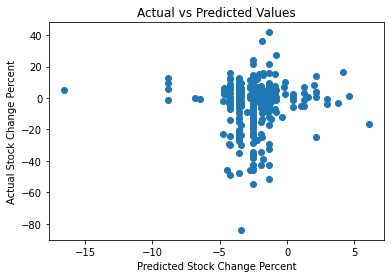

In [ ]:
predictions = lgbm.predict(x_test)
#print(y_test)
plt.ylabel('Actual Stock Change Percent')
plt.title('Actual vs Predicted Values')
plt.xlabel('Predicted Stock Change Percent')
plt.scatter(100 * predictions, 100 * y_test)

In [ ]:
percent_off = 0
for i in range(len(predictions)):
  percent_off += abs(y_test[i]-predictions[i])
avg_off = percent_off / len(predictions)
print(avg_off)
#print(predictions)

KeyError: ignored

679    -0.001731
1956    0.000000
1277    0.101856
401    -0.034837
822     0.076176
          ...   
1300   -0.242669
533     0.042284
1397    0.032609
1197   -0.248956
952     0.057646
Name: stock_change_filing, Length: 440, dtype: float64


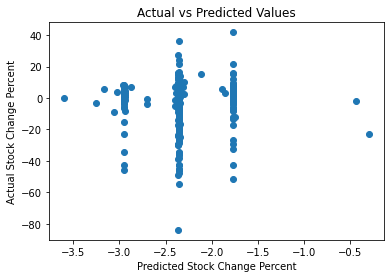

In [ ]:
# LR
import matplotlib.pyplot as plt

predictions = LR.predict(x_test)
print(y_test)
plt.ylabel('Actual Stock Change Percent')
plt.title('Actual vs Predicted Values')
plt.xlabel('Predicted Stock Change Percent')
plt.scatter(100 * predictions, 100 * y_test)
#print(x_test)
#print(predictions)

<class 'pandas.core.frame.DataFrame'>


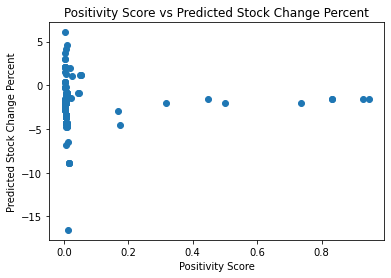

In [ ]:
plt.ylabel('Predicted Stock Change Percent')
plt.title('Positivity Score vs Predicted Stock Change Percent')
plt.xlabel('Positivity Score')
print(type(x_test))
plt.scatter(x_test['positivity'], predictions * 100)

<class 'pandas.core.frame.DataFrame'>


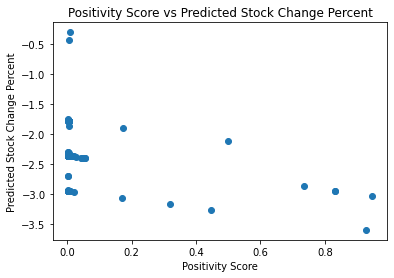

In [ ]:
# LR
plt.ylabel('Predicted Stock Change Percent')
plt.title('Positivity Score vs Predicted Stock Change Percent')
plt.xlabel('Positivity Score')
print(type(x_test))
plt.scatter(x_test['positivity'], predictions * 100)

In [ ]:
y_test = y_test.tolist()

In [ ]:
# Random Forest
RF = RandomForestRegressor(n_estimators = 100, random_state = 0)
RF.fit(x_train, y_train) 
predictions = RF.predict(x_test)
print(r2_score(y_test, predictions))

pkl.dump(RF, open('drive/My Drive/ai-prac/RF.pkl', 'wb'))
#print(len(predictions))




-0.036057823867150285


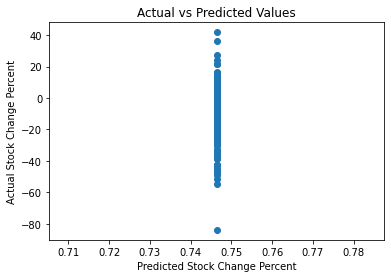

In [ ]:
#RF
predictions = RF.predict(x_test)
plt.ylabel('Actual Stock Change Percent')
plt.title('Actual vs Predicted Values')
plt.xlabel('Predicted Stock Change Percent')
plt.scatter(100 * predictions, 100 * y_test)

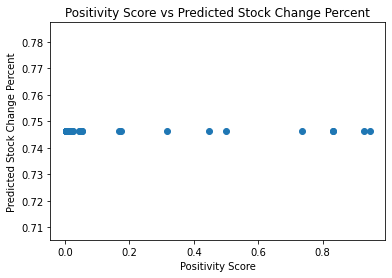

In [ ]:
plt.ylabel('Predicted Stock Change Percent')
plt.title('Positivity Score vs Predicted Stock Change Percent')
plt.xlabel('Positivity Score')
#print(x_test)
plt.scatter(x_test['positivity'], predictions * 100)

In [ ]:
# XGBoost
import xgboost 
xgb = xgboost.XGBRegressor(objective ='reg:squarederror',
                  n_estimators = 100, seed = 123)
xgb.fit(x_train, y_train)
xgb.score(x_test, y_test)
predictions = xgb.predict(x_test)
print(r2_score(y_test, predictions))
pkl.dump(xgb, open('drive/My Drive/ai-prac/xgb.pkl', 'wb'))


-0.024074569032433324


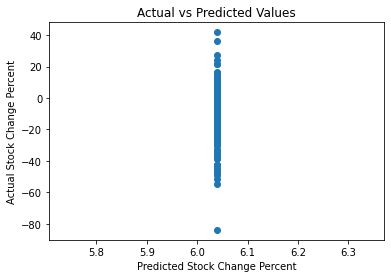

In [ ]:
#XGB
predictions = xgb.predict(x_test)
plt.ylabel('Actual Stock Change Percent')
plt.title('Actual vs Predicted Values')
plt.xlabel('Predicted Stock Change Percent')
plt.scatter(100 * predictions, 100 * y_test)

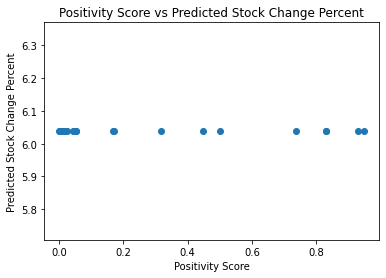

In [ ]:
plt.ylabel('Predicted Stock Change Percent')
plt.title('Positivity Score vs Predicted Stock Change Percent')
plt.xlabel('Positivity Score')
#print(x_test)
plt.scatter(x_test['positivity'], predictions * 100)

In [ ]:
percent_off = 0
for i in range(len(predictions)):
  percent_off += abs(y_test[i]-predictions[i])
avg_off = percent_off / len(predictions)
print(avg_off)
# print(predictions)

0.08580234490880755


# FinBERT Sentiment Analysis

Paper: https://arxiv.org/pdf/1908.10063.pdf

In [ ]:
'''
def compute_finbert_probabilities(text):
  """
  Uses FinBERT via REST to compute the sentiment analysis logits
  given a string of text

  Return format:
  {"POSITIVE": number, "NEGATIVE": number, "NEUTRAL": number}
  """
  url = "https://finbert3.p.rapidapi.com/sentiment/en"

  payload = {"text": text}
  headers = {
    "content-type": "application/json",
    "X-RapidAPI-Key": "3ccadbbca0msh476e5295a20c3d1p15ea35jsn05ff8341a2d1",
    "X-RapidAPI-Host": "finbert3.p.rapidapi.com"
  }

  response = requests.request("POST", url, json=payload, headers=headers)

  res_dict = json.loads(response.text)
  return res_dict["sentiment_probabilities"]
  '''

Drive already mounted at drive; to attempt to forcibly remount, call drive.mount("drive", force_remount=True).


{'MMM': {2017: 0.3219319914797597,
  2018: -0.19139367773015217,
  2019: -0.07609321294325704,
  2020: -0.028944481743706597,
  2021: 0.03357191154003774},
 'AOS': {2017: 0.29010523745888156,
  2018: -0.30602955289986433,
  2019: 0.09592818154694,
  2020: 0.14758214715308354,
  2021: 0.5817879045227652},
 'ABT': {2017: 0.4614596878317407,
  2018: 0.23031128941437423,
  2019: 0.24978418144390738,
  2020: 0.25922946183591583,
  2021: 0.2922738448470226},
 'ABBV': {2017: 0.5495914007518272,
  2018: -0.06320496889787233,
  2019: -0.0077328523528810734,
  2020: 0.19653822305230637,
  2021: 0.2895359828608238},
 'ABMD': {2017: 0.6679423517628885,
  2018: 0.6886071965770976,
  2019: -0.4496386596958147,
  2020: 0.9205024399961964,
  2021: 0.1431186973129058},
 'ACN': {2017: 0.3145285723971963,
  2018: -0.08339834982103853,
  2019: 0.4977595334602602,
  2020: 0.2429693030766628,
  2021: 0.613623958358248},
 'ATVI': {2017: 0.7281659593234993,
  2018: -0.27585132230189197,
  2019: 0.263448856288